<div style="background-color:lightskyblue;">
    <p style="color:skyblue;font-size:1px"> |
    </p>
    <h1 style="color:White;font-family:'Arial';font-size:30px"><center><ins>DATA ANALYSIS</ins></center></h1>
    <p style="color:skyblue;font-size:1px"> |
    </p>
    <p style="text-align:left;font-family:'Courier New';color:FloralWhite;font-size:16px"> | Data Analyst Nanodegree, Udacity
        <span style="float:right;font-family:'Courier New';color:White;font-size:16px">
            vamshi.krishna.prime@gmail.com |
        </span>
    </p>
    <p style="color:skyblue;font-size:1px"> |
    </p>
</div>

---

# Table of contents:
1. [**Import libraries**](#1.-Import-libraries)

2.  [**Load Data**](#2.-Load-Data)
  + 2.1 [Load Data using SQL Query](#2.1-Load-Data-using-SQL-Query:)
  + 2.2 [Restore Dataset properties](#2.2-Restore-Dataset-properties:)
  + 2.3 [Feature Engineering](#2.3-Feature-Engineering:)
  + 2.4 [Set ColorBlind Palette](#2.4-Set-ColorBlind-Palette:)


3.  [**Exploratory Data Analysis**](#3.-Exploratory-Data-Analysis)
  + 3.1. [Univariate Data Analysis](#3.1-Univariate-Data-Analysis:)
  + 3.2. [Bivariate Data Analysis](#3.2-Bivariate-Data-Analysis:)
  + 3.3. [Multivariate Data Analysis](#3.3-Multivariate-Data-Analysis:)


-----

<h1 align="center"><ins>Explore Bikeshare Data and communicate data findings</ins></h1>

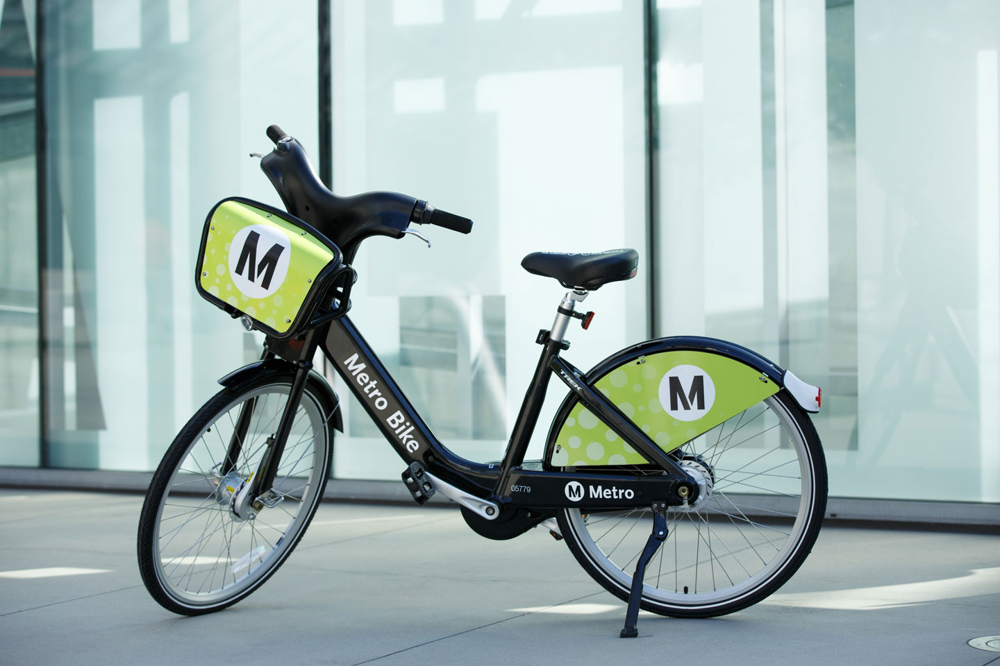

In [1]:
from IPython.display import Image
Image("img/Metro Bike.jpg")

**Image description:** image of Metro Bike bicycle.

-------

## 1. `Import libraries`
===========================

In [2]:
import numpy as np
import pandas as pd
import math
import matplotlib.pyplot as plt
import seaborn as sb
from sqlalchemy import create_engine
%matplotlib inline
from matplotlib.lines import Line2D

--------

## 2. `Load Data`
=================

+ 2.1 [Load Data using SQL Query](#2.1-Load-Data-using-SQL-Query:)
+ 2.2 [Restore Dataset properties](#2.2-Restore-Dataset-properties:)
+ 2.3 [Feature Engineering](#2.3-Feature-Engineering:)
+ 2.4 [Set ColorBlind Palette](#2.4-Set-ColorBlind-Palette:)

+ Available as `Flat File`:
+ Available as `Database`:

| Dataset | Available format | Description | Mode of access |
| :------ | :------ | :------ | :------ |
| bikeshare_clean | bikeshare_master.csv | A clean dateset in csv format | Load directly using `read_csv` method in pandas |
| bikeshare_clean | bikeshare_master.db | A relational database | Requires `SQL query` to gather data |

### <ins>2.1 Load Data using `SQL Query`:</ins>

In [3]:
engine = create_engine('sqlite:///bikeshare_master.db')

In [4]:
# Import data from the database into a dataframe using SQL query
bikeshare = pd.read_sql('SELECT b.trip_id, \
                                b.bike_id, \
                                b.trip_type, \
                                b.bike_type, \
                                b.passholder_type AS pass_type, \
                                f.fare_type, \
                                t.start_time, \
                                t.end_time, \
                                t.duration AS duration_min, \
                                t.distance_miles, \
                                f.fare, \
                                s.start_station_id, \
                                s.start_lat, \
                                s.start_lon, \
                                s.end_station_id, \
                                s.end_lat, \
                                s.end_lon \
                           FROM bike AS b \
                           JOIN time AS t \
                             ON b.trip_id = t.trip_id \
                           JOIN fare AS f \
                             ON b.trip_id = f.trip_id \
                           JOIN station AS s \
                             ON t.trip_id = s.trip_id', engine)

-----------

**`Alternate` approach is to load data from the flat file in `CSV` format.**

----

### <ins>2.2 Restore Dataset properties:</ins>

In [5]:
bikeshare.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 808589 entries, 0 to 808588
Data columns (total 17 columns):
trip_id             808589 non-null int64
bike_id             808589 non-null int64
trip_type           808589 non-null object
bike_type           808589 non-null object
pass_type           808589 non-null object
fare_type           808589 non-null object
start_time          808589 non-null object
end_time            808589 non-null object
duration_min        808589 non-null int64
distance_miles      808589 non-null float64
fare                808589 non-null float64
start_station_id    808589 non-null int64
start_lat           808589 non-null float64
start_lon           808589 non-null float64
end_station_id      808589 non-null int64
end_lat             808589 non-null float64
end_lon             808589 non-null float64
dtypes: float64(6), int64(5), object(6)
memory usage: 104.9+ MB


> Not all columns retain their datatype information while retreving the dataset from the database. This is because of transition of data from one format/platform to another. The incorrect `column datatypes` are to be `manually assigned`.

In [6]:
level_order = ['One Way', 'Round Trip']
ordered_cat = pd.api.types.CategoricalDtype(ordered = True, categories = level_order)
bikeshare['trip_type'] = bikeshare['trip_type'].astype(ordered_cat)

level_order = ['unknown', 'Standard', 'Electric', 'Smart']
ordered_cat = pd.api.types.CategoricalDtype(ordered = True, categories = level_order)
bikeshare['bike_type'] = bikeshare['bike_type'].astype(ordered_cat)

level_order = ['Walk-up', 'One Day', 'Monthly', 'Flex', 'Annual']
ordered_cat = pd.api.types.CategoricalDtype(ordered = True, categories = level_order)
bikeshare['pass_type'] = bikeshare['pass_type'].astype(ordered_cat)

level_order = ['Base', 'Extended']
ordered_cat = pd.api.types.CategoricalDtype(ordered = True, categories = level_order)
bikeshare['fare_type'] = bikeshare['fare_type'].astype(ordered_cat)

bikeshare['start_time'] = pd.to_datetime(bikeshare['start_time'])
bikeshare['end_time'] = pd.to_datetime(bikeshare['end_time'])

In [7]:
bikeshare.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 808589 entries, 0 to 808588
Data columns (total 17 columns):
trip_id             808589 non-null int64
bike_id             808589 non-null int64
trip_type           808589 non-null category
bike_type           808589 non-null category
pass_type           808589 non-null category
fare_type           808589 non-null category
start_time          808589 non-null datetime64[ns]
end_time            808589 non-null datetime64[ns]
duration_min        808589 non-null int64
distance_miles      808589 non-null float64
fare                808589 non-null float64
start_station_id    808589 non-null int64
start_lat           808589 non-null float64
start_lon           808589 non-null float64
end_station_id      808589 non-null int64
end_lat             808589 non-null float64
end_lon             808589 non-null float64
dtypes: category(4), datetime64[ns](2), float64(6), int64(5)
memory usage: 83.3 MB


------

### <ins>2.3 Feature Engineering:</ins>

**`Expand the dataset by extracting timeline variables for further plotting`**

> The time series data related to rentals `hour/day/week/month/year` needs to be prepared/extracted for further plotting.

In [8]:
%%time
# create a timeline variables from the existing data
bikeshare['year'] = bikeshare['start_time'].dt.year
bikeshare['month'] = bikeshare['start_time'].dt.month
bikeshare['weekday'] = bikeshare['start_time'].dt.weekday
bikeshare['day'] = bikeshare['start_time'].dt.day
bikeshare['hour'] = bikeshare['start_time'].dt.hour

bikeshare[['year', 'month', 'weekday', 'day', 'hour']].head()

Wall time: 1.7 s


,year,month,weekday,day,hour
0,2017,1,6,1,0
1,2017,1,6,1,0
2,2017,1,6,1,0
3,2017,1,6,1,0
4,2017,1,6,1,0


**Extract `daytime` from the `hour` column:**

> Extract `day_section` from `hour` column.

In [9]:
# divide the hour of the day into customized sections
bin = [-1,5,11,16,20,23]
bikeshare['day_sections'] = pd.cut(bikeshare['start_time'].dt.hour,bin)
bikeshare['day_sections'].head(10)

0    (-1, 5]
1    (-1, 5]
2    (-1, 5]
3    (-1, 5]
4    (-1, 5]
5    (-1, 5]
6    (-1, 5]
7    (-1, 5]
8    (-1, 5]
9    (-1, 5]
Name: day_sections, dtype: category
Categories (5, interval[int64]): [(-1, 5] < (5, 11] < (11, 16] < (16, 20] < (20, 23]]

> Explore the various methods to extract the `sections of the day` based on the `hour` of the day. To calculate the method with most performance (less time to extract the values), take the first 1000 entries in the dataset and calculate the execution time.

In [10]:
%%capture --no-stdout


def apply_section(row):
    if row in df_new.day_sections.unique()[0] :
        return 'Early hours'
    if row in df_new.day_sections.unique()[1] :
        return 'Morning'
    if row in df_new.day_sections.unique()[2] :
        return 'Afternoon'
    if row in df_new.day_sections.unique()[3] :
        return 'Evening'
    if row in df_new.day_sections.unique()[4] :
        return 'Night'
    return 'unknown'


def map_identity(row):
    if row in df_new.day_sections.unique()[0] :
        return 'Early hours'
    if row in df_new.day_sections.unique()[1] :
        return 'Morning'
    if row in df_new.day_sections.unique()[2] :
        return 'Afternoon'
    if row in df_new.day_sections.unique()[3] :
        return 'Evening'
    if row in df_new.day_sections.unique()[4] :
        return 'Night'
    return 'unknown'


def map_identity2(row):
    if row == df_new.day_sections.unique()[0] :
        return 'Early hours'
    if row == df_new.day_sections.unique()[1] :
        return 'Morning'
    if row == df_new.day_sections.unique()[2] :
        return 'Afternoon'
    if row == df_new.day_sections.unique()[3] :
        return 'Evening'
    if row == df_new.day_sections.unique()[4] :
        return 'Night'
    return 'unknown'


def mask_section(df):
    df['label4'] = df['day_sections'].mask(df.day_sections==df.day_sections.unique()[0], 'Early hours')
    df['label4'] = df['day_sections'].mask(df.day_sections==df.day_sections.unique()[1], 'Morning')
    df['label4'] = df['day_sections'].mask(df.day_sections==df.day_sections.unique()[2], 'Afternoon')
    df['label4'] = df['day_sections'].mask(df.day_sections==df.day_sections.unique()[3], 'Evening')
    df['label4'] = df['day_sections'].mask(df.day_sections==df.day_sections.unique()[4], 'Night')


def npwhere_section(df):
    df['label5'] = np.where(df.day_sections == df.day_sections.unique()[0], 'Early hours', df.day_sections)
    df['label5'] = np.where(df.day_sections == df.day_sections.unique()[1], 'Morning', df.label5)
    df['label5'] = np.where(df.day_sections == df.day_sections.unique()[2], 'Afternoon', df.label5)
    df['label5'] = np.where(df.day_sections == df.day_sections.unique()[3], 'Evening', df.label5)
    df['label5'] = np.where(df.day_sections == df.day_sections.unique()[4], 'Night', df.label5)


def loc_section(df):
    df.loc[df['day_sections'] == df.day_sections.unique()[0],'label6'] = 'Early hours'
    df.loc[df['day_sections'] == df.day_sections.unique()[1],'label6'] = 'Morning'
    df.loc[df['day_sections'] == df.day_sections.unique()[2],'label6'] = 'Afternoon'
    df.loc[df['day_sections'] == df.day_sections.unique()[3],'label6'] = 'Evening'
    df.loc[df['day_sections'] == df.day_sections.unique()[4],'label6'] = 'Night'



df_new = bikeshare.head(1000).copy()

%time df_new['label1'] = df_new['hour'].apply(lambda row: apply_section(row))
%time df_new['label2'] = df_new['hour'].map(map_identity)
%time df_new['label3'] = df_new['day_sections'].map(map_identity2)
%time mask_section(df_new)
%time npwhere_section(df_new)
%time loc_section(df_new)

Wall time: 3.73 s
Wall time: 3.41 s
Wall time: 15.6 ms
Wall time: 1.11 s
Wall time: 15.6 ms
Wall time: 93.6 ms


> From the above, it is evident that `np.where`, `map` method and `.loc` method (vectorized operations) yields the most performance. However on larger datasets, `.loc` method perform better. 

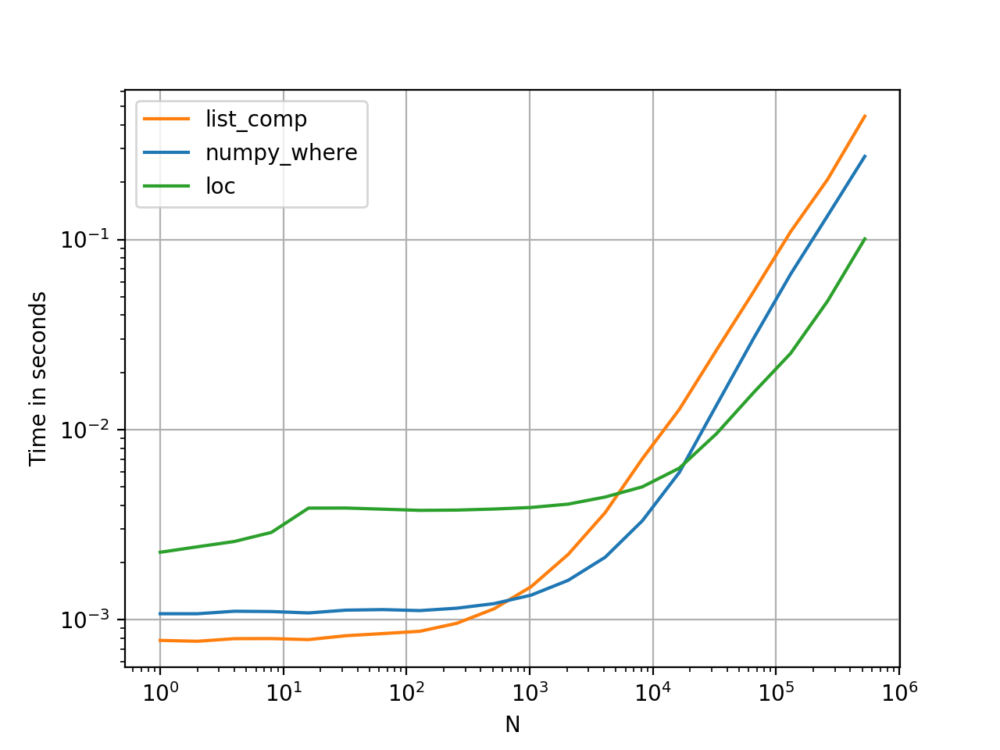

In [11]:
from IPython.display import Image
Image("img/performance chart.PNG", width = 600, height = 300)

> It can be determined from the above steps that `.loc` method is the best solution to add new column by extracting/comparing values from the existing column.

Extract `daytime` from `day_section`.

In [12]:
%%time

def assign_daytime(df):
    df.loc[df['day_sections'] == df.day_sections.unique()[0],'daytime'] = 'Early hours'
    df.loc[df['day_sections'] == df.day_sections.unique()[1],'daytime'] = 'Morning'
    df.loc[df['day_sections'] == df.day_sections.unique()[2],'daytime'] = 'Afternoon'
    df.loc[df['day_sections'] == df.day_sections.unique()[3],'daytime'] = 'Evening'
    df.loc[df['day_sections'] == df.day_sections.unique()[4],'daytime'] = 'Night'
    

assign_daytime(bikeshare)
bikeshare.daytime.value_counts()

Wall time: 1.57 s


Afternoon      291403
Evening        222231
Morning        210297
Night           59605
Early hours     25053
Name: daytime, dtype: int64

> As estimated, `.loc` method exhibited the best perormance by extracting the `daytime` values from the `day_sections` coulmns with `808589` entries `around 1 second`.

In [13]:
# display a sample of 'daytime' entries for visual confirmation
bikeshare[['day_sections', 'daytime']].sample(10)

,day_sections,daytime
99615,"(11, 16]",Afternoon
415456,"(16, 20]",Evening
597729,"(11, 16]",Afternoon
169158,"(16, 20]",Evening
71308,"(11, 16]",Afternoon
432472,"(5, 11]",Morning
790780,"(16, 20]",Evening
243867,"(11, 16]",Afternoon
290287,"(5, 11]",Morning
497480,"(11, 16]",Afternoon


**Change `weekday` representation:**

> change the `weekday` representation from numeric values to descriptive values. Aforementioned, use `.loc` method to extract new column from the existing column values.

| Integer Value | Day of the week |
|:-------------:|:-------------:|
| 0             | Monday        |
| 1             | Tuesday       |
| 2             | Wednesday     |
| 3             | Thursday      |
| 4             | Friday        |
| 5             | Saturday      |
| 6             | Sunday        |

In [14]:
%%time

def assign_weekday(df):
    df.loc[df['weekday'] == 0,'weekday'] = 'Monday'
    df.loc[df['weekday'] == 1,'weekday'] = 'Tuesday'
    df.loc[df['weekday'] == 2,'weekday'] = 'Wednesday'
    df.loc[df['weekday'] == 3,'weekday'] = 'Thursday'
    df.loc[df['weekday'] == 4,'weekday'] = 'Friday'
    df.loc[df['weekday'] == 5,'weekday'] = 'Saturday'
    df.loc[df['weekday'] == 6,'weekday'] = 'Sunday'
    

assign_weekday(bikeshare)

# display a sample of 'daytime' entries for visual confirmation
bikeshare[['weekday']].sample(10)

Wall time: 1.16 s


,weekday
161072,Friday
649692,Tuesday
774069,Wednesday
224946,Sunday
612421,Monday
685685,Sunday
376072,Friday
497250,Monday
707698,Monday
773624,Tuesday


**Extract the relative number of the `week` in a month:**

> Each month bears either `3` or `4` weeks depending on the leap year and month itself. Extract the relative number of the week in each month.

In [15]:
bin = [0,7,14,21,28,31]
#use pd.cut function can attribute the values into its specific bins
bikeshare['week_sections'] = pd.cut(bikeshare['day'],bin)
bikeshare[['week_sections']].head()

,week_sections
0,"(0, 7]"
1,"(0, 7]"
2,"(0, 7]"
3,"(0, 7]"
4,"(0, 7]"


In [16]:
bikeshare.week_sections.unique()

[(0, 7], (7, 14], (14, 21], (21, 28], (28, 31]]
Categories (5, interval[int64]): [(0, 7] < (7, 14] < (14, 21] < (21, 28] < (28, 31]]

In [17]:
%%time

def assign_week(df):
    df.loc[df['week_sections'] == df.week_sections.unique()[0],'week'] = 'First'
    df.loc[df['week_sections'] == df.week_sections.unique()[1],'week'] = 'Second'
    df.loc[df['week_sections'] == df.week_sections.unique()[2],'week'] = 'Third'
    df.loc[df['week_sections'] == df.week_sections.unique()[3],'week'] = 'Fourth'
    df.loc[df['week_sections'] == df.week_sections.unique()[4],'week'] = 'Fifth'
    

assign_week(bikeshare)
bikeshare.week.value_counts()

Wall time: 1.21 s


Third     188745
Fourth    185200
Second    184644
First     183795
Fifth      66205
Name: week, dtype: int64

In [18]:
bikeshare[['week_sections', 'week']].sample(10)

,week_sections,week
38736,"(14, 21]",Third
762728,"(28, 31]",Fifth
768943,"(0, 7]",First
651710,"(0, 7]",First
593314,"(7, 14]",Second
113484,"(7, 14]",Second
697715,"(21, 28]",Fourth
79161,"(0, 7]",First
644948,"(21, 28]",Fourth
179856,"(21, 28]",Fourth


**Extract `quarter` of the year from the `month` column:**

> Extract `quarter_sections` from `month` column.

In [19]:
# divide the hour of the day into customized sections
bin = [0,3,6,9,12]
#use pd.cut function to attribute the values into its specific bins
bikeshare['quarter_sections'] = pd.cut(bikeshare['start_time'].dt.month,bin)
bikeshare['quarter_sections'].sample(10)

644789     (3, 6]
51654      (3, 6]
140418     (6, 9]
263018     (0, 3]
751236    (9, 12]
585853     (0, 3]
361894     (3, 6]
528516    (9, 12]
438368     (6, 9]
636887     (3, 6]
Name: quarter_sections, dtype: category
Categories (4, interval[int64]): [(0, 3] < (3, 6] < (6, 9] < (9, 12]]

> Extract `quarter` from `quarter_sections`.

In [20]:
bikeshare.quarter_sections.unique()

[(0, 3], (3, 6], (6, 9], (9, 12]]
Categories (4, interval[int64]): [(0, 3] < (3, 6] < (6, 9] < (9, 12]]

In [21]:
%%time

def extract_quarter(df):
    df.loc[df['quarter_sections'] == df.quarter_sections.unique()[0],'quarter'] = 'Q1'
    df.loc[df['quarter_sections'] == df.quarter_sections.unique()[1],'quarter'] = 'Q2'
    df.loc[df['quarter_sections'] == df.quarter_sections.unique()[2],'quarter'] = 'Q3'
    df.loc[df['quarter_sections'] == df.quarter_sections.unique()[3],'quarter'] = 'Q4'


extract_quarter(bikeshare)
bikeshare.quarter.value_counts()

Wall time: 945 ms


Q3    251474
Q4    215317
Q2    188588
Q1    153210
Name: quarter, dtype: int64

> As estimated, `.loc` method exhibited the best perormance by extracting the `quarter` of the year values from the `year_sections` coulmns with `808589` entries `under 1 second`.

In [22]:
# display a sample of 'quarter' entries for visual confirmation
bikeshare[['quarter_sections', 'quarter']].sample(10)

,quarter_sections,quarter
155053,"(6, 9]",Q3
568173,"(0, 3]",Q1
771204,"(9, 12]",Q4
271829,"(0, 3]",Q1
651348,"(6, 9]",Q3
563932,"(0, 3]",Q1
33919,"(3, 6]",Q2
392066,"(6, 9]",Q3
354634,"(3, 6]",Q2
288473,"(0, 3]",Q1


**Change datatypes of multiple columns to ordered categorical dtype:**

In [23]:
bikeshare.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 808589 entries, 0 to 808588
Data columns (total 28 columns):
trip_id             808589 non-null int64
bike_id             808589 non-null int64
trip_type           808589 non-null category
bike_type           808589 non-null category
pass_type           808589 non-null category
fare_type           808589 non-null category
start_time          808589 non-null datetime64[ns]
end_time            808589 non-null datetime64[ns]
duration_min        808589 non-null int64
distance_miles      808589 non-null float64
fare                808589 non-null float64
start_station_id    808589 non-null int64
start_lat           808589 non-null float64
start_lon           808589 non-null float64
end_station_id      808589 non-null int64
end_lat             808589 non-null float64
end_lon             808589 non-null float64
year                808589 non-null int64
month               808589 non-null int64
weekday             808589 non-null object
day   

In [24]:
df = bikeshare

level_order = ['Early hours', 'Morning', 'Afternoon', 'Evening', 'Night']
ordered_cat = pd.api.types.CategoricalDtype(ordered = True, categories = level_order)
df['daytime'] = df['daytime'].astype(ordered_cat)

level_order = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
ordered_cat = pd.api.types.CategoricalDtype(ordered = True, categories = level_order)
df['weekday'] = df['weekday'].astype(ordered_cat)

level_order = ['First', 'Second', 'Third', 'Fourth', 'Fifth']
ordered_cat = pd.api.types.CategoricalDtype(ordered = True, categories = level_order)
df['week'] = df['week'].astype(ordered_cat)

level_order = ['Q1', 'Q2', 'Q3', 'Q4']
ordered_cat = pd.api.types.CategoricalDtype(ordered = True, categories = level_order)
df['quarter'] = df['quarter'].astype(ordered_cat)

In [25]:
bikeshare.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 808589 entries, 0 to 808588
Data columns (total 28 columns):
trip_id             808589 non-null int64
bike_id             808589 non-null int64
trip_type           808589 non-null category
bike_type           808589 non-null category
pass_type           808589 non-null category
fare_type           808589 non-null category
start_time          808589 non-null datetime64[ns]
end_time            808589 non-null datetime64[ns]
duration_min        808589 non-null int64
distance_miles      808589 non-null float64
fare                808589 non-null float64
start_station_id    808589 non-null int64
start_lat           808589 non-null float64
start_lon           808589 non-null float64
end_station_id      808589 non-null int64
end_lat             808589 non-null float64
end_lon             808589 non-null float64
year                808589 non-null int64
month               808589 non-null int64
weekday             808589 non-null category
day 

**Remove redundant columns in the dataset:**

In [26]:
cols_to_drop = ['day_sections', 'week_sections', 'quarter_sections']

bikeshare.drop(cols_to_drop, axis=1, inplace=True)

In [27]:
for i, col in enumerate(bikeshare.columns):
    print('{}'.format(i).ljust(2, " ") + ':' + '{}'.format(col))

0 :trip_id
1 :bike_id
2 :trip_type
3 :bike_type
4 :pass_type
5 :fare_type
6 :start_time
7 :end_time
8 :duration_min
9 :distance_miles
10:fare
11:start_station_id
12:start_lat
13:start_lon
14:end_station_id
15:end_lat
16:end_lon
17:year
18:month
19:weekday
20:day
21:hour
22:daytime
23:week
24:quarter


**Reorder columns in the dataset:**

> reorder columns as relevant/numerical data to the left most for visual analysis

In [28]:
reordered_columns = ['trip_id', 'bike_id', 'distance_miles', 'duration_min', 'fare',
                     'trip_type', 'bike_type', 'pass_type', 'fare_type', 'start_time', 
                     'year', 'quarter', 'month', 'week', 'weekday', 'day', 'daytime','hour',
                     'end_time', 'start_station_id', 'start_lat', 'start_lon', 
                     'end_station_id', 'end_lat', 'end_lon']

bikeshare = bikeshare.reindex(columns=reordered_columns)

In [29]:
for i, col in enumerate(bikeshare.columns):
    print('{}'.format(i).ljust(2, " ") + ':' + ' {}'.format(col))

0 : trip_id
1 : bike_id
2 : distance_miles
3 : duration_min
4 : fare
5 : trip_type
6 : bike_type
7 : pass_type
8 : fare_type
9 : start_time
10: year
11: quarter
12: month
13: week
14: weekday
15: day
16: daytime
17: hour
18: end_time
19: start_station_id
20: start_lat
21: start_lon
22: end_station_id
23: end_lat
24: end_lon


-------

### <ins>2.4 Set ColorBlind Palette:</ins>

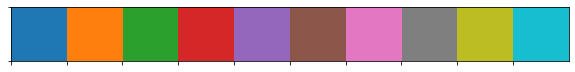

In [30]:
# display current palette
current_palette = sb.color_palette()
sb.palplot(current_palette)
plt.show()

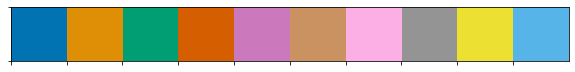

In [31]:
# set the palette to support 'colorblind'
sb.set_palette(palette = 'colorblind', n_colors = 10, desat = None)
current_palette = sb.color_palette()
sb.palplot(current_palette)
plt.show()

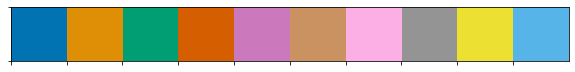

In [32]:
# visually confirm the palette change
current_palette = sb.color_palette()
sb.palplot(current_palette)
plt.show()

-----

**`Bar Chart:`**

> A `bar chart` is used to depict the distribution of a `categorical` variable. In a bar chart, each level of the categorical variable is depicted with a bar, whose height indicates the frequency of data points that take on that level. A basic bar chart of frequencies can be created through the use of seaborn's countplot function:

**`Histogram:`**

> A `histogram` is used to plot the distribution of a `numerical` variable. It is the quantitative version of the bar chart. However, rather than plot one bar for each unique numeric value, values are grouped into `continuous` bins, and one bar for each bin is plotted depicting the number.

**`Scatter plot:`**

> A `scatter plot` is used to inspect the relationship between two numeric variables. In a scatterplot, each data point is plotted individually as a point, its x-position corresponding to one feature value and its y-position corresponding to the second. One basic way of creating a scatterplot is through Matplotlib's `scatter` function. An alternative approach is to use Seaborn's `regplot` function which combines scatterplot creation with regression function fitting.

**`Facet Grid:`**

> One general visualization technique that will be useful for you to know about to handle plots of two or more variables is `faceting`. In faceting, the data is divided into disjoint subsets, most often by different levels of a categorical variable. For each of these subsets of the data, the same plot type is rendered on other variables. Faceting is a way of comparing distributions or relationships across levels of additional variables, especially when there are three or more variables of interest overall.

**`Clustered Bar chart:`**

> To depict the relationship between two categorical variables, we can extend the univariate bar chart into a `clustered bar chart`. In a clustered bar chart, bars are organized into `clusters` based on levels of the `first variable`, and then bars are `ordered` consistently across the `second variable` within each `cluster`.

-----

## 3. `Exploratory Data Analysis`
=========================================

+ **3.1** [Univariate Data Analysis](#3.1-Univariate-Data-Analysis:)
+ **3.2** [Bivariate Data Analysis](#3.2-Bivariate-Data-Analysis:)
+ **3.3** [Multivariate Data Analysis](#3.3-Multivariate-Data-Analysis:)

### <ins>`3.1 Univariate Data Analysis:`</ins>

#### 3.1.1 Univariate analysis of `trip_type` column:

+ `Column`: trip_type
+ `Data type`: categorical data, nominal
+ `Plot` : Bar chart

**`Bar Chart:`**

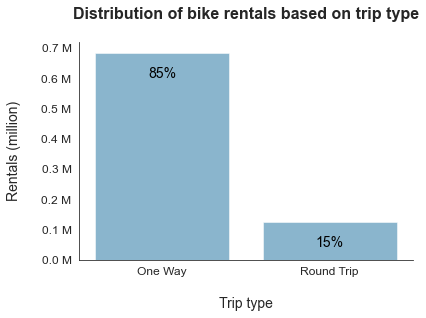

In [33]:
# Assign color palette as per requirement
sb.set_style("white")
sb.set_palette(palette = 'colorblind', n_colors = 10, desat = None)
current_palette = sb.color_palette()
base_color = sb.color_palette()[0]

# prepare data for the plot
trip_type_order = bikeshare.trip_type.value_counts().index
max_count = bikeshare['trip_type'].value_counts().max()
tick_values = np.arange(0, max_count + 100000, 100000)
tick_names = ['{:0.1f} M'.format(v/1000000) for v in tick_values]

# Seaborn's countplot
sb.countplot(data = bikeshare, x = 'trip_type', color = base_color, alpha= 0.5, order = trip_type_order)

# improve plot aesthetics
plt.title('Distribution of bike rentals based on trip type\n', fontsize = 16, weight='bold')
plt.xlabel('\nTrip type', fontsize = 14)
plt.ylabel('Rentals (million)\n', fontsize = 14)
plt.xticks(fontsize = 12)
plt.yticks(tick_values, tick_names, fontsize = 12)

# add annotations
# -------------------------------------------------------
n_points = bikeshare.shape[0]
trip_type_counts = bikeshare['trip_type'].value_counts()

# get the current tick locations and labels
locs, labels = plt.xticks()

# loop through each pair of locations and labels
for loc, label in zip(locs, labels):
    try:
        # get the text property for the label to get the correct count
        count = trip_type_counts[label.get_text()]

    except KeyError:
        count = 0

    pct_string = '{:0.0f}%'.format(100*count/n_points)
    
    # print the annotation depending on the bar length
    if count < (n_points/10):
        plt.text(loc, count + (n_points/20), pct_string, ha = 'center', color = 'black', fontsize = 14)
    else:
        plt.text(loc, count - (n_points/10), pct_string, ha = 'center', color = 'black', fontsize = 14);
# -------------------------------------------------------

sb.despine();

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.1.1 Distribution of bike rentals based on trip type.png', dpi=300, bbox_inches='tight')

**Observation:** The above plot depicts that bike rentals are more for `One Way` trips compared to `Round Trip`'s.

------

#### 3.1.2 Univariate analysis of `bike_type` column:

+ `Column`: bike_type
+ `Data type`: categorical data, nominal
+ `Plot` : Bar chart

**`Bar Chart:`**

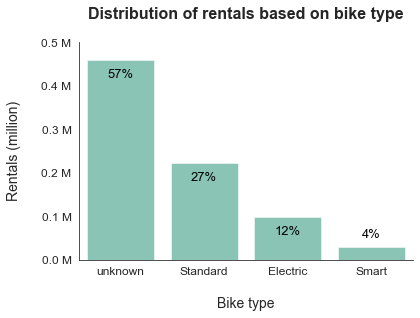

In [34]:
# Assign color palette as per requirement
sb.set_style('white')
base_color = sb.color_palette()[2]

# prepare data for the plot
bike_type_order = bikeshare.bike_type.value_counts().index
max_count = bikeshare['bike_type'].value_counts().max()
tick_values = np.arange(0, max_count + 100000, 100000)
tick_names = ['{:0.1f} M'.format(v/1000000) for v in tick_values]

# Seaborn's countplot
sb.countplot(data = bikeshare, x = 'bike_type', color = base_color, alpha= 0.5, order = bike_type_order)

# improve plot aesthetics
plt.title('Distribution of rentals based on bike type\n', fontsize = 16, weight = 'bold')
plt.xlabel('\nBike type', fontsize = 14)
plt.ylabel('Rentals (million)\n', fontsize = 14)
plt.xticks(fontsize = 12)
plt.yticks(tick_values, tick_names, fontsize = 12)

# add annotations
# -------------------------------------------------------
n_points = bikeshare.shape[0]
bike_type_counts = bikeshare['bike_type'].value_counts()

# get the current tick locations and labels
locs, labels = plt.xticks()

# loop through each pair of locations and labels
for loc, label in zip(locs, labels):
    try:
        # get the text property for the label to get the correct count
        count = bike_type_counts[label.get_text()]

    except KeyError:
        count = 0

    pct_string = '{:0.0f}%'.format(100*count/n_points)

    # print the annotation depending on the bar length
    if count < (n_points/20):
        plt.text(loc, count + (n_points/40), pct_string, ha = 'center', color = 'black', fontsize = 13)
    else:
        plt.text(loc, count - (n_points/20), pct_string, ha = 'center', color = 'black', fontsize = 13);
# -------------------------------------------------------
    
sb.despine();
    
# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.1.2 Distribution of bike rentals based on bike type.png', dpi=300, bbox_inches='tight')

**Observation:** The above plot depicts that `standard` bikes are in more demand compared to `electric` and `smart`bikes.

------------

#### 3.1.3 Univariate analysis of `pass_type` column:

+ `Column`: pass_type
+ `Data type`: categorical data, nominal
+ `Plot` : Bar chart

In [35]:
# display individual counts of rentals based on pass type
bikeshare['pass_type'].value_counts()

Monthly    475666
One Day    171192
Walk-up    112078
Annual      49390
Flex          263
Name: pass_type, dtype: int64

**`Bar Chart:`**

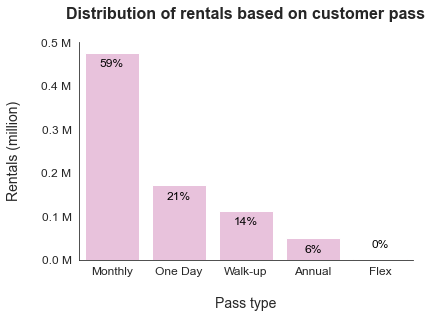

In [36]:
# Assign color palette as per requirement
sb.set_style("white")
base_color = sb.color_palette()[6]

# prepare data for the plot
pass_type_order = bikeshare.pass_type.value_counts().index
max_count = bikeshare['pass_type'].value_counts().max()
tick_values = np.arange(0, max_count + 100000, 100000)
tick_names = ['{:0.1f} M'.format(v/1000000) for v in tick_values]

# Seaborn's countplot
sb.countplot(data = bikeshare, x = 'pass_type', color = base_color, alpha= 1, 
             order = pass_type_order, saturation = 0.5)

# improve plot aesthetics
plt.title('Distribution of rentals based on customer pass\n', fontsize = 16, weight = 'bold')
plt.xlabel('\nPass type', fontsize = 14)
plt.ylabel('Rentals (million)\n', fontsize = 14)
plt.xticks(fontsize = 12)
plt.yticks(tick_values, tick_names, fontsize = 12)

# add annotations
# -------------------------------------------------------
n_points = bikeshare.shape[0]
pass_type_counts = bikeshare['pass_type'].value_counts()

# get the current tick locations and labels
locs, labels = plt.xticks()

# loop through each pair of locations and labels
for loc, label in zip(locs, labels):
    try:
        # get the text property for the label to get the correct count
        count = pass_type_counts[label.get_text()]

    except KeyError:
        count = 0

    pct_string = '{:0.0f}%'.format(100*count/n_points)

    # print the annotation depending on the bar length
    if count < (n_points/20):
        plt.text(loc, count + (n_points/30), pct_string, ha = 'center', color = 'black', fontsize = 12)
    else:
        plt.text(loc, count - (n_points/25), pct_string, ha = 'center', color = 'black', fontsize = 12);
# -------------------------------------------------------

sb.despine();

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.1.3 Distribution of bike rentals based on customer pass.png', dpi=300, bbox_inches='tight')

**Observation:** The above plot depicts that `Monthly Pass` is the most popular subscription among the customers.

------------

#### 3.1.4 Univariate analysis of `fare_type` column:

+ `Column`: fare_type
+ `Data type`: categorical data, nominal
+ `Plot` : Bar chart

**`Bar Chart:`**

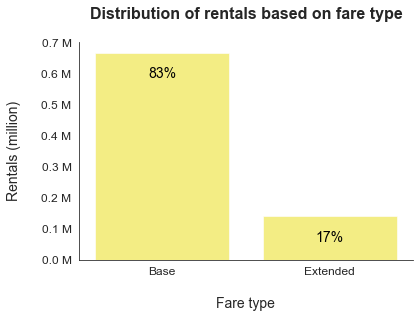

In [37]:
# Assign color palette as per requirement
sb.set_style("white")
base_color = sb.color_palette()[8]

# prepare data for the plot
fare_type_order = bikeshare.fare_type.value_counts().index
max_count = bikeshare['fare_type'].value_counts().max()
tick_values = np.arange(0, max_count + 100000, 100000)
tick_names = ['{:0.1f} M'.format(v/1000000) for v in tick_values]

# Seaborn's countplot
sb.countplot(data = bikeshare, x = 'fare_type', color = base_color, alpha= 0.6, 
             order = fare_type_order, saturation = 1)

# improve plot aesthetics
plt.title('Distribution of rentals based on fare type\n', fontsize = 16, weight = 'bold')
plt.xlabel('\nFare type', fontsize = 14)
plt.ylabel('Rentals (million)\n', fontsize = 14)
plt.xticks(fontsize = 12)
plt.yticks(tick_values, tick_names, fontsize = 12)

# add annotations
# -------------------------------------------------------
n_points = bikeshare.shape[0]
fare_type_counts = bikeshare['fare_type'].value_counts()
# get the current tick locations and labels
locs, labels = plt.xticks()

# loop through each pair of locations and labels
for loc, label in zip(locs, labels):
    try:
        # get the text property for the label to get the correct count
        count = fare_type_counts[label.get_text()]

    except KeyError:
        count = 0
    
    pct_string = '{:0.0f}%'.format(100*count/n_points)

    # print the annotation depending on the bar length
    if count < (n_points/10):
        plt.text(loc, count + (n_points/20), pct_string, ha = 'center', color = 'black', fontsize = 14)
    else:
        plt.text(loc, count - (n_points/10), pct_string, ha = 'center', color = 'black', fontsize = 14);
# -------------------------------------------------------

sb.despine();

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.1.4 Distribution of bike rentals based on fare type.png', dpi=300, bbox_inches='tight')

**Observation:** 
+ The above plot depicts that most of the customers pay `Base` fare.
+ Decrease in percentage of `Extended` fares will result in decrease in income generation. As the percentage of `Extended` fares are less than `20%`, some business reforms/promotional programs have to be taken to encourage customers to ride bikes for longer durations.

------------

#### 3.1.5 Comparision of rentals based on `Categorical parameters`:

+ `Columns`: trip_type, bike_type, pass_type
+ `Data type`: categorical data, nominal
+ `Plot` : Bar chart

**`Bar Chart:`**

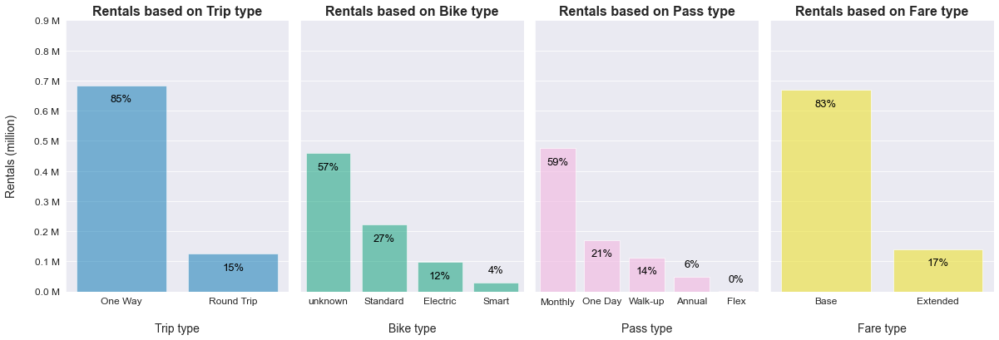

In [38]:
def count_subplot(subplot, color, cat_type, alpha, sat):
    # plot the distribution of bike rentals based on category types
    #-----------------------Start of subplot-----------------------
    
    # prepare the data for the plot
    sb.set_style('darkgrid')
    base_color = sb.color_palette()[color]
    plt.subplot(1, 4, subplot)
    max_count = bikeshare.shape[0]
    y_tick_values = np.arange(0, max_count + 100000, 100000)
    y_tick_names = ['{:0.1f} M'.format(v/1000000) for v in y_tick_values]
    cat_order = bikeshare[cat_type].value_counts().index
    
    # plot countplot
    sb.countplot(data = bikeshare, x = cat_type, color = base_color, alpha= alpha, order = cat_order, saturation = sat)
    
    # improve plot aesthetics
    plt.title('Rentals based on {} type'.format(cat_type[0: 4].title()), fontsize = 16, weight = 'bold')
    plt.xlabel('\n{} type'.format(cat_type[0: 4].title()), fontsize = 14)
    plt.xticks(fontsize = 12)
    if subplot == 1:
        plt.ylabel('Rentals (million)\n', fontsize = 14)
        plt.yticks(y_tick_values, y_tick_names, fontsize = 12)
    else:
        plt.ylabel('')
        plt.yticks(y_tick_values, [])

    # add annotations
    # -------------------------------------------------------
    n_points = bikeshare.shape[0]
    cat_type_counts = bikeshare[cat_type].value_counts()
    # get the current tick locations and labels
    locs, labels = plt.xticks()

    # loop through each pair of locations and labels
    for loc, label in zip(locs, labels):
        try:
            # get the text property for the label to get the correct count
            count = cat_type_counts[label.get_text()]

        except KeyError:
            count = 0
            
        pct_string = '{:0.0f}%'.format(100*count/n_points)

        # print the annotation depending on the bar length
        if count < (n_points/10):
            plt.text(loc, count + (n_points/25), pct_string, ha = 'center', color = 'black', fontsize = 13)
        else:
            plt.text(loc, count - (n_points/15), pct_string, ha = 'center', color = 'black', fontsize = 13);
    # -------------------------------------------------------
    #-------------------------End of subplot------------------------


plt.figure(figsize = [20, 6])

# plot syntax : count_subplot(subplot, color, cat_type, alpha, sat)
count_subplot(subplot=1, color=0, cat_type='trip_type', alpha=0.5, sat=1)
count_subplot(subplot=2, color=2, cat_type='bike_type', alpha=0.5, sat=1)
count_subplot(subplot=3, color=6, cat_type='pass_type', alpha=0.6, sat=0.8)
count_subplot(subplot=4, color=8, cat_type='fare_type', alpha=0.6, sat=1)

plt.subplots_adjust(wspace=0.05, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.1.5 Comparision of bike rentals based on various categorical parameters.png', dpi=300, bbox_inches='tight')

**Observation:** The above plot depicts the classification of rentals based on various parameters. Among them it can be concluded that, most customers prefer `standard bike` over `smart` bikes, takes more `One Way` trips than `Round Trip`'s, and prefers `Monthly Pass` over other subscriptions.

------------

#### 3.1.6 Univariate analysis - Distribution of hourly rentals

+ `Column`: hour
+ `Data type`: continuous data
+ `Plot` : Distribution plot, Line plot

**`Distribution plot`:**

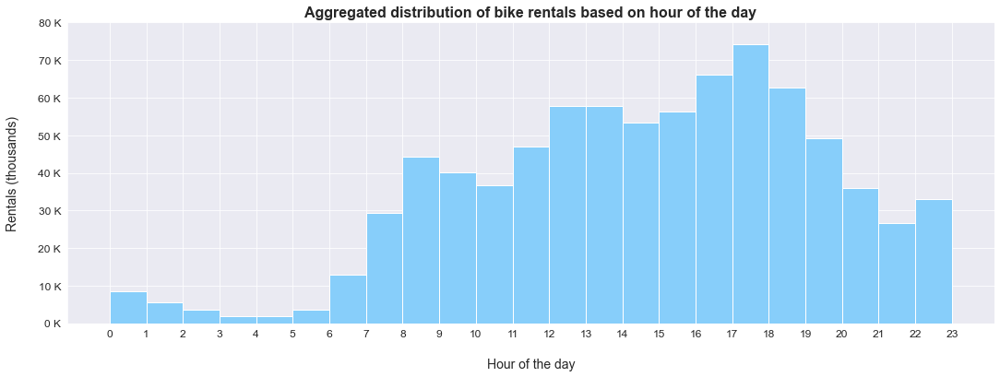

In [39]:
# Assign palette and grid as per requirement
sb.set_style('darkgrid')
plt.figure(figsize = [18, 6])

# prepare data for the plot
max_count = bikeshare.hour.value_counts().max()
x_tick_values = np.arange(0,  23+1, 1)
x_tick_names = ['{:}'.format(v) for v in x_tick_values]
y_tick_values = np.arange(0,  max_count+10000, 10000)
y_tick_names = ['{:0.0f} K'.format(v/1000) for v in y_tick_values]
bin_edges = np.arange(0,  23+1, 1)

# seaborn's distribution plot
sb.distplot(bikeshare.hour, bins = bin_edges, kde = False, color = 'lightskyblue',
            hist_kws = {'alpha' : 1, 'edgecolor' : "white", 'linewidth' : 1})

# improve plot aesthetics
plt.title('Aggregated distribution of bike rentals based on hour of the day', fontsize = 16, weight = 'bold')
plt.xlabel('\nHour of the day', fontsize = 14)
plt.ylabel('Rentals (thousands)\n', fontsize = 14)
plt.xticks(x_tick_values, x_tick_names, fontsize = 12)
plt.yticks(y_tick_values, y_tick_names, fontsize = 12);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.1.6.a Aggregated distribution of bike rentals based on hour of the day.png', dpi=300, bbox_inches='tight')

**`Line plot`:**

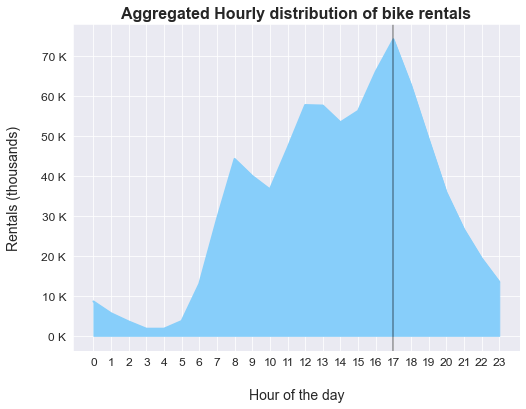

In [40]:
plt.figure(figsize = [8, 6])

# Assign palette and grid as per requirement
sb.set_style('darkgrid')

# prepare data for the plot
x = bikeshare.groupby(bikeshare['hour']).count()['trip_id'].index
y = bikeshare.groupby(bikeshare['hour']).count()['trip_id'].values
x_tick_values = np.arange(0,  23+1, 1)
x_tick_names = ['{:}'.format(v) for v in x_tick_values]
y_tick_values = np.arange(0,  bikeshare.hour.value_counts().max()+10000, 10000)
y_tick_names = ['{:0.0f} K'.format(v/1000) for v in y_tick_values]

# matplotlib's line plot
plt.plot(x, y, linewidth=2.0, color = 'lightskyblue')

# improve plot aesthetics
plt.title('Aggregated Hourly distribution of bike rentals', fontsize = 16, weight = 'bold')
plt.xlabel('\nHour of the day', fontsize = 14)
plt.ylabel('Rentals (thousands)\n', fontsize = 14)
plt.xticks(x_tick_values, x_tick_names, fontsize = 12)
plt.yticks(y_tick_values, y_tick_names, fontsize = 12)

# fill the area under the line
plt.fill_between(x, y, color = 'lightskyblue')

# draw the vertical axial line at the peak hour
peak_hour = bikeshare['hour'].value_counts(ascending=False).index[0]
plt.axvline(peak_hour, color='black', alpha=0.3, linewidth=2);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.1.6.b Aggregated distribution of bike rentals based on hour of the day.png', dpi=300, bbox_inches='tight')

The above plots depict that the most busy hours are in the evenings and plots a vertical axial line that denotes the hour with maximum aggregated bike rentals over the hour of the day.

**`Find average rentals based on the hour of the day:`**

Create a dataset which contain bike rentals relative to each hour in the day over respective months in any year. Care should be taken as to inlcude all hours in every day of the month. Use all categorical combinations and fill the NULL values with numerical zero's so as to consider bike rentals subjected to every hour in any day.

In [41]:
# create a dataset for bike rentals over each hour in a day
hours_df = bikeshare.groupby([bikeshare["year"], 
                              bikeshare["month"],
                              bikeshare["day"],
                              bikeshare["hour"]]).count()['trip_id'].reset_index(name='rentals')

hours_df['rentals'] = hours_df['rentals'].fillna(0).astype(int)
hours_df.head(10)

,year,month,day,hour,rentals
0,2017,1,1,0,9
1,2017,1,1,1,5
2,2017,1,1,2,8
3,2017,1,1,3,2
4,2017,1,1,4,1
5,2017,1,1,5,2
6,2017,1,1,6,1
7,2017,1,1,7,1
8,2017,1,1,8,4
9,2017,1,1,9,5


**`Point plot`:**

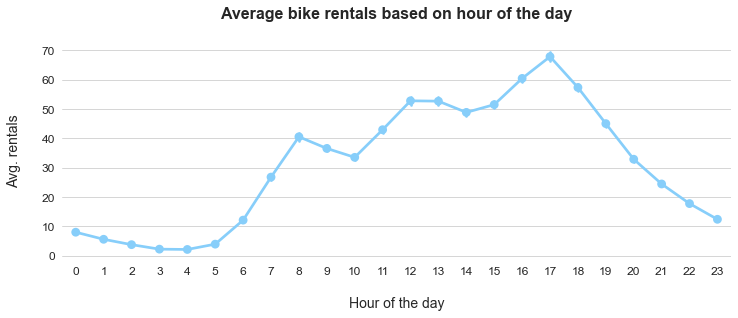

In [42]:
# Assign color palette and figure size as per requirement
plt.figure(figsize=[12,4])
sb.set_style('whitegrid')

# Seaborn's point plot
sb.pointplot(data = hours_df, x = "hour", y = "rentals", linestyles = "-", color = 'lightskyblue')

# improve plot aesthetics
plt.title('Average bike rentals based on hour of the day\n',  weight = 'bold', fontsize = 16)
plt.ylabel('Avg. rentals\n', fontsize = 14)
plt.xlabel('\nHour of the day', fontsize = 14)
plt.xticks(fontsize = 12)
plt.yticks(fontsize = 12)
sb.despine(top=True, right=True, left=True, bottom=True);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.1.6.c Average bike rentals based on hour of the day.png', dpi=300, bbox_inches='tight')

Add annotations to point out the busy hours of the day.

**`Point plot`:**

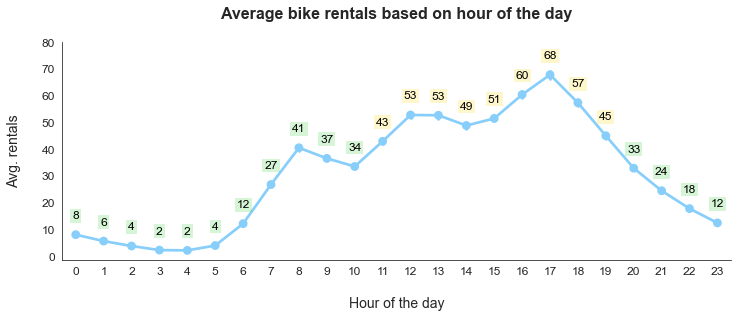

In [43]:
# Assign color palette and figure size as per requirement
plt.figure(figsize=[12,4])
sb.set_style('white')

# Seaborn's point plot
sb.pointplot(data = hours_df, x = "hour", y = "rentals", linestyles = "-", color = 'lightskyblue')

# improve plot aesthetics
plt.title('Average bike rentals based on hour of the day\n',  weight = 'bold', fontsize = 16)
plt.ylabel('Avg. rentals\n', fontsize = 14)
plt.xlabel('\nHour of the day', fontsize = 14)
plt.xticks(fontsize = 12)

# get ytick locs and rearrage them with respect to zero
locs, labels = plt.yticks()
max_count = locs.max()
y_tick_values = np.arange(0,  max_count+10, 10)
y_tick_names = ['{:0.0f}'.format(v) for v in y_tick_values]
plt.yticks(y_tick_values, y_tick_names, fontsize = 12)

# add annotations
# -------------------------------------------------------
avg_rental_counts = hours_df.groupby([hours_df["hour"]]).mean()['rentals']
avg_rental_max = avg_rental_counts.max()
clrs = ['gold' if (count > ((avg_rental_max*3)/5)) else 'limegreen' for count in avg_rental_counts ]

# get the current tick locations and labels
locs, labels = plt.xticks()

# loop through each pair of locations and labels
for loc, label, avg_rental_count, clr in zip(locs, labels, avg_rental_counts, clrs):
    try:
        count = avg_rental_count
    except KeyError:
        count = 0   
    pct_string = '{:0.0f}'.format(count)
    # print the annotation depending on the bar length
    plt.text(loc, count + int(avg_rental_max/10), pct_string, ha = 'center', color = 'black', 
             fontsize = 12, bbox=dict(pad=1.9,alpha=0.2,color='none',fc=clr))
# -------------------------------------------------------

sb.despine(top=True, right=True, left=False, bottom=False);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.1.6.d Average bike rentals based on hour of the day.png', dpi=300, bbox_inches='tight')

**Observations:**
+ The bike rentals aggregated by the hour of the day, depicts that the rentals slowly starts to increase from `6:00 AM` untill `5:00 PM` with a peaks at `8:00 AM`, `12:00 PM`, and `5:00 PM`, which are `Morning office hours`, `Afternoon Lunch time`, and `Evening office relieve` timings respectibely. This concludes that the huge portion of the customer database contain `working individuals`, who use bikes for the transportatioin.
+ The average bike rentals over the hour of the day depicts that the rentals are least during night and early hours.

----

#### 3.1.7 Univariate analysis - Distribution of daytime rentals

+ `Column`: daytime
+ `Data type`: continuous data
+ `Plot` :

**`Count plot`:**

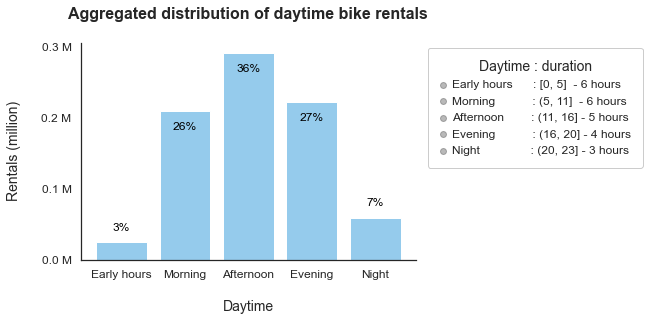

In [44]:
# Assign color palette and figure size as per requirement
plt.figure(figsize = [6, 4])
sb.set(style="white")

# prepare the data for the plot
y_tick_values = np.arange(0,  bikeshare['daytime'].value_counts().max()+100000, 100000)
y_tick_names = ['{:0.1f} M'.format(v/1000000) for v in y_tick_values]

# Seaborn's count plot
sb.countplot(x = 'daytime', data = bikeshare, color = 'lightskyblue')

# improve plot aesthetics
plt.title('Aggregated distribution of daytime bike rentals\n', fontsize = 16, weight = 'bold')
plt.xlabel('\nDaytime', fontsize = 14)
plt.ylabel('Rentals (million)\n', fontsize = 14)
plt.xticks(fontsize = 12)
plt.yticks(y_tick_values, y_tick_names, fontsize = 12)

# add annotations
# -------------------------------------------------------
n_points = bikeshare.shape[0]
daytime_counts = bikeshare['daytime'].value_counts()

# get the current tick locations and labels
locs, labels = plt.xticks()

# loop through each pair of locations and labels
for loc, label in zip(locs, labels):
    try:
        count = daytime_counts[label.get_text()] 
    except KeyError:
        count = 0   
    pct_string = '{:0.0f}%'.format(100*count/n_points)
    # print the annotation depending on the bar length
    if count < (n_points/10):
        plt.text(loc, count + (n_points/50), pct_string, ha = 'center', color = 'black', fontsize = 12)
    else:
        plt.text(loc, count - (n_points/30), pct_string, ha = 'center', color = 'black', fontsize = 12)
# -------------------------------------------------------

# Create a legend:
# -------------------------------------------------------
daytime_order = ['Early hours', 'Morning', 'Afternoon', 'Evening', 'Night']
duration_order = ['[0, 5]  - 6 hours', '(5, 11]  - 6 hours', '(11, 16] - 5 hours', '(16, 20] - 4 hours', '(20, 23] - 3 hours']
indents = [16, 17, 16, 17, 19]

# Plot empty lists with the desired label
for time, duration, indent in zip(daytime_order, duration_order, indents):
    plt.scatter([], [], c='k', alpha=0.3,
                label= '{}'.format(time).ljust(indent, ' ') + ' : ' + '{}'.format(duration))
    
plt.legend(scatterpoints=1, frameon=True, fancybox=True, shadow=False, ncol = 1, framealpha = 1, 
           borderpad=1, borderaxespad=1, bbox_to_anchor = (1, 0.7), loc = 6, labelspacing=0.5,  
           title='Daytime : duration', title_fontsize=14, fontsize=12, facecolor='white', 
           markerfirst=True, handlelength=0.5, handletextpad=0.5)
# -------------------------------------------------------

sb.despine();

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.1.7.a Aggregated distribution of bike rentals based on time of the day.png', dpi=300, bbox_inches='tight')

**`Find average rentals based on the daytime:`**

Create a dataset which contain bike rentals relative to time of the day over respective months in any year. Care should be taken as to inlcude all daytimes in every day of the month. Use all categorical combinations and fill the NULL values with numerical zero's so as to consider bike rentals subjected to each daytime in any day.

In [45]:
# create a dataset for bike rentals for each daytime of the day
daytime_df = bikeshare.groupby([bikeshare['year'], 
                                bikeshare['month'], 
                                bikeshare['day'], 
                                bikeshare['daytime']]).count()['trip_id'].reset_index(name='rentals')

daytime_df['rentals'] = daytime_df['rentals'].fillna(0).astype(int)
daytime_df.head(10)

,year,month,day,daytime,rentals
0,2017,1,1,Early hours,27
1,2017,1,1,Morning,35
2,2017,1,1,Afternoon,143
3,2017,1,1,Evening,50
4,2017,1,1,Night,15
5,2017,1,2,Early hours,4
6,2017,1,2,Morning,50
7,2017,1,2,Afternoon,145
8,2017,1,2,Evening,44
9,2017,1,2,Night,16


**`Point plot`:**

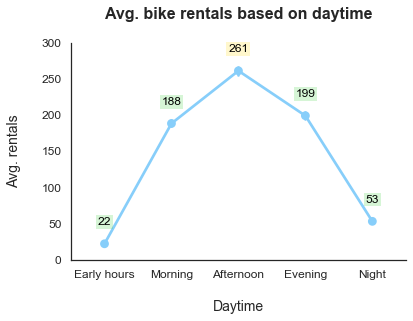

In [46]:
# Assign color palette and grid as per requirement
sb.set_style('white')

# Seaborn's point plot
sb.pointplot(data = daytime_df, x = "daytime", y = "rentals", linestyles = "-", color = 'lightskyblue')

# improve plot aesthetics
plt.title('Avg. bike rentals based on daytime\n',  weight = 'bold', fontsize = 16)
plt.ylabel('Avg. rentals\n', fontsize = 14)
plt.xlabel('\nDaytime', fontsize = 14)
plt.xticks(fontsize = 12)

# get ytick locs and rearrage them with respect to zero
locs, labels = plt.yticks()
max_count = locs.max()
y_tick_values = np.arange(0,  max_count+50, 50)
y_tick_names = ['{:0.0f}'.format(v) for v in y_tick_values]
plt.yticks(y_tick_values, y_tick_names, fontsize = 12)

# add annotations
# -------------------------------------------------------
cat_order = daytime_df.daytime.sort_values(ascending=True).unique()
avg_rental_counts = daytime_df.groupby([daytime_df["daytime"]]).mean()['rentals'][cat_order]
avg_rental_max = avg_rental_counts.max()
clrs = ['gold' if (count > ((avg_rental_max*4)/5)) else 'limegreen' for count in avg_rental_counts ]

# get the current tick locations and labels
locs, labels = plt.xticks()

# loop through each pair of locations and labels
for loc, label, avg_rental_count, clr in zip(locs, labels, avg_rental_counts, clrs):
    try:
        count = avg_rental_count
    except KeyError:
        count = 0   
    pct_string = '{:0.0f}'.format(count)
    # print the annotation depending on the bar length
    plt.text(loc, count + int(avg_rental_max/10), pct_string, ha = 'center', color = 'black', 
             fontsize = 12, bbox=dict(pad=1.9,alpha=0.2,color='none',fc=clr))
# -------------------------------------------------------

sb.despine(top=True, right=True, left=False, bottom=False);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.1.7.b Average bike rentals based on time of the day.png', dpi=300, bbox_inches='tight')

**Observations:**
+ The above plot depicts that the rental activity is highest around `Afternoon`, with `Morining` and `Evening` being closest. This denotes that the customers use bike rentals to avoid bright sun.
+ The rental activity is least at `Early Hours` and `Night` times. Promoting fitness activities will increase rental activity during `Early Hours`. While tie up with night events will boost `Night` rentals.

-------------

#### 3.1.8 Univariate analysis - Distribution of daily rentals

+ `Column`: day
+ `Data type`: continuous data
+ `Plot` :

**`Line plot`:**

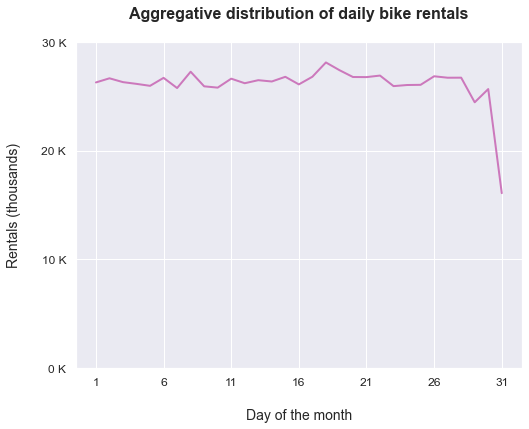

In [47]:
# Assign figure size and color palette as per requirement
plt.figure(figsize = [8, 6])
sb.set_style('darkgrid')
sb.set_palette(palette = 'colorblind', n_colors = 10, desat = None)
clr = sb.color_palette()[4]

# prepare data for the plot
x = bikeshare.groupby(bikeshare['day']).count()['trip_id'].index
y = bikeshare.groupby(bikeshare['day']).count()['trip_id'].values
day_index_max = bikeshare.day.sort_values(ascending=False).unique()[0]
x_tick_values = np.arange(1,  day_index_max+1, 5)
x_tick_names = ['{:}'.format(v) for v in x_tick_values]
y_tick_values = np.arange(0,  bikeshare.day.value_counts().max()+10000, 10000)
y_tick_names = ['{:0.0f} K'.format(v/1000) for v in y_tick_values]

# matplotlib's line plot
plt.plot(x, y, linewidth=2.0, color = clr)

# improve plot aestetics
plt.title('Aggregative distribution of daily bike rentals\n', fontsize = 16, weight = 'bold')
plt.xlabel('\nDay of the month', fontsize = 14)
plt.ylabel('Rentals (thousands)\n', fontsize = 14)
plt.xticks(x_tick_values, x_tick_names, fontsize = 12)
plt.yticks(y_tick_values, y_tick_names, fontsize = 12);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.1.8.a Aggregated distribution of daily bike rentals.png', dpi=300, bbox_inches='tight')

**`Bar chart`:**

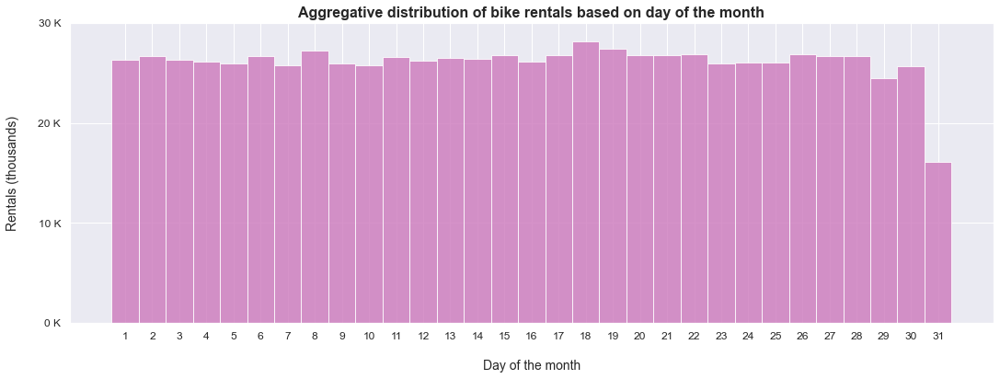

In [48]:
# Assign figure size and color palette as per requirement
plt.figure(figsize = [18, 6])
sb.set_style('darkgrid')
sb.set_palette(palette = 'colorblind', n_colors = 10, desat = None)
clr = sb.color_palette()[4]

# prepare data for the plot
max_count = bikeshare.day.value_counts().max()
day_index_max = bikeshare.day.sort_values(ascending=False).unique()[0]
x_tick_values = np.arange(1,  day_index_max+1, 1)
x_tick_names = ['{:}'.format(v) for v in x_tick_values]
y_tick_values = np.arange(0,  max_count+10000, 10000)
y_tick_names = ['{:0.0f} K'.format(v/1000) for v in y_tick_values]
bin_edges = np.arange(0.5,  31.5+1, 1)

# Seaborn's distribution plot
sb.distplot(bikeshare.day, bins = bin_edges, kde = False, color = clr,
            hist_kws = {'alpha' : 0.8, 'edgecolor' : "white", 'linewidth' : 1})

# improve plot aesthetics
plt.title('Aggregative distribution of bike rentals based on day of the month', fontsize = 16, weight = 'bold')
plt.xlabel('\nDay of the month', fontsize = 14)
plt.ylabel('Rentals (thousands)\n', fontsize = 14)
plt.xticks(x_tick_values, x_tick_names, fontsize = 12)
plt.yticks(y_tick_values, y_tick_names, fontsize = 12);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.1.8.b Aggregated distribution of bike rentals based on day of the month.png', dpi=300, bbox_inches='tight')

The  above plots depicts that the day `31st` has less aggregate bike rentals compared to other days in the month. Plot a `barchart` with annotations to potray the difference in bike rentals on day `31st`, compared to other days in the month.

**`Bar chart:`**

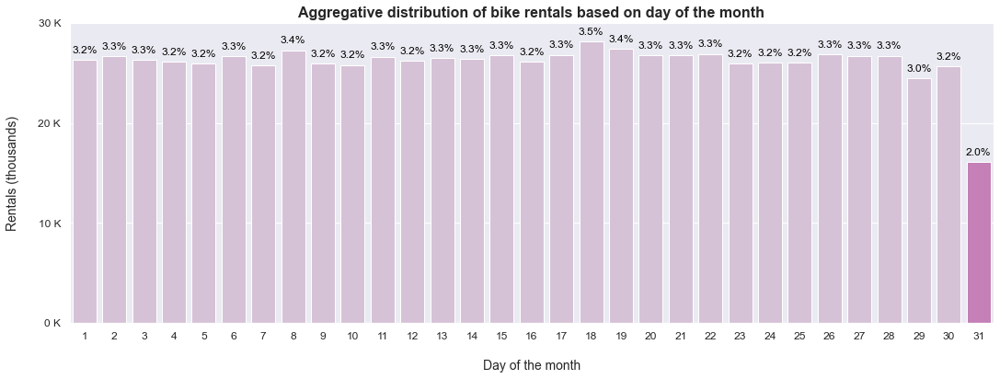

In [49]:
# Assign figure size and color palette as per requirement
plt.figure(figsize = [18, 6])
sb.set_style('darkgrid')
sb.set_palette(palette = 'colorblind', n_colors = 10, desat = None)
clr = sb.color_palette()[4]

# prepare data for the plot
day_index_max = bikeshare.day.sort_values(ascending=False).unique()[0]
daily_order = np.arange(1,  day_index_max+1, 1)
max_count = bikeshare.day.value_counts().max()
min_count = bikeshare.day.value_counts().min()
tick_values = np.arange(0,  max_count+10000, 10000)
tick_names = ['{:0.0f} K'.format(v/1000) for v in tick_values]
day_values = bikeshare.day.value_counts().values
clrs = ['thistle' if (x > min_count) else clr for x in day_values ]

# Seaborn's count plot
sb.countplot(data = bikeshare, x = 'day', palette=clrs, 
             alpha= 1, order = daily_order, saturation = 0.8)

# improve plot aesthetics
plt.title('Aggregative distribution of bike rentals based on day of the month', fontsize = 16, weight = 'bold')
plt.xlabel('\nDay of the month', fontsize = 14)
plt.ylabel('Rentals (thousands)\n', fontsize = 14)
plt.xticks(fontsize = 12)
plt.yticks(tick_values, tick_names, fontsize = 12)

# add annotations
# -------------------------------------------------------
n_points = bikeshare.shape[0]
daily_counts = bikeshare.day.value_counts()
daily_max = daily_counts.max()
# get the current tick locations and labels
locs, labels = plt.xticks()
    
# loop through each pair of locations and labels
for loc, label in zip(locs, labels):
    try:
        count = daily_counts[int(label.get_text())] 
    except KeyError:
        count = 0   
    pct_string = '{:0.1f}%'.format(100*count/n_points)
    # print the annotation depending on the bar length
    if count < (daily_max/10):
        plt.text(loc, count + (daily_max/40), pct_string, ha = 'center', color = 'black', fontsize = 12)
    else:
        plt.text(loc, count + (daily_max/40), pct_string, ha = 'center', color = 'black', fontsize = 12)
# -------------------------------------------------------

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.1.8.c Aggregated distribution of bike rentals based on day of the month.png', dpi=300, bbox_inches='tight')

The above plots depicts that the rentals decrease during the end of the month, especially on **`31`**'st of the month. The bike rentals are categorized over the day of the month, the distribution is calculated based on the cummulative summation of day over 3 years but not individual month. Hence, there are only `21` occurances of day `31st`, while other days has an occurance of `36` over the time period of 3 years (2017-2019), except for days `29` and `30` which counts to `33` due to absence in February month. This denotes that the rate of rentals is actually high on `31st` compared to other days.

**`Find average rentals based on the day of the month:`**

Create a dataset which contain bike rentals relative to each day in the month over respective years. Care should be taken as not to inlcude the day `31st` in every month of the year. Use only the **unique appearences** of categorical combinations and do not fill the `NULL` values with numerical `zero's` so as to consider bike rentals of day `31st` on certain months only but not in every month.

In [50]:
# create a dataset for bike rentals over the days of the month
days_df = bikeshare.groupby([bikeshare["year"], 
                             bikeshare["month"],
                             bikeshare["day"]]).size().reset_index(name='rentals')

days_df.tail(10)

,year,month,day,rentals
1085,2019,12,22,442
1086,2019,12,23,398
1087,2019,12,24,512
1088,2019,12,25,303
1089,2019,12,26,455
1090,2019,12,27,700
1091,2019,12,28,650
1092,2019,12,29,536
1093,2019,12,30,804
1094,2019,12,31,805


Check the appearances of individual days over the dataset created.

In [51]:
cat_order = days_df.day.sort_values(ascending=True).unique()
print('Month - Occurances')
days_df.day.value_counts()[cat_order]

Month - Occurances


1     36
2     36
3     36
4     36
5     36
6     36
7     36
8     36
9     36
10    36
11    36
12    36
13    36
14    36
15    36
16    36
17    36
18    36
19    36
20    36
21    36
22    36
23    36
24    36
25    36
26    36
27    36
28    36
29    33
30    33
31    21
Name: day, dtype: int64

The above cell depicts that the days `29`, `30`, and `31` has relatively less appearences compared to the other days in the month. This confirms the reliability of the dataset to calculate the average bike rentals based on day of the month.

**`Point plot:`**

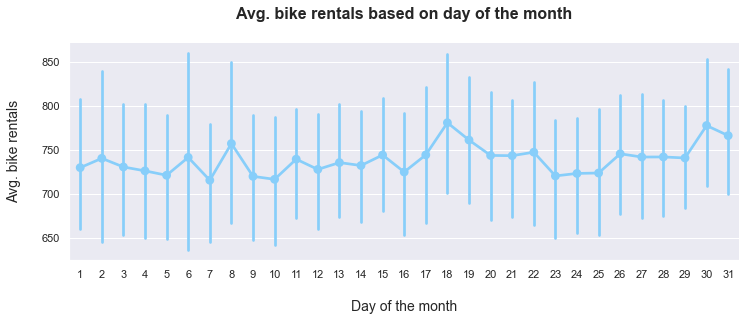

In [52]:
# Assign grid and figure size as per requirement
plt.figure(figsize=[12,4])
sb.set_style('darkgrid')

# Seaborn's point plot
sb.pointplot(data = days_df, x = "day", y = "rentals", linestyles = "-", color = 'lightskyblue')

# improve plot aesthetics
plt.title('Avg. bike rentals based on day of the month\n',  weight = 'bold', fontsize = 16)
plt.ylabel('Avg. bike rentals\n', fontsize = 14)
plt.xlabel('\nDay of the month', fontsize = 14)
sb.despine();

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.1.8.d Average bike rentals based on day of the month.png', dpi=300, bbox_inches='tight')

The above plot contains error distribution lines over standard deviation and is interferring with the interpretability of the plot. Hence remove the error distribution lines for clear plot aesthetics.

**`Point plot:`**

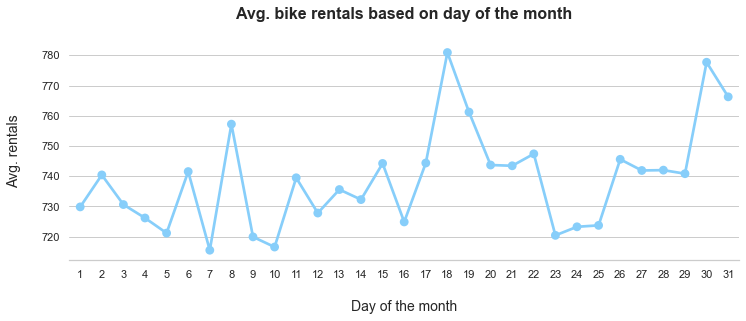

In [53]:
# Assign grid and figure size as per requirement
plt.figure(figsize=[12,4])
sb.set_style('whitegrid')

# Seaborn's point plot
sb.pointplot(data = days_df, x = "day", y = "rentals", linestyles = "-", color = 'lightskyblue', ci=None)

# improve plot aesthetics
plt.title('Avg. bike rentals based on day of the month\n',  weight = 'bold', fontsize = 16)
plt.ylabel('Avg. rentals\n', fontsize = 14)
plt.xlabel('\nDay of the month', fontsize = 14)
sb.despine(top=True, right=True, left=True, bottom=False);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.1.8.e Average bike rentals based on day of the month.png', dpi=300, bbox_inches='tight')

On contrary to the previous plots, the above plot depicts that the days subjected to end of the month have relatively high average bike rentals compared to most of the days in the month. However the above plot is not potrayed with respect to zero on the axis and amplifies the difference between the average rentals for any given day in the month. Re-plot the above graph with respect to zero over y-aixs.

**`Point plot:`**

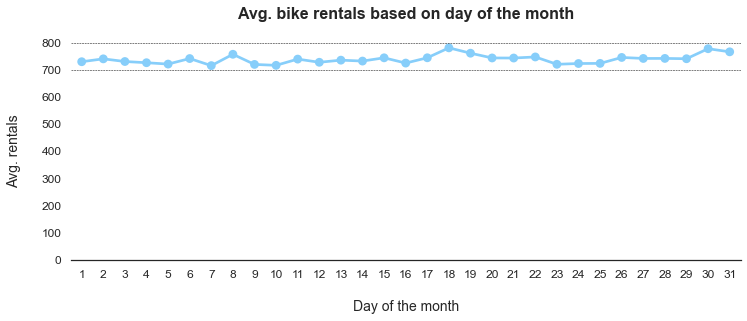

In [54]:
# Assign grid and figure size as per requirement
plt.figure(figsize=[12,4])
sb.set_style('white')

# Seaborn's point plot
sb.pointplot(data = days_df, x = "day", y = "rentals", linestyles = "-", color = 'lightskyblue', ci=None)

# improve plot aesthetics
plt.title('Avg. bike rentals based on day of the month\n',  weight = 'bold', fontsize = 16)
plt.ylabel('Avg. rentals\n', fontsize = 14)
plt.xlabel('\nDay of the month', fontsize = 14)
plt.xticks(fontsize = 12)

# get ytick locs and rearrage them with respect to zero
locs, labels = plt.yticks()
max_count = locs.max()
y_tick_values = np.arange(0,  max_count+100, 100)
y_tick_names = ['{:0.0f}'.format(v) for v in y_tick_values]
plt.yticks(y_tick_values, y_tick_names, fontsize = 12)

# draw the vertical axial lines
plt.axhline(700, color='black', alpha=1, linewidth=0.5, linestyle='--')
plt.axhline(800, color='black', alpha=1, linewidth=0.5, linestyle='--')

sb.despine(top=True, right=True, left=True, bottom=False);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.1.8.f Average bike rentals based on day of the month.png', dpi=300, bbox_inches='tight')

The distribution of average bike rentals over the day of the month, ranges between `700` and `800` only. This depicts that there is no significant differance in average bike rentals subjected to any two days given in a month.

**Observations:**
+ The bike rentals aggregated over day of the month depicts that the rentals decrease slightly during the end of the month. However on deeper analysis of the data by calculating the average bike rentals it is clear that the rental activity actually increases during the end of the month.
+ The distribution of average bike rentals over the day of the month, ranges between `700` and `800` only. This depicts that there is no significant differance in average bike rentals subjected to any two days given in a month.

------

#### 3.1.9 Univariate analysis - Distribution of weekly rentals

+ `Column`: weekday
+ `Data type`: continuous data
+ `Plot` :

**`Bar chart:`**

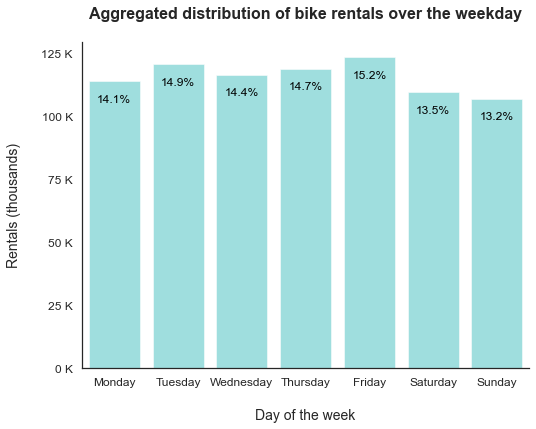

In [55]:
# Assign figure size and color palette as per requirement
plt.figure(figsize = [8, 6])
sb.set_style('white')

# prepare data for the plot
day_order = bikeshare.weekday.sort_values(ascending=True).unique()
max_count = bikeshare.weekday.value_counts().max()
y_tick_values = np.arange(0, max_count+25000, 25000)
y_tick_names = ['{:0.0f} K'.format(v/1000) for v in y_tick_values]

# Seaborn's count plot
sb.countplot(data = bikeshare, x = 'weekday', color = 'cyan', 
             alpha= 0.5, order = day_order, saturation = 0.5)

# improve plot aesthetics
plt.title('Aggregated distribution of bike rentals over the weekday\n', fontsize = 16, weight = 'bold')
plt.xlabel('\nDay of the week', fontsize = 14)
plt.ylabel('Rentals (thousands)\n', fontsize = 14)
plt.xticks(fontsize = 12)
plt.yticks(y_tick_values, y_tick_names, fontsize = 12)

# add annotations
# -------------------------------------------------------
n_points = bikeshare.shape[0]
day_counts = bikeshare.weekday.value_counts()
day_max = day_counts.max()
# get the current tick locations and labels
locs, labels = plt.xticks()

# loop through each pair of locations and labels
for loc, label in zip(locs, labels):
    # get the text property for the label to get the correct count
    try:
        count = day_counts[loc]
        pct_string = '{:0.1f}%'.format(100*count/n_points)
    except KeyError:
        count = 15000
        pct_string = '0%'

    # print the annotation depending on the bar length
    if count < (day_max/10):
        plt.text(loc, count+(day_max/25), pct_string, ha = 'center', color = 'black', fontsize = 12)
    else:
        plt.text(loc, count-(day_max/15), pct_string, ha = 'center', color = 'black', fontsize = 12)
# -------------------------------------------------------

sb.despine();

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.1.9.a Aggregated distribution of bike rentals over the week.png', dpi=300, bbox_inches='tight')

The above plots depicts that the `day of the week` **does not** have much impact on the rentals.

**`Find average rentals based on the weekday:`**

Create a dataset which contain bike rentals relative to day of the week over respective months in any year. Care should be taken as to inlcude all days in every week of the month. Use all categorical combinations and fill the NULL values with numerical zero's so as to consider bike rentals subjected to each day in any week.

In [56]:
# create a dataset for bike rentals over the days in a week
weekday_df = bikeshare.groupby([bikeshare['year'], 
                                bikeshare['month'],
                                bikeshare['week'],
                                bikeshare['weekday']]).count()['trip_id'].reset_index(name='rentals')

weekday_df['rentals'] = weekday_df['rentals'].fillna(0).astype(int)
weekday_df.head(10)

,year,month,week,weekday,rentals
0,2017,1,First,Monday,259
1,2017,1,First,Tuesday,327
2,2017,1,First,Wednesday,350
3,2017,1,First,Thursday,231
4,2017,1,First,Friday,361
5,2017,1,First,Saturday,277
6,2017,1,First,Sunday,270
7,2017,1,Second,Monday,306
8,2017,1,Second,Tuesday,245
9,2017,1,Second,Wednesday,315


**`Point plot:`**

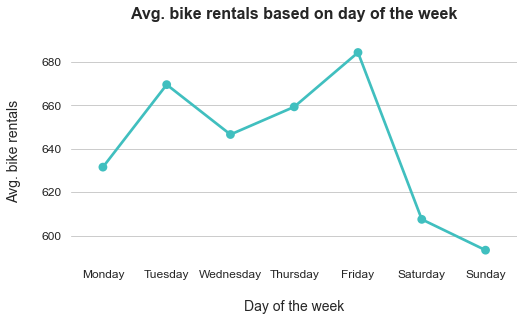

In [57]:
# Assign teh palette and figure size as per requirement
plt.figure(figsize=[8,4])
sb.set_style('whitegrid')
flatui = ['cyan']
sb.set_palette(flatui, n_colors=1, desat=0.5)

# Seaborn's point plot
sb.pointplot(data = weekday_df, x = "weekday", y = "rentals", linestyles = "-", 
             color = sb.color_palette()[0], ci=None, alpha=0.5)

# improve plot aesthetics
plt.title('Avg. bike rentals based on day of the week\n',  weight = 'bold', fontsize = 16)
plt.ylabel('Avg. bike rentals\n', fontsize = 14)
plt.xlabel('\nDay of the week', fontsize = 14)
plt.xticks(fontsize = 12)
plt.yticks(fontsize = 12)
sb.despine(top=True, right=True, left=True, bottom=True);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.1.9.b Average bike rentals based on day of the week.png', dpi=300, bbox_inches='tight')

The above plot depicts that the `Saturdays` and `Sundays` have relatively low average bike rentals compared to other days in the week. This depicts that the part of customer database contain working employees that use bikes for a ride to work. However the above plot is not potrayed with respect to zero on the axis and amplifies the difference between the average rentals for any given day in the week. Re-plot the above graph with respect to zero over y-aixs.

**`Point plot:`**

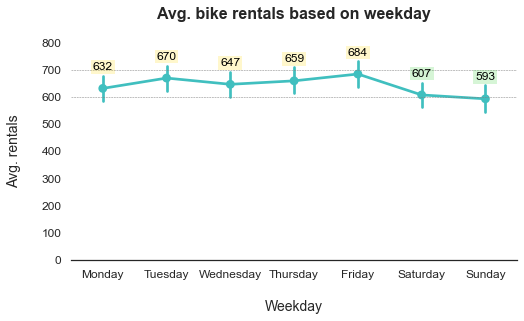

In [58]:
# Assign palette and figure size as per requirement
plt.figure(figsize=[8,4])
sb.set_style('white')
flatui = ['cyan']
sb.set_palette(flatui, n_colors=1, desat=0.5)
base_color = sb.color_palette()[0]

# Seaborn's point plot
sb.pointplot(data = weekday_df, x = "weekday", y = "rentals", linestyles = "-", color = base_color)

# improve plot aesthetics
plt.title('Avg. bike rentals based on weekday\n',  weight = 'bold', fontsize = 16)
plt.ylabel('Avg. rentals\n', fontsize = 14)
plt.xlabel('\nWeekday', fontsize = 14)
plt.xticks(fontsize = 12)
# get ytick locs and rearrage them with respect to zero
locs, labels = plt.yticks()
max_count = locs.max()
y_tick_values = np.arange(0,  max_count+100, 100)
y_tick_names = ['{:0.0f}'.format(v) for v in y_tick_values]
plt.yticks(y_tick_values, y_tick_names, fontsize = 12)

# add annotations
# -------------------------------------------------------
cat_order = weekday_df.weekday.sort_values(ascending=True).unique()
avg_rental_counts = weekday_df.groupby([weekday_df["weekday"]]).mean()['rentals'][cat_order]
avg_rental_max = avg_rental_counts.max()
clrs = ['gold' if (count > ((avg_rental_max*9)/10)) else 'limegreen' for count in avg_rental_counts ]

# get the current tick locations and labels
locs, labels = plt.xticks()

# loop through each pair of locations and labels
for loc, label, avg_rental_count, clr in zip(locs, labels, avg_rental_counts, clrs):
    try:
        count = avg_rental_count
    except KeyError:
        count = 0   
    pct_string = '{:0.0f}'.format(count)
    # print the annotation depending on the bar length
    plt.text(loc, count + int(avg_rental_max/10), pct_string, ha = 'center', color = 'black', 
             fontsize = 12, bbox=dict(pad=1.9,alpha=0.2,color='none',fc=clr))
# -------------------------------------------------------

# draw the vertical axial lines
plt.axhline(600, color='grey', alpha=1, linewidth=0.5, linestyle='--')
plt.axhline(700, color='grey', alpha=1, linewidth=0.5, linestyle='--')

sb.despine(top=True, right=True, left=True, bottom=False);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.1.9.c Average bike rentals based on day of the week.png', dpi=300, bbox_inches='tight')

The above plot depicts the distribution of average bike rentals over the day of the week, mostly which ranges between `600` and `700`. The `yellow` annotations represent the busy days of the week. This depicts that there is slight decrease in average bike rentals on the weekend (saturday, sunday) while `Friday` apeears to be most busiest day of the week.


**Observations:**
    
+ The above plot depicts the distribution of average bike rentals over the day of the week, mostly which ranges between `600` and `700`. The `yellow` annotations represent the busy days of the week. This depicts that there is slight decrease in average bike rentals on the weekend (saturday, sunday) while `Friday` apeears to be most busiest day of the week.
+ Organizing/promoting fitness/recreational activities like `10K bike rides` will potentially increase the bike rentals on the weekends, significantly.

-----

#### 3.1.10 Univariate analysis - Distribution of weekly rentals

+ `Column`: week
+ `Data type`: continuous data
+ `Plot` :

**`Count plot:`**

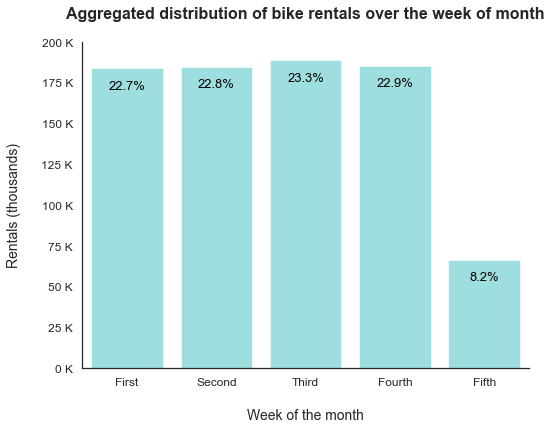

In [59]:
# Assign figure size and grid as per requirement
plt.figure(figsize = [8, 6])
sb.set_style('white')

# prepare data for the plot
day_order = bikeshare.week.sort_values(ascending=True).unique()
max_count = bikeshare.week.value_counts().max()
y_tick_values = np.arange(0, max_count+25000, 25000)
y_tick_names = ['{:0.0f} K'.format(v/1000) for v in y_tick_values]

# Seaborn's count plot
sb.countplot(data = bikeshare, x = 'week', color = 'cyan', 
             alpha= 0.5, order = day_order, saturation = 0.5)

# improve plot aestetics
plt.title('Aggregated distribution of bike rentals over the week of month\n', fontsize = 16, weight = 'bold')
plt.xlabel('\nWeek of the month', fontsize = 14)
plt.ylabel('Rentals (thousands)\n', fontsize = 14)
plt.xticks(fontsize = 12)
plt.yticks(y_tick_values, y_tick_names, fontsize = 12)

# add annotations
# -------------------------------------------------------
n_points = bikeshare.shape[0]
day_counts = bikeshare.week.value_counts()
day_max = day_counts.max()
# get the current tick locations and labels
locs, labels = plt.xticks()

# loop through each pair of locations and labels
for loc, label in zip(locs, labels):
    # get the text property for the label to get the correct count
    try:
        count = day_counts[loc]
        pct_string = '{:0.1f}%'.format(100*count/n_points)
    except KeyError:
        count = 15000
        pct_string = '0%'

    # print the annotation depending on the bar length
    if count < (day_max/10):
        plt.text(loc, count+(day_max/25), pct_string, ha = 'center', color = 'black', fontsize = 13)
    else:
        plt.text(loc, count-(day_max/15), pct_string, ha = 'center', color = 'black', fontsize = 13)
# -------------------------------------------------------

sb.despine();

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.1.10.a Aggregated distribution of bike rentals over the week of the month.png', dpi=300, bbox_inches='tight')

The `Fifth` week has cummulative low bike rentals because of less number of days. The `Fifth` weeks has either `0` (February) or `2` or `3` days while the rest of the weeks has a constant `7 days`. Hence ignoring the fifth week, other weeks have closer distribution and does not much impact on the bike rentals over the week of the month.

**`Find average rentals based on the weekday:`**

Create a dataset which contain bike rentals relative to week of the month over respective years. Care should be taken as to inlcude every week in the month. Use all categorical combinations and fill the NULL values with numerical zero's so as to consider bike rentals subjected to each week in any month.

In [60]:
# create a dataset for bike rentals over the week of the month
week_df = bikeshare.groupby([bikeshare['year'], 
                             bikeshare['month'],
                             bikeshare['week']]).count()['trip_id'].reset_index(name='rentals')

week_df['rentals'] = week_df['rentals'].fillna(0).astype(int)
week_df.head(10)

,year,month,week,rentals
0,2017,1,First,2075
1,2017,1,Second,2109
2,2017,1,Third,2434
3,2017,1,Fourth,2296
4,2017,1,Fifth,1242
5,2017,2,First,2124
6,2017,2,Second,2472
7,2017,2,Third,2071
8,2017,2,Fourth,2701
9,2017,2,Fifth,0


**`Point plot:`**

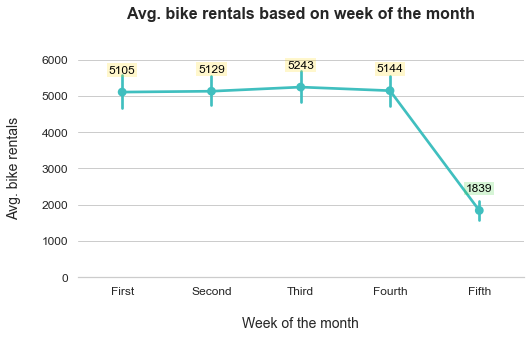

In [61]:
# Assign figure size and color palette as per requirement
plt.figure(figsize=[8,4])
sb.set_style('whitegrid')
flatui = ['cyan']
sb.set_palette(flatui, n_colors=1, desat=0.5)

# Seaborn's point plot
sb.pointplot(data = week_df, x = "week", y = "rentals", linestyles = "-", color = sb.color_palette()[0])

# improve plot aesthetics
plt.title('Avg. bike rentals based on week of the month\n\n',  weight = 'bold', fontsize = 16)
plt.ylabel('Avg. bike rentals\n', fontsize = 14)
plt.xlabel('\nWeek of the month', fontsize = 14)
plt.xticks(fontsize = 12)
# get ytick locs and rearrage them with respect to zero
locs, labels = plt.yticks()
max_count = locs.max()
y_tick_values = np.arange(0,  max_count+1000, 1000)
y_tick_names = ['{:0.0f}'.format(v) for v in y_tick_values]
plt.yticks(y_tick_values, y_tick_names, fontsize = 12)

# add annotations
# -------------------------------------------------------
cat_order = week_df.week.sort_values(ascending=True).unique()
avg_rental_counts = week_df.groupby([week_df["week"]]).mean()['rentals'][cat_order]
avg_rental_max = avg_rental_counts.max()
clrs = ['gold' if (count > ((avg_rental_max*4)/5)) else 'limegreen' for count in avg_rental_counts ]

# get the current tick locations and labels
locs, labels = plt.xticks()

# loop through each pair of locations and labels
for loc, label, avg_rental_count, clr in zip(locs, labels, avg_rental_counts, clrs):
    try:
        count = avg_rental_count
    except KeyError:
        count = 0   
    pct_string = '{:0.0f}'.format(count)
    # print the annotation depending on the bar length
    plt.text(loc, count + int(avg_rental_max/10), pct_string, ha = 'center', color = 'black', 
             fontsize = 12, bbox=dict(pad=1.9,alpha=0.2,color='none',fc=clr))
# -------------------------------------------------------

sb.despine(top=True, right=True, left=True, bottom=False);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.1.10.b Average bike rentals over the week of the month.png', dpi=300, bbox_inches='tight')

> The `Fifth` week has relatively low bike rentals because of less number of days. The `Fifth` weeks has either `0` (February) or `2` or `3` days while the rest of the weeks has a constant `7 days`.

**Observations:**
    
+ Most of the weeks in a month has uniform bike rentals except for the fifth week, due to less number of days it holds. Hence the week of the month does not have any significant effect on the bike rentals.

-------------

#### 3.1.11 Univariate analysis - Distribution of monthly rentals

+ `Column`: month
+ `Data type`: continuous data
+ `Plot` :

**`Line plot:`**

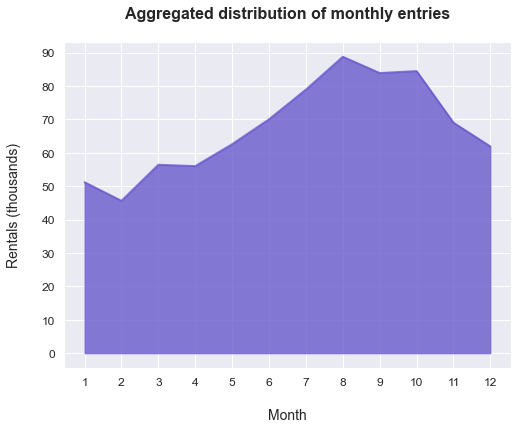

In [62]:
# Assign figure size and grid as per requirement
sb.set_style('darkgrid')
plt.figure(figsize = [8, 6])

# prepare data for the plot
x = bikeshare.groupby(bikeshare['month']).count()['trip_id'].index
y = bikeshare.groupby(bikeshare['month']).count()['trip_id'].values
max_count = bikeshare.month.value_counts().max()
month_index_max = bikeshare.month.sort_values(ascending=False).unique()[0]
x_tick_values = np.arange(1, month_index_max+1, 1)
x_tick_names = ['{:}'.format(v) for v in x_tick_values]
y_tick_values = np.arange(0, max_count+10000, 10000)
y_tick_names = ['{:0.0f}'.format(v/1000) for v in y_tick_values]

# Matplotlibs's line plot
plt.plot(x, y, linewidth=2.0, color = 'slateblue', alpha = 0.8)

# improve plot aesthetics
plt.title('Aggregated distribution of monthly entries\n', fontsize = 16, weight = 'bold')
plt.xlabel('\nMonth', fontsize = 14)
plt.ylabel('Rentals (thousands)\n', fontsize = 14)
plt.xticks(x_tick_values, x_tick_names, fontsize = 12)
plt.yticks(y_tick_values, y_tick_names, fontsize = 12)
plt.fill_between(x, y, color = 'slateblue', alpha = 0.8);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.1.11.a Aggregated distribution of monthly rentals.png', dpi=300, bbox_inches='tight')

**`Distribution plot:`**

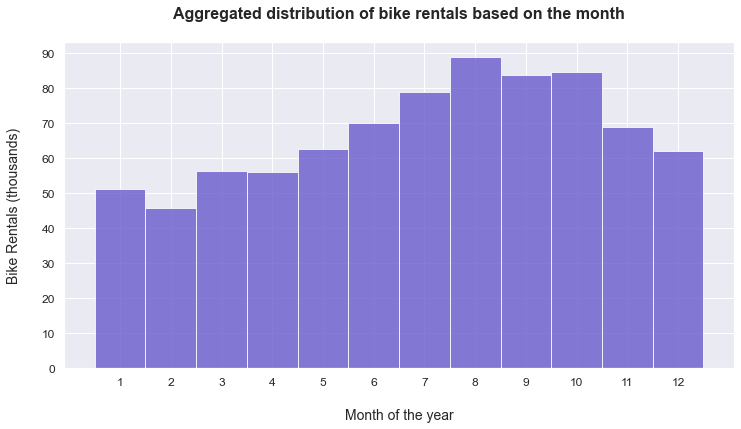

In [63]:
# Assign figure size and grid as per requirement
sb.set_style('darkgrid')
plt.figure(figsize = [12, 6])

# prepare data for the plot
max_count = bikeshare.month.value_counts().max()
month_index_max = bikeshare.month.sort_values(ascending=False).unique()[0]
x_tick_values = np.arange(1, month_index_max+1, 1)
x_tick_names = ['{:}'.format(v) for v in x_tick_values]
y_tick_values = np.arange(0, max_count+10000, 10000)
y_tick_names = ['{:0.0f}'.format(v/1000) for v in y_tick_values]
bin_edges = np.arange(0.5,  12.5+1, 1)

# Seaborn's distribution plot
sb.distplot(bikeshare.month, bins = bin_edges, kde = False, color = 'slateblue',
            hist_kws = {'alpha' : 0.8, 'edgecolor' : "white", 'linewidth' : 1})

# improve plot aesthetics
plt.title('Aggregated distribution of bike rentals based on the month\n', fontsize = 16, weight = 'bold')
plt.xlabel('\nMonth of the year', fontsize = 14)
plt.ylabel('Bike Rentals (thousands)\n', fontsize = 14)
plt.xticks(x_tick_values, x_tick_names, fontsize = 12)
plt.yticks(y_tick_values, y_tick_names, fontsize = 12);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.1.11.b Aggregated distribution of monthly rentals.png', dpi=300, bbox_inches='tight')

The above plot depicts that the month `August` has the most aggregated bike rentals while the month `February` has the least aggregated bike rentals. Plot a bar chart with annotations for a more clear interpretation.

**`count plot:`**

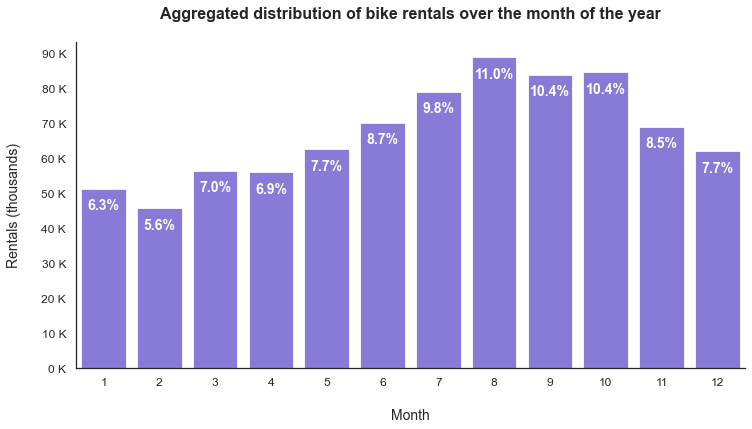

In [64]:
# Assign figure size and grid as per requirement
sb.set_style('white')
plt.figure(figsize = [12, 6])

# prepare data for the plot
month_index_max = bikeshare.month.sort_values(ascending=False).unique()[0]
monthly_order = np.arange(1, month_index_max+1, 1)
max_count = bikeshare.month.value_counts().max()
min_count = bikeshare.month.value_counts().min()
tick_values = np.arange(0, max_count+10000, 10000)
tick_names = ['{:0.0f} K'.format(v/1000) for v in tick_values]
values = bikeshare.month.value_counts().values
bin_edges = np.arange(0.5,  12.5+1, 1)

# Seaborn's count plot
sb.countplot(data = bikeshare, x = 'month', color = 'slateblue', 
             alpha= 0.8, order = monthly_order, saturation = 1)

# improve plot aesthetics
plt.title('Aggregated distribution of bike rentals over the month of the year\n', fontsize = 16, weight = 'bold')
plt.xlabel('\nMonth', fontsize = 14)
plt.ylabel('Rentals (thousands)\n', fontsize = 14)
plt.xticks(fontsize = 12)
plt.yticks(tick_values, tick_names, fontsize = 12)

# add annotations
# -------------------------------------------------------
n_points = bikeshare.shape[0]
monthly_counts = bikeshare.month.value_counts()
monthly_max = bikeshare.month.value_counts().max()
# get the current tick locations and labels
locs, labels = plt.xticks()

# loop through each pair of locations and labels
for loc, label in zip(locs, labels):
    # get the text property for the label to get the correct count
    try:
        count = monthly_counts[int(label.get_text())]
        pct_string = '{:0.1f}%'.format(100*count/n_points)
    except KeyError:
        count = 10000
        pct_string = '0%'

    # print the annotation depending on the bar length
    if count < (monthly_max/10):
        plt.text(loc, count+(monthly_max/25), pct_string, ha = 'center', color = 'white', weight = 'bold', fontsize = 14)
    else:
        plt.text(loc, count-(monthly_max/15), pct_string, ha = 'center', color = 'white', weight = 'bold', fontsize = 14)
# -------------------------------------------------------

sb.despine();

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.1.11.c Aggregated distribution of bike rentals over the month of the year.png', dpi=300, bbox_inches='tight')

The above plot depicts that the months `August`, `September`, and `October` has the most aggregated bike rentals while the months `January`, and `February` has the least aggregated bike rentals.

**`Find average rentals based on month of the year:`**

Create a dataset which contain bike rentals relative to month of the year. Care should be taken as to inlcude every month in the respective year. Use all categorical combinations and fill the NULL values with numerical zero's so as to consider bike rentals subjected to each month in any year.

In [65]:
# create a dataset for bike rentals over the month of the year
month_df = bikeshare.groupby([bikeshare['year'], 
                              bikeshare['month']]).count()['trip_id'].reset_index(name='rentals')

month_df['rentals'] = month_df['rentals'].fillna(0).astype(int)
month_df.head(10)

,year,month,rentals
0,2017,1,10156
1,2017,2,9368
2,2017,3,13674
3,2017,4,13635
4,2017,5,19024
5,2017,6,18440
6,2017,7,21723
7,2017,8,24866
8,2017,9,24953
9,2017,10,27176


**`Point plot:`**

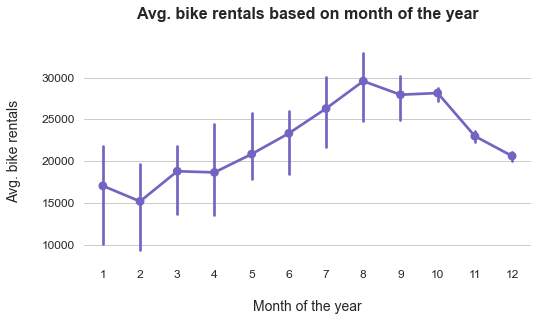

In [66]:
# Assign grid and figure size as per requirement
plt.figure(figsize=[8,4])
sb.set_style('whitegrid')
flatui = ['slateblue']
sb.set_palette(flatui, n_colors=1, desat=0.8)

# Seaborn's point plot
sb.pointplot(data = month_df, x = "month", y = "rentals", linestyles = "-", 
             color = sb.color_palette()[0], alpha=0.5)

# improve plot aesthetics
plt.title('Avg. bike rentals based on month of the year\n',  weight = 'bold', fontsize = 16)
plt.ylabel('Avg. bike rentals\n', fontsize = 14)
plt.xlabel('\nMonth of the year', fontsize = 14)
plt.xticks(fontsize = 12)
plt.yticks(fontsize = 12)
sb.despine(top=True, right=True, left=True, bottom=True);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.1.11.d Average bike rentals based on month of the year.png', dpi=300, bbox_inches='tight')

The above plot contains error distribution lines over standard deviation and is interferring with the interpretability of the plot. Hence remove the error distribution lines for clear plot aesthetics. Also, the above plot is not potrayed with respect to zero on the axis and amplifies the difference between the average rentals for the given month in any year. Re-plot the above graph with respect to zero over y-aixs.

**`Point plot:`**

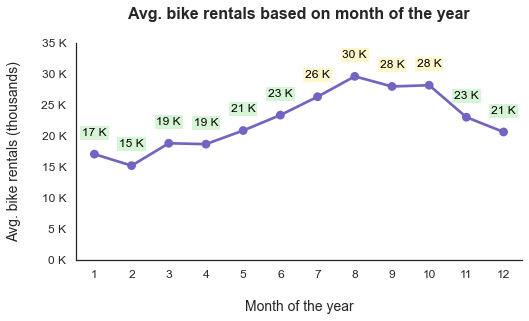

In [67]:
# Assign grid and figure size as per requirement
plt.figure(figsize=[8,4])
sb.set_style('white')
flatui = ['slateblue']
sb.set_palette(flatui, n_colors=1, desat=0.8)

# Seaborn's point plot
sb.pointplot(data = month_df, x = "month", y = "rentals", linestyles = "-", 
             color = sb.color_palette()[0], ci=None)

# improve plot aesthetics
plt.title('Avg. bike rentals based on month of the year\n',  weight = 'bold', fontsize = 16)
plt.ylabel('Avg. bike rentals (thousands)\n', fontsize = 14)
plt.xlabel('\nMonth of the year', fontsize = 14)
plt.xticks(fontsize = 12)
# get ytick locs and rearrage them with respect to zero
locs, labels = plt.yticks()
max_count = locs.max()
y_tick_values = np.arange(0,  max_count+5000, 5000)
y_tick_names = ['{:0.0f} K'.format(v/1000) for v in y_tick_values]
plt.yticks(y_tick_values, y_tick_names, fontsize = 12)

# add annotations
# -------------------------------------------------------
cat_order = month_df.month.sort_values(ascending=True).unique()
avg_rental_counts = month_df.groupby([month_df["month"]]).mean()['rentals'][cat_order]
avg_rental_max = avg_rental_counts.max()
clrs = ['gold' if (count > ((avg_rental_max*4)/5)) else 'limegreen' for count in avg_rental_counts ]

# get the current tick locations and labels
locs, labels = plt.xticks()

# loop through each pair of locations and labels
for loc, label, avg_rental_count, clr in zip(locs, labels, avg_rental_counts, clrs):
    try:
        count = avg_rental_count
    except KeyError:
        count = 0   
    pct_string = '{:0.0f} K'.format(count/1000)
    # print the annotation depending on the bar length
    plt.text(loc, count + int(avg_rental_max/10), pct_string, ha = 'center', color = 'black', 
             fontsize = 12, bbox=dict(pad=1.9,alpha=0.2,color='none',fc=clr))
# -------------------------------------------------------

sb.despine(top=True, right=True, left=False, bottom=False);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.1.11.e Average bike rentals based on month of the year.png', dpi=300, bbox_inches='tight')

The above plot depicts the distribution of average bike rentals over the month of the year. The `yellow` annotations represent the busy months in the year.

**Observations:**
    
+ The early months in a year has low bike rentals and slowly increases with timeline. Some business measures must be taken to increase rental activity for the early months in the year.

------

#### 3.1.12 Univariate analysis - Distribution of quarterly rentals

+ `Column`: quarter
+ `Data type`: continuous data
+ `Plot` :

**`Count plot:`**

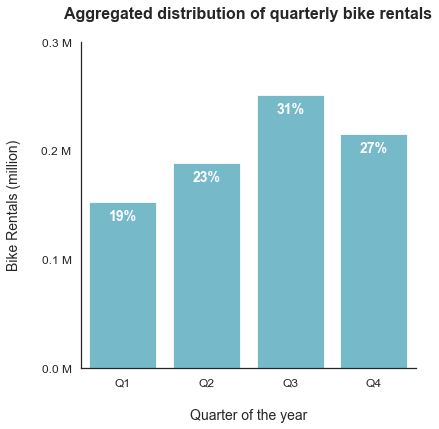

In [68]:
# Assign grid and figure size as per requirement
plt.figure(figsize = [6, 6])
sb.set(style="white")

# prepare the data for the plot
quarter_index_max = bikeshare.quarter.sort_values(ascending=True).unique()[0]
quarter_max = bikeshare.quarter.value_counts().max()
y_tick_values = np.arange(0, quarter_max+100000, 100000)
y_tick_names = ['{:0.1f} M'.format(v/1000000) for v in y_tick_values]

# Seaborn's count plot
sb.countplot(data = bikeshare, x = 'quarter',  color = '#47b1c9', alpha = 0.8, saturation = 0.8)

# improve plot aesthetics
plt.title('Aggregated distribution of quarterly bike rentals\n', fontsize = 16, weight = 'bold')
plt.xlabel('\nQuarter of the year', fontsize = 14)
plt.ylabel('Bike Rentals (million)\n', fontsize = 14)
plt.xticks(fontsize = 12)
plt.yticks(y_tick_values, y_tick_names, fontsize = 12)

# add annotations
# -------------------------------------------------------
n_points = bikeshare.shape[0]
quarter_counts = bikeshare.quarter.value_counts()
quarter_max = quarter_counts.max()
# get the current tick locations and labels
locs, labels = plt.xticks()
    
# loop through each pair of locations and labels
for loc, label in zip(locs, labels):
    # get the text property for the label to get the correct count
    try:
        count = quarter_counts[label.get_text()]
        pct_string = '{:0.0f}%'.format(100*count/n_points)
    except KeyError:
        count = 10000
        pct_string = '0%'

    # print the annotation depending on the bar length
    if count < (quarter_max/10):
        plt.text(loc, count+(quarter_max/25), pct_string, ha = 'center', color = 'white', weight = 'bold', fontsize = 14)
    else:
        plt.text(loc, count-(quarter_max/15), pct_string, ha = 'center', color = 'white', weight = 'bold', fontsize = 14)
# -------------------------------------------------------

sb.despine();

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.1.12.a Aggregated distribution of bike rentals based on the Quarter of the year.png', dpi=300, bbox_inches='tight')

The above plot depicts that the `third` quarer of the year has the highest aggregated bike rentals, while the `first` quarter has the lowest.

**`Find average rentals based on quarter of the year:`**

Create a dataset which contain bike rentals relative to quarter of the year. Care should be taken as to inlcude every quarter in the respective year. Use all categorical combinations and fill the NULL values with numerical zero's so as to consider bike rentals subjected to each quarter in any year.

In [69]:
# create a dataset for bike rentals over the quarter of the year
quarter_df = bikeshare.groupby([bikeshare['year'], 
                                bikeshare['quarter']]).count()['trip_id'].reset_index(name='rentals')

quarter_df['rentals'] = quarter_df['rentals'].fillna(0).astype(int)
quarter_df.head(10)

,year,quarter,rentals
0,2017,Q1,33198
1,2017,Q2,51099
2,2017,Q3,71542
3,2017,Q4,69492
4,2018,Q1,64281
5,2018,Q2,76124
6,2018,Q3,93199
7,2018,Q4,72763
8,2019,Q1,55731
9,2019,Q2,61365


**`Point plot:`**

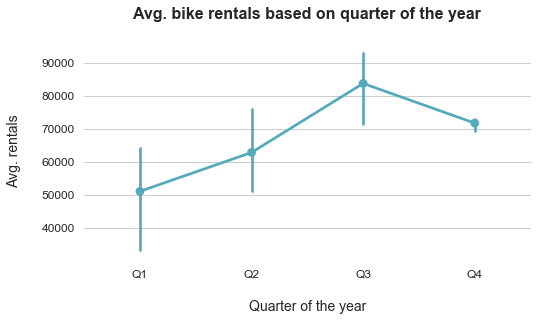

In [70]:
# Assign grid and figure size as per requirement
plt.figure(figsize=[8,4])
sb.set_style('whitegrid')
flatui = ['#47b1c9']
sb.set_palette(flatui, n_colors=1, desat=0.8)

# Seaborn's point plot
sb.pointplot(data = quarter_df, x = "quarter", y = "rentals", linestyles = "-", 
             color = sb.color_palette()[0], alpha=0.5)

# improve plot aesthetics
plt.title('Avg. bike rentals based on quarter of the year\n',  weight = 'bold', fontsize = 16)
plt.ylabel('Avg. rentals\n', fontsize = 14)
plt.xlabel('\nQuarter of the year', fontsize = 14)
plt.xticks(fontsize = 12)
plt.yticks(fontsize = 12)
sb.despine(top=True, right=True, left=True, bottom=True);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.1.12.b Average bike rentals based on quarter of the year.png', dpi=300, bbox_inches='tight')

The above plot contains error distribution lines over standard deviation and is interferring with the interpretability of the plot. Hence remove the error distribution lines for clear plot aesthetics. Also the above plot is not potrayed with respect to zero on the axis and amplifies the difference between the average rentals for any given quarter in the year. Re-plot the above graph with respect to zero over y-aixs.

**`Point plot:`**

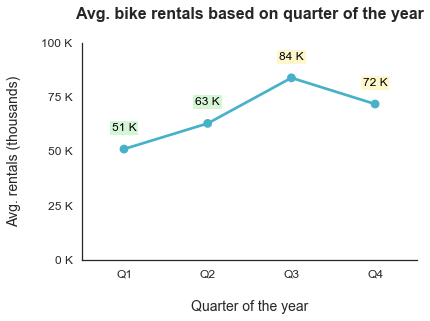

In [71]:
# Assign grid and figure size as per requirement
plt.figure(figsize=[6,4])
sb.set_style('white')
flatui = ['#47b1c9']
sb.set_palette(flatui, n_colors=1, desat=1)

# Seaborn's point plot
sb.pointplot(data = quarter_df, x = "quarter", y = "rentals", linestyles = "-", 
             color = sb.color_palette()[0], ci=None)

# improve plot aesthetics
plt.title('Avg. bike rentals based on quarter of the year\n',  weight = 'bold', fontsize = 16)
plt.ylabel('Avg. rentals (thousands)\n', fontsize = 14)
plt.xlabel('\nQuarter of the year', fontsize = 14)
plt.xticks(fontsize = 12)

# get ytick locs and rearrage them with respect to zero
locs, labels = plt.yticks()
max_count = locs.max()
y_tick_values = np.arange(0,  max_count+25000, 25000)
y_tick_names = ['{:0.0f} K'.format(v/1000) for v in y_tick_values]
plt.yticks(y_tick_values, y_tick_names, fontsize = 12)

# add annotations
# -------------------------------------------------------
cat_order = quarter_df.quarter.sort_values(ascending=True).unique()
avg_rental_counts = quarter_df.groupby([quarter_df["quarter"]]).mean()['rentals'][cat_order]
avg_rental_max = avg_rental_counts.max()
clrs = ['gold' if (count > ((avg_rental_max*4)/5)) else 'limegreen' for count in avg_rental_counts ]

# get the current tick locations and labels
locs, labels = plt.xticks()

# loop through each pair of locations and labels
for loc, label, avg_rental_count, clr in zip(locs, labels, avg_rental_counts, clrs):
    try:
        count = avg_rental_count
    except KeyError:
        count = 0   
    pct_string = '{:0.0f} K'.format(count/1000)
    # print the annotation depending on the bar length
    plt.text(loc, count + int(avg_rental_max/10), pct_string, ha = 'center', color = 'black', 
             fontsize = 12, bbox=dict(pad=1.9,alpha=0.2,color='none',fc=clr))
# -------------------------------------------------------

sb.despine(top=True, right=True, left=False, bottom=False);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.1.12.c Average bike rentals based on quarter of the year.png', dpi=300, bbox_inches='tight')

The above plot depicts the distribution of average bike rentals over the quarter of the year. The `yellow` annotations represent the busiest quarters in the year. It appears that the `third and fourth quarters` has the **highest** average bike rentals over the year.

**Observations:** The above plot depicts that the first quarter has the least rental activity while third and fourth quarter see highest rental activity.

----------

#### 3.1.13 Univariate analysis - Distribution of yearly rentals

+ `Column`: year
+ `Data type`: continuous data
+ `Plot` :

**`Count plot:`**

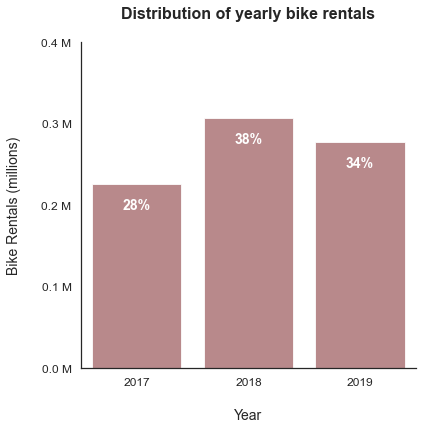

In [72]:
# Assign grid and figure size as per requirement
sb.set_style('white')
plt.figure(figsize = [6, 6])
sb.set_palette('deep', n_colors=10, desat=0.5)
base_color = sb.color_palette()[3]

# prepare data for the plot
yearly_order = bikeshare.year.sort_values(ascending=True).unique()
max_count = bikeshare.year.value_counts().max()
min_count = bikeshare.year.value_counts().min()
y_tick_values = np.arange(0, max_count + 100000, 100000)
y_tick_names = ['{:0.1f} M'.format(v/1000000) for v in y_tick_values]

# Seaborn's count plot
sb.countplot(data = bikeshare, x = 'year', color = base_color, 
             alpha= 0.8, order = yearly_order, saturation = 1)

# improve plot aesthetics
plt.title('Distribution of yearly bike rentals\n', fontsize = 16, weight = 'bold')
plt.xlabel('\nYear', fontsize = 14)
plt.ylabel('Bike Rentals (millions)\n', fontsize = 14)
plt.xticks(fontsize = 12)
plt.yticks(y_tick_values, y_tick_names, fontsize = 12)

# add annotations
# -------------------------------------------------------
n_points = bikeshare.shape[0]
yearly_counts = bikeshare.year.value_counts()
year_max = yearly_counts.max()
# get the current tick locations and labels
locs, labels = plt.xticks()

# loop through each pair of locations and labels
for loc, label in zip(locs, labels):
    # get the text property for the label to get the correct count
    try:
        count = yearly_counts[int(label.get_text())]
        pct_string = '{:0.0f}%'.format(100*count/n_points)
    except KeyError:
        count = 10000
        pct_string = '0%'

    # print the annotation depending on the bar length
    if count < (year_max/10):
        plt.text(loc, count+(year_max/25), pct_string, ha = 'center', color = 'white', weight = 'bold', fontsize = 14)
    else:
        plt.text(loc, count-(year_max/10), pct_string, ha = 'center', color = 'white', weight = 'bold', fontsize = 14)
# -------------------------------------------------------
    
sb.despine();

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.1.13.a Distribution of yearly rentals.png', dpi=300, bbox_inches='tight')

**`Find average rentals based on the year:`**

Create a dataset which contain bike rentals relative to each year. Care should be taken as to inlcude every year. Use all categorical combinations and fill the NULL values with numerical zero's so as to consider bike rentals subjected to each year.

In [73]:
# create a dataset for bike rentals over the years
year_df = bikeshare.groupby([bikeshare['year']]).count()['trip_id'].reset_index(name='rentals')

year_df['rentals'] = year_df['rentals'].fillna(0).astype(int)
year_df

,year,rentals
0,2017,225331
1,2018,306367
2,2019,276891


**`Point plot:`**

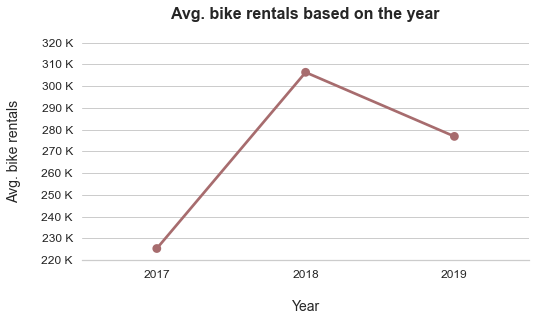

In [74]:
# Assign grid and figure size as per requirement
plt.figure(figsize=[8,4])
sb.set_style('whitegrid')
sb.set_palette('deep', n_colors=10, desat=0.5)
base_color = sb.color_palette()[3]

# Seaborn's point plot
sb.pointplot(data = year_df, x = "year", y = "rentals", linestyles = "-", 
             color = base_color, alpha=0.5)

# improve plot aesthetics
plt.title('Avg. bike rentals based on the year\n',  weight = 'bold', fontsize = 16)
plt.ylabel('Avg. bike rentals\n', fontsize = 14)
plt.xlabel('\nYear', fontsize = 14)
plt.xticks(fontsize = 12)
# get ytick locs and change them to the count of thousands
y_locs, y_labels = plt.yticks()
y_tick_names = ['{:0.0f} K'.format(y_loc/1000) for y_loc in y_locs]
plt.yticks(y_locs, y_tick_names, fontsize = 12)

sb.despine(top=True, right=True, left=True, bottom=False);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.1.13.b Average bike rentals based on the year.png', dpi=300, bbox_inches='tight')

The above plot is not potrayed with respect to zero on the axis and amplifies the difference between the average rentals for any given year. Re-plot the above graph with respect to zero over y-aixs.

**`Point plot:`**

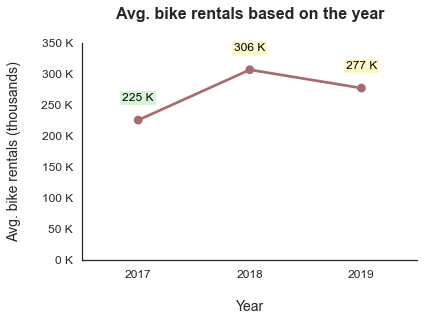

In [75]:
# Assign grid and figure size as per requirement
plt.figure(figsize=[6,4])
sb.set_style('white')
sb.set_palette('deep', n_colors=10, desat=0.5)
base_color = sb.color_palette()[3]

# Seaborn's point plot
sb.pointplot(data = year_df, x = "year", y = "rentals", linestyles = "-", 
             color = base_color, ci=None)

# improve plot aesthetics
plt.title('Avg. bike rentals based on the year\n',  weight = 'bold', fontsize = 16)
plt.ylabel('Avg. bike rentals (thousands)\n', fontsize = 14)
plt.xlabel('\nYear', fontsize = 14)
plt.xticks(fontsize = 12)

# get ytick locs and rearrage them with respect to zero
locs, labels = plt.yticks()
max_count = locs.max()
y_tick_values = np.arange(0,  max_count+50000, 50000)
y_tick_names = ['{:0.0f} K'.format(v/1000) for v in y_tick_values]
plt.yticks(y_tick_values, y_tick_names, fontsize = 12)

# add annotations
# -------------------------------------------------------
cat_order = year_df.year.sort_values(ascending=True).unique()
avg_rental_counts = year_df.groupby([year_df["year"]]).mean()['rentals'][cat_order]
avg_rental_max = avg_rental_counts.max()
clrs = ['gold' if (count > ((avg_rental_max*4)/5)) else 'limegreen' for count in avg_rental_counts ]

# get the current tick locations and labels
locs, labels = plt.xticks()

# loop through each pair of locations and labels
for loc, label, avg_rental_count, clr in zip(locs, labels, avg_rental_counts, clrs):
    try:
        count = avg_rental_count
    except KeyError:
        count = 0   
    pct_string = '{:0.0f} K'.format(count/1000)
    # print the annotation depending on the bar length
    plt.text(loc, count + int(avg_rental_max/10), pct_string, ha = 'center', color = 'black', 
             fontsize = 12, bbox=dict(pad=1.9,alpha=0.2,color='none',fc=clr))
# -------------------------------------------------------

sb.despine(top=True, right=True, left=False, bottom=False);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.1.13.c Average bike rentals based on the year.png', dpi=300, bbox_inches='tight')

**Observations:**
+ The above plot depicts the distribution of average bike rentals over the individual years. The `yellow` annotations represent the busiest ones. It appears that the founding year `2017` has relatively **low** average bike rentals while `2018` has the **highest** average bike rentals. However there is a slight **decrease** in average rentals in the following year of `2019`, which is not a good sign of business and potrays the **requirement of better business plans**.

----------

#### 3.1.14 Univariate analysis - Distribution of timeseries bike rentals

+ `Column`: year and month
+ `Data type`: continuous data
+ `Plot` :

**`Timeseries plot:`**

Plot the continuous timeline distribution of bike rentals over the years 2107, 2018, and 2019.

In [76]:
# display the uique categorical dates
bikeshare.groupby([bikeshare["year"], 
                   bikeshare["month"]]).count().index.sort_values().unique()

MultiIndex([(2017,  1),
            (2017,  2),
            (2017,  3),
            (2017,  4),
            (2017,  5),
            (2017,  6),
            (2017,  7),
            (2017,  8),
            (2017,  9),
            (2017, 10),
            (2017, 11),
            (2017, 12),
            (2018,  1),
            (2018,  2),
            (2018,  3),
            (2018,  4),
            (2018,  5),
            (2018,  6),
            (2018,  7),
            (2018,  8),
            (2018,  9),
            (2018, 10),
            (2018, 11),
            (2018, 12),
            (2019,  1),
            (2019,  2),
            (2019,  3),
            (2019,  4),
            (2019,  5),
            (2019,  6),
            (2019,  7),
            (2019,  8),
            (2019,  9),
            (2019, 10),
            (2019, 11),
            (2019, 12)],
           names=['year', 'month'])

In [77]:
# change the format of the dates for the plot
new_dates = []
dates = bikeshare.groupby([bikeshare["year"], 
                           bikeshare["month"]]).count().index.sort_values().unique()
for date in dates:
    new_dates.append(str(date[0])+'-'+str(date[1]))
    
new_dates

['2017-1',
 '2017-2',
 '2017-3',
 '2017-4',
 '2017-5',
 '2017-6',
 '2017-7',
 '2017-8',
 '2017-9',
 '2017-10',
 '2017-11',
 '2017-12',
 '2018-1',
 '2018-2',
 '2018-3',
 '2018-4',
 '2018-5',
 '2018-6',
 '2018-7',
 '2018-8',
 '2018-9',
 '2018-10',
 '2018-11',
 '2018-12',
 '2019-1',
 '2019-2',
 '2019-3',
 '2019-4',
 '2019-5',
 '2019-6',
 '2019-7',
 '2019-8',
 '2019-9',
 '2019-10',
 '2019-11',
 '2019-12']

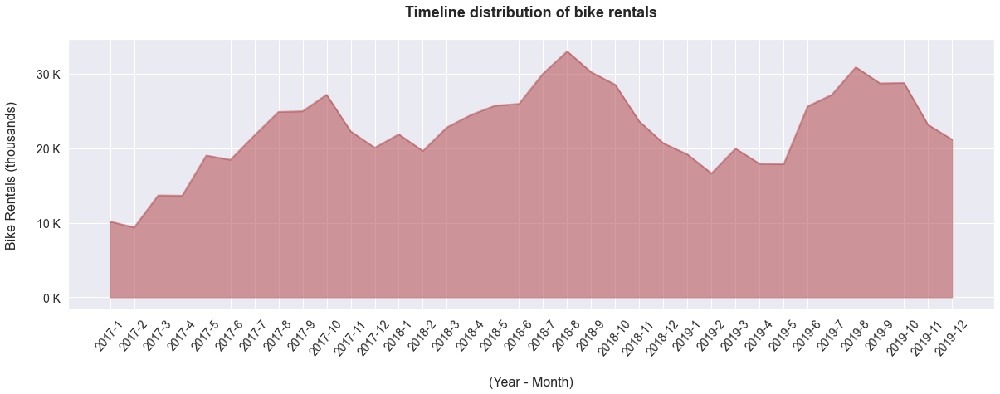

In [78]:
# Assign grid and figure size as per requirement
sb.set_style('darkgrid')
plt.figure(figsize = [20, 6])
sb.set_palette('deep', n_colors=10, desat=0.8)
base_color = sb.color_palette()[3]

# prepare data for the plot
new_dates = []
dates = bikeshare.groupby([bikeshare["year"], 
                           bikeshare["month"]]).count().index.sort_values().unique()
for date in dates:
    new_dates.append(str(date[0])+'-'+str(date[1]))
    
x = new_dates
y = bikeshare.groupby([bikeshare["year"], 
                       bikeshare["month"]]).count()['trip_id'].values
y_tick_values = np.arange(0, y.max()+10000, 10000)
y_tick_names = ['{:0.0f} K'.format(v/1000) for v in y_tick_values]

# Matplotlib's line plot
plt.plot(x, y, linewidth=2.0, color = base_color, alpha = 0.6)

# improve plot aesthetics
plt.title('Timeline distribution of bike rentals\n', fontsize = 18, weight = 'bold')
plt.xlabel('\n(Year - Month)', fontsize = 16)
plt.ylabel('Bike Rentals (thousands)\n', fontsize = 16)
plt.xticks(rotation = 50, fontsize = 14)
plt.yticks(y_tick_values, y_tick_names, fontsize = 14)
plt.fill_between(x, y, color = base_color, alpha = 0.6);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.1.14 Timeseries distribution of bike rentals based on year and month.png', dpi=300, bbox_inches='tight')

**Observations:** The bike rental activiy always decreases at the start of every year and slowly increases towards the end of the respective year.

--------

#### 3.1.15 Univariate analysis - Distribution of bike returns by `end_time`

+ `Column`: end_time
+ `Data type`: Categorical, nominal
+ `Plot` : Histogram

**`Line plot:`**

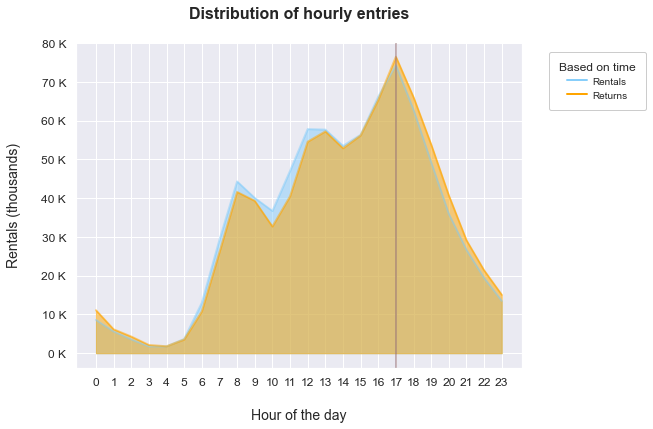

In [79]:
plt.figure(figsize = [8, 6])
sb.set_style('darkgrid')
x1 = bikeshare.groupby(bikeshare['start_time'].dt.hour).count()['trip_id'].index
y1 = bikeshare.groupby(bikeshare['start_time'].dt.hour).count()['trip_id'].values
x2 = bikeshare.groupby(bikeshare['end_time'].dt.hour).count()['trip_id'].index
y2 = bikeshare.groupby(bikeshare['end_time'].dt.hour).count()['trip_id'].values
x_tick_values = np.arange(0,  23+1, 1)
x_tick_names = ['{:}'.format(v) for v in x_tick_values]
y_tick_values = np.arange(0,  bikeshare.start_time.dt.hour.value_counts().max()+10000, 10000)
y_tick_names = ['{:0.0f} K'.format(v/1000) for v in y_tick_values]

plt.plot(x1, y1, linewidth=2.0, color = 'lightskyblue', alpha = 0.5)
plt.plot(x2, y2, linewidth=2.0, color = 'orange', alpha = 0.5)
plt.title('Distribution of hourly entries\n', fontsize = 16, weight = 'bold')
plt.xlabel('\nHour of the day', fontsize = 14)
plt.ylabel('Rentals (thousands)\n', fontsize = 14)
plt.xticks(x_tick_values, x_tick_names, fontsize = 12)
plt.yticks(y_tick_values, y_tick_names, fontsize = 12)
plt.fill_between(x1, y1, color = 'lightskyblue', alpha = 0.5)
plt.fill_between(x2, y2, color = 'orange', alpha = 0.5)

# draw the vertical axial line at the peak hour
start_peak_hour = bikeshare['start_time'].dt.hour.value_counts(ascending=False).index[0]
plt.axvline(start_peak_hour, color='black', alpha=0.3, linewidth=2)
end_peak_hour = bikeshare['end_time'].dt.hour.value_counts(ascending=False).index[0]
plt.axvline(end_peak_hour, color='pink', alpha=0.3, linewidth=2);

# add custom legend 
custom_lines = [Line2D([0], [0], color= 'lightskyblue', lw=2),
                Line2D([0], [0], color= 'orange', lw=2)]

plt.legend(custom_lines, ['Rentals', 'Returns'], scatterpoints=1, frameon=True, fancybox=True, shadow=False, 
           ncol = 1, framealpha = 1, borderpad=1, borderaxespad=1, loc = 'upper right', labelspacing=0.5,  
           title='Based on time', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(1.3, 1));

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.1.15 Comparision of hourly start time bike rentals and end time returns.png', dpi=300, bbox_inches='tight')

> The duration of the bike rentals ranges between minutes to hours. Hence the bike return charts are no different from rentals when estimated on timelines other than hours. Hence there is no need to analyze the distribution of bike returns over timeline.

--------

#### 3.1.16 Univariate analysis - Distribution of bike rentals by `start_station_id`

+ `Column`: start_station_id
+ `Data type`: Categorical, nominal
+ `Plot` : Histogram

**Should the rentals be calculated based on `start_staion_id` or the combination of `start_lat` and `start_lon`?**

Exploration for the possible solution/approach to obtaing the rental traffic:

In [80]:
bikeshare.groupby([bikeshare['start_station_id'], 
                   bikeshare['start_lat'], 
                   bikeshare['start_lon']]).size().head(20)

start_station_id  start_lat  start_lon  
3005              34.048500  -118.258537    31223
                             -118.258530     2550
                  34.048550  -118.259048     1236
3006              34.045540  -118.256668    14723
                             -118.256660     1140
3007              34.050480  -118.254593    13919
                             -118.254590     1066
3008              34.046612  -118.262733    10774
                             -118.262730      846
3009              33.987381  -118.472832       55
3010              34.037048  -118.254868     1837
                             -118.254860       79
3011              34.041130  -118.267982     6620
                             -118.267980      584
3013              33.779819  -118.263023      259
                             -118.263020       17
3014              34.056610  -118.237213    24817
                             -118.237210     1669
3016              34.052898  -118.241562     6506
         

From the above data it is evident that the start_station has more than one combination of `start_lat` and `start_lon`.This is because of the geographical extension of the start_station over the zone. Hence the rentals are to be calculated over the `start_station_id` but not the combination of `start_lat` and `start_lon`.

**Distribution of rental traffic based on `start_stations`.**

In [81]:
# find the rentals based on start_station_id
start_stations = bikeshare.groupby([bikeshare['start_station_id']]).size().reset_index(name='rentals')
start_stations.head()

,start_station_id,rentals
0,3005,35009
1,3006,15863
2,3007,14985
3,3008,11620
4,3009,55


In [82]:
# calculate the descriptive statistics of the rentals
start_stations['rentals'].describe()

count      273.000000
mean      2961.864469
std       5296.326610
min          1.000000
25%        145.000000
50%        724.000000
75%       2632.000000
max      35009.000000
Name: rentals, dtype: float64

Plot the distribution of start stations rental traffic:

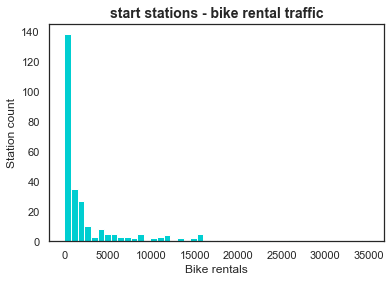

In [83]:
sb.set_style('white')

# Seaborn's distribution plot
sb.distplot(start_stations['rentals'], kde = False, hist_kws = {'alpha' : 1}, color = 'darkturquoise')

# improve plot aesthetics
plt.title('start stations - bike rental traffic', fontsize = 14, weight = 'bold')
plt.xlabel('Bike rentals', fontsize = 12)
plt.ylabel('Station count', fontsize = 12);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.1.16.a Distribution of start stations bike rental traffic.png', dpi=300, bbox_inches='tight')

> This data in their natural units, looks `highly right skewed`: lots of points with low values, with a very long tail of data points with large values (also all values are `positive`). The most common example of this is, the data that follows an approximately `log-normal distribution`. This is data that, in their natural units, can look highly skewed. However, after applying a logarithmic transform to the data, the data will follow a `normal distribution`. Hence let us apply `logarithmic transformation` to the start station's bike rental data.

Plot the Logarithmic distribution of start stations bike rentals:

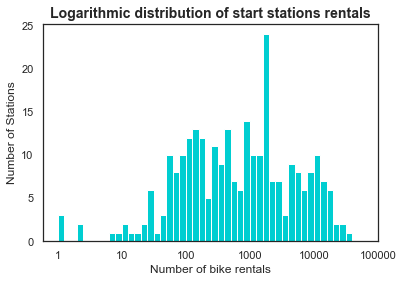

In [84]:
def log_trans(x, inverse = False):
    if not inverse:
        return np.log10(x)
    else:
        return 10 ** x


sb.set_style('white')

# prepare the data for the plot
min_value = log_trans(start_stations['rentals'].min())
max_value = log_trans(start_stations['rentals'].max())
bin_edges = np.arange(0, max_value+0.1, 0.1)

# matplotlib's histogram
plt.hist(start_stations['rentals'].apply(log_trans), bins = bin_edges, color = 'darkturquoise')

# improve plot aesthetics
tick_locs = np.arange(0, max_value+1, 1)
plt.xticks(tick_locs, log_trans(tick_locs, inverse = True).astype(int))
plt.title('Logarithmic distribution of start stations rentals', fontsize = 14, weight = 'bold')
plt.xlabel('Number of bike rentals', fontsize = 12)
plt.ylabel('Number of Stations', fontsize = 12);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.1.16.b Distribution of start stations bike rental traffic.png', dpi=300, bbox_inches='tight')

**Classification of `start_stations` based on their rental traffic:**

In [85]:
# display the count of start stations based on their bike rental traffic
print('Total number of start stations'.ljust(35, ' '), ':', start_stations.shape[0], '\n')
print('Very Low traffic start stations'.ljust(35, ' '), ':', start_stations.query(' rentals < 10 ').shape[0])
print('Low traffic start stations'.ljust(35, ' '), ':', start_stations.query(' rentals >= 10 and rentals < 100 ').shape[0])
print('Normal traffic start stations'.ljust(35, ' '), ':', start_stations.query(' rentals >= 100 and rentals < 1000 ').shape[0])
print('High traffic start stations'.ljust(35, ' '), ':', start_stations.query(' rentals >= 1000 and rentals < 10000 ').shape[0])
print('Very High traffic start stations'.ljust(35, ' '), ':', start_stations.query(' rentals >= 10000 ').shape[0])

Total number of start stations      : 273 

Very Low traffic start stations     : 7
Low traffic start stations          : 44
Normal traffic start stations       : 102
High traffic start stations         : 92
Very High traffic start stations    : 28


Create a dataframe based on bike rentals traffic and number of start stations associated with them.

In [86]:
rentals = {'rental_traffic' : pd.Series(['Very Low', 'Low', 'Normal', 'High', 'Very High']), 
           'start_stations' : pd.Series([start_stations.query(' rentals < 10 ').shape[0], 
                                         start_stations.query(' rentals >= 10 and rentals < 100 ').shape[0],
                                         start_stations.query(' rentals >= 100 and rentals < 1000 ').shape[0], 
                                         start_stations.query(' rentals >= 1000 and rentals < 10000 ').shape[0], 
                                         start_stations.query(' rentals >= 10000 ').shape[0]])} 
  
# create Dataframe. 
bike_rentals = pd.DataFrame(rentals)
bike_rentals

,rental_traffic,start_stations
0,Very Low,7
1,Low,44
2,Normal,102
3,High,92
4,Very High,28


**`Pie chart:`**

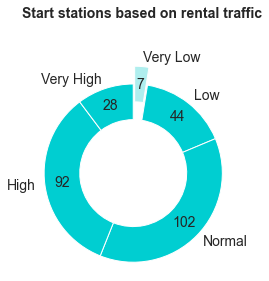

In [87]:
def absolute_value(val):
    a  = np.round(val/100.*type_level_counts.sum(), 0)
    return int(a)


# prepare the data for the plot
type_level_counts = bike_rentals.start_stations.values
type_level_index = bike_rentals.rental_traffic.values
explode = (0.2, 0, 0, 0, 0)
colors = ['paleturquoise', 'darkturquoise', 'darkturquoise', 'darkturquoise', 'darkturquoise']

# matplotlib's pie chart
plt.pie(type_level_counts, labels = type_level_index, startangle = 90,
        counterclock = False, wedgeprops = {'width' : 0.4}, shadow=False, 
        explode=explode, colors=colors, textprops={'fontsize': 14}, 
        autopct=absolute_value, labeldistance=1.1, pctdistance=0.8)
plt.title('Start stations based on rental traffic\n\n', fontsize = 14, weight = 'bold')
plt.axis('square');

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.1.16.c Classification of start stations based on bike rental traffic.png', dpi=300, bbox_inches='tight')

**`Bar chart:`**

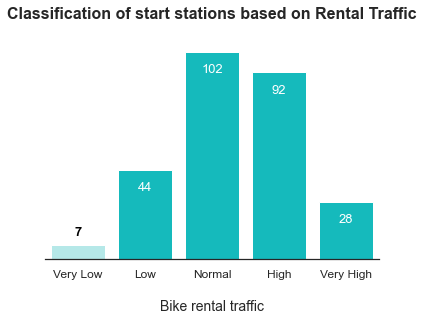

In [88]:
# Assign grid and color palette as per requirement
sb.set_style("white")
base_color = sb.color_palette()[0]

# prepare the data for the plot
counts = bike_rentals.start_stations.values
order = bike_rentals.start_stations.index
x_locs = [0, 1, 2, 3, 4]
x_labels = ['Very Low', 'Low', 'Normal', 'High', 'Very High']
clrs = [ 'darkturquoise' if (x > bike_rentals.start_stations.values.min()) else 'paleturquoise' for x in counts ]


# seaborn's bar plot
sb.barplot(x = order, y = counts, palette=clrs, alpha= 1, saturation = 0.8)

# improve plot aesthetics
plt.title('Classification of start stations based on Rental Traffic\n', weight = 'bold', fontsize = 16)
plt.xticks(x_locs, x_labels, rotation = 0, fontsize = 12)
plt.yticks([], [], rotation = 0, fontsize = 12) 
plt.xlabel('\nBike rental traffic', fontsize = 14)
# plt.ylabel('Number of Stations', fontsize = 14)

# add annotations
# -------------------------------------------------------
# loop through each pair of locations and labels
for loc, count in zip(x_locs, counts):
    pct_string = '{:0.0f}'.format(count)
    
    # print the annotation based on bar length
    if count < int(max(counts)/10):
        plt.text(loc, count+int(max(counts)/20), pct_string, ha = 'center', color = 'black', weight = 'bold', fontsize = 13)
    else:
        plt.text(loc, count-int(max(counts)/10), pct_string, ha = 'center', color = 'white', fontsize = 13)
# -------------------------------------------------------

sb.despine(fig=None, ax=None, top=True, right=True, left=True, bottom=False, offset=None, trim=False);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.1.16.d Classification of start stations based on bike rental traffic.png', dpi=300, bbox_inches='tight')

----

#### 3.1.17 Univariate analysis - Distribution of bike returns by `end_station_id`

+ `Column`: end_station_id
+ `Data type`: Categorical, nominal
+ `Plot` : Histogram

**Should the bike return traffic be calculated based on `end_staion_id` or the combination of `end_lat` and `end_lon`?**

Exploration for the possible solution/approach to obtaing the rental traffic:

In [89]:
bikeshare.groupby([bikeshare['end_station_id'], 
                   bikeshare['end_lat'], 
                   bikeshare['end_lon']]).size().head(20)

end_station_id  end_lat    end_lon    
3005            34.048500  -118.258537    34080
                           -118.258530     2927
                34.048550  -118.259048     1632
3006            34.045540  -118.256668    15301
                           -118.256660     1129
3007            34.050480  -118.254593    11102
                           -118.254590      808
3008            34.046612  -118.262733    10994
                           -118.262730      918
3009            33.987381  -118.472832       68
3010            34.037048  -118.254868     2261
                           -118.254860      118
3011            34.041130  -118.267982     7296
                           -118.267980      743
3013            33.779819  -118.263023      280
                           -118.263020       15
3014            34.056610  -118.237213    27509
                           -118.237210     1845
3016            34.052898  -118.241562     6322
                           -118.241560      263
d

From the above data it is evident that the end_stations has more than one combination of `end_lat` and `end_lon`.This is because of the geographical extension of the end_station over the zone. Hence the bike return traffic are to be calculated over the `end_station_id` but not the combination of `end_lat` and `end_lon`.

**Distribution of `end_stations` based on their bike return traffic.**

In [90]:
# find the bike returns based on end_station_id
end_stations = bikeshare.groupby([bikeshare['end_station_id']]).size().reset_index(name='returns')
end_stations.head()

,end_station_id,returns
0,3005,38639
1,3006,16430
2,3007,11910
3,3008,11912
4,3009,68


In [91]:
# calculate the descriptive statistivs of the returns
end_stations['returns'].describe()

count      278.000000
mean      2908.593525
std       5441.066798
min          1.000000
25%        138.250000
50%        620.500000
75%       2454.000000
max      38639.000000
Name: returns, dtype: float64

Plot the distribution of end stations return traffic:

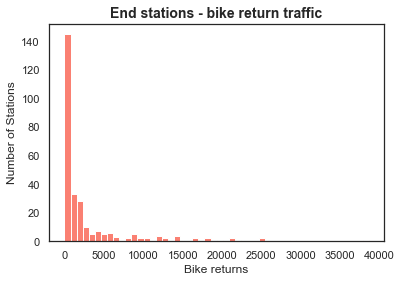

In [92]:
sb.set_style('white')

# seaborn's distribution plot
sb.distplot(end_stations['returns'], kde = False, hist_kws = {'alpha' : 1}, color = 'salmon')

# improve plot aesthetics
plt.title('End stations - bike return traffic', fontsize = 14, weight = 'bold')
plt.xlabel('Bike returns', fontsize = 12)
plt.ylabel('Number of Stations', fontsize = 12);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.1.17.a Distribution of end stations bike return traffic.png', dpi=300, bbox_inches='tight')

> This data in their natural units, looks `highly right skewed`: lots of points with low values, with a very long tail of data points with large values (also all values are `positive`). The most common example of this is, the data that follows an approximately `log-normal distribution`. This is data that, in their natural units, can look highly skewed. However, after applying a logarithmic transform to the data, the data will follow a `normal distribution`. Hence let us apply `logarithmic transformation` to the end station's bike return data.

Plot the Logarithmic distribution of end stations bike returns:

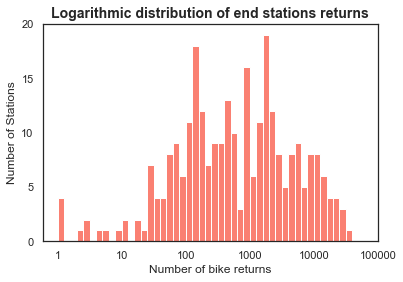

In [93]:
def log_trans(x, inverse = False):
    if not inverse:
        return np.log10(x)
    else:
        return 10 ** x


sb.set_style('white')

# prepare the data for the plot
min_value = log_trans(end_stations['returns'].min())
max_value = log_trans(end_stations['returns'].max())
bin_edges = np.arange(0, max_value+0.1, 0.1)

# matplotlib's histogram
plt.hist(end_stations['returns'].apply(log_trans), bins = bin_edges, color = 'salmon')

# improve plot aesthetics
tick_locs = np.arange(0, max_value+1, 1)
plt.xticks(tick_locs, log_trans(tick_locs, inverse = True).astype(int))
plt.title('Logarithmic distribution of end stations returns', fontsize = 14, weight = 'bold')
plt.xlabel('Number of bike returns', fontsize = 12)
plt.ylabel('Number of Stations', fontsize = 12)

# obtain yticks and convert them to integer values
y_locs, y_ticks = plt.yticks()
max_count = math.ceil(max(y_locs))
y_locs = np.arange(0, max_count+5, 5)
y_labels = y_locs
plt.yticks(y_locs, y_labels);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.1.17.b Distribution of end stations bike return traffic.png', dpi=300, bbox_inches='tight')

**Classification of `end_stations` based on their bike returns traffic.**

In [94]:
# display the count of end stations based on their bike return traffic
print('Total number of end stations'.ljust(30, ' '), ':', end_stations.shape[0], '\n')
print('Very Low traffic end stations'.ljust(30, ' '), ':', end_stations.query(' returns < 10 ').shape[0])
print('Low traffic end stations'.ljust(30, ' '), ':', end_stations.query(' returns >= 10 and returns < 100 ').shape[0])
print('Normal traffic end stations'.ljust(30, ' '), ':', end_stations.query(' returns >= 100 and returns < 1000 ').shape[0])
print('High traffic end stations'.ljust(30, ' '), ':', end_stations.query(' returns >= 1000 and returns < 10000 ').shape[0])
print('Very High traffic end stations'.ljust(30, ' '), ':', end_stations.query(' returns >= 10000 ').shape[0])

Total number of end stations   : 278 

Very Low traffic end stations  : 10
Low traffic end stations       : 43
Normal traffic end stations    : 108
High traffic end stations      : 91
Very High traffic end stations : 26


Create a dataframe based on bike rentals traffic and number of start stations associated with them.

In [95]:
returns = {'return_traffic' : pd.Series(['Very Low', 'Low', 'Normal', 'High', 'Very High']), 
           'end_stations' : pd.Series([end_stations.query(' returns < 10 ').shape[0], 
                                       end_stations.query(' returns >= 10 and returns < 100 ').shape[0],
                                       end_stations.query(' returns >= 100 and returns < 1000 ').shape[0], 
                                       end_stations.query(' returns >= 1000 and returns < 10000 ').shape[0], 
                                       end_stations.query(' returns >= 10000 ').shape[0]])} 
  
# create Dataframe. 
bike_returns = pd.DataFrame(returns)
bike_returns

,return_traffic,end_stations
0,Very Low,10
1,Low,43
2,Normal,108
3,High,91
4,Very High,26


**`Pie chart:`**

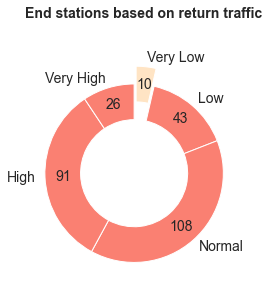

In [96]:
def absolute_value(val):
    a  = np.round(val/100.*type_level_counts.sum(), 0)
    return int(a)


# prepare the data for the plot
type_level_counts = bike_returns.end_stations.values
type_level_index = bike_returns.return_traffic.values
explode = (0.2, 0, 0, 0, 0)
colors = ['bisque', 'salmon', 'salmon', 'salmon', 'salmon']

# matplotlib's pie chart
plt.pie(type_level_counts, labels = type_level_index, startangle = 90,
        counterclock = False, wedgeprops = {'width' : 0.4}, shadow=False, 
        explode=explode, colors=colors, textprops={'fontsize': 14}, 
        autopct=absolute_value, labeldistance=1.1, pctdistance=0.8)
plt.title('End stations based on return traffic\n\n', fontsize = 14, weight = 'bold')
plt.axis('square');

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.1.17.c Classification of end stations based on bike return traffic.png', dpi=300, bbox_inches='tight')

**`Bar chart:`**

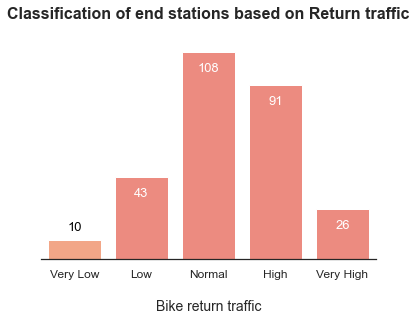

In [97]:
# Assign grid and color palette as per requirement
sb.set_style("white")
base_color = sb.color_palette()[0]

# prepare the data for the plot
counts = bike_returns.end_stations.values
order = bike_returns.end_stations.index
x_locs = [0, 1, 2, 3, 4]
x_labels = ['Very Low', 'Low', 'Normal', 'High', 'Very High']
clrs = [ 'salmon' if (x > bike_returns.end_stations.values.min()) else 'lightsalmon' for x in counts ]

# Seaborn's bar chart
sb.barplot(x = order, y = counts, palette=clrs, alpha= 1, saturation = 0.8)

# improve plot aesthetics
plt.title('Classification of end stations based on Return traffic\n', weight = 'bold', fontsize = 16)
plt.xticks(x_locs, x_labels, rotation = 0, fontsize = 12)
plt.yticks([], [], rotation = 0, fontsize = 12) 
plt.xlabel('\nBike return traffic', fontsize = 14)
# plt.ylabel('Number of Stations', fontsize = 14)

# add annotations
# -------------------------------------------------------
# loop through each pair of locations and labels
for loc, count in zip(x_locs, counts):
    pct_string = '{:0.0f}'.format(count)
    
    # print the annotation based on bar length
    if count <= int(max(counts)/10):
        plt.text(loc, count+int(max(counts)/20), pct_string, ha = 'center', color = 'black', fontsize = 13)
    else:
        plt.text(loc, count-int(max(counts)/10), pct_string, ha = 'center', color = 'white', fontsize = 13)
# ------------------------------------------------------- 

sb.despine(fig=None, ax=None, top=True, right=True, left=True, bottom=False, offset=None, trim=False);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.1.17.d Classification of end stations based on bike return traffic.png', dpi=300, bbox_inches='tight')

-------

#### 3.1.18 Univariate analysis - Distribution of trip durations

+ `Column`: duration_min
+ `Data type`: Quantitative data, Continuous
+ `Plot` : Histogram

Explore the optimal value of the `bin size` that best potrays the distribution of trip durations.

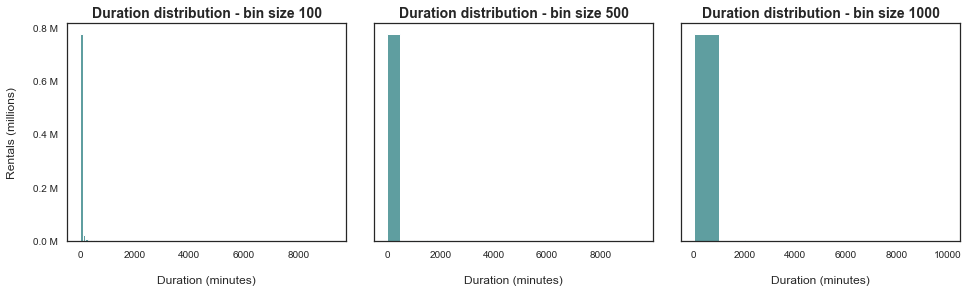

In [98]:
def dist_subplot(subplot, column, binsize):
    # subplot with custom bin size
    plt.subplot(1, 3, subplot)
    max_count = bikeshare[column].value_counts().max()
    tick_values = np.arange(0, bikeshare.shape[0]+100, 200000)
    tick_names = ['{:0.1f} M'.format(v/1000000) for v in tick_values]
    bin_edges = np.arange(0, bikeshare[column].max()+binsize, binsize)
    # Seaborn's distribution plot
    sb.distplot(bikeshare[column], bins = bin_edges, kde = False,
                hist_kws = {'alpha' : 1}, color = 'cadetblue')
    # improve plot aesthetics
    plt.title('Duration distribution - bin size {}'.format(binsize), fontsize = 14, weight = 'bold')
    plt.xlabel('\nDuration (minutes)', fontsize = 12)
    plt.xticks(fontsize=10)
    if subplot == 1:
        plt.ylabel('Rentals (millions)\n', fontsize = 12)
        plt.yticks(tick_values, tick_names, fontsize=10)
    else:
        plt.ylabel('')
        plt.yticks(tick_values, [])


# check the most optimal bin size to plot the distribution of 'duration_min'
plt.figure(figsize = [16, 4])

# plot subplots with various bin_sizes
dist_subplot(subplot = 1, column = 'duration_min', binsize = 100)
dist_subplot(subplot = 2, column = 'duration_min', binsize = 500)
dist_subplot(subplot = 3, column = 'duration_min', binsize = 1000)

plt.subplots_adjust(wspace=0.1, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.1.18.a Distribution of trip durations - different bin sizes.png', dpi=300, bbox_inches='tight')

The above plot depicts that the `bin size` needs to be small, and require closer observation for better understanding of the data distribution. Plot the distribution of `duration_min`, within the limitation of `500 minutes` for closer observation

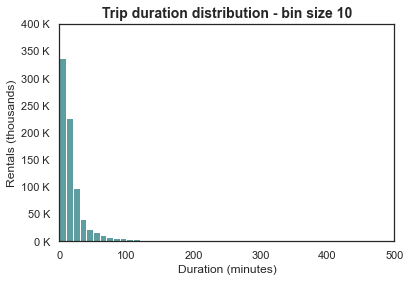

In [99]:
sb.set_style('white')
bin_edges = np.arange(0, bikeshare['duration_min'].max()+10, 10)

# seaborn's distribution plot
sb.distplot(bikeshare['duration_min'], bins = bin_edges, kde = False,
            hist_kws = {'alpha' : 1}, color = 'cadetblue')

# improve plot aesthetics
plt.title('Trip duration distribution - bin size 10', fontsize = 14, weight = 'bold')
plt.xlabel('Duration (minutes)', fontsize = 12)
plt.ylabel('Rentals (thousands)', fontsize = 12)
plt.xlim(0, 500);

# convert yticks into the units of thousands
y_locs, y_labels = plt.yticks()
y_tick_names = ['{:0.0f} K'.format(y_loc/1000) for y_loc in y_locs]
plt.yticks(y_locs, y_tick_names)

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.1.18.b Distribution of trip durations - limited to 500 minutes.png', dpi=300, bbox_inches='tight')

> This data in their natural units, looks `highly right skewed`: lots of points with low values, with a very long tail of data points with large values (also all values are `positive`). The most common example of this is, the data that follows an approximately `log-normal distribution`. This is data that, in their natural units, can look highly skewed. However, after applying a logarithmic transform to the data, the data will follow a `normal distribution`. Hence let us apply `logarithmic transformation` to the `duration_min` data.

**Logarithmic transformation of trip durations:**

Before applying `Logarithmic transformation` of the `duration_min` data, separate the data from the entries with `0` values.

In [100]:
# durations without zero entries
duration_non_zero = bikeshare.query(' duration_min != 0 ')[['duration_min']].copy()
duration_non_zero.head()

,duration_min
0,8
1,12
2,17
3,5
4,5


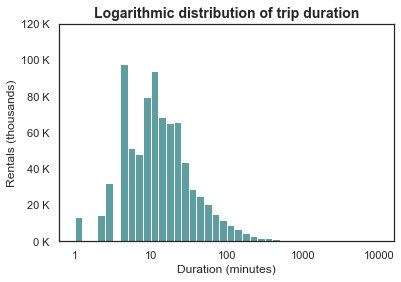

In [101]:
# logarithmic transformation of 'duration_min' data

def log_trans(x, inverse = False):
    if not inverse:
        return np.log10(x)
    else:
        return 10 ** x


# prepare the data for the plot
min_value = log_trans(duration_non_zero['duration_min'].min())
max_value = log_trans(duration_non_zero['duration_min'].max())
bin_edges = np.arange(0, max_value+0.1, 0.1)

# matplotlib's histogram
plt.hist(duration_non_zero['duration_min'].apply(log_trans), bins = bin_edges, color = 'cadetblue')

# improve plot aesthetics
tick_locs = np.arange(0, max_value+1, 1)
plt.xticks(tick_locs, log_trans(tick_locs, inverse = True).astype(int))
plt.title('Logarithmic distribution of trip duration', fontsize = 14, weight = 'bold')
plt.xlabel('Duration (minutes)', fontsize = 12)
plt.ylabel('Rentals (thousands)', fontsize = 12)

# convert yticks into the units of thousands
y_locs, y_labels = plt.yticks()
y_tick_names = ['{:0.0f} K'.format(y_loc/1000) for y_loc in y_locs]
plt.yticks(y_locs, y_tick_names);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.1.18.c Logarithmic distribution of trip duration.png', dpi=300, bbox_inches='tight')

**Divide the `duration_min` based on their distribution, for clear graphical plot.**

In [102]:
# compute the descriptive statistics of durations distribution 
bikeshare['duration_min'].describe()

count    808589.000000
mean         29.861795
std         119.355799
min           0.000000
25%           6.000000
50%          12.000000
75%          23.000000
max        9283.000000
Name: duration_min, dtype: float64

> As the `duration_min` feature is extracted from the start_station co-ordinates and end_station co-ordinates, the entries with `round trips` will have `0` miles extracted as `duration_min`. Hence `round trips` are **ignored**.

1. Breakdown the trip durations into categories

In [103]:
# breakdown the trip durations into categories
print('Total trips'.ljust(15, ' '), ':', bikeshare.shape[0], '\n')
print('Small trips'.ljust(15, ' '), ':', bikeshare.query(' duration_min > 0 and duration_min < 10 ').shape[0])
print('Normal trips'.ljust(15, ' '), ':', bikeshare.query(' duration_min >= 10 and duration_min < 100 ').shape[0])
print('Long trips'.ljust(15, ' '), ':', bikeshare.query(' duration_min >= 100 and duration_min < 1000 ').shape[0])
print('Very long trips'.ljust(15, ' '), ':', bikeshare.query(' duration_min >= 1000 ').shape[0])

Total trips     : 808589 

Small trips     : 336587
Normal trips    : 438460
Long trips      : 30467
Very long trips : 2436


2. Convert the above categories into a datarame

In [104]:
durations = {'trip_type' : pd.Series(['Small', 'Normal', 'Long', 'Very Long']), 
             'trip_count' : pd.Series([bikeshare.query(' duration_min > 0 and duration_min < 10 ').shape[0], 
                                       bikeshare.query(' duration_min >= 10 and duration_min < 100 ').shape[0],
                                       bikeshare.query(' duration_min >= 100 and duration_min < 1000 ').shape[0], 
                                       bikeshare.query(' duration_min >= 1000 ').shape[0]])}

# create Dataframe. 
trip_durations = pd.DataFrame(durations)
trip_durations

,trip_type,trip_count
0,Small,336587
1,Normal,438460
2,Long,30467
3,Very Long,2436


**`Bar chart:`**

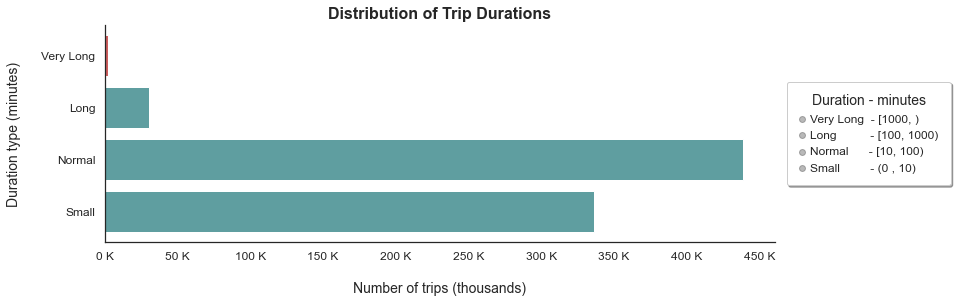

In [105]:
# Assign grid and color palette as per requirement
plt.figure(figsize = [12, 4])
sb.set_style("white")
base_color = 'cadetblue'

# plot pre-calculations
duration_order = ['Very Long', 'Long', 'Normal', 'Small']
time_order = ['[1000, )', '[100, 1000)', '[10, 100)', '(0 , 10)']
trip_counts = trip_durations.trip_count
trip_order = trip_durations.trip_type
x_tick_values = np.arange(0, trip_counts.max() + 50000, 50000)
x_tick_names = ['{:0.0f} K'.format(v/1000) for v in x_tick_values]
y_tick_values = np.arange(0, len(duration_order)+1, 1)
y_tick_names = duration_order
clrs = ['indianred', 'cadetblue', 'cadetblue', 'cadetblue']

# bar plot
sb.barplot(x = trip_counts, y = trip_order, order = duration_order, palette=clrs, alpha= 1, saturation = 1)

# plot - visual enhancements
plt.title('Distribution of Trip Durations', weight = 'bold', fontsize = 16)
plt.xticks(x_tick_values, x_tick_names, fontsize = 12)
plt.yticks(y_tick_values, y_tick_names, fontsize = 12)
plt.xlabel('\nNumber of trips (thousands)', fontsize = 14)
plt.ylabel('Duration type (minutes)\n', fontsize = 14)

# Create a custom legend:
# -------------------------------------------------------
# Plot empty lists with the desired label
indents = [10, 13, 11, 13]
for duration, time, indent in zip(duration_order, time_order, indents):
    plt.scatter([], [], c='k', alpha=0.3,
                label= '{}'.format(duration).ljust(indent, ' ') + ' - ' + '{}'.format(time))
plt.legend(scatterpoints=1, frameon=True, fancybox=True, shadow=True, ncol = 1, framealpha = 1, 
           borderpad=1, borderaxespad=1, bbox_to_anchor = (1, 0.5), loc = 6, labelspacing=0.5,  
           title='Duration - minutes', title_fontsize=14, fontsize=12, facecolor='white', 
           markerfirst=True, handlelength=0.5, handletextpad=0.5)
# -------------------------------------------------------

sb.despine();

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.1.18.d Categorical distribution of Trip Durations.png', dpi=300, bbox_inches='tight')

**`Dataset limited under 30 min and 120 min:`**

In [106]:
# compute the descriptive statistcs of trip durations
bikeshare.duration_min.describe()

count    808589.000000
mean         29.861795
std         119.355799
min           0.000000
25%           6.000000
50%          12.000000
75%          23.000000
max        9283.000000
Name: duration_min, dtype: float64

The calculations are influenced by the presence of outliers. 
+ Calculate the average duration by limiting the data set to entries under `30 minutes`, which constitute the `75%` of the duration distribution. 
+ Also compute the average duration of trips with entries under `120` minutes for long trip analysis.

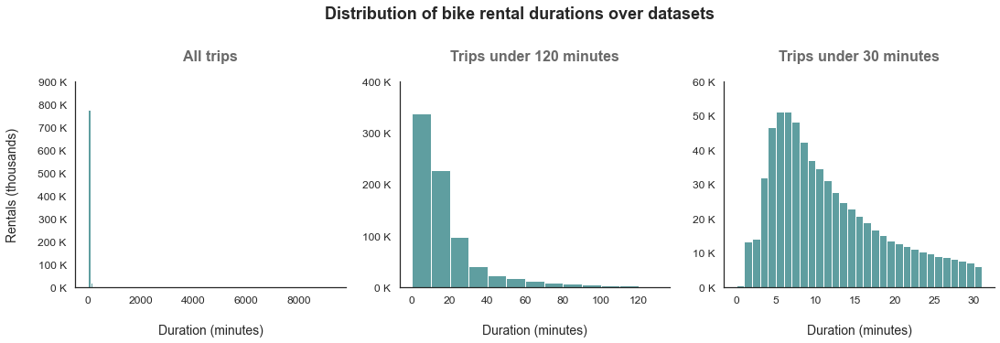

In [107]:
# Assign figure and color palette as per requirement
plt.figure(figsize=[18, 5])
sb.set_style('white')
base_color = 'cadetblue'

# left plot: dataset that has all entries
# -------------------------------------------------------
plt.subplot(1, 3, 1)
bin_edges = np.arange(0, bikeshare.duration_min.max()+100, 100)

# matpotlib's histogram
plt.hist(bikeshare['duration_min'], color = base_color, bins = bin_edges)

# improve pot aesthetics
plt.title('All trips\n',  weight = 'bold', fontsize = 16, color = 'dimgrey')
plt.xlabel('\nDuration (minutes)', fontsize = 14)
plt.ylabel('Rentals (thousands)\n', fontsize = 14)
plt.xticks(fontsize = 12)

# convert the yticks into the units of thousands
locs, labels = plt.yticks()
y_tick_locs = np.arange(0, int(math.ceil(max(locs)))+1000, 100000)
y_tick_names = ['{:0.0f} K'.format(loc/1000) for loc in y_tick_locs]
plt.yticks(y_tick_locs, y_tick_names, fontsize=12)
sb.despine();
# -------------------------------------------------------


# middle plot: dataset that has entries under 120 minutes duration
# -------------------------------------------------------
plt.subplot(1, 3, 2)
duration_lim_120 = bikeshare.query(' duration_min <= 120 ')
bin_edges = np.arange(0, duration_lim_120.duration_min.max()+20, 10)

# matpotlib's histogram
plt.hist(duration_lim_120['duration_min'], color = base_color, bins = bin_edges)

# improve pot aesthetics
plt.title('Trips under 120 minutes\n',  weight = 'bold', fontsize = 16, color = 'dimgrey')
plt.xlabel('\nDuration (minutes)', fontsize = 14)
plt.ylabel('', fontsize = 14)
plt.xticks(fontsize = 12)

# convert the yticks into the units of thousands
locs, labels = plt.yticks()
y_tick_locs = np.arange(0, int(math.ceil(max(locs)))+1000, 100000)
y_tick_names = ['{:0.0f} K'.format(loc/1000) for loc in y_tick_locs]
plt.yticks(y_tick_locs, y_tick_names, fontsize=12)
sb.despine();
# -------------------------------------------------------


# right plot: dataset that has entries under 30 minutes duration
# -------------------------------------------------------
plt.subplot(1, 3, 3)
duration_lim_30 = bikeshare.query(' duration_min <= 30 ')
bin_edges = np.arange(0, duration_lim_30.duration_min.max()+2, 1)

# matpotlib's histogram
plt.hist(duration_lim_30['duration_min'], color = base_color, bins = bin_edges)

# improve pot aesthetics
plt.title('Trips under 30 minutes\n',  weight = 'bold', fontsize = 16, color = 'dimgrey')
plt.xlabel('\nDuration (minutes)', fontsize = 14)
plt.ylabel('', fontsize = 14)
plt.xticks(fontsize = 12)

# convert the yticks into the units of thousands
locs, labels = plt.yticks()
y_tick_locs = np.arange(0, int(math.ceil(max(locs)))+1000, 10000)
y_tick_names = ['{:0.0f} K'.format(loc/1000) for loc in y_tick_locs]
plt.yticks(y_tick_locs, y_tick_names, fontsize=12)
sb.despine();
# -------------------------------------------------------


plt.subplots_adjust(wspace=0.2, hspace=0.3)
plt.subplots_adjust(top=0.75)
plt.suptitle('Distribution of bike rental durations over datasets\n', fontsize = 18, weight = 'bold');

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.1.18.e Distribution of bike rental durations over datasets.png', dpi=300, bbox_inches='tight')

In [108]:
# calculate average trip durations of various timeline limitations
overall_mean = math.ceil(bikeshare.duration_min.mean())
duration_lim_120_mean = math.ceil(bikeshare.query(' duration_min <= 120 ').duration_min.mean())
duration_lim_30_mean = math.ceil(bikeshare.query(' duration_min <= 30 ').duration_min.mean())
print('overall_mean'.ljust(25, ' '), ':', overall_mean, 'minutes')
print('duration_lim_120_mean'.ljust(25, ' '), ':', duration_lim_120_mean, 'minutes')
print('duration_lim_30_mean'.ljust(25, ' '), ':', duration_lim_30_mean, 'minutes')

overall_mean              : 30 minutes
duration_lim_120_mean     : 18 minutes
duration_lim_30_mean      : 12 minutes


In [109]:
# calculate most frequent trip durations of various timeline limitations
overall_mode = math.ceil(bikeshare.duration_min.mode())
duration_lim_120_mode = math.ceil(bikeshare.query(' duration_min <= 120 ').duration_min.mode())
duration_lim_30_mode = math.ceil(bikeshare.query(' duration_min <= 30 ').duration_min.mode())
print('overall_mode'.ljust(25, ' '), ':', overall_mode, 'minutes')
print('duration_lim_120_mode'.ljust(25, ' '), ':', duration_lim_120_mode, 'minutes')
print('duration_lim_30_mode'.ljust(25, ' '), ':', duration_lim_30_mode, 'minutes')

overall_mode              : 6 minutes
duration_lim_120_mode     : 6 minutes
duration_lim_30_mode      : 6 minutes


`Tabular data of the average trip durations and most frequent trip durations based on the dataset limitation of durations:`

| Dataset used to measure - | Avg trip duration (min) | Most frequent trip duration (min) |
|:-------------------------:|:-----------------------:|:---------------------------------:|
| trips under 30 minutes    |           12            |                 6                 |
| trips under 120 minutes   |           18            |                 6                 |
| overall trips             |           30            |                 6                 |

In [110]:
# convert the average trip durations into a dataframe
duration_avg = pd.DataFrame()
duration_avg['dataset_duration'] = ['< 30', '< 120', 'overall']
duration_avg['avg_trip_duration'] = [12, 18, 30]
duration_avg['freq_trip_duration'] = [6, 6, 6]
duration_avg

,dataset_duration,avg_trip_duration,freq_trip_duration
0,< 30,12,6
1,< 120,18,6
2,overall,30,6


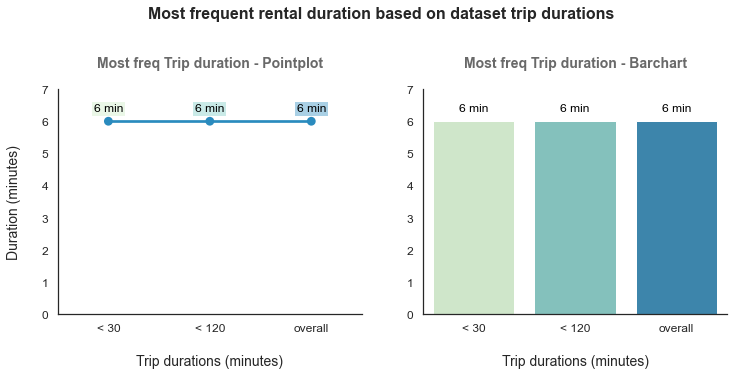

In [111]:
plt.figure(figsize = [12, 5])

# left plot: point plot
# =====================================================
# /////////////////////////////////////////////////////
plt.subplot(1, 2, 1)
sb.set_style('white')
sb.set_palette(palette = "GnBu", n_colors = 3, desat = None)
# seaborl's point plot
ax1 = sb.pointplot(data = duration_avg, x = 'dataset_duration', y = 'freq_trip_duration', color=sb.color_palette()[2])
# improve plot aesthetics
plt.title('Most freq Trip duration - Pointplot\n',  weight = 'bold', fontsize = 14, color = 'dimgrey')
plt.ylabel('Duration (minutes)\n', fontsize = 14)
plt.xlabel('\nTrip durations (minutes)', fontsize = 14)
plt.xticks(fontsize = 12)
# convert the yticks into integer values
locs, labels = plt.yticks()
y_ticks_new = np.arange(0, int(math.ceil(max(locs)))+1, 1)
plt.yticks(y_ticks_new, y_ticks_new, fontsize=12)

# add annotations
# -------------------------------------------------------
locs, labels = plt.xticks()
duration_freq_counts = duration_avg.freq_trip_duration.values
duration_freq_max = duration_freq_counts.max()
clrs = [sb.color_palette()[0], sb.color_palette()[1], sb.color_palette()[2]]

# loop through each pair of locations
for loc, duration_freq_count, clr in zip(locs, duration_freq_counts, clrs):
    try:
        count = duration_freq_count
    except KeyError:
        count = 0   
    pct_string = '{:0.0f} min'.format(math.ceil(count))
    # print the annotation depending on the bar length
    plt.text(loc, count + (duration_freq_max/20), pct_string, ha = 'center', color = 'black', fontsize = 12,
             bbox={'pad':1.9,'alpha':0.4,'color':'none','fc':clr})
# -------------------------------------------------------
sb.despine(top=True, right=True, bottom=False, left=False);
# =====================================================
# /////////////////////////////////////////////////////


# right plot: Bar chart
# =====================================================
# /////////////////////////////////////////////////////
plt.subplot(1, 2, 2)
sb.set_style('white')
sb.set_palette(palette = "GnBu", n_colors = 3, desat = None)
# seaborl's bar plot
g = sb.barplot(data = duration_avg, x = 'dataset_duration', y = 'freq_trip_duration')
# improve plot aesthetics
plt.title('Most freq Trip duration - Barchart\n',  weight = 'bold', fontsize = 14, color = 'dimgrey')
plt.ylabel('', fontsize = 14)
plt.xlabel('\nTrip durations (minutes)', fontsize = 14)
plt.xticks(fontsize = 12)
plt.ylim(ax1.get_ylim()); # set y-axis limits to be same as left plot
# convert the yticks into integer values
locs, labels = plt.yticks()
y_ticks_new = np.arange(0, int(math.ceil(max(locs)))+1, 1)
plt.yticks(y_ticks_new, y_ticks_new, fontsize=12)

# add annotations
# -------------------------------------------------------
locs, labels = plt.xticks()
duration_freq_counts = duration_avg.freq_trip_duration.values
duration_freq_max = duration_freq_counts.max()
clrs = ['gold' if (value > ((duration_freq_max*4)/5)) else 'limegreen' for value in duration_freq_counts]

# loop through each pair of locations
for loc, duration_freq_count, clr in zip(locs, duration_freq_counts, clrs):
    try:
        count = duration_freq_count
    except KeyError:
        count = 0   
    pct_string = '{:0.0f} min'.format(math.ceil(count))
    # print the annotation depending on the bar length
    plt.text(loc, count + (duration_freq_max/20), pct_string, ha = 'center', color = 'black', fontsize = 12)
# -------------------------------------------------------
sb.despine(top=True, right=True, bottom=False, left=False);
# =====================================================
# /////////////////////////////////////////////////////


plt.subplots_adjust(wspace=0.2, hspace=0.3)
plt.subplots_adjust(top=0.75)
plt.suptitle('Most frequent rental duration based on dataset trip durations\n', fontsize = 16, weight = 'bold');

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.1.18.f Most frequent trip duration depending on datasets.png', dpi=300, bbox_inches='tight')

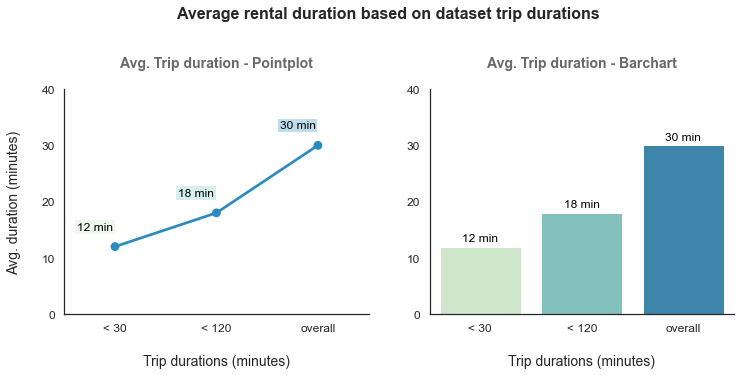

In [112]:
plt.figure(figsize = [12, 5])

# left plot: point plot
# =====================================================
# /////////////////////////////////////////////////////
plt.subplot(1, 2, 1)
sb.set_style('white')
sb.set_palette(palette = "GnBu", n_colors = 3, desat = None)
# Seaborn's point chart
ax1 = sb.pointplot(data = duration_avg, x = 'dataset_duration', y = 'avg_trip_duration', color=sb.color_palette()[2])
# improve plot aesthetics
plt.title('Avg. Trip duration - Pointplot\n',  weight = 'bold', fontsize = 14, color = 'dimgrey')
plt.ylabel('Avg. duration (minutes)\n', fontsize = 14)
plt.xlabel('\nTrip durations (minutes)', fontsize = 14)
plt.xticks(fontsize = 12)
# convert the yticks into integer values
locs, labels = plt.yticks()
y_ticks_new = np.arange(0, int(math.ceil(max(locs)))+10, 10)
plt.yticks(y_ticks_new, y_ticks_new, fontsize=12)

# add annotations
# -------------------------------------------------------
locs, labels = plt.xticks()
duration_avg_counts = duration_avg.avg_trip_duration.values
duration_avg_max = duration_avg_counts.max()
clrs = [sb.color_palette()[0], sb.color_palette()[1], sb.color_palette()[2]]

# loop through each pair of locations
for loc, duration_avg_count, clr in zip(locs, duration_avg_counts, clrs):
    try:
        count = duration_avg_count
    except KeyError:
        count = 0   
    pct_string = '{:0.0f} min'.format(math.ceil(count))
    # print the annotation depending on the bar length
    plt.text(loc-0.2, count + int(duration_avg_max/10), pct_string, ha = 'center', color = 'black', fontsize = 12,
             bbox={'pad':1.9,'alpha':0.3,'color':'none','fc':clr})
# -------------------------------------------------------
sb.despine(top=True, right=True, bottom=False, left=False);
# =====================================================
# /////////////////////////////////////////////////////


# right plot: Bar chart
# =====================================================
# /////////////////////////////////////////////////////
plt.subplot(1, 2, 2)
sb.set_style('white')
sb.set_palette(palette = "GnBu", n_colors = 3, desat = None)
# Seaborn's bar chart
g = sb.barplot(data = duration_avg, x = 'dataset_duration', y = 'avg_trip_duration')
# improve plot aesthetics
plt.title('Avg. Trip duration - Barchart\n',  weight = 'bold', fontsize = 14, color = 'dimgrey')
plt.ylabel('', fontsize = 14)
plt.xlabel('\nTrip durations (minutes)', fontsize = 14)
plt.xticks(fontsize = 12)
plt.ylim(ax1.get_ylim()); # set y-axis limits to be same as left plot
# convert the yticks into integer values
locs, labels = plt.yticks()
y_ticks_new = np.arange(0, int(math.ceil(max(locs)))+10, 10)
plt.yticks(y_ticks_new, y_ticks_new, fontsize=12)

# add annotations
# -------------------------------------------------------
locs, labels = plt.xticks()
duration_avg_counts = duration_avg.avg_trip_duration.values
duration_avg_max = duration_avg_counts.max()
clrs = ['gold' if (value > ((duration_avg_max*4)/5)) else 'limegreen' for value in duration_avg_counts]

# loop through each pair of locations
for loc, duration_avg_count, clr in zip(locs, duration_avg_counts, clrs):
    try:
        count = duration_avg_count
    except KeyError:
        count = 0   
    pct_string = '{:0.0f} min'.format(math.ceil(count))
    # print the annotation depending on the bar length
    plt.text(loc, count + int(duration_avg_max/30), pct_string, ha = 'center', color = 'black', fontsize = 12)
# -------------------------------------------------------
sb.despine(top=True, right=True, bottom=False, left=False);
# =====================================================
# /////////////////////////////////////////////////////


plt.subplots_adjust(wspace=0.2, hspace=0.3)
plt.subplots_adjust(top=0.75)
plt.suptitle('Average rental duration based on dataset trip durations\n', fontsize = 16, weight = 'bold');

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.1.18.g Average trip duration depending on datasets.png', dpi=300, bbox_inches='tight')

-------------

#### 3.1.19 Univariate analysis - Distribution of trip distances

+ `Column`: distance_miles
+ `Data type`: Quantitative data, Continuous
+ `Plot` : Histogram

**Plot the distribution of `distance_miles`:**

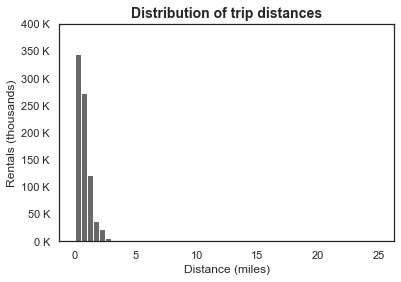

In [113]:
# Prepare the data for the plot
sb.set_style('white')
max_value = bikeshare['distance_miles'].max()
bin_edges = np.arange(0, max_value+0.5, 0.5)

sb.distplot(bikeshare['distance_miles'], kde = False, bins = bin_edges, hist_kws = {'alpha' : 1}, color = 'dimgrey')

# improve plot aesthetics
plt.title('Distribution of trip distances', fontsize = 14, weight = 'bold')
plt.xlabel('Distance (miles)', fontsize = 12)
plt.ylabel('Rentals (thousands)', fontsize = 12);

# convert yticks into the units of thousands
y_locs, y_labels = plt.yticks()
y_tick_names = ['{:0.0f} K'.format(y_loc/1000) for y_loc in y_locs]
plt.yticks(y_locs, y_tick_names)

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.1.19.a Distribution of trip distances.png', dpi=300, bbox_inches='tight')

> This data in their natural units, looks `highly right skewed`: lots of points with low values, with a very long tail of data points with large values (also all values are `positive`). The most common example of this is, the data that follows an approximately `log-normal distribution`. This is data that, in their natural units, can look highly skewed. However, after applying a logarithmic transform to the data, the data will follow a `normal distribution`. Hence let us apply `logarithmic transformation` to the `distance_miles` data.

**Logarithmic transformation of trip distances:**

> Before applying `Logarithmic transformation` of the `distance_miles` data, separate the data from the entries with `0` values.

In [114]:
# distances without zero entries
distance_non_zero = bikeshare.query(' distance_miles != 0 ')[['distance_miles']].copy()
distance_non_zero.head()

,distance_miles
0,0.27
2,0.86
3,0.42
4,0.42
5,1.59


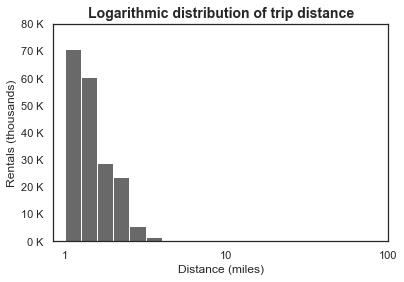

In [115]:
# logarithmic transformation of 'distance_miles' data

def log_trans(x, inverse = False):
    if not inverse:
        return np.log10(x)
    else:
        return 10 ** x

    
# prepare the data for the plot
min_value = log_trans(distance_non_zero['distance_miles'].min())
max_value = log_trans(distance_non_zero['distance_miles'].max())
bin_edges = np.arange(0, max_value+0.1, 0.1)

# matplotlib's histogram
plt.hist(distance_non_zero['distance_miles'].apply(log_trans), bins = bin_edges, color = 'dimgrey')

# improve plot aesthetics
tick_locs = np.arange(0, max_value+1, 1)
plt.xticks(tick_locs, log_trans(tick_locs, inverse = True).astype(int))
plt.title('Logarithmic distribution of trip distance', fontsize = 14, weight = 'bold')
plt.xlabel('Distance (miles)', fontsize = 12)
plt.ylabel('Rentals (thousands)', fontsize = 12)

# convert yticks into the units of thousands
y_locs, y_labels = plt.yticks()
y_tick_names = ['{:0.0f} K'.format(y_loc/1000) for y_loc in y_locs]
plt.yticks(y_locs, y_tick_names);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.1.19.b Logarithmic distribution of trip distances.png', dpi=300, bbox_inches='tight')

**Divide the `distance_miles` based on their distribution, for clear graphical plot.**

In [116]:
# compute the descriptive statistics of distances distribution 
bikeshare['distance_miles'].describe()

count    808589.000000
mean          0.709956
std           0.692094
min           0.000000
25%           0.310000
50%           0.580000
75%           0.970000
max          24.940000
Name: distance_miles, dtype: float64

> As the distance (displacement) is dependent on the start_station co-ordinates and end_station co-ordinates, the entries with `round trips` will have `0` miles extracted as `distance_miles`.

1. Breakdown the trip distnaces into categories:

In [117]:
# breakdown the trip distances into categories
print('Total trips'.ljust(20, ' '), ':', bikeshare.shape[0], '\n')
print('Round trips'.ljust(20, ' '), ':', bikeshare.query(' distance_miles == 0 ').shape[0])
print('Very small trips'.ljust(20, ' '), ':', bikeshare.query(' distance_miles > 0 and distance_miles < 0.1 ').shape[0])
print('Small trips'.ljust(20, ' '), ':', bikeshare.query(' distance_miles >= 0.1 and distance_miles < 0.5 ').shape[0])
print('Normal trips'.ljust(20, ' '), ':', bikeshare.query(' distance_miles >= 0.5 and distance_miles < 1 ').shape[0])
print('Long trips'.ljust(20, ' '), ':', bikeshare.query(' distance_miles >= 1 and distance_miles < 10 ').shape[0])
print('Very long trips'.ljust(20, ' '), ':', bikeshare.query(' distance_miles >= 10 ').shape[0])

Total trips          : 808589 

Round trips          : 124322
Very small trips     : 3341
Small trips          : 216254
Normal trips         : 272339
Long trips           : 191737
Very long trips      : 596


2. Convert the above categories into a datarame:

In [118]:
distances = {'trip_type' : pd.Series(['Round Trip', 'Very Small', 'Small', 'Normal', 'Long', 'Very Long']), 
             'trip_count' : pd.Series([bikeshare.query(' distance_miles == 0 ').shape[0], 
                                       bikeshare.query(' distance_miles > 0 and distance_miles < 0.1 ').shape[0],
                                       bikeshare.query(' distance_miles >= 0.1 and distance_miles < 0.5 ').shape[0], 
                                       bikeshare.query(' distance_miles >= 0.5 and distance_miles < 1 ').shape[0], 
                                       bikeshare.query(' distance_miles >= 1 and distance_miles < 10 ').shape[0],
                                       bikeshare.query(' distance_miles >= 10 ').shape[0]])}

# create Dataframe. 
trip_distances = pd.DataFrame(distances)
trip_distances

,trip_type,trip_count
0,Round Trip,124322
1,Very Small,3341
2,Small,216254
3,Normal,272339
4,Long,191737
5,Very Long,596


**`Bar chart:`**

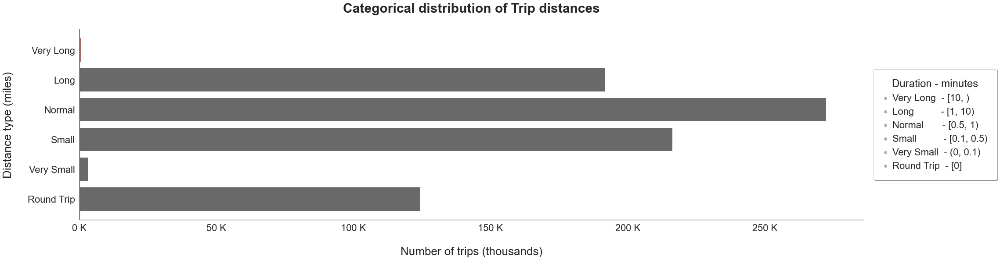

In [119]:
# Assign grid and color palette as per requirement
plt.figure(figsize = [32, 8])
sb.set_style("white")

# plot pre-calculations
base_color = sb.color_palette()[0]
dist_order = ['Very Long', 'Long', 'Normal', 'Small', 'Very Small', 'Round Trip']
time_order = ['[10, )', '[1, 10)', '[0.5, 1)', '[0.1, 0.5)', '(0, 0.1)', '[0]']
trip_counts = trip_distances.trip_count
trip_order = trip_distances.trip_type
x_tick_values = np.arange(0, trip_counts.max() + 50000, 50000)
x_tick_names = ['{:0.0f} K'.format(v/1000) for v in x_tick_values]
y_tick_values = [0, 1, 2, 3, 4, 5]
y_tick_names = dist_order
clrs = ['indianred', 'dimgrey', 'dimgrey', 'dimgrey', 'dimgrey', 'dimgrey']

# bar plot
sb.barplot(x = trip_counts, y = trip_order, order = dist_order, palette=clrs, alpha= 1, saturation = 1)

# plot - visual enhancements
plt.title('Categorical distribution of Trip distances\n', weight = 'bold', fontsize = 30)
plt.xticks(x_tick_values, x_tick_names, fontsize = 22)
plt.yticks(y_tick_values, y_tick_names, fontsize = 22)
plt.xlabel('\nNumber of trips (thousands)', fontsize = 26)
plt.ylabel('Distance type (miles)\n', fontsize = 26)

# Create a legend:
# -------------------------------------------------------
indents = [10, 13, 12, 14, 11, 11]
# Plot empty lists with the desired label
for dist, time, indent in zip(dist_order, time_order, indents):
    plt.scatter([], [], c='k', alpha=0.3,
                label= '{}'.format(dist).ljust(indent, ' ') + ' - ' + '{}'.format(time))
plt.legend(scatterpoints=1, frameon=True, fancybox=True, shadow=True, ncol = 1, framealpha = 1, 
           borderpad=1, borderaxespad=1, bbox_to_anchor = (1, 0.5), loc = 6, labelspacing=0.5,  
           title='Duration - minutes', title_fontsize=24, fontsize=22, facecolor='white', 
           markerfirst=True, handlelength=0.5, handletextpad=0.5)
# -------------------------------------------------------

sb.despine();

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.1.19.c Categorical distribution of Trip distances.png', dpi=300, bbox_inches='tight')

----

#### 3.1.20 Univariate analysis - Distribution of trip fares

+ `Column`: fare
+ `Data type`: Quantitative data, Continuous
+ `Plot` : Histogram

In [120]:
# compute the descriptive statistcs of fare
bikeshare.fare.describe()

count    808589.000000
mean          1.203841
std           6.951361
min           0.000000
25%           0.000000
50%           0.000000
75%           1.000000
max         540.750000
Name: fare, dtype: float64

Explore the optimal value of the `bin size` that best potrays the distribution of trip fares.

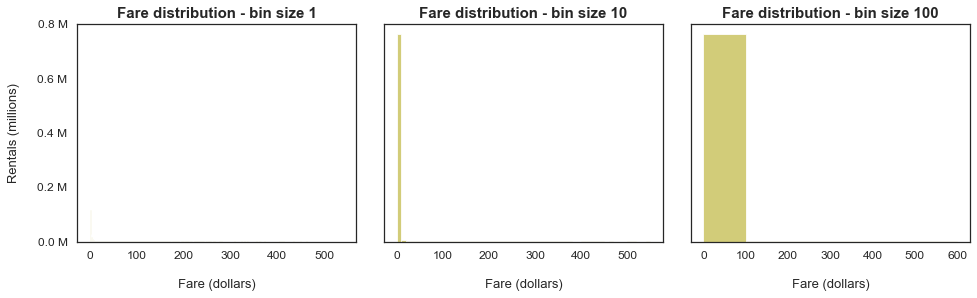

In [121]:
def dist_subplot(subplot, column, binsize):
    # subplot with custom bin size
    plt.subplot(1, 3, subplot)
    max_count = bikeshare[column].value_counts().max()
    y_tick_values = np.arange(0, bikeshare.shape[0]+100, 200000)
    y_tick_names = ['{:0.1f} M'.format(v/1000000) for v in y_tick_values]
    bin_edges = np.arange(0, bikeshare[column].max()+binsize, binsize)
    # Seaborn's distribution plot
    sb.distplot(bikeshare[column], bins = bin_edges, kde = False,
                hist_kws = {'alpha' : 0.8}, color = base_color)
    # improve plot aesthetics
    plt.title('Fare distribution - bin size {}'.format(binsize), fontsize = 15, weight = 'bold')
    plt.xlabel('\nFare (dollars)', fontsize = 13)
    plt.xticks(fontsize=12)
    if subplot == 1:
        plt.ylabel('Rentals (millions)\n', fontsize = 13)
        plt.yticks(y_tick_values, y_tick_names, fontsize=12)
    else:
        plt.ylabel('')
        plt.yticks(y_tick_values, [])


# Assign palette as per requirement
sb.set_palette('colorblind', n_colors=10, desat = 0.6)
base_color = sb.color_palette()[8]

# check the most optimal bin size to plot the distribution of 'duration_min'
plt.figure(figsize = [16, 4])

# plot subplots with various bin_sizes
dist_subplot(subplot = 1, column = 'fare', binsize = 1)
dist_subplot(subplot = 2, column = 'fare', binsize = 10)
dist_subplot(subplot = 3, column = 'fare', binsize = 100)

plt.subplots_adjust(wspace=0.1, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.1.20.a Distribution of trip fares - different bin sizes.png', dpi=300, bbox_inches='tight')

> The above plot depicts that the bin size needs to be small, and require closer observation for better understanding of the data distribution. Plot the distribution of trip fares, limited to `10 dollar` (which constitutes more than 75% of the data) for closer observation.

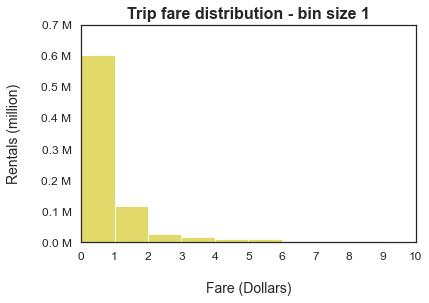

In [122]:
# Plot the distribution of bike fares, within the limitation of 10 dollar for closer observation

# Assign palette as per requirement
sb.set_palette('colorblind', n_colors=10, desat = 0.8)
base_color = sb.color_palette()[8]
sb.set_style('white')

# prepare the data for the plot
y_tick_values = np.arange(0, bikeshare.shape[0]+100, 200000)
y_tick_names = ['{:0.1f} M'.format(v/1000000) for v in y_tick_values]
bin_edges = np.arange(0, 10+1, 1)

# seaborn's distribution plot
sb.distplot(bikeshare['fare'], bins = bin_edges, kde = False,
            hist_kws = {'alpha' : 0.8}, color = base_color)

# improve plot aesthetics
# -------------------------------------------------------
plt.title('Trip fare distribution - bin size 1', fontsize = 16, weight = 'bold')
plt.xlabel('\nFare (Dollars)', fontsize = 14)
plt.ylabel('Rentals (million)\n', fontsize = 14)
plt.xlim(0, 10)

# obtain y_ticks and convert them to the units of millions
y_tick_locs = []
locs, labels = plt.yticks()

# loop through each pair of locations and labels
for loc, label in zip(locs, labels):
    y_tick_locs.append(int(loc))
    
y_tick_names = ['{:0.1f} M'.format(loc/1000000) for loc in y_tick_locs]
plt.yticks(y_tick_locs, y_tick_names, fontsize=12)
x_tick_locs = np.arange(0, 10+1, 1)
x_tick_names = ['{:0.0f}'.format(loc) for loc in x_tick_locs]
plt.xticks(x_tick_locs, x_tick_names,fontsize=12);
# -------------------------------------------------------

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.1.20.b Distribution of trip fares - limited to 10 dollar.png', dpi=300, bbox_inches='tight')

> This data in their natural units, looks `highly right skewed`: lots of points with low values, with a very long tail of data points with large values (also all values are `positive`). The most common example of this is, the data that follows an approximately `log-normal distribution`. This is data that, in their natural units, can look highly skewed. However, after applying a logarithmic transform to the data, the data will follow a `normal distribution`. Hence let us apply `logarithmic transformation` to the `fare` data.

**Logarithmic distribution of trip fares:**

Before applying `Logarithmic transformation` of the `fare` data, separate the data from the entries with `0` values.

In [123]:
# fares without zero entries (base fares)
fare_non_zero = bikeshare.query(' fare != 0 ')[['fare']].copy()
fare_non_zero.head()

,fare
1,1.00
2,1.00
5,1.00
6,1.00
7,2.75


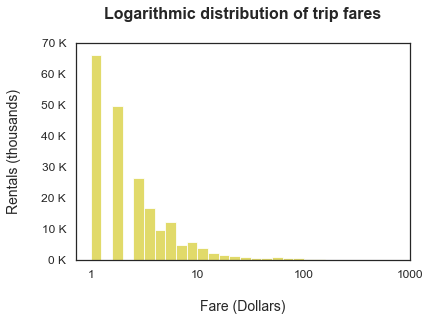

In [124]:
# logarithmic transformation of 'fare' data

def log_trans(x, inverse = False):
    if not inverse:
        return np.log10(x)
    else:
        return 10 ** x


# Assign palette as per requirement
sb.set_palette('colorblind', n_colors=10, desat = 0.8)
base_color = sb.color_palette()[8]

# prepare the data for the plot
min_value = log_trans(fare_non_zero['fare'].min())
max_value = log_trans(fare_non_zero['fare'].max())
bin_edges = np.arange(0, max_value+0.1, 0.1)

# matplotlib's histogram
plt.hist(fare_non_zero['fare'].apply(log_trans), bins = bin_edges, color = base_color, alpha=0.8)

# improve plot aesthetics
# -------------------------------------------------------
tick_locs = np.arange(0, max_value+1, 1)
plt.xticks(tick_locs, log_trans(tick_locs, inverse = True).astype(int), fontsize = 12)
plt.yticks(fontsize = 12)
plt.title('Logarithmic distribution of trip fares\n', fontsize = 16, weight = 'bold')
plt.xlabel('\nFare (Dollars)', fontsize = 14)
plt.ylabel('Rentals (thousands)\n', fontsize = 14)

# obtain y_ticks and convert them to a multiple of millions
y_tick_locs = []
locs, labels = plt.yticks()

# loop through each pair of locations and labels
for loc, label in zip(locs, labels):
    y_tick_locs.append(int(loc))
    
y_tick_names = ['{:0.0f} K'.format(loc/1000) for loc in y_tick_locs]
plt.yticks(y_tick_locs, y_tick_names, fontsize=12);
# -------------------------------------------------------

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.1.20.c Logarithmic distribution of trip fares.png', dpi=300, bbox_inches='tight')

**Divide the `fare` based on their distribution, for clear graphical plot.**

In [125]:
# compute the descriptive statistics of trip fares
bikeshare['fare'].describe()

count    808589.000000
mean          1.203841
std           6.951361
min           0.000000
25%           0.000000
50%           0.000000
75%           1.000000
max         540.750000
Name: fare, dtype: float64

Breakdown the trip fares into customized sections.

In [126]:
# divide the fare into customized sections
bin = [-1,0,5,10,50,100,600]
#use pd.cut function to attribute the values into its specific bins
fare = pd.cut(bikeshare['fare'],bin)
fare = fare.to_frame()
fare.columns = ['fare_sections']
fare.sample(10)

,fare_sections
405616,"(-1, 0]"
77800,"(-1, 0]"
248016,"(-1, 0]"
452640,"(-1, 0]"
390451,"(-1, 0]"
380232,"(-1, 0]"
347668,"(-1, 0]"
6657,"(-1, 0]"
571448,"(-1, 0]"
80141,"(-1, 0]"


**`Count plot:`**

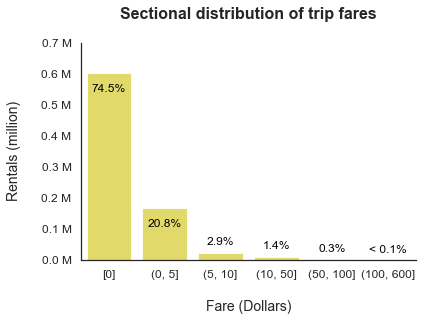

In [127]:
# Assign palette as per requirement
sb.set_palette('colorblind', n_colors=10, desat = 0.8)
base_color = sb.color_palette()[8]

# Seaborn's count plot
sb.countplot(data = fare, x = 'fare_sections', color = base_color, alpha= 0.8, saturation = 1)


# improve plot aesthetics
# -------------------------------------------------------
plt.title('Sectional distribution of trip fares\n', fontsize = 16, weight = 'bold')
plt.xlabel('\nFare (Dollars)', fontsize = 14)
plt.ylabel('Rentals (million)\n', fontsize = 14)
# obtain y_ticks and convert them to a multiple of millions
y_tick_locs = []
locs, labels = plt.yticks()

# loop through each pair of locations and labels
for loc, label in zip(locs, labels):
    y_tick_locs.append(int(loc))
    
y_tick_names = ['{:0.1f} M'.format(loc/1000000) for loc in y_tick_locs]
plt.yticks(y_tick_locs, y_tick_names, fontsize=12)
# assigning xticks here will interfere with annotations
# -------------------------------------------------------


# add annotations
# -------------------------------------------------------
n_points = fare.shape[0]
fare_counts = fare.fare_sections.value_counts()
fare_max = fare_counts.max()
# get the current tick locations and labels
locs, labels = plt.xticks()

# loop through each pair of locations and labels
for loc, label in zip(locs, labels):
    # get the text property for the label to get the correct count
    str = (label.get_text()[-4:-1])
    num = [int(s) for s in str.split() if s.isdigit()]
    if num[0] in fare_counts.index[0]:
        count = fare_counts.values[0]
    elif num[0] in fare_counts.index[1]:
        count = fare_counts.values[1]
    elif num[0] in fare_counts.index[2]:
        count = fare_counts.values[2]
    elif num[0] in fare_counts.index[3]:
        count = fare_counts.values[3]
    elif num[0] in fare_counts.index[4]:
        count = fare_counts.values[4]
    else:
        count = 0

    if (100*count/n_points) < 0.1:
        pct_string = '< 0.1%'
    else:
        pct_string = '{:0.1f}%'.format(100*count/n_points)

    # print the annotation depending on the bar length
    if count < (fare_max/10):
        plt.text(loc, count+(fare_max/25), pct_string, ha = 'center', color = 'black', weight = 'normal', fontsize = 12)
    else:
        plt.text(loc, count-(fare_max/10), pct_string, ha = 'center', color = 'black', weight = 'normal', fontsize = 12)
# -------------------------------------------------------
    
    
# get xticks and change the first categorical expression tto just zero dollars
x_labels_new = ['[0]']
# get the current tick locations and labels
x_locs, x_labels = plt.xticks()
for x_label in x_labels[1:]:
    x_labels_new.append(x_label.get_text())
plt.xticks(x_locs, x_labels_new, fontsize=12)

sb.despine();

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.1.20.d Sectional distribution of trip fares.png', dpi=300, bbox_inches='tight')

In the previous plot: `3.1.4 Distribution of bike rentals based on fare type`, the base fares consists of `83%`, however the percentage of bike rentals that paid `Zero` dollars is `74.5%`. This is because unlike other pass types, the `Walk-up` pass type has a fare charge of `1 dollar` for `Base` fare type. Hence the percentage of rentals that are charged with `zero dollars` are less than the percentage of rentals with fare type as `Base`.

-----

<h4><center>-------- End of 3.1.Univariate Data Analysis --------</center></h4>

------

### <ins>`3.2 Bivariate Data Analysis:`</ins>

#### 3.2.1 Bivariate analysis - Correlation between variables in the dataset:

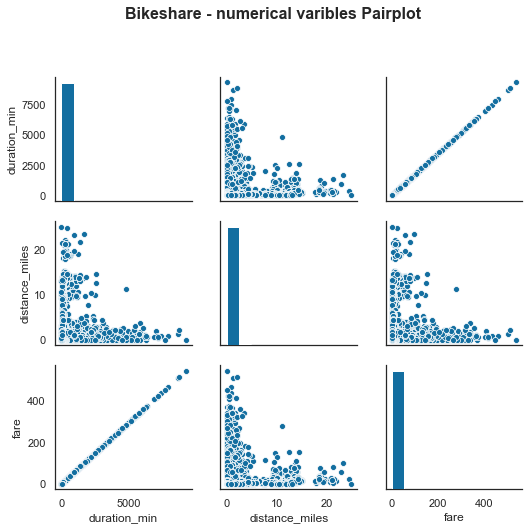

In [128]:
# Seaborn's pair plot
g = sb.pairplot(bikeshare[['duration_min', 'distance_miles', 'fare']])
g.fig.subplots_adjust(top=0.85)
g.fig.suptitle('Bikeshare - numerical varibles Pairplot\n', fontsize = 16, weight = 'bold');

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.1.a Pairplot of numerical varibles .png', dpi=300, bbox_inches='tight')

1. Compute correlation matrix:

In [129]:
# Display correlation matix of the dataset
bikeshare.corr()

,trip_id,bike_id,distance_miles,duration_min,fare,year,month,day,hour,start_station_id,start_lat,start_lon,end_station_id,end_lat,end_lon
trip_id,1.000000,0.491876,0.024484,0.017716,-0.001796,0.929705,0.254051,0.008219,-0.007418,0.119899,-0.092116,-0.142361,0.120266,-0.090961,-0.142056
bike_id,0.491876,1.000000,0.034601,0.012844,0.002176,0.500133,0.206123,0.012213,0.014606,0.236215,-0.109049,-0.227028,0.236623,-0.105520,-0.226707
distance_miles,0.024484,0.034601,1.000000,0.025867,0.012132,0.020238,0.014248,0.002979,-0.018991,0.090167,0.042364,-0.091066,0.102056,0.039883,-0.107505
duration_min,0.017716,0.012844,0.025867,1.000000,0.997337,0.005313,0.010328,0.001217,0.000381,0.097929,-0.066990,-0.106538,0.103022,-0.065704,-0.107183
fare,-0.001796,0.002176,0.012132,0.997337,1.000000,-0.011756,0.002994,0.001459,-0.001715,0.092388,-0.062522,-0.101410,0.097423,-0.061131,-0.102013
year,0.929705,0.500133,0.020238,0.005313,-0.011756,1.000000,-0.050311,-0.008468,-0.008862,0.085996,-0.077962,-0.109972,0.086443,-0.077819,-0.109518
month,0.254051,0.206123,0.014248,0.010328,0.002994,-0.050311,1.000000,-0.028878,-0.005160,0.080059,-0.007464,-0.032737,0.078726,-0.006550,-0.032711
day,0.008219,0.012213,0.002979,0.001217,0.001459,-0.008468,-0.028878,1.000000,0.004036,0.007327,0.008018,-0.000942,0.007244,0.008266,-0.001350
hour,-0.007418,0.014606,-0.018991,0.000381,-0.001715,-0.008862,-0.005160,0.004036,1.000000,0.025249,-0.019759,-0.009867,0.028594,-0.008430,-0.000333
start_station_id,0.119899,0.236215,0.090167,0.097929,0.092388,0.085996,0.080059,0.007327,0.025249,1.000000,-0.208669,-0.536284,0.879228,-0.198710,-0.528006


2. Plot correlation marix:

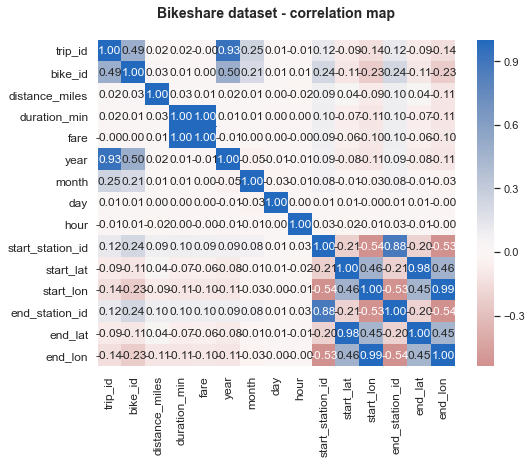

In [130]:
bikeshare_corr = bikeshare.corr()

# correlation plot
plt.figure(figsize = [8, 6])
sb.heatmap(bikeshare.corr(), annot = True, fmt = '.2f', cmap = 'vlag_r', center = 0)
plt.title('Bikeshare dataset - correlation map\n', weight = 'bold', fontsize = 14)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.1.b Bikeshare dataset - correlation map.png', dpi=300, bbox_inches='tight')

-------

#### 3.2.2 Bivariate analysis of `start_lat` and `start_lon` columns:

+ `Column`: start_lat, start_lon
+ `Data type`: numerical data, continuous
+ `Plot` : Scatter plot

Explore the geographical distribution of bike rentals based on lattitude and longitude.

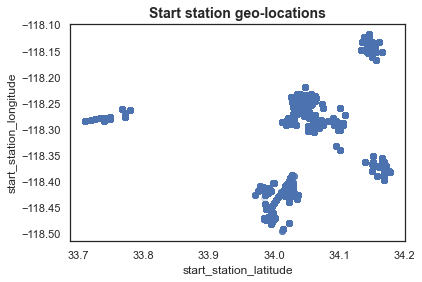

In [131]:
sb.set_palette(palette = "deep", n_colors = 20, desat = None)
sb.regplot(data = bikeshare, x = 'start_lat', y = 'start_lon', 
           fit_reg = False, scatter_kws = {'alpha' : 1/5})
plt.title('Start station geo-locations', fontsize = 14, weight = 'bold')
plt.xlabel('start_station_latitude', fontsize = 12)
plt.ylabel('start_station_longitude', fontsize = 12);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.2.a Start station geo-locations.png', dpi=300, bbox_inches='tight')

Explore the descriptive statistics of the `start_latitude` and `start_longitude`.

In [132]:
bikeshare[['start_lat', 'start_lon']].describe()

,start_lat,start_lon
count,808589.000000,808589.000000
mean,34.040370,-118.276736
std,0.055176,0.082990
min,33.710979,-118.495422
25%,34.039982,-118.264557
50%,34.046810,-118.253838
75%,34.051941,-118.243530
max,34.177662,-118.116530


**`Heat Map:`**

Plot the grographical distribution of start stations using heat map.

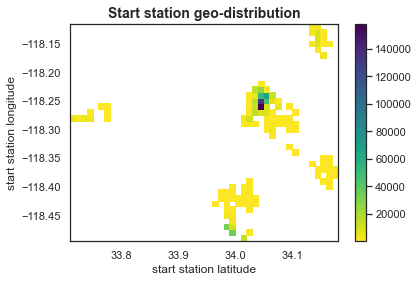

In [133]:
# prepare the data for the plot
x_bins = np.arange(bikeshare.start_lat.min(), bikeshare.start_lat.max()+0.01, 0.01)
y_bins = np.arange(bikeshare.start_lon.min(), bikeshare.start_lon.max()+0.01, 0.01)

# matplotlib's heatmap
plt.hist2d(data = bikeshare, x = 'start_lat', y = 'start_lon', 
           cmin = 0.5, cmap = 'viridis_r', bins = [x_bins, y_bins])

# improve plot aesthetics
plt.title('Start station geo-distribution', fontsize = 14, weight = 'bold')
plt.xlabel('start station latitude', fontsize = 12)
plt.ylabel('start station longitude', fontsize = 12)
plt.colorbar();

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.2.b Start station geo-distribution using heatmap.png', dpi=300, bbox_inches='tight')

The above plot depicts that the bike rentals are clusterd at specific locations. Re-plot the graph with larger bin size and annotations for more clear interpretation.

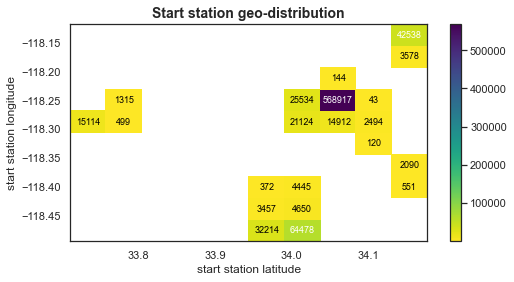

In [134]:
plt.figure(figsize = [8, 4])
h2d = plt.hist2d(data = bikeshare, x = 'start_lat', y = 'start_lon', cmin = 0.5, cmap = 'viridis_r')
plt.title('Start station geo-distribution', fontsize = 14, weight = 'bold')
plt.xlabel('start station latitude', fontsize = 12)
plt.ylabel('start station longitude', fontsize = 12)

# getting individual elements
counts = h2d[0]
x_bins = h2d[1]
y_bins = h2d[2]

counts_list = []
x_bin_diff_list = []
y_bin_diff_list = []

for i in range(counts.shape[0]):
    for j in range(counts.shape[1]):
        c = counts[i,j]
        # eliminate nan and append only if c does not exist in counts_list
        if c not in counts_list and not np.isnan(c):
            counts_list.append(c)

for bin in range(len(x_bins)-1):
    x_bin_diff = x_bins[bin+1] - x_bins[bin]
    if x_bin_diff not in x_bin_diff_list:
        x_bin_diff_list.append(x_bin_diff)
        
for bin in range(len(y_bins)-1):
    y_bin_diff = y_bins[bin+1] - y_bins[bin]
    if y_bin_diff not in y_bin_diff_list:
        y_bin_diff_list.append(y_bin_diff)

counts_mean = np.mean(counts_list)
x_bin_size = max(x_bin_diff_list)
y_bin_size = max(y_bin_diff_list)

for i in range(counts.shape[0]):
    for j in range(counts.shape[1]):
        c = counts[i,j]
        if c >= counts_mean: # increase visibility on darkest cells
            plt.text(x_bins[i] + (x_bin_size/2), y_bins[j] + (y_bin_size/2), int(c),
                     ha = 'center', va = 'center', color = 'white', fontsize = 9)
        elif c > 0:
            plt.text(x_bins[i] + (x_bin_size/2), y_bins[j] + (y_bin_size/2), int(c),
                     ha = 'center', va = 'center', color = 'black', fontsize = 9)
plt.colorbar(); 

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.2.c Start station geo-distribution using heat map.png', dpi=300, bbox_inches='tight')

As `end_lat` and `end_lon` are associated with the same bike stations there is no necessity to explore the distribution of the end_stations geographical distribution.

-----------

#### 3.2.3 Bivariate analysis of `start_station_id` and `end_station_id` columns:

+ `Column`: start_station_id, start_station_id
+ `Data type`: numerical data, continuous
+ `Plot` : Scatter plot

Explore the bike rental traffic between start_stations and end_stations:

In [135]:
bikeshare.groupby([bikeshare['start_station_id'],
                   bikeshare['end_station_id']]).size()

start_station_id  end_station_id
3005              3005              2938
                  3006              1074
                  3007               573
                  3008               630
                  3009                 1
                                    ... 
4493              4453                 2
                  4455                 3
                  4473                 1
                  4483                 3
                  4493                 2
Length: 11979, dtype: int64

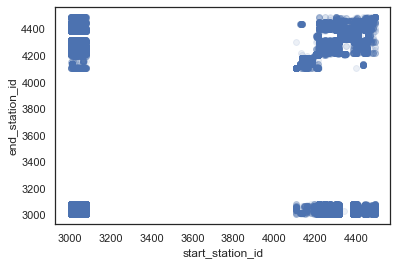

In [136]:
sb.regplot(data = bikeshare, x = 'start_station_id', y = 'end_station_id', fit_reg = False, scatter_kws = {'alpha' : 1/10});

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.3 Bike rental traffic between start stations and end stations.png', dpi=300, bbox_inches='tight')

> It appears some station pairs does not have bike activity between them.

-----

#### 3.2.4 Bivariate analysis of `start_station_id` and `trip_type` columns:

+ `Column`: start_station_id, trip_type
+ `Data type`: numerical data, continuous
+ `Plot` : Scatter plot

**Distribution of `start_stations` rental traffic based on `trip_type`.**

In [137]:
start_stations = bikeshare.groupby([bikeshare['start_station_id'], 
                                    bikeshare['trip_type']]).size().reset_index(name='rentals')
start_stations.head()

,start_station_id,trip_type,rentals
0,3005,One Way,32071
1,3005,Round Trip,2938
2,3006,One Way,14171
3,3006,Round Trip,1692
4,3007,One Way,14092


In [138]:
start_stations['rentals'].describe()

count      540.000000
mean      1497.387037
std       3585.925362
min          1.000000
25%         59.750000
50%        246.000000
75%       1095.750000
max      32071.000000
Name: rentals, dtype: float64

> calculate max value of the count to estimate bin size of the preceeding plot

In [139]:
start_stations['rentals'].max()

32071

> As the max value is around `32000`, let the bin size be `1000`.

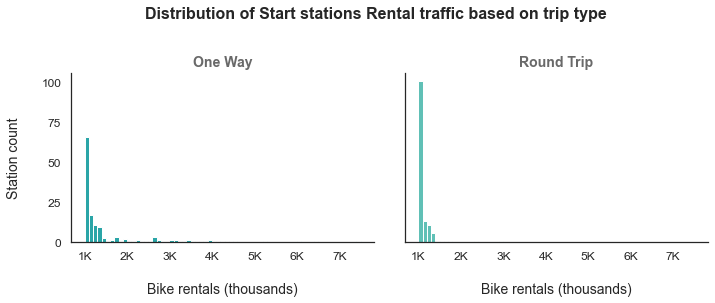

In [140]:
# Assign palette as per requirement
sb.set_style('white')
flatui = ['darkturquoise', 'turquoise']
sb.set_palette(flatui, n_colors=2, desat=0.6)

# prepare data for plotting
max_value = start_stations['rentals'].max()
bin_edges = np.arange(0, max_value+500, 500)
tick_locs = np.arange(0, max_value+1, 1)

# plot facet grid
g = sb.FacetGrid(data = start_stations, col = 'trip_type', col_wrap = 2, height = 4, aspect = 1.2, hue = 'trip_type')
g.map(plt.hist, "rentals", bins = bin_edges)

g.fig.subplots_adjust(top=0.75)
g.fig.suptitle('Distribution of Start stations Rental traffic based on trip type\n', fontsize = 16, weight = 'bold')
g.set_titles('{col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# improve plot aesthetics
x_tick_max = (max_value/1000)
x_tick_locs = np.arange(0, x_tick_max+1, 1)
x_tick_names = ['{:0.0f}K'.format(loc) for loc in x_tick_locs]
g.set_xticklabels(x_tick_names, size=12)
g.set_yticklabels(size = 12)
g.set_xlabels('\nBike rentals (thousands)', size = 14)
g.set_ylabels('Station count\n', size = 14)
plt.subplots_adjust(wspace=0.1, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.4.a Distribution of Start stations Rental traffic based on trip type.png', dpi=300, bbox_inches='tight')

> This data in their natural units, looks `highly right skewed`: lots of points with low values, with a very long tail of data points with large values (also all values are `positive`). The most common example of this is, the data that follows an approximately `log-normal distribution`. This is data that, in their natural units, can look highly skewed. However, after applying a logarithmic transform to the data, the data will follow a `normal distribution`. Hence let us apply `logarithmic transformation` to the start station's bike rental data.

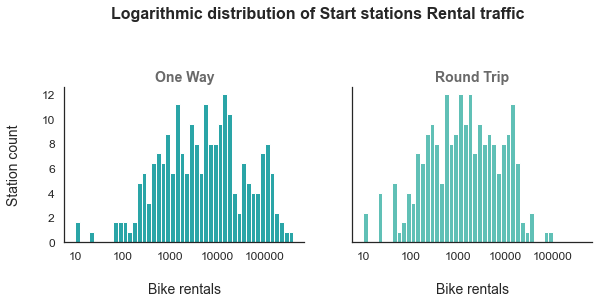

In [141]:
def log_trans(x, inverse = False):
    if not inverse:
        return np.log10(x)
    else:
        return 10 ** x

    
# Assign palette as per requirement
sb.set_style('white')
flatui = ['darkturquoise', 'turquoise']
sb.set_palette(flatui, desat = 0.6)

# prepare data for plotting
start_stations['log_count'] = start_stations['rentals'].apply(log_trans)
min_value = log_trans(start_stations['rentals'].min())
max_value = log_trans(start_stations['rentals'].max())
bin_edges = np.arange(0, max_value+0.1, 0.1)
tick_locs = np.arange(0, max_value+1, 1)

# plot facet grid
g = sb.FacetGrid(data = start_stations, col = 'trip_type', col_wrap = 2, height = 4, aspect = 1, hue = 'trip_type')
g.map(plt.hist, "log_count", bins = bin_edges)

g.fig.subplots_adjust(top=0.7)
g.fig.suptitle('Logarithmic distribution of Start stations Rental traffic\n', fontsize = 16, weight = 'bold')
g.set_titles('{col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# improve plot aesthetics
x_tick_names = log_trans(tick_locs, inverse = True).astype(int)
g.set_xticklabels(x_tick_names, size = 12)
g.set_yticklabels(size = 12)
g.set_xlabels('\nBike rentals', size = 14)
g.set_ylabels('Station count\n', size = 14)
plt.subplots_adjust(wspace=0.2, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.4.b Logarithmic distribution of Start stations Rental traffic based on trip type.png', dpi=300, bbox_inches='tight')

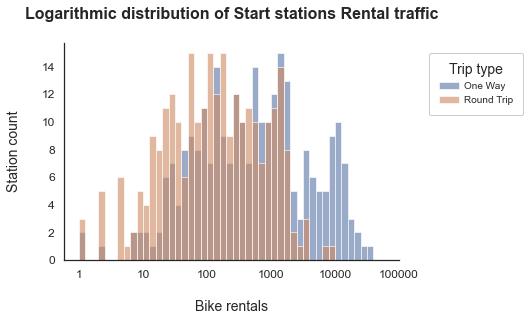

In [142]:
def log_trans(x, inverse = False):
    if not inverse:
        return np.log10(x)
    else:
        return 10 ** x

    
# Assign palette as per requirement
sb.set_style('white')
sb.set_palette('deep', desat = 0.8)

min_value = log_trans(start_stations[start_stations['trip_type'] == "One Way"]['rentals'].min())
max_value = log_trans(start_stations[start_stations['trip_type'] == "One Way"]['rentals'].max())
bin_edges = np.arange(0, max_value+0.1, 0.1)
plt.hist(start_stations[start_stations['trip_type'] == "One Way"]['rentals'].apply(log_trans), 
         bins = bin_edges, color = sb.color_palette()[0], alpha=0.6, label = 'One Way')
plt.hist(start_stations[start_stations['trip_type'] == "Round Trip"]['rentals'].apply(log_trans), 
         bins = bin_edges, color = sb.color_palette()[1], alpha=0.6, label = 'Round Trip')
tick_locs = np.arange(0, max_value+1, 1)
plt.xticks(tick_locs, log_trans(tick_locs, inverse = True).astype(int), fontsize = 12)
plt.yticks(fontsize = 12)
plt.xlabel('\nBike rentals', fontsize = 14)
plt.ylabel('Station count\n', fontsize = 14)
plt.title('Logarithmic distribution of Start stations Rental traffic\n', fontsize = 16, weight = 'bold')

plt.legend(bbox_to_anchor=(1.4, 1), scatterpoints=1,frameon=True, fancybox=True, 
           shadow=False, framealpha = 1, borderpad=1, borderaxespad=1, labelspacing=0.5, 
           ncol = 1, title='Trip type', title_fontsize=14, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5, loc = 'upper right');
sb.despine();

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.4.c Logarithmic distribution of Start stations Rental traffic based on trip type.png', dpi=300, bbox_inches='tight')

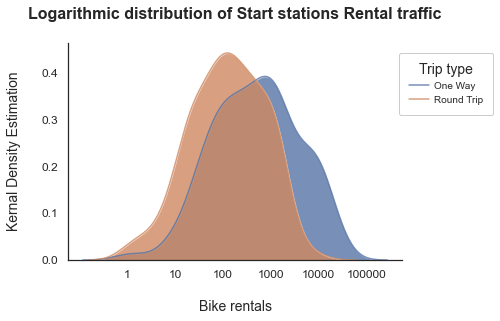

In [143]:
def log_trans(x, inverse = False):
    if not inverse:
        return np.log10(x)
    else:
        return 10 ** x

    
# Assign palette as per requirement
sb.set_style('white')
sb.set_palette('deep', desat = 0.8)

min_value = log_trans(start_stations[start_stations['trip_type'] == "One Way"]['rentals'].min())
max_value = log_trans(start_stations[start_stations['trip_type'] == "One Way"]['rentals'].max())
bin_edges = np.arange(0, max_value+0.1, 0.1)

sb.distplot(start_stations[start_stations['trip_type'] == "One Way"]['rentals'].apply(log_trans), 
            bins = bin_edges, kde = True, kde_kws = {'alpha' :0.8, "shade": True}, 
            color = sb.color_palette()[0], label = 'One Way', hist=False)
sb.distplot(start_stations[start_stations['trip_type'] == "Round Trip"]['rentals'].apply(log_trans), 
            bins = bin_edges, kde = True, kde_kws = {'alpha' :0.8, "shade": True}, 
            color = sb.color_palette()[1], label = 'Round Trip', hist=False)
tick_locs = np.arange(0, max_value+1, 1)
plt.xticks(tick_locs, log_trans(tick_locs, inverse = True).astype(int), fontsize = 12)
plt.yticks(fontsize = 12)
plt.xlabel('\nBike rentals', fontsize = 14)
plt.ylabel('Kernal Density Estimation\n', fontsize = 14)
plt.title('Logarithmic distribution of Start stations Rental traffic\n', fontsize = 16, weight = 'bold')

plt.legend(bbox_to_anchor=(1.3, 1), scatterpoints=1,frameon=True, fancybox=True, 
           shadow=False, framealpha = 1, borderpad=1, borderaxespad=1, labelspacing=0.5, 
           ncol = 1, title='Trip type', title_fontsize=14, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5, loc = 'upper right');
sb.despine();

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.4.d Kernal density estimation of Start stations Rental traffic based on trip type.png', dpi=300, bbox_inches='tight')

In [144]:
print('start stations with "One Way" trips'.ljust(35, ' '), ':', 
      start_stations.query(' trip_type == "One Way" ').shape[0], '\n')
print('Very Low traffic start stations'.ljust(35, ' '), ':', 
      start_stations.query(' trip_type == "One Way" and rentals < 10 ').shape[0])
print('Low traffic start stations'.ljust(35, ' '), ':', 
      start_stations.query(' trip_type == "One Way" and rentals >= 10 and rentals < 100 ').shape[0])
print('Normal traffic start stations'.ljust(35, ' '), ':', 
      start_stations.query(' trip_type == "One Way" and rentals >= 100 and rentals < 1000 ').shape[0])
print('High traffic start stations'.ljust(35, ' '), ':', 
      start_stations.query(' trip_type == "One Way" and rentals >= 1000 and rentals < 10000 ').shape[0])
print('Very High traffic start stations'.ljust(35, ' '), ':', 
      start_stations.query(' trip_type == "One Way" and rentals >= 10000 ').shape[0])

start stations with "One Way" trips : 270 

Very Low traffic start stations     : 7
Low traffic start stations          : 58
Normal traffic start stations       : 100
High traffic start stations         : 81
Very High traffic start stations    : 24


In [145]:
print('start stations with "Round Trip" trips'.ljust(40, ' '), ':', 
      start_stations.query(' trip_type == "Round Trip" ').shape[0], '\n')
print('Very Low traffic start stations'.ljust(40, ' '), ':', 
      start_stations.query(' trip_type == "Round Trip" and rentals < 10 ').shape[0])
print('Low traffic start stations'.ljust(40, ' '), ':', 
      start_stations.query(' trip_type == "Round Trip" and rentals >= 10 and rentals < 100 ').shape[0])
print('Normal traffic start stations'.ljust(40, ' '), ':', 
      start_stations.query(' trip_type == "Round Trip" and rentals >= 100 and rentals < 1000 ').shape[0])
print('High traffic start stations'.ljust(40, ' '), ':', 
      start_stations.query(' trip_type == "Round Trip" and rentals >= 1000 and rentals < 10000 ').shape[0])
print('Very High traffic start stations'.ljust(40, ' '), ':', 
      start_stations.query(' trip_type == "Round Trip" and rentals >= 10000 ').shape[0])

start stations with "Round Trip" trips   : 270 

Very Low traffic start stations          : 22
Low traffic start stations               : 96
Normal traffic start stations            : 111
High traffic start stations              : 41
Very High traffic start stations         : 0


In [146]:
bin = [0,10,100,1000,10000,100000]
#use pd.cut function can attribute the values into its specific bins
category = pd.cut(start_stations['rentals'],bin)
category = category.to_frame()
category.columns = ['rental_bins']
category['trip_type'] = start_stations['trip_type']
category['start_station_id'] = start_stations['start_station_id']
category.reindex(columns=['start_station_id', 'trip_type', 'rental_bins'])
category.head()

,rental_bins,trip_type,start_station_id
0,"(10000, 100000]",One Way,3005
1,"(1000, 10000]",Round Trip,3005
2,"(10000, 100000]",One Way,3006
3,"(1000, 10000]",Round Trip,3006
4,"(10000, 100000]",One Way,3007


In [148]:
category.rental_bins.sort_values(ascending=True).unique()

[(0, 10], (10, 100], (100, 1000], (1000, 10000], (10000, 100000]]
Categories (5, interval[int64]): [(0, 10] < (10, 100] < (100, 1000] < (1000, 10000] < (10000, 100000]]

In [149]:
%%time

def label_race(df):
    df.loc[df['rental_bins'] == df.rental_bins.sort_values(ascending=True).unique()[0],'traffic'] = 'Very Low'
    df.loc[df['rental_bins'] == df.rental_bins.sort_values(ascending=True).unique()[1],'traffic'] = 'Low'
    df.loc[df['rental_bins'] == df.rental_bins.sort_values(ascending=True).unique()[2],'traffic'] = 'Normal'
    df.loc[df['rental_bins'] == df.rental_bins.sort_values(ascending=True).unique()[3],'traffic'] = 'High'
    df.loc[df['rental_bins'] == df.rental_bins.sort_values(ascending=True).unique()[4],'traffic'] = 'Very High'
    
df = category
label_race(df)

level_order = ['Very Low', 'Low', 'Normal', 'High', 'Very High']
ordered_cat = pd.api.types.CategoricalDtype(ordered = True, categories = level_order)
df['traffic'] = df['traffic'].astype(ordered_cat)

category.traffic.value_counts()

Wall time: 51 ms


Normal       211
Low          153
High         122
Very Low      30
Very High     24
Name: traffic, dtype: int64

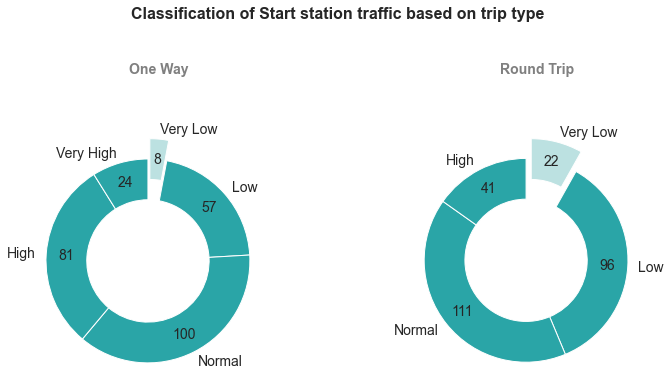

In [150]:
def plot_pie(cat_type):
    df = category[category['trip_type'] == cat_type]
    subdf = df.groupby([df['traffic']]).size().reset_index(name='stations')
    df_to_plot = subdf.loc[lambda df_to_plot: subdf['stations'] != 0]
    type_level_counts = df_to_plot.stations
    type_level_index = df_to_plot.traffic.sort_values(ascending=True).unique()
    clrs = [ sb.color_palette()[0] if (x > type_level_counts.min()) else sb.color_palette()[1] for x in type_level_counts ]
    explode = [ 0 if (x > type_level_counts.min()) else 0.2 for x in type_level_counts ]
    p, tx, autotexts = plt.pie(type_level_counts, labels = type_level_index, startangle = 90,
                               counterclock = False, wedgeprops = {'width' : 0.4}, shadow=False, 
                               explode=explode, colors=clrs, textprops={'fontsize': 14}, 
                               autopct='', labeldistance=1.1, pctdistance=0.8)
    plt.title(cat_type+ '\n\n\n', weight='bold', color='grey', fontsize=14)
    plt.axis('square');

    for i, a in enumerate(autotexts):
        a.set_text("{}".format(type_level_counts[i]))

    
# Assign palette as per requirement
sb.set_style('white')
flatui = ['darkturquoise', 'paleturquoise']
sb.set_palette(flatui, desat = 0.6)

Ncount = len(category.trip_type.unique())
types = category.trip_type.unique()
plt.figure(figsize = [12, 6])

# subplot 
plt.subplot(1, 2, 1)
plot_pie('One Way')
# subplot 
plt.subplot(1, 2, 2)
plot_pie('Round Trip')

plt.suptitle('Classification of Start station traffic based on trip type', fontsize = 16, weight = 'bold')
plt.subplots_adjust(top=0.7)
plt.subplots_adjust(wspace=0.3, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.4.e pie chart classification of Start stations Rental traffic based on trip type.png', dpi=300, bbox_inches='tight')

<Figure size 432x288 with 0 Axes>

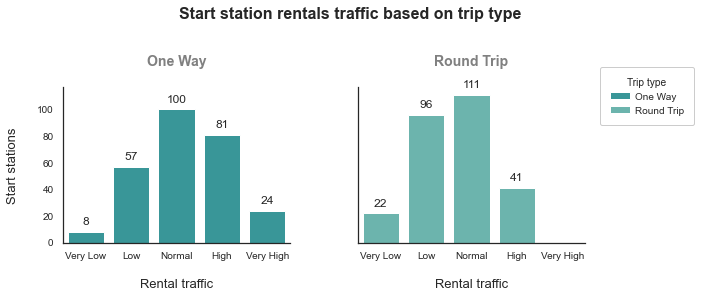

In [151]:
# Assign palette as per requirement
sb.set_style('white')
flatui = ['darkturquoise', 'turquoise']
sb.set_palette(flatui, desat = 0.6)
plt.figure(figsize = [6, 4])

# plot Facet Grid
g = sb.FacetGrid(data = category, col = 'trip_type', col_wrap = 2, height = 4, aspect = 1, hue = 'trip_type')
g.map(sb.countplot, 'traffic', order = category.traffic.sort_values(ascending=True).unique())
g.fig.subplots_adjust(top=0.8)
g.fig.suptitle('Start station rentals traffic based on trip type\n', fontsize = 16, weight = 'bold')
g.set_titles('{col_name}\n', weight = 'bold', size = 14, color = 'grey')

# improve plot aesthetics
g.set_yticklabels(size = 10)
g.set_xticklabels(size = 10)
g.set_xlabels('\nRental traffic', size = 13)
g.set_ylabels('Start stations\n', size = 13)
g.add_legend(bbox_to_anchor=(1.05, 0.7), scatterpoints=1,frameon=True, fancybox=True, 
             shadow=False, framealpha = 1, borderpad=1, borderaxespad=1, labelspacing=0.5, 
             ncol = 1, title='Trip type', title_fontsize=14, fontsize=10, facecolor='white', 
             markerfirst=True, handlelength=2, handletextpad=0.5);

plt.subplots_adjust(top=0.7)
plt.subplots_adjust(wspace=0.3, hspace=0.3);

# add annotations
# -------------------------------------------------------
#loop over the different figures in the grid 
for ax in g.axes.ravel():
    # loop over the different bars in each figure 
    for p in ax.patches: 
        ax.annotate(format(p.get_height(), '.0f'), (p.get_x() + p.get_width() / 2., p.get_height()), 
                    ha = 'center', va = 'center', xytext = (0, 10), textcoords = 'offset points');
# -------------------------------------------------------

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.4.f facet grid classification of Start stations Rental traffic based on trip type.png', dpi=300, bbox_inches='tight')

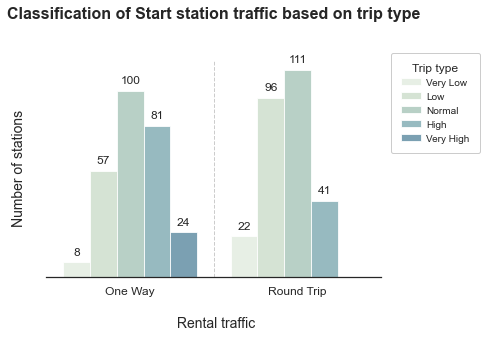

In [152]:
# Assign palette as per requirement
sb.set_style('white')
flatui = ['darkturquoise', 'paleturquoise']
sb.set_palette('GnBu', desat = 0.6)
plt.figure(figsize = [6, 4])

# plot clustered bar chart
g = sb.countplot(data = category, x = 'trip_type', hue = 'traffic', alpha = 0.8, saturation = 0.8)

# improve plot aesthetics
plt.title('Classification of Start station traffic based on trip type\n\n', fontsize = 16, weight = 'bold')
plt.xlabel('\n Rental traffic', fontsize = 14)
plt.ylabel('Number of stations\n', fontsize = 14)
plt.yticks([], fontsize = 12)
plt.xticks(fontsize = 12)
sb.despine(left=True)

# plot legend
plt.legend(scatterpoints=1, frameon=True, fancybox=True, shadow=False, ncol = 1, framealpha = 1, 
           borderpad=1, borderaxespad=1, bbox_to_anchor = (1, 0.8), loc = 6, labelspacing=0.5,  
           title='Trip type', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5)

# add annotations
# -------------------------------------------------------
for p in g.patches:
    g.annotate(format(p.get_height(), '.0f'), (p.get_x() + p.get_width() / 2., p.get_height()), 
               ha = 'center', va = 'center', xytext = (0, 10), textcoords = 'offset points')
# -------------------------------------------------------

separators = [0.5]
for loc in separators:
    plt.axvline(loc, ls='--', color='grey', linewidth=1, alpha=0.4);
    
# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.4.g Classification of Start stations Rental traffic based on trip type.png', dpi=300, bbox_inches='tight')

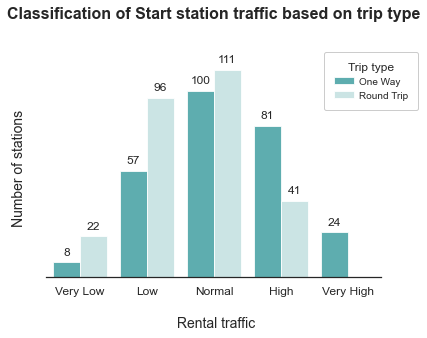

In [153]:
# Assign palette as per requirement
sb.set_style('white')
flatui = ['darkturquoise', 'paleturquoise']
sb.set_palette(flatui, desat = 0.6)
plt.figure(figsize = [6, 4])

# plot clustered bar chart
g = sb.countplot(data = category, x = 'traffic', hue = 'trip_type', alpha = 0.8, saturation = 0.8)

# improve plot aesthetics
plt.title('Classification of Start station traffic based on trip type\n\n', fontsize = 16, weight = 'bold')
plt.xlabel('\n Rental traffic', fontsize = 14)
plt.ylabel('Number of stations\n', fontsize = 14)
plt.yticks([], fontsize = 12)
plt.xticks(fontsize = 12)
sb.despine(left=True)

# plot legend
plt.legend(scatterpoints=1, frameon=True, fancybox=True, shadow=False, ncol = 1, framealpha = 1, 
           borderpad=1, borderaxespad=1, bbox_to_anchor = (0.8, 0.9), loc = 6, labelspacing=0.5,  
           title='Trip type', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5)

# add annotations
# -------------------------------------------------------
for p in g.patches:
    g.annotate(format(p.get_height(), '.0f'), (p.get_x() + p.get_width() / 2., p.get_height()), 
               ha = 'center', va = 'center', xytext = (0, 10), textcoords = 'offset points')
# -------------------------------------------------------

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.4.h Classification of Start stations Rental traffic based on trip type.png', dpi=300, bbox_inches='tight')

-----

#### 3.2.5 Bivariate analysis of `start_station_id` and `bike_type` columns:

+ `Column`: start_station_id, start_station_id
+ `Data type`: numerical data, continuous
+ `Plot` : Scatter plot

**Distribution of `start_stations` rental traffic based on `bike_type`.**

In [154]:
start_stations = bikeshare.groupby([bikeshare['start_station_id'], 
                                    bikeshare['bike_type']]).size().reset_index(name='rentals')
start_stations.head(10)

,start_station_id,bike_type,rentals
0,3005,unknown,17536
1,3005,Standard,11158
2,3005,Electric,6315
3,3006,unknown,7734
4,3006,Standard,4645
5,3006,Electric,3484
6,3007,unknown,8392
7,3007,Standard,4422
8,3007,Electric,2171
9,3008,unknown,6584


> calculate max value of the count to estimate bin size of the preceeding plot

In [155]:
start_stations['rentals'].max()

17536

> As the max value is around `18000`, let the bin size be `500`.

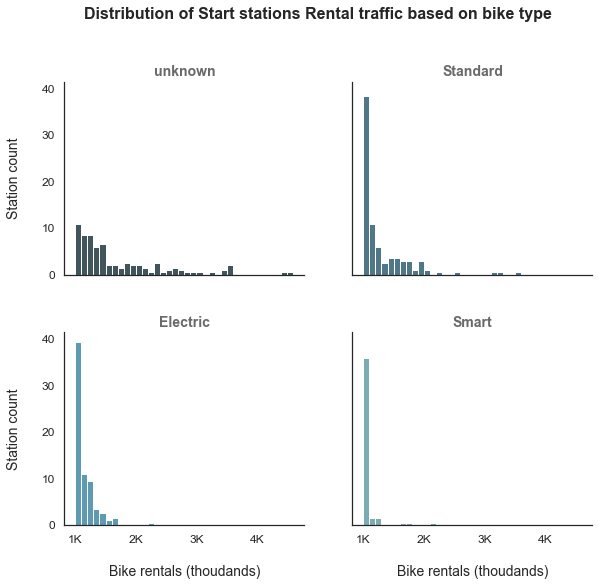

In [156]:
# Assign palette as per requirement
sb.set_style('white')
sb.set_palette('GnBu_d', n_colors=5, desat=0.6)

# prepare data for plotting
max_value = start_stations['rentals'].max()
bin_edges = np.arange(0, max_value+500, 500)
tick_locs = np.arange(0, max_value+1, 1)

# plot facet grid
g = sb.FacetGrid(data = start_stations, col = 'bike_type', col_wrap = 2, height = 4, aspect = 1, hue = 'bike_type')
g.map(plt.hist, "rentals", bins = bin_edges)

g.fig.subplots_adjust(top=0.85)
g.fig.suptitle('Distribution of Start stations Rental traffic based on bike type\n', fontsize = 16, weight = 'bold')
g.set_titles('{col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# improve plot aesthetics
x_tick_max = (max_value/1000)
x_tick_locs = np.arange(0, x_tick_max+1, 1)
x_tick_names = ['{:0.0f}K'.format(loc) for loc in x_tick_locs]
g.set_xticklabels(x_tick_names, size=12)
g.set_yticklabels(size = 12)
g.set_xlabels('\nBike rentals (thoudands)', size = 14)
g.set_ylabels('Station count\n', size = 14)
plt.subplots_adjust(wspace=0.2, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.5.a Distribution of Start stations Rental traffic based on bike type.png', dpi=300, bbox_inches='tight')

> This data in their natural units, looks `highly right skewed`: lots of points with low values, with a very long tail of data points with large values (also all values are `positive`). The most common example of this is, the data that follows an approximately `log-normal distribution`. This is data that, in their natural units, can look highly skewed. However, after applying a logarithmic transform to the data, the data will follow a `normal distribution`. Hence let us apply `logarithmic transformation` to the start station's bike rental data.

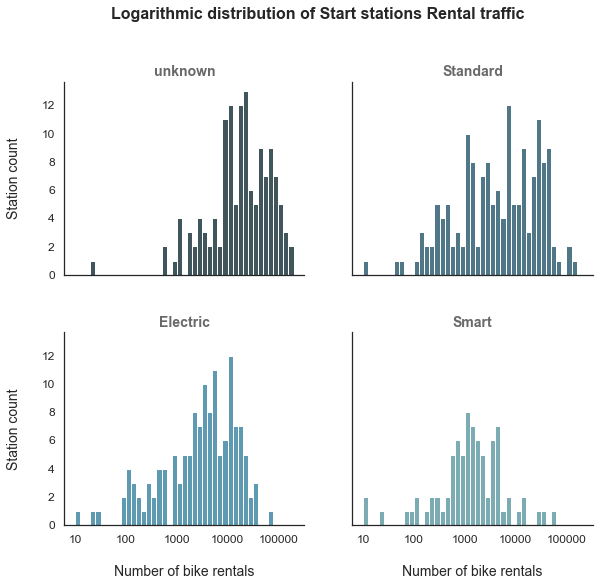

In [157]:
def log_trans(x, inverse = False):
    if not inverse:
        return np.log10(x)
    else:
        return 10 ** x

    
# Assign palette as per requirement
sb.set_style('white')
sb.set_palette('GnBu_d', n_colors=5, desat=0.6)

# prepare data for plotting
start_stations['log_count'] = start_stations['rentals'].apply(log_trans)
min_value = log_trans(start_stations['rentals'].min())
max_value = log_trans(start_stations['rentals'].max())
bin_edges = np.arange(0, max_value+0.1, 0.1)
tick_locs = np.arange(0, max_value+1, 1)

# plot facet grid
g = sb.FacetGrid(data = start_stations, col = 'bike_type', col_wrap = 2, height = 4, aspect = 1, hue = 'bike_type')
g.map(plt.hist, "log_count", bins = bin_edges)

g.fig.subplots_adjust(top=0.85)
g.fig.suptitle('Logarithmic distribution of Start stations Rental traffic', fontsize = 16, weight = 'bold')
g.set_titles('{col_name}', weight = 'bold', size = 14, color = 'dimgrey')


# improve plot aesthetics
x_tick_names = log_trans(tick_locs, inverse = True).astype(int)
g.set_xticklabels(x_tick_names, size = 12)
g.set_yticklabels(size = 12)
g.set_xlabels('\nNumber of bike rentals', size = 14)
g.set_ylabels('Station count\n', size = 14)
plt.subplots_adjust(wspace=0.2, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.5.b Logarithmic distribution of Start stations Rental traffic based on bike type.png', dpi=300, bbox_inches='tight')

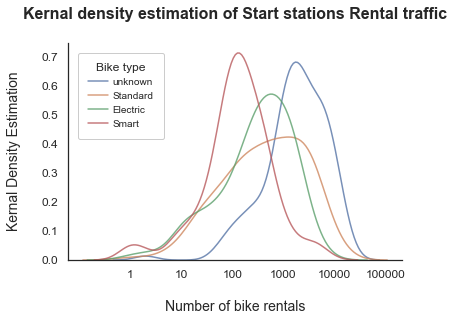

In [158]:
def log_trans(x, inverse = False):
    if not inverse:
        return np.log10(x)
    else:
        return 10 ** x

    
# Assign palette as per requirement
sb.set_style('white')
sb.set_palette('deep', n_colors = 4, desat = 0.8)

max_value = log_trans(start_stations['rentals'].max())
bin_edges = np.arange(0, max_value+0.1, 0.1)

sb.distplot(start_stations[start_stations['bike_type'] == "unknown"]['rentals'].apply(log_trans), 
            bins = bin_edges, kde = True, kde_kws = {'alpha' :0.8}, 
            color = sb.color_palette()[0], label = 'unknown', hist=False)
sb.distplot(start_stations[start_stations['bike_type'] == "Standard"]['rentals'].apply(log_trans), 
            bins = bin_edges, kde = True, kde_kws = {'alpha' :0.8}, 
            color = sb.color_palette()[1], label = 'Standard', hist=False)
sb.distplot(start_stations[start_stations['bike_type'] == "Electric"]['rentals'].apply(log_trans), 
            bins = bin_edges, kde = True, kde_kws = {'alpha' :0.8}, 
            color = sb.color_palette()[2], label = 'Electric', hist=False)
sb.distplot(start_stations[start_stations['bike_type'] == "Smart"]['rentals'].apply(log_trans), 
            bins = bin_edges, kde = True, kde_kws = {'alpha' :0.8}, 
            color = sb.color_palette()[3], label = 'Smart', hist=False)
tick_locs = np.arange(0, max_value+1, 1)
plt.xticks(tick_locs, log_trans(tick_locs, inverse = True).astype(int), fontsize = 12)
plt.yticks(fontsize = 12)
plt.xlabel('\nNumber of bike rentals', fontsize = 14)
plt.ylabel('Kernal Density Estimation\n', fontsize = 14)
plt.title('Kernal density estimation of Start stations Rental traffic\n', fontsize = 16, weight = 'bold')

plt.legend(scatterpoints=1,frameon=True, fancybox=True, loc = 'upper left', 
           shadow=False, framealpha = 1, borderpad=1, borderaxespad=1, labelspacing=0.5, 
           ncol = 1, title='Bike type', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5);
sb.despine();

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.5.c Kernal density estimation of Start stations Rental traffic based on bike type.png', dpi=300, bbox_inches='tight')

In [159]:
bin = [0,10,100,1000,10000,100000]
#use pd.cut function can attribute the values into its specific bins
category = pd.cut(start_stations['rentals'],bin)
category = category.to_frame()
category.columns = ['rental_bins']
category['bike_type'] = start_stations['bike_type']
category['start_station_id'] = start_stations['start_station_id']
category = category.reindex(columns=['start_station_id', 'bike_type', 'rental_bins'])
category.head()

,start_station_id,bike_type,rental_bins
0,3005,unknown,"(10000, 100000]"
1,3005,Standard,"(10000, 100000]"
2,3005,Electric,"(1000, 10000]"
3,3006,unknown,"(1000, 10000]"
4,3006,Standard,"(1000, 10000]"


In [160]:
category.rental_bins.sort_values(ascending=True).unique()

[(0, 10], (10, 100], (100, 1000], (1000, 10000], (10000, 100000]]
Categories (5, interval[int64]): [(0, 10] < (10, 100] < (100, 1000] < (1000, 10000] < (10000, 100000]]

In [161]:
%%time

def label_race(df):
    df.loc[df['rental_bins'] == df.rental_bins.sort_values(ascending=True).unique()[0],'traffic'] = 'Very Low'
    df.loc[df['rental_bins'] == df.rental_bins.sort_values(ascending=True).unique()[1],'traffic'] = 'Low'
    df.loc[df['rental_bins'] == df.rental_bins.sort_values(ascending=True).unique()[2],'traffic'] = 'Normal'
    df.loc[df['rental_bins'] == df.rental_bins.sort_values(ascending=True).unique()[3],'traffic'] = 'High'
    df.loc[df['rental_bins'] == df.rental_bins.sort_values(ascending=True).unique()[4],'traffic'] = 'Very High'
    
df = category
label_race(df)

level_order = ['Very Low', 'Low', 'Normal', 'High', 'Very High']
ordered_cat = pd.api.types.CategoricalDtype(ordered = True, categories = level_order)
df['traffic'] = df['traffic'].astype(ordered_cat)

category.traffic.value_counts()

Wall time: 40 ms


Normal       213
High         183
Low           85
Very Low      16
Very High     13
Name: traffic, dtype: int64

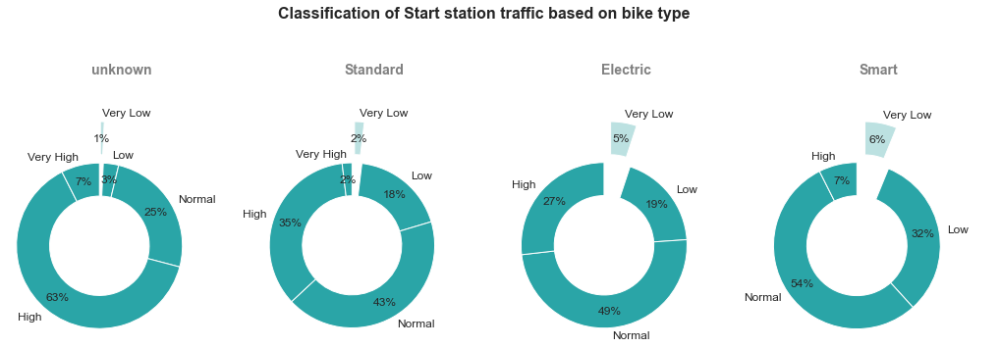

In [162]:
def plot_pie(cat_type):
    df = category[category['bike_type'] == cat_type]
    subdf = df.groupby([df['traffic']]).size().reset_index(name='stations')
    df_to_plot = subdf.loc[lambda df_to_plot: subdf['stations'] != 0]
    type_level_counts = df_to_plot.stations
    type_level_index = df_to_plot.traffic.sort_values(ascending=True).unique()
    clrs = [ sb.color_palette()[3], 
            sb.color_palette()[0], 
            sb.color_palette()[0], 
            sb.color_palette()[0], 
            sb.color_palette()[0] ]
    explode = [ 0.5, 0, 0, 0, 0 ]
    plt.pie(type_level_counts, labels = type_level_index, startangle = 90,
            counterclock = False, wedgeprops = {'width' : 0.4}, shadow=False, 
            explode=explode[0:len(type_level_index)], colors=clrs[0:len(type_level_index)], 
            textprops={'fontsize': 12}, autopct='%1.0f%%', labeldistance=1.1, pctdistance=0.8)
    plt.title(cat_type+ '\n\n', weight='bold', color='grey', fontsize=14)
    plt.axis('square');

    
# Assign palette as per requirement
sb.set_style('white')
flatui = ['darkturquoise', 'mediumturquoise', 'turquoise', 'paleturquoise']
sb.set_palette(flatui, n_colors=4, desat=0.6)

Ncount = len(category.bike_type.unique())
types = category.bike_type.unique()
plt.figure(figsize = [18, 6])

# subplot 
plt.subplot(1, 4, 1)
plot_pie('unknown')
# subplot 
plt.subplot(1, 4, 2)
plot_pie('Standard')
# subplot 
plt.subplot(1, 4, 3)
plot_pie('Electric')
# subplot 
plt.subplot(1, 4, 4)
plot_pie('Smart')

plt.suptitle('Classification of Start station traffic based on bike type', fontsize = 16, weight = 'bold')
plt.subplots_adjust(top=0.8)
plt.subplots_adjust(wspace=0.1, hspace=0.2);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.5.d Pie chart classification of Start stations Rental traffic based on bike type.png', dpi=300, bbox_inches='tight')

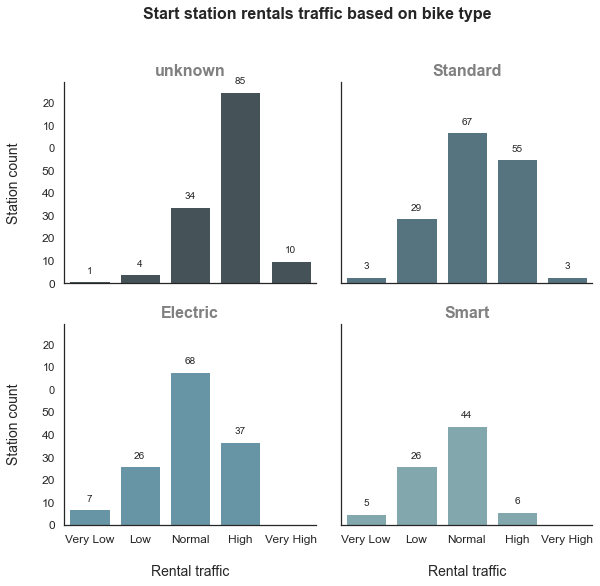

In [163]:
# Assign palette as per requirement
sb.set_style('white')
sb.set_palette('GnBu_d', n_colors=5, desat=0.6)

# plot Facet Grid
g = sb.FacetGrid(data = category, col = 'bike_type', col_wrap = 2, height = 4, aspect = 1, hue = 'bike_type')
g.map(sb.countplot, 'traffic', order = category.traffic.sort_values(ascending=True).unique())
g.fig.subplots_adjust(top=0.8)
g.fig.suptitle('Start station rentals traffic based on bike type\n', fontsize = 16, weight = 'bold')
g.set_titles('{col_name}', weight = 'bold', size = 16, color = 'grey')

# obtain the ticks and store them as a list
y_tick_names = []
x_tick_names = []
for ax in g.axes.flat:
    for y_label in ax.get_yticklabels():
        y_label_value = int(y_label.get_text())
        y_label_new_value = '{:0.0f}'.format(y_label_value)
        y_tick_names.append(y_label_new_value)
        
    for x_label in ax.get_xticklabels():
        x_label_value = x_label.get_text()
        x_tick_names.append(x_label_value)

# improve plot aesthetics
g.set_yticklabels(y_tick_names, size = 12)
g.set_xticklabels(x_tick_names, size = 12)
g.set_xlabels('\nRental traffic', size = 14)
g.set_ylabels('Station count\n', size = 14)

# add annotations
for ax in g.axes.ravel(): # this will loop over the different figures in the grid 
    for p in ax.patches: # this will loop over the different bars in each figure 
        ax.annotate(format(p.get_height(), '.0f'), (p.get_x() + p.get_width() / 2., p.get_height()), 
                    ha = 'center', va = 'center', xytext = (0, 10), textcoords = 'offset points', fontsize=10)

plt.subplots_adjust(top=0.85)
plt.subplots_adjust(wspace=0.1, hspace=0.2);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.5.e Facet grid classification of Start stations Rental traffic based on bike type.png', dpi=300, bbox_inches='tight')

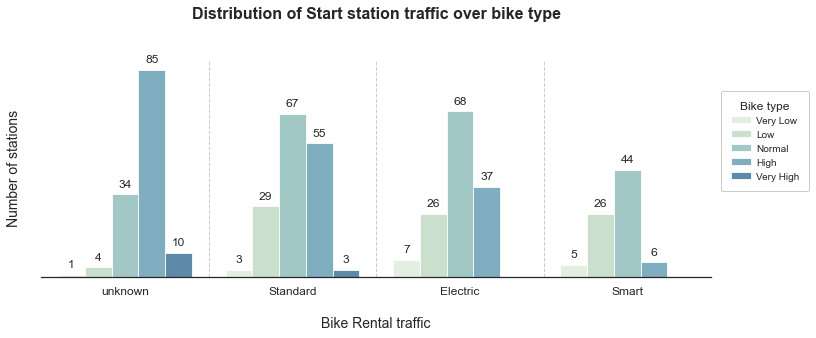

In [164]:
# Assign palette as per requirement
sb.set_style('white')
sb.set_palette('GnBu', n_colors=5, desat=0.6)
plt.figure(figsize = [12, 4])

# plot clustered bar chart
g = sb.countplot(data = df, x = 'bike_type', hue = 'traffic', alpha = 0.8, saturation = 1)

# improve plot aesthetics
plt.title('Distribution of Start station traffic over bike type\n\n', fontsize = 16, weight = 'bold')
plt.xlabel('\nBike Rental traffic', fontsize = 14)
plt.ylabel('Number of stations\n', fontsize = 14)
plt.yticks([], fontsize = 12)
plt.xticks(fontsize = 12)
sb.despine(top=True, left=True, right=True, bottom=False)

# plot legend
plt.legend(scatterpoints=1, frameon=True, fancybox=True, shadow=False, ncol = 1, framealpha = 1, 
           borderpad=1, borderaxespad=1, bbox_to_anchor = (1, 0.9), loc = 'upper left', labelspacing=0.5,  
           title='Bike type', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5)

# add annotations
for p in g.patches:
    g.annotate(format(p.get_height(), '.0f'), (p.get_x() + p.get_width() / 2., p.get_height()), 
               ha = 'center', va = 'center', xytext = (0, 10), textcoords = 'offset points')

separators = [0.5, 1.5, 2.5, 3.5]
for loc in separators:
    plt.axvline(loc, ls='--', color='grey', linewidth=1, alpha=0.4);
    
# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.5.f Distribution of Start stations Rental traffic over bike type.png', dpi=300, bbox_inches='tight')

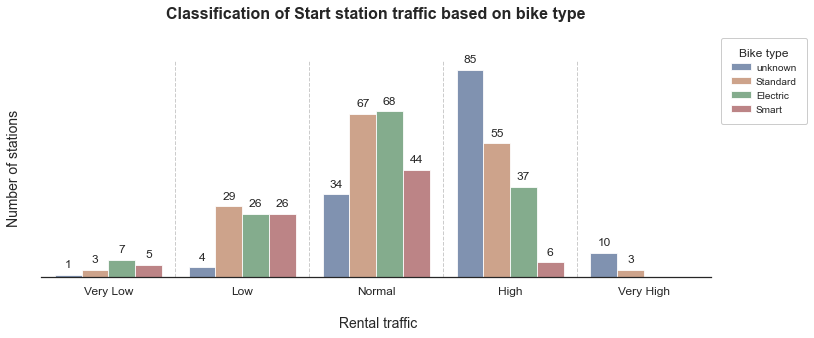

In [165]:
# Assign palette as per requirement
sb.set_style('white')
flatui = ['darkturquoise', 'mediumturquoise', 'turquoise', 'paleturquoise']
# sb.set_palette(flatui, n_colors=4, desat=0.6)
sb.set_palette('deep', n_colors=4, desat=0.6)
plt.figure(figsize = [12, 4])

# plot clustered bar chart
g = sb.countplot(data = category, x = 'traffic', hue = 'bike_type', alpha = 0.8, saturation = 1)

# improve plot aesthetics
plt.title('Classification of Start station traffic based on bike type\n\n', fontsize = 16, weight = 'bold')
plt.xlabel('\n Rental traffic', fontsize = 14)
plt.ylabel('Number of stations\n', fontsize = 14)
plt.yticks([], fontsize = 12)
plt.xticks(fontsize = 12)
sb.despine(left=True)

# plot legend
plt.legend(scatterpoints=1, frameon=True, fancybox=True, shadow=False, ncol = 1, framealpha = 1, 
           borderpad=1, borderaxespad=1, bbox_to_anchor = (1, 0.9), loc = 6, labelspacing=0.5,  
           title='Bike type', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5)

# add annotations
for p in g.patches:
    g.annotate(format(p.get_height(), '.0f'), (p.get_x() + p.get_width() / 2., p.get_height()), 
               ha = 'center', va = 'center', xytext = (0, 10), textcoords = 'offset points')

separators = [0.5, 1.5, 2.5, 3.5]
for loc in separators:
    plt.axvline(loc, ls='--', color='grey', linewidth=1, alpha=0.4);
    
# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.5.g Classification of Start stations Rental traffic over bike type.png', dpi=300, bbox_inches='tight')

------

#### 3.2.6 Bivariate analysis of `start_station_id` and `pass_type` columns:

+ `Column`: start_station_id, start_station_id
+ `Data type`: numerical data, continuous
+ `Plot` : Scatter plot

**Distribution of `start_stations` rental traffic based on `pass_type`.**

In [166]:
start_stations = bikeshare.groupby([bikeshare['start_station_id'], 
                                    bikeshare['pass_type']]).size().reset_index(name='rentals')
start_stations.head()

,start_station_id,pass_type,rentals
0,3005,Walk-up,2303
1,3005,One Day,4845
2,3005,Monthly,25338
3,3005,Flex,14
4,3005,Annual,2509


> calculate max value of the count to estimate bin size of the preceeding plot

In [167]:
start_stations['rentals'].max()

25338

> As the max value is around `25000`, let the bin size be `500`.

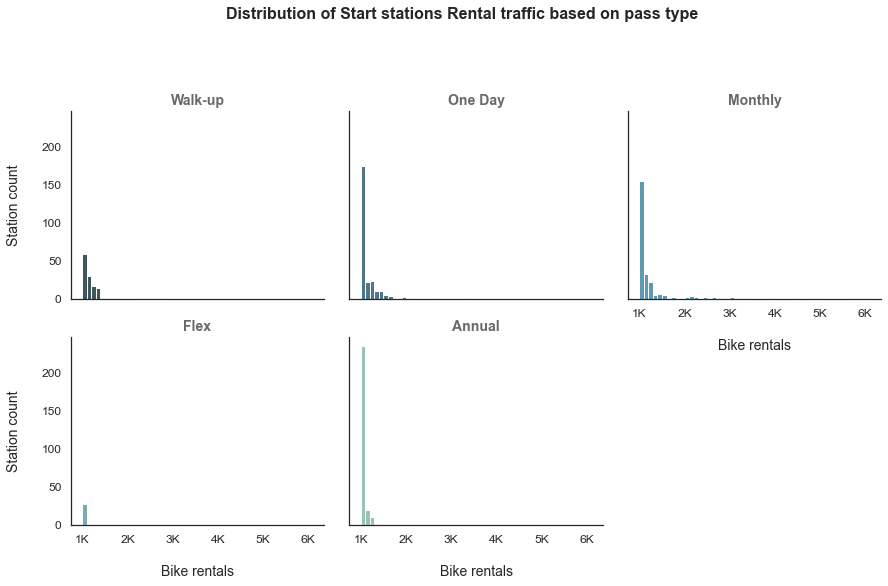

In [168]:
# Assign palette as per requirement
sb.set_style('white')
sb.set_palette('GnBu_d', n_colors=5, desat=0.6)

# prepare data for plotting
max_value = start_stations['rentals'].max()
bin_edges = np.arange(0, max_value+500, 500)
tick_locs = np.arange(0, max_value+1, 1)

# plot facet grid
g = sb.FacetGrid(data = start_stations, col = 'pass_type', col_wrap = 3, height = 4, aspect = 1, hue = 'pass_type')
g.map(plt.hist, "rentals", bins = bin_edges)

g.fig.subplots_adjust(top=0.8)
g.fig.suptitle('Distribution of Start stations Rental traffic based on pass type\n', fontsize = 16, weight = 'bold')
g.set_titles('{col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# improve plot aesthetics
x_tick_max = (max_value/1000)
x_tick_locs = np.arange(0, x_tick_max+1, 1)
x_tick_names = ['{:0.0f}K'.format(loc) for loc in x_tick_locs]
g.set_xticklabels(x_tick_names, size=12)
g.set_yticklabels(size = 12)
g.set_xlabels('\nBike rentals', size = 14)
g.set_ylabels('Station count\n', size = 14)
plt.subplots_adjust(wspace=0.1, hspace=0.2);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.6.a Distribution of Start stations Rental traffic based on pass type.png', dpi=300, bbox_inches='tight')

> This data in their natural units, looks `highly right skewed`: lots of points with low values, with a very long tail of data points with large values (also all values are `positive`). The most common example of this is, the data that follows an approximately `log-normal distribution`. This is data that, in their natural units, can look highly skewed. However, after applying a logarithmic transform to the data, the data will follow a `normal distribution`. Hence let us apply `logarithmic transformation` to the start station's bike rental data.

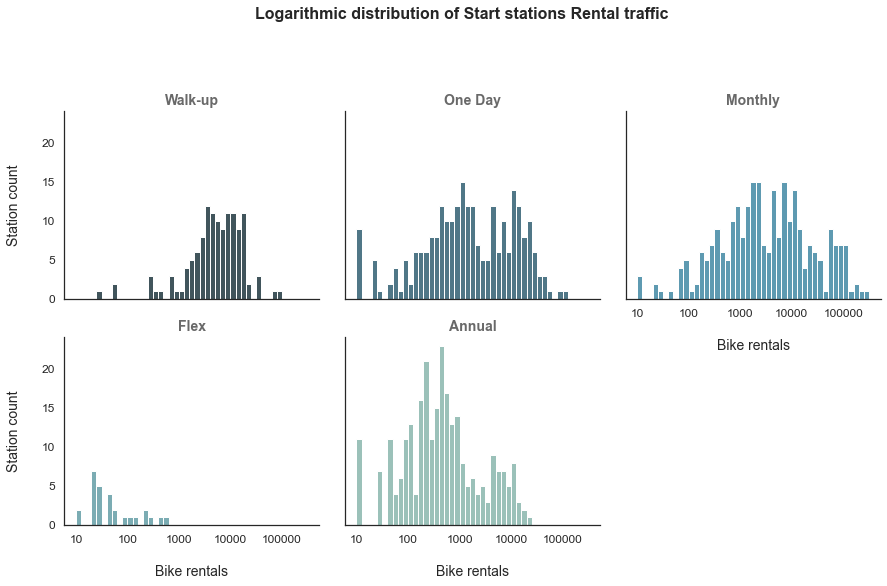

In [169]:
def log_trans(x, inverse = False):
    if not inverse:
        return np.log10(x)
    else:
        return 10 ** x

    
# Assign palette as per requirement
sb.set_style('white')
sb.set_palette('GnBu_d', n_colors=5, desat=0.6)

# prepare data for plotting
start_stations['log_count'] = start_stations['rentals'].apply(log_trans)
min_value = log_trans(start_stations['rentals'].min())
max_value = log_trans(start_stations['rentals'].max())
bin_edges = np.arange(0, max_value+0.1, 0.1)
tick_locs = np.arange(0, max_value+1, 1)

# plot facet grid
g = sb.FacetGrid(data = start_stations, col = 'pass_type', col_wrap = 3, height = 4, aspect = 1, hue = 'pass_type')
g.map(plt.hist, "log_count", bins = bin_edges)

g.fig.subplots_adjust(top=0.8)
g.fig.suptitle('Logarithmic distribution of Start stations Rental traffic', fontsize = 16, weight = 'bold')
g.set_titles('{col_name}', weight = 'bold', size = 14, color = 'dimgrey')


# improve plot aesthetics
x_tick_names = log_trans(tick_locs, inverse = True).astype(int)
g.set_xticklabels(x_tick_names, size = 12)
g.set_yticklabels(size = 12)
g.set_xlabels('\nBike rentals', size = 14)
g.set_ylabels('Station count\n', size = 14)
plt.subplots_adjust(wspace=0.1, hspace=0.2);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.6.b Logarithmic distribution of Start stations Rental traffic based on pass type.png', dpi=300, bbox_inches='tight')

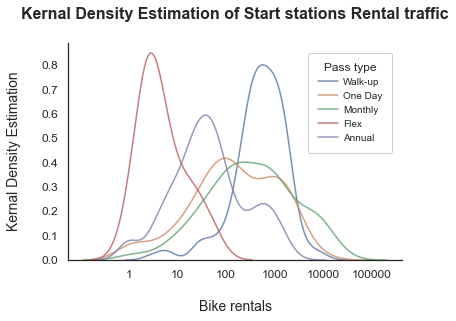

In [170]:
def log_trans(x, inverse = False):
    if not inverse:
        return np.log10(x)
    else:
        return 10 ** x

    
# Assign palette as per requirement
sb.set_style('white')
sb.set_palette('deep', n_colors = 5, desat = 0.8)

max_value = log_trans(start_stations['rentals'].max())
bin_edges = np.arange(0, max_value+0.1, 0.1)

sb.distplot(start_stations[start_stations['pass_type'] == "Walk-up"]['rentals'].apply(log_trans), 
            bins = bin_edges, kde = True, kde_kws = {'alpha' :0.8}, 
            color = sb.color_palette()[0], label = 'Walk-up', hist=False)
sb.distplot(start_stations[start_stations['pass_type'] == "One Day"]['rentals'].apply(log_trans), 
            bins = bin_edges, kde = True, kde_kws = {'alpha' :0.8}, 
            color = sb.color_palette()[1], label = 'One Day', hist=False)
sb.distplot(start_stations[start_stations['pass_type'] == "Monthly"]['rentals'].apply(log_trans), 
            bins = bin_edges, kde = True, kde_kws = {'alpha' :0.8}, 
            color = sb.color_palette()[2], label = 'Monthly', hist=False)
sb.distplot(start_stations[start_stations['pass_type'] == "Flex"]['rentals'].apply(log_trans), 
            bins = bin_edges, kde = True, kde_kws = {'alpha' :0.8}, 
            color = sb.color_palette()[3], label = 'Flex', hist=False)
sb.distplot(start_stations[start_stations['pass_type'] == "Annual"]['rentals'].apply(log_trans), 
            bins = bin_edges, kde = True, kde_kws = {'alpha' :0.8}, 
            color = sb.color_palette()[4], label = 'Annual', hist=False)
tick_locs = np.arange(0, max_value+1, 1)
plt.xticks(tick_locs, log_trans(tick_locs, inverse = True).astype(int), fontsize = 12)
plt.yticks(fontsize = 12)
plt.xlabel('\nBike rentals', fontsize = 14)
plt.ylabel('Kernal Density Estimation\n', fontsize = 14)
plt.title('Kernal Density Estimation of Start stations Rental traffic\n', fontsize = 16, weight = 'bold')

plt.legend(scatterpoints=1,frameon=True, fancybox=True, loc = 'upper right', 
           shadow=False, framealpha = 1, borderpad=1, borderaxespad=1, labelspacing=0.5, 
           ncol = 1, title='Pass type', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5);
sb.despine();

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.6.c Kernal Density Estimation of Start stations Rental traffic based on pass type.png', dpi=300, bbox_inches='tight')

In [171]:
bin = [0,10,100,1000,10000,100000]
#use pd.cut function can attribute the values into its specific bins
category = pd.cut(start_stations['rentals'],bin)
category = category.to_frame()
category.columns = ['rental_bins']
category['pass_type'] = start_stations['pass_type']
category['start_station_id'] = start_stations['start_station_id']
category = category.reindex(columns=['start_station_id', 'pass_type', 'rental_bins'])
category.head(10)

,start_station_id,pass_type,rental_bins
0,3005,Walk-up,"(1000, 10000]"
1,3005,One Day,"(1000, 10000]"
2,3005,Monthly,"(10000, 100000]"
3,3005,Flex,"(10, 100]"
4,3005,Annual,"(1000, 10000]"
5,3006,Walk-up,"(1000, 10000]"
6,3006,One Day,"(1000, 10000]"
7,3006,Monthly,"(10000, 100000]"
8,3006,Flex,"(0, 10]"
9,3006,Annual,"(100, 1000]"


In [172]:
category.rental_bins.sort_values(ascending=True).unique()

[(0, 10], (10, 100], (100, 1000], (1000, 10000], (10000, 100000]]
Categories (5, interval[int64]): [(0, 10] < (10, 100] < (100, 1000] < (1000, 10000] < (10000, 100000]]

In [173]:
%%time

def label_race(df):
    df.loc[df['rental_bins'] == df.rental_bins.sort_values(ascending=True).unique()[0],'traffic'] = 'Very Low'
    df.loc[df['rental_bins'] == df.rental_bins.sort_values(ascending=True).unique()[1],'traffic'] = 'Low'
    df.loc[df['rental_bins'] == df.rental_bins.sort_values(ascending=True).unique()[2],'traffic'] = 'Normal'
    df.loc[df['rental_bins'] == df.rental_bins.sort_values(ascending=True).unique()[3],'traffic'] = 'High'
    df.loc[df['rental_bins'] == df.rental_bins.sort_values(ascending=True).unique()[4],'traffic'] = 'Very High'
    
df = category
label_race(df)

level_order = ['Very Low', 'Low', 'Normal', 'High', 'Very High']
ordered_cat = pd.api.types.CategoricalDtype(ordered = True, categories = level_order)
df['traffic'] = df['traffic'].astype(ordered_cat)

category.traffic.value_counts()

Wall time: 125 ms


Normal       335
Low          304
High         179
Very Low     120
Very High     13
Name: traffic, dtype: int64

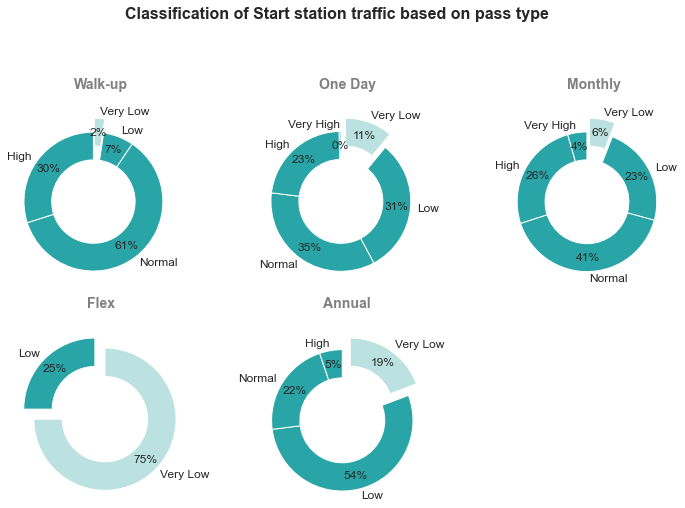

In [174]:
def plot_pie(cat_type):
    df = category[category['pass_type'] == cat_type]
    subdf = df.groupby([df['traffic']]).size().reset_index(name='stations')
    df_to_plot = subdf.loc[lambda df_to_plot: subdf['stations'] != 0]
    type_level_counts = df_to_plot.stations
    type_level_index = df_to_plot.traffic.sort_values(ascending=True).unique()
    clrs = [sb.color_palette()[3], 
            sb.color_palette()[0], 
            sb.color_palette()[0], 
            sb.color_palette()[0], 
            sb.color_palette()[0]]
    explode = [0.2, 0, 0, 0, 0]
    plt.pie(type_level_counts, labels = type_level_index, startangle = 90,
            counterclock = False, wedgeprops = {'width' : 0.4}, shadow=False, 
            explode=explode[0:len(type_level_index)], colors=clrs[0:len(type_level_index)], 
            textprops={'fontsize': 12}, autopct='%1.0f%%', labeldistance=1.1, pctdistance=0.8)
    plt.title(cat_type+ '\n', weight='bold', color='grey', fontsize=14)
    plt.axis('square');

    
# Assign palette as per requirement
sb.set_style('white')
flatui = ['darkturquoise', 'mediumturquoise', 'turquoise', 'paleturquoise']
sb.set_palette(flatui, n_colors=4, desat=0.6)

Ncount = len(category.pass_type.unique())
types = category.pass_type.unique()
plt.figure(figsize = [12, 8])

# subplot 
plt.subplot(2, 3, 1)
plot_pie('Walk-up')
# subplot 
plt.subplot(2, 3, 2)
plot_pie('One Day')
# subplot 
plt.subplot(2, 3, 3)
plot_pie('Monthly')
# subplot 
plt.subplot(2, 3, 4)
plot_pie('Flex')
# subplot 
plt.subplot(2, 3, 5)
plot_pie('Annual')

plt.suptitle('Classification of Start station traffic based on pass type', fontsize = 16, weight = 'bold')
plt.subplots_adjust(top=0.8)
plt.subplots_adjust(wspace=0.4, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.6.d Pie chart classification of Start stations Rental traffic based on pass type.png', dpi=300, bbox_inches='tight')

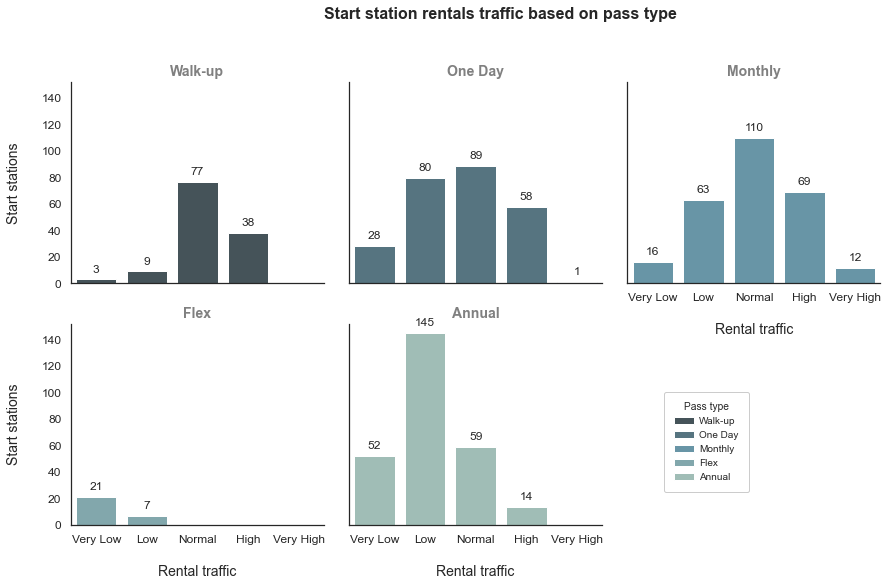

In [175]:
# Assign palette as per requirement
sb.set_style('white')
sb.set_palette('GnBu_d', n_colors=5, desat=0.6)

# plot Facet Grid
g = sb.FacetGrid(data = category, col = 'pass_type', col_wrap = 3, height = 4, aspect = 1, hue = 'pass_type')
g.map(sb.countplot, 'traffic', order = category.traffic.sort_values(ascending=True).unique())
g.fig.subplots_adjust(top=0.8)
g.fig.suptitle('Start station rentals traffic based on pass type\n', fontsize = 16, weight = 'bold')
g.set_titles('{col_name}', weight = 'bold', size = 14, color = 'grey')

# obtain the ticks and store them as a list
y_tick_names = []
x_tick_names = []
for ax in g.axes.flat:
    for y_label in ax.get_yticklabels():
        y_label_value = int(y_label.get_text())
        y_label_new_value = '{:0.0f}'.format(y_label_value)
        y_tick_names.append(y_label_new_value)
        
    for x_label in ax.get_xticklabels():
        x_label_value = x_label.get_text()
        x_tick_names.append(x_label_value)

# improve plot aesthetics
g.set_yticklabels(y_tick_names, size = 12)
g.set_xticklabels(x_tick_names, size = 12)
g.set_xlabels('\nRental traffic', size = 14)
g.set_ylabels('Start stations\n', size = 14)
g.add_legend(bbox_to_anchor=(0.8, 0.25), scatterpoints=1,frameon=True, fancybox=True, 
             shadow=False, framealpha = 1, borderpad=1, borderaxespad=1, labelspacing=0.5, 
             ncol = 1, title='Pass type', title_fontsize=14, fontsize=10, facecolor='white', 
             markerfirst=True, handlelength=2, handletextpad=0.5);

# add annotations
for ax in g.axes.ravel(): #this will loop over the different figures in the grid 
    for p in ax.patches: #this will loop over the different bars in each figure 
        ax.annotate(format(p.get_height(), '.0f'), (p.get_x() + p.get_width() / 2., p.get_height()), 
                    ha = 'center', va = 'center', xytext = (0, 10), textcoords = 'offset points')

plt.subplots_adjust(top=0.85)
plt.subplots_adjust(wspace=0.1, hspace=0.2);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.6.e Facet grid classification of Start stations Rental traffic based on pass type.png', dpi=300, bbox_inches='tight')

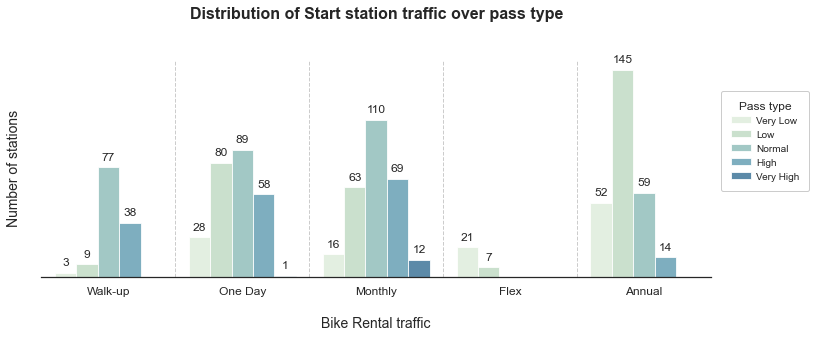

In [176]:
# Assign palette as per requirement
sb.set_style('white')
sb.set_palette('GnBu', n_colors=5, desat=0.6)
plt.figure(figsize = [12, 4])

# plot clustered bar chart
g = sb.countplot(data = df, x = 'pass_type', hue = 'traffic', alpha = 0.8, saturation = 1)

# improve plot aesthetics
plt.title('Distribution of Start station traffic over pass type\n\n', fontsize = 16, weight = 'bold')
plt.xlabel('\nBike Rental traffic', fontsize = 14)
plt.ylabel('Number of stations\n', fontsize = 14)
plt.yticks([], fontsize = 12)
plt.xticks(fontsize = 12)
sb.despine(top=True, left=True, right=True, bottom=False)

# plot legend
plt.legend(scatterpoints=1, frameon=True, fancybox=True, shadow=False, ncol = 1, framealpha = 1, 
           borderpad=1, borderaxespad=1, bbox_to_anchor = (1, 0.9), loc = 'upper left', labelspacing=0.5,  
           title='Pass type', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5)

# add annotations
for p in g.patches:
    g.annotate(format(p.get_height(), '.0f'), (p.get_x() + p.get_width() / 2., p.get_height()), 
               ha = 'center', va = 'center', xytext = (0, 10), textcoords = 'offset points')

separators = [0.5, 1.5, 2.5, 3.5]
for loc in separators:
    plt.axvline(loc, ls='--', color='grey', linewidth=1, alpha=0.4);
    
# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.6.f Distribution of Start stations Rental traffic based on pass type.png', dpi=300, bbox_inches='tight')

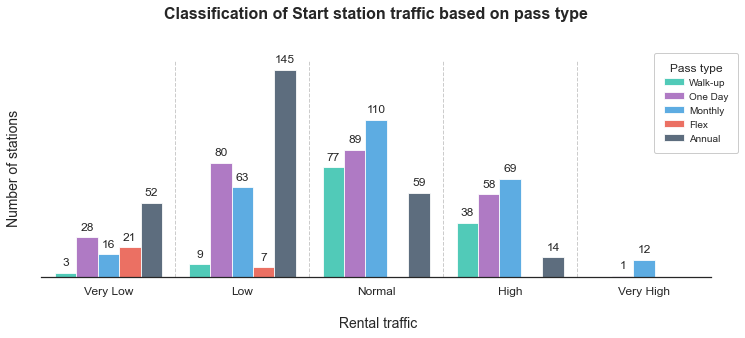

In [177]:
# Assign palette as per requirement
sb.set_style('white')
flatui = ["#26bda7", "#9b59b6", "#3498db", "#e74c3c", "#34495e"]
sb.set_palette(flatui)
plt.figure(figsize = [12, 4])

# plot clustered bar chart
g = sb.countplot(data = category, x = 'traffic', hue = 'pass_type', alpha = 0.8, saturation = 1)

# improve plot aesthetics
plt.title('Classification of Start station traffic based on pass type\n\n', fontsize = 16, weight = 'bold')
plt.xlabel('\n Rental traffic', fontsize = 14)
plt.ylabel('Number of stations\n', fontsize = 14)
plt.yticks([], fontsize = 12)
plt.xticks(fontsize = 12)
sb.despine(top=True, left=True, right=True, bottom=False)

# plot legend
plt.legend(scatterpoints=1, frameon=True, fancybox=True, shadow=False, ncol = 1, framealpha = 1, 
           borderpad=1, borderaxespad=1, bbox_to_anchor = (0.9, 0.8), loc = 6, labelspacing=0.5,  
           title='Pass type', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5)

# add annotations
for p in g.patches:
    g.annotate(format(p.get_height(), '.0f'), (p.get_x() + p.get_width() / 2., p.get_height()), 
               ha = 'center', va = 'center', xytext = (0, 10), textcoords = 'offset points')

separators = [0.5, 1.5, 2.5, 3.5]
for loc in separators:
    plt.axvline(loc, ls='--', color='grey', linewidth=1, alpha=0.4);
    
# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.6.g Classification of Start stations Rental traffic based on pass type.png', dpi=300, bbox_inches='tight')

-----

#### 3.2.7 Bivariate analysis of `start_station_id` and `fare_type` columns:

+ `Column`: start_station_id, start_station_id
+ `Data type`: numerical data, continuous
+ `Plot` : Scatter plot

**Distribution of `start_stations` rental traffic based on `fare_type`.**

In [178]:
start_stations = bikeshare.groupby([bikeshare['start_station_id'], 
                                    bikeshare['fare_type']]).size().reset_index(name='rentals')
start_stations.head()

,start_station_id,fare_type,rentals
0,3005,Base,32141
1,3005,Extended,2868
2,3006,Base,14653
3,3006,Extended,1210
4,3007,Base,13863


> calculate max value of the count to estimate bin size of the preceeding plot

In [179]:
start_stations['rentals'].max()

32141

> As the max value is around `32000`, let the bin size be `1000`.

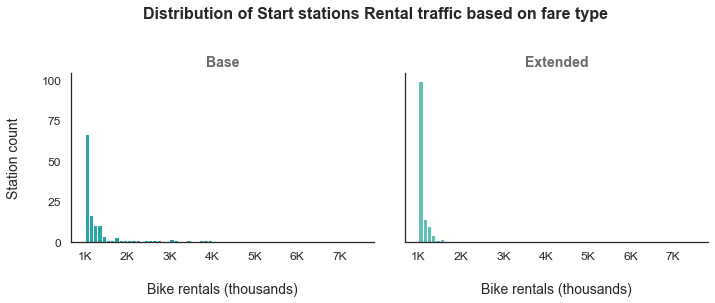

In [180]:
# Assign palette as per requirement
sb.set_style('white')
flatui = ['darkturquoise', 'turquoise']
sb.set_palette(flatui, n_colors=2, desat=0.6)

# prepare data for plotting
max_value = start_stations['rentals'].max()
bin_edges = np.arange(0, max_value+500, 500)
tick_locs = np.arange(0, max_value+1, 1)

# plot facet grid
g = sb.FacetGrid(data = start_stations, col = 'fare_type', col_wrap = 2, height = 4, aspect = 1.2, hue = 'fare_type')
g.map(plt.hist, "rentals", bins = bin_edges)

g.fig.subplots_adjust(top=0.75)
g.fig.suptitle('Distribution of Start stations Rental traffic based on fare type\n', fontsize = 16, weight = 'bold')
g.set_titles('{col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# improve plot aesthetics
x_tick_max = (max_value/1000)
x_tick_locs = np.arange(0, x_tick_max+1, 1)
x_tick_names = ['{:0.0f}K'.format(loc) for loc in x_tick_locs]
g.set_xticklabels(x_tick_names, size=12)
g.set_yticklabels(size = 12)
g.set_xlabels('\nBike rentals (thousands)', size = 14)
g.set_ylabels('Station count\n', size = 14)
plt.subplots_adjust(wspace=0.1, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.7.a Distribution of Start stations Rental traffic based on fare type.png', dpi=300, bbox_inches='tight')

> This data in their natural units, looks `highly right skewed`: lots of points with low values, with a very long tail of data points with large values (also all values are `positive`). The most common example of this is, the data that follows an approximately `log-normal distribution`. This is data that, in their natural units, can look highly skewed. However, after applying a logarithmic transform to the data, the data will follow a `normal distribution`. Hence let us apply `logarithmic transformation` to the start station's bike rental data.

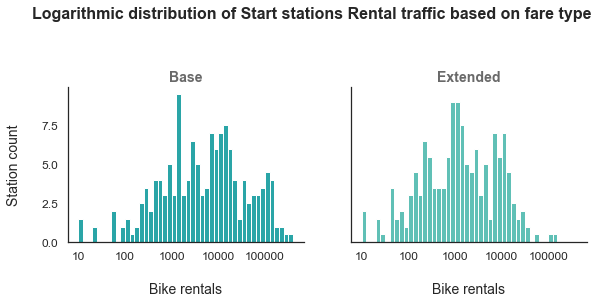

In [181]:
def log_trans(x, inverse = False):
    if not inverse:
        return np.log10(x)
    else:
        return 10 ** x

    
# Assign palette as per requirement
sb.set_style('white')
flatui = ['darkturquoise', 'turquoise']
sb.set_palette(flatui, desat = 0.6)

# prepare data for plotting
start_stations['log_count'] = start_stations['rentals'].apply(log_trans)
min_value = log_trans(start_stations['rentals'].min())
max_value = log_trans(start_stations['rentals'].max())
bin_edges = np.arange(0, max_value+0.1, 0.1)
tick_locs = np.arange(0, max_value+1, 1)

# plot facet grid
g = sb.FacetGrid(data = start_stations, col = 'fare_type', col_wrap = 2, height = 4, aspect = 1, hue = 'fare_type')
g.map(plt.hist, "log_count", bins = bin_edges)

g.fig.subplots_adjust(top=0.7)
g.fig.suptitle('Logarithmic distribution of Start stations Rental traffic based on fare type\n', fontsize = 16, weight = 'bold')
g.set_titles('{col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# improve plot aesthetics
x_tick_names = log_trans(tick_locs, inverse = True).astype(int)
g.set_xticklabels(x_tick_names, size = 12)
g.set_yticklabels(size = 12)
g.set_xlabels('\nBike rentals', size = 14)
g.set_ylabels('Station count\n', size = 14)
plt.subplots_adjust(wspace=0.2, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.7.b Logarithmic distribution of Start stations Rental traffic based on fare type.png', dpi=300, bbox_inches='tight')

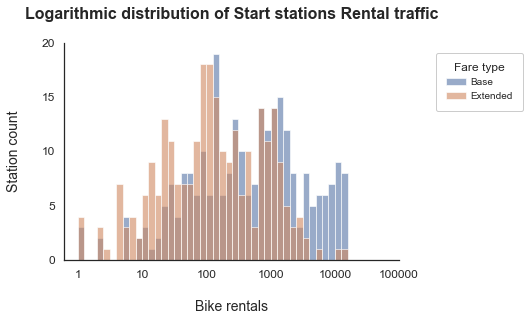

In [182]:
def log_trans(x, inverse = False):
    if not inverse:
        return np.log10(x)
    else:
        return 10 ** x

    
# Assign palette as per requirement
sb.set_style('white')
sb.set_palette('deep', desat = 0.8)

min_value = log_trans(start_stations[start_stations['fare_type'] == "Base"]['rentals'].min())
max_value = log_trans(start_stations[start_stations['fare_type'] == "Extended"]['rentals'].max())
bin_edges = np.arange(0, max_value+0.1, 0.1)
plt.hist(start_stations[start_stations['fare_type'] == "Base"]['rentals'].apply(log_trans), 
         bins = bin_edges, color = sb.color_palette()[0], alpha=0.6, label = 'Base')
plt.hist(start_stations[start_stations['fare_type'] == "Extended"]['rentals'].apply(log_trans), 
         bins = bin_edges, color = sb.color_palette()[1], alpha=0.6, label = 'Extended')

x_tick_locs = np.arange(0, max_value+1, 1)
plt.xticks(x_tick_locs, log_trans(x_tick_locs, inverse = True).astype(int), fontsize = 12)

# get the current tick locations and labels
y_locs, y_labels = plt.yticks()
y_tick_locs = np.arange(0, int(max(y_locs))+5, 5)
y_tick_names = ['{:0.0f}'.format(loc) for loc in y_tick_locs]
plt.yticks(y_tick_locs, y_tick_names, fontsize = 12)

plt.xlabel('\nBike rentals', fontsize = 14)
plt.ylabel('Station count\n', fontsize = 14)
plt.title('Logarithmic distribution of Start stations Rental traffic\n', fontsize = 16, weight = 'bold')

plt.legend(bbox_to_anchor=(1.4, 1), scatterpoints=1,frameon=True, fancybox=True, 
           shadow=False, framealpha = 1, borderpad=1, borderaxespad=1, labelspacing=0.5, 
           ncol = 1, title='Fare type', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5, loc = 'upper right');
sb.despine();

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.7.c Logarithmic distribution of Start stations Rental traffic based on fare type.png', dpi=300, bbox_inches='tight')

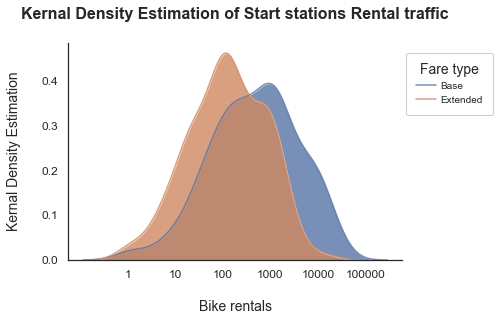

In [183]:
def log_trans(x, inverse = False):
    if not inverse:
        return np.log10(x)
    else:
        return 10 ** x

    
# Assign palette as per requirement
sb.set_style('white')
sb.set_palette('deep', desat = 0.8)

min_value = log_trans(start_stations[start_stations['fare_type'] == "Base"]['rentals'].min())
max_value = log_trans(start_stations[start_stations['fare_type'] == "Extended"]['rentals'].max())
bin_edges = np.arange(0, max_value+0.1, 0.1)

sb.distplot(start_stations[start_stations['fare_type'] == "Base"]['rentals'].apply(log_trans), 
            bins = bin_edges, kde = True, kde_kws = {'alpha' :0.8, "shade": True}, 
            color = sb.color_palette()[0], label = 'Base', hist=False)
sb.distplot(start_stations[start_stations['fare_type'] == "Extended"]['rentals'].apply(log_trans), 
            bins = bin_edges, kde = True, kde_kws = {'alpha' :0.8, "shade": True}, 
            color = sb.color_palette()[1], label = 'Extended', hist=False)
tick_locs = np.arange(0, max_value+1, 1)
plt.xticks(tick_locs, log_trans(tick_locs, inverse = True).astype(int), fontsize = 12)
plt.yticks(fontsize = 12)
plt.xlabel('\nBike rentals', fontsize = 14)
plt.ylabel('Kernal Density Estimation\n', fontsize = 14)
plt.title('Kernal Density Estimation of Start stations Rental traffic\n', fontsize = 16, weight = 'bold')

plt.legend(bbox_to_anchor=(1.3, 1), scatterpoints=1,frameon=True, fancybox=True, 
           shadow=False, framealpha = 1, borderpad=1, borderaxespad=1, labelspacing=0.5, 
           ncol = 1, title='Fare type', title_fontsize=14, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5, loc = 'upper right');
sb.despine();

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.7.d Kernal Density Estimation of Start stations Rental traffic based on fare type.png', dpi=300, bbox_inches='tight')

In [184]:
bin = [0,10,100,1000,10000,100000]
#use pd.cut function can attribute the values into its specific bins
category = pd.cut(start_stations['rentals'],bin)
category = category.to_frame()
category.columns = ['rental_bins']
category['fare_type'] = start_stations['fare_type']
category['start_station_id'] = start_stations['start_station_id']
category.reindex(columns=['start_station_id', 'fare_type', 'rental_bins'])
category.head()

,rental_bins,fare_type,start_station_id
0,"(10000, 100000]",Base,3005
1,"(1000, 10000]",Extended,3005
2,"(10000, 100000]",Base,3006
3,"(1000, 10000]",Extended,3006
4,"(10000, 100000]",Base,3007


In [185]:
df.rental_bins.sort_values(ascending=True).unique()

[(0, 10], (10, 100], (100, 1000], (1000, 10000], (10000, 100000]]
Categories (5, interval[int64]): [(0, 10] < (10, 100] < (100, 1000] < (1000, 10000] < (10000, 100000]]

In [186]:
%%time

def label_race(df):
    df.loc[df['rental_bins'] == df.rental_bins.sort_values(ascending=True).unique()[0],'traffic'] = 'Very Low'
    df.loc[df['rental_bins'] == df.rental_bins.sort_values(ascending=True).unique()[1],'traffic'] = 'Low'
    df.loc[df['rental_bins'] == df.rental_bins.sort_values(ascending=True).unique()[2],'traffic'] = 'Normal'
    df.loc[df['rental_bins'] == df.rental_bins.sort_values(ascending=True).unique()[3],'traffic'] = 'High'
    df.loc[df['rental_bins'] == df.rental_bins.sort_values(ascending=True).unique()[4],'traffic'] = 'Very High'
    
df = category
label_race(df)

level_order = ['Very Low', 'Low', 'Normal', 'High', 'Very High']
ordered_cat = pd.api.types.CategoricalDtype(ordered = True, categories = level_order)
df['traffic'] = df['traffic'].astype(ordered_cat)

category.traffic.value_counts()

Wall time: 42 ms


Normal       209
Low          146
High         122
Very Low      38
Very High     25
Name: traffic, dtype: int64

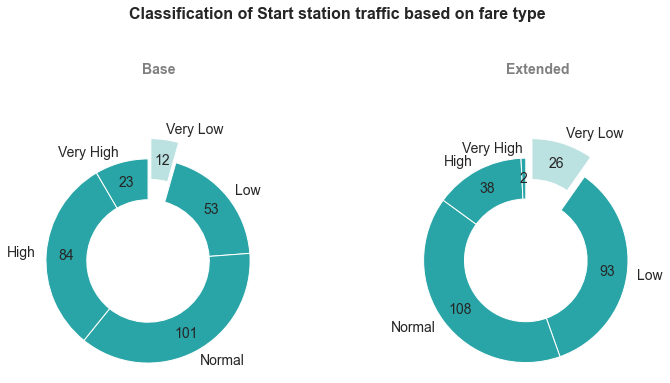

In [187]:
def plot_pie(cat_type):
    df = category[category['fare_type'] == cat_type]
    subdf = df.groupby([df['traffic']]).size().reset_index(name='stations')
    df_to_plot = subdf.loc[lambda df_to_plot: subdf['stations'] != 0]
    type_level_counts = df_to_plot.stations
    type_level_index = df_to_plot.traffic.sort_values(ascending=True).unique()
    clrs = [ sb.color_palette()[1], 
            sb.color_palette()[0], 
            sb.color_palette()[0], 
            sb.color_palette()[0], 
            sb.color_palette()[0] ]
    explode = [ 0.2, 0, 0, 0, 0 ]
    p, tx, autotexts = plt.pie(type_level_counts, labels = type_level_index, startangle = 90,
                               counterclock = False, wedgeprops = {'width' : 0.4}, shadow=False, 
                               explode=explode[0:len(type_level_counts)], colors=clrs[0:len(type_level_counts)], 
                               textprops={'fontsize': 14}, autopct='', labeldistance=1.1, pctdistance=0.8)
    plt.title(cat_type+ '\n\n\n', weight='bold', color='grey', fontsize=14)
    plt.axis('square');

    # add annotations
    for i, a in enumerate(autotexts):
        a.set_text("{}".format(type_level_counts[i]))

    
# Assign palette as per requirement
sb.set_style('white')
flatui = ['darkturquoise', 'paleturquoise']
sb.set_palette(flatui, desat = 0.6)

Ncount = len(category.fare_type.unique())
types = category.fare_type.unique()
plt.figure(figsize = [12, 6])

# subplot 
plt.subplot(1, 2, 1)
plot_pie('Base')
# subplot 
plt.subplot(1, 2, 2)
plot_pie('Extended')

plt.suptitle('Classification of Start station traffic based on fare type', fontsize = 16, weight = 'bold')
plt.subplots_adjust(top=0.7)
plt.subplots_adjust(wspace=0.3, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.7.e Pie chart classification of Start stations Rental traffic based on fare type.png', dpi=300, bbox_inches='tight')

<Figure size 432x288 with 0 Axes>

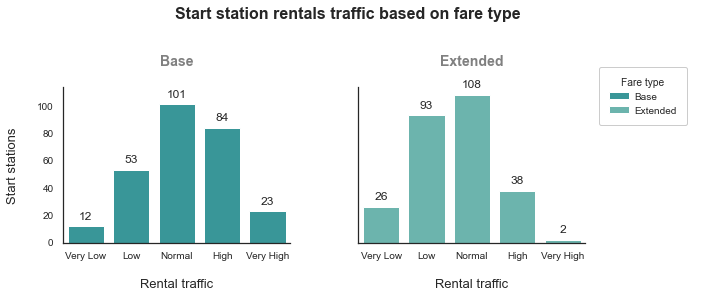

In [188]:
# Assign palette as per requirement
sb.set_style('white')
flatui = ['darkturquoise', 'turquoise']
sb.set_palette(flatui, desat = 0.6)
plt.figure(figsize = [6, 4])

# plot Facet Grid
g = sb.FacetGrid(data = category, col = 'fare_type', col_wrap = 2, height = 4, aspect = 1, hue = 'fare_type')
g.map(sb.countplot, 'traffic', order = category.traffic.sort_values(ascending=True).unique())
g.fig.subplots_adjust(top=0.8)
g.fig.suptitle('Start station rentals traffic based on fare type\n', fontsize = 16, weight = 'bold')
g.set_titles('{col_name}\n', weight = 'bold', size = 14, color = 'grey')

# improve plot aesthetics
g.set_yticklabels(size = 10)
g.set_xticklabels(size = 10)
g.set_xlabels('\nRental traffic', size = 13)
g.set_ylabels('Start stations\n', size = 13)
g.add_legend(bbox_to_anchor=(1.05, 0.7), scatterpoints=1,frameon=True, fancybox=True, 
             shadow=False, framealpha = 1, borderpad=1, borderaxespad=1, labelspacing=0.5, 
             ncol = 1, title='Fare type', title_fontsize=14, fontsize=10, facecolor='white', 
             markerfirst=True, handlelength=2, handletextpad=0.5);

plt.subplots_adjust(top=0.7)
plt.subplots_adjust(wspace=0.3, hspace=0.3);

# add annotations
# -------------------------------------------------------
#loop over the different figures in the grid 
for ax in g.axes.ravel():
    # loop over the different bars in each figure 
    for p in ax.patches: 
        ax.annotate(format(p.get_height(), '.0f'), (p.get_x() + p.get_width() / 2., p.get_height()), 
                    ha = 'center', va = 'center', xytext = (0, 10), textcoords = 'offset points');
# -------------------------------------------------------

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.7.f Facet grid classification of Start stations Rental traffic based on fare type.png', dpi=300, bbox_inches='tight')

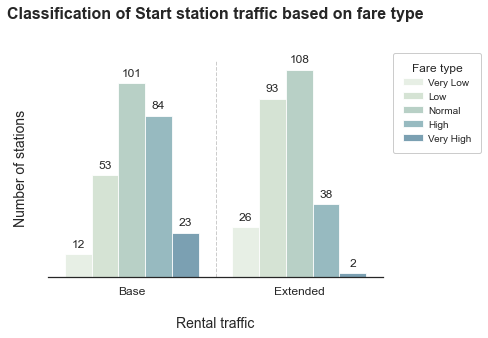

In [189]:
# Assign palette as per requirement
sb.set_style('white')
flatui = ['darkturquoise', 'paleturquoise']
sb.set_palette('GnBu', desat = 0.6)
plt.figure(figsize = [6, 4])

# plot clustered bar chart
g = sb.countplot(data = category, x = 'fare_type', hue = 'traffic', alpha = 0.8, saturation = 0.8)

# improve plot aesthetics
plt.title('Classification of Start station traffic based on fare type\n\n', fontsize = 16, weight = 'bold')
plt.xlabel('\nRental traffic', fontsize = 14)
plt.ylabel('Number of stations\n', fontsize = 14)
plt.yticks([], fontsize = 12)
plt.xticks(fontsize = 12)
sb.despine(left=True)

# plot legend
plt.legend(scatterpoints=1, frameon=True, fancybox=True, shadow=False, ncol = 1, framealpha = 1, 
           borderpad=1, borderaxespad=1, bbox_to_anchor = (1, 0.8), loc = 6, labelspacing=0.5,  
           title='Fare type', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5)

# add annotations
# -------------------------------------------------------
for p in g.patches:
    g.annotate(format(p.get_height(), '.0f'), (p.get_x() + p.get_width() / 2., p.get_height()), 
               ha = 'center', va = 'center', xytext = (0, 10), textcoords = 'offset points')
# -------------------------------------------------------

separators = [0.5]
for loc in separators:
    plt.axvline(loc, ls='--', color='grey', linewidth=1, alpha=0.4);
    
# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.7.g Distribution of Start stations Rental traffic based on fare type.png', dpi=300, bbox_inches='tight')

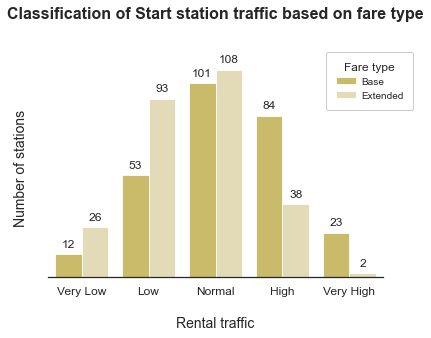

In [190]:
# Assign palette as per requirement
sb.set_style('white')
flatui = ['#fcd605', '#fae887']
# flatui = ['#e3ba40', '#faf441']
# flatui = ['#6845bf', '#c3abff']
sb.set_palette(flatui, desat = 0.6)
plt.figure(figsize = [6, 4])

# plot clustered bar chart
g = sb.countplot(data = category, x = 'traffic', hue = 'fare_type', alpha = 0.8, saturation = 0.8)

# improve plot aesthetics
plt.title('Classification of Start station traffic based on fare type\n\n', fontsize = 16, weight = 'bold')
plt.xlabel('\nRental traffic', fontsize = 14)
plt.ylabel('Number of stations\n', fontsize = 14)
plt.yticks([], fontsize = 12)
plt.xticks(fontsize = 12)
sb.despine(left=True)

# plot legend
plt.legend(scatterpoints=1, frameon=True, fancybox=True, shadow=False, ncol = 1, framealpha = 1, 
           borderpad=1, borderaxespad=1, bbox_to_anchor = (0.8, 0.9), loc = 6, labelspacing=0.5,  
           title='Fare type', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5)

# add annotations
# -------------------------------------------------------
for p in g.patches:
    g.annotate(format(p.get_height(), '.0f'), (p.get_x() + p.get_width() / 2., p.get_height()), 
               ha = 'center', va = 'center', xytext = (0, 10), textcoords = 'offset points')
# -------------------------------------------------------

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.7.h Classification of Start stations Rental traffic based on fare type.png', dpi=300, bbox_inches='tight')

------

#### 3.2.8 Bivariate analysis of `end_lat` and `end_lon` columns:

+ `Column`: end_lat, end_lon
+ `Data type`: numerical data, continuous
+ `Plot` : Scatter plot

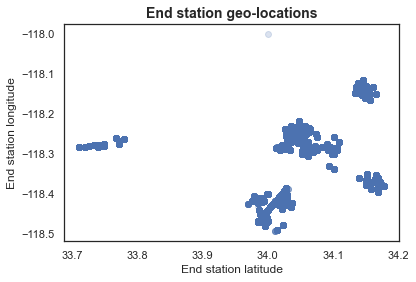

In [191]:
sb.set_style('white')
sb.set_palette(palette = "deep", n_colors = 20, desat = None)
sb.regplot(data = bikeshare, x = 'end_lat', y = 'end_lon', 
           fit_reg = False, scatter_kws = {'alpha' : 1/5})
plt.title('End station geo-locations', fontsize = 14, weight = 'bold')
plt.xlabel('End station latitude', fontsize = 12)
plt.ylabel('End station longitude', fontsize = 12);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.8.a End station geo-locations.png', dpi=300, bbox_inches='tight')

In [192]:
bikeshare[['end_lat', 'end_lon']].describe()

,end_lat,end_lon
count,808589.000000,808589.000000
mean,34.040230,-118.276967
std,0.054863,0.083723
min,33.710979,-118.495422
25%,34.039871,-118.264557
50%,34.046612,-118.254593
75%,34.050880,-118.243172
max,34.177662,-118.000000


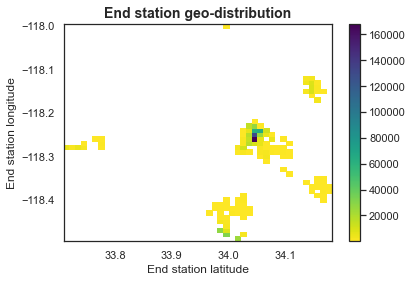

In [193]:
x_bins = np.arange(bikeshare.end_lat.min(), bikeshare.end_lat.max()+0.01, 0.01)
y_bins = np.arange(bikeshare.end_lon.min(), bikeshare.end_lon.max()+0.01, 0.01)

plt.hist2d(data = bikeshare, x = 'end_lat', y = 'end_lon', 
           cmin = 0.5, cmap = 'viridis_r', bins = [x_bins, y_bins])
plt.title('End station geo-distribution', fontsize = 14, weight = 'bold')
plt.xlabel('End station latitude', fontsize = 12)
plt.ylabel('End station longitude', fontsize = 12)
plt.colorbar();

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.8.b End station geo-distribution.png', dpi=300, bbox_inches='tight')

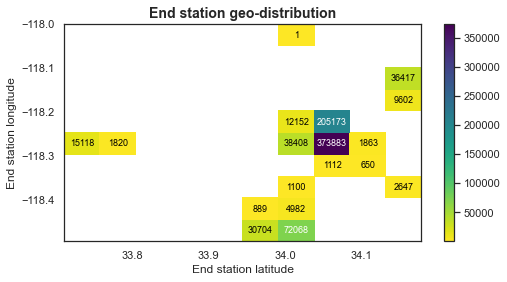

In [194]:
plt.figure(figsize = [8, 4])
h2d = plt.hist2d(data = bikeshare, x = 'end_lat', y = 'end_lon', cmin = 0.5, cmap = 'viridis_r')
plt.title('End station geo-distribution', fontsize = 14, weight = 'bold')
plt.xlabel('End station latitude', fontsize = 12)
plt.ylabel('End station longitude', fontsize = 12)

# getting individual elements
counts = h2d[0]
x_bins = h2d[1]
y_bins = h2d[2]

counts_list = []
x_bin_diff_list = []
y_bin_diff_list = []

for i in range(counts.shape[0]):
    for j in range(counts.shape[1]):
        c = counts[i,j]
        # eliminate nan and append only if c does not exist in counts_list
        if c not in counts_list and not np.isnan(c):
            counts_list.append(c)

for bin in range(len(x_bins)-1):
    x_bin_diff = x_bins[bin+1] - x_bins[bin]
    if x_bin_diff not in x_bin_diff_list:
        x_bin_diff_list.append(x_bin_diff)
        
for bin in range(len(y_bins)-1):
    y_bin_diff = y_bins[bin+1] - y_bins[bin]
    if y_bin_diff not in y_bin_diff_list:
        y_bin_diff_list.append(y_bin_diff)

counts_mean = np.mean(counts_list)
x_bin_size = max(x_bin_diff_list)
y_bin_size = max(y_bin_diff_list)

for i in range(counts.shape[0]):
    for j in range(counts.shape[1]):
        c = counts[i,j]
        if c >= counts_mean: # increase visibility on darkest cells
            plt.text(x_bins[i] + (x_bin_size/2), y_bins[j] + (y_bin_size/2), int(c),
                     ha = 'center', va = 'center', color = 'white', fontsize = 9)
        elif c > 0:
            plt.text(x_bins[i] + (x_bin_size/2), y_bins[j] + (y_bin_size/2), int(c),
                     ha = 'center', va = 'center', color = 'black', fontsize = 9)
plt.colorbar();    

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.8.c End station geo-distribution.png', dpi=300, bbox_inches='tight')

-----------

#### 3.2.9 Bivariate analysis of `end_station_id` and `trip_type` columns:

+ `Column`: start_station_id, start_station_id
+ `Data type`: numerical data, continuous
+ `Plot` : Scatter plot

**Distribution of `end_stations` rental traffic based on `trip_type`.**

In [195]:
end_stations = bikeshare.groupby([bikeshare['end_station_id'], 
                                  bikeshare['trip_type']]).size().reset_index(name='returns')
end_stations.head()

,end_station_id,trip_type,returns
0,3005,One Way,35701
1,3005,Round Trip,2938
2,3006,One Way,14738
3,3006,Round Trip,1692
4,3007,One Way,11017


> calculate max value of the count to estimate bin size of the preceeding plot

In [196]:
end_stations['returns'].describe()

count      546.000000
mean      1480.932234
std       3702.406058
min          1.000000
25%         57.500000
50%        232.000000
75%       1107.500000
max      35701.000000
Name: returns, dtype: float64

> As the max value is around `36000`, let the bin size be `1000`.

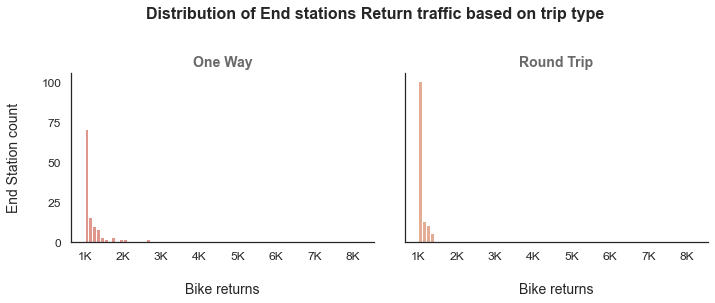

In [197]:
# Assign palette as per requirement
sb.set_style('white')
flatui = ['salmon', 'lightsalmon']
sb.set_palette(flatui, n_colors=2, desat=0.6)

# prepare data for plotting
max_value = end_stations['returns'].max()
bin_edges = np.arange(0, max_value+500, 500)
tick_locs = np.arange(0, max_value+1, 1)

# plot facet grid
g = sb.FacetGrid(data = end_stations, col = 'trip_type', col_wrap = 2, height = 4, aspect = 1.2, hue = 'trip_type')
g.map(plt.hist, "returns", bins = bin_edges)

g.fig.subplots_adjust(top=0.75)
g.fig.suptitle('Distribution of End stations Return traffic based on trip type\n', fontsize = 16, weight = 'bold')
g.set_titles('{col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# improve plot aesthetics
x_tick_max = (max_value/1000)
x_tick_locs = np.arange(0, x_tick_max+1, 1)
x_tick_names = ['{:0.0f}K'.format(loc) for loc in x_tick_locs]
g.set_xticklabels(x_tick_names, size=12)
g.set_yticklabels(size = 12)
g.set_xlabels('\nBike returns', size = 14)
g.set_ylabels('End Station count\n', size = 14)
plt.subplots_adjust(wspace=0.1, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.9.a Distribution of End stations Return traffic based on trip type.png', dpi=300, bbox_inches='tight')

> This data in their natural units, looks `highly right skewed`: lots of points with low values, with a very long tail of data points with large values (also all values are `positive`). The most common example of this is, the data that follows an approximately `log-normal distribution`. This is data that, in their natural units, can look highly skewed. However, after applying a logarithmic transform to the data, the data will follow a `normal distribution`. Hence let us apply `logarithmic transformation` to the start station's bike rental data.

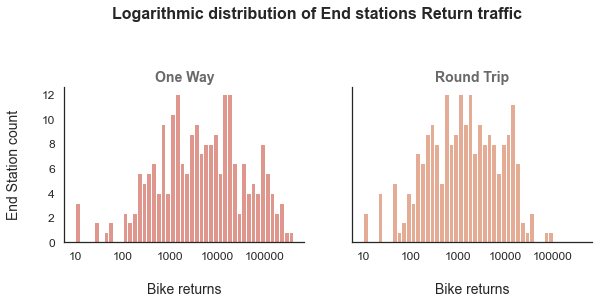

In [198]:
def log_trans(x, inverse = False):
    if not inverse:
        return np.log10(x)
    else:
        return 10 ** x

    
# Assign palette as per requirement
sb.set_style('white')
flatui = ['salmon', 'lightsalmon']
sb.set_palette(flatui, desat = 0.6)

# prepare data for plotting
end_stations['log_count'] = end_stations['returns'].apply(log_trans)
min_value = log_trans(end_stations['returns'].min())
max_value = log_trans(end_stations['returns'].max())
bin_edges = np.arange(0, max_value+0.1, 0.1)
tick_locs = np.arange(0, max_value+1, 1)

# plot facet grid
g = sb.FacetGrid(data = end_stations, col = 'trip_type', col_wrap = 2, height = 4, aspect = 1, hue = 'trip_type')
g.map(plt.hist, "log_count", bins = bin_edges)

g.fig.subplots_adjust(top=0.7)
g.fig.suptitle('Logarithmic distribution of End stations Return traffic\n', fontsize = 16, weight = 'bold')
g.set_titles('{col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# improve plot aesthetics
x_tick_names = log_trans(tick_locs, inverse = True).astype(int)
g.set_xticklabels(x_tick_names, size = 12)
g.set_yticklabels(size = 12)
g.set_xlabels('\nBike returns', size = 14)
g.set_ylabels('End Station count\n', size = 14)
plt.subplots_adjust(wspace=0.2, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.9.b Logarithmic distribution of End stations Return traffic based on trip type.png', dpi=300, bbox_inches='tight')

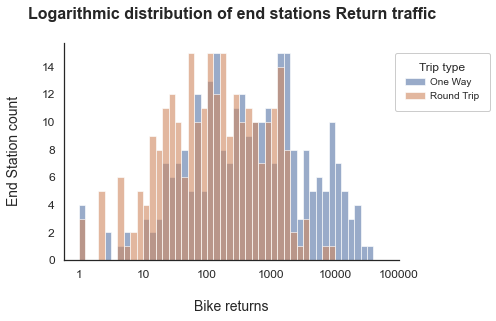

In [199]:
def log_trans(x, inverse = False):
    if not inverse:
        return np.log10(x)
    else:
        return 10 ** x

    
# Assign palette as per requirement
sb.set_style('white')
sb.set_palette('deep', desat = 0.8)

min_value = log_trans(end_stations[end_stations['trip_type'] == "One Way"]['returns'].min())
max_value = log_trans(end_stations[end_stations['trip_type'] == "One Way"]['returns'].max())
bin_edges = np.arange(0, max_value+0.1, 0.1)
plt.hist(end_stations[end_stations['trip_type'] == "One Way"]['returns'].apply(log_trans), 
         bins = bin_edges, color = sb.color_palette()[0], alpha=0.6, label = 'One Way')
plt.hist(end_stations[end_stations['trip_type'] == "Round Trip"]['returns'].apply(log_trans), 
         bins = bin_edges, color = sb.color_palette()[1], alpha=0.6, label = 'Round Trip')
tick_locs = np.arange(0, max_value+1, 1)
plt.xticks(tick_locs, log_trans(tick_locs, inverse = True).astype(int), fontsize = 12)
plt.yticks(fontsize = 12)
plt.xlabel('\nBike returns', fontsize = 14)
plt.ylabel('End Station count\n', fontsize = 14)
plt.title('Logarithmic distribution of end stations Return traffic\n', fontsize = 16, weight = 'bold')

plt.legend(bbox_to_anchor=(1.3, 1), scatterpoints=1,frameon=True, fancybox=True, 
           shadow=False, framealpha = 1, borderpad=1, borderaxespad=1, labelspacing=0.5, 
           ncol = 1, title='Trip type', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5, loc = 'upper right')
sb.despine();

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.9.c Logarithmic distribution of End stations Return traffic based on trip type.png', dpi=300, bbox_inches='tight')

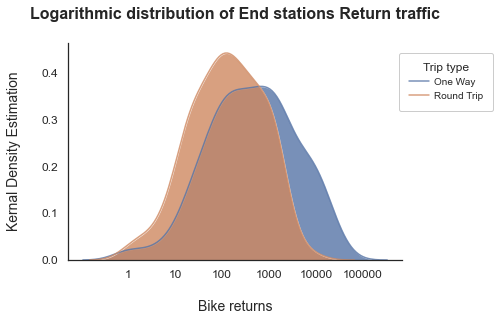

In [200]:
def log_trans(x, inverse = False):
    if not inverse:
        return np.log10(x)
    else:
        return 10 ** x

    
# Assign palette as per requirement
sb.set_style('white')
sb.set_palette('deep', desat = 0.8)

min_value = log_trans(end_stations[end_stations['trip_type'] == "One Way"]['returns'].min())
max_value = log_trans(end_stations[end_stations['trip_type'] == "One Way"]['returns'].max())
bin_edges = np.arange(0, max_value+0.1, 0.1)

sb.distplot(end_stations[end_stations['trip_type'] == "One Way"]['returns'].apply(log_trans), 
            bins = bin_edges, kde = True, kde_kws = {'alpha' :0.8, "shade": True}, 
            color = sb.color_palette()[0], label = 'One Way', hist=False)
sb.distplot(end_stations[end_stations['trip_type'] == "Round Trip"]['returns'].apply(log_trans), 
            bins = bin_edges, kde = True, kde_kws = {'alpha' :0.8, "shade": True}, 
            color = sb.color_palette()[1], label = 'Round Trip', hist=False)
tick_locs = np.arange(0, max_value+1, 1)
plt.xticks(tick_locs, log_trans(tick_locs, inverse = True).astype(int), fontsize = 12)
plt.yticks(fontsize = 12)
plt.xlabel('\nBike returns', fontsize = 14)
plt.ylabel('Kernal Density Estimation\n', fontsize = 14)
plt.title('Logarithmic distribution of End stations Return traffic\n', fontsize = 16, weight = 'bold')

plt.legend(bbox_to_anchor=(1.3, 1), scatterpoints=1,frameon=True, fancybox=True, 
           shadow=False, framealpha = 1, borderpad=1, borderaxespad=1, labelspacing=0.5, 
           ncol = 1, title='Trip type', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5, loc = 'upper right');
sb.despine();

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.9.d Kernal Density Estimation of End stations Return traffic based on trip type.png', dpi=300, bbox_inches='tight')

In [201]:
bin = [0,10,100,1000,10000,100000]
#use pd.cut function can attribute the values into its specific bins
category = pd.cut(end_stations['returns'],bin)
category = category.to_frame()
category.columns = ['return_bins']
category['trip_type'] = end_stations['trip_type']
category['end_station_id'] = end_stations['end_station_id']
category = category.reindex(columns=['end_station_id', 'trip_type', 'return_bins'])
category.head()

,end_station_id,trip_type,return_bins
0,3005,One Way,"(10000, 100000]"
1,3005,Round Trip,"(1000, 10000]"
2,3006,One Way,"(10000, 100000]"
3,3006,Round Trip,"(1000, 10000]"
4,3007,One Way,"(10000, 100000]"


In [202]:
category.return_bins.sort_values(ascending=True).unique()

[(0, 10], (10, 100], (100, 1000], (1000, 10000], (10000, 100000]]
Categories (5, interval[int64]): [(0, 10] < (10, 100] < (100, 1000] < (1000, 10000] < (10000, 100000]]

In [203]:
%%time

def assign_traffic(df):
    df.loc[df['return_bins'] == df.return_bins.sort_values(ascending=True).unique()[0],'traffic'] = 'Very Low'
    df.loc[df['return_bins'] == df.return_bins.sort_values(ascending=True).unique()[1],'traffic'] = 'Low'
    df.loc[df['return_bins'] == df.return_bins.sort_values(ascending=True).unique()[2],'traffic'] = 'Normal'
    df.loc[df['return_bins'] == df.return_bins.sort_values(ascending=True).unique()[3],'traffic'] = 'High'
    df.loc[df['return_bins'] == df.return_bins.sort_values(ascending=True).unique()[4],'traffic'] = 'Very High'
    
df = category
assign_traffic(df)

# convert the 'traffic' column to ordered categorical datatype
level_order = ['Very Low', 'Low', 'Normal', 'High', 'Very High']
ordered_cat = pd.api.types.CategoricalDtype(ordered = True, categories = level_order)
df['traffic'] = df['traffic'].astype(ordered_cat)

category.traffic.value_counts()

Wall time: 38 ms


Normal       216
Low          154
High         123
Very Low      32
Very High     21
Name: traffic, dtype: int64

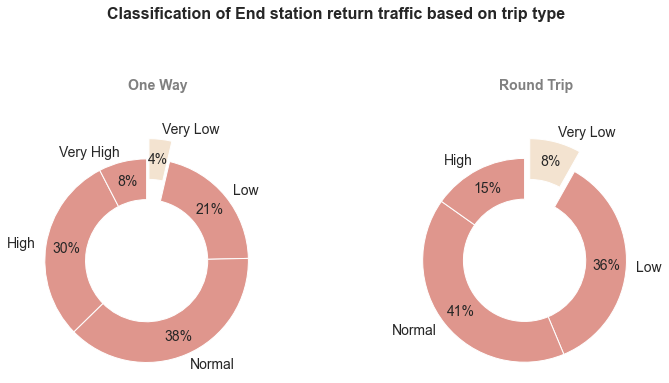

In [204]:
def plot_pie(cat_type):
    df = category[category['trip_type'] == cat_type]
    subdf = df.groupby([df['traffic']]).size().reset_index(name='stations')
    df_to_plot = subdf.loc[lambda df_to_plot: subdf['stations'] != 0]
    type_level_counts = df_to_plot.stations
    type_level_index = df_to_plot.traffic.sort_values(ascending=True).unique()
    clrs = [ sb.color_palette()[0] if (x > type_level_counts.min()) else sb.color_palette()[1] for x in type_level_counts ]
    explode = [ 0 if (x > type_level_counts.min()) else 0.2 for x in type_level_counts ]
    plt.pie(type_level_counts, labels = type_level_index, startangle = 90,
            counterclock = False, wedgeprops = {'width' : 0.4}, shadow=False, 
            explode=explode, colors=clrs, textprops={'fontsize': 14}, 
            autopct='%1.0f%%', labeldistance=1.1, pctdistance=0.8)
    plt.title(cat_type+ '\n\n', weight='bold', color='grey', fontsize=14)
    plt.axis('square');

    
# Assign palette as per requirement
sb.set_style('white')
flatui = ['salmon', 'bisque']
sb.set_palette(flatui, desat = 0.6)

Ncount = len(category.trip_type.unique())
types = category.trip_type.unique()
plt.figure(figsize = [12, 6])

# subplot 
plt.subplot(1, 2, 1)
plot_pie('One Way')
# subplot 
plt.subplot(1, 2, 2)
plot_pie('Round Trip')

plt.suptitle('Classification of End station return traffic based on trip type', fontsize = 16, weight = 'bold')
plt.subplots_adjust(top=0.7)
plt.subplots_adjust(wspace=0.3, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.9.e Pie chart classification of End stations Return traffic based on trip type.png', dpi=300, bbox_inches='tight')

<Figure size 432x288 with 0 Axes>

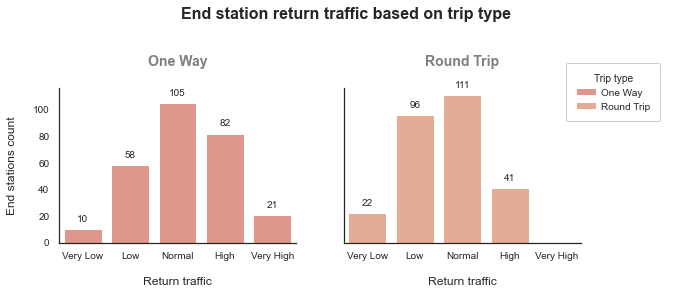

In [205]:
# Assign palette as per requirement
sb.set_style('white')
flatui = ['salmon', 'lightsalmon']
sb.set_palette(flatui, desat = 0.8)
plt.figure(figsize = [6, 4])

# plot Facet Grid
g = sb.FacetGrid(data = category, col = 'trip_type', col_wrap = 2, height = 4, aspect = 1, hue = 'trip_type')
g.map(sb.countplot, 'traffic', order = category.traffic.sort_values(ascending=True).unique())
g.fig.subplots_adjust(top=0.8)
g.fig.suptitle('End station return traffic based on trip type\n', fontsize = 16, weight = 'bold')
g.set_titles('{col_name}\n', weight = 'bold', size = 14, color = 'grey')

# improve plot aesthetics
g.set_yticklabels(size = 10)
g.set_xticklabels(size = 10)
g.set_xlabels('\nReturn traffic', size = 12)
g.set_ylabels('End stations count\n', size = 12)
g.add_legend(bbox_to_anchor=(1, 0.7), scatterpoints=1,frameon=True, fancybox=True, 
             shadow=False, framealpha = 1, borderpad=1, borderaxespad=1, labelspacing=0.5, 
             ncol = 1, title='Trip type', title_fontsize=12, fontsize=10, facecolor='white', 
             markerfirst=True, handlelength=2, handletextpad=0.5);

plt.subplots_adjust(top=0.7)
plt.subplots_adjust(wspace=0.2, hspace=0.3)

# add annotations
for ax in g.axes.ravel(): #this will loop over the different figures in the grid 
    for p in ax.patches: #this will loop over the different bars in each figure 
        ax.annotate(format(p.get_height(), '.0f'), (p.get_x() + p.get_width() / 2., p.get_height()), 
                    ha = 'center', va = 'center', xytext = (0, 10), textcoords = 'offset points', fontsize=10);
        
# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.9.f Facet grid classification of End stations Return traffic based on trip type.png', dpi=300, bbox_inches='tight')

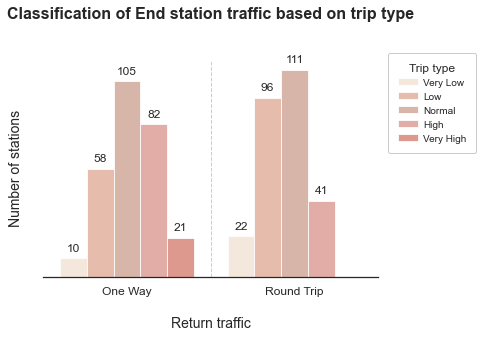

In [206]:
# Assign palette as per requirement
sb.set_style('white')
flatui = ['bisque', 'lightsalmon', 'darksalmon', 'salmon', 'tomato']
sb.set_palette(flatui, n_colors=5, desat=0.6)
plt.figure(figsize = [6, 4])

# plot clustered bar chart
g = sb.countplot(data = category, x = 'trip_type', hue = 'traffic', alpha = 0.8, saturation = 0.9)

# improve plot aesthetics
plt.title('Classification of End station traffic based on trip type\n\n', fontsize = 16, weight = 'bold')
plt.xlabel('\nReturn traffic', fontsize = 14)
plt.ylabel('Number of stations\n', fontsize = 14)
plt.yticks([], fontsize = 12)
plt.xticks(fontsize = 12)
sb.despine(left=True)

# plot legend
plt.legend(scatterpoints=1, frameon=True, fancybox=True, shadow=False, ncol = 1, framealpha = 1, 
           borderpad=1, borderaxespad=1, bbox_to_anchor = (1, 0.8), loc = 6, labelspacing=0.5,  
           title='Trip type', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5)

# add annotations
# -------------------------------------------------------
for p in g.patches:
    g.annotate(format(p.get_height(), '.0f'), (p.get_x() + p.get_width() / 2., p.get_height()), 
               ha = 'center', va = 'center', xytext = (0, 10), textcoords = 'offset points')
# -------------------------------------------------------

separators = [0.5, 1.5]
for loc in separators:
    plt.axvline(loc, ls='--', color='grey', linewidth=1, alpha=0.4);
    
# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.9.g Distribution of End stations Return traffic based on trip type.png', dpi=300, bbox_inches='tight')

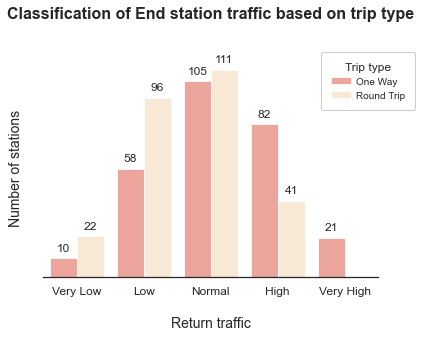

In [207]:
# Assign palette as per requirement
sb.set_style('white')
flatui = ['salmon', 'bisque']
sb.set_palette(flatui, desat = 0.8)
plt.figure(figsize = [6, 4])

# plot clustered bar chart
g = sb.countplot(data = category, x = 'traffic', hue = 'trip_type', alpha = 0.8, saturation = 0.9)

# improve plot aesthetics
plt.title('Classification of End station traffic based on trip type\n\n', fontsize = 16, weight = 'bold')
plt.xlabel('\nReturn traffic', fontsize = 14)
plt.ylabel('Number of stations\n', fontsize = 14)
plt.yticks([], fontsize = 12)
plt.xticks(fontsize = 12)
sb.despine(left=True)

# plot legend
plt.legend(scatterpoints=1, frameon=True, fancybox=True, shadow=False, ncol = 1, framealpha = 1, 
           borderpad=1, borderaxespad=1, bbox_to_anchor = (0.8, 0.9), loc = 6, labelspacing=0.5,  
           title='Trip type', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5)

# add annotations
for p in g.patches:
    g.annotate(format(p.get_height(), '.0f'), (p.get_x() + p.get_width() / 2., p.get_height()), 
               ha = 'center', va = 'center', xytext = (0, 10), textcoords = 'offset points')

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.9.h Classification of End stations Return traffic based on trip type.png', dpi=300, bbox_inches='tight')

-----

#### 3.2.10 Bivariate analysis of `end_station_id` and `bike_type` columns:

+ `Column`: start_station_id, start_station_id
+ `Data type`: numerical data, continuous
+ `Plot` : Scatter plot

**Distribution of `end_stations` rental traffic based on `bike_type`.**

In [208]:
end_stations = bikeshare.groupby([bikeshare['end_station_id'], 
                                  bikeshare['bike_type']]).size().reset_index(name='returns')
end_stations.head()

,end_station_id,bike_type,returns
0,3005,unknown,19990
1,3005,Standard,12296
2,3005,Electric,6353
3,3006,unknown,7942
4,3006,Standard,5004


> calculate max value of the count to estimate bin size of the preceeding plot

In [209]:
end_stations['returns'].max()

19990

> As the max value is around `20000`, let the bin size be `500`.

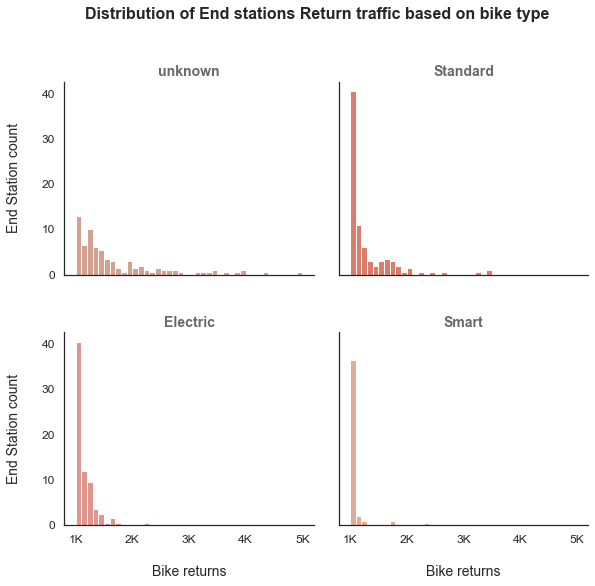

In [210]:
# Assign palette as per requirement
sb.set_style('white')
flatui = ['darksalmon', 'tomato', 'salmon', 'lightsalmon']
sb.set_palette(flatui, n_colors=4, desat=0.6)

# prepare data for plotting
max_value = end_stations['returns'].max()
bin_edges = np.arange(0, max_value+500, 500)
tick_locs = np.arange(0, max_value+1, 1)

# plot facet grid
g = sb.FacetGrid(data = end_stations, col = 'bike_type', col_wrap = 2, height = 4, aspect = 1, hue = 'bike_type')
g.map(plt.hist, "returns", bins = bin_edges)

g.fig.subplots_adjust(top=0.85)
g.fig.suptitle('Distribution of End stations Return traffic based on bike type\n', fontsize = 16, weight = 'bold')
g.set_titles('{col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# improve plot aesthetics
x_tick_max = (max_value/1000)
x_tick_locs = np.arange(0, x_tick_max+1, 1)
x_tick_names = ['{:0.0f}K'.format(loc) for loc in x_tick_locs]
g.set_xticklabels(x_tick_names, size=12)
g.set_yticklabels(size = 12)
g.set_xlabels('\nBike returns', size = 14)
g.set_ylabels('End Station count\n', size = 14)
plt.subplots_adjust(wspace=0.1, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.10.a Distribution of End stations Return traffic based on bike type.png', dpi=300, bbox_inches='tight')

> This data in their natural units, looks `highly right skewed`: lots of points with low values, with a very long tail of data points with large values (also all values are `positive`). The most common example of this is, the data that follows an approximately `log-normal distribution`. This is data that, in their natural units, can look highly skewed. However, after applying a logarithmic transform to the data, the data will follow a `normal distribution`. Hence let us apply `logarithmic transformation` to the start station's bike rental data.

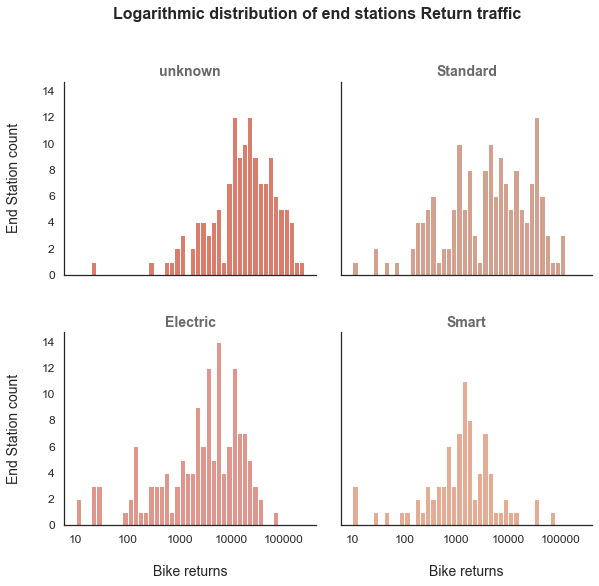

In [211]:
def log_trans(x, inverse = False):
    if not inverse:
        return np.log10(x)
    else:
        return 10 ** x

    
# Assign palette as per requirement
sb.set_style('white')
flatui = ['tomato', 'darksalmon', 'salmon', 'lightsalmon']
sb.set_palette(flatui, n_colors=4, desat=0.6)

# prepare data for plotting
end_stations['log_count'] = end_stations['returns'].apply(log_trans)
min_value = log_trans(end_stations['returns'].min())
max_value = log_trans(end_stations['returns'].max())
bin_edges = np.arange(0, max_value+0.1, 0.1)
tick_locs = np.arange(0, max_value+1, 1)

# plot facet grid
g = sb.FacetGrid(data = end_stations, col = 'bike_type', col_wrap = 2, height = 4, aspect = 1, hue = 'bike_type')
g.map(plt.hist, "log_count", bins = bin_edges)

g.fig.subplots_adjust(top=0.85)
g.fig.suptitle('Logarithmic distribution of end stations Return traffic', fontsize = 16, weight = 'bold')
g.set_titles('{col_name}', weight = 'bold', size = 14, color = 'dimgrey')


# improve plot aesthetics
x_tick_names = log_trans(tick_locs, inverse = True).astype(int)
g.set_xticklabels(x_tick_names, size = 12)
g.set_yticklabels(size = 12)
g.set_xlabels('\nBike returns', size = 14)
g.set_ylabels('End Station count\n', size = 14)
plt.subplots_adjust(wspace=0.1, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.10.b Logarithmic distribution of End stations Return traffic based on bike type.png', dpi=300, bbox_inches='tight')

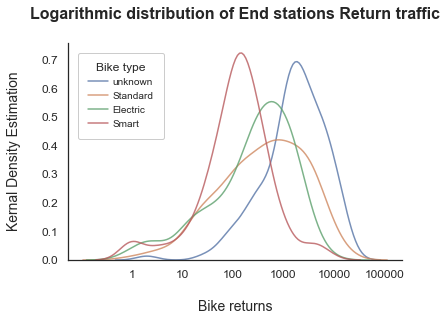

In [212]:
def log_trans(x, inverse = False):
    if not inverse:
        return np.log10(x)
    else:
        return 10 ** x

    
# Assign palette as per requirement
sb.set_style('white')
sb.set_palette('deep', n_colors = 4, desat = 0.8)

max_value = log_trans(end_stations['returns'].max())
bin_edges = np.arange(0, max_value+0.1, 0.1)

sb.distplot(end_stations[end_stations['bike_type'] == "unknown"]['returns'].apply(log_trans), 
            bins = bin_edges, kde = True, kde_kws = {'alpha' :0.8}, 
            color = sb.color_palette()[0], label = 'unknown', hist=False)
sb.distplot(end_stations[end_stations['bike_type'] == "Standard"]['returns'].apply(log_trans), 
            bins = bin_edges, kde = True, kde_kws = {'alpha' :0.8}, 
            color = sb.color_palette()[1], label = 'Standard', hist=False)
sb.distplot(end_stations[end_stations['bike_type'] == "Electric"]['returns'].apply(log_trans), 
            bins = bin_edges, kde = True, kde_kws = {'alpha' :0.8}, 
            color = sb.color_palette()[2], label = 'Electric', hist=False)
sb.distplot(end_stations[end_stations['bike_type'] == "Smart"]['returns'].apply(log_trans), 
            bins = bin_edges, kde = True, kde_kws = {'alpha' :0.8}, 
            color = sb.color_palette()[3], label = 'Smart', hist=False)
tick_locs = np.arange(0, max_value+1, 1)
plt.xticks(tick_locs, log_trans(tick_locs, inverse = True).astype(int), fontsize = 12)
plt.yticks(fontsize = 12)
plt.xlabel('\nBike returns', fontsize = 14)
plt.ylabel('Kernal Density Estimation\n', fontsize = 14)
plt.title('Logarithmic distribution of End stations Return traffic\n', fontsize = 16, weight = 'bold')

plt.legend(scatterpoints=1,frameon=True, fancybox=True, loc = 'upper left', 
           shadow=False, framealpha = 1, borderpad=1, borderaxespad=1, labelspacing=0.5, 
           ncol = 1, title='Bike type', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5);
sb.despine();

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.10.c Kernal Density Estimation of End stations Return traffic based on bike type.png', dpi=300, bbox_inches='tight')

In [213]:
bin = [0,10,100,1000,10000,100000]
#use pd.cut function can attribute the values into its specific bins
category = pd.cut(end_stations['returns'],bin)
category = category.to_frame()
category.columns = ['return_bins']
category['bike_type'] = end_stations['bike_type']
category['end_station_id'] = end_stations['end_station_id']
category = category.reindex(columns=['end_station_id', 'bike_type', 'return_bins'])
category.head()

,end_station_id,bike_type,return_bins
0,3005,unknown,"(10000, 100000]"
1,3005,Standard,"(10000, 100000]"
2,3005,Electric,"(1000, 10000]"
3,3006,unknown,"(1000, 10000]"
4,3006,Standard,"(1000, 10000]"


In [214]:
category.return_bins.sort_values(ascending=True).unique()

[(0, 10], (10, 100], (100, 1000], (1000, 10000], (10000, 100000]]
Categories (5, interval[int64]): [(0, 10] < (10, 100] < (100, 1000] < (1000, 10000] < (10000, 100000]]

In [215]:
%%time

def assign_traffic(df):
    df.loc[df['return_bins'] == df.return_bins.sort_values(ascending=True).unique()[0],'traffic'] = 'Very Low'
    df.loc[df['return_bins'] == df.return_bins.sort_values(ascending=True).unique()[1],'traffic'] = 'Low'
    df.loc[df['return_bins'] == df.return_bins.sort_values(ascending=True).unique()[2],'traffic'] = 'Normal'
    df.loc[df['return_bins'] == df.return_bins.sort_values(ascending=True).unique()[3],'traffic'] = 'High'
    df.loc[df['return_bins'] == df.return_bins.sort_values(ascending=True).unique()[4],'traffic'] = 'Very High'
    
df = category
assign_traffic(df)

# convert 'traffic' column to ordered categorical datatype
level_order = ['Very Low', 'Low', 'Normal', 'High', 'Very High']
ordered_cat = pd.api.types.CategoricalDtype(ordered = True, categories = level_order)
df['traffic'] = df['traffic'].astype(ordered_cat)

category.traffic.value_counts()

Wall time: 38 ms


Normal       215
High         180
Low           87
Very Low      22
Very High     14
Name: traffic, dtype: int64

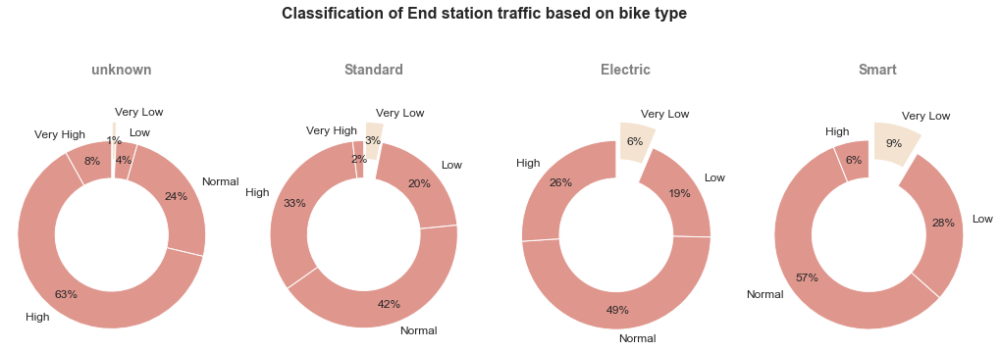

In [216]:
def plot_pie(cat_type):
    df = category[category['bike_type'] == cat_type]
    subdf = df.groupby([df['traffic']]).size().reset_index(name='stations')
    df_to_plot = subdf.loc[lambda df_to_plot: subdf['stations'] != 0]
    type_level_counts = df_to_plot.stations
    type_level_index = df_to_plot.traffic.sort_values(ascending=True).unique()
    clrs = [ sb.color_palette()[4], sb.color_palette()[2], sb.color_palette()[2], sb.color_palette()[2], sb.color_palette()[2]]
    explode = [ 0.2, 0, 0, 0, 0 ]
    plt.pie(type_level_counts, labels = type_level_index, startangle = 90,
            counterclock = False, wedgeprops = {'width' : 0.4}, shadow=False, 
            explode=explode[0:len(type_level_index)], colors=clrs[0:len(type_level_index)], 
            textprops={'fontsize': 12}, autopct='%1.0f%%', labeldistance=1.1, pctdistance=0.8)
    plt.title(cat_type+ '\n\n', weight='bold', color='grey', fontsize=14)
    plt.axis('square');

    
# Assign palette as per requirement
sb.set_style('white')
flatui = ['tomato', 'darksalmon', 'salmon', 'lightsalmon', 'bisque']
sb.set_palette(flatui, n_colors=5, desat=0.6)

Ncount = len(category.bike_type.unique())
types = category.bike_type.unique()
plt.figure(figsize = [18, 6])

# subplot 
plt.subplot(1, 4, 1)
plot_pie('unknown')
# subplot 
plt.subplot(1, 4, 2)
plot_pie('Standard')
# subplot 
plt.subplot(1, 4, 3)
plot_pie('Electric')
# subplot 
plt.subplot(1, 4, 4)
plot_pie('Smart')

plt.suptitle('Classification of End station traffic based on bike type', fontsize = 16, weight = 'bold')
plt.subplots_adjust(top=0.8)
plt.subplots_adjust(wspace=0.1, hspace=0.2);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.10.d Pie chart classification of End stations Return traffic based on bike type.png', dpi=300, bbox_inches='tight')

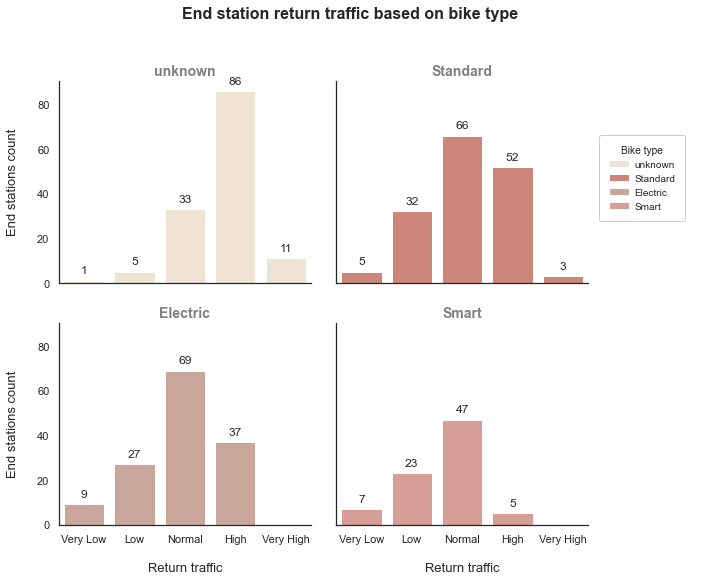

In [217]:
# Assign palette as per requirement
sb.set_style('white')
flatui = ['bisque', 'tomato', 'darksalmon', 'salmon', 'lightsalmon']
sb.set_palette(flatui, n_colors=5, desat=0.6)

# plot Facet Grid
g = sb.FacetGrid(data = category, col = 'bike_type', col_wrap = 2, height = 4, aspect = 1, hue = 'bike_type')
g.map(sb.countplot, 'traffic', order = category.traffic.sort_values(ascending=True).unique())
g.fig.subplots_adjust(top=0.8)
g.fig.suptitle('End station return traffic based on bike type\n', fontsize = 16, weight = 'bold')
g.set_titles('{col_name}', weight = 'bold', size = 14, color = 'grey')

# obtain the ticks and store them as a list
y_tick_names = []
x_tick_names = []
for ax in g.axes.flat:
    for y_label in ax.get_yticklabels():
        y_label_value = int(y_label.get_text())
        y_label_new_value = '{:0.0f}'.format(y_label_value)
        y_tick_names.append(y_label_new_value)
        
    for x_label in ax.get_xticklabels():
        x_label_value = x_label.get_text()
        x_tick_names.append(x_label_value)

# improve plot aesthetics
g.set_yticklabels(y_tick_names, size = 11)
g.set_xticklabels(x_tick_names, size = 11)
g.set_xlabels('\nReturn traffic', size = 13)
g.set_ylabels('End stations count\n', size = 13)
g.add_legend(bbox_to_anchor=(1.05, 0.7), scatterpoints=1,frameon=True, fancybox=True, 
             shadow=False, framealpha = 1, borderpad=1, borderaxespad=1, labelspacing=0.5, 
             ncol = 1, title='Bike type', title_fontsize=14, fontsize=10, facecolor='white', 
             markerfirst=True, handlelength=2, handletextpad=0.5);

# add annotations
for ax in g.axes.ravel(): #this will loop over the different figures in the grid 
    for p in ax.patches: #this will loop over the different bars in each figure 
        ax.annotate(format(p.get_height(), '.0f'), (p.get_x() + p.get_width() / 2., p.get_height()), 
                    ha = 'center', va = 'center', xytext = (0, 10), textcoords = 'offset points')

plt.subplots_adjust(top=0.85)
plt.subplots_adjust(wspace=0.1, hspace=0.2);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.10.e Facet grid classification of End stations Return traffic based on bike type.png', dpi=300, bbox_inches='tight')

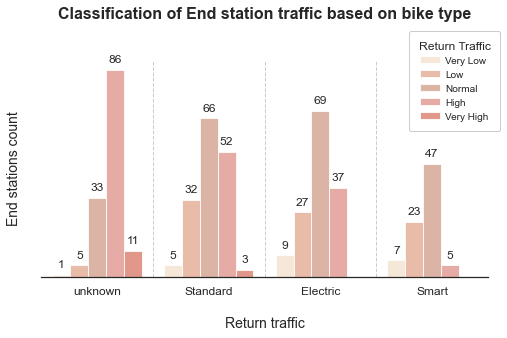

In [218]:
# Assign palette as per requirement
sb.set_style('white')
flatui = ['bisque', 'lightsalmon', 'darksalmon', 'salmon', 'tomato']
sb.set_palette(flatui, n_colors=5, desat=0.6)
plt.figure(figsize = [8, 4])

# plot clustered bar chart
g = sb.countplot(data = category, x = 'bike_type', hue = 'traffic', alpha = 0.8, saturation = 1)

# improve plot aesthetics
plt.title('Classification of End station traffic based on bike type\n\n', fontsize = 16, weight = 'bold')
plt.xlabel('\nReturn traffic', fontsize = 14)
plt.ylabel('End stations count\n', fontsize = 14)
plt.yticks([], fontsize = 12)
plt.xticks(fontsize = 12)
sb.despine(left=True)

# plot legend
plt.legend(scatterpoints=1, frameon=True, fancybox=True, shadow=False, ncol = 1, framealpha = 1, 
           borderpad=1, borderaxespad=1, bbox_to_anchor = (0.8, 0.9), loc = 6, labelspacing=0.5,  
           title='Return Traffic', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5)

# add annotations
# -------------------------------------------------------
for p in g.patches:
    g.annotate(format(p.get_height(), '.0f'), (p.get_x() + p.get_width() / 2., p.get_height()), 
               ha = 'center', va = 'center', xytext = (0, 10), textcoords = 'offset points')
# -------------------------------------------------------

separators = [0.5, 1.5, 2.5]
for loc in separators:
    plt.axvline(loc, ls='--', color='grey', linewidth=1, alpha=0.4);
    
# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.10.f Distribution of End stations Return traffic based on bike type.png', dpi=300, bbox_inches='tight')

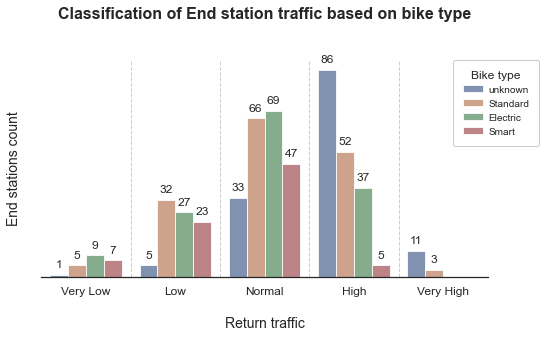

In [219]:
# Assign palette as per requirement
sb.set_style('white')
sb.set_palette('deep', n_colors=4, desat=0.6)
plt.figure(figsize = [8, 4])

# plot clustered bar chart
g = sb.countplot(data = category, x = 'traffic', hue = 'bike_type', alpha = 0.8, saturation = 1)

# improve plot aesthetics
plt.title('Classification of End station traffic based on bike type\n\n', fontsize = 16, weight = 'bold')
plt.xlabel('\nReturn traffic', fontsize = 14)
plt.ylabel('End stations count\n', fontsize = 14)
plt.yticks([], fontsize = 12)
plt.xticks(fontsize = 12)
sb.despine(left=True)

# plot legend
plt.legend(scatterpoints=1, frameon=True, fancybox=True, shadow=False, ncol = 1, framealpha = 1, 
           borderpad=1, borderaxespad=1, bbox_to_anchor = (0.9, 0.8), loc = 6, labelspacing=0.5,  
           title='Bike type', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5)

# add annotations
# -------------------------------------------------------
for p in g.patches:
    g.annotate(format(p.get_height(), '.0f'), (p.get_x() + p.get_width() / 2., p.get_height()), 
               ha = 'center', va = 'center', xytext = (0, 10), textcoords = 'offset points')
# -------------------------------------------------------

separators = [0.5, 1.5, 2.5, 3.5]
for loc in separators:
    plt.axvline(loc, ls='--', color='grey', linewidth=1, alpha=0.4);
    
# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.10.g Classification of End stations Return traffic based on bike type.png', dpi=300, bbox_inches='tight')

------

#### 3.2.11 Bivariate analysis of `end_station_id` and `pass_type` columns:

+ `Column`: start_station_id, start_station_id
+ `Data type`: numerical data, continuous
+ `Plot` : Scatter plot

**Distribution of `end_stations` rental traffic based on `pass_type`.**

In [220]:
end_stations = bikeshare.groupby([bikeshare['end_station_id'], 
                                  bikeshare['pass_type']]).size().reset_index(name='returns')
end_stations.head()

,end_station_id,pass_type,returns
0,3005,Walk-up,2462
1,3005,One Day,5152
2,3005,Monthly,28014
3,3005,Flex,19
4,3005,Annual,2992


> calculate max value of the count to estimate bin size of the preceeding plot

In [221]:
end_stations['returns'].max()

28014

> As the max value is around `28000`, let the bin size be `500`.

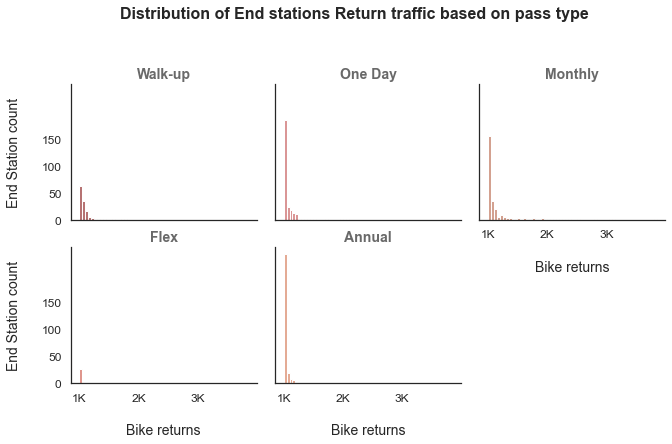

In [222]:
# Assign palette as per requirement
sb.set_style('white')
flatui = ['indianred', 'lightcoral', 'darksalmon', 'salmon', 'lightsalmon']
sb.set_palette(flatui, n_colors=5, desat=0.6)

# prepare data for plotting
max_value = end_stations['returns'].max()
bin_edges = np.arange(0, max_value+500, 500)
tick_locs = np.arange(0, max_value+1, 1)

# plot facet grid
g = sb.FacetGrid(data = end_stations, col = 'pass_type', col_wrap = 3, height = 3, aspect = 1, hue = 'pass_type')
g.map(plt.hist, "returns", bins = bin_edges)

g.fig.subplots_adjust(top=0.8)
g.fig.suptitle('Distribution of End stations Return traffic based on pass type\n', fontsize = 16, weight = 'bold')
g.set_titles('{col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# improve plot aesthetics
x_tick_max = (max_value/1000)
x_tick_locs = np.arange(0, x_tick_max+1, 1)
x_tick_names = ['{:0.0f}K'.format(loc) for loc in x_tick_locs]
g.set_xticklabels(x_tick_names, size=12)
g.set_yticklabels(size = 12)
g.set_xlabels('\nBike returns', size = 14)
g.set_ylabels('End Station count\n', size = 14)
plt.subplots_adjust(wspace=0.1, hspace=0.2);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.11.a Distribution of End stations Return traffic based on pass type.png', dpi=300, bbox_inches='tight')

> This data in their natural units, looks `highly right skewed`: lots of points with low values, with a very long tail of data points with large values (also all values are `positive`). The most common example of this is, the data that follows an approximately `log-normal distribution`. This is data that, in their natural units, can look highly skewed. However, after applying a logarithmic transform to the data, the data will follow a `normal distribution`. Hence let us apply `logarithmic transformation` to the start station's bike rental data.

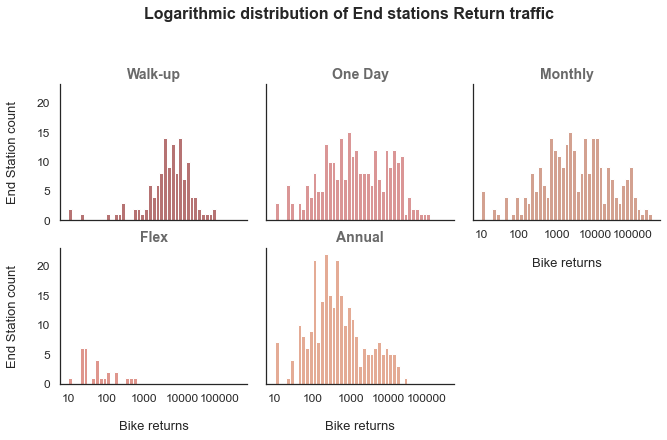

In [223]:
def log_trans(x, inverse = False):
    if not inverse:
        return np.log10(x)
    else:
        return 10 ** x

    
# Assign palette as per requirement
sb.set_style('white')
flatui = ['indianred', 'lightcoral', 'darksalmon', 'salmon', 'lightsalmon']
sb.set_palette(flatui, n_colors=5, desat=0.6)

# prepare data for plotting
end_stations['log_count'] = end_stations['returns'].apply(log_trans)
min_value = log_trans(end_stations['returns'].min())
max_value = log_trans(end_stations['returns'].max())
bin_edges = np.arange(0, max_value+0.1, 0.1)
tick_locs = np.arange(0, max_value+1, 1)

# plot facet grid
g = sb.FacetGrid(data = end_stations, col = 'pass_type', col_wrap = 3, height = 3, aspect = 1, hue = 'pass_type')
g.map(plt.hist, "log_count", bins = bin_edges)

g.fig.subplots_adjust(top=0.8)
g.fig.suptitle('Logarithmic distribution of End stations Return traffic', fontsize = 16, weight = 'bold')
g.set_titles('{col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# improve plot aesthetics
x_tick_names = log_trans(tick_locs, inverse = True).astype(int)
g.set_xticklabels(x_tick_names, size = 12)
g.set_yticklabels(size = 12)
g.set_xlabels('\nBike returns', size = 13)
g.set_ylabels('End Station count\n', size = 13)
plt.subplots_adjust(wspace=0.1, hspace=0.2);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.11.b Logarithmic distribution of End stations Return traffic based on pass type.png', dpi=300, bbox_inches='tight')

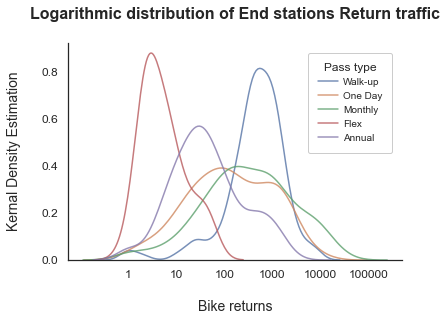

In [224]:
def log_trans(x, inverse = False):
    if not inverse:
        return np.log10(x)
    else:
        return 10 ** x

    
# Assign palette as per requirement
sb.set_style('white')
flatui = ['indianred', 'lightcoral', 'darksalmon', 'salmon', 'lightsalmon']
sb.set_palette('deep', n_colors = 5, desat = 0.8)

max_value = log_trans(end_stations['returns'].max())
bin_edges = np.arange(0, max_value+0.1, 0.1)

sb.distplot(end_stations[end_stations['pass_type'] == "Walk-up"]['returns'].apply(log_trans), 
            bins = bin_edges, kde = True, kde_kws = {'alpha' :0.8}, 
            color = sb.color_palette()[0], label = 'Walk-up', hist=False)
sb.distplot(end_stations[end_stations['pass_type'] == "One Day"]['returns'].apply(log_trans), 
            bins = bin_edges, kde = True, kde_kws = {'alpha' :0.8}, 
            color = sb.color_palette()[1], label = 'One Day', hist=False)
sb.distplot(end_stations[end_stations['pass_type'] == "Monthly"]['returns'].apply(log_trans), 
            bins = bin_edges, kde = True, kde_kws = {'alpha' :0.8}, 
            color = sb.color_palette()[2], label = 'Monthly', hist=False)
sb.distplot(end_stations[end_stations['pass_type'] == "Flex"]['returns'].apply(log_trans), 
            bins = bin_edges, kde = True, kde_kws = {'alpha' :0.8}, 
            color = sb.color_palette()[3], label = 'Flex', hist=False)
sb.distplot(end_stations[end_stations['pass_type'] == "Annual"]['returns'].apply(log_trans), 
            bins = bin_edges, kde = True, kde_kws = {'alpha' :0.8}, 
            color = sb.color_palette()[4], label = 'Annual', hist=False)
tick_locs = np.arange(0, max_value+1, 1)
plt.xticks(tick_locs, log_trans(tick_locs, inverse = True).astype(int), fontsize = 12)
plt.yticks(fontsize = 12)
plt.xlabel('\nBike returns', fontsize = 14)
plt.ylabel('Kernal Density Estimation\n', fontsize = 14)
plt.title('Logarithmic distribution of End stations Return traffic\n', fontsize = 16, weight = 'bold')

plt.legend(scatterpoints=1,frameon=True, fancybox=True, loc = 'upper right', 
           shadow=False, framealpha = 1, borderpad=1, borderaxespad=1, labelspacing=0.5, 
           ncol = 1, title='Pass type', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5);
sb.despine();

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.11.c Kernal Density Estimation of End stations Return traffic based on pass type.png', dpi=300, bbox_inches='tight')

In [225]:
bin = [0,10,100,1000,10000,100000]
#use pd.cut function can attribute the values into its specific bins
category = pd.cut(end_stations['returns'],bin)
category = category.to_frame()
category.columns = ['return_bins']
category['pass_type'] = end_stations['pass_type']
category['end_station_id'] = end_stations['end_station_id']
category = category.reindex(columns=['end_station_id', 'pass_type', 'return_bins'])
category.head()

,end_station_id,pass_type,return_bins
0,3005,Walk-up,"(1000, 10000]"
1,3005,One Day,"(1000, 10000]"
2,3005,Monthly,"(10000, 100000]"
3,3005,Flex,"(10, 100]"
4,3005,Annual,"(1000, 10000]"


In [226]:
category.return_bins.sort_values(ascending=True).unique()

[(0, 10], (10, 100], (100, 1000], (1000, 10000], (10000, 100000]]
Categories (5, interval[int64]): [(0, 10] < (10, 100] < (100, 1000] < (1000, 10000] < (10000, 100000]]

In [227]:
%%time

def assign_traffic(df):
    df.loc[df['return_bins'] == df.return_bins.sort_values(ascending=True).unique()[0],'traffic'] = 'Very Low'
    df.loc[df['return_bins'] == df.return_bins.sort_values(ascending=True).unique()[1],'traffic'] = 'Low'
    df.loc[df['return_bins'] == df.return_bins.sort_values(ascending=True).unique()[2],'traffic'] = 'Normal'
    df.loc[df['return_bins'] == df.return_bins.sort_values(ascending=True).unique()[3],'traffic'] = 'High'
    df.loc[df['return_bins'] == df.return_bins.sort_values(ascending=True).unique()[4],'traffic'] = 'Very High'
    
df = category
assign_traffic(df)

# Convert 'traffic' column to ordered categorical datatype
level_order = ['Very Low', 'Low', 'Normal', 'High', 'Very High']
ordered_cat = pd.api.types.CategoricalDtype(ordered = True, categories = level_order)
df['traffic'] = df['traffic'].astype(ordered_cat)

category.traffic.value_counts()

Wall time: 107 ms


Normal       344
Low          317
High         170
Very Low     124
Very High     11
Name: traffic, dtype: int64

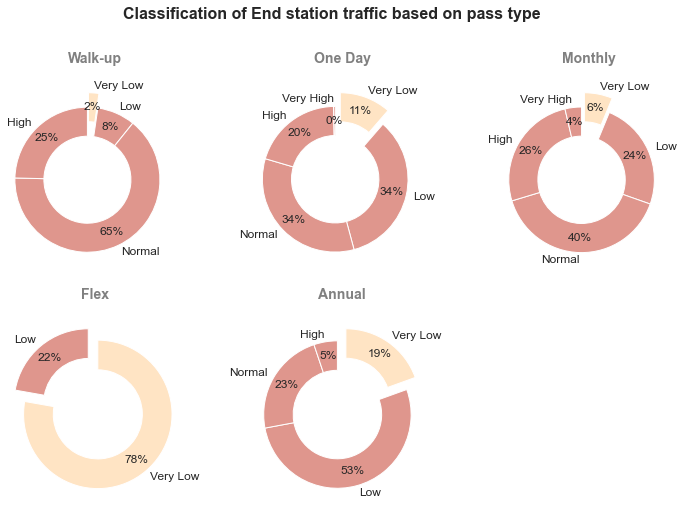

In [228]:
def plot_pie(cat_type):
    df = category[category['pass_type'] == cat_type]
    subdf = df.groupby([df['traffic']]).size().reset_index(name='stations')
    df_to_plot = subdf.loc[lambda df_to_plot: subdf['stations'] != 0]
    type_level_counts = df_to_plot.stations
    type_level_index = df_to_plot.traffic.sort_values(ascending=True).unique()
    clrs = ['bisque', sb.color_palette()[3], sb.color_palette()[3], sb.color_palette()[3], sb.color_palette()[3]]
    explode = [0.2, 0, 0, 0, 0]
    plt.pie(type_level_counts, labels = type_level_index, startangle = 90,
            counterclock = False, wedgeprops = {'width' : 0.4}, shadow=False, 
            explode=explode[0:len(type_level_index)], colors=clrs[0:len(type_level_index)], textprops={'fontsize': 12}, 
            autopct='%1.0f%%', labeldistance=1.1, pctdistance=0.8)
    plt.title(cat_type+ '\n', weight='bold', color='grey', fontsize=14)
    plt.axis('square');

    
# Assign palette as per requirement
sb.set_style('white')
flatui = ['indianred', 'lightcoral', 'darksalmon', 'salmon', 'lightsalmon']
sb.set_palette(flatui, n_colors=5, desat=0.6)

Ncount = len(category.pass_type.unique())
types = category.pass_type.unique()
plt.figure(figsize = [12, 8])

# subplot 
plt.subplot(2, 3, 1)
plot_pie('Walk-up')
# subplot 
plt.subplot(2, 3, 2)
plot_pie('One Day')
# subplot 
plt.subplot(2, 3, 3)
plot_pie('Monthly')
# subplot 
plt.subplot(2, 3, 4)
plot_pie('Flex')
# subplot 
plt.subplot(2, 3, 5)
plot_pie('Annual')

plt.suptitle('Classification of End station traffic based on pass type', fontsize = 16, weight = 'bold')
plt.subplots_adjust(top=0.85)
plt.subplots_adjust(wspace=0.4, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.11.d Pie chart classification of End stations Return traffic based on pass type.png', dpi=300, bbox_inches='tight')

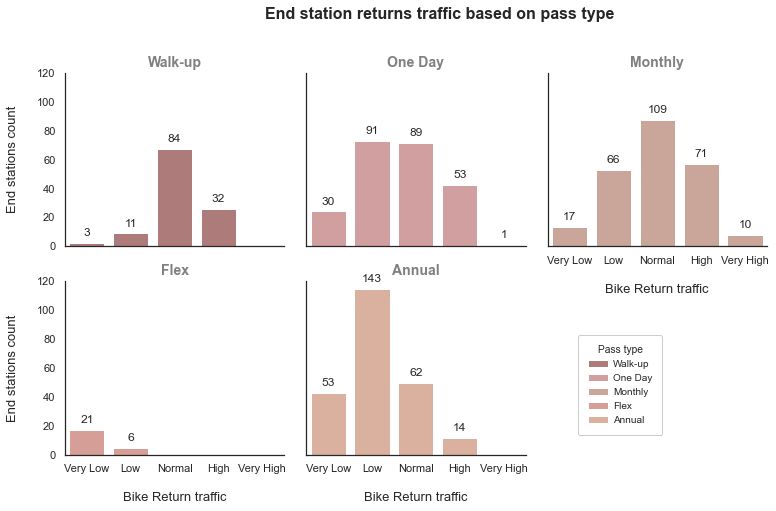

In [229]:
# Assign palette as per requirement
sb.set_style('white')
flatui = ['indianred', 'lightcoral', 'darksalmon', 'salmon', 'lightsalmon']
sb.set_palette(flatui, n_colors=5, desat=0.6)

# plot Facet Grid
g = sb.FacetGrid(data = category, col = 'pass_type', col_wrap = 3, height = 3.5, aspect = 1, hue = 'pass_type')
g.map(sb.countplot, 'traffic', order = category.traffic.sort_values(ascending=True).unique())
g.fig.subplots_adjust(top=0.8)
g.fig.suptitle('End station returns traffic based on pass type\n', fontsize = 16, weight = 'bold')
g.set_titles('{col_name}', weight = 'bold', size = 14, color = 'grey')

# obtain the ticks and store them as a list
y_tick_names = []
x_tick_names = []
for ax in g.axes.flat:
    for y_label in ax.get_yticklabels():
        y_label_value = int(y_label.get_text())
        y_label_new_value = '{:0.0f}'.format(y_label_value)
        y_tick_names.append(y_label_new_value)
        
    for x_label in ax.get_xticklabels():
        x_label_value = x_label.get_text()
        x_tick_names.append(x_label_value)

# improve plot aesthetics
g.set_yticklabels(y_tick_names, size = 11)
g.set_xticklabels(x_tick_names, size = 11)
g.set_xlabels('\nBike Return traffic', size = 13)
g.set_ylabels('End stations count\n', size = 13)
g.add_legend(bbox_to_anchor=(0.8, 0.25), scatterpoints=1,frameon=True, fancybox=True, 
             shadow=False, framealpha = 1, borderpad=1, borderaxespad=1, labelspacing=0.5, 
             ncol = 1, title='Pass type', title_fontsize=14, fontsize=10, facecolor='white', 
             markerfirst=True, handlelength=2, handletextpad=0.5);

# add annotations
for ax in g.axes.ravel(): #this will loop over the different figures in the grid 
    for p in ax.patches: #this will loop over the different bars in each figure 
        ax.annotate(format(p.get_height(), '.0f'), (p.get_x() + p.get_width() / 2., p.get_height()), 
                    ha = 'center', va = 'center', xytext = (0, 10), textcoords = 'offset points')

plt.subplots_adjust(top=0.85)
plt.subplots_adjust(wspace=0.1, hspace=0.2);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.11.e Facet grid classification of End stations Return traffic based on pass type.png', dpi=300, bbox_inches='tight')

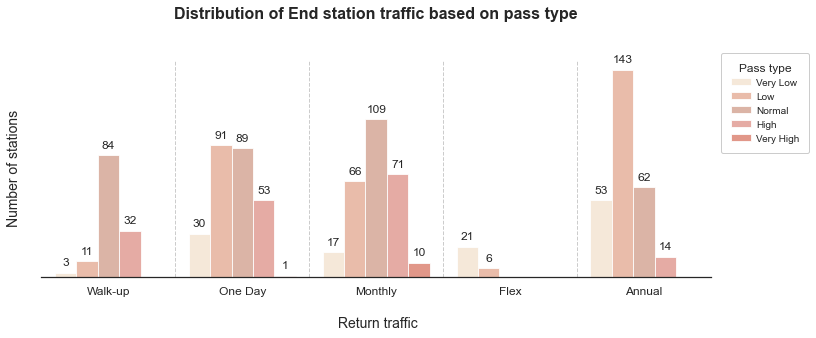

In [230]:
# Assign palette as per requirement
sb.set_style('white')
flatui = ['bisque', 'lightsalmon', 'darksalmon', 'salmon', 'tomato']
sb.set_palette(flatui, n_colors=5, desat=0.6)
plt.figure(figsize = [12, 4])

# plot clustered bar chart
g = sb.countplot(data = category, x = 'pass_type', hue = 'traffic', alpha = 0.8, saturation = 1)

# improve plot aesthetics
plt.title('Distribution of End station traffic based on pass type\n\n', fontsize = 16, weight = 'bold')
plt.xlabel('\n Return traffic', fontsize = 14)
plt.ylabel('Number of stations\n', fontsize = 14)
plt.yticks([], fontsize = 12)
plt.xticks(fontsize = 12)
sb.despine(left=True)

# plot legend
plt.legend(scatterpoints=1, frameon=True, fancybox=True, shadow=False, ncol = 1, framealpha = 1, 
           borderpad=1, borderaxespad=1, bbox_to_anchor = (1, 0.8), loc = 6, labelspacing=0.5,  
           title='Pass type', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5)

# add annotations
# -------------------------------------------------------
for p in g.patches:
    g.annotate(format(p.get_height(), '.0f'), (p.get_x() + p.get_width() / 2., p.get_height()), 
               ha = 'center', va = 'center', xytext = (0, 10), textcoords = 'offset points')
# -------------------------------------------------------

separators = [0.5, 1.5, 2.5, 3.5]
for loc in separators:
    plt.axvline(loc, ls='--', color='grey', linewidth=1, alpha=0.4);
    
# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.11.f Distribution of End stations Return traffic based on pass type.png', dpi=300, bbox_inches='tight')

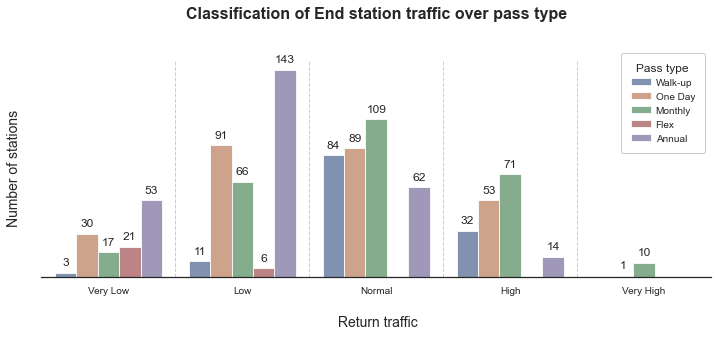

In [231]:
# Assign palette as per requirement
sb.set_style('white')
flatui = ['indianred', 'lightcoral', 'darksalmon', 'salmon', 'lightsalmon']
sb.set_palette('deep', n_colors=5, desat=0.6)
plt.figure(figsize = [12, 4])

# plot clustered bar chart
g = sb.countplot(data = category, x = 'traffic', hue = 'pass_type', alpha = 0.8, saturation = 1)

# improve plot aesthetics
plt.title('Classification of End station traffic over pass type\n\n', fontsize = 16, weight = 'bold')
plt.xlabel('\n Return traffic', fontsize = 14)
plt.ylabel('Number of stations\n', fontsize = 14)
plt.yticks([], fontsize = 10)
plt.xticks(fontsize = 10)
sb.despine(left=True)

# plot legend
plt.legend(scatterpoints=1, frameon=True, fancybox=True, shadow=False, ncol = 1, framealpha = 1, 
           borderpad=1, borderaxespad=1, bbox_to_anchor = (0.85, 0.8), loc = 6, labelspacing=0.5,  
           title='Pass type', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5)

# add annotations
# -------------------------------------------------------
for p in g.patches:
    g.annotate(format(p.get_height(), '.0f'), (p.get_x() + p.get_width() / 2., p.get_height()), 
               ha = 'center', va = 'center', xytext = (0, 10), textcoords = 'offset points')
# -------------------------------------------------------

separators = [0.5, 1.5, 2.5, 3.5]
for loc in separators:
    plt.axvline(loc, ls='--', color='grey', linewidth=1, alpha=0.4);
    
# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.11.g Classification of End stations Return traffic based on pass type.png', dpi=300, bbox_inches='tight')

----

#### 3.2.12 Bivariate analysis of `end_station_id` and `fare_type` columns:

+ `Column`: start_station_id, start_station_id
+ `Data type`: numerical data, continuous
+ `Plot` : Scatter plot

**Distribution of `end_stations` rental traffic based on `fare_type`.**

In [232]:
end_stations = bikeshare.groupby([bikeshare['end_station_id'], 
                                  bikeshare['fare_type']]).size().reset_index(name='returns')
end_stations.head()

,end_station_id,fare_type,returns
0,3005,Base,35569
1,3005,Extended,3070
2,3006,Base,15186
3,3006,Extended,1244
4,3007,Base,10932


> calculate max value of the count to estimate bin size of the preceeding plot

In [233]:
end_stations['returns'].describe()

count      549.000000
mean      1472.839709
std       3676.672862
min          1.000000
25%         50.000000
50%        213.000000
75%       1086.000000
max      35569.000000
Name: returns, dtype: float64

> As the max value is around `36000`, let the bin size be `1000`.

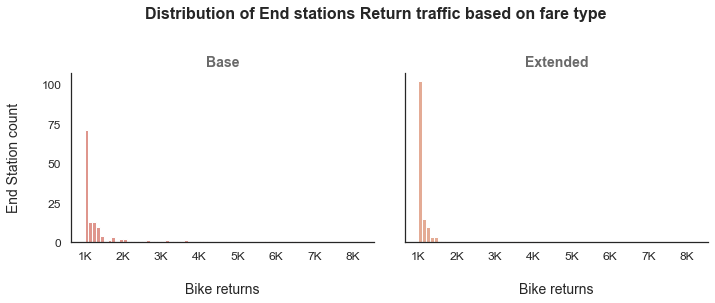

In [234]:
# Assign palette as per requirement
sb.set_style('white')
flatui = ['salmon', 'lightsalmon']
sb.set_palette(flatui, n_colors=2, desat=0.6)

# prepare data for plotting
max_value = end_stations['returns'].max()
bin_edges = np.arange(0, max_value+500, 500)
tick_locs = np.arange(0, max_value+1, 1)

# plot facet grid
g = sb.FacetGrid(data = end_stations, col = 'fare_type', col_wrap = 2, height = 4, aspect = 1.2, hue = 'fare_type')
g.map(plt.hist, "returns", bins = bin_edges)

g.fig.subplots_adjust(top=0.75)
g.fig.suptitle('Distribution of End stations Return traffic based on fare type\n', fontsize = 16, weight = 'bold')
g.set_titles('{col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# improve plot aesthetics
x_tick_max = (max_value/1000)
x_tick_locs = np.arange(0, x_tick_max+1, 1)
x_tick_names = ['{:0.0f}K'.format(loc) for loc in x_tick_locs]
g.set_xticklabels(x_tick_names, size=12)
g.set_yticklabels(size = 12)
g.set_xlabels('\nBike returns', size = 14)
g.set_ylabels('End Station count\n', size = 14)
plt.subplots_adjust(wspace=0.1, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.12.a Distribution of End stations Return traffic based on fare type.png', dpi=300, bbox_inches='tight')

> This data in their natural units, looks `highly right skewed`: lots of points with low values, with a very long tail of data points with large values (also all values are `positive`). The most common example of this is, the data that follows an approximately `log-normal distribution`. This is data that, in their natural units, can look highly skewed. However, after applying a logarithmic transform to the data, the data will follow a `normal distribution`. Hence let us apply `logarithmic transformation` to the start station's bike rental data.

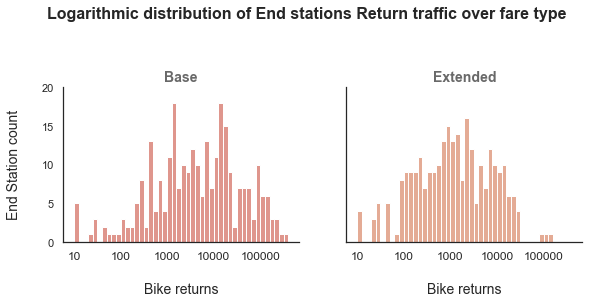

In [235]:
def log_trans(x, inverse = False):
    if not inverse:
        return np.log10(x)
    else:
        return 10 ** x

    
# Assign palette as per requirement
sb.set_style('white')
flatui = ['salmon', 'lightsalmon']
sb.set_palette(flatui, desat = 0.6)

# prepare data for plotting
end_stations['log_count'] = end_stations['returns'].apply(log_trans)
min_value = log_trans(end_stations['returns'].min())
max_value = log_trans(end_stations['returns'].max())
bin_edges = np.arange(0, max_value+0.1, 0.1)
tick_locs = np.arange(0, max_value+1, 1)

# plot facet grid
g = sb.FacetGrid(data = end_stations, col = 'fare_type', col_wrap = 2, height = 4, aspect = 1, hue = 'fare_type')
g.map(plt.hist, "log_count", bins = bin_edges)
g.fig.subplots_adjust(top=0.7)
g.fig.suptitle('Logarithmic distribution of End stations Return traffic over fare type\n', fontsize = 16, weight = 'bold')
g.set_titles('{col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# improve plot aesthetics
x_tick_names = log_trans(tick_locs, inverse = True).astype(int)
g.set_xticklabels(x_tick_names, size = 12)
g.set(yticks=[0, 5, 10, 15, 20])
g.set_xlabels('\nBike returns', size = 14)
g.set_ylabels('End Station count\n', size = 14)
plt.subplots_adjust(wspace=0.2, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.12.b Logarithmic distribution of End stations Return traffic based on fare type.png', dpi=300, bbox_inches='tight')

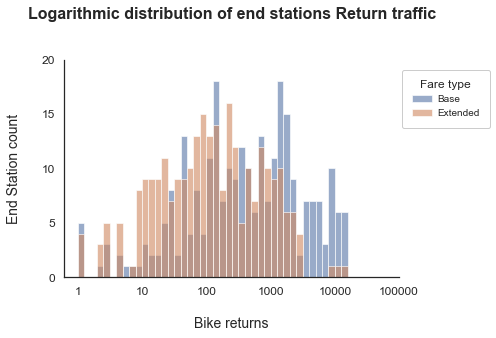

In [236]:
def log_trans(x, inverse = False):
    if not inverse:
        return np.log10(x)
    else:
        return 10 ** x

    
# Assign palette as per requirement
sb.set_style('white')
sb.set_palette('deep', desat = 0.8)

min_value = log_trans(end_stations[end_stations['fare_type'] == "Extended"]['returns'].min())
max_value = log_trans(end_stations[end_stations['fare_type'] == "Extended"]['returns'].max())
bin_edges = np.arange(0, max_value+0.1, 0.1)
plt.hist(end_stations[end_stations['fare_type'] == "Base"]['returns'].apply(log_trans), 
         bins = bin_edges, color = sb.color_palette()[0], alpha=0.6, label = 'Base')
plt.hist(end_stations[end_stations['fare_type'] == "Extended"]['returns'].apply(log_trans), 
         bins = bin_edges, color = sb.color_palette()[1], alpha=0.6, label = 'Extended')
tick_locs = np.arange(0, max_value+1, 1)
plt.xticks(tick_locs, log_trans(tick_locs, inverse = True).astype(int), fontsize = 12)
plt.yticks(fontsize = 12)
plt.xlabel('\nBike returns', fontsize = 14)
plt.ylabel('End Station count\n', fontsize = 14)
plt.title('Logarithmic distribution of end stations Return traffic\n\n', fontsize = 16, weight = 'bold')

# obtain y_ticks and convert them to integers
y_locs, y_labels = plt.yticks()
y_tick_max = int(max(y_locs))
y_tick_locs = np.arange(0, y_tick_max+5, 5)
y_tick_names = ['{:0.0f}'.format(y_loc) for y_loc in y_tick_locs]
plt.yticks(y_tick_locs, y_tick_names, size = 12)

plt.legend(bbox_to_anchor=(1.3, 1), scatterpoints=1,frameon=True, fancybox=True, 
           shadow=False, framealpha = 1, borderpad=1, borderaxespad=1, labelspacing=0.5, 
           ncol = 1, title='Fare type', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5, loc = 'upper right')
sb.despine();

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.12.c Logarithmic distribution of End stations Return traffic based on fare type.png', dpi=300, bbox_inches='tight')

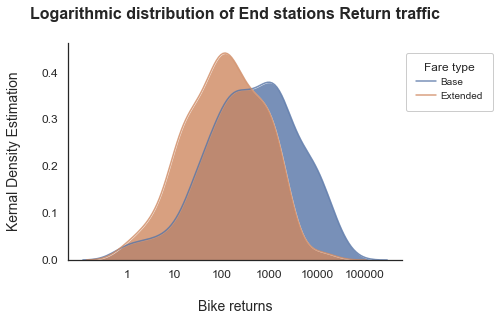

In [237]:
def log_trans(x, inverse = False):
    if not inverse:
        return np.log10(x)
    else:
        return 10 ** x

    
# Assign palette as per requirement
sb.set_style('white')
sb.set_palette('deep', desat = 0.8)

min_value = log_trans(end_stations[end_stations['fare_type'] == "Base"]['returns'].min())
max_value = log_trans(end_stations[end_stations['fare_type'] == "Base"]['returns'].max())
bin_edges = np.arange(0, max_value+0.1, 0.1)

sb.distplot(end_stations[end_stations['fare_type'] == "Base"]['returns'].apply(log_trans), 
            bins = bin_edges, kde = True, kde_kws = {'alpha' :0.8, "shade": True}, 
            color = sb.color_palette()[0], label = 'Base', hist=False)
sb.distplot(end_stations[end_stations['fare_type'] == "Extended"]['returns'].apply(log_trans), 
            bins = bin_edges, kde = True, kde_kws = {'alpha' :0.8, "shade": True}, 
            color = sb.color_palette()[1], label = 'Extended', hist=False)
tick_locs = np.arange(0, max_value+1, 1)
plt.xticks(tick_locs, log_trans(tick_locs, inverse = True).astype(int), fontsize = 12)
plt.yticks(fontsize = 12)
plt.xlabel('\nBike returns', fontsize = 14)
plt.ylabel('Kernal Density Estimation\n', fontsize = 14)
plt.title('Logarithmic distribution of End stations Return traffic\n', fontsize = 16, weight = 'bold')

plt.legend(bbox_to_anchor=(1.3, 1), scatterpoints=1,frameon=True, fancybox=True, 
           shadow=False, framealpha = 1, borderpad=1, borderaxespad=1, labelspacing=0.5, 
           ncol = 1, title='Fare type', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5, loc = 'upper right');
sb.despine();

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.12.d Kernal Density Estimation of End stations Return traffic based on fare type.png', dpi=300, bbox_inches='tight')

In [238]:
bin = [0,10,100,1000,10000,100000]
#use pd.cut function can attribute the values into its specific bins
category = pd.cut(end_stations['returns'],bin)
category = category.to_frame()
category.columns = ['return_bins']
category['fare_type'] = end_stations['fare_type']
category['end_station_id'] = end_stations['end_station_id']
category = category.reindex(columns=['end_station_id', 'fare_type', 'return_bins'])
category.head()

,end_station_id,fare_type,return_bins
0,3005,Base,"(10000, 100000]"
1,3005,Extended,"(1000, 10000]"
2,3006,Base,"(10000, 100000]"
3,3006,Extended,"(1000, 10000]"
4,3007,Base,"(10000, 100000]"


In [239]:
category.return_bins.sort_values(ascending=True).unique()

[(0, 10], (10, 100], (100, 1000], (1000, 10000], (10000, 100000]]
Categories (5, interval[int64]): [(0, 10] < (10, 100] < (100, 1000] < (1000, 10000] < (10000, 100000]]

In [240]:
%%time

def assign_traffic(df):
    df.loc[df['return_bins'] == df.return_bins.sort_values(ascending=True).unique()[0],'traffic'] = 'Very Low'
    df.loc[df['return_bins'] == df.return_bins.sort_values(ascending=True).unique()[1],'traffic'] = 'Low'
    df.loc[df['return_bins'] == df.return_bins.sort_values(ascending=True).unique()[2],'traffic'] = 'Normal'
    df.loc[df['return_bins'] == df.return_bins.sort_values(ascending=True).unique()[3],'traffic'] = 'High'
    df.loc[df['return_bins'] == df.return_bins.sort_values(ascending=True).unique()[4],'traffic'] = 'Very High'
    
df = category
assign_traffic(df)

# convert the 'traffic' column to ordered categorical datatype
level_order = ['Very Low', 'Low', 'Normal', 'High', 'Very High']
ordered_cat = pd.api.types.CategoricalDtype(ordered = True, categories = level_order)
df['traffic'] = df['traffic'].astype(ordered_cat)

category.traffic.value_counts()

Wall time: 38 ms


Normal       210
Low          150
High         125
Very Low      42
Very High     22
Name: traffic, dtype: int64

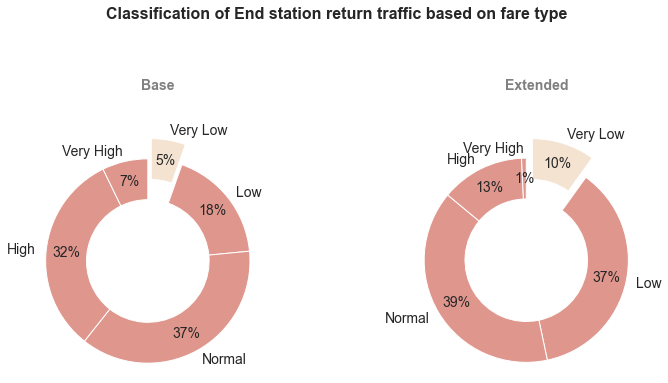

In [241]:
def plot_pie(cat_type):
    df = category[category['fare_type'] == cat_type]
    subdf = df.groupby([df['traffic']]).size().reset_index(name='stations')
    df_to_plot = subdf.loc[lambda df_to_plot: subdf['stations'] != 0]
    type_level_counts = df_to_plot.stations
    type_level_index = df_to_plot.traffic.sort_values(ascending=True).unique()
    clrs = [sb.color_palette()[1], 
            sb.color_palette()[0], 
            sb.color_palette()[0], 
            sb.color_palette()[0], 
            sb.color_palette()[0]]
    explode = [ 0.2, 0, 0, 0, 0 ]
    plt.pie(type_level_counts, labels = type_level_index, startangle = 90,
            counterclock = False, wedgeprops = {'width' : 0.4}, shadow=False, 
            explode=explode[0:len(type_level_index)], colors=clrs[0:len(type_level_index)], 
            textprops={'fontsize': 14}, autopct='%1.0f%%', labeldistance=1.1, pctdistance=0.8)
    plt.title(cat_type+ '\n\n', weight='bold', color='grey', fontsize=14)
    plt.axis('square');

    
# Assign palette as per requirement
sb.set_style('white')
flatui = ['salmon', 'bisque']
sb.set_palette(flatui, desat = 0.6)

Ncount = len(category.fare_type.unique())
types = category.fare_type.unique()
plt.figure(figsize = [12, 6])

# subplot 
plt.subplot(1, 2, 1)
plot_pie('Base')
# subplot 
plt.subplot(1, 2, 2)
plot_pie('Extended')

plt.suptitle('Classification of End station return traffic based on fare type', fontsize = 16, weight = 'bold')
plt.subplots_adjust(top=0.7)
plt.subplots_adjust(wspace=0.3, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.12.e Pie chart classification of End stations Return traffic based on fare type.png', dpi=300, bbox_inches='tight')

<Figure size 432x288 with 0 Axes>

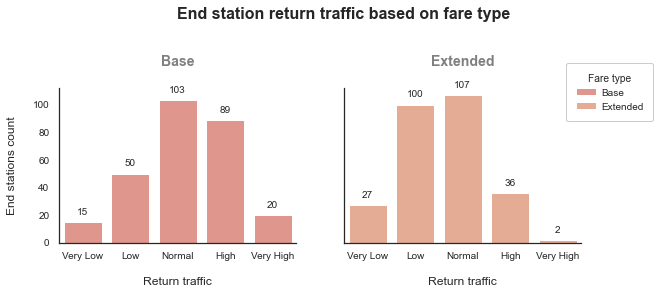

In [242]:
# Assign palette as per requirement
sb.set_style('white')
flatui = ['salmon', 'lightsalmon']
sb.set_palette(flatui, desat = 0.8)
plt.figure(figsize = [6, 4])

# plot Facet Grid
g = sb.FacetGrid(data = category, col = 'fare_type', col_wrap = 2, height = 4, aspect = 1, hue = 'fare_type')
g.map(sb.countplot, 'traffic', order = category.traffic.sort_values(ascending=True).unique())
g.fig.subplots_adjust(top=0.8)
g.fig.suptitle('End station return traffic based on fare type\n', fontsize = 16, weight = 'bold')
g.set_titles('{col_name}\n', weight = 'bold', size = 14, color = 'grey')

# improve plot aesthetics
g.set_yticklabels(size = 10)
g.set_xticklabels(size = 10)
g.set_xlabels('\nReturn traffic', size = 12)
g.set_ylabels('End stations count\n', size = 12)
g.add_legend(bbox_to_anchor=(1, 0.7), scatterpoints=1,frameon=True, fancybox=True, 
             shadow=False, framealpha = 1, borderpad=1, borderaxespad=1, labelspacing=0.5, 
             ncol = 1, title='Fare type', title_fontsize=12, fontsize=10, facecolor='white', 
             markerfirst=True, handlelength=2, handletextpad=0.5);

plt.subplots_adjust(top=0.7)
plt.subplots_adjust(wspace=0.2, hspace=0.3)

# add annotations
for ax in g.axes.ravel(): #this will loop over the different figures in the grid 
    for p in ax.patches: #this will loop over the different bars in each figure 
        ax.annotate(format(p.get_height(), '.0f'), (p.get_x() + p.get_width() / 2., p.get_height()), 
                    ha = 'center', va = 'center', xytext = (0, 10), textcoords = 'offset points', fontsize=10);
        
# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.12.f Facet grid classification of End stations Return traffic based on fare type.png', dpi=300, bbox_inches='tight')

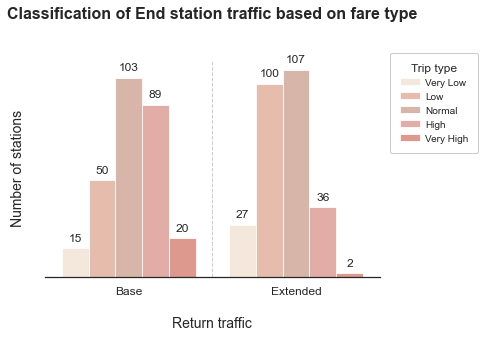

In [243]:
# Assign palette as per requirement
sb.set_style('white')
flatui = ['bisque', 'lightsalmon', 'darksalmon', 'salmon', 'tomato']
sb.set_palette(flatui, n_colors=5, desat=0.6)
plt.figure(figsize = [6, 4])

# plot clustered bar chart
g = sb.countplot(data = category, x = 'fare_type', hue = 'traffic', alpha = 0.8, saturation = 0.9)

# improve plot aesthetics
plt.title('Classification of End station traffic based on fare type\n\n', fontsize = 16, weight = 'bold')
plt.xlabel('\nReturn traffic', fontsize = 14)
plt.ylabel('Number of stations\n', fontsize = 14)
plt.yticks([], fontsize = 12)
plt.xticks(fontsize = 12)
sb.despine(left=True)

# plot legend
plt.legend(scatterpoints=1, frameon=True, fancybox=True, shadow=False, ncol = 1, framealpha = 1, 
           borderpad=1, borderaxespad=1, bbox_to_anchor = (1, 0.8), loc = 6, labelspacing=0.5,  
           title='Trip type', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5)

# add annotations
# -------------------------------------------------------
for p in g.patches:
    g.annotate(format(p.get_height(), '.0f'), (p.get_x() + p.get_width() / 2., p.get_height()), 
               ha = 'center', va = 'center', xytext = (0, 10), textcoords = 'offset points')
# -------------------------------------------------------

separators = [0.5, 1.5]
for loc in separators:
    plt.axvline(loc, ls='--', color='grey', linewidth=1, alpha=0.4);
    
# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.12.g Distribution of End stations Return traffic based on fare type.png', dpi=300, bbox_inches='tight')

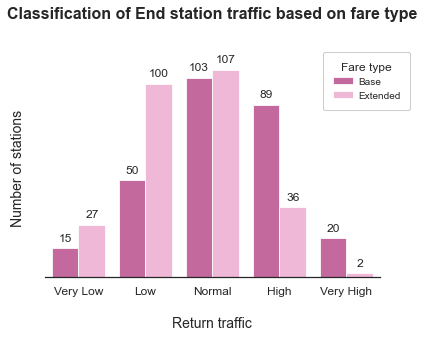

In [244]:
# Assign palette as per requirement
sb.set_style('white')
flatui = ['#cc2e88', '#fa98d0']
# flatui = ['#fcd605', '#fae887']
sb.set_palette(flatui, desat = 0.8)
plt.figure(figsize = [6, 4])

# plot clustered bar chart
g = sb.countplot(data = category, x = 'traffic', hue = 'fare_type', alpha = 0.8, saturation = 0.9)

# improve plot aesthetics
plt.title('Classification of End station traffic based on fare type\n\n', fontsize = 16, weight = 'bold')
plt.xlabel('\nReturn traffic', fontsize = 14)
plt.ylabel('Number of stations\n', fontsize = 14)
plt.yticks([], fontsize = 12)
plt.xticks(fontsize = 12)
sb.despine(left=True)

# plot legend
plt.legend(scatterpoints=1, frameon=True, fancybox=True, shadow=False, ncol = 1, framealpha = 1, 
           borderpad=1, borderaxespad=1, bbox_to_anchor = (0.8, 0.9), loc = 6, labelspacing=0.5,  
           title='Fare type', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5)

# add annotations
for p in g.patches:
    g.annotate(format(p.get_height(), '.0f'), (p.get_x() + p.get_width() / 2., p.get_height()), 
               ha = 'center', va = 'center', xytext = (0, 10), textcoords = 'offset points')

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.12.h Classification of End stations Return traffic based on fare type.png', dpi=300, bbox_inches='tight')

-----

#### 3.2.13 Bivariate analysis of `trip_type` and `bike_type` columns:

+ `Columns`: bike_type, trip_type
+ `Data type`: Categorical, nominal
+ `Plot` : Clustered Bar chart, Heatmap

**`Clustered Bar chart:`**

> To depict the relationship between two categorical variables, we can extend the univariate bar chart into a `clustered bar chart`. In a clustered bar chart, bars are organized into `clusters` based on levels of the `first variable`, and then bars are `ordered` consistently across the `second variable` within each `cluster`.

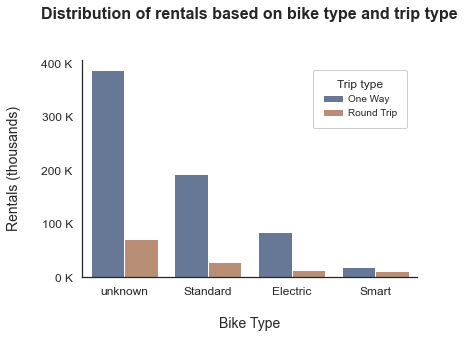

In [245]:
# set the palette as per requirement
sb.set_palette(palette = "deep", n_colors = 5, desat = 0.6)
current_palette = sb.color_palette()
sb.set_style('white')

plt.figure(figsize = [6, 4])
max_count = bikeshare.groupby([bikeshare['bike_type'], 
                   bikeshare['trip_type']]).count()[['trip_id']].reset_index().rename(columns=
                                                                                      {'trip_id':'count'})['count'].max()
y_tick_values = np.arange(0, max_count + 100000, 100000)
y_tick_names = ['{:0.0f} K'.format(v/1000) for v in y_tick_values]

sb.countplot(data = bikeshare, x = 'bike_type', hue = 'trip_type', saturation = 0.8)
plt.title('Distribution of rentals based on bike type and trip type\n\n', weight = 'bold', fontsize = 16)
plt.xticks(fontsize=12)
plt.yticks(y_tick_values, y_tick_names, fontsize=12)
plt.xlabel('\nBike Type', fontsize=14)
plt.ylabel('Rentals (thousands)\n', fontsize=14)
plt.legend(scatterpoints=1, frameon=True, fancybox=True, shadow=False, ncol = 1, framealpha = 1, 
           borderpad=1, borderaxespad=1, loc = 'upper right', labelspacing=0.5,  
           title='Trip type', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5)
sb.despine();

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.13.a Distribution of rentals based on bike type and trip type.png', dpi=300, bbox_inches='tight')

**`Facet Grid:`**

> One general visualization technique that will be useful for you to know about to handle plots of two or more variables is `faceting`. In faceting, the data is divided into disjoint subsets, most often by different levels of a categorical variable. For each of these subsets of the data, the same plot type is rendered on other variables. Faceting is a way of comparing distributions or relationships across levels of additional variables, especially when there are three or more variables of interest overall.

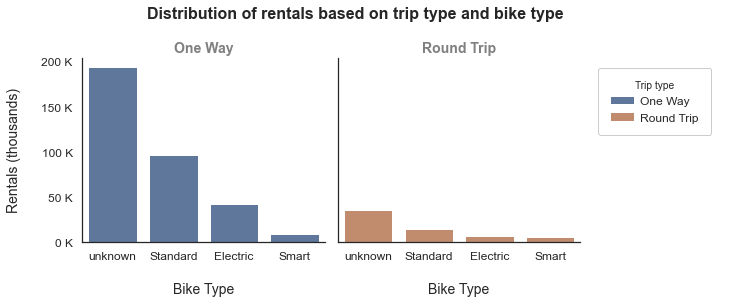

In [246]:
sb.set_style('white')
sb.set_palette(palette = "deep", n_colors = 5, desat = 0.8)

max_count = bikeshare.groupby([bikeshare['bike_type'], 
                               bikeshare['trip_type']]).count()[['trip_id']].reset_index().rename(columns=
                                                                                                  {'trip_id':'count'})['count'].max()

# plot Facet Grid
g = sb.FacetGrid(data = bikeshare, col = 'trip_type', col_wrap = 2, height = 4, aspect = 1, hue = 'trip_type')
g.map(sb.countplot, 'bike_type', order=bikeshare['bike_type'].value_counts().index)
g.fig.subplots_adjust(top=0.8)
g.fig.suptitle('Distribution of rentals based on trip type and bike type\n\n', fontsize = 16, weight = 'bold')
g.set_titles('{col_name}', weight = 'bold', size = 14, color = 'grey')

# obtain y_ticks and convert them to a multiple of thousands
y_tick_names = []
for ax in g.axes.flat:
    for label in ax.get_yticklabels():
        label_value = int(label.get_text())
        label_value = '{:0.0f} K'.format(label_value/1000)
        y_tick_names.append(label_value)
        
g.set_yticklabels(y_tick_names, size = 12)
g.set_xticklabels(size = 12)
g.set_xlabels('\nBike Type', size = 14)
g.set_ylabels('Rentals (thousands)\n', size = 14)
g.add_legend(bbox_to_anchor=(1.05, 0.7), scatterpoints=1,frameon=True, fancybox=True, 
             shadow=False, framealpha = 1, borderpad=1, borderaxespad=1, labelspacing=0.5, 
             ncol = 1, title='Trip type', title_fontsize=14, fontsize=12, facecolor='white', 
             markerfirst=True, handlelength=2, handletextpad=0.5);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.13.b Facet Grid of rentals based on bike type and trip type.png', dpi=300, bbox_inches='tight')

**`Heat Map:`**

One alternative way of depicting the relationship between two categorical variables is through a **Heat map**. Heat maps were introduced earlier as the 2-d version of a histogram; here, we're using them as the 2-d version of a bar chart. The seaborn function `heatmap` is at home with this type of heat map implementation, but the input arguments are unlike most of the visualization functions. Instead of providing the original dataframe, we need to summarize the counts into a matrix that will then be plotted.

> The data needs some summirization by grouping together the respective variables.

In [253]:
bikeshare.groupby(['bike_type', 'trip_type']).size().reset_index(name='count')[['count']].sum()

count    808589
dtype: int64

In [254]:
categorical_counts = bikeshare.groupby(['bike_type', 'trip_type']).size()
categorical_counts

bike_type  trip_type 
unknown    One Way       387992
           Round Trip     70943
Standard   One Way       193343
           Round Trip     28800
Electric   One Way        84617
           Round Trip     12912
Smart      One Way        18315
           Round Trip     11667
dtype: int64

> Now, lets reset the index and name the summerized data values accordingly.

In [255]:
categorical_counts = categorical_counts.reset_index(name = 'count')
categorical_counts

,bike_type,trip_type,count
0,unknown,One Way,387992
1,unknown,Round Trip,70943
2,Standard,One Way,193343
3,Standard,Round Trip,28800
4,Electric,One Way,84617
5,Electric,Round Trip,12912
6,Smart,One Way,18315
7,Smart,Round Trip,11667


> Now lets make a pivot from the original dataset into a more appropriate data structure.

In [256]:
categorical_counts = categorical_counts.pivot(index = 'bike_type', columns = 'trip_type', values = 'count')
categorical_counts

trip_type,One Way,Round Trip
bike_type,,
unknown,387992,70943
Standard,193343,28800
Electric,84617,12912
Smart,18315,11667


> The data is ready to plot the `Heat map`.

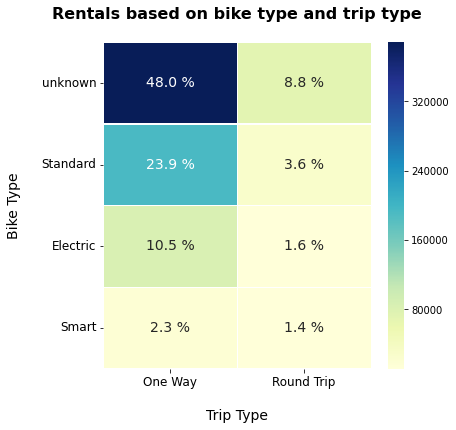

In [257]:
# plot heat map
plt.figure(figsize = [6, 6])
res = sb.heatmap(categorical_counts, annot = True, fmt = 'd', annot_kws={'size':14}, linewidths=0.1, cmap="YlGnBu")
plt.title('Rentals based on bike type and trip type\n', fontsize = 16, weight = 'bold')
plt.xlabel('\nTrip Type', fontsize=14)
plt.ylabel('Bike Type\n', fontsize=14)
plt.xticks(fontsize=12)
plt.yticks(rotation=0, fontsize=12, va="center");

# convert annotations to percentages
for t in res.texts: 
    p = np.round(np.round(int(t.get_text())/bikeshare.shape[0], 4)*100, 1)
    if p < 0.1:
        t.set_text('< 0.1 %')
    else:
        t.set_text('{} %'.format(p));
    
# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.13.c Distribution of bike rentals based on bike type and trip type.png', dpi=300, bbox_inches='tight')

--------

#### 3.2.14 Bivariate analysis of `trip_type` and `pass_type` columns:

+ `Columns`: pass_type, trip_type
+ `Data type`: Categorical, nominal
+ `Plot`: Clustered Bar chart, Heatmap

**`Clustered Bar chart:`**

> To depict the relationship between two categorical variables, we can extend the univariate bar chart into a `clustered bar chart`. In a clustered bar chart, bars are organized into `clusters` based on levels of the `first variable`, and then bars are `ordered` consistently across the `second variable` within each `cluster`.

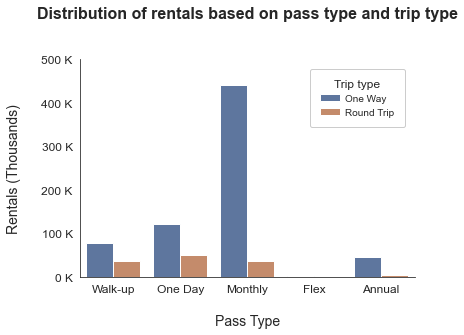

In [258]:
# set the palette as per requirement
sb.set_palette(palette = "deep", n_colors = 5, desat = 0.8)
current_palette = sb.color_palette()
sb.set_style('white')

plt.figure(figsize = [6, 4])
max_count = bikeshare.groupby([bikeshare['pass_type'], 
                               bikeshare['trip_type']]).count()[['trip_id']].reset_index().rename(columns=
                                                                                                  {'trip_id':'count'})['count'].max()
y_tick_values = np.arange(0, max_count + 100000, 100000)
y_tick_names = ['{:0.0f} K'.format(v/1000) for v in y_tick_values]

sb.countplot(data = bikeshare, x = 'pass_type', hue = 'trip_type', saturation = 0.8)
plt.title('Distribution of rentals based on pass type and trip type\n\n', fontsize = 16, weight = 'bold')
plt.xticks(fontsize=12)
plt.yticks(y_tick_values, y_tick_names, fontsize=12)
plt.xlabel('\nPass Type', fontsize=14)
plt.ylabel('Rentals (Thousands)\n', fontsize=14)
plt.legend(scatterpoints=1, frameon=True, fancybox=True, shadow=False, framealpha = 1, 
           borderpad=1, borderaxespad=1, loc = 'upper right', labelspacing=0.5, ncol = 1,  
           title='Trip type', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5)
sb.despine();

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.14.a Distribution of rentals based on pass type and trip type.png', dpi=300, bbox_inches='tight')

**`Facet Grid:`**

> One general visualization technique that will be useful for you to know about to handle plots of two or more variables is `faceting`. In faceting, the data is divided into disjoint subsets, most often by different levels of a categorical variable. For each of these subsets of the data, the same plot type is rendered on other variables. Faceting is a way of comparing distributions or relationships across levels of additional variables, especially when there are three or more variables of interest overall.

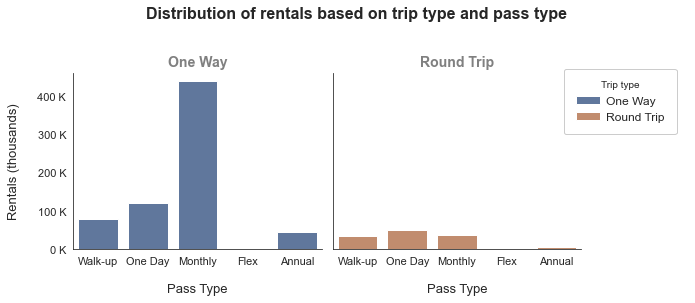

In [259]:
sb.set_style('white')
sb.set_palette(palette = "deep", n_colors = 5, desat = 0.8)

max_count = bikeshare.groupby([bikeshare['pass_type'], 
                               bikeshare['trip_type']]).count()[['trip_id']].reset_index().rename(columns=
                                                                                                  {'trip_id':'count'})['count'].max()
# y_tick_values = np.arange(0, max_count + 100000, 100000)
pass_order = bikeshare.pass_type.sort_values(ascending=True).unique()

# plot Facet Grid
g = sb.FacetGrid(data = bikeshare, col = 'trip_type', col_wrap = 2, height = 4, aspect = 1, hue = 'trip_type')
g.map(sb.countplot, 'pass_type', order = pass_order)
g.fig.subplots_adjust(top=0.75)
g.fig.suptitle('Distribution of rentals based on trip type and pass type\n\n', fontsize = 16, weight = 'bold')
g.set_titles('{col_name}', weight = 'bold', size = 14, color = 'grey')

# obtain y_ticks and convert them to a multiple of thousands
y_tick_names = []
for ax in g.axes.flat:
    for label in ax.get_yticklabels():
        label_value = int(label.get_text())
        label_value = '{:0.0f} K'.format(label_value/1000)
        y_tick_names.append(label_value)
        
g.set_yticklabels(y_tick_names, size = 11)
g.set_xticklabels(size = 11)
g.set_xlabels('\nPass Type', size = 13)
g.set_ylabels('Rentals (thousands)\n', size = 13)
g.add_legend(bbox_to_anchor=(1, 0.7), scatterpoints=1,frameon=True, fancybox=True, 
             shadow=False, framealpha = 1, borderpad=1, borderaxespad=1, labelspacing=0.5, 
             ncol = 1, title='Trip type', title_fontsize=14, fontsize=12, facecolor='white', 
             markerfirst=True, handlelength=2, handletextpad=0.5);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.14.b Facet Grid of rentals based on pass type and trip type.png', dpi=300, bbox_inches='tight')

**`Heat Map:`**

One alternative way of depicting the relationship between two categorical variables is through a **Heat map**. Heat maps were introduced earlier as the 2-d version of a histogram; here, we're using them as the 2-d version of a bar chart. The seaborn function `heatmap` is at home with this type of heat map implementation, but the input arguments are unlike most of the visualization functions. Instead of providing the original dataframe, we need to summarize the counts into a matrix that will then be plotted.

> The data needs some summirization by grouping together the respective variables.

In [260]:
categorical_counts = bikeshare.groupby(['pass_type', 'trip_type']).size()
categorical_counts

pass_type  trip_type 
Walk-up    One Way        77427
           Round Trip     34651
One Day    One Way       121081
           Round Trip     50111
Monthly    One Way       440163
           Round Trip     35503
Flex       One Way          228
           Round Trip        35
Annual     One Way        45368
           Round Trip      4022
dtype: int64

> Now, lets reset the index and name the summerized data values accordingly.

In [261]:
categorical_counts = categorical_counts.reset_index(name = 'count')
categorical_counts

,pass_type,trip_type,count
0,Walk-up,One Way,77427
1,Walk-up,Round Trip,34651
2,One Day,One Way,121081
3,One Day,Round Trip,50111
4,Monthly,One Way,440163
5,Monthly,Round Trip,35503
6,Flex,One Way,228
7,Flex,Round Trip,35
8,Annual,One Way,45368
9,Annual,Round Trip,4022


> Now lets make a pivot from the original dataset into a more appropriate data structure.

In [262]:
categorical_counts = categorical_counts.pivot(index = 'pass_type', columns = 'trip_type', values = 'count')
categorical_counts

trip_type,One Way,Round Trip
pass_type,,
Walk-up,77427,34651
One Day,121081,50111
Monthly,440163,35503
Flex,228,35
Annual,45368,4022


> The data is ready to plot the `Heat map`.

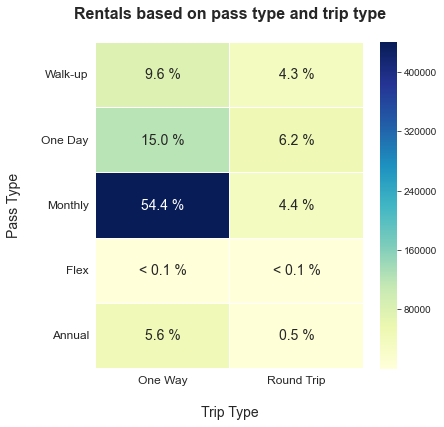

In [263]:
# plot heat map
plt.figure(figsize = [6, 6])
res = sb.heatmap(categorical_counts, annot = True, fmt = 'd', annot_kws={'size':14}, linewidths=0.1, cmap="YlGnBu")
plt.title('Rentals based on pass type and trip type\n', fontsize = 16, weight = 'bold')
plt.xlabel('\nTrip Type', fontsize=14)
plt.ylabel('Pass Type\n', fontsize=14)
plt.xticks(fontsize=12)
plt.yticks(rotation=0, fontsize=12, va="center")

# convert annotations to percentages
for t in res.texts: 
    p = np.round(np.round(int(t.get_text())/bikeshare.shape[0], 4)*100, 1)
    if p < 0.1:
        t.set_text('< 0.1 %')
    else:
        t.set_text('{} %'.format(p));
    
# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.14.c Distribution of rentals based on pass type and trip type.png', dpi=300, bbox_inches='tight')

------------

#### 3.2.15 Bivariate analysis of `bike_type` and `pass_type` columns:

+ `Columns`: pass_type, trip_type
+ `Data type`: Categorical, nominal
+ `Plot`: Clustered Bar chart, Heatmap

**`Clustered Bar chart:`**

> To depict the relationship between two categorical variables, we can extend the univariate bar chart into a `clustered bar chart`. In a clustered bar chart, bars are organized into `clusters` based on levels of the `first variable`, and then bars are `ordered` consistently across the `second variable` within each `cluster`.

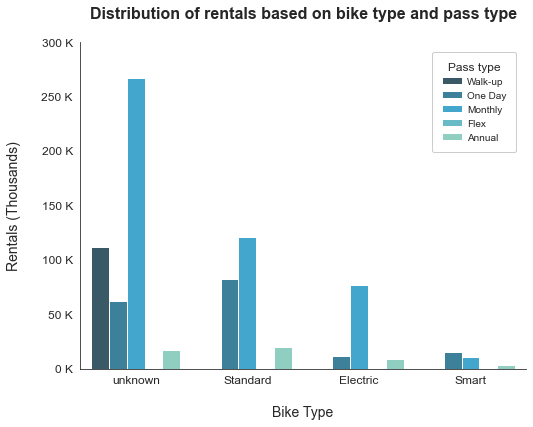

In [264]:
# set the palette as per requirement
sb.set_palette(palette = "GnBu_d", n_colors = 5, desat = None)
current_palette = sb.color_palette()
sb.set_style('white')

plt.figure(figsize = [8, 6])
max_count = bikeshare.groupby([bikeshare['bike_type'], 
                               bikeshare['pass_type']]).count()[['trip_id']].reset_index().rename(columns=
                                                                                                  {'trip_id':'count'})['count'].max()
y_tick_values = np.arange(0, max_count + 50000, 50000)
y_tick_names = ['{:0.0f} K'.format(v/1000) for v in y_tick_values]

sb.countplot(data = bikeshare, x = 'bike_type', hue = 'pass_type', saturation = 1)
plt.title('Distribution of rentals based on bike type and pass type\n', fontsize = 16, weight = 'bold')
plt.xticks(fontsize=12)
plt.yticks(y_tick_values, y_tick_names, fontsize=12)
plt.xlabel('\nBike Type', fontsize=14)
plt.ylabel('Rentals (Thousands)\n', fontsize=14)
plt.legend(scatterpoints=1, frameon=True, fancybox=True, shadow=False, framealpha = 1, 
           borderpad=1, borderaxespad=1, loc = 'upper right', labelspacing=0.5, ncol = 1,  
           title='Pass type', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5)
sb.despine();

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.15.a Distribution of rentals based on bike type and pass type.png', dpi=300, bbox_inches='tight')

**`Facet Grid:`**

> One general visualization technique that will be useful for you to know about to handle plots of two or more variables is `faceting`. In faceting, the data is divided into disjoint subsets, most often by different levels of a categorical variable. For each of these subsets of the data, the same plot type is rendered on other variables. Faceting is a way of comparing distributions or relationships across levels of additional variables, especially when there are three or more variables of interest overall.

C:\Users\VAMSHI-KRISHNA-PRIME\Anaconda3\lib\site-packages\seaborn\axisgrid.py:715: UserWarning: Using the countplot function without specifying `order` is likely to produce an incorrect plot.
  warnings.warn(warning)


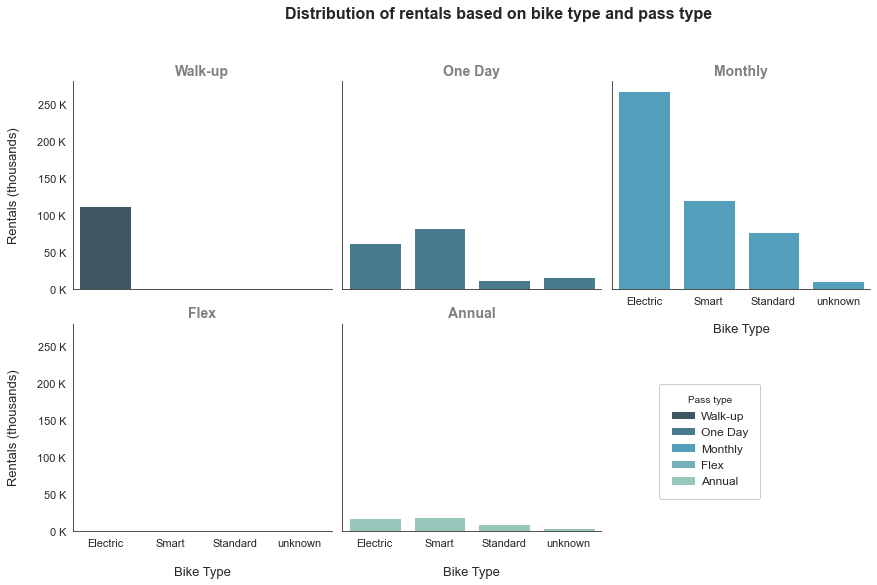

In [265]:
sb.set_style('white')
sb.set_palette(palette = "GnBu_d", n_colors = 5, desat = None)

max_count = bikeshare.groupby([bikeshare['bike_type'], 
                               bikeshare['pass_type']]).count()[['trip_id']].reset_index().rename(columns=
                                                                                                  {'trip_id':'count'})['count'].max()
x_tick_names = ['Electric', 'Smart', 'Standard', 'unknown']

# plot Facet Grid
g = sb.FacetGrid(data = bikeshare, col = 'pass_type', col_wrap = 3, height = 4, aspect = 1, hue = 'pass_type')
g.map(sb.countplot, 'bike_type')
g.fig.subplots_adjust(top=0.85)
g.fig.suptitle('Distribution of rentals based on bike type and pass type\n', fontsize = 16, weight = 'bold')
g.set_titles('{col_name}', weight = 'bold', size = 14, color = 'grey')

# obtain y_ticks and convert them to a multiple of thousands 
y_tick_names = []
for ax in g.axes.flat:
    for label in ax.get_yticklabels():
        label_value = int(label.get_text())
        label_value = '{:0.0f} K'.format(label_value/1000)
        y_tick_names.append(label_value)
        
g.set_yticklabels(y_tick_names, size = 11)
g.set_xticklabels(x_tick_names, size = 11)
g.set_xlabels('\nBike Type', size = 13)
g.set_ylabels('Rentals (thousands)\n', size = 13)
g.add_legend(bbox_to_anchor=(0.8, 0.25), scatterpoints=1,frameon=True, fancybox=True, 
             shadow=False, framealpha = 1, borderpad=1, borderaxespad=1, labelspacing=0.5, 
             ncol = 1, title='Pass type', title_fontsize=14, fontsize=12, facecolor='white', 
             markerfirst=True, handlelength=2, handletextpad=0.5);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.15.b Facet Grid of rentals based on bike type and pass type.png', dpi=300, bbox_inches='tight')

**`Heat Map:`**

One alternative way of depicting the relationship between two categorical variables is through a **Heat map**. Heat maps were introduced earlier as the 2-d version of a histogram; here, we're using them as the 2-d version of a bar chart. The seaborn function `heatmap` is at home with this type of heat map implementation, but the input arguments are unlike most of the visualization functions. Instead of providing the original dataframe, we need to summarize the counts into a matrix that will then be plotted.

> The data needs some summirization by grouping together the respective variables.

In [266]:
categorical_counts = bikeshare.groupby(['pass_type', 'bike_type']).size()
categorical_counts

pass_type  bike_type
Walk-up    unknown      112078
One Day    unknown       61903
           Standard      82092
           Electric      11559
           Smart         15638
Monthly    unknown      267390
           Standard     120611
           Electric      76830
           Smart         10835
Flex       unknown         238
           Standard         25
Annual     unknown       17326
           Standard      19415
           Electric       9140
           Smart          3509
dtype: int64

> Now, lets reset the index and name the summerized data values accordingly.

In [267]:
categorical_counts = categorical_counts.reset_index(name = 'count')
categorical_counts

,pass_type,bike_type,count
0,Walk-up,unknown,112078
1,One Day,unknown,61903
2,One Day,Standard,82092
3,One Day,Electric,11559
4,One Day,Smart,15638
5,Monthly,unknown,267390
6,Monthly,Standard,120611
7,Monthly,Electric,76830
8,Monthly,Smart,10835
9,Flex,unknown,238


> Now lets make a pivot from the original dataset into a more appropriate data structure.

In [268]:
categorical_counts = categorical_counts.pivot(index = 'pass_type', columns = 'bike_type', values = 'count')
categorical_counts

bike_type,unknown,Standard,Electric,Smart
pass_type,,,,
Walk-up,112078.0,NaN,NaN,NaN
One Day,61903.0,82092.0,11559.0,15638.0
Monthly,267390.0,120611.0,76830.0,10835.0
Flex,238.0,25.0,NaN,NaN
Annual,17326.0,19415.0,9140.0,3509.0


> The data is ready to plot the `Heat map`.

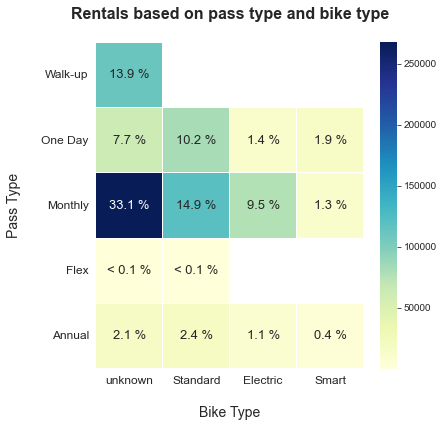

In [269]:
# plot heat map
plt.figure(figsize = [6, 6])
res = sb.heatmap(categorical_counts, annot = True, fmt = '.0f', annot_kws={'size':13}, linewidths=0.1, cmap="YlGnBu")
plt.title('Rentals based on pass type and bike type\n', fontsize = 16, weight = 'bold')
plt.xlabel('\nBike Type', fontsize=14)
plt.ylabel('Pass Type\n', fontsize=14)
plt.yticks(rotation=0, fontsize=12, va="center")
plt.xticks(fontsize=12);

# convert annotations to percentages
for t in res.texts: 
    p = np.round(np.round(int(t.get_text())/bikeshare.shape[0], 4)*100, 1)
    if p < 0.1:
        t.set_text('< 0.1 %')
    else:
        t.set_text('{} %'.format(p));

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.15.c Distribution of rentals based on pass type and bike type.png', dpi=300, bbox_inches='tight')

---------

#### 3.2.16 Bivariate analysis of `fare_type` and `trip_type` columns:

+ `Columns`: pass_type, trip_type
+ `Data type`: Categorical, nominal
+ `Plot`: Clustered Bar chart, Heatmap

**`Clustered Bar chart:`**

> To depict the relationship between two categorical variables, we can extend the univariate bar chart into a `clustered bar chart`. In a clustered bar chart, bars are organized into `clusters` based on levels of the `first variable`, and then bars are `ordered` consistently across the `second variable` within each `cluster`.

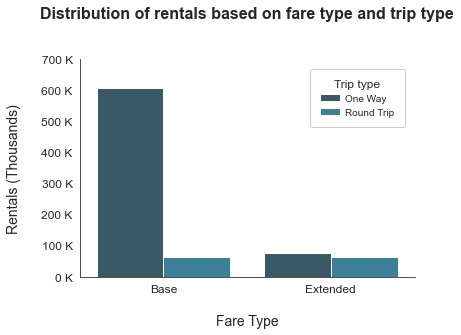

In [270]:
# set the palette as per requirement
sb.set_palette(palette = "GnBu_d", n_colors = 5, desat = None)
current_palette = sb.color_palette()
sb.set_style('white')

plt.figure(figsize = [6, 4])
max_count = bikeshare.groupby([bikeshare['fare_type'], 
                               bikeshare['trip_type']]).size().reset_index(name='count')['count'].max()
y_tick_values = np.arange(0, max_count + 100000, 100000)
y_tick_names = ['{:0.0f} K'.format(v/1000) for v in y_tick_values]

sb.countplot(data = bikeshare, x = 'fare_type', hue = 'trip_type', saturation = 1)
plt.title('Distribution of rentals based on fare type and trip type\n\n', fontsize = 16, weight = 'bold')
plt.xticks(fontsize=12)
plt.yticks(y_tick_values, y_tick_names, fontsize=12)
plt.xlabel('\nFare Type', fontsize=14)
plt.ylabel('Rentals (Thousands)\n', fontsize=14)
plt.legend(scatterpoints=1, frameon=True, fancybox=True, shadow=False, framealpha = 1, 
           borderpad=1, borderaxespad=1, loc = 'upper right', labelspacing=0.5, ncol = 1,  
           title='Trip type', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5)
sb.despine();

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.16.a Distribution of rentals based on bike type and pass type.png', dpi=300, bbox_inches='tight')

**`Facet Grid:`**

> One general visualization technique that will be useful for you to know about to handle plots of two or more variables is `faceting`. In faceting, the data is divided into disjoint subsets, most often by different levels of a categorical variable. For each of these subsets of the data, the same plot type is rendered on other variables. Faceting is a way of comparing distributions or relationships across levels of additional variables, especially when there are three or more variables of interest overall.

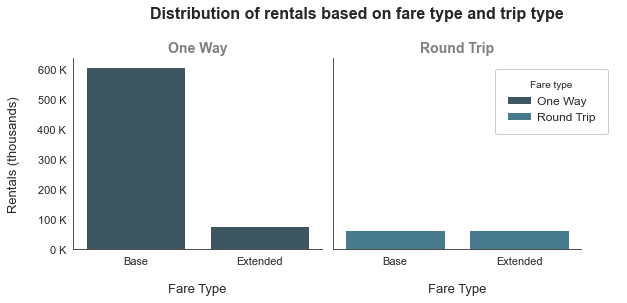

In [271]:
sb.set_style('white')
sb.set_palette(palette = "GnBu_d", n_colors = 5, desat = None)

max_count = bikeshare.groupby([bikeshare['fare_type'], 
                               bikeshare['trip_type']]).size().reset_index(name='count')['count'].max()

# plot Facet Grid
g = sb.FacetGrid(data = bikeshare, col = 'trip_type', col_wrap = 2, height = 4, aspect = 1, hue = 'trip_type')
g.map(sb.countplot, 'fare_type')
g.fig.subplots_adjust(top=0.8)
g.fig.suptitle('Distribution of rentals based on fare type and trip type\n', fontsize = 16, weight = 'bold')
g.set_titles('{col_name}', weight = 'bold', size = 14, color = 'grey')

# obtain y_ticks and convert them to a multiple of thousands 
y_tick_names = []
for ax in g.axes.flat:
    for label in ax.get_yticklabels():
        label_value = int(label.get_text())
        label_value = '{:0.0f} K'.format(label_value/1000)
        y_tick_names.append(label_value)
        
g.set_yticklabels(y_tick_names, size = 11)
g.set_xticklabels(size = 11)
g.set_xlabels('\nFare Type', size = 13)
g.set_ylabels('Rentals (thousands)\n', size = 13)
g.add_legend(bbox_to_anchor=(0.9, 0.7), scatterpoints=1,frameon=True, fancybox=True, 
             shadow=False, framealpha = 1, borderpad=1, borderaxespad=1, labelspacing=0.5, 
             ncol = 1, title='Fare type', title_fontsize=14, fontsize=12, facecolor='white', 
             markerfirst=True, handlelength=2, handletextpad=0.5);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.16.b Facet Grid of rentals based on bike type and pass type.png', dpi=300, bbox_inches='tight')

**`Heat Map:`**

One alternative way of depicting the relationship between two categorical variables is through a **Heat map**. Heat maps were introduced earlier as the 2-d version of a histogram; here, we're using them as the 2-d version of a bar chart. The seaborn function `heatmap` is at home with this type of heat map implementation, but the input arguments are unlike most of the visualization functions. Instead of providing the original dataframe, we need to summarize the counts into a matrix that will then be plotted.

> The data needs some summirization by grouping together the respective variables.

In [272]:
categorical_counts = bikeshare.groupby(['fare_type', 'trip_type']).size()
categorical_counts

fare_type  trip_type 
Base       One Way       606913
           Round Trip     61876
Extended   One Way        77354
           Round Trip     62446
dtype: int64

> Now, lets reset the index and name the summerized data values accordingly.

In [273]:
categorical_counts = categorical_counts.reset_index(name = 'count')
categorical_counts

,fare_type,trip_type,count
0,Base,One Way,606913
1,Base,Round Trip,61876
2,Extended,One Way,77354
3,Extended,Round Trip,62446


> Now lets make a pivot from the original dataset into a more appropriate data structure.

In [274]:
categorical_counts = categorical_counts.pivot(index = 'trip_type', columns = 'fare_type', values = 'count')
categorical_counts

fare_type,Base,Extended
trip_type,,
One Way,606913,77354
Round Trip,61876,62446


> The data is ready to plot the `Heat map`.

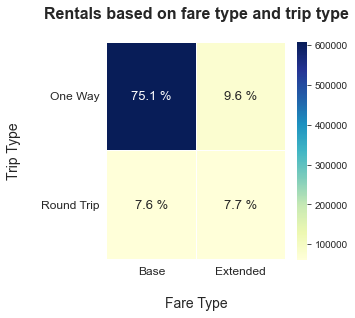

In [275]:
# plot heat map
plt.figure(figsize = [4, 4])
res = sb.heatmap(categorical_counts, annot = True, fmt = '.0f', annot_kws={'size':13}, linewidths=0.1, cmap="YlGnBu")
plt.title('Rentals based on fare type and trip type\n', fontsize = 16, weight = 'bold')
plt.xlabel('\nFare Type', fontsize=14)
plt.ylabel('Trip Type\n', fontsize=14)
plt.yticks(rotation=0, fontsize=12, va="center")
plt.xticks(fontsize=12);

# convert annotations to percentages
for t in res.texts: 
    p = np.round(np.round(int(t.get_text())/bikeshare.shape[0], 4)*100, 1)
    if p < 0.1:
        t.set_text('< 0.1 %')
    else:
        t.set_text('{} %'.format(p));

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.16.c Distribution of rentals based on pass type and bike type.png', dpi=300, bbox_inches='tight')

-----

#### 3.2.17 Bivariate analysis of `fare_type` and `pass_type` columns:

+ `Columns`: pass_type, trip_type
+ `Data type`: Categorical, nominal
+ `Plot`: Clustered Bar chart, Heatmap

**`Clustered Bar chart:`**

> To depict the relationship between two categorical variables, we can extend the univariate bar chart into a `clustered bar chart`. In a clustered bar chart, bars are organized into `clusters` based on levels of the `first variable`, and then bars are `ordered` consistently across the `second variable` within each `cluster`.

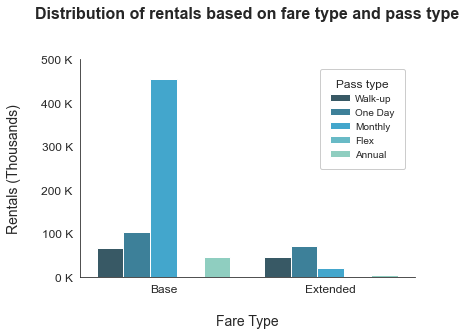

In [276]:
# set the palette as per requirement
sb.set_palette(palette = "GnBu_d", n_colors = 5, desat = None)
current_palette = sb.color_palette()
sb.set_style('white')

plt.figure(figsize = [6, 4])
max_count = bikeshare.groupby([bikeshare['fare_type'], 
                               bikeshare['pass_type']]).size().reset_index(name='count')['count'].max()
y_tick_values = np.arange(0, max_count + 100000, 100000)
y_tick_names = ['{:0.0f} K'.format(v/1000) for v in y_tick_values]

sb.countplot(data = bikeshare, x = 'fare_type', hue = 'pass_type', saturation = 1)
plt.title('Distribution of rentals based on fare type and pass type\n\n', fontsize = 16, weight = 'bold')
plt.xticks(fontsize=12)
plt.yticks(y_tick_values, y_tick_names, fontsize=12)
plt.xlabel('\nFare Type', fontsize=14)
plt.ylabel('Rentals (Thousands)\n', fontsize=14)
plt.legend(scatterpoints=1, frameon=True, fancybox=True, shadow=False, framealpha = 1, 
           borderpad=1, borderaxespad=1, loc = 'upper right', labelspacing=0.5, ncol = 1,  
           title='Pass type', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5)
sb.despine();

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.17.a Distribution of rentals based on bike type and pass type.png', dpi=300, bbox_inches='tight')

**`Facet Grid:`**

> One general visualization technique that will be useful for you to know about to handle plots of two or more variables is `faceting`. In faceting, the data is divided into disjoint subsets, most often by different levels of a categorical variable. For each of these subsets of the data, the same plot type is rendered on other variables. Faceting is a way of comparing distributions or relationships across levels of additional variables, especially when there are three or more variables of interest overall.

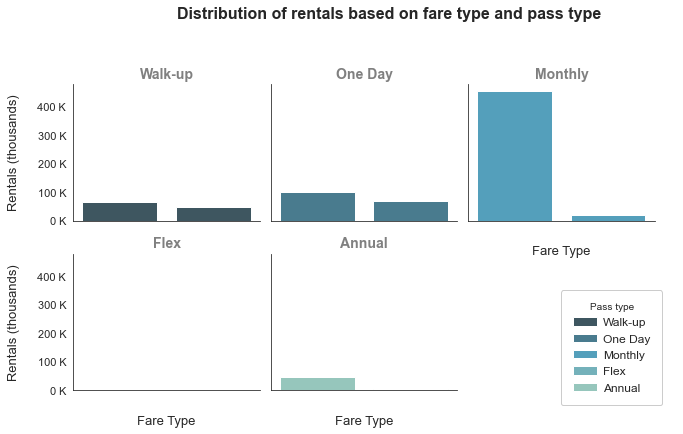

In [277]:
sb.set_style('white')
sb.set_palette(palette = "GnBu_d", n_colors = 5, desat = None)

max_count = bikeshare.groupby([bikeshare['fare_type'], 
                               bikeshare['pass_type']]).size().reset_index(name='count')['count'].max()

# plot Facet Grid
g = sb.FacetGrid(data = bikeshare, col = 'pass_type', col_wrap = 3, height = 3, aspect = 1, hue = 'pass_type')
g.map(sb.countplot, 'fare_type')
g.fig.subplots_adjust(top=0.8)
g.fig.suptitle('Distribution of rentals based on fare type and pass type\n', fontsize = 16, weight = 'bold')
g.set_titles('{col_name}', weight = 'bold', size = 14, color = 'grey')

# obtain y_ticks and convert them to a multiple of thousands 
y_tick_names = []
for ax in g.axes.flat:
    for label in ax.get_yticklabels():
        label_value = int(label.get_text())
        label_value = '{:0.0f} K'.format(label_value/1000)
        y_tick_names.append(label_value)
        
g.set_yticklabels(y_tick_names, size = 11)
g.set_xticklabels(size = 11)
g.set_xlabels('\nFare Type', size = 13)
g.set_ylabels('Rentals (thousands)\n', size = 13)
g.add_legend(bbox_to_anchor=(0.9, 0.2), scatterpoints=1,frameon=True, fancybox=True, 
             shadow=False, framealpha = 1, borderpad=1, borderaxespad=1, labelspacing=0.5, 
             ncol = 1, title='Pass type', title_fontsize=14, fontsize=12, facecolor='white', 
             markerfirst=True, handlelength=2, handletextpad=0.5);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.17.b Facet Grid of rentals based on bike type and pass type.png', dpi=300, bbox_inches='tight')

**`Heat Map:`**

One alternative way of depicting the relationship between two categorical variables is through a **Heat map**. Heat maps were introduced earlier as the 2-d version of a histogram; here, we're using them as the 2-d version of a bar chart. The seaborn function `heatmap` is at home with this type of heat map implementation, but the input arguments are unlike most of the visualization functions. Instead of providing the original dataframe, we need to summarize the counts into a matrix that will then be plotted.

> The data needs some summirization by grouping together the respective variables.

In [278]:
categorical_counts = bikeshare.groupby(['fare_type', 'pass_type']).size()
categorical_counts

fare_type  pass_type
Base       Walk-up       66051
           One Day      101735
           Monthly      454817
           Flex            242
           Annual        45944
Extended   Walk-up       46027
           One Day       69457
           Monthly       20849
           Flex             21
           Annual         3446
dtype: int64

> Now, lets reset the index and name the summerized data values accordingly.

In [279]:
categorical_counts = categorical_counts.reset_index(name = 'count')
categorical_counts

,fare_type,pass_type,count
0,Base,Walk-up,66051
1,Base,One Day,101735
2,Base,Monthly,454817
3,Base,Flex,242
4,Base,Annual,45944
5,Extended,Walk-up,46027
6,Extended,One Day,69457
7,Extended,Monthly,20849
8,Extended,Flex,21
9,Extended,Annual,3446


> Now lets make a pivot from the original dataset into a more appropriate data structure.

In [280]:
categorical_counts = categorical_counts.pivot(index = 'pass_type', columns = 'fare_type', values = 'count')
categorical_counts

fare_type,Base,Extended
pass_type,,
Walk-up,66051,46027
One Day,101735,69457
Monthly,454817,20849
Flex,242,21
Annual,45944,3446


> The data is ready to plot the `Heat map`.

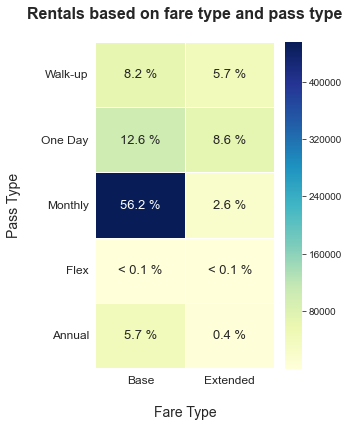

In [281]:
# plot heat map
plt.figure(figsize = [4, 6])
res = sb.heatmap(categorical_counts, annot = True, fmt = '.0f', annot_kws={'size':13}, linewidths=0.1, cmap="YlGnBu")
plt.title('Rentals based on fare type and pass type\n', fontsize = 16, weight = 'bold')
plt.xlabel('\nFare Type', fontsize=14)
plt.ylabel('Pass Type\n', fontsize=14)
plt.yticks(rotation=0, fontsize=12, va="center")
plt.xticks(fontsize=12);

# convert annotations to percentages
for t in res.texts: 
    p = np.round(np.round(int(t.get_text())/bikeshare.shape[0], 4)*100, 1)
    if p < 0.1:
        t.set_text('< 0.1 %')
    else:
        t.set_text('{} %'.format(p));

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.17.c Distribution of rentals based on pass type and bike type.png', dpi=300, bbox_inches='tight')

----

#### 3.2.18 Bivariate analysis of `fare_type` and `bike_type` columns:

+ `Columns`: pass_type, trip_type
+ `Data type`: Categorical, nominal
+ `Plot`: Clustered Bar chart, Heatmap

**`Clustered Bar chart:`**

> To depict the relationship between two categorical variables, we can extend the univariate bar chart into a `clustered bar chart`. In a clustered bar chart, bars are organized into `clusters` based on levels of the `first variable`, and then bars are `ordered` consistently across the `second variable` within each `cluster`.

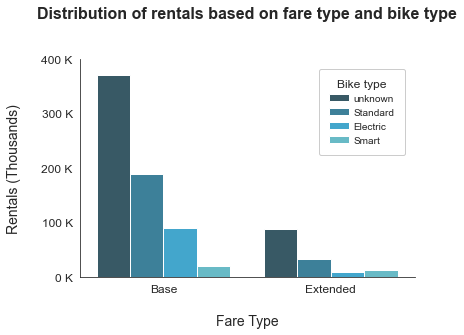

In [282]:
# set the palette as per requirement
sb.set_palette(palette = "GnBu_d", n_colors = 5, desat = None)
current_palette = sb.color_palette()
sb.set_style('white')

plt.figure(figsize = [6, 4])
max_count = bikeshare.groupby([bikeshare['fare_type'], 
                               bikeshare['bike_type']]).size().reset_index(name='count')['count'].max()
y_tick_values = np.arange(0, max_count + 100000, 100000)
y_tick_names = ['{:0.0f} K'.format(v/1000) for v in y_tick_values]

sb.countplot(data = bikeshare, x = 'fare_type', hue = 'bike_type', saturation = 1)
plt.title('Distribution of rentals based on fare type and bike type\n\n', fontsize = 16, weight = 'bold')
plt.xticks(fontsize=12)
plt.yticks(y_tick_values, y_tick_names, fontsize=12)
plt.xlabel('\nFare Type', fontsize=14)
plt.ylabel('Rentals (Thousands)\n', fontsize=14)
plt.legend(scatterpoints=1, frameon=True, fancybox=True, shadow=False, framealpha = 1, 
           borderpad=1, borderaxespad=1, loc = 'upper right', labelspacing=0.5, ncol = 1,  
           title='Bike type', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5)
sb.despine();

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.18.a Distribution of rentals based on bike type and pass type.png', dpi=300, bbox_inches='tight')

**`Facet Grid:`**

> One general visualization technique that will be useful for you to know about to handle plots of two or more variables is `faceting`. In faceting, the data is divided into disjoint subsets, most often by different levels of a categorical variable. For each of these subsets of the data, the same plot type is rendered on other variables. Faceting is a way of comparing distributions or relationships across levels of additional variables, especially when there are three or more variables of interest overall.

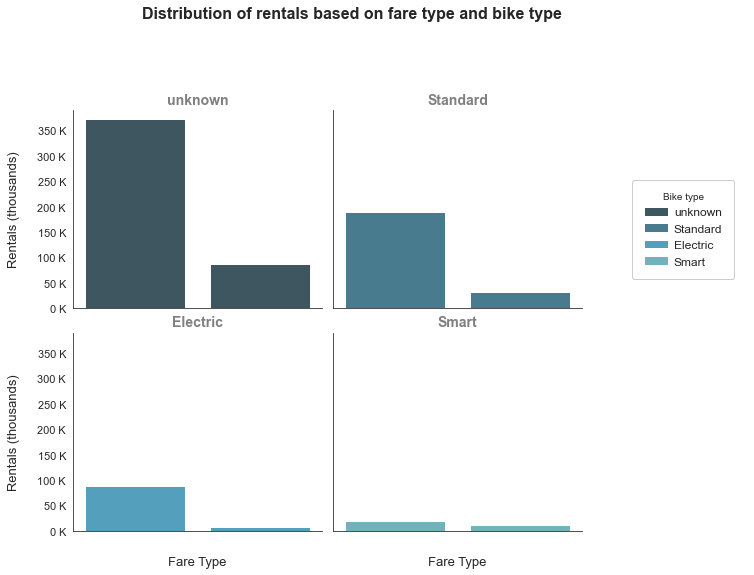

In [283]:
sb.set_style('white')
sb.set_palette(palette = "GnBu_d", n_colors = 5, desat = None)

max_count = bikeshare.groupby([bikeshare['fare_type'], 
                               bikeshare['bike_type']]).size().reset_index(name='count')['count'].max()

# plot Facet Grid
g = sb.FacetGrid(data = bikeshare, col = 'bike_type', col_wrap = 2, height = 4, aspect = 1, hue = 'bike_type')
g.map(sb.countplot, 'fare_type')
g.fig.subplots_adjust(top=0.8)
g.fig.suptitle('Distribution of rentals based on fare type and bike type\n', fontsize = 16, weight = 'bold')
g.set_titles('{col_name}', weight = 'bold', size = 14, color = 'grey')

# obtain y_ticks and convert them to a multiple of thousands 
y_tick_names = []
for ax in g.axes.flat:
    for label in ax.get_yticklabels():
        label_value = int(label.get_text())
        label_value = '{:0.0f} K'.format(label_value/1000)
        y_tick_names.append(label_value)
        
g.set_yticklabels(y_tick_names, size = 11)
g.set_xticklabels(size = 11)
g.set_xlabels('\nFare Type', size = 13)
g.set_ylabels('Rentals (thousands)\n', size = 13)
g.add_legend(bbox_to_anchor=(1.1, 0.6), scatterpoints=1,frameon=True, fancybox=True, 
             shadow=False, framealpha = 1, borderpad=1, borderaxespad=1, labelspacing=0.5, 
             ncol = 1, title='Bike type', title_fontsize=14, fontsize=12, facecolor='white', 
             markerfirst=True, handlelength=2, handletextpad=0.5);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.18.b Facet Grid of rentals based on bike type and pass type.png', dpi=300, bbox_inches='tight')

**`Heat Map:`**

One alternative way of depicting the relationship between two categorical variables is through a **Heat map**. Heat maps were introduced earlier as the 2-d version of a histogram; here, we're using them as the 2-d version of a bar chart. The seaborn function `heatmap` is at home with this type of heat map implementation, but the input arguments are unlike most of the visualization functions. Instead of providing the original dataframe, we need to summarize the counts into a matrix that will then be plotted.

> The data needs some summirization by grouping together the respective variables.

In [284]:
categorical_counts = bikeshare.groupby(['fare_type', 'bike_type']).size()
categorical_counts

fare_type  bike_type
Base       unknown      371581
           Standard     189067
           Electric      89409
           Smart         18732
Extended   unknown       87354
           Standard      33076
           Electric       8120
           Smart         11250
dtype: int64

> Now, lets reset the index and name the summerized data values accordingly.

In [285]:
categorical_counts = categorical_counts.reset_index(name = 'count')
categorical_counts

,fare_type,bike_type,count
0,Base,unknown,371581
1,Base,Standard,189067
2,Base,Electric,89409
3,Base,Smart,18732
4,Extended,unknown,87354
5,Extended,Standard,33076
6,Extended,Electric,8120
7,Extended,Smart,11250


> Now lets make a pivot from the original dataset into a more appropriate data structure.

In [286]:
categorical_counts = categorical_counts.pivot(index = 'bike_type', columns = 'fare_type', values = 'count')
categorical_counts

fare_type,Base,Extended
bike_type,,
unknown,371581,87354
Standard,189067,33076
Electric,89409,8120
Smart,18732,11250


> The data is ready to plot the `Heat map`.

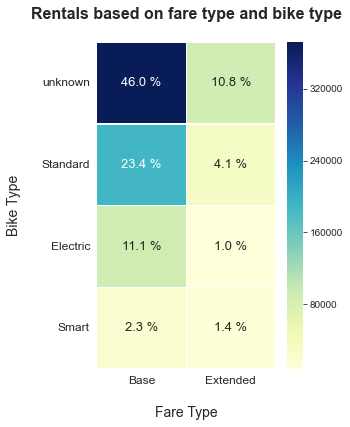

In [287]:
# plot heat map
plt.figure(figsize = [4, 6])
res = sb.heatmap(categorical_counts, annot = True, fmt = '.0f', annot_kws={'size':13}, linewidths=0.1, cmap="YlGnBu")
plt.title('Rentals based on fare type and bike type\n', fontsize = 16, weight = 'bold')
plt.xlabel('\nFare Type', fontsize=14)
plt.ylabel('Bike Type\n', fontsize=14)
plt.yticks(rotation=0, fontsize=12, va="center")
plt.xticks(fontsize=12);

# convert annotations to percentages
for t in res.texts: 
    p = np.round(np.round(int(t.get_text())/bikeshare.shape[0], 4)*100, 1)
    if p < 0.1:
        t.set_text('< 0.1 %')
    else:
        t.set_text('{} %'.format(p));

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.18.c Distribution of rentals based on pass type and bike type.png', dpi=300, bbox_inches='tight')

------

#### 3.2.19 Bivariate analysis of `duration_min` and `trip_type` columns:

+ `Columns`: duration_min, trip_type
+ `Data type`: (Numerical, continuous) and (Categorical, nominal)
+ `Plot`: Facet Grid, Violin plot, Box plot, Adapted Barchart

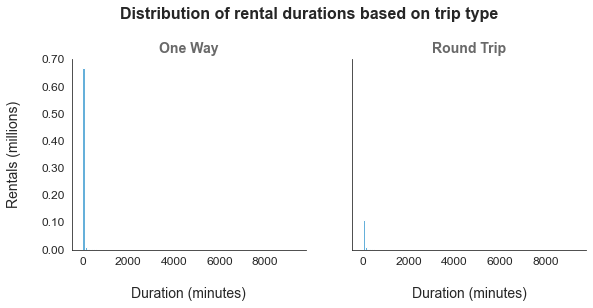

In [288]:
sb.set_style('white')
sb.set_palette(palette = "colorblind", n_colors = 10, desat = 0.8)
base_color = sb.color_palette()[9]

g = sb.FacetGrid(data = bikeshare, col = 'trip_type', col_wrap = 2, height = 4, aspect = 1, )
g.map(plt.hist, "duration_min", color = base_color, bins = np.arange(0, bikeshare.duration_min.max()+100, 100))
g.fig.subplots_adjust(top=0.8)
g.fig.suptitle('Distribution of rental durations based on trip type\n', fontsize = 16, weight = 'bold')
g.set_titles('{col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# obtain y_ticks and convert them to a multiple of millions
# obtain the x_ticks and store them as a list
y_tick_names = []
x_tick_names = []
for ax in g.axes.flat:
    for y_label in ax.get_yticklabels():
        y_label_value = int(y_label.get_text())
        y_label_new_value = '{:0.2f}'.format(y_label_value/1000000)
        y_tick_names.append(y_label_new_value)
        
    for x_label in ax.get_xticklabels():
        x_label_value = x_label.get_text()
        x_tick_names.append(x_label_value)

g.set_yticklabels(y_tick_names, size = 12)
g.set_xticklabels(x_tick_names, size = 12)
g.set_xlabels('\nDuration (minutes)', size = 14)
g.set_ylabels('Rentals (millions)\n', size = 14)

plt.subplots_adjust(wspace=0.2, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.19.a Facet Grid of rental durations on trip type.png', dpi=300, bbox_inches='tight')

> Let us plot more variety of graphs to observe the distribution of data and hidden insights.

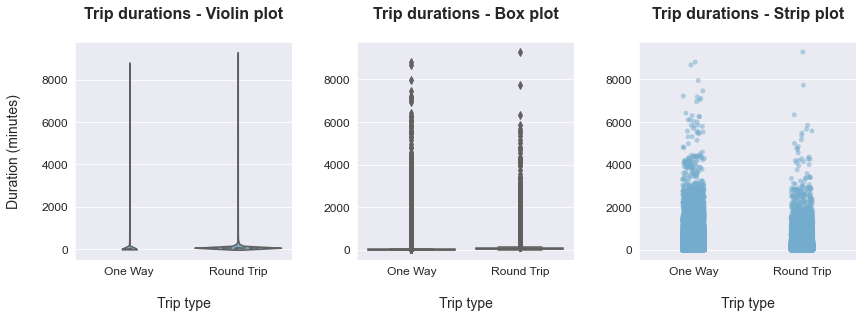

In [289]:
plt.figure(figsize = [14, 4])
sb.set_style('darkgrid')
sb.set_palette(palette = "colorblind", n_colors = 10, desat = 0.6)
base_color = sb.color_palette()[9]

# left plot: violin plot
plt.subplot(1, 3, 1)
sb.violinplot(data = bikeshare, x = 'trip_type', y = 'duration_min', inner = 'quartile',
              color = base_color)
plt.title('Trip durations - Violin plot\n',  weight = 'bold', fontsize = 16)
plt.xlabel('\nTrip type', fontsize = 14)
plt.ylabel('Duration (minutes)\n', fontsize = 14)
plt.xticks(fontsize = 12)
plt.yticks(fontsize = 12)

# center plot: box plot
plt.subplot(1, 3, 2)
sb.boxplot(data = bikeshare, x = 'trip_type', y = 'duration_min', color = base_color)
plt.title('Trip durations - Box plot\n',  weight = 'bold', fontsize = 16)
plt.xlabel('\nTrip type', fontsize = 14)
plt.ylabel('', fontsize = 14)
plt.xticks(fontsize = 12)
plt.yticks(fontsize = 12)

# right plot: strip chart
plt.subplot(1, 3, 3)
sb.stripplot(x="trip_type", y="duration_min", data=bikeshare, alpha = 0.5, color = base_color)
plt.title('Trip durations - Strip plot\n',  weight = 'bold', fontsize = 16)
plt.xlabel('\nTrip type', fontsize = 14)
plt.ylabel('', fontsize = 14)
plt.xticks(fontsize = 12)
plt.yticks(fontsize = 12)

plt.subplots_adjust(wspace=0.3, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust dhe figure to include all of the x and y labels
plt.savefig('plots/3.2.19.b Distribution of trip durations on various plots.png', dpi=300, bbox_inches='tight')

> The above plot depicts the presense of long tail of outliers, and require closer observation for better understanding of the data distribution.

Calculate the `average trip duration` and the `most frequent trip duration` subjected to each `trip type`.

In [290]:
oneway_mean = math.ceil(bikeshare.query(' trip_type == "One Way" ').duration_min.mean())
oneway_mode = bikeshare.query(' trip_type == "One Way" ').duration_min.mode()[0]

roundtrip_mean = math.ceil(bikeshare.query(' trip_type == "Round Trip" ').duration_min.mean())
roundtrip_mode = bikeshare.query(' trip_type == "Round Trip" ').duration_min.mode()[0]

print('Duration mean'.center(30,'-'))
print('oneway_mean    : ', oneway_mean, 'minutes')
print('roundtrip_mean : ', roundtrip_mean, 'minutes')
print('\n')
print('Duration mode'.center(30,'-'))
print('oneway_mode    : ', oneway_mode, 'minutes')
print('roundtrip_mode : ', roundtrip_mode, 'minutes')

--------Duration mean---------
oneway_mean    :  24 minutes
roundtrip_mean :  64 minutes


--------Duration mode---------
oneway_mode    :  5 minutes
roundtrip_mode :  1 minutes


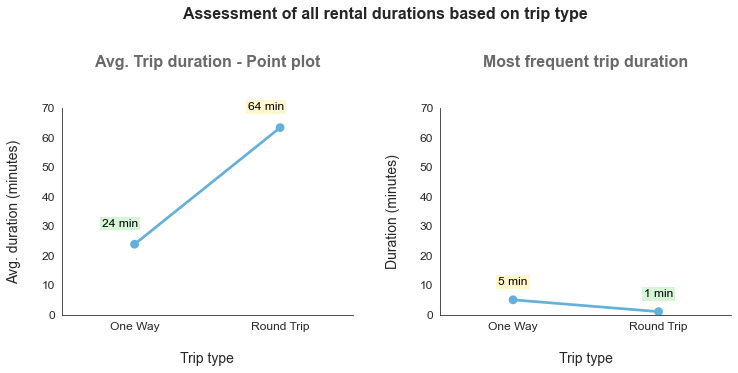

In [291]:
plt.figure(figsize = [12, 5])

sb.set_palette(palette = "colorblind", n_colors = 10, desat = 0.8)
base_color = sb.color_palette()[9]

# left plot: point plot - Avg trip duration
sb.set_style('white')
plt.subplot(1, 2, 1)
ax1 = sb.pointplot(data = bikeshare, x = "trip_type", y = "duration_min", linestyles = "-", color = base_color)
plt.title('Avg. Trip duration - Point plot\n\n',  weight = 'bold', fontsize = 16, color = 'dimgrey')
plt.ylabel('Avg. duration (minutes)\n', fontsize = 14)
plt.xlabel('\nTrip type', fontsize = 14)
plt.xticks(fontsize = 12)

locs, labels = plt.yticks()
y_ticks_new = np.arange(0, int(math.ceil(max(locs)))+10, 10)
plt.yticks(y_ticks_new, y_ticks_new, fontsize=12)
sb.despine(top=True, bottom=False, left=False, right=True);

# add annotations
# -------------------------------------------------------
cat_order = bikeshare.trip_type.sort_values(ascending=True).unique()
avg_rental_counts = bikeshare.groupby([bikeshare["trip_type"]]).mean().duration_min[cat_order]
avg_rental_max = avg_rental_counts.max()
clrs = ['gold' if (count > ((avg_rental_max*4)/5)) else 'limegreen' for count in avg_rental_counts ]

# get the current tick locations and labels
locs, labels = plt.xticks()

# loop through each pair of locations and labels
for loc, label, avg_rental_count, clr in zip(locs, labels, avg_rental_counts, clrs):
    try:
        count = avg_rental_count
    except KeyError:
        count = 0   
    pct_string = '{:0.0f} min'.format(math.ceil(count))
    # print the annotation depending on the bar length
    plt.text(loc-0.1, count + int(avg_rental_max/10), pct_string, ha = 'center', color = 'black', 
             fontsize = 12, bbox=dict(pad=1.9,alpha=0.2,color='none',fc=clr))
# -------------------------------------------------------

# right plot: Bar chart - most frequent trip duration
sb.set_style('white')
plt.subplot(1, 2, 2)
oneway_mode = bikeshare.query(' trip_type == "One Way" ').duration_min.mode()[0]
roundtrip_mode = bikeshare.query(' trip_type == "Round Trip" ').duration_min.mode()[0]
heights = [oneway_mode, roundtrip_mode]
labels = bikeshare.trip_type.sort_values(ascending=True).unique()
sb.pointplot(x = labels, y = heights, color = base_color)
plt.title('Most frequent trip duration\n\n',  weight = 'bold', fontsize = 16, color = 'dimgrey')
plt.xlabel('\nTrip type', fontsize = 14)
plt.ylabel('Duration (minutes)\n', fontsize = 14)
plt.xticks(fontsize = 12)
plt.ylim(ax1.get_ylim())

locs, labels = plt.yticks()
y_ticks_new = np.arange(0, int(math.ceil(max(locs)))+10, 10)
plt.yticks(y_ticks_new, y_ticks_new, fontsize=12)
sb.despine();

# add annotations
# -------------------------------------------------------
freq_rental_counts = heights
freq_rental_max = max(freq_rental_counts)
clrs = ['gold' if (count > ((freq_rental_max*4)/5)) else 'limegreen' for count in freq_rental_counts ]

# get the current tick locations and labels
locs, labels = plt.xticks()

# loop through each pair of locations and labels
for loc, label, freq_rental_count, clr in zip(locs, labels, freq_rental_counts, clrs):
    try:
        count = freq_rental_count
    except KeyError:
        count = 0   
    pct_string = '{:0.0f} min'.format(math.ceil(count))
    # print the annotation depending on the bar length
    plt.text(loc, count + (freq_rental_max), pct_string, ha = 'center', color = 'black', 
             fontsize = 12, bbox=dict(pad=1.9,alpha=0.2,color='none',fc=clr))
# -------------------------------------------------------

plt.subplots_adjust(wspace=0.3, hspace=0.3)
plt.subplots_adjust(top=0.7)
plt.suptitle('Assessment of all rental durations based on trip type\n', fontsize = 16, weight = 'bold');

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.19.c Average trip durations based on trip type.png', dpi=300, bbox_inches='tight')

> If the trip type  is `One Way`, then the bike rentals has an average rental duration of `24` minutes and mode of `5` minutes.

> If the trip type  is `Round Trip`, then the bike rentals has an average rental duration of `64` minutes and mode of `1` minutes. 

`The mode being 1 minute of round trips is probably because of return of the bicycle immediately after rental due to technical or other issue. Hence exclude the round trips under 1 minute and re-evalute its mode.`

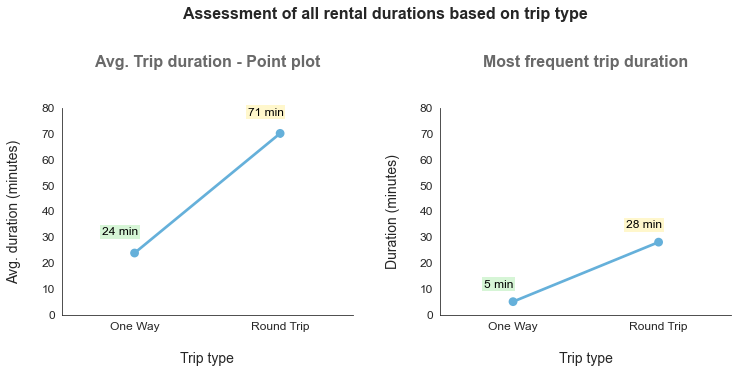

In [292]:
drop_index = bikeshare.query(' trip_type == "Round Trip" and duration_min <= 1 ').index
temp_df = bikeshare.drop(drop_index)

plt.figure(figsize = [12, 5])
sb.set_palette(palette = "colorblind", n_colors = 10, desat = 0.8)
base_color = sb.color_palette()[9]

# left plot: point plot - Avg trip duration
sb.set_style('white')
plt.subplot(1, 2, 1)
ax1 = sb.pointplot(data = temp_df, x = "trip_type", y = "duration_min", linestyles = "-", color = base_color)
plt.title('Avg. Trip duration - Point plot\n\n',  weight = 'bold', fontsize = 16, color = 'dimgrey')
plt.ylabel('Avg. duration (minutes)\n', fontsize = 14)
plt.xlabel('\nTrip type', fontsize = 14)
plt.xticks(fontsize = 12)

locs, labels = plt.yticks()
y_ticks_new = np.arange(0, int(math.ceil(max(locs)))+10, 10)
plt.yticks(y_ticks_new, y_ticks_new, fontsize=12)
sb.despine(top=True, bottom=False, left=False, right=True);

# add annotations
# -------------------------------------------------------
cat_order = temp_df.trip_type.sort_values(ascending=True).unique()
avg_rental_counts = temp_df.groupby([temp_df["trip_type"]]).mean().duration_min[cat_order]
avg_rental_max = avg_rental_counts.max()
clrs = ['gold' if (count > ((avg_rental_max*4)/5)) else 'limegreen' for count in avg_rental_counts ]

# get the current tick locations and labels
locs, labels = plt.xticks()

# loop through each pair of locations and labels
for loc, label, avg_rental_count, clr in zip(locs, labels, avg_rental_counts, clrs):
    try:
        count = avg_rental_count
    except KeyError:
        count = 0   
    pct_string = '{:0.0f} min'.format(math.ceil(count))
    # print the annotation depending on the bar length
    plt.text(loc-0.1, count + int(avg_rental_max/10), pct_string, ha = 'center', color = 'black', 
             fontsize = 12, bbox=dict(pad=1.9,alpha=0.2,color='none',fc=clr))
# -------------------------------------------------------

# right plot: Bar chart - most frequent trip duration
sb.set_style('white')
plt.subplot(1, 2, 2)
oneway_mode = temp_df.query(' trip_type == "One Way" ').duration_min.mode()[0]
roundtrip_mode = temp_df.query(' trip_type == "Round Trip" ').duration_min.mode()[0]
heights = [oneway_mode, roundtrip_mode]
labels = temp_df.trip_type.sort_values(ascending=True).unique()
sb.pointplot(x = labels, y = heights, color = base_color)
plt.title('Most frequent trip duration\n\n',  weight = 'bold', fontsize = 16, color = 'dimgrey')
plt.xlabel('\nTrip type', fontsize = 14)
plt.ylabel('Duration (minutes)\n', fontsize = 14)
plt.xticks(fontsize = 12)
plt.ylim(ax1.get_ylim())

locs, labels = plt.yticks()
y_ticks_new = np.arange(0, int(math.ceil(max(locs)))+10, 10)
plt.yticks(y_ticks_new, y_ticks_new, fontsize=12)
sb.despine();

# add annotations
# -------------------------------------------------------
freq_rental_counts = heights
freq_rental_max = max(freq_rental_counts)
clrs = ['gold' if (count > ((freq_rental_max*4)/5)) else 'limegreen' for count in freq_rental_counts ]

# get the current tick locations and labels
locs, labels = plt.xticks()

# loop through each pair of locations and labels
for loc, label, freq_rental_count, clr in zip(locs, labels, freq_rental_counts, clrs):
    try:
        count = freq_rental_count
    except KeyError:
        count = 0   
    pct_string = '{:0.0f} min'.format(math.ceil(count))
    # print the annotation depending on the bar length
    plt.text(loc-0.1, count + (freq_rental_max/5), pct_string, ha = 'center', color = 'black', 
             fontsize = 12, bbox=dict(pad=1.9,alpha=0.2,color='none',fc=clr))
# -------------------------------------------------------

plt.subplots_adjust(wspace=0.3, hspace=0.3)
plt.subplots_adjust(top=0.7)
plt.suptitle('Assessment of all rental durations based on trip type\n', fontsize = 16, weight = 'bold');

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.19.d Average trip durations based on trip type.png', dpi=300, bbox_inches='tight')

>  If the trip type  is `One Way`, then the bike rentals has an average rental duration of `24` minutes and mode of `5` minutes. 

> If the trip type  is `Round Trip` (excluding `1 minute` trips), then the bike rentals has an has an increase in average rental duration to `71` minutes and increase in mode to `28` minutes. 

**`Dataset limited under 120 min:`**

In [293]:
bikeshare.duration_min.describe()

count    808589.000000
mean         29.861795
std         119.355799
min           0.000000
25%           6.000000
50%          12.000000
75%          23.000000
max        9283.000000
Name: duration_min, dtype: float64

> The distribution of `duration_min` values are vague and not easy to interpret. This can be overcome by limiting the plot to a threshold value, say `120` minutes or `2` hours as most of the `duration_min` values falls under this boundary.

In [294]:
# calculate the percentage of the dataset that falls under `2 hour` trip duration.
np.round((bikeshare.query(' duration_min <= 120 ').shape[0]/bikeshare.shape[0])*100, 2)

96.9

In [295]:
duration_120 = bikeshare.query(' duration_min > 120 ')

# calculate the proportion of the 'One Way' trips that will be dropped
oneway_drops = np.round((duration_120.query(' trip_type == "One Way" ').shape[0]/
                         bikeshare.query(' trip_type == "One Way" ').shape[0])*100, 2)

# calculate the proportion of the 'Round' trips that will be dropped
round_drops = np.round((duration_120.query(' trip_type == "Round Trip" ').shape[0]/
                        bikeshare.query(' trip_type == "Round Trip" ').shape[0])*100, 2)

print("Proportion of oneway trips that will be dropped".ljust(50, ' '), ':', oneway_drops)
print("Proportion of round trips that will be dropped".ljust(50, ' '), ':', round_drops)

Proportion of oneway trips that will be dropped    : 1.91
Proportion of round trips that will be dropped     : 9.68


In [296]:
# Limit the dataset that has entries under 2 hours duration
duration_lim_120 = bikeshare.query(' duration_min <= 120 ')

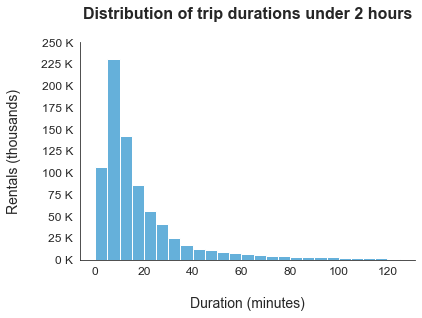

In [297]:
sb.set_style('white')
sb.set_palette(palette = "colorblind", n_colors = 10, desat = 0.8)
base_color = sb.color_palette()[9]
bin_edges = np.arange(0, duration_lim_120.duration_min.max()+10, 5)

plt.hist(duration_lim_120['duration_min'], color = base_color, bins = bin_edges)
plt.title('Distribution of trip durations under 2 hours\n',  weight = 'bold', fontsize = 16)
plt.xlabel('\nDuration (minutes)', fontsize = 14)
plt.ylabel('Rentals (thousands)\n', fontsize = 14)
plt.xticks(fontsize = 12)

locs, labels = plt.yticks()
y_tick_locs = np.arange(0, int(math.ceil(max(locs)))+1000, 25000)
y_tick_names = ['{:0.0f} K'.format(loc/1000) for loc in y_tick_locs]
plt.yticks(y_tick_locs, y_tick_names, fontsize=12)
sb.despine();

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.19.e Distribution of rental durations under 2 hours on trip type.png', dpi=300, bbox_inches='tight')

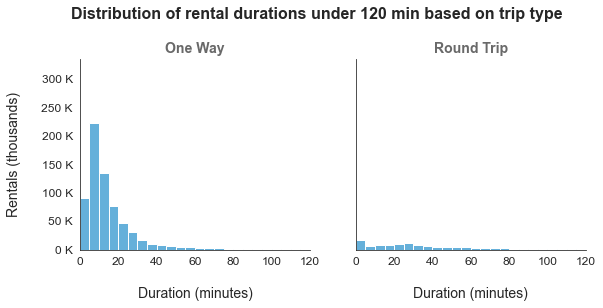

In [298]:
sb.set_style('white')
sb.set_palette(palette = "colorblind", n_colors = 10, desat = 0.8)
base_color = sb.color_palette()[9]

g = sb.FacetGrid(data = duration_lim_120, col = 'trip_type', col_wrap = 2, height = 4, aspect = 1, xlim=(0,120))
g.set(xmargin=0.5, ymargin=0.5)
g.map(plt.hist, "duration_min", color = base_color, bins = np.arange(0, duration_lim_120.duration_min.max()+10, 5))
g.fig.subplots_adjust(top=0.8)
g.fig.suptitle('Distribution of rental durations under 120 min based on trip type\n', fontsize = 16, weight = 'bold')
g.set_titles('{col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# obtain y_ticks and convert them to a multiple of millions
# obtain the x_ticks and store them as a list
y_tick_names = []
x_tick_names = []
for ax in g.axes.flat:
    for y_label in ax.get_yticklabels():
        y_label_value = int(y_label.get_text())
        y_label_new_value = '{:0.0f} K'.format(y_label_value/1000)
        y_tick_names.append(y_label_new_value)
        
    for x_label in ax.get_xticklabels():
        x_label_value = x_label.get_text()
        x_tick_names.append(x_label_value)

g.set_yticklabels(y_tick_names, size = 12)
g.set_xticklabels(x_tick_names, size = 12)
g.set_xlabels('\nDuration (minutes)', size = 14)
g.set_ylabels('Rentals (thousands)\n', size = 14)

plt.subplots_adjust(wspace=0.2, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.19.f Facet Grid of rental durations under 2 hours on trip type.png', dpi=300, bbox_inches='tight')

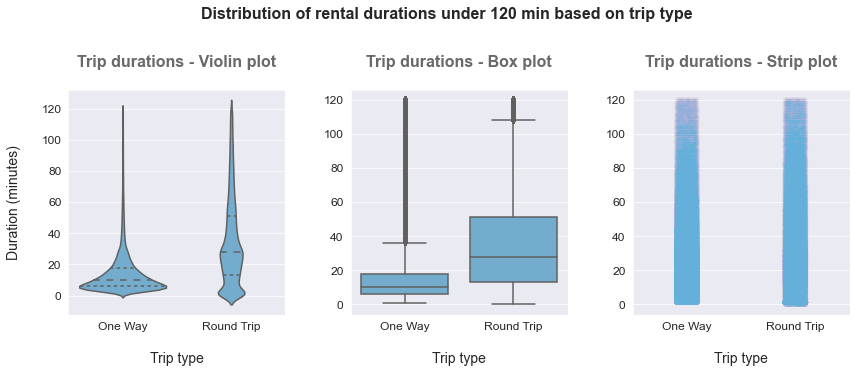

In [299]:
plt.figure(figsize = [14, 5])
sb.set_style('darkgrid')
base_color = sb.color_palette()[9]

# left plot: violin plot
plt.subplot(1, 3, 1)
sb.violinplot(data = duration_lim_120, x = 'trip_type', y = 'duration_min', 
              inner = 'quartile', color = base_color)
plt.title('Trip durations - Violin plot\n',  weight = 'bold', fontsize = 16, color = 'dimgrey')
plt.xlabel('\nTrip type', fontsize = 14)
plt.ylabel('Duration (minutes)\n', fontsize = 14)
plt.xticks(fontsize = 12)
plt.yticks(fontsize = 12)

# center plot: box plot
plt.subplot(1, 3, 2)
sb.boxplot(data = duration_lim_120, x = 'trip_type', y = 'duration_min', color = base_color)
plt.title('Trip durations - Box plot\n',  weight = 'bold', fontsize = 16, color = 'dimgrey')
plt.xlabel('\nTrip type', fontsize = 14)
plt.ylabel('', fontsize = 14)
plt.xticks(fontsize = 12)
plt.yticks(fontsize = 12)

# right plot: strip chart
plt.subplot(1, 3, 3)
sb.stripplot(data = duration_lim_120, x="trip_type", y="duration_min", alpha = 0.002, color = base_color)
plt.title('Trip durations - Strip plot\n',  weight = 'bold', fontsize = 16, color = 'dimgrey')
plt.xlabel('\nTrip type', fontsize = 14)
plt.ylabel('', fontsize = 14)
plt.xticks(fontsize = 12)
plt.yticks(fontsize = 12)

plt.subplots_adjust(wspace=0.3, hspace=0.3)
plt.subplots_adjust(top=0.75)
plt.suptitle('Distribution of rental durations under 120 min based on trip type\n', fontsize = 16, weight = 'bold');

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.19.g Distribution of trip durations under 2 hours on various plots.png', dpi=300, bbox_inches='tight')

Calculate the `average trip duration` and the `most frequent trip duration` subjected to each `trip type`.

In [300]:
oneway_mean = math.ceil(duration_lim_120.query(' trip_type == "One Way" ').duration_min.mean())
oneway_mode = duration_lim_120.query(' trip_type == "One Way" ').duration_min.mode()[0]

roundtrip_mean = math.ceil(duration_lim_120.query(' trip_type == "Round Trip" ').duration_min.mean())
roundtrip_mode = duration_lim_120.query(' trip_type == "Round Trip" ').duration_min.mode()[0]

print('Duration mean'.center(30,'-'))
print('oneway_mean    : ', oneway_mean, 'minutes')
print('roundtrip_mean : ', roundtrip_mean, 'minutes')
print('\n')
print('Duration mode'.center(30,'-'))
print('oneway_mode    : ', oneway_mode, 'minutes')
print('roundtrip_mode : ', roundtrip_mode, 'minutes')

--------Duration mean---------
oneway_mean    :  16 minutes
roundtrip_mean :  35 minutes


--------Duration mode---------
oneway_mode    :  5 minutes
roundtrip_mode :  1 minutes


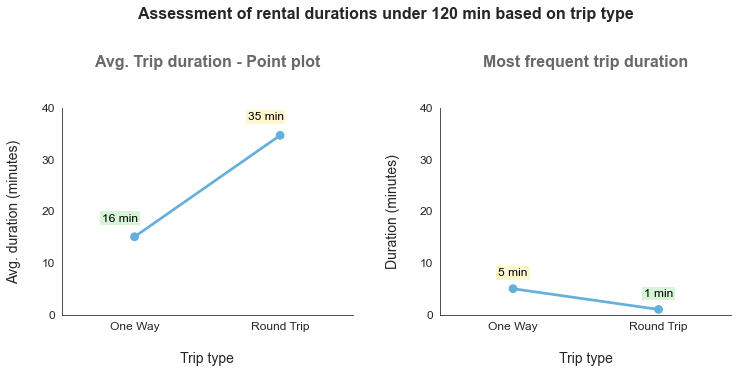

In [301]:
plt.figure(figsize = [12, 5])

sb.set_palette(palette = "colorblind", n_colors = 10, desat = 0.8)
base_color = sb.color_palette()[9]

# left plot: point plot - Avg trip duration
sb.set_style('white')
plt.subplot(1, 2, 1)
ax1 = sb.pointplot(data = duration_lim_120, x = "trip_type", y = "duration_min", linestyles = "-", color = base_color)
plt.title('Avg. Trip duration - Point plot\n\n',  weight = 'bold', fontsize = 16, color = 'dimgrey')
plt.ylabel('Avg. duration (minutes)\n', fontsize = 14)
plt.xlabel('\nTrip type', fontsize = 14)
plt.xticks(fontsize = 12)

locs, labels = plt.yticks()
y_ticks_new = np.arange(0, int(math.ceil(max(locs)))+10, 10)
plt.yticks(y_ticks_new, y_ticks_new, fontsize=12)
sb.despine(top=True, bottom=False, left=False, right=True);

# add annotations
# -------------------------------------------------------
cat_order = duration_lim_120.trip_type.sort_values(ascending=True).unique()
avg_rental_counts = duration_lim_120.groupby([duration_lim_120["trip_type"]]).mean().duration_min[cat_order]
avg_rental_max = avg_rental_counts.max()
clrs = ['gold' if (count > ((avg_rental_max*4)/5)) else 'limegreen' for count in avg_rental_counts ]

# get the current tick locations and labels
locs, labels = plt.xticks()

# loop through each pair of locations and labels
for loc, label, avg_rental_count, clr in zip(locs, labels, avg_rental_counts, clrs):
    try:
        count = avg_rental_count
    except KeyError:
        count = 0   
    pct_string = '{:0.0f} min'.format(math.ceil(count))
    # print the annotation depending on the bar length
    plt.text(loc-0.1, count + int(avg_rental_max/10), pct_string, ha = 'center', color = 'black', 
             fontsize = 12, bbox=dict(pad=1.9,alpha=0.2,color='none',fc=clr))
# -------------------------------------------------------

# right plot: Bar chart - most frequent trip duration
sb.set_style('white')
plt.subplot(1, 2, 2)
oneway_mode = duration_lim_120.query(' trip_type == "One Way" ').duration_min.mode()[0]
roundtrip_mode = duration_lim_120.query(' trip_type == "Round Trip" ').duration_min.mode()[0]
heights = [oneway_mode, roundtrip_mode]
labels = duration_lim_120.trip_type.sort_values(ascending=True).unique()
sb.pointplot(x = labels, y = heights, color = base_color)
plt.title('Most frequent trip duration\n\n',  weight = 'bold', fontsize = 16, color = 'dimgrey')
plt.xlabel('\nTrip type', fontsize = 14)
plt.ylabel('Duration (minutes)\n', fontsize = 14)
plt.xticks(fontsize = 12)
plt.ylim(ax1.get_ylim())

locs, labels = plt.yticks()
y_ticks_new = np.arange(0, int(math.ceil(max(locs)))+10, 10)
plt.yticks(y_ticks_new, y_ticks_new, fontsize=12)
sb.despine();

# add annotations
# -------------------------------------------------------
freq_rental_counts = heights
freq_rental_max = max(freq_rental_counts)
clrs = ['gold' if (count > ((freq_rental_max*4)/5)) else 'limegreen' for count in freq_rental_counts ]

# get the current tick locations and labels
locs, labels = plt.xticks()

# loop through each pair of locations and labels
for loc, label, freq_rental_count, clr in zip(locs, labels, freq_rental_counts, clrs):
    try:
        count = freq_rental_count
    except KeyError:
        count = 0   
    pct_string = '{:0.0f} min'.format(math.ceil(count))
    # print the annotation depending on the bar length
    plt.text(loc, count + (freq_rental_max/2), pct_string, ha = 'center', color = 'black', 
             fontsize = 12, bbox=dict(pad=1.9,alpha=0.2,color='none',fc=clr))
# -------------------------------------------------------

plt.subplots_adjust(wspace=0.3, hspace=0.3)
plt.subplots_adjust(top=0.7)
plt.suptitle('Assessment of rental durations under 120 min based on trip type\n', fontsize = 16, weight = 'bold');

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.19.h Average trip durations under 2 hours based on trip type.png', dpi=300, bbox_inches='tight')

> If the trip type  is `One Way`, and dateset limited to trips under `30 minutes`, then the bike rentals has an average rental duration of `16` minutes and mode of `5` minutes.

> If the trip type  is `Round Trip`, and dateset limited to trips under `30 minutes`, then the bike rentals has an average rental duration of `35` minutes and mode of `1` minutes. 

`The mode being 1 minute of round trips is probably because of return of the bicycle immediately after rental due to technical or other issue. Hence exclude the round trips under 1 minute and re-evalute its mode.`

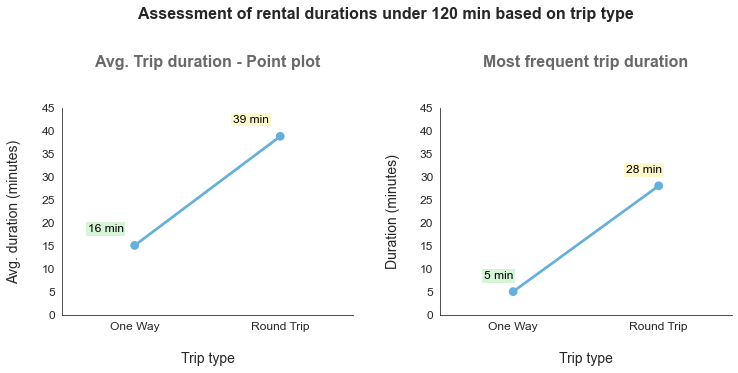

In [302]:
drop_index = duration_lim_120.query(' trip_type == "Round Trip" and duration_min <= 1 ').index
temp_df = duration_lim_120.drop(drop_index)

plt.figure(figsize = [12, 5])
sb.set_palette(palette = "colorblind", n_colors = 10, desat = 0.8)
base_color = sb.color_palette()[9]

# left plot: point plot - Avg trip duration
sb.set_style('white')
plt.subplot(1, 2, 1)
ax1 = sb.pointplot(data = temp_df, x = "trip_type", y = "duration_min", linestyles = "-", color = base_color)
plt.title('Avg. Trip duration - Point plot\n\n',  weight = 'bold', fontsize = 16, color = 'dimgrey')
plt.ylabel('Avg. duration (minutes)\n', fontsize = 14)
plt.xlabel('\nTrip type', fontsize = 14)
plt.xticks(fontsize = 12)

locs, labels = plt.yticks()
y_ticks_new = np.arange(0, int(math.ceil(max(locs)))+5, 5)
plt.yticks(y_ticks_new, y_ticks_new, fontsize=12)
sb.despine(top=True, bottom=False, left=False, right=True);

# add annotations
# -------------------------------------------------------
cat_order = temp_df.trip_type.sort_values(ascending=True).unique()
avg_rental_counts = temp_df.groupby([temp_df["trip_type"]]).mean().duration_min[cat_order]
avg_rental_max = avg_rental_counts.max()
clrs = ['gold' if (count > ((avg_rental_max*4)/5)) else 'limegreen' for count in avg_rental_counts ]

# get the current tick locations and labels
locs, labels = plt.xticks()

# loop through each pair of locations and labels
for loc, label, avg_rental_count, clr in zip(locs, labels, avg_rental_counts, clrs):
    try:
        count = avg_rental_count
    except KeyError:
        count = 0   
    pct_string = '{:0.0f} min'.format(math.ceil(count))
    # print the annotation depending on the bar length
    plt.text(loc-0.2, count + int(avg_rental_max/10), pct_string, ha = 'center', color = 'black', 
             fontsize = 12, bbox=dict(pad=1.9,alpha=0.2,color='none',fc=clr))
# -------------------------------------------------------

# right plot: Bar chart - most frequent trip duration
sb.set_style('white')
plt.subplot(1, 2, 2)
oneway_mode = temp_df.query(' trip_type == "One Way" ').duration_min.mode()[0]
roundtrip_mode = temp_df.query(' trip_type == "Round Trip" ').duration_min.mode()[0]
heights = [oneway_mode, roundtrip_mode]
labels = temp_df.trip_type.sort_values(ascending=True).unique()
sb.pointplot(x = labels, y = heights, color = base_color)
plt.title('Most frequent trip duration\n\n',  weight = 'bold', fontsize = 16, color = 'dimgrey')
plt.xlabel('\nTrip type', fontsize = 14)
plt.ylabel('Duration (minutes)\n', fontsize = 14)
plt.xticks(fontsize = 12)
plt.ylim(ax1.get_ylim())

locs, labels = plt.yticks()
y_ticks_new = np.arange(0, int(math.ceil(max(locs)))+5, 5)
plt.yticks(y_ticks_new, y_ticks_new, fontsize=12)
sb.despine();

# add annotations
# -------------------------------------------------------
freq_rental_counts = heights
freq_rental_max = max(freq_rental_counts)
clrs = ['gold' if (count > ((freq_rental_max*4)/5)) else 'limegreen' for count in freq_rental_counts ]

# get the current tick locations and labels
locs, labels = plt.xticks()

# loop through each pair of locations and labels
for loc, label, freq_rental_count, clr in zip(locs, labels, freq_rental_counts, clrs):
    try:
        count = freq_rental_count
    except KeyError:
        count = 0   
    pct_string = '{:0.0f} min'.format(math.ceil(count))
    # print the annotation depending on the bar length
    plt.text(loc-0.1, count + (freq_rental_max/10), pct_string, ha = 'center', color = 'black', 
             fontsize = 12, bbox=dict(pad=1.9,alpha=0.2,color='none',fc=clr))
# -------------------------------------------------------

plt.subplots_adjust(wspace=0.3, hspace=0.3)
plt.subplots_adjust(top=0.7)
plt.suptitle('Assessment of rental durations under 120 min based on trip type\n', fontsize = 16, weight = 'bold');

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.19.i Average trip durations under 2 hours based on trip type.png', dpi=300, bbox_inches='tight')

>  If the trip type  is `One Way`, and dateset limited to trips under `30 minutes`, then the bike rentals has an average rental duration of `16` minutes and mode of `5` minutes. 

> If the trip type  is `Round Trip`, and dateset limited to trips `30 minutes` (excluding `1 minute` trips), then the bike rentals has an increase in average rental duration to `39` minutes and increase in mode to `28` minutes. 

**`Dataset limited under 30 min:`**

In [303]:
bikeshare.duration_min.describe()

count    808589.000000
mean         29.861795
std         119.355799
min           0.000000
25%           6.000000
50%          12.000000
75%          23.000000
max        9283.000000
Name: duration_min, dtype: float64

> The calculations are influenced by the presence of outliers. Calculate the average duration by limiting the data set to entries under `30 minutes`, which constitute the `75%` of the duration distribution.

In [304]:
# Limit the dataset that has entries under 30 minutes duration
duration_lim_30 = bikeshare.query(' duration_min <= 30 ')

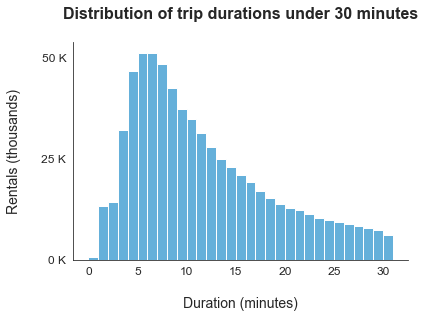

In [305]:
sb.set_style('white')
sb.set_palette(palette = "colorblind", n_colors = 10, desat = 0.8)
base_color = sb.color_palette()[9]
bin_edges = np.arange(0, duration_lim_30.duration_min.max()+2, 1)

plt.hist(duration_lim_30['duration_min'], color = base_color, bins = bin_edges)
plt.title('Distribution of trip durations under 30 minutes\n',  weight = 'bold', fontsize = 16)
plt.xlabel('\nDuration (minutes)', fontsize = 14)
plt.ylabel('Rentals (thousands)\n', fontsize = 14)
plt.xticks(fontsize = 12)

locs, labels = plt.yticks()
y_tick_locs = np.arange(0, int(math.ceil(max(locs)))+1000, 25000)
y_tick_names = ['{:0.0f} K'.format(loc/1000) for loc in y_tick_locs]
plt.yticks(y_tick_locs, y_tick_names, fontsize=12)
sb.despine();

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.19.j Distribution of rental durations under 30 minutes on trip type.png', dpi=300, bbox_inches='tight')

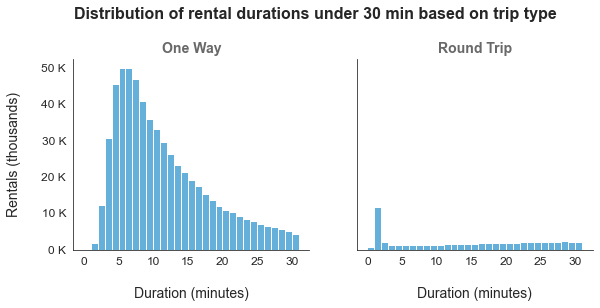

In [306]:
sb.set_style('white')
sb.set_palette(palette = "colorblind", n_colors = 10, desat = 0.8)
base_color = sb.color_palette()[9]

g = sb.FacetGrid(data = duration_lim_30, col = 'trip_type', col_wrap = 2, height = 4, aspect = 1)
g.map(plt.hist, "duration_min", color = base_color, bins = np.arange(0, duration_lim_30.duration_min.max()+2, 1))
g.fig.subplots_adjust(top=0.8)
g.fig.suptitle('Distribution of rental durations under 30 min based on trip type\n', fontsize = 16, weight = 'bold')
g.set_titles('{col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# obtain y_ticks and convert them to a multiple of millions
# obtain the x_ticks and store them as a list
y_tick_names = []
x_tick_names = []
for ax in g.axes.flat:
    for y_label in ax.get_yticklabels():
        y_label_value = int(y_label.get_text())
        y_label_new_value = '{:0.0f} K'.format(y_label_value/1000)
        y_tick_names.append(y_label_new_value)
        
    for x_label in ax.get_xticklabels():
        x_label_value = x_label.get_text()
        x_tick_names.append(x_label_value)

g.set_yticklabels(y_tick_names, size = 12)
g.set_xticklabels(x_tick_names, size = 12)
g.set_xlabels('\nDuration (minutes)', size = 14)
g.set_ylabels('Rentals (thousands)\n', size = 14)

plt.subplots_adjust(wspace=0.2, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.19.k Facet Grid of rental durations under 30 minutes on trip type.png', dpi=300, bbox_inches='tight')

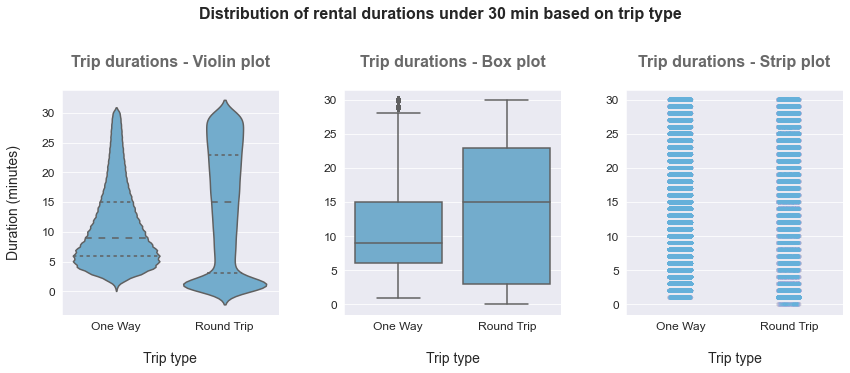

In [307]:
plt.figure(figsize = [14, 5])
sb.set_style('darkgrid')
base_color = sb.color_palette()[9]

# left plot: violin plot
plt.subplot(1, 3, 1)
sb.violinplot(data = duration_lim_30, x = 'trip_type', y = 'duration_min', 
              inner = 'quartile', color = base_color)
plt.title('Trip durations - Violin plot\n',  weight = 'bold', fontsize = 16, color = 'dimgrey')
plt.xlabel('\nTrip type', fontsize = 14)
plt.ylabel('Duration (minutes)\n', fontsize = 14)
plt.xticks(fontsize = 12)
plt.yticks(fontsize = 12)

# center plot: box plot
plt.subplot(1, 3, 2)
sb.boxplot(data = duration_lim_30, x = 'trip_type', y = 'duration_min', color = base_color)
plt.title('Trip durations - Box plot\n',  weight = 'bold', fontsize = 16, color = 'dimgrey')
plt.xlabel('\nTrip type', fontsize = 14)
plt.ylabel('', fontsize = 14)
plt.xticks(fontsize = 12)
plt.yticks(fontsize = 12)

# right plot: strip chart
plt.subplot(1, 3, 3)
sb.stripplot(data = duration_lim_30, x="trip_type", y="duration_min", alpha = 0.002, color = base_color)
plt.title('Trip durations - Strip plot\n',  weight = 'bold', fontsize = 16, color = 'dimgrey')
plt.xlabel('\nTrip type', fontsize = 14)
plt.ylabel('', fontsize = 14)
plt.xticks(fontsize = 12)
plt.yticks(fontsize = 12)

plt.subplots_adjust(wspace=0.3, hspace=0.3)
plt.subplots_adjust(top=0.75)
plt.suptitle('Distribution of rental durations under 30 min based on trip type\n', fontsize = 16, weight = 'bold');

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.19.l Distribution of trip durations under 30 minutes on various plots.png', dpi=300, bbox_inches='tight')

Calculate the `average trip duration` and the `most frequent trip duration` subjected to each `trip type`.

In [308]:
oneway_mean = math.ceil(duration_lim_30.query(' trip_type == "One Way" ').duration_min.mean())
oneway_mode = duration_lim_30.query(' trip_type == "One Way" ').duration_min.mode()[0]

roundtrip_mean = math.ceil(duration_lim_30.query(' trip_type == "Round Trip" ').duration_min.mean())
roundtrip_mode = duration_lim_30.query(' trip_type == "Round Trip" ').duration_min.mode()[0]

print('Duration mean'.center(30,'-'))
print('oneway_mean    : ', oneway_mean, 'minutes')
print('roundtrip_mean : ', roundtrip_mean, 'minutes')
print('\n')
print('Duration mode'.center(30,'-'))
print('oneway_mode    : ', oneway_mode, 'minutes')
print('roundtrip_mode : ', roundtrip_mode, 'minutes')

--------Duration mean---------
oneway_mean    :  11 minutes
roundtrip_mean :  15 minutes


--------Duration mode---------
oneway_mode    :  5 minutes
roundtrip_mode :  1 minutes


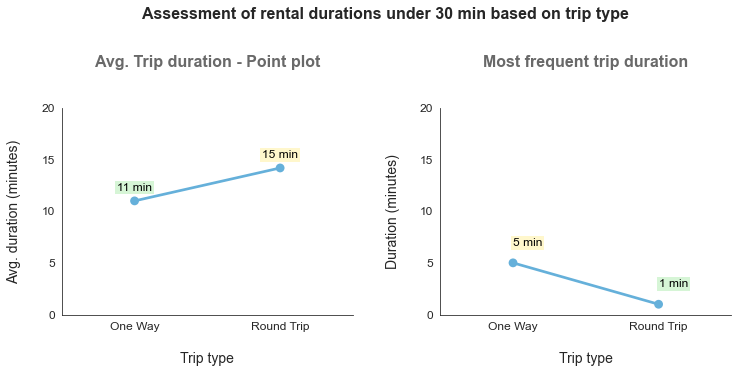

In [309]:
plt.figure(figsize = [12, 5])

sb.set_palette(palette = "colorblind", n_colors = 10, desat = 0.8)
base_color = sb.color_palette()[9]

# left plot: point plot - Avg trip duration
sb.set_style('white')
plt.subplot(1, 2, 1)
ax1 = sb.pointplot(data = duration_lim_30, x = "trip_type", y = "duration_min", linestyles = "-", color = base_color)
plt.title('Avg. Trip duration - Point plot\n\n',  weight = 'bold', fontsize = 16, color = 'dimgrey')
plt.ylabel('Avg. duration (minutes)\n', fontsize = 14)
plt.xlabel('\nTrip type', fontsize = 14)
plt.xticks(fontsize = 12)

locs, labels = plt.yticks()
y_ticks_new = np.arange(0, int(math.ceil(max(locs)))+10, 5)
plt.yticks(y_ticks_new, y_ticks_new, fontsize=12)
sb.despine(top=True, bottom=False, left=False, right=True);

# add annotations
# -------------------------------------------------------
cat_order = duration_lim_30.trip_type.sort_values(ascending=True).unique()
avg_rental_counts = duration_lim_30.groupby([duration_lim_30["trip_type"]]).mean().duration_min[cat_order]
avg_rental_max = avg_rental_counts.max()
clrs = ['gold' if (count > ((avg_rental_max*4)/5)) else 'limegreen' for count in avg_rental_counts ]

# get the current tick locations and labels
locs, labels = plt.xticks()

# loop through each pair of locations and labels
for loc, label, avg_rental_count, clr in zip(locs, labels, avg_rental_counts, clrs):
    try:
        count = avg_rental_count
    except KeyError:
        count = 0   
    pct_string = '{:0.0f} min'.format(math.ceil(count))
    # print the annotation depending on the bar length
    plt.text(loc, count + int(avg_rental_max/10), pct_string, ha = 'center', color = 'black', 
             fontsize = 12, bbox=dict(pad=1.9,alpha=0.2,color='none',fc=clr))
# -------------------------------------------------------

# right plot: Bar chart - most frequent trip duration
sb.set_style('white')
plt.subplot(1, 2, 2)
oneway_mode = duration_lim_30.query(' trip_type == "One Way" ').duration_min.mode()[0]
roundtrip_mode = duration_lim_30.query(' trip_type == "Round Trip" ').duration_min.mode()[0]
heights = [oneway_mode, roundtrip_mode]
labels = duration_lim_30.trip_type.sort_values(ascending=True).unique()
sb.pointplot(x = labels, y = heights, color = base_color)
plt.title('Most frequent trip duration\n\n',  weight = 'bold', fontsize = 16, color = 'dimgrey')
plt.xlabel('\nTrip type', fontsize = 14)
plt.ylabel('Duration (minutes)\n', fontsize = 14)
plt.xticks(fontsize = 12)
plt.ylim(ax1.get_ylim())

locs, labels = plt.yticks()
y_ticks_new = np.arange(0, int(math.ceil(max(locs)))+5, 5)
plt.yticks(y_ticks_new, y_ticks_new, fontsize=12)
sb.despine();

# add annotations
# -------------------------------------------------------
freq_rental_counts = heights
freq_rental_max = max(freq_rental_counts)
clrs = ['gold' if (count > ((freq_rental_max*4)/5)) else 'limegreen' for count in freq_rental_counts ]

# get the current tick locations and labels
locs, labels = plt.xticks()

# loop through each pair of locations and labels
for loc, label, freq_rental_count, clr in zip(locs, labels, freq_rental_counts, clrs):
    try:
        count = freq_rental_count
    except KeyError:
        count = 0   
    pct_string = '{:0.0f} min'.format(math.ceil(count))
    # print the annotation depending on the bar length
    plt.text(loc+0.1, count + (freq_rental_max/3), pct_string, ha = 'center', color = 'black', 
             fontsize = 12, bbox=dict(pad=1.9,alpha=0.2,color='none',fc=clr))
# -------------------------------------------------------

plt.subplots_adjust(wspace=0.3, hspace=0.3)
plt.subplots_adjust(top=0.7)
plt.suptitle('Assessment of rental durations under 30 min based on trip type\n', fontsize = 16, weight = 'bold');

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.19.m Average trip durations under 30 minutes based on trip type.png', dpi=300, bbox_inches='tight')

> If the trip type  is `One Way`, and dateset limited to trips under `30 minutes`, then the bike rentals has an average rental duration of `10` minutes and mode of `5` minutes.

> If the trip type  is `Round Trip`, and dateset limited to trips under `30 minutes`, then the bike rentals has an average rental duration of `11` minutes and mode of `1` minutes. 

`The mode being 1 minute of round trips is probably because of return of the bicycle immediately after rental due to technical or other issue. Hence exclude the round trips under 1 minute and re-evalute its mode.`

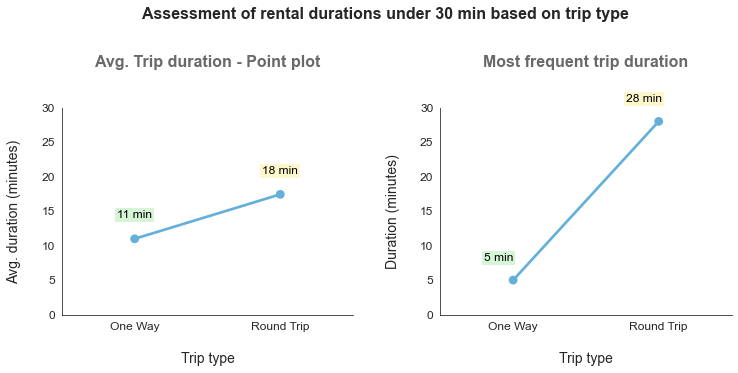

In [310]:
drop_index = duration_lim_30.query(' trip_type == "Round Trip" and duration_min <= 1 ').index
temp_df = duration_lim_30.drop(drop_index)

plt.figure(figsize = [12, 5])
sb.set_palette(palette = "colorblind", n_colors = 10, desat = 0.8)
base_color = sb.color_palette()[9]

# left plot: point plot - Avg trip duration
sb.set_style('white')
plt.subplot(1, 2, 1)
ax1 = sb.pointplot(data = temp_df, x = "trip_type", y = "duration_min", linestyles = "-", color = base_color)
plt.title('Avg. Trip duration - Point plot\n\n',  weight = 'bold', fontsize = 16, color = 'dimgrey')
plt.ylabel('Avg. duration (minutes)\n', fontsize = 14)
plt.xlabel('\nTrip type', fontsize = 14)
plt.xticks(fontsize = 12)

locs, labels = plt.yticks()
y_ticks_new = np.arange(0, int(math.ceil(max(locs)))+15, 5)
plt.yticks(y_ticks_new, y_ticks_new, fontsize=12)
sb.despine(top=True, bottom=False, left=False, right=True);

# add annotations
# -------------------------------------------------------
cat_order = temp_df.trip_type.sort_values(ascending=True).unique()
avg_rental_counts = temp_df.groupby([temp_df["trip_type"]]).mean().duration_min[cat_order]
avg_rental_max = avg_rental_counts.max()
clrs = ['gold' if (count > ((avg_rental_max*4)/5)) else 'limegreen' for count in avg_rental_counts ]

# get the current tick locations and labels
locs, labels = plt.xticks()

# loop through each pair of locations and labels
for loc, label, avg_rental_count, clr in zip(locs, labels, avg_rental_counts, clrs):
    try:
        count = avg_rental_count
    except KeyError:
        count = 0   
    pct_string = '{:0.0f} min'.format(math.ceil(count))
    # print the annotation depending on the bar length
    plt.text(loc, count + int(avg_rental_max/5), pct_string, ha = 'center', color = 'black', 
             fontsize = 12, bbox=dict(pad=1.9,alpha=0.2,color='none',fc=clr))
# -------------------------------------------------------

# right plot: Bar chart - most frequent trip duration
sb.set_style('white')
plt.subplot(1, 2, 2)
oneway_mode = temp_df.query(' trip_type == "One Way" ').duration_min.mode()[0]
roundtrip_mode = temp_df.query(' trip_type == "Round Trip" ').duration_min.mode()[0]
heights = [oneway_mode, roundtrip_mode]
labels = temp_df.trip_type.sort_values(ascending=True).unique()
sb.pointplot(x = labels, y = heights, color = base_color)
plt.title('Most frequent trip duration\n\n',  weight = 'bold', fontsize = 16, color = 'dimgrey')
plt.xlabel('\nTrip type', fontsize = 14)
plt.ylabel('Duration (minutes)\n', fontsize = 14)
plt.xticks(fontsize = 12)
plt.ylim(ax1.get_ylim())

locs, labels = plt.yticks()
y_ticks_new = np.arange(0, int(math.ceil(max(locs)))+5, 5)
plt.yticks(y_ticks_new, y_ticks_new, fontsize=12)
sb.despine();

# add annotations
# -------------------------------------------------------
freq_rental_counts = heights
freq_rental_max = max(freq_rental_counts)
clrs = ['gold' if (count > ((freq_rental_max*4)/5)) else 'limegreen' for count in freq_rental_counts ]

# get the current tick locations and labels
locs, labels = plt.xticks()

# loop through each pair of locations and labels
for loc, label, freq_rental_count, clr in zip(locs, labels, freq_rental_counts, clrs):
    try:
        count = freq_rental_count
    except KeyError:
        count = 0   
    pct_string = '{:0.0f} min'.format(math.ceil(count))
    # print the annotation depending on the bar length
    plt.text(loc-0.1, count + (freq_rental_max/10), pct_string, ha = 'center', color = 'black', 
             fontsize = 12, bbox=dict(pad=1.9,alpha=0.2,color='none',fc=clr))
# -------------------------------------------------------

plt.subplots_adjust(wspace=0.3, hspace=0.3)
plt.subplots_adjust(top=0.7)
plt.suptitle('Assessment of rental durations under 30 min based on trip type\n', fontsize = 16, weight = 'bold');

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.19.n Average trip durations under 30 minutes based on trip type.png', dpi=300, bbox_inches='tight')

>  If the trip type  is `One Way`, and dateset limited to trips under `30 minutes`, then the bike rentals has an average rental duration of `11` minutes and mode of `5` minutes. 

> If the trip type  is `Round Trip`, and dateset limited to trips `30 minutes` (excluding `1 minute` trips), then the bike rentals has an increase in average rental duration to `18` minutes and increase in mode to `28` minutes. 

`Tabular data of the average trip durations based on the dataset limitation of duration entries:`

| Dataset used to measure - | Avg trip duration (min) |
|:--------------------------|:------------------------|

|                         |    One Way    |  Round Trip   |
|:-----------------------:|:-------------:|:-------------:|
| trips under 30 minutes  |      11       |      18       |
| trips under 120 minutes |      16       |      39       |
| overall trips           |      24       |      71       |

`Tabular data of the most frequent trip durations based on the dataset limitation of duration entries:`

| Dataset used to measure - | Most freq trip duration (min) |
|:--------------------------|:------------------------|

|                         |    One Way    |  Round Trip   |
|:-----------------------:|:-------------:|:-------------:|
| trips under 30 minutes  |       5       |      28       |
| trips under 120 minutes |       5       |      28       |
| overall trips           |       5       |      28       |

In [311]:
duration_df = pd.DataFrame()
duration_df['dataset'] = ['< 30', '< 30', '< 120', '< 120', 'overall', 'overall']
duration_df['trip_type'] = ['One Way', 'Round Trip', 'One Way', 'Round Trip', 'One Way', 'Round Trip']
duration_df['duration_avg'] = [11, 18, 16, 39, 24, 71]
duration_df['duration_mode'] = [5, 28, 5, 28, 5, 28]
duration_df

,dataset,trip_type,duration_avg,duration_mode
0,< 30,One Way,11,5
1,< 30,Round Trip,18,28
2,< 120,One Way,16,5
3,< 120,Round Trip,39,28
4,overall,One Way,24,5
5,overall,Round Trip,71,28


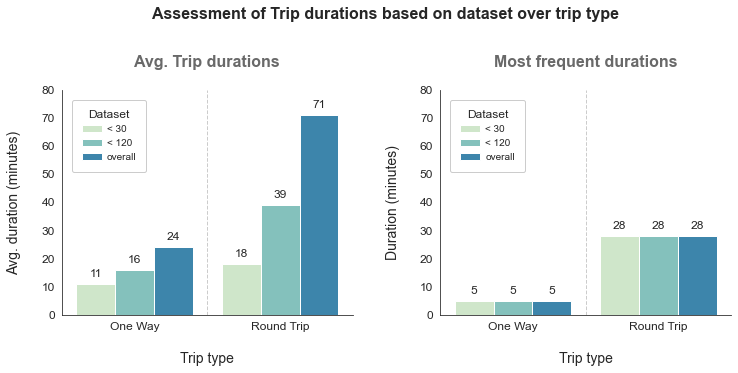

In [312]:
plt.figure(figsize = [12, 5])
sb.set_palette(palette = "GnBu", n_colors = 3, desat = None)
base_color = sb.color_palette()[2]

# left plot: point plot - Avg trip duration
# -------------------------------------------------------
sb.set_style('white')
plt.subplot(1, 2, 1)
ax1 = sb.barplot(data = duration_df, x = 'trip_type', y = 'duration_avg', hue = 'dataset')
plt.title('Avg. Trip durations\n',  weight = 'bold', fontsize = 16, color ='dimgrey')
plt.ylabel('Avg. duration (minutes)\n', fontsize = 14)
plt.xlabel('\nTrip type', fontsize = 14)
plt.xticks(fontsize = 12)

locs, labels = plt.yticks()
y_ticks_new = np.arange(0, int(math.ceil(max(locs)))+10, 10)
plt.yticks(y_ticks_new, y_ticks_new, fontsize=12)

plt.legend(scatterpoints=1, frameon=True, fancybox=True, shadow=False, framealpha = 1, 
           borderpad=1, borderaxespad=1, loc = 'upper left', labelspacing=0.5, ncol = 1,  
           title='Dataset', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5)

# add annotations
for p in ax1.patches:
    ax1.annotate(format(p.get_height(), '.0f'), (p.get_x() + p.get_width() / 2., p.get_height()), 
                 ha = 'center', va = 'center', xytext = (0, 10), textcoords = 'offset points', fontsize = 12)

separators = [0.5]
for loc in separators:
    plt.axvline(loc, ls='--', color='grey', linewidth=1, alpha=0.4);

sb.despine(top=True, bottom=False, left=False, right=True);
# -------------------------------------------------------


# right plot: Bar chart - most frequent trip duration
# -------------------------------------------------------
sb.set_style('white')
plt.subplot(1, 2, 2)
g = sb.barplot(data = duration_df, x = 'trip_type', y = 'duration_mode', hue = 'dataset')
plt.title('Most frequent durations\n',  weight = 'bold', fontsize = 16, color ='dimgrey')
plt.ylabel('Duration (minutes)\n', fontsize = 14)
plt.xlabel('\nTrip type', fontsize = 14)
plt.xticks(fontsize = 12)
plt.ylim(ax1.get_ylim())

locs, labels = plt.yticks()
y_ticks_new = np.arange(0, int(math.ceil(max(locs)))+10, 10)
plt.yticks(y_ticks_new, y_ticks_new, fontsize=12)

plt.legend(scatterpoints=1, frameon=True, fancybox=True, shadow=False, framealpha = 1, 
           borderpad=1, borderaxespad=1, loc = 'upper left', labelspacing=0.5, ncol = 1,  
           title='Dataset', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5)

# add annotations
for p in g.patches:
    g.annotate(format(p.get_height(), '.0f'), (p.get_x() + p.get_width() / 2., p.get_height()), 
               ha = 'center', va = 'center', xytext = (0, 10), textcoords = 'offset points', fontsize = 12)

separators = [0.5]
for loc in separators:
    plt.axvline(loc, ls='--', color='grey', linewidth=1, alpha=0.4);

sb.despine(top=True, bottom=False, left=False, right=True);
# -------------------------------------------------------

plt.subplots_adjust(wspace=0.3, hspace=0.3)
plt.subplots_adjust(top=0.75)
plt.suptitle('Assessment of Trip durations based on dataset over trip type\n', fontsize = 16, weight = 'bold');

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.19.o Assessment of Trip durations based on dataset over trip type.png', dpi=300, bbox_inches='tight')

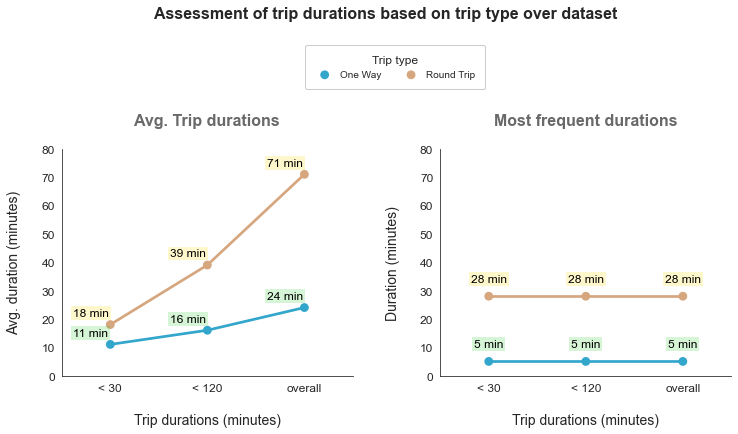

In [313]:
plt.figure(figsize = [12, 6])
flatui = ['deepskyblue', 'sandybrown']
sb.set_palette(flatui, n_colors=2, desat=0.6)

# left plot: point plot - Avg trip duration
# -------------------------------------------------------
# -------------------------------------------------------
sb.set_style('white')
plt.subplot(1, 2, 1)

ax1 = sb.pointplot(data = duration_df, x = 'dataset', y = 'duration_avg', hue = 'trip_type')
plt.title('Avg. Trip durations\n',  weight = 'bold', fontsize = 16, color = 'dimgrey')
plt.ylabel('Avg. duration (minutes)\n', fontsize = 14)
plt.xlabel('\nTrip durations (minutes)', fontsize = 14)
plt.xticks(fontsize = 12)

locs, labels = plt.yticks()
y_ticks_new = np.arange(0, int(math.ceil(max(locs)))+10, 10)
plt.yticks(y_ticks_new, y_ticks_new, fontsize=12)

# add annotations
# -------------------------------------------------------
locs = [0, 0, 1, 1, 2, 2]
avg_rental_counts = duration_df["duration_avg"]
avg_rental_types = duration_df["trip_type"]
avg_rental_max = avg_rental_counts.max()
clrs = ['gold' if (trip == "Round Trip") else 'limegreen' for trip in avg_rental_types ]

# get the current tick locations and labels
# locs, labels = plt.xticks()

# loop through each pair of locations and labels
for loc, avg_rental_count, clr in zip(locs, avg_rental_counts, clrs):
    try:
        count = avg_rental_count
    except KeyError:
        count = 0   
    pct_string = '{:0.0f} min'.format(math.ceil(count))
    # print the annotation depending on the bar length
    plt.text(loc-0.2, count + int(avg_rental_max/20), pct_string, ha = 'center', color = 'black', fontsize = 12,
             bbox={'pad':1.9,'alpha':0.2,'color':'none','fc':clr})
# -------------------------------------------------------

plt.legend('', frameon=False, fancybox=False)

sb.despine(top=True, bottom=False, left=False, right=True);
# -------------------------------------------------------
# -------------------------------------------------------


# right plot: point plot - most frequent trip duration
# -------------------------------------------------------
# -------------------------------------------------------
sb.set_style('white')
plt.subplot(1, 2, 2)

sb.pointplot(data = duration_df, x = 'dataset', y = 'duration_mode', hue = 'trip_type')
plt.title('Most frequent durations\n',  weight = 'bold', fontsize = 16, color = 'dimgrey')
plt.ylabel('Duration (minutes)\n', fontsize = 14)
plt.xlabel('\nTrip durations (minutes)', fontsize = 14)
plt.xticks(fontsize = 12)
plt.ylim(ax1.get_ylim())

locs, labels = plt.yticks()
y_ticks_new = np.arange(0, int(math.ceil(max(locs)))+10, 10)
plt.yticks(y_ticks_new, y_ticks_new, fontsize=12)

# add annotations
# -------------------------------------------------------
locs = [0, 0, 1, 1, 2, 2]
freq_rental_counts = duration_df["duration_mode"]
freq_rental_types = duration_df["trip_type"]
freq_rental_max = freq_rental_counts.max()
clrs = ['gold' if (trip == "Round Trip") else 'limegreen' for trip in freq_rental_types ]

# loop through each pair of locations and labels
for loc, freq_rental_count, clr in zip(locs, freq_rental_counts, clrs):
    try:
        count = freq_rental_count
    except KeyError:
        count = 0   
    pct_string = '{:0.0f} min'.format(math.ceil(count))
    # print the annotation depending on the bar length
    plt.text(loc, count + int(freq_rental_max/5), pct_string, ha = 'center', color = 'black', fontsize = 12,
             bbox={'pad':1.9,'alpha':0.2,'color':'none','fc':clr})
# -------------------------------------------------------

plt.legend(scatterpoints=1, frameon=True, fancybox=True, shadow=False, framealpha = 1, 
           borderpad=1, borderaxespad=1, loc = 'upper left', labelspacing=0.5, ncol = 2,  
           title='Trip type', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(-0.5, 1.5))

sb.despine(top=True, bottom=False, left=False, right=True);
# -------------------------------------------------------
# -------------------------------------------------------

plt.subplots_adjust(wspace=0.3, hspace=0.3)
plt.subplots_adjust(top=0.65)
plt.suptitle('Assessment of trip durations based on trip type over dataset\n', fontsize = 16, weight = 'bold');

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.19.p Assessment of trip durations based on trip type over dataset.png', dpi=300, bbox_inches='tight')

-----

#### 3.2.20 Bivariate analysis of `duration_min` and `bike_type` columns:

+ `Columns`: duration_min, bike_type
+ `Data type`: (Numerical, continuous) and (Categorical, nominal)
+ `Plot`: Facet Grid, Violin plot, Box plot, Adapted Barchart

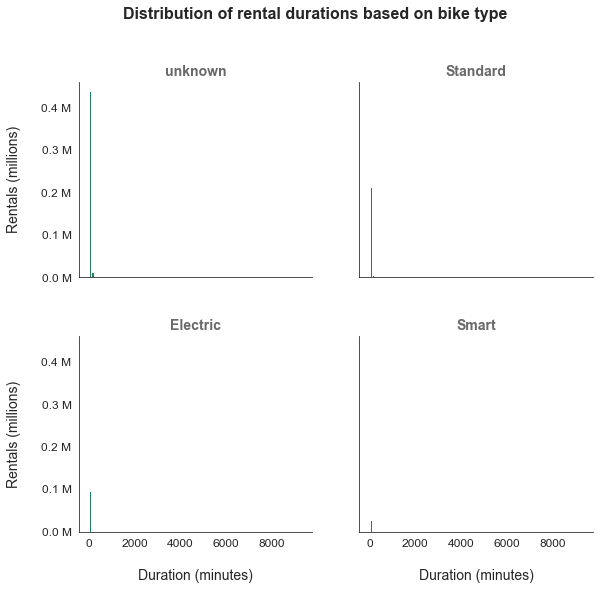

In [314]:
sb.set_style('white')
sb.set_palette(palette = "colorblind", n_colors = 10, desat = 0.6)
base_color = sb.color_palette()[2]

g = sb.FacetGrid(data = bikeshare, col = 'bike_type', col_wrap = 2, height = 4, aspect = 1)
g.map(plt.hist, "duration_min", color = base_color, bins = np.arange(0, bikeshare.duration_min.max()+100, 100))
g.fig.subplots_adjust(top=0.85)
g.fig.suptitle('Distribution of rental durations based on bike type\n', fontsize = 16, weight = 'bold')
g.set_titles('{col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# obtain y_ticks and convert them to a multiple of millions
# obtain the x_ticks and store them as a list
y_tick_names = []
x_tick_names = []
for ax in g.axes.flat:
    for y_label in ax.get_yticklabels():
        y_label_value = int(y_label.get_text())
        y_label_new_value = '{:0.1f} M'.format(y_label_value/1000000)
        y_tick_names.append(y_label_new_value)
        
    for x_label in ax.get_xticklabels():
        x_label_value = x_label.get_text()
        x_tick_names.append(x_label_value)

g.set_yticklabels(y_tick_names, size = 12)
g.set_xticklabels(x_tick_names, size = 12)
g.set_xlabels('\nDuration (minutes)', size = 14)
g.set_ylabels('Rentals (millions)\n', size = 14)

plt.subplots_adjust(wspace=0.2, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.20.a Facet Grid of rental durations on bike type.png', dpi=300, bbox_inches='tight')

> The distribution of `duration_min` values are vague and not easy to interpret. This can be overcome by limiting the plot to a threshold value. Let us plot more variety of graphs to observe the distribution of data and hidden insights.

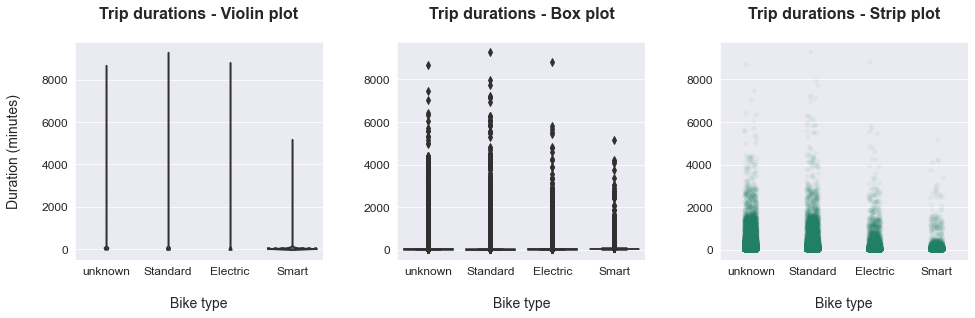

In [315]:
plt.figure(figsize = [16, 4])
sb.set_style('darkgrid')
sb.set_palette(palette = "colorblind", n_colors = 10, desat = 0.6)
base_color = sb.color_palette()[2]

# left plot: violin plot
plt.subplot(1, 3, 1)
sb.violinplot(data = bikeshare, x = 'bike_type', y = 'duration_min', inner = 'quartile',
              color = base_color)
plt.title('Trip durations - Violin plot\n',  weight = 'bold', fontsize = 16)
plt.xlabel('\nBike type', fontsize = 14)
plt.ylabel('Duration (minutes)\n', fontsize = 14)
plt.xticks(fontsize = 12)
plt.yticks(fontsize = 12)

# center plot: box plot
plt.subplot(1, 3, 2)
sb.boxplot(data = bikeshare, x = 'bike_type', y = 'duration_min', color = base_color)
plt.title('Trip durations - Box plot\n',  weight = 'bold', fontsize = 16)
plt.xlabel('\nBike type', fontsize = 14)
plt.ylabel('', fontsize = 14)
plt.xticks(fontsize = 12)
plt.yticks(fontsize = 12)

# right plot: strip chart
plt.subplot(1, 3, 3)
sb.stripplot(x="bike_type", y="duration_min", data=bikeshare, alpha = 0.05, color = base_color)
plt.title('Trip durations - Strip plot\n',  weight = 'bold', fontsize = 16)
plt.xlabel('\nBike type', fontsize = 14)
plt.ylabel('', fontsize = 14)
plt.xticks(fontsize = 12)
plt.yticks(fontsize = 12)

plt.subplots_adjust(wspace=0.3, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust dhe figure to include all of the x and y labels
plt.savefig('plots/3.2.20.b Distribution of Bike type durations on various plots.png', dpi=300, bbox_inches='tight')

> The above plot depicts the presense of long tail of outliers, and require closer observation for better understanding of the data distribution.

Calculate the `average trip duration` and the `most frequent trip duration` subjected to each `bike type`.

In [316]:
unknown_mean = math.ceil(bikeshare.query(' bike_type == "unknown" ').duration_min.mean())
unknown_mode = bikeshare.query(' bike_type == "unknown" ').duration_min.mode()[0]

standard_mean = math.ceil(bikeshare.query(' bike_type == "Standard" ').duration_min.mean())
standard_mode = bikeshare.query(' bike_type == "Standard" ').duration_min.mode()[0]

electric_mean = math.ceil(bikeshare.query(' bike_type == "Electric" ').duration_min.mean())
electric_mode = bikeshare.query(' bike_type == "Electric" ').duration_min.mode()[0]

smart_mean = math.ceil(bikeshare.query(' bike_type == "Smart" ').duration_min.mean())
smart_mode = bikeshare.query(' bike_type == "Smart" ').duration_min.mode()[0]

print('Duration mean'.center(30,'-'))
print('unknown_mean  : ', unknown_mean, 'minutes')
print('standard_mean : ', standard_mean, 'minutes')
print('electric_mean : ', electric_mean, 'minutes')
print('smart_mean    : ', smart_mean, 'minutes')
print('\n')
print('Duration mode'.center(30,'-'))
print('unknown_mode  : ', unknown_mode, 'minutes')
print('standard_mode : ', standard_mode, 'minutes')
print('electric_mode : ', electric_mode, 'minutes')
print('smart_mode    : ', smart_mode, 'minutes')

--------Duration mean---------
unknown_mean  :  31 minutes
standard_mean :  31 minutes
electric_mean :  24 minutes
smart_mean    :  42 minutes


--------Duration mode---------
unknown_mode  :  6 minutes
standard_mode :  5 minutes
electric_mode :  4 minutes
smart_mode    :  1 minutes


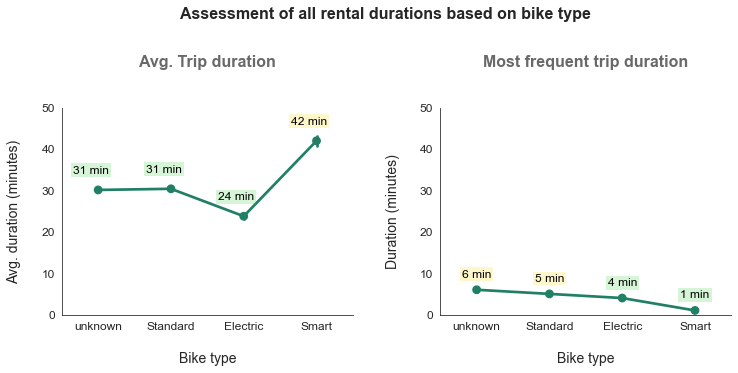

In [317]:
plt.figure(figsize = [12, 5])

sb.set_palette(palette = "colorblind", n_colors = 10, desat = 0.6)
base_color = sb.color_palette()[2]

# left plot: point plot - Avg trip duration
sb.set_style('white')
plt.subplot(1, 2, 1)
ax1 = sb.pointplot(data = bikeshare, x = "bike_type", y = "duration_min", linestyles = "-", color = base_color)
plt.title('Avg. Trip duration\n\n',  weight = 'bold', fontsize = 16, color = 'dimgrey')
plt.ylabel('Avg. duration (minutes)\n', fontsize = 14)
plt.xlabel('\nBike type', fontsize = 14)
plt.xticks(fontsize = 12)

locs, labels = plt.yticks()
y_ticks_new = np.arange(0, int(math.ceil(max(locs)))+10, 10)
plt.yticks(y_ticks_new, y_ticks_new, fontsize=12)
sb.despine(top=True, bottom=False, left=False, right=True);

# add annotations
# -------------------------------------------------------
cat_order = bikeshare.bike_type.sort_values(ascending=True).unique()
avg_rental_counts = bikeshare.groupby([bikeshare["bike_type"]]).mean().duration_min[cat_order]
avg_rental_max = avg_rental_counts.max()
clrs = ['gold' if (count > ((avg_rental_max*4)/5)) else 'limegreen' for count in avg_rental_counts ]

# get the current tick locations and labels
locs, labels = plt.xticks()

# loop through each pair of locations and labels
for loc, label, avg_rental_count, clr in zip(locs, labels, avg_rental_counts, clrs):
    try:
        count = avg_rental_count
    except KeyError:
        count = 0   
    pct_string = '{:0.0f} min'.format(math.ceil(count))
    # print the annotation depending on the bar length
    plt.text(loc-0.1, count + int(avg_rental_max/10), pct_string, ha = 'center', color = 'black', 
             fontsize = 12, bbox=dict(pad=1.9,alpha=0.2,color='none',fc=clr))
# -------------------------------------------------------

# right plot: Bar chart - most frequent trip duration
sb.set_style('white')
plt.subplot(1, 2, 2)
unknown_mode = bikeshare.query(' bike_type == "unknown" ').duration_min.mode()[0]
standard_mode = bikeshare.query(' bike_type == "Standard" ').duration_min.mode()[0]
electric_mode = bikeshare.query(' bike_type == "Electric" ').duration_min.mode()[0]
smart_mode = bikeshare.query(' bike_type == "Smart" ').duration_min.mode()[0]
heights = [unknown_mode, standard_mode, electric_mode, smart_mode]
labels = bikeshare.bike_type.sort_values(ascending=True).unique()
sb.pointplot(x = labels, y = heights, color = base_color)
plt.title('Most frequent trip duration\n\n',  weight = 'bold', fontsize = 16, color = 'dimgrey')
plt.xlabel('\nBike type', fontsize = 14)
plt.ylabel('Duration (minutes)\n', fontsize = 14)
plt.xticks(fontsize = 12)
plt.ylim(ax1.get_ylim())

locs, labels = plt.yticks()
y_ticks_new = np.arange(0, int(math.ceil(max(locs)))+10, 10)
plt.yticks(y_ticks_new, y_ticks_new, fontsize=12)
sb.despine();

# add annotations
# -------------------------------------------------------
freq_rental_counts = heights
freq_rental_max = max(freq_rental_counts)
clrs = ['gold' if (count > ((freq_rental_max*4)/5)) else 'limegreen' for count in freq_rental_counts ]

# get the current tick locations and labels
locs, labels = plt.xticks()

# loop through each pair of locations and labels
for loc, label, freq_rental_count, clr in zip(locs, labels, freq_rental_counts, clrs):
    try:
        count = freq_rental_count
    except KeyError:
        count = 0   
    pct_string = '{:0.0f} min'.format(math.ceil(count))
    # print the annotation depending on the bar length
    plt.text(loc, count + (freq_rental_max/2), pct_string, ha = 'center', color = 'black', 
             fontsize = 12, bbox=dict(pad=1.9,alpha=0.2,color='none',fc=clr))
# -------------------------------------------------------

plt.subplots_adjust(wspace=0.3, hspace=0.3)
plt.subplots_adjust(top=0.7)
plt.suptitle('Assessment of all rental durations based on bike type\n', fontsize = 16, weight = 'bold');

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.20.c Average trip durations based on bike type.png', dpi=300, bbox_inches='tight')

> + If the `bike_type` is `unknown`, then the bike rentals has an average rental duration of `31 minutes` and mode of `6 minutes`.
+ If the `bike_type` is `Standard`, then the bike rentals has an average rental duration of `31 minutes` and mode of `5 minutes`.
+ If the `bike_type` is `Electric`, then the bike rentals has an average rental duration of `24 minutes` and mode of `4 minutes`.
+ If the `bike_type` is `Smart`, then the bike rentals has an average rental duration of `42 minutes` and mode of `1 minute`.

`The mode being 1 minute is probably because of return of the bicycle immediately after rental due to technical or other issue. Hence exclude the trips that are under 1 minute duration and re-evalute the statistics.`

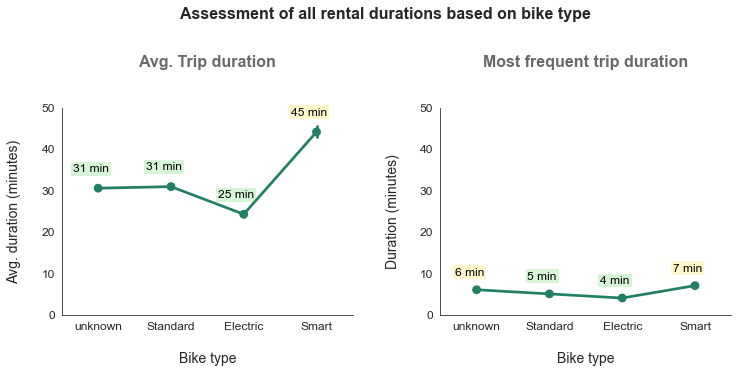

In [318]:
drop_index = bikeshare.query(' duration_min <= 1 ').index
temp_df = bikeshare.drop(drop_index)

plt.figure(figsize = [12, 5])
sb.set_palette(palette = "colorblind", n_colors = 10, desat = 0.6)
base_color = sb.color_palette()[2]

# left plot: point plot - Avg trip duration
sb.set_style('white')
plt.subplot(1, 2, 1)
ax1 = sb.pointplot(data = temp_df, x = "bike_type", y = "duration_min", linestyles = "-", color = base_color)
plt.title('Avg. Trip duration\n\n',  weight = 'bold', fontsize = 16, color = 'dimgrey')
plt.ylabel('Avg. duration (minutes)\n', fontsize = 14)
plt.xlabel('\nBike type', fontsize = 14)
plt.xticks(fontsize = 12)

locs, labels = plt.yticks()
y_ticks_new = np.arange(0, int(math.ceil(max(locs)))+10, 10)
plt.yticks(y_ticks_new, y_ticks_new, fontsize=12)
sb.despine(top=True, bottom=False, left=False, right=True);

# add annotations
# -------------------------------------------------------
cat_order = temp_df.bike_type.sort_values(ascending=True).unique()
avg_rental_counts = temp_df.groupby([temp_df["bike_type"]]).mean().duration_min[cat_order]
avg_rental_max = avg_rental_counts.max()
clrs = ['gold' if (count > ((avg_rental_max*4)/5)) else 'limegreen' for count in avg_rental_counts ]

# get the current tick locations and labels
locs, labels = plt.xticks()

# loop through each pair of locations and labels
for loc, label, avg_rental_count, clr in zip(locs, labels, avg_rental_counts, clrs):
    try:
        count = avg_rental_count
    except KeyError:
        count = 0   
    pct_string = '{:0.0f} min'.format(math.ceil(count))
    # print the annotation depending on the bar length
    plt.text(loc-0.1, count + int(avg_rental_max/10), pct_string, ha = 'center', color = 'black', 
             fontsize = 12, bbox=dict(pad=1.9,alpha=0.2,color='none',fc=clr))
# -------------------------------------------------------

# right plot: Bar chart - most frequent trip duration
sb.set_style('white')
plt.subplot(1, 2, 2)
unknown_mode = temp_df.query(' bike_type == "unknown" ').duration_min.mode()[0]
standard_mode = temp_df.query(' bike_type == "Standard" ').duration_min.mode()[0]
electric_mode = temp_df.query(' bike_type == "Electric" ').duration_min.mode()[0]
smart_mode = temp_df.query(' bike_type == "Smart" ').duration_min.mode()[0]
heights = [unknown_mode, standard_mode, electric_mode, smart_mode]
labels = temp_df.bike_type.sort_values(ascending=True).unique()
sb.pointplot(x = labels, y = heights, color = base_color)
plt.title('Most frequent trip duration\n\n',  weight = 'bold', fontsize = 16, color = 'dimgrey')
plt.xlabel('\nBike type', fontsize = 14)
plt.ylabel('Duration (minutes)\n', fontsize = 14)
plt.xticks(fontsize = 12)
plt.ylim(ax1.get_ylim())

locs, labels = plt.yticks()
y_ticks_new = np.arange(0, int(math.ceil(max(locs)))+10, 10)
plt.yticks(y_ticks_new, y_ticks_new, fontsize=12)
sb.despine();

# add annotations
# -------------------------------------------------------
freq_rental_counts = heights
freq_rental_max = max(freq_rental_counts)
clrs = ['gold' if (count > ((freq_rental_max*4)/5)) else 'limegreen' for count in freq_rental_counts ]

# get the current tick locations and labels
locs, labels = plt.xticks()

# loop through each pair of locations and labels
for loc, label, freq_rental_count, clr in zip(locs, labels, freq_rental_counts, clrs):
    try:
        count = freq_rental_count
    except KeyError:
        count = 0   
    pct_string = '{:0.0f} min'.format(math.ceil(count))
    # print the annotation depending on the bar length
    plt.text(loc-0.1, count + (freq_rental_max/2), pct_string, ha = 'center', color = 'black', 
             fontsize = 12, bbox=dict(pad=1.9,alpha=0.2,color='none',fc=clr))
# -------------------------------------------------------

plt.subplots_adjust(wspace=0.3, hspace=0.3)
plt.subplots_adjust(top=0.7)
plt.suptitle('Assessment of all rental durations based on bike type\n', fontsize = 16, weight = 'bold');

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.20.d Average trip durations based on bike type.png', dpi=300, bbox_inches='tight')

When the trips with durations `<= 1 minute` are removed from the assessment, then the result is as follows:

> + If the `bike_type` is `unknown`, then the bike rentals has an average rental duration of `31 minutes` and mode of `6 minutes`.
+ If the `bike_type` is `Standard`, then the bike rentals has an average rental duration of `31 minutes` and mode of `5 minutes`.
+ If the `bike_type` is `Electric`, then the bike rentals has an increase in average rental duration to `25 minutes` and mode of `4 minutes`.
+ If the `bike_type` is `Smart`, then the bike rentals has an increase in average rental duration to `45 minutes` and considerable increase in mode to `7 minute`.

**`Dataset limited under 120 min:`**

In [319]:
bikeshare.duration_min.describe()

count    808589.000000
mean         29.861795
std         119.355799
min           0.000000
25%           6.000000
50%          12.000000
75%          23.000000
max        9283.000000
Name: duration_min, dtype: float64

> The distribution of `duration_min` values are vague and not easy to interpret. This can be overcome by limiting the dataset to a threshold value, say `120 minutes` or `2 hours` as most of the `duration_min` values falls under this boundary.

In [320]:
# calculate the percentage of the dataset that falls under `2 hour` trip duration.
np.round((bikeshare.query(' duration_min <= 120 ').shape[0]/bikeshare.shape[0])*100, 2)

96.9

In [321]:
duration_120 = bikeshare.query(' duration_min > 120 ')

# calculate the proportion of the trips with 'unknown' bike type, that will be dropped
unknown_type_drops = np.round((duration_120.query(' bike_type == "unknown" ').shape[0]/
                               bikeshare.query(' bike_type == "unknown" ').shape[0])*100, 2)

# calculate the proportion of the trips with 'Standard' bike type, that will be dropped
standard_type_drops = np.round((duration_120.query(' bike_type == "Standard" ').shape[0]/
                                bikeshare.query(' bike_type == "Standard" ').shape[0])*100, 2)

# calculate the proportion of the trips with 'Electric' bike type, that will be dropped
electric_type_drops = np.round((duration_120.query(' bike_type == "Electric" ').shape[0]/
                                bikeshare.query(' bike_type == "Electric" ').shape[0])*100, 2)

# calculate the proportion of the trips with 'Smart' bike type, that will be dropped
smart_type_drops = np.round((duration_120.query(' bike_type == "Smart" ').shape[0]/
                             bikeshare.query(' bike_type == "Smart" ').shape[0])*100, 2)

print("Proportion of unknown type entries that will be dropped".ljust(60, ' '), ':', unknown_type_drops)
print("Proportion of standard type entries that will be dropped".ljust(60, ' '), ':', standard_type_drops)
print("Proportion of electric type entries that will be dropped".ljust(60, ' '), ':', electric_type_drops)
print("Proportion of smart type entries that will be dropped".ljust(60, ' '), ':', smart_type_drops)

Proportion of unknown type entries that will be dropped      : 3.26
Proportion of standard type entries that will be dropped     : 3.19
Proportion of electric type entries that will be dropped     : 1.71
Proportion of smart type entries that will be dropped        : 4.52


In [322]:
# Limit the dataset that has entries under 2 hours duration
duration_lim_120 = bikeshare.query(' duration_min <= 120 ')

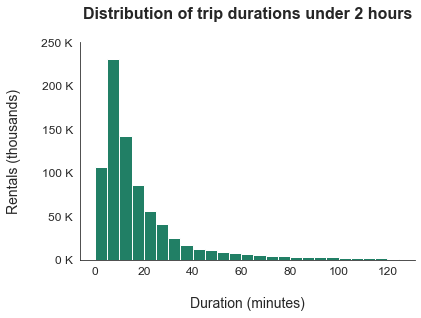

In [323]:
sb.set_style('white')
sb.set_palette(palette = "colorblind", n_colors = 10, desat = 0.6)
base_color = sb.color_palette()[2]
bin_edges = np.arange(0, duration_lim_120.duration_min.max()+10, 5)

plt.hist(duration_lim_120['duration_min'], color = base_color, bins = bin_edges)
plt.title('Distribution of trip durations under 2 hours\n',  weight = 'bold', fontsize = 16)
plt.xlabel('\nDuration (minutes)', fontsize = 14)
plt.ylabel('Rentals (thousands)\n', fontsize = 14)
plt.xticks(fontsize = 12)

locs, labels = plt.yticks()
y_tick_locs = np.arange(0, int(math.ceil(max(locs)))+1000, 50000)
y_tick_names = ['{:0.0f} K'.format(loc/1000) for loc in y_tick_locs]
plt.yticks(y_tick_locs, y_tick_names, fontsize=12)
sb.despine();

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.20.e Distribution of trip durations under 2 hours.png', dpi=300, bbox_inches='tight')

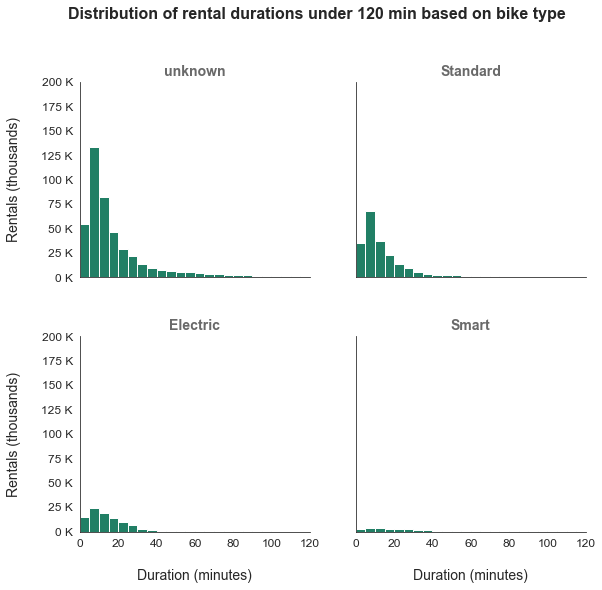

In [324]:
sb.set_style('white')
sb.set_palette(palette = "colorblind", n_colors = 10, desat = 0.6)
base_color = sb.color_palette()[2]

g = sb.FacetGrid(data = duration_lim_120, col = 'bike_type', col_wrap = 2, height = 4, aspect = 1, xlim=(0,120))
g.set(xmargin=0.5, ymargin=0.5)
g.map(plt.hist, "duration_min", color = base_color, bins = np.arange(0, duration_lim_120.duration_min.max()+10, 5))
g.fig.subplots_adjust(top=0.85)
g.fig.suptitle('Distribution of rental durations under 120 min based on bike type\n', fontsize = 16, weight = 'bold')
g.set_titles('{col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# obtain y_ticks and convert them to a multiple of thousands
# obtain the x_ticks and store them as a list
y_tick_names = []
x_tick_names = []
for ax in g.axes.flat:
    for y_label in ax.get_yticklabels():
        y_label_value = int(y_label.get_text())
        y_label_new_value = '{:0.0f} K'.format(y_label_value/1000)
        y_tick_names.append(y_label_new_value)
        
    for x_label in ax.get_xticklabels():
        x_label_value = x_label.get_text()
        x_tick_names.append(x_label_value)

g.set_yticklabels(y_tick_names, size = 12)
g.set_xticklabels(x_tick_names, size = 12)
g.set_xlabels('\nDuration (minutes)', size = 14)
g.set_ylabels('Rentals (thousands)\n', size = 14)

plt.subplots_adjust(wspace=0.2, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.20.f Facet Grid of rental durations under 2 hours on bike type.png', dpi=300, bbox_inches='tight')

> Let us plot more variety of graphs to observe the distribution of data and hidden insights.

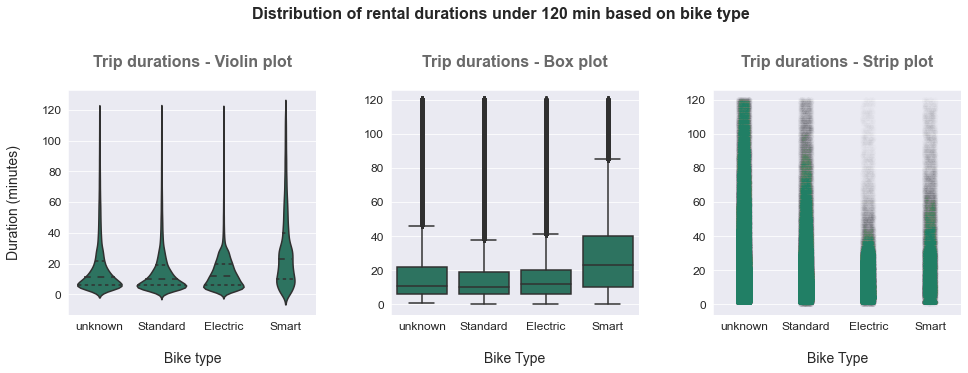

In [325]:
plt.figure(figsize = [16, 5])
sb.set_style('darkgrid')
sb.set_palette(palette = "colorblind", n_colors = 10, desat = 0.6)
base_color = sb.color_palette()[2]

# left plot: violin plot
plt.subplot(1, 3, 1)
sb.violinplot(data = duration_lim_120, x = 'bike_type', y = 'duration_min', 
              inner = 'quartile', color = base_color)
plt.title('Trip durations - Violin plot\n',  weight = 'bold', fontsize = 16, color = 'dimgrey')
plt.xlabel('\nBike type', fontsize = 14)
plt.ylabel('Duration (minutes)\n', fontsize = 14)
plt.xticks(fontsize = 12)
plt.yticks(fontsize = 12)

# center plot: box plot
plt.subplot(1, 3, 2)
sb.boxplot(data = duration_lim_120, x = 'bike_type', y = 'duration_min', color = base_color)
plt.title('Trip durations - Box plot\n',  weight = 'bold', fontsize = 16, color = 'dimgrey')
plt.xlabel('\nBike Type', fontsize = 14)
plt.ylabel('', fontsize = 14)
plt.xticks(fontsize = 12)
plt.yticks(fontsize = 12)

# right plot: strip chart
plt.subplot(1, 3, 3)
sb.stripplot(data = duration_lim_120, x="bike_type", y="duration_min", alpha = 0.002, color = base_color)
plt.title('Trip durations - Strip plot\n',  weight = 'bold', fontsize = 16, color = 'dimgrey')
plt.xlabel('\nBike Type', fontsize = 14)
plt.ylabel('', fontsize = 14)
plt.xticks(fontsize = 12)
plt.yticks(fontsize = 12)

plt.subplots_adjust(wspace=0.3, hspace=0.3)
plt.subplots_adjust(top=0.75)
plt.suptitle('Distribution of rental durations under 120 min based on bike type\n', fontsize = 16, weight = 'bold');

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.20.g Distribution of Bike type durations under 2 hours on various plots.png', dpi=300, bbox_inches='tight')

> The above plot depicts the presense of long tail of outliers, and require even closer observation for better understanding of the data distribution.

Calculate the `average trip duration` and the `most frequent trip duration` subjected to each `bike type`.

In [326]:
unknown_mean = math.ceil(duration_lim_120.query(' bike_type == "unknown" ').duration_min.mean())
unknown_mode = duration_lim_120.query(' bike_type == "unknown" ').duration_min.mode()[0]

standard_mean = math.ceil(duration_lim_120.query(' bike_type == "Standard" ').duration_min.mean())
standard_mode = duration_lim_120.query(' bike_type == "Standard" ').duration_min.mode()[0]

electric_mean = math.ceil(duration_lim_120.query(' bike_type == "Electric" ').duration_min.mean())
electric_mode = duration_lim_120.query(' bike_type == "Electric" ').duration_min.mode()[0]

smart_mean = math.ceil(duration_lim_120.query(' bike_type == "Smart" ').duration_min.mean())
smart_mode = duration_lim_120.query(' bike_type == "Smart" ').duration_min.mode()[0]

print('Duration mean'.center(30,'-'))
print('unknown_mean  : ', unknown_mean, 'minutes')
print('standard_mean : ', standard_mean, 'minutes')
print('electric_mean : ', electric_mean, 'minutes')
print('smart_mean    : ', smart_mean, 'minutes')
print('\n')
print('Duration mode'.center(30,'-'))
print('unknown_mode  : ', unknown_mode, 'minutes')
print('standard_mode : ', standard_mode, 'minutes')
print('electric_mode : ', electric_mode, 'minutes')
print('smart_mode    : ', smart_mode, 'minutes')

--------Duration mean---------
unknown_mean  :  19 minutes
standard_mean :  17 minutes
electric_mean :  15 minutes
smart_mean    :  30 minutes


--------Duration mode---------
unknown_mode  :  6 minutes
standard_mode :  5 minutes
electric_mode :  4 minutes
smart_mode    :  1 minutes


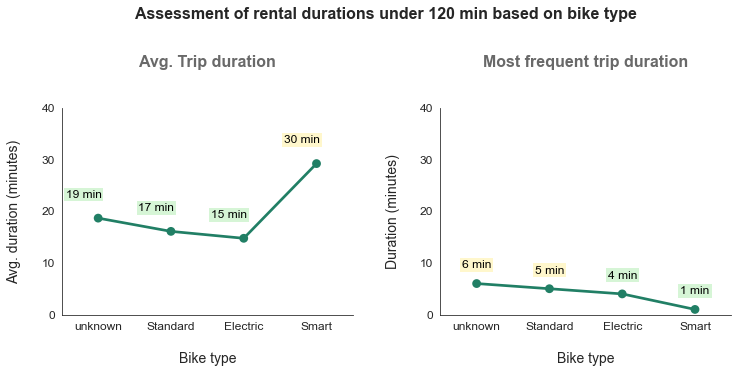

In [327]:
plt.figure(figsize = [12, 5])

sb.set_palette(palette = "colorblind", n_colors = 10, desat = 0.6)
base_color = sb.color_palette()[2]

# left plot: point plot - Avg trip duration
sb.set_style('white')
plt.subplot(1, 2, 1)
ax1 = sb.pointplot(data = duration_lim_120, x = "bike_type", y = "duration_min", linestyles = "-", color = base_color)
plt.title('Avg. Trip duration\n\n',  weight = 'bold', fontsize = 16, color = 'dimgrey')
plt.ylabel('Avg. duration (minutes)\n', fontsize = 14)
plt.xlabel('\nBike type', fontsize = 14)
plt.xticks(fontsize = 12)

locs, labels = plt.yticks()
y_ticks_new = np.arange(0, int(math.ceil(max(locs)))+10, 10)
plt.yticks(y_ticks_new, y_ticks_new, fontsize=12)
sb.despine(top=True, bottom=False, left=False, right=True);

# add annotations
# -------------------------------------------------------
cat_order = duration_lim_120.bike_type.sort_values(ascending=True).unique()
avg_rental_counts = duration_lim_120.groupby([duration_lim_120["bike_type"]]).mean().duration_min[cat_order]
avg_rental_max = avg_rental_counts.max()
clrs = ['gold' if (count > ((avg_rental_max*4)/5)) else 'limegreen' for count in avg_rental_counts ]

# get the current tick locations and labels
locs, labels = plt.xticks()

# loop through each pair of locations and labels
for loc, label, avg_rental_count, clr in zip(locs, labels, avg_rental_counts, clrs):
    try:
        count = avg_rental_count
    except KeyError:
        count = 0   
    pct_string = '{:0.0f} min'.format(math.ceil(count))
    # print the annotation depending on the bar length
    plt.text(loc-0.2, count + int(avg_rental_max/7), pct_string, ha = 'center', color = 'black', 
             fontsize = 12, bbox=dict(pad=1.9,alpha=0.2,color='none',fc=clr))
# -------------------------------------------------------

# right plot: Bar chart - most frequent trip duration
sb.set_style('white')
plt.subplot(1, 2, 2)
unknown_mode = duration_lim_120.query(' bike_type == "unknown" ').duration_min.mode()[0]
standard_mode = duration_lim_120.query(' bike_type == "Standard" ').duration_min.mode()[0]
electric_mode = duration_lim_120.query(' bike_type == "Electric" ').duration_min.mode()[0]
smart_mode = duration_lim_120.query(' bike_type == "Smart" ').duration_min.mode()[0]
heights = [unknown_mode, standard_mode, electric_mode, smart_mode]
labels = duration_lim_120.bike_type.sort_values(ascending=True).unique()
sb.pointplot(x = labels, y = heights, color = base_color)
plt.title('Most frequent trip duration\n\n',  weight = 'bold', fontsize = 16, color = 'dimgrey')
plt.xlabel('\nBike type', fontsize = 14)
plt.ylabel('Duration (minutes)\n', fontsize = 14)
plt.xticks(fontsize = 12)
plt.ylim(ax1.get_ylim())

locs, labels = plt.yticks()
y_ticks_new = np.arange(0, int(math.ceil(max(locs)))+10, 10)
plt.yticks(y_ticks_new, y_ticks_new, fontsize=12)
sb.despine();

# add annotations
# -------------------------------------------------------
freq_rental_counts = heights
freq_rental_max = max(freq_rental_counts)
clrs = ['gold' if (count > ((freq_rental_max*4)/5)) else 'limegreen' for count in freq_rental_counts ]

# get the current tick locations and labels
locs, labels = plt.xticks()

# loop through each pair of locations and labels
for loc, label, freq_rental_count, clr in zip(locs, labels, freq_rental_counts, clrs):
    try:
        count = freq_rental_count
    except KeyError:
        count = 0   
    pct_string = '{:0.0f} min'.format(math.ceil(count))
    # print the annotation depending on the bar length
    plt.text(loc, count + (freq_rental_max/2), pct_string, ha = 'center', color = 'black', 
             fontsize = 12, bbox=dict(pad=1.9,alpha=0.2,color='none',fc=clr))
# -------------------------------------------------------

plt.subplots_adjust(wspace=0.3, hspace=0.3)
plt.subplots_adjust(top=0.7)
plt.suptitle('Assessment of rental durations under 120 min based on bike type\n', fontsize = 16, weight = 'bold');

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.20.h Average trip durations under 2 hours based on bike type.png', dpi=300, bbox_inches='tight')

`When the dataset is limited to trips under 120 minutes:`

> + If the `bike_type` is `unknown`, then the bike rentals has an average rental duration of `19 minutes` and mode of `6 minutes`.
+ If the `bike_type` is `Standard`, then the bike rentals has an average rental duration of `17 minutes` and mode of `5 minutes`.
+ If the `bike_type` is `Electric`, then the bike rentals has an average rental duration of `15 minutes` and mode of `4 minutes`.
+ If the `bike_type` is `Smart`, then the bike rentals has an average rental duration of `30 minutes` and mode of `1 minute`.

`The mode being 1 minute is probably because of return of the bicycle immediately after rental due to technical or other issue. Hence exclude the trips that are under 1 minute duration and re-evalute the statistics.`

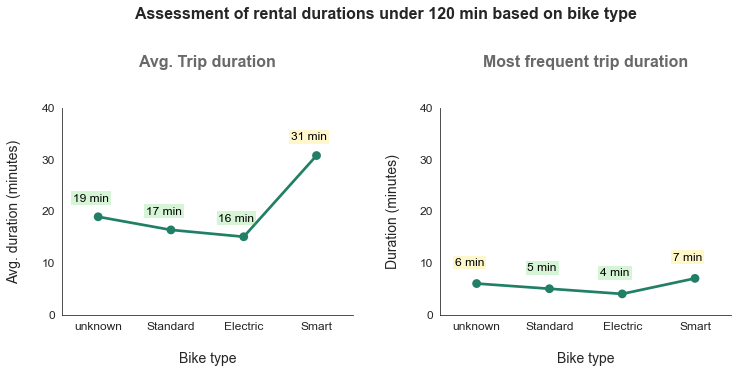

In [328]:
drop_index = duration_lim_120.query(' duration_min <= 1 ').index
temp_df = duration_lim_120.drop(drop_index)

plt.figure(figsize = [12, 5])
sb.set_palette(palette = "colorblind", n_colors = 10, desat = 0.6)
base_color = sb.color_palette()[2]

# left plot: point plot - Avg trip duration
sb.set_style('white')
plt.subplot(1, 2, 1)
ax1 = sb.pointplot(data = temp_df, x = "bike_type", y = "duration_min", linestyles = "-", color = base_color)
plt.title('Avg. Trip duration\n\n',  weight = 'bold', fontsize = 16, color = 'dimgrey')
plt.ylabel('Avg. duration (minutes)\n', fontsize = 14)
plt.xlabel('\nBike type', fontsize = 14)
plt.xticks(fontsize = 12)

locs, labels = plt.yticks()
y_ticks_new = np.arange(0, int(math.ceil(max(locs)))+10, 10)
plt.yticks(y_ticks_new, y_ticks_new, fontsize=12)
sb.despine(top=True, bottom=False, left=False, right=True);

# add annotations
# -------------------------------------------------------
cat_order = temp_df.bike_type.sort_values(ascending=True).unique()
avg_rental_counts = temp_df.groupby([temp_df["bike_type"]]).mean().duration_min[cat_order]
avg_rental_max = avg_rental_counts.max()
clrs = ['gold' if (count > ((avg_rental_max*4)/5)) else 'limegreen' for count in avg_rental_counts ]

# get the current tick locations and labels
locs, labels = plt.xticks()

# loop through each pair of locations and labels
for loc, label, avg_rental_count, clr in zip(locs, labels, avg_rental_counts, clrs):
    try:
        count = avg_rental_count
    except KeyError:
        count = 0   
    pct_string = '{:0.0f} min'.format(math.ceil(count))
    # print the annotation depending on the bar length
    plt.text(loc-0.1, count + int(avg_rental_max/10), pct_string, ha = 'center', color = 'black', 
             fontsize = 12, bbox=dict(pad=1.9,alpha=0.2,color='none',fc=clr))
# -------------------------------------------------------

# right plot: Bar chart - most frequent trip duration
sb.set_style('white')
plt.subplot(1, 2, 2)
unknown_mode = temp_df.query(' bike_type == "unknown" ').duration_min.mode()[0]
standard_mode = temp_df.query(' bike_type == "Standard" ').duration_min.mode()[0]
electric_mode = temp_df.query(' bike_type == "Electric" ').duration_min.mode()[0]
smart_mode = temp_df.query(' bike_type == "Smart" ').duration_min.mode()[0]
heights = [unknown_mode, standard_mode, electric_mode, smart_mode]
labels = temp_df.bike_type.sort_values(ascending=True).unique()
sb.pointplot(x = labels, y = heights, color = base_color)
plt.title('Most frequent trip duration\n\n',  weight = 'bold', fontsize = 16, color = 'dimgrey')
plt.xlabel('\nBike type', fontsize = 14)
plt.ylabel('Duration (minutes)\n', fontsize = 14)
plt.xticks(fontsize = 12)
plt.ylim(ax1.get_ylim())

locs, labels = plt.yticks()
y_ticks_new = np.arange(0, int(math.ceil(max(locs)))+10, 10)
plt.yticks(y_ticks_new, y_ticks_new, fontsize=12)
sb.despine();

# add annotations
# -------------------------------------------------------
freq_rental_counts = heights
freq_rental_max = max(freq_rental_counts)
clrs = ['gold' if (count > ((freq_rental_max*4)/5)) else 'limegreen' for count in freq_rental_counts ]

# get the current tick locations and labels
locs, labels = plt.xticks()

# loop through each pair of locations and labels
for loc, label, freq_rental_count, clr in zip(locs, labels, freq_rental_counts, clrs):
    try:
        count = freq_rental_count
    except KeyError:
        count = 0   
    pct_string = '{:0.0f} min'.format(math.ceil(count))
    # print the annotation depending on the bar length
    plt.text(loc-0.1, count + (freq_rental_max/2), pct_string, ha = 'center', color = 'black', 
             fontsize = 12, bbox=dict(pad=1.9,alpha=0.2,color='none',fc=clr))
# -------------------------------------------------------

plt.subplots_adjust(wspace=0.3, hspace=0.3)
plt.subplots_adjust(top=0.7)
plt.suptitle('Assessment of rental durations under 120 min based on bike type\n', fontsize = 16, weight = 'bold');

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.20.i Average trip durations under 2 hours based on bike type.png', dpi=300, bbox_inches='tight')

`When the dataset is limited to trips under 120 minutes (excluding 1 minute trips):`

> + If the `bike_type` is `unknown`, then the bike rentals has an average rental duration of `19 minutes` and mode of `6 minutes`.
+ If the `bike_type` is `Standard`, then the bike rentals has an average rental duration of `17 minutes` and mode of `5 minutes`.
+ If the `bike_type` is `Electric`, then the bike rentals has an increase in average rental duration to `16 minutes` and mode of `4 minutes`.
+ If the `bike_type` is `Smart`, then the bike rentals has an increase in average rental duration to `31 minutes` and increase in mode to `7 minute`.

**`Dataset limited under 30 min:`**

In [329]:
bikeshare.duration_min.describe()

count    808589.000000
mean         29.861795
std         119.355799
min           0.000000
25%           6.000000
50%          12.000000
75%          23.000000
max        9283.000000
Name: duration_min, dtype: float64

> The calculations are influenced by the presence of outliers. This can be overcome by limiting the dataset to a threshold value, say `30 minutes`  as more than 75% of the `duration_min` values falls under this boundary.

In [330]:
# Limit the dataset that has entries under 30 minutes duration
duration_lim_30 = bikeshare.query(' duration_min <= 30 ')

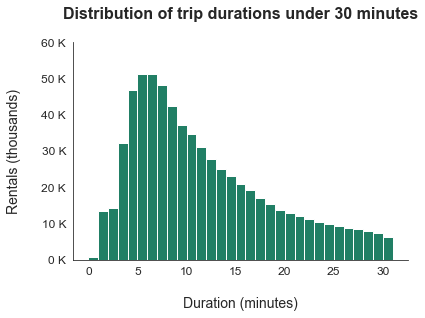

In [331]:
sb.set_style('white')
sb.set_palette(palette = "colorblind", n_colors = 10, desat = 0.6)
base_color = sb.color_palette()[2]
bin_edges = np.arange(0, duration_lim_30.duration_min.max()+2, 1)

plt.hist(duration_lim_30['duration_min'], color = base_color, bins = bin_edges)
plt.title('Distribution of trip durations under 30 minutes\n',  weight = 'bold', fontsize = 16)
plt.xlabel('\nDuration (minutes)', fontsize = 14)
plt.ylabel('Rentals (thousands)\n', fontsize = 14)
plt.xticks(fontsize = 12)

locs, labels = plt.yticks()
y_tick_locs = np.arange(0, int(math.ceil(max(locs)))+1000, 10000)
y_tick_names = ['{:0.0f} K'.format(loc/1000) for loc in y_tick_locs]
plt.yticks(y_tick_locs, y_tick_names, fontsize=12)
sb.despine();

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.20.j Distribution of trip durations under 30 minutes.png', dpi=300, bbox_inches='tight')

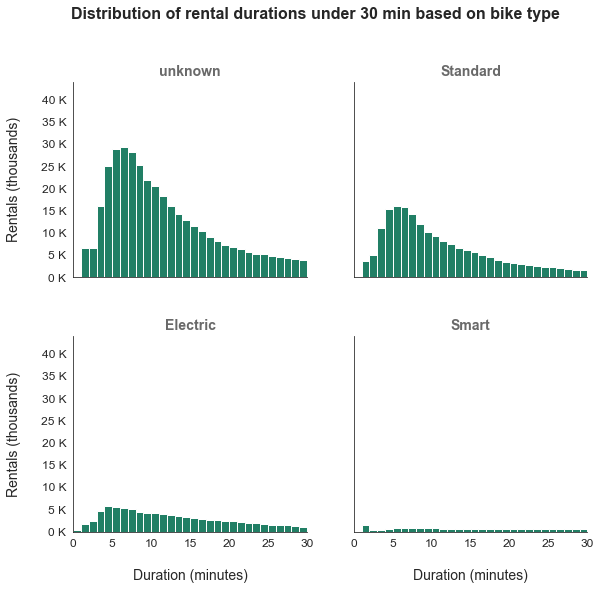

In [332]:
sb.set_style('white')
sb.set_palette(palette = "colorblind", n_colors = 10, desat = 0.6)
base_color = sb.color_palette()[2]

g = sb.FacetGrid(data = duration_lim_30, col = 'bike_type', col_wrap = 2, height = 4, aspect = 1, xlim=(0,30))
g.set(xmargin=0.5, ymargin=0.5)
g.map(plt.hist, "duration_min", color = base_color, bins = np.arange(0, duration_lim_30.duration_min.max()+2, 1))
g.fig.subplots_adjust(top=0.85)
g.fig.suptitle('Distribution of rental durations under 30 min based on bike type\n', fontsize = 16, weight = 'bold')
g.set_titles('{col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# obtain y_ticks and convert them to a multiple of thousands
# obtain the x_ticks and store them as a list
y_tick_names = []
x_tick_names = []
for ax in g.axes.flat:
    for y_label in ax.get_yticklabels():
        y_label_value = int(y_label.get_text())
        y_label_new_value = '{:0.0f} K'.format(y_label_value/1000)
        y_tick_names.append(y_label_new_value)
        
    for x_label in ax.get_xticklabels():
        x_label_value = x_label.get_text()
        x_tick_names.append(x_label_value)

g.set_yticklabels(y_tick_names, size = 12)
g.set_xticklabels(x_tick_names, size = 12)
g.set_xlabels('\nDuration (minutes)', size = 14)
g.set_ylabels('Rentals (thousands)\n', size = 14)

plt.subplots_adjust(wspace=0.2, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.20.k Facet Grid of rental durations under 30 minutes on bike type.png', dpi=300, bbox_inches='tight')

> Let us plot more variety of graphs to observe the distribution of data and hidden insights.

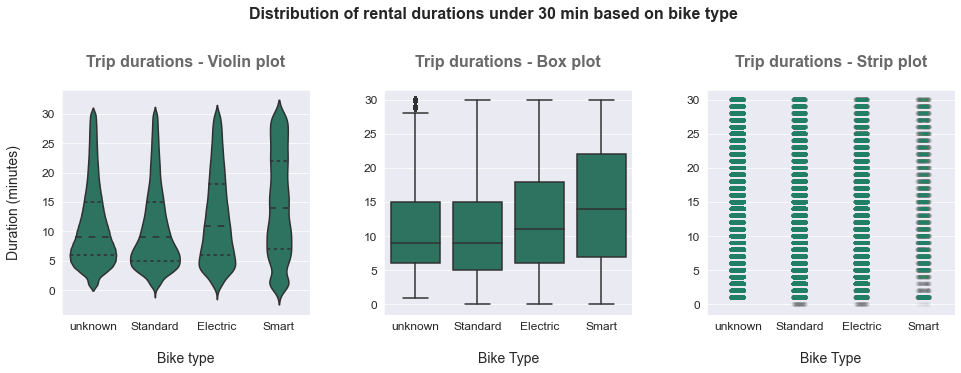

In [333]:
plt.figure(figsize = [16, 5])
sb.set_style('darkgrid')
sb.set_palette(palette = "colorblind", n_colors = 10, desat = 0.6)
base_color = sb.color_palette()[2]

# left plot: violin plot
plt.subplot(1, 3, 1)
sb.violinplot(data = duration_lim_30, x = 'bike_type', y = 'duration_min', 
              inner = 'quartile', color = base_color)
plt.title('Trip durations - Violin plot\n',  weight = 'bold', fontsize = 16, color = 'dimgrey')
plt.xlabel('\nBike type', fontsize = 14)
plt.ylabel('Duration (minutes)\n', fontsize = 14)
plt.xticks(fontsize = 12)
plt.yticks(fontsize = 12)

# center plot: box plot
plt.subplot(1, 3, 2)
sb.boxplot(data = duration_lim_30, x = 'bike_type', y = 'duration_min', color = base_color)
plt.title('Trip durations - Box plot\n',  weight = 'bold', fontsize = 16, color = 'dimgrey')
plt.xlabel('\nBike Type', fontsize = 14)
plt.ylabel('', fontsize = 14)
plt.xticks(fontsize = 12)
plt.yticks(fontsize = 12)

# right plot: strip chart
plt.subplot(1, 3, 3)
sb.stripplot(data = duration_lim_30, x="bike_type", y="duration_min", alpha = 0.002, color = base_color)
plt.title('Trip durations - Strip plot\n',  weight = 'bold', fontsize = 16, color = 'dimgrey')
plt.xlabel('\nBike Type', fontsize = 14)
plt.ylabel('', fontsize = 14)
plt.xticks(fontsize = 12)
plt.yticks(fontsize = 12)

plt.subplots_adjust(wspace=0.3, hspace=0.3)
plt.subplots_adjust(top=0.75)
plt.suptitle('Distribution of rental durations under 30 min based on bike type\n', fontsize = 16, weight = 'bold');

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.20.l Distribution of Bike type durations under 30 minutes on various plots.png', dpi=300, bbox_inches='tight')

Calculate the `average trip duration` and the `most frequent trip duration` subjected to each `bike type`.

In [334]:
unknown_mean = math.ceil(duration_lim_30.query(' bike_type == "unknown" ').duration_min.mean())
unknown_mode = duration_lim_30.query(' bike_type == "unknown" ').duration_min.mode()[0]

standard_mean = math.ceil(duration_lim_30.query(' bike_type == "Standard" ').duration_min.mean())
standard_mode = duration_lim_30.query(' bike_type == "Standard" ').duration_min.mode()[0]

electric_mean = math.ceil(duration_lim_30.query(' bike_type == "Electric" ').duration_min.mean())
electric_mode = duration_lim_30.query(' bike_type == "Electric" ').duration_min.mode()[0]

smart_mean = math.ceil(duration_lim_30.query(' bike_type == "Smart" ').duration_min.mean())
smart_mode = duration_lim_30.query(' bike_type == "Smart" ').duration_min.mode()[0]

print('Duration mean'.center(30,'-'))
print('unknown_mean  : ', unknown_mean, 'minutes')
print('standard_mean : ', standard_mean, 'minutes')
print('electric_mean : ', electric_mean, 'minutes')
print('smart_mean    : ', smart_mean, 'minutes')
print('\n')
print('Duration mode'.center(30,'-'))
print('unknown_mode  : ', unknown_mode, 'minutes')
print('standard_mode : ', standard_mode, 'minutes')
print('electric_mode : ', electric_mode, 'minutes')
print('smart_mode    : ', smart_mode, 'minutes')

--------Duration mean---------
unknown_mean  :  12 minutes
standard_mean :  11 minutes
electric_mean :  13 minutes
smart_mean    :  15 minutes


--------Duration mode---------
unknown_mode  :  6 minutes
standard_mode :  5 minutes
electric_mode :  4 minutes
smart_mode    :  1 minutes


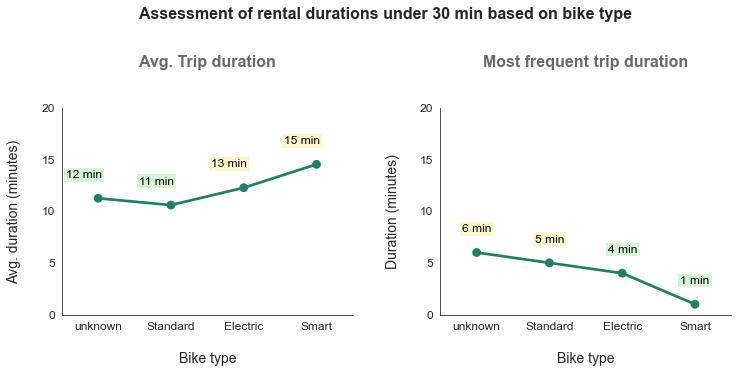

In [335]:
plt.figure(figsize = [12, 5])

sb.set_palette(palette = "colorblind", n_colors = 10, desat = 0.6)
base_color = sb.color_palette()[2]

# left plot: point plot - Avg trip duration
sb.set_style('white')
plt.subplot(1, 2, 1)
ax1 = sb.pointplot(data = duration_lim_30, x = "bike_type", y = "duration_min", linestyles = "-", color = base_color)
plt.title('Avg. Trip duration\n\n',  weight = 'bold', fontsize = 16, color = 'dimgrey')
plt.ylabel('Avg. duration (minutes)\n', fontsize = 14)
plt.xlabel('\nBike type', fontsize = 14)
plt.xticks(fontsize = 12)

locs, labels = plt.yticks()
y_ticks_new = np.arange(0, int(math.ceil(max(locs)))+10, 5)
plt.yticks(y_ticks_new, y_ticks_new, fontsize=12)
sb.despine(top=True, bottom=False, left=False, right=True);

# add annotations
# -------------------------------------------------------
cat_order = duration_lim_30.bike_type.sort_values(ascending=True).unique()
avg_rental_counts = duration_lim_30.groupby([duration_lim_30["bike_type"]]).mean().duration_min[cat_order]
avg_rental_max = avg_rental_counts.max()
clrs = ['gold' if (count > ((avg_rental_max*4)/5)) else 'limegreen' for count in avg_rental_counts ]

# get the current tick locations and labels
locs, labels = plt.xticks()

# loop through each pair of locations and labels
for loc, label, avg_rental_count, clr in zip(locs, labels, avg_rental_counts, clrs):
    try:
        count = avg_rental_count
    except KeyError:
        count = 0   
    pct_string = '{:0.0f} min'.format(math.ceil(count))
    # print the annotation depending on the bar length
    plt.text(loc-0.2, count + int(avg_rental_max/7), pct_string, ha = 'center', color = 'black', 
             fontsize = 12, bbox=dict(pad=1.9,alpha=0.2,color='none',fc=clr))
# -------------------------------------------------------

# right plot: Bar chart - most frequent trip duration
sb.set_style('white')
plt.subplot(1, 2, 2)
unknown_mode = duration_lim_30.query(' bike_type == "unknown" ').duration_min.mode()[0]
standard_mode = duration_lim_30.query(' bike_type == "Standard" ').duration_min.mode()[0]
electric_mode = duration_lim_30.query(' bike_type == "Electric" ').duration_min.mode()[0]
smart_mode = duration_lim_30.query(' bike_type == "Smart" ').duration_min.mode()[0]
heights = [unknown_mode, standard_mode, electric_mode, smart_mode]
labels = duration_lim_30.bike_type.sort_values(ascending=True).unique()
sb.pointplot(x = labels, y = heights, color = base_color)
plt.title('Most frequent trip duration\n\n',  weight = 'bold', fontsize = 16, color = 'dimgrey')
plt.xlabel('\nBike type', fontsize = 14)
plt.ylabel('Duration (minutes)\n', fontsize = 14)
plt.xticks(fontsize = 12)
plt.ylim(ax1.get_ylim())

locs, labels = plt.yticks()
y_ticks_new = np.arange(0, int(math.ceil(max(locs)))+5, 5)
plt.yticks(y_ticks_new, y_ticks_new, fontsize=12)
sb.despine();

# add annotations
# -------------------------------------------------------
freq_rental_counts = heights
freq_rental_max = max(freq_rental_counts)
clrs = ['gold' if (count > ((freq_rental_max*4)/5)) else 'limegreen' for count in freq_rental_counts ]

# get the current tick locations and labels
locs, labels = plt.xticks()

# loop through each pair of locations and labels
for loc, label, freq_rental_count, clr in zip(locs, labels, freq_rental_counts, clrs):
    try:
        count = freq_rental_count
    except KeyError:
        count = 0   
    pct_string = '{:0.0f} min'.format(math.ceil(count))
    # print the annotation depending on the bar length
    plt.text(loc, count + (freq_rental_max/3), pct_string, ha = 'center', color = 'black', 
             fontsize = 12, bbox=dict(pad=1.9,alpha=0.2,color='none',fc=clr))
# -------------------------------------------------------

plt.subplots_adjust(wspace=0.3, hspace=0.3)
plt.subplots_adjust(top=0.7)
plt.suptitle('Assessment of rental durations under 30 min based on bike type\n', fontsize = 16, weight = 'bold');

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.20.m Average trip durations under 30 minutes based on bike type.png', dpi=300, bbox_inches='tight')

`When the dataset is limited to trips under 30 minutes:`

> + If the `bike_type` is `unknown`, then the bike rentals has an average rental duration of `12 minutes` and mode of `6 minutes`.
+ If the `bike_type` is `Standard`, then the bike rentals has an average rental duration of `11 minutes` and mode of `5 minutes`.
+ If the `bike_type` is `Electric`, then the bike rentals has an average rental duration of `13 minutes` and mode of `4 minutes`.
+ If the `bike_type` is `Smart`, then the bike rentals has an average rental duration of `15 minutes` and mode of `1 minute`.

`The mode being 1 minute is probably because of return of the bicycle immediately after rental due to technical or other issue. Hence exclude the trips that are under 1 minute duration and re-evalute the statistics.`

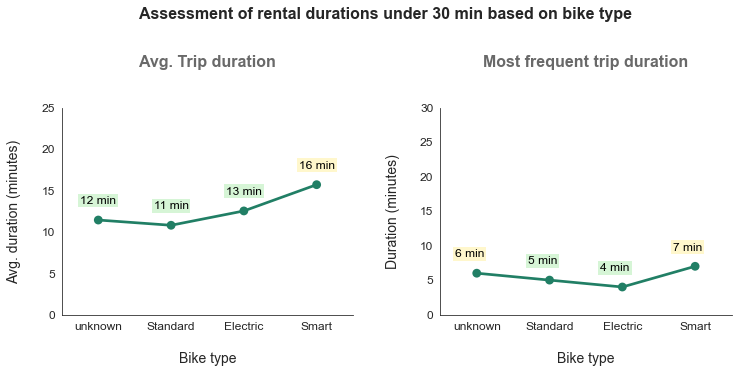

In [336]:
drop_index = duration_lim_30.query(' duration_min <= 1 ').index
temp_df = duration_lim_30.drop(drop_index)

plt.figure(figsize = [12, 5])
sb.set_palette(palette = "colorblind", n_colors = 10, desat = 0.6)
base_color = sb.color_palette()[2]

# left plot: point plot - Avg trip duration
sb.set_style('white')
plt.subplot(1, 2, 1)
ax1 = sb.pointplot(data = temp_df, x = "bike_type", y = "duration_min", linestyles = "-", color = base_color)
plt.title('Avg. Trip duration\n\n',  weight = 'bold', fontsize = 16, color = 'dimgrey')
plt.ylabel('Avg. duration (minutes)\n', fontsize = 14)
plt.xlabel('\nBike type', fontsize = 14)
plt.xticks(fontsize = 12)

locs, labels = plt.yticks()
y_ticks_new = np.arange(0, int(math.ceil(max(locs)))+10, 5)
plt.yticks(y_ticks_new, y_ticks_new, fontsize=12)
sb.despine(top=True, bottom=False, left=False, right=True);

# add annotations
# -------------------------------------------------------
cat_order = temp_df.bike_type.sort_values(ascending=True).unique()
avg_rental_counts = temp_df.groupby([temp_df["bike_type"]]).mean().duration_min[cat_order]
avg_rental_max = avg_rental_counts.max()
clrs = ['gold' if (count > ((avg_rental_max*4)/5)) else 'limegreen' for count in avg_rental_counts ]

# get the current tick locations and labels
locs, labels = plt.xticks()

# loop through each pair of locations and labels
for loc, label, avg_rental_count, clr in zip(locs, labels, avg_rental_counts, clrs):
    try:
        count = avg_rental_count
    except KeyError:
        count = 0   
    pct_string = '{:0.0f} min'.format(math.ceil(count))
    # print the annotation depending on the bar length
    plt.text(loc, count + int(avg_rental_max/7), pct_string, ha = 'center', color = 'black', 
             fontsize = 12, bbox=dict(pad=1.9,alpha=0.2,color='none',fc=clr))
# -------------------------------------------------------

# right plot: Bar chart - most frequent trip duration
sb.set_style('white')
plt.subplot(1, 2, 2)
unknown_mode = temp_df.query(' bike_type == "unknown" ').duration_min.mode()[0]
standard_mode = temp_df.query(' bike_type == "Standard" ').duration_min.mode()[0]
electric_mode = temp_df.query(' bike_type == "Electric" ').duration_min.mode()[0]
smart_mode = temp_df.query(' bike_type == "Smart" ').duration_min.mode()[0]
heights = [unknown_mode, standard_mode, electric_mode, smart_mode]
labels = temp_df.bike_type.sort_values(ascending=True).unique()
sb.pointplot(x = labels, y = heights, color = base_color)
plt.title('Most frequent trip duration\n\n',  weight = 'bold', fontsize = 16, color = 'dimgrey')
plt.xlabel('\nBike type', fontsize = 14)
plt.ylabel('Duration (minutes)\n', fontsize = 14)
plt.xticks(fontsize = 12)
plt.ylim(ax1.get_ylim())

locs, labels = plt.yticks()
y_ticks_new = np.arange(0, int(math.ceil(max(locs)))+10, 5)
plt.yticks(y_ticks_new, y_ticks_new, fontsize=12)
sb.despine();

# add annotations
# -------------------------------------------------------
freq_rental_counts = heights
freq_rental_max = max(freq_rental_counts)
clrs = ['gold' if (count > ((freq_rental_max*4)/5)) else 'limegreen' for count in freq_rental_counts ]

# get the current tick locations and labels
locs, labels = plt.xticks()

# loop through each pair of locations and labels
for loc, label, freq_rental_count, clr in zip(locs, labels, freq_rental_counts, clrs):
    try:
        count = freq_rental_count
    except KeyError:
        count = 0   
    pct_string = '{:0.0f} min'.format(math.ceil(count))
    # print the annotation depending on the bar length
    plt.text(loc-0.1, count + (freq_rental_max/3), pct_string, ha = 'center', color = 'black', 
             fontsize = 12, bbox=dict(pad=1.9,alpha=0.2,color='none',fc=clr))
# -------------------------------------------------------

plt.subplots_adjust(wspace=0.3, hspace=0.3)
plt.subplots_adjust(top=0.7)
plt.suptitle('Assessment of rental durations under 30 min based on bike type\n', fontsize = 16, weight = 'bold');

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.20.n Average trip durations under 30 minutes based on bike type.png', dpi=300, bbox_inches='tight')

`When the dataset is limited to trips under 30 minutes (excluding 1 minute trips):`

> + If the `bike_type` is `unknown`, then the bike rentals has an average rental duration of `12 minutes` and mode of `6 minutes`.
+ If the `bike_type` is `Standard`, then the bike rentals has an average rental duration of `11 minutes` and mode of `5 minutes`.
+ If the `bike_type` is `Electric`, then the bike rentals has an average rental duration of `13 minutes` and mode of `4 minutes`.
+ If the `bike_type` is `Smart`, then the bike rentals has an increase in average rental duration to `16 minutes` and increase in mode to `7 minute`.

`Tabular data of the average trip durations based on the dataset limitation of duration entries:`

| Dataset used to measure - |	Avg trip duration (min) |
|:-------------------------:|:-------------------------:|

|                           |       unknown	      |       Standard	    |       Electric	  |        Smart	    |
|:-------------------------:|:-------------------:|:-------------------:|:-------------------:|:-------------------:|
|  trips under 30 minutes	|          12         |          11         |          13         |          16         |
|  trips under 120 minutes	|          19         |          17         |          16         |          31         |
|  overall trips		    |          31	      |          31         |          25         |          45         |

`Tabular data of the most frequent trip durations based on the dataset limitation of duration entries:`

| Dataset used to measure - | Most freq trip duration (min) |
|:-------------------------:|:-----------------------------:|


|                           |       unknown	      |       Standard	    |       Electric	  |        Smart	    |
|:-------------------------:|:-------------------:|:-------------------:|:-------------------:|:-------------------:|
|  trips under 30 minutes	|          6	      |          5          |           4         |          7          |
|  trips under 120 minutes	|          6	      |          5          |           4         |          7          |
|  overall trips		    |          6	      |          5          |           4         |          7          |

In [337]:
duration_df = pd.DataFrame()
duration_df['dataset'] = ['< 30', '< 30', '< 30', '< 30', 
                          '< 120', '< 120', '< 120', '< 120',
                          'overall', 'overall', 'overall', 'overall']

duration_df['bike_type'] = ['unknown', 'Standard', 'Electric', 'Smart', 
                            'unknown', 'Standard', 'Electric', 'Smart',
                            'unknown', 'Standard', 'Electric', 'Smart']

duration_df['duration_avg'] = [12, 11, 13, 16,
                               19, 17, 16, 31,
                               31, 31, 25, 45]

duration_df['duration_mode'] = [6, 5, 4, 7,
                                6, 5, 4, 7,
                                6, 5, 4, 7]
duration_df

,dataset,bike_type,duration_avg,duration_mode
0,< 30,unknown,12,6
1,< 30,Standard,11,5
2,< 30,Electric,13,4
3,< 30,Smart,16,7
4,< 120,unknown,19,6
5,< 120,Standard,17,5
6,< 120,Electric,16,4
7,< 120,Smart,31,7
8,overall,unknown,31,6
9,overall,Standard,31,5


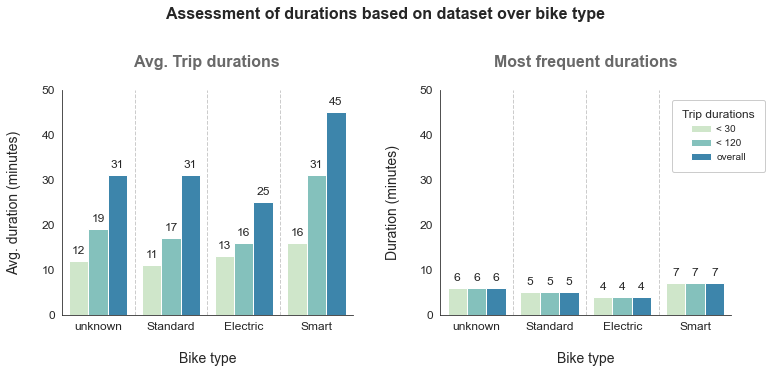

In [338]:
plt.figure(figsize = [12, 5])
sb.set_palette(palette = "GnBu", n_colors = 3, desat = None)
base_color = sb.color_palette()[2]

# left plot: point plot - Avg trip duration
# -------------------------------------------------------
sb.set_style('white')
plt.subplot(1, 2, 1)
ax1 = sb.barplot(data = duration_df, x = 'bike_type', y = 'duration_avg', hue = 'dataset')
plt.title('Avg. Trip durations\n',  weight = 'bold', fontsize = 16, color ='dimgrey')
plt.ylabel('Avg. duration (minutes)\n', fontsize = 14)
plt.xlabel('\nBike type', fontsize = 14)
plt.xticks(fontsize = 12)

locs, labels = plt.yticks()
y_ticks_new = np.arange(0, int(math.ceil(max(locs)))+10, 10)
plt.yticks(y_ticks_new, y_ticks_new, fontsize=12)

plt.legend('', frameon=False, fancybox=False)

# add annotations
for p in ax1.patches:
    ax1.annotate(format(p.get_height(), '.0f'), (p.get_x() + p.get_width() / 2., p.get_height()), 
                 ha = 'center', va = 'center', xytext = (0, 10), textcoords = 'offset points', fontsize = 12)

separators = [0.5, 1.5, 2.5]
for loc in separators:
    plt.axvline(loc, ls='--', color='grey', linewidth=1, alpha=0.4);

sb.despine(top=True, bottom=False, left=False, right=True);
# -------------------------------------------------------


# right plot: Bar chart - most frequent trip duration
# -------------------------------------------------------
sb.set_style('white')
plt.subplot(1, 2, 2)
g = sb.barplot(data = duration_df, x = 'bike_type', y = 'duration_mode', hue = 'dataset')
plt.title('Most frequent durations\n',  weight = 'bold', fontsize = 16, color ='dimgrey')
plt.ylabel('Duration (minutes)\n', fontsize = 14)
plt.xlabel('\nBike type', fontsize = 14)
plt.xticks(fontsize = 12)
plt.ylim(ax1.get_ylim())

locs, labels = plt.yticks()
y_ticks_new = np.arange(0, int(math.ceil(max(locs)))+10, 10)
plt.yticks(y_ticks_new, y_ticks_new, fontsize=12)

plt.legend(scatterpoints=1, frameon=True, fancybox=True, shadow=False, framealpha = 1, 
           borderpad=1, borderaxespad=1, loc = 'upper right', labelspacing=0.5, ncol = 1,  
           title='Trip durations', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(1.15, 1))

# add annotations
for p in g.patches:
    g.annotate(format(p.get_height(), '.0f'), (p.get_x() + p.get_width() / 2., p.get_height()), 
               ha = 'center', va = 'center', xytext = (0, 10), textcoords = 'offset points', fontsize = 12)

separators = [0.5, 1.5, 2.5]
for loc in separators:
    plt.axvline(loc, ls='--', color='grey', linewidth=1, alpha=0.4);

sb.despine(top=True, bottom=False, left=False, right=True);
# -------------------------------------------------------

plt.subplots_adjust(wspace=0.3, hspace=0.3)
plt.subplots_adjust(top=0.75)
plt.suptitle('Assessment of durations based on dataset over bike type\n', fontsize = 16, weight = 'bold');

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.20.o Assessment of durations based on dataset over bike type.png', dpi=300, bbox_inches='tight')

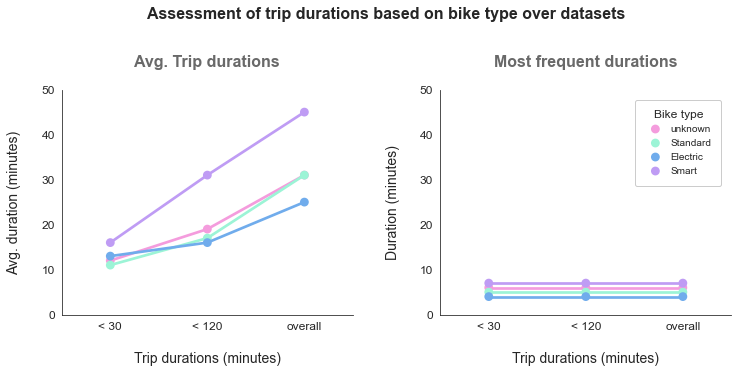

In [339]:
plt.figure(figsize = [12, 5])
flatui = ['#ff91e2', '#91ffda', '#60acfc', '#bd91ff']
sb.set_palette(flatui, n_colors=4, desat=0.8)

# left plot: point plot - Avg trip duration
# -------------------------------------------------------
# -------------------------------------------------------
sb.set_style('white')
plt.subplot(1, 2, 1)

ax1 = sb.pointplot(data = duration_df, x = 'dataset', y = 'duration_avg', hue = 'bike_type', alpha = 1)
plt.title('Avg. Trip durations\n',  weight = 'bold', fontsize = 16, color = 'dimgrey')
plt.ylabel('Avg. duration (minutes)\n', fontsize = 14)
plt.xlabel('\nTrip durations (minutes)', fontsize = 14)
plt.xticks(fontsize = 12)

locs, labels = plt.yticks()
y_ticks_new = np.arange(0, int(math.ceil(max(locs)))+10, 10)
plt.yticks(y_ticks_new, y_ticks_new, fontsize=12)

plt.legend('', frameon=False, fancybox=False)
sb.despine(top=True, bottom=False, left=False, right=True);
# -------------------------------------------------------
# -------------------------------------------------------


# right plot: point plot - most frequent trip duration
# -------------------------------------------------------
# -------------------------------------------------------
sb.set_style('white')
plt.subplot(1, 2, 2)

g = sb.pointplot(data = duration_df, x = 'dataset', y = 'duration_mode', hue = 'bike_type', alpha = 1)
plt.title('Most frequent durations\n',  weight = 'bold', fontsize = 16, color = 'dimgrey')
plt.ylabel('Duration (minutes)\n', fontsize = 14)
plt.xlabel('\nTrip durations (minutes)', fontsize = 14)
plt.xticks(fontsize = 12)
plt.ylim(ax1.get_ylim())

locs, labels = plt.yticks()
y_ticks_new = np.arange(0, int(math.ceil(max(locs)))+10, 10)
plt.yticks(y_ticks_new, y_ticks_new, fontsize=12)

plt.legend(scatterpoints=1, frameon=True, fancybox=True, shadow=False, framealpha = 1, 
           borderpad=1, borderaxespad=1, loc = 'upper right', labelspacing=0.5, ncol = 1,  
           title='Bike type', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5)

sb.despine(top=True, bottom=False, left=False, right=True);
# -------------------------------------------------------
# -------------------------------------------------------

plt.subplots_adjust(wspace=0.3, hspace=0.3)
plt.subplots_adjust(top=0.75)
plt.suptitle('Assessment of trip durations based on bike type over datasets\n', fontsize = 16, weight = 'bold');

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.20.p Assessment of trip durations based on bike type over datasets.png', dpi=300, bbox_inches='tight')

> The lines subjected to each bike type are closely packed and hard to interpret. Hence plot the distribution of trip duratioins based on bike type over different datasets in bar type chart.

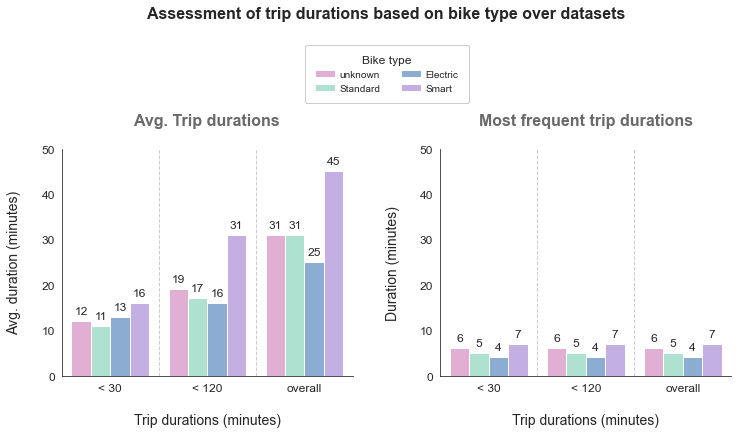

In [340]:
plt.figure(figsize = [12, 6])
flatui = ['#ff91e2', '#91ffda', '#60acfc', '#bd91ff']
sb.set_palette(flatui, n_colors=4, desat=0.6)

# left plot: bar chart - Avg trip duration
# -------------------------------------------------------
# -------------------------------------------------------
sb.set_style('white')
plt.subplot(1, 2, 1)

ax1 = sb.barplot(data = duration_df, x = 'dataset', y = 'duration_avg', hue = 'bike_type', alpha = 1)
plt.title('Avg. Trip durations\n',  weight = 'bold', fontsize = 16, color = 'dimgrey')
plt.ylabel('Avg. duration (minutes)\n', fontsize = 14)
plt.xlabel('\nTrip durations (minutes)', fontsize = 14)
plt.xticks(fontsize = 12)

locs, labels = plt.yticks()
y_ticks_new = np.arange(0, int(math.ceil(max(locs)))+10, 10)
plt.yticks(y_ticks_new, y_ticks_new, fontsize=12)

# add annotations
# -------------------------------------------------------
for p in ax1.patches:
    ax1.annotate(format(p.get_height(), '.0f'), (p.get_x() + p.get_width() / 2., p.get_height()), 
                 ha = 'center', va = 'center', xytext = (0, 10), textcoords = 'offset points', fontsize = 12)

separators = [0.5, 1.5]
for loc in separators:
    plt.axvline(loc, ls='--', color='grey', linewidth=1, alpha=0.4)
# -------------------------------------------------------

plt.legend('', frameon=False, fancybox=False)
sb.despine(top=True, bottom=False, left=False, right=True);
# -------------------------------------------------------
# -------------------------------------------------------


# right plot: bar chart - most frequent trip duration
# -------------------------------------------------------
# -------------------------------------------------------
sb.set_style('white')
plt.subplot(1, 2, 2)

g = sb.barplot(data = duration_df, x = 'dataset', y = 'duration_mode', hue = 'bike_type', alpha = 1)
plt.title('Most frequent trip durations\n',  weight = 'bold', fontsize = 16, color = 'dimgrey')
plt.ylabel('Duration (minutes)\n', fontsize = 14)
plt.xlabel('\nTrip durations (minutes)', fontsize = 14)
plt.xticks(fontsize = 12)
plt.ylim(ax1.get_ylim())

locs, labels = plt.yticks()
y_ticks_new = np.arange(0, int(math.ceil(max(locs)))+10, 10)
plt.yticks(y_ticks_new, y_ticks_new, fontsize=12)

# add annotations
# -------------------------------------------------------
for p in g.patches:
    g.annotate(format(p.get_height(), '.0f'), (p.get_x() + p.get_width() / 2., p.get_height()), 
               ha = 'center', va = 'center', xytext = (0, 10), textcoords = 'offset points', fontsize = 12)

separators = [0.5, 1.5]
for loc in separators:
    plt.axvline(loc, ls='--', color='grey', linewidth=1, alpha=0.4)
# -------------------------------------------------------

plt.legend(scatterpoints=1, frameon=True, fancybox=True, shadow=False, framealpha = 1, 
           borderpad=1, borderaxespad=1, loc = 'upper left', labelspacing=0.5, ncol = 2,  
           title='Bike type', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(-0.5, 1.5))

sb.despine(top=True, bottom=False, left=False, right=True);
# -------------------------------------------------------
# -------------------------------------------------------

plt.subplots_adjust(wspace=0.3, hspace=0.3)
plt.subplots_adjust(top=0.65)
plt.suptitle('Assessment of trip durations based on bike type over datasets\n', fontsize = 16, weight = 'bold');

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.20.q Assessment of trip durations based on bike type over datasets.png', dpi=300, bbox_inches='tight')

---------------------------

#### 3.2.21 Bivariate analysis of `duration_min` and `pass_type` columns:

+ `Columns`: duration_min, pass_type
+ `Data type`: (Numerical, continuous) and (Categorical, nominal)
+ `Plot`: Facet Grid, Violin plot, Box plot, Adapted Barchart

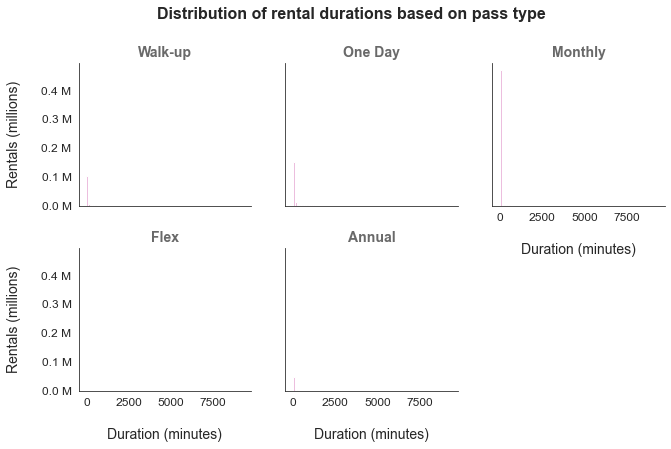

In [341]:
sb.set_style('white')
sb.set_palette(palette = "colorblind", n_colors = 10, desat = 0.6)
base_color = sb.color_palette()[6]

g = sb.FacetGrid(data = bikeshare, col = 'pass_type', col_wrap = 3, height = 3, aspect = 1)
g.map(plt.hist, "duration_min", color = base_color, bins = np.arange(0, bikeshare.duration_min.max()+100, 100))
g.fig.subplots_adjust(top=0.85)
g.fig.suptitle('Distribution of rental durations based on pass type\n', fontsize = 16, weight = 'bold')
g.set_titles('{col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# obtain y_ticks and convert them to a multiple of millions
# obtain the x_ticks and store them as a list
y_tick_names = []
x_tick_names = []
for ax in g.axes.flat:
    for y_label in ax.get_yticklabels():
        y_label_value = int(y_label.get_text())
        y_label_new_value = '{:0.1f} M'.format(y_label_value/1000000)
        y_tick_names.append(y_label_new_value)
        
    for x_label in ax.get_xticklabels():
        x_label_value = x_label.get_text()
        x_tick_names.append(x_label_value)

g.set_yticklabels(y_tick_names, size = 12)
g.set_xticklabels(x_tick_names, size = 12)
g.set_xlabels('\nDuration (minutes)', size = 14)
g.set_ylabels('Rentals (millions)\n', size = 14)

plt.subplots_adjust(wspace=0.2, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.21.a Facet Grid of rental durations on pass type.png', dpi=300, bbox_inches='tight')

The distribution of `duration_min` values are vague and not easy to interpret. This can be overcome by limiting the plot to a threshold value.

> Let us plot more variety of graphs to observe the distribution of data and hidden insights.

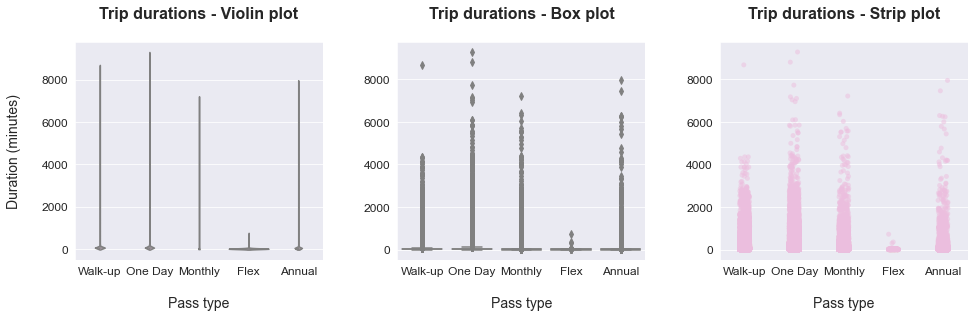

In [342]:
plt.figure(figsize = [16, 4])
sb.set_style('darkgrid')
sb.set_palette(palette = "colorblind", n_colors = 10, desat = 0.6)
base_color = sb.color_palette()[6]

# left plot: violin plot
plt.subplot(1, 3, 1)
sb.violinplot(data = bikeshare, x = 'pass_type', y = 'duration_min', inner = 'quartile',
              color = base_color)
plt.title('Trip durations - Violin plot\n',  weight = 'bold', fontsize = 16)
plt.xlabel('\nPass type', fontsize = 14)
plt.ylabel('Duration (minutes)\n', fontsize = 14)
plt.xticks(fontsize = 12)
plt.yticks(fontsize = 12)

# center plot: box plot
plt.subplot(1, 3, 2)
sb.boxplot(data = bikeshare, x = 'pass_type', y = 'duration_min', color = base_color)
plt.title('Trip durations - Box plot\n',  weight = 'bold', fontsize = 16)
plt.xlabel('\nPass type', fontsize = 14)
plt.ylabel('', fontsize = 14)
plt.xticks(fontsize = 12)
plt.yticks(fontsize = 12)

# right plot: strip chart
plt.subplot(1, 3, 3)
sb.stripplot(x="pass_type", y="duration_min", data=bikeshare, alpha = 0.5, color = base_color)
plt.title('Trip durations - Strip plot\n',  weight = 'bold', fontsize = 16)
plt.xlabel('\nPass type', fontsize = 14)
plt.ylabel('', fontsize = 14)
plt.xticks(fontsize = 12)
plt.yticks(fontsize = 12)

plt.subplots_adjust(wspace=0.3, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust dhe figure to include all of the x and y labels
plt.savefig('plots/3.2.21.b Distribution of Pass type durations on various plots.png', dpi=300, bbox_inches='tight')

> The above plot depicts the presense of long tail of outliers, and require closer observation for better understanding of the data distribution.

Calculate the `average trip duration` and the `most frequent trip duration` subjected to each `pass type`.

In [343]:
walkup_mean = math.ceil(bikeshare.query(' pass_type == "Walk-up" ').duration_min.mean())
walkup_mode = bikeshare.query(' pass_type == "Walk-up" ').duration_min.mode()[0]

oneday_mean = math.ceil(bikeshare.query(' pass_type == "One Day" ').duration_min.mean())
oneday_mode = bikeshare.query(' pass_type == "One Day" ').duration_min.mode()[0]

monthly_mean = math.ceil(bikeshare.query(' pass_type == "Monthly" ').duration_min.mean())
monthly_mode = bikeshare.query(' pass_type == "Monthly" ').duration_min.mode()[0]

flex_mean = math.ceil(bikeshare.query(' pass_type == "Flex" ').duration_min.mean())
flex_mode = bikeshare.query(' pass_type == "Flex" ').duration_min.mode()[0]

annual_mean = math.ceil(bikeshare.query(' pass_type == "Annual" ').duration_min.mean())
annual_mode = bikeshare.query(' pass_type == "Annual" ').duration_min.mode()[0]

print('Duration mean'.center(30,'-'))
print('walkup_mean  : ', walkup_mean, 'minutes')
print('oneday_mean  : ', oneday_mean, 'minutes')
print('monthly_mean : ', monthly_mean, 'minutes')
print('flex_mean    : ', flex_mean, 'minutes')
print('annual_mean  : ', annual_mean, 'minutes')
print('\n')
print('Duration mode'.center(30,'-'))
print('walkup_mode  : ', walkup_mode, 'minutes')
print('oneday_mode  : ', oneday_mode, 'minutes')
print('monthly_mode : ', monthly_mode, 'minutes')
print('flex_mode    : ', flex_mode, 'minutes')
print('annual_mode  : ', annual_mode, 'minutes')

--------Duration mean---------
walkup_mean  :  51 minutes
oneday_mean  :  61 minutes
monthly_mean :  15 minutes
flex_mean    :  17 minutes
annual_mean  :  24 minutes


--------Duration mode---------
walkup_mode  :  10 minutes
oneday_mode  :  8 minutes
monthly_mode :  5 minutes
flex_mode    :  3 minutes
annual_mode  :  5 minutes


> The calculations are influenced by the presence of outliers.

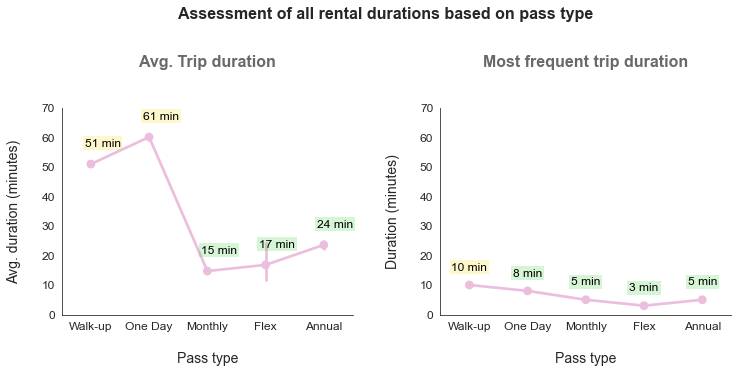

In [344]:
plt.figure(figsize = [12, 5])

sb.set_palette(palette = "colorblind", n_colors = 10, desat = 0.6)
base_color = sb.color_palette()[6]

# left plot: point plot - Avg trip duration
sb.set_style('white')
plt.subplot(1, 2, 1)
ax1 = sb.pointplot(data = bikeshare, x = "pass_type", y = "duration_min", linestyles = "-", color = base_color)
plt.title('Avg. Trip duration\n\n',  weight = 'bold', fontsize = 16, color = 'dimgrey')
plt.ylabel('Avg. duration (minutes)\n', fontsize = 14)
plt.xlabel('\nPass type', fontsize = 14)
plt.xticks(fontsize = 12)

locs, labels = plt.yticks()
y_ticks_new = np.arange(0, int(math.ceil(max(locs)))+10, 10)
plt.yticks(y_ticks_new, y_ticks_new, fontsize=12)
sb.despine(top=True, bottom=False, left=False, right=True);

# add annotations
# -------------------------------------------------------
cat_order = bikeshare.pass_type.sort_values(ascending=True).unique()
avg_rental_counts = bikeshare.groupby([bikeshare["pass_type"]]).mean().duration_min[cat_order]
avg_rental_max = avg_rental_counts.max()
clrs = ['gold' if (count > ((avg_rental_max*4)/5)) else 'limegreen' for count in avg_rental_counts ]

# get the current tick locations and labels
locs, labels = plt.xticks()

# loop through each pair of locations and labels
for loc, label, avg_rental_count, clr in zip(locs, labels, avg_rental_counts, clrs):
    try:
        count = avg_rental_count
    except KeyError:
        count = 0   
    pct_string = '{:0.0f} min'.format(math.ceil(count))
    # print the annotation depending on the bar length
    plt.text(loc+0.2, count + int(avg_rental_max/10), pct_string, ha = 'center', color = 'black', 
             fontsize = 12, bbox=dict(pad=1.9,alpha=0.2,color='none',fc=clr))
# -------------------------------------------------------

# right plot: Bar chart - most frequent trip duration
sb.set_style('white')
plt.subplot(1, 2, 2)
walkup_mode = bikeshare.query(' pass_type == "Walk-up" ').duration_min.mode()[0]
oneday_mode = bikeshare.query(' pass_type == "One Day" ').duration_min.mode()[0]
monthly_mode = bikeshare.query(' pass_type == "Monthly" ').duration_min.mode()[0]
flex_mode = bikeshare.query(' pass_type == "Flex" ').duration_min.mode()[0]
annual_mode = bikeshare.query(' pass_type == "Annual" ').duration_min.mode()[0]
heights = [walkup_mode, oneday_mode, monthly_mode, flex_mode, annual_mode]
labels = bikeshare.pass_type.sort_values(ascending=True).unique()
sb.pointplot(x = labels, y = heights, color = base_color)
plt.title('Most frequent trip duration\n\n',  weight = 'bold', fontsize = 16, color = 'dimgrey')
plt.xlabel('\nPass type', fontsize = 14)
plt.ylabel('Duration (minutes)\n', fontsize = 14)
plt.xticks(fontsize = 12)
plt.ylim(ax1.get_ylim())

locs, labels = plt.yticks()
y_ticks_new = np.arange(0, int(math.ceil(max(locs)))+10, 10)
plt.yticks(y_ticks_new, y_ticks_new, fontsize=12)
sb.despine();

# add annotations
# -------------------------------------------------------
freq_rental_counts = heights
freq_rental_max = max(freq_rental_counts)
clrs = ['gold' if (count > ((freq_rental_max*4)/5)) else 'limegreen' for count in freq_rental_counts ]

# get the current tick locations and labels
locs, labels = plt.xticks()

# loop through each pair of locations and labels
for loc, label, freq_rental_count, clr in zip(locs, labels, freq_rental_counts, clrs):
    try:
        count = freq_rental_count
    except KeyError:
        count = 0   
    pct_string = '{:0.0f} min'.format(math.ceil(count))
    # print the annotation depending on the bar length
    plt.text(loc, count + (freq_rental_max/2), pct_string, ha = 'center', color = 'black', 
             fontsize = 12, bbox=dict(pad=1.9,alpha=0.2,color='none',fc=clr))
# -------------------------------------------------------

plt.subplots_adjust(wspace=0.3, hspace=0.3)
plt.subplots_adjust(top=0.7)
plt.suptitle('Assessment of all rental durations based on pass type\n', fontsize = 16, weight = 'bold');

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.21.c Average trip durations based on pass type.png', dpi=300, bbox_inches='tight')

> + If the `pass_type` is `Walk-up`, then the bike rentals has an average rental duration of `51 minutes` and mode of `10 minutes`.
+ If the `pass_type` is `One Day`, then the bike rentals has an average rental duration of `61 minutes` and mode of `8 minutes`.
+ If the `pass_type` is `Monthly`, then the bike rentals has an average rental duration of `15 minutes` and mode of `5 minutes`.
+ If the `pass_type` is `Flex`, then the bike rentals has an average rental duration of `17 minutes` and mode of `3 minutes`.
+ If the `pass_type` is `Annual`, then the bike rentals has an average rental duration of `24 minutes` and mode of `5 minutes`.

`The trip durations being 1 minute or less is probably because of return of the bicycle immediately after rental due to technical or other issue. Hence exclude the trips that are under 1 minute duration and re-evalute the statistics.`

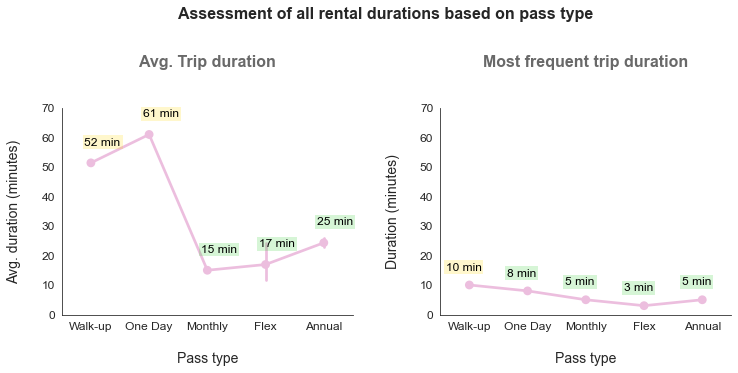

In [345]:
drop_index = bikeshare.query(' duration_min <= 1 ').index
temp_df = bikeshare.drop(drop_index)

plt.figure(figsize = [12, 5])
sb.set_palette(palette = "colorblind", n_colors = 10, desat = 0.6)
base_color = sb.color_palette()[6]

# left plot: point plot - Avg trip duration
sb.set_style('white')
plt.subplot(1, 2, 1)
ax1 = sb.pointplot(data = temp_df, x = "pass_type", y = "duration_min", linestyles = "-", color = base_color)
plt.title('Avg. Trip duration\n\n',  weight = 'bold', fontsize = 16, color = 'dimgrey')
plt.ylabel('Avg. duration (minutes)\n', fontsize = 14)
plt.xlabel('\nPass type', fontsize = 14)
plt.xticks(fontsize = 12)

locs, labels = plt.yticks()
y_ticks_new = np.arange(0, int(math.ceil(max(locs)))+10, 10)
plt.yticks(y_ticks_new, y_ticks_new, fontsize=12)
sb.despine(top=True, bottom=False, left=False, right=True);

# add annotations
# -------------------------------------------------------
cat_order = temp_df.pass_type.sort_values(ascending=True).unique()
avg_rental_counts = temp_df.groupby([temp_df["pass_type"]]).mean().duration_min[cat_order]
avg_rental_max = avg_rental_counts.max()
clrs = ['gold' if (count > ((avg_rental_max*4)/5)) else 'limegreen' for count in avg_rental_counts ]

# get the current tick locations and labels
locs, labels = plt.xticks()

# loop through each pair of locations and labels
for loc, label, avg_rental_count, clr in zip(locs, labels, avg_rental_counts, clrs):
    try:
        count = avg_rental_count
    except KeyError:
        count = 0   
    pct_string = '{:0.0f} min'.format(math.ceil(count))
    # print the annotation depending on the bar length
    plt.text(loc+0.2, count + int(avg_rental_max/10), pct_string, ha = 'center', color = 'black', 
             fontsize = 12, bbox=dict(pad=1.9,alpha=0.2,color='none',fc=clr))
# -------------------------------------------------------

# right plot: Bar chart - most frequent trip duration
sb.set_style('white')
plt.subplot(1, 2, 2)
walkup_mode = temp_df.query(' pass_type == "Walk-up" ').duration_min.mode()[0]
oneday_mode = temp_df.query(' pass_type == "One Day" ').duration_min.mode()[0]
monthly_mode = temp_df.query(' pass_type == "Monthly" ').duration_min.mode()[0]
flex_mode = temp_df.query(' pass_type == "Flex" ').duration_min.mode()[0]
annual_mode = temp_df.query(' pass_type == "Annual" ').duration_min.mode()[0]
heights = [walkup_mode, oneday_mode, monthly_mode, flex_mode, annual_mode]
labels = temp_df.pass_type.sort_values(ascending=True).unique()
sb.pointplot(x = labels, y = heights, color = base_color)
plt.title('Most frequent trip duration\n\n',  weight = 'bold', fontsize = 16, color = 'dimgrey')
plt.xlabel('\nPass type', fontsize = 14)
plt.ylabel('Duration (minutes)\n', fontsize = 14)
plt.xticks(fontsize = 12)
plt.ylim(ax1.get_ylim())

locs, labels = plt.yticks()
y_ticks_new = np.arange(0, int(math.ceil(max(locs)))+10, 10)
plt.yticks(y_ticks_new, y_ticks_new, fontsize=12)
sb.despine();

# add annotations
# -------------------------------------------------------
freq_rental_counts = heights
freq_rental_max = max(freq_rental_counts)
clrs = ['gold' if (count > ((freq_rental_max*4)/5)) else 'limegreen' for count in freq_rental_counts ]

# get the current tick locations and labels
locs, labels = plt.xticks()

# loop through each pair of locations and labels
for loc, label, freq_rental_count, clr in zip(locs, labels, freq_rental_counts, clrs):
    try:
        count = freq_rental_count
    except KeyError:
        count = 0   
    pct_string = '{:0.0f} min'.format(math.ceil(count))
    # print the annotation depending on the bar length
    plt.text(loc-0.1, count + (freq_rental_max/2), pct_string, ha = 'center', color = 'black', 
             fontsize = 12, bbox=dict(pad=1.9,alpha=0.2,color='none',fc=clr))
# -------------------------------------------------------

plt.subplots_adjust(wspace=0.3, hspace=0.3)
plt.subplots_adjust(top=0.7)
plt.suptitle('Assessment of all rental durations based on pass type\n', fontsize = 16, weight = 'bold');

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.21.d Average trip durations based on pass type.png', dpi=300, bbox_inches='tight')

When the trips with durations `<= 1 minute` are removed from the assessment, then the result is as follows:

> + If the `pass_type` is `Walk-up`, then the bike rentals has an increase in average rental duration to `52 minutes` and mode of `10 minutes`.
+ If the `pass_type` is `One Day`, then the bike rentals has an average rental duration of `61 minutes` and mode of `8 minutes`.
+ If the `pass_type` is `Monthly`, then the bike rentals has an average rental duration of `15 minutes` and mode of `5 minutes`.
+ If the `pass_type` is `Flex`, then the bike rentals has an average rental duration of `17 minutes` and mode of `3 minutes`.
+ If the `pass_type` is `Annual`, then the bike rentals has an increase in average rental duration to `25 minutes` and mode of `5 minutes`.

**`Dataset limited under 120 min:`**

In [346]:
bikeshare.duration_min.describe()

count    808589.000000
mean         29.861795
std         119.355799
min           0.000000
25%           6.000000
50%          12.000000
75%          23.000000
max        9283.000000
Name: duration_min, dtype: float64

> The distribution of `duration_min` values are vague and not easy to interpret. This can be overcome by limiting the dataset to a threshold value, say `120 minutes` or `2 hours` as most of the `duration_min` values falls under this boundary.

In [347]:
# calculate the percentage of the dataset that falls under `2 hour` trip duration.
np.round((bikeshare.query(' duration_min <= 120 ').shape[0]/bikeshare.shape[0])*100, 2)

96.9

In [348]:
duration_120 = bikeshare.query(' duration_min > 120 ')

# calculate the proportion of the trips with 'Walk-up' pass type, that will be dropped
walkup_type_drops = np.round((duration_120.query(' pass_type == "Walk-up" ').shape[0]/
                               bikeshare.query(' pass_type == "Walk-up" ').shape[0])*100, 2)

# calculate the proportion of the trips with 'One Day' pass type, that will be dropped
oneday_type_drops = np.round((duration_120.query(' pass_type == "One Day" ').shape[0]/
                                bikeshare.query(' pass_type == "One Day" ').shape[0])*100, 2)

# calculate the proportion of the trips with 'Monthly' pass type, that will be dropped
monthly_type_drops = np.round((duration_120.query(' pass_type == "Monthly" ').shape[0]/
                                bikeshare.query(' pass_type == "Monthly" ').shape[0])*100, 2)

# calculate the proportion of the trips with 'Flex' pass type, that will be dropped
flex_type_drops = np.round((duration_120.query(' pass_type == "Flex" ').shape[0]/
                             bikeshare.query(' pass_type == "Flex" ').shape[0])*100, 2)

# calculate the proportion of the trips with 'Annual' pass type, that will be dropped
annual_type_drops = np.round((duration_120.query(' pass_type == "Annual" ').shape[0]/
                             bikeshare.query(' pass_type == "Annual" ').shape[0])*100, 2)

print("Proportion of walkup type entries that will be dropped".ljust(60, ' '), ':', walkup_type_drops)
print("Proportion of oneday type entries that will be dropped".ljust(60, ' '), ':', oneday_type_drops)
print("Proportion of monthly type entries that will be dropped".ljust(60, ' '), ':', monthly_type_drops)
print("Proportion of flex type entries that will be dropped".ljust(60, ' '), ':', flex_type_drops)
print("Proportion of annual type entries that will be dropped".ljust(60, ' '), ':', annual_type_drops)

Proportion of walkup type entries that will be dropped       : 5.53
Proportion of oneday type entries that will be dropped       : 8.47
Proportion of monthly type entries that will be dropped      : 0.73
Proportion of flex type entries that will be dropped         : 1.14
Proportion of annual type entries that will be dropped       : 1.83


In [349]:
# Limit the dataset that has entries under 2 hours duration
duration_lim_120 = bikeshare.query(' duration_min <= 120 ')

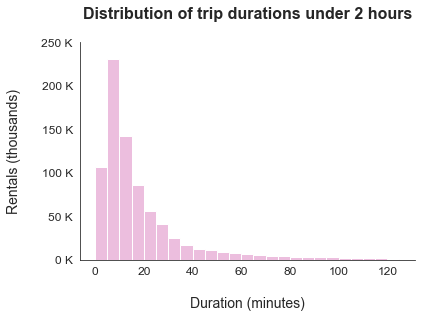

In [350]:
sb.set_style('white')
sb.set_palette(palette = "colorblind", n_colors = 10, desat = 0.6)
base_color = sb.color_palette()[6]
bin_edges = np.arange(0, duration_lim_120.duration_min.max()+10, 5)

plt.hist(duration_lim_120['duration_min'], color = base_color, bins = bin_edges)
plt.title('Distribution of trip durations under 2 hours\n',  weight = 'bold', fontsize = 16)
plt.xlabel('\nDuration (minutes)', fontsize = 14)
plt.ylabel('Rentals (thousands)\n', fontsize = 14)
plt.xticks(fontsize = 12)

locs, labels = plt.yticks()
y_tick_locs = np.arange(0, int(math.ceil(max(locs)))+1000, 50000)
y_tick_names = ['{:0.0f} K'.format(loc/1000) for loc in y_tick_locs]
plt.yticks(y_tick_locs, y_tick_names, fontsize=12)
sb.despine();

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.21.e Distribution of trip durations under 2 hours.png', dpi=300, bbox_inches='tight')

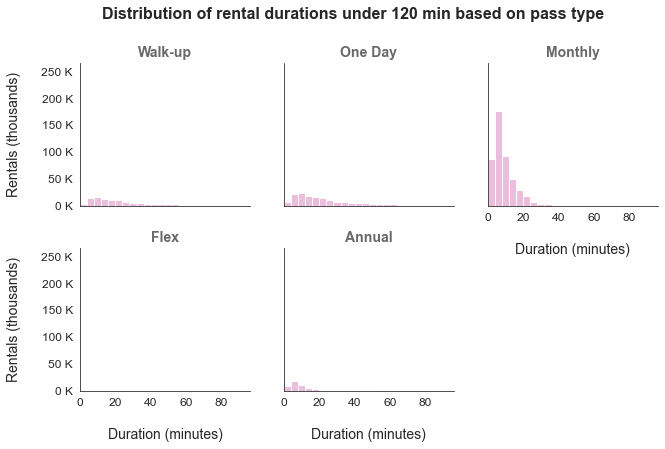

In [351]:
sb.set_style('white')
sb.set_palette(palette = "colorblind", n_colors = 10, desat = 0.6)
base_color = sb.color_palette()[6]

g = sb.FacetGrid(data = duration_lim_120, col = 'pass_type', col_wrap = 3, height = 3, aspect = 1, xlim=(0,120))
g.set(xmargin=0.5, ymargin=0.5)
g.map(plt.hist, "duration_min", color = base_color, bins = np.arange(0, duration_lim_120.duration_min.max()+10, 5))
g.fig.subplots_adjust(top=0.85)
g.fig.suptitle('Distribution of rental durations under 120 min based on pass type\n', fontsize = 16, weight = 'bold')
g.set_titles('{col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# obtain y_ticks and convert them to a multiple of thousands
# obtain the x_ticks and store them as a list
y_tick_names = []
x_tick_names = []
for ax in g.axes.flat:
    for y_label in ax.get_yticklabels():
        y_label_value = int(y_label.get_text())
        y_label_new_value = '{:0.0f} K'.format(y_label_value/1000)
        y_tick_names.append(y_label_new_value)
        
    for x_label in ax.get_xticklabels():
        x_label_value = x_label.get_text()
        x_tick_names.append(x_label_value)

g.set_yticklabels(y_tick_names, size = 12)
g.set_xticklabels(x_tick_names, size = 12)
g.set_xlabels('\nDuration (minutes)', size = 14)
g.set_ylabels('Rentals (thousands)\n', size = 14)

plt.subplots_adjust(wspace=0.2, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.21.f Facet Grid of rental durations under 2 hours on pass type.png', dpi=300, bbox_inches='tight')

> Let us plot more variety of graphs to observe the distribution of data and hidden insights.

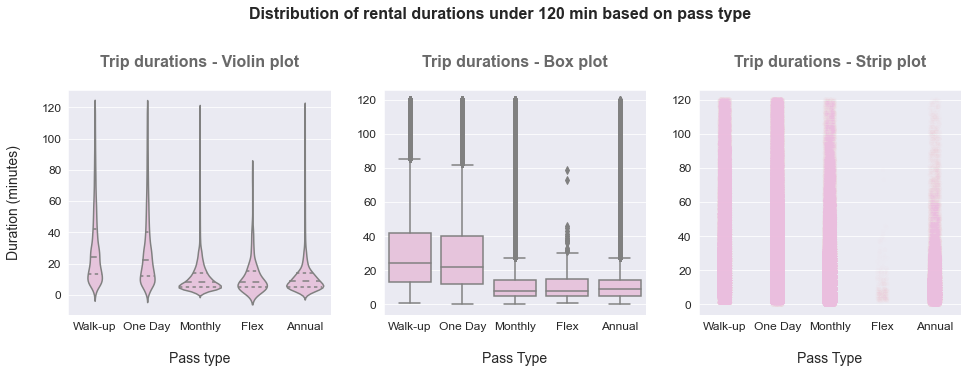

In [352]:
plt.figure(figsize = [16, 5])
sb.set_style('darkgrid')
sb.set_palette(palette = "colorblind", n_colors = 10, desat = 0.6)
base_color = sb.color_palette()[6]

# left plot: violin plot
plt.subplot(1, 3, 1)
sb.violinplot(data = duration_lim_120, x = 'pass_type', y = 'duration_min', 
              inner = 'quartile', color = base_color)
plt.title('Trip durations - Violin plot\n',  weight = 'bold', fontsize = 16, color = 'dimgrey')
plt.xlabel('\nPass type', fontsize = 14)
plt.ylabel('Duration (minutes)\n', fontsize = 14)
plt.xticks(fontsize = 12)
plt.yticks(fontsize = 12)

# center plot: box plot
plt.subplot(1, 3, 2)
sb.boxplot(data = duration_lim_120, x = 'pass_type', y = 'duration_min', color = base_color)
plt.title('Trip durations - Box plot\n',  weight = 'bold', fontsize = 16, color = 'dimgrey')
plt.xlabel('\nPass Type', fontsize = 14)
plt.ylabel('', fontsize = 14)
plt.xticks(fontsize = 12)
plt.yticks(fontsize = 12)

# right plot: strip chart
plt.subplot(1, 3, 3)
sb.stripplot(data = duration_lim_120, x="pass_type", y="duration_min", alpha = 0.002, color = base_color)
plt.title('Trip durations - Strip plot\n',  weight = 'bold', fontsize = 16, color = 'dimgrey')
plt.xlabel('\nPass Type', fontsize = 14)
plt.ylabel('', fontsize = 14)
plt.xticks(fontsize = 12)
plt.yticks(fontsize = 12)

plt.subplots_adjust(wspace=0.2, hspace=0.3)
plt.subplots_adjust(top=0.75)
plt.suptitle('Distribution of rental durations under 120 min based on pass type\n', fontsize = 16, weight = 'bold');

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.21.g Distribution of pass type durations under 2 hours on various plots.png', dpi=300, bbox_inches='tight')

> The above plot depicts the presense of long tail of outliers, and require even closer observation for better understanding of the data distribution.

Calculate the `average trip duration` and the `most frequent trip duration` subjected to each `pass type`.

In [353]:
walkup_mean = math.ceil(duration_lim_120.query(' pass_type == "Walk-up" ').duration_min.mean())
walkup_mode = duration_lim_120.query(' pass_type == "Walk-up" ').duration_min.mode()[0]

oneday_mean = math.ceil(duration_lim_120.query(' pass_type == "One Day" ').duration_min.mean())
oneday_mode = duration_lim_120.query(' pass_type == "One Day" ').duration_min.mode()[0]

monthly_mean = math.ceil(duration_lim_120.query(' pass_type == "Monthly" ').duration_min.mean())
monthly_mode = duration_lim_120.query(' pass_type == "Monthly" ').duration_min.mode()[0]

flex_mean = math.ceil(duration_lim_120.query(' pass_type == "Flex" ').duration_min.mean())
flex_mode = duration_lim_120.query(' pass_type == "Flex" ').duration_min.mode()[0]

annual_mean = math.ceil(duration_lim_120.query(' pass_type == "Annual" ').duration_min.mean())
annual_mode = duration_lim_120.query(' pass_type == "Annual" ').duration_min.mode()[0]

print('Duration mean'.center(30,'-'))
print('walkup_mean  : ', walkup_mean, 'minutes')
print('oneday_mean  : ', oneday_mean, 'minutes')
print('monthly_mean : ', monthly_mean, 'minutes')
print('flex_mean    : ', flex_mean, 'minutes')
print('annual_mean  : ', annual_mean, 'minutes')
print('\n')
print('Duration mode'.center(30,'-'))
print('walkup_mode  : ', walkup_mode, 'minutes')
print('oneday_mode  : ', oneday_mode, 'minutes')
print('monthly_mode : ', monthly_mode, 'minutes')
print('flex_mode    : ', flex_mode, 'minutes')
print('annual_mode  : ', annual_mode, 'minutes')

--------Duration mean---------
walkup_mean  :  32 minutes
oneday_mean  :  31 minutes
monthly_mean :  12 minutes
flex_mean    :  12 minutes
annual_mean  :  12 minutes


--------Duration mode---------
walkup_mode  :  10 minutes
oneday_mode  :  8 minutes
monthly_mode :  5 minutes
flex_mode    :  3 minutes
annual_mode  :  5 minutes


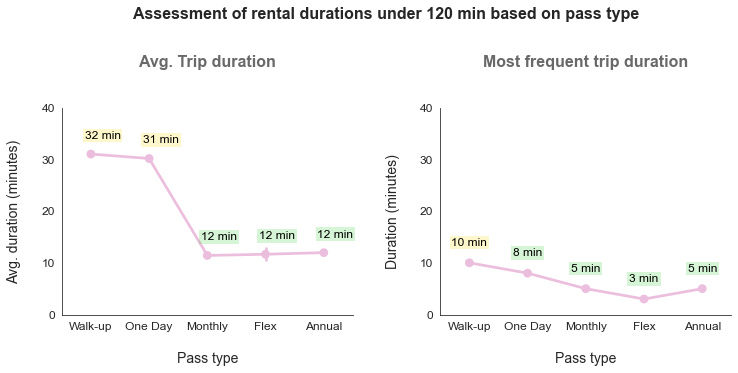

In [354]:
plt.figure(figsize = [12, 5])

sb.set_palette(palette = "colorblind", n_colors = 10, desat = 0.6)
base_color = sb.color_palette()[6]

# left plot: point plot - Avg trip duration
sb.set_style('white')
plt.subplot(1, 2, 1)
ax1 = sb.pointplot(data = duration_lim_120, x = "pass_type", y = "duration_min", linestyles = "-", color = base_color)
plt.title('Avg. Trip duration\n\n',  weight = 'bold', fontsize = 16, color = 'dimgrey')
plt.ylabel('Avg. duration (minutes)\n', fontsize = 14)
plt.xlabel('\nPass type', fontsize = 14)
plt.xticks(fontsize = 12)

locs, labels = plt.yticks()
y_ticks_new = np.arange(0, int(math.ceil(max(locs)))+10, 10)
plt.yticks(y_ticks_new, y_ticks_new, fontsize=12)
sb.despine(top=True, bottom=False, left=False, right=True);

# add annotations
# -------------------------------------------------------
cat_order = duration_lim_120.pass_type.sort_values(ascending=True).unique()
avg_rental_counts = duration_lim_120.groupby([duration_lim_120["pass_type"]]).mean().duration_min[cat_order]
avg_rental_max = avg_rental_counts.max()
clrs = ['gold' if (count > ((avg_rental_max*4)/5)) else 'limegreen' for count in avg_rental_counts ]

# get the current tick locations and labels
locs, labels = plt.xticks()

# loop through each pair of locations and labels
for loc, label, avg_rental_count, clr in zip(locs, labels, avg_rental_counts, clrs):
    try:
        count = avg_rental_count
    except KeyError:
        count = 0   
    pct_string = '{:0.0f} min'.format(math.ceil(count))
    # print the annotation depending on the bar length
    plt.text(loc+0.2, count + int(avg_rental_max/10), pct_string, ha = 'center', color = 'black', 
             fontsize = 12, bbox=dict(pad=1.9,alpha=0.2,color='none',fc=clr))
# -------------------------------------------------------

# right plot: Bar chart - most frequent trip duration
sb.set_style('white')
plt.subplot(1, 2, 2)
walkup_mode = duration_lim_120.query(' pass_type == "Walk-up" ').duration_min.mode()[0]
oneday_mode = duration_lim_120.query(' pass_type == "One Day" ').duration_min.mode()[0]
monthly_mode = duration_lim_120.query(' pass_type == "Monthly" ').duration_min.mode()[0]
flex_mode = duration_lim_120.query(' pass_type == "Flex" ').duration_min.mode()[0]
annual_mode = duration_lim_120.query(' pass_type == "Annual" ').duration_min.mode()[0]
heights = [walkup_mode, oneday_mode, monthly_mode, flex_mode, annual_mode]
labels = duration_lim_120.pass_type.sort_values(ascending=True).unique()
sb.pointplot(x = labels, y = heights, color = base_color)
plt.title('Most frequent trip duration\n\n',  weight = 'bold', fontsize = 16, color = 'dimgrey')
plt.xlabel('\nPass type', fontsize = 14)
plt.ylabel('Duration (minutes)\n', fontsize = 14)
plt.xticks(fontsize = 12)
plt.ylim(ax1.get_ylim())

locs, labels = plt.yticks()
y_ticks_new = np.arange(0, int(math.ceil(max(locs)))+10, 10)
plt.yticks(y_ticks_new, y_ticks_new, fontsize=12)
sb.despine();

# add annotations
# -------------------------------------------------------
freq_rental_counts = heights
freq_rental_max = max(freq_rental_counts)
clrs = ['gold' if (count > ((freq_rental_max*4)/5)) else 'limegreen' for count in freq_rental_counts ]

# get the current tick locations and labels
locs, labels = plt.xticks()

# loop through each pair of locations and labels
for loc, label, freq_rental_count, clr in zip(locs, labels, freq_rental_counts, clrs):
    try:
        count = freq_rental_count
    except KeyError:
        count = 0   
    pct_string = '{:0.0f} min'.format(math.ceil(count))
    # print the annotation depending on the bar length
    plt.text(loc, count + (freq_rental_max/3), pct_string, ha = 'center', color = 'black', 
             fontsize = 12, bbox=dict(pad=1.9,alpha=0.2,color='none',fc=clr))
# -------------------------------------------------------

plt.subplots_adjust(wspace=0.3, hspace=0.3)
plt.subplots_adjust(top=0.7)
plt.suptitle('Assessment of rental durations under 120 min based on pass type\n', fontsize = 16, weight = 'bold');

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.21.h Average trip durations under 2 hours based on pass type.png', dpi=300, bbox_inches='tight')

`When the dataset is limited to trips under 120 minutes:`

> + If the `pass_type` is `Walk-up`, then the bike rentals has an average rental duration of `32 minutes` and mode of `10 minutes`.
+ If the `pass_type` is `One Day`, then the bike rentals has an average rental duration of `31 minutes` and mode of `8 minutes`.
+ If the `pass_type` is `Monthly`, then the bike rentals has an average rental duration of `12 minutes` and mode of `5 minutes`.
+ If the `pass_type` is `Flex`, then the bike rentals has an average rental duration of `12 minutes` and mode of `3 minutes`.
+ If the `pass_type` is `Annual`, then the bike rentals has an average rental duration of `12 minutes` and mode of `5 minutes`.

`The trip durations being 1 minute or less is probably because of return of the bicycle immediately after rental due to technical or other issue. Hence exclude the trips that are under 1 minute duration and re-evalute the statistics.`

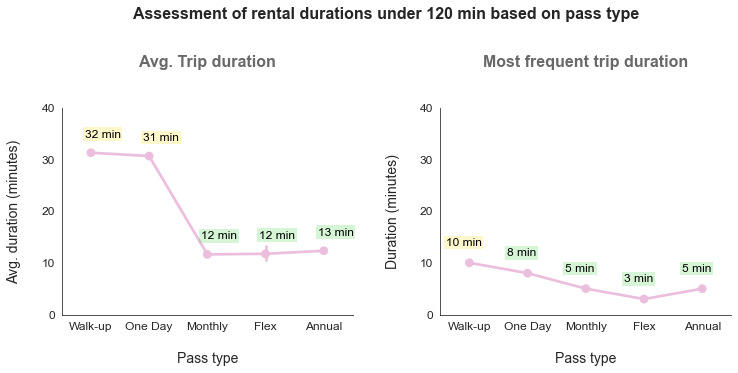

In [355]:
drop_index = duration_lim_120.query(' duration_min <= 1 ').index
temp_df = duration_lim_120.drop(drop_index)

plt.figure(figsize = [12, 5])
sb.set_palette(palette = "colorblind", n_colors = 10, desat = 0.6)
base_color = sb.color_palette()[6]

# left plot: point plot - Avg trip duration
sb.set_style('white')
plt.subplot(1, 2, 1)
ax1 = sb.pointplot(data = temp_df, x = "pass_type", y = "duration_min", linestyles = "-", color = base_color)
plt.title('Avg. Trip duration\n\n',  weight = 'bold', fontsize = 16, color = 'dimgrey')
plt.ylabel('Avg. duration (minutes)\n', fontsize = 14)
plt.xlabel('\nPass type', fontsize = 14)
plt.xticks(fontsize = 12)

locs, labels = plt.yticks()
y_ticks_new = np.arange(0, int(math.ceil(max(locs)))+10, 10)
plt.yticks(y_ticks_new, y_ticks_new, fontsize=12)
sb.despine(top=True, bottom=False, left=False, right=True);

# add annotations
# -------------------------------------------------------
cat_order = temp_df.pass_type.sort_values(ascending=True).unique()
avg_rental_counts = temp_df.groupby([temp_df["pass_type"]]).mean().duration_min[cat_order]
avg_rental_max = avg_rental_counts.max()
clrs = ['gold' if (count > ((avg_rental_max*4)/5)) else 'limegreen' for count in avg_rental_counts ]

# get the current tick locations and labels
locs, labels = plt.xticks()

# loop through each pair of locations and labels
for loc, label, avg_rental_count, clr in zip(locs, labels, avg_rental_counts, clrs):
    try:
        count = avg_rental_count
    except KeyError:
        count = 0   
    pct_string = '{:0.0f} min'.format(math.ceil(count))
    # print the annotation depending on the bar length
    plt.text(loc+0.2, count + int(avg_rental_max/10), pct_string, ha = 'center', color = 'black', 
             fontsize = 12, bbox=dict(pad=1.9,alpha=0.2,color='none',fc=clr))
# -------------------------------------------------------

# right plot: Bar chart - most frequent trip duration
sb.set_style('white')
plt.subplot(1, 2, 2)
walkup_mode = temp_df.query(' pass_type == "Walk-up" ').duration_min.mode()[0]
oneday_mode = temp_df.query(' pass_type == "One Day" ').duration_min.mode()[0]
monthly_mode = temp_df.query(' pass_type == "Monthly" ').duration_min.mode()[0]
flex_mode = temp_df.query(' pass_type == "Flex" ').duration_min.mode()[0]
annual_mode = temp_df.query(' pass_type == "Annual" ').duration_min.mode()[0]
heights = [walkup_mode, oneday_mode, monthly_mode, flex_mode, annual_mode]
labels = temp_df.pass_type.sort_values(ascending=True).unique()
sb.pointplot(x = labels, y = heights, color = base_color)
plt.title('Most frequent trip duration\n\n',  weight = 'bold', fontsize = 16, color = 'dimgrey')
plt.xlabel('\nPass type', fontsize = 14)
plt.ylabel('Duration (minutes)\n', fontsize = 14)
plt.xticks(fontsize = 12)
plt.ylim(ax1.get_ylim())

locs, labels = plt.yticks()
y_ticks_new = np.arange(0, int(math.ceil(max(locs)))+10, 10)
plt.yticks(y_ticks_new, y_ticks_new, fontsize=12)
sb.despine();

# add annotations
# -------------------------------------------------------
freq_rental_counts = heights
freq_rental_max = max(freq_rental_counts)
clrs = ['gold' if (count > ((freq_rental_max*4)/5)) else 'limegreen' for count in freq_rental_counts ]

# get the current tick locations and labels
locs, labels = plt.xticks()

# loop through each pair of locations and labels
for loc, label, freq_rental_count, clr in zip(locs, labels, freq_rental_counts, clrs):
    try:
        count = freq_rental_count
    except KeyError:
        count = 0   
    pct_string = '{:0.0f} min'.format(math.ceil(count))
    # print the annotation depending on the bar length
    plt.text(loc-0.1, count + (freq_rental_max/3), pct_string, ha = 'center', color = 'black', 
             fontsize = 12, bbox=dict(pad=1.9,alpha=0.2,color='none',fc=clr))
# -------------------------------------------------------

plt.subplots_adjust(wspace=0.3, hspace=0.3)
plt.subplots_adjust(top=0.7)
plt.suptitle('Assessment of rental durations under 120 min based on pass type\n', fontsize = 16, weight = 'bold');

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.21.i Average trip durations under 2 hours based on pass type.png', dpi=300, bbox_inches='tight')

`When the dataset is limited to trips under 120 minutes (excluding 1 minute trips):`

> + If the `pass_type` is `Walk-up`, then the bike rentals has an average rental duration of `32 minutes` and mode of `10 minutes`.
+ If the `pass_type` is `One Day`, then the bike rentals has an average rental duration of `31 minutes` and mode of `8 minutes`.
+ If the `pass_type` is `Monthly`, then the bike rentals has an average rental duration of `12 minutes` and mode of `5 minutes`.
+ If the `pass_type` is `Flex`, then the bike rentals has an average rental duration of `12 minutes` and mode of `3 minutes`.
+ If the `pass_type` is `Annual`, then the bike rentals has an increase in average rental duration to `13 minutes` and mode of `5 minutes`.

**`Dataset limited under 30 min:`**

In [356]:
bikeshare.duration_min.describe()

count    808589.000000
mean         29.861795
std         119.355799
min           0.000000
25%           6.000000
50%          12.000000
75%          23.000000
max        9283.000000
Name: duration_min, dtype: float64

> The calculations are influenced by the presence of outliers. This can be overcome by limiting the dataset to a threshold value, say `30 minutes` as more than `75%` of the `duration_min` values falls under this boundary.

In [357]:
# Limit the dataset that has entries under 30 minutes duration
duration_lim_30 = bikeshare.query(' duration_min <= 30 ')

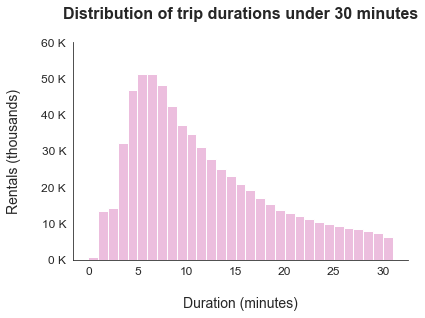

In [358]:
sb.set_style('white')
sb.set_palette(palette = "colorblind", n_colors = 10, desat = 0.6)
base_color = sb.color_palette()[6]
bin_edges = np.arange(0, duration_lim_30.duration_min.max()+2, 1)

plt.hist(duration_lim_30['duration_min'], color = base_color, bins = bin_edges)
plt.title('Distribution of trip durations under 30 minutes\n',  weight = 'bold', fontsize = 16)
plt.xlabel('\nDuration (minutes)', fontsize = 14)
plt.ylabel('Rentals (thousands)\n', fontsize = 14)
plt.xticks(fontsize = 12)

locs, labels = plt.yticks()
y_tick_locs = np.arange(0, int(math.ceil(max(locs)))+1000, 10000)
y_tick_names = ['{:0.0f} K'.format(loc/1000) for loc in y_tick_locs]
plt.yticks(y_tick_locs, y_tick_names, fontsize=12)
sb.despine();

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.21.j Average trip durations under 30 minutes.png', dpi=300, bbox_inches='tight')

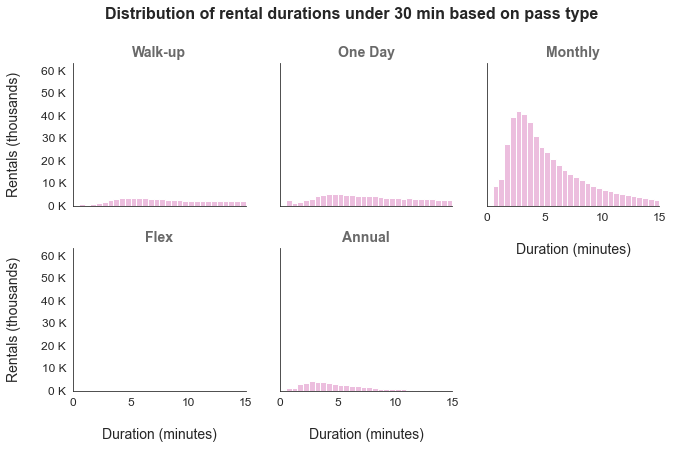

In [359]:
sb.set_style('white')
sb.set_palette(palette = "colorblind", n_colors = 10, desat = 0.6)
base_color = sb.color_palette()[6]

g = sb.FacetGrid(data = duration_lim_30, col = 'pass_type', col_wrap = 3, height = 3, aspect = 1, xlim=(0,30))
g.set(xmargin=0.5, ymargin=0.5)
g.map(plt.hist, "duration_min", color = base_color, bins = np.arange(0, duration_lim_30.duration_min.max()+2, 1))
g.fig.subplots_adjust(top=0.85)
g.fig.suptitle('Distribution of rental durations under 30 min based on pass type\n', fontsize = 16, weight = 'bold')
g.set_titles('{col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# obtain y_ticks and convert them to a multiple of thousands
# obtain the x_ticks and store them as a list
y_tick_names = []
x_tick_names = []
for ax in g.axes.flat:
    for y_label in ax.get_yticklabels():
        y_label_value = int(y_label.get_text())
        y_label_new_value = '{:0.0f} K'.format(y_label_value/1000)
        y_tick_names.append(y_label_new_value)
        
    for x_label in ax.get_xticklabels():
        x_label_value = x_label.get_text()
        x_tick_names.append(x_label_value)

g.set_yticklabels(y_tick_names, size = 12)
g.set_xticklabels(x_tick_names, size = 12)
g.set_xlabels('\nDuration (minutes)', size = 14)
g.set_ylabels('Rentals (thousands)\n', size = 14)

plt.subplots_adjust(wspace=0.2, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.21.k Facet Grid of rental durations under 30 minutes on pass type.png', dpi=300, bbox_inches='tight')

> Let us plot more variety of graphs to observe the distribution of data and hidden insights.

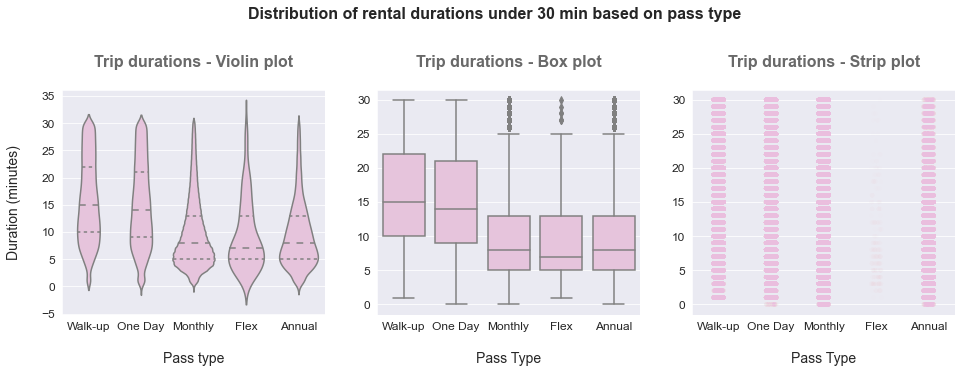

In [360]:
plt.figure(figsize = [16, 5])
sb.set_style('darkgrid')
sb.set_palette(palette = "colorblind", n_colors = 10, desat = 0.6)
base_color = sb.color_palette()[6]

# left plot: violin plot
plt.subplot(1, 3, 1)
sb.violinplot(data = duration_lim_30, x = 'pass_type', y = 'duration_min', 
              inner = 'quartile', color = base_color)
plt.title('Trip durations - Violin plot\n',  weight = 'bold', fontsize = 16, color = 'dimgrey')
plt.xlabel('\nPass type', fontsize = 14)
plt.ylabel('Duration (minutes)\n', fontsize = 14)
plt.xticks(fontsize = 12)
plt.yticks(fontsize = 12)

# center plot: box plot
plt.subplot(1, 3, 2)
sb.boxplot(data = duration_lim_30, x = 'pass_type', y = 'duration_min', color = base_color)
plt.title('Trip durations - Box plot\n',  weight = 'bold', fontsize = 16, color = 'dimgrey')
plt.xlabel('\nPass Type', fontsize = 14)
plt.ylabel('', fontsize = 14)
plt.xticks(fontsize = 12)
plt.yticks(fontsize = 12)

# right plot: strip chart
plt.subplot(1, 3, 3)
sb.stripplot(data = duration_lim_30, x="pass_type", y="duration_min", alpha = 0.002, color = base_color)
plt.title('Trip durations - Strip plot\n',  weight = 'bold', fontsize = 16, color = 'dimgrey')
plt.xlabel('\nPass Type', fontsize = 14)
plt.ylabel('', fontsize = 14)
plt.xticks(fontsize = 12)
plt.yticks(fontsize = 12)

plt.subplots_adjust(wspace=0.2, hspace=0.3)
plt.subplots_adjust(top=0.75)
plt.suptitle('Distribution of rental durations under 30 min based on pass type\n', fontsize = 16, weight = 'bold');

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.21.l Distribution of pass type durations under 30 minutes on various plots.png', dpi=300, bbox_inches='tight')

Calculate the `average trip duration` and the `most frequent trip duration` subjected to each `pass type`.

In [361]:
walkup_mean = math.ceil(duration_lim_30.query(' pass_type == "Walk-up" ').duration_min.mean())
walkup_mode = duration_lim_30.query(' pass_type == "Walk-up" ').duration_min.mode()[0]

oneday_mean = math.ceil(duration_lim_30.query(' pass_type == "One Day" ').duration_min.mean())
oneday_mode = duration_lim_30.query(' pass_type == "One Day" ').duration_min.mode()[0]

monthly_mean = math.ceil(duration_lim_30.query(' pass_type == "Monthly" ').duration_min.mean())
monthly_mode = duration_lim_30.query(' pass_type == "Monthly" ').duration_min.mode()[0]

flex_mean = math.ceil(duration_lim_30.query(' pass_type == "Flex" ').duration_min.mean())
flex_mode = duration_lim_30.query(' pass_type == "Flex" ').duration_min.mode()[0]

annual_mean = math.ceil(duration_lim_30.query(' pass_type == "Annual" ').duration_min.mean())
annual_mode = duration_lim_30.query(' pass_type == "Annual" ').duration_min.mode()[0]

print('Duration mean'.center(30,'-'))
print('walkup_mean  : ', walkup_mean, 'minutes')
print('oneday_mean  : ', oneday_mean, 'minutes')
print('monthly_mean : ', monthly_mean, 'minutes')
print('flex_mean    : ', flex_mean, 'minutes')
print('annual_mean  : ', annual_mean, 'minutes')
print('\n')
print('Duration mode'.center(30,'-'))
print('walkup_mode  : ', walkup_mode, 'minutes')
print('oneday_mode  : ', oneday_mode, 'minutes')
print('monthly_mode : ', monthly_mode, 'minutes')
print('flex_mode    : ', flex_mode, 'minutes')
print('annual_mode  : ', annual_mode, 'minutes')

--------Duration mean---------
walkup_mean  :  16 minutes
oneday_mean  :  15 minutes
monthly_mean :  10 minutes
flex_mean    :  10 minutes
annual_mean  :  10 minutes


--------Duration mode---------
walkup_mode  :  10 minutes
oneday_mode  :  8 minutes
monthly_mode :  5 minutes
flex_mode    :  3 minutes
annual_mode  :  5 minutes


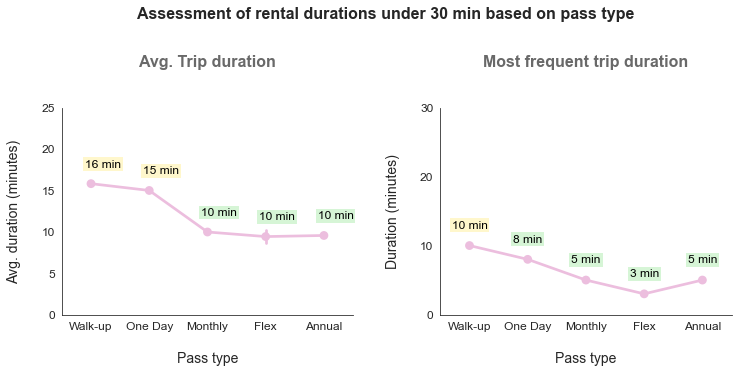

In [362]:
plt.figure(figsize = [12, 5])

sb.set_palette(palette = "colorblind", n_colors = 10, desat = 0.6)
base_color = sb.color_palette()[6]

# left plot: point plot - Avg trip duration
sb.set_style('white')
plt.subplot(1, 2, 1)
ax1 = sb.pointplot(data = duration_lim_30, x = "pass_type", y = "duration_min", linestyles = "-", color = base_color)
plt.title('Avg. Trip duration\n\n',  weight = 'bold', fontsize = 16, color = 'dimgrey')
plt.ylabel('Avg. duration (minutes)\n', fontsize = 14)
plt.xlabel('\nPass type', fontsize = 14)
plt.xticks(fontsize = 12)

locs, labels = plt.yticks()
y_ticks_new = np.arange(0, int(math.ceil(max(locs)))+10, 5)
plt.yticks(y_ticks_new, y_ticks_new, fontsize=12)
sb.despine(top=True, bottom=False, left=False, right=True);

# add annotations
# -------------------------------------------------------
cat_order = duration_lim_30.pass_type.sort_values(ascending=True).unique()
avg_rental_counts = duration_lim_30.groupby([duration_lim_30["pass_type"]]).mean().duration_min[cat_order]
avg_rental_max = avg_rental_counts.max()
clrs = ['gold' if (count > ((avg_rental_max*4)/5)) else 'limegreen' for count in avg_rental_counts ]

# get the current tick locations and labels
locs, labels = plt.xticks()

# loop through each pair of locations and labels
for loc, label, avg_rental_count, clr in zip(locs, labels, avg_rental_counts, clrs):
    try:
        count = avg_rental_count
    except KeyError:
        count = 0   
    pct_string = '{:0.0f} min'.format(math.ceil(count))
    # print the annotation depending on the bar length
    plt.text(loc+0.2, count + int(avg_rental_max/7), pct_string, ha = 'center', color = 'black', 
             fontsize = 12, bbox=dict(pad=1.9,alpha=0.2,color='none',fc=clr))
# -------------------------------------------------------

# right plot: Bar chart - most frequent trip duration
sb.set_style('white')
plt.subplot(1, 2, 2)
walkup_mode = duration_lim_30.query(' pass_type == "Walk-up" ').duration_min.mode()[0]
oneday_mode = duration_lim_30.query(' pass_type == "One Day" ').duration_min.mode()[0]
monthly_mode = duration_lim_30.query(' pass_type == "Monthly" ').duration_min.mode()[0]
flex_mode = duration_lim_30.query(' pass_type == "Flex" ').duration_min.mode()[0]
annual_mode = duration_lim_30.query(' pass_type == "Annual" ').duration_min.mode()[0]
heights = [walkup_mode, oneday_mode, monthly_mode, flex_mode, annual_mode]
labels = duration_lim_30.pass_type.sort_values(ascending=True).unique()
sb.pointplot(x = labels, y = heights, color = base_color)
plt.title('Most frequent trip duration\n\n',  weight = 'bold', fontsize = 16, color = 'dimgrey')
plt.xlabel('\nPass type', fontsize = 14)
plt.ylabel('Duration (minutes)\n', fontsize = 14)
plt.xticks(fontsize = 12)
plt.ylim(ax1.get_ylim())

locs, labels = plt.yticks()
y_ticks_new = np.arange(0, int(math.ceil(max(locs)))+10, 10)
plt.yticks(y_ticks_new, y_ticks_new, fontsize=12)
sb.despine();

# add annotations
# -------------------------------------------------------
freq_rental_counts = heights
freq_rental_max = max(freq_rental_counts)
clrs = ['gold' if (count > ((freq_rental_max*4)/5)) else 'limegreen' for count in freq_rental_counts ]

# get the current tick locations and labels
locs, labels = plt.xticks()

# loop through each pair of locations and labels
for loc, label, freq_rental_count, clr in zip(locs, labels, freq_rental_counts, clrs):
    try:
        count = freq_rental_count
    except KeyError:
        count = 0   
    pct_string = '{:0.0f} min'.format(math.ceil(count))
    # print the annotation depending on the bar length
    plt.text(loc, count + (freq_rental_max/4), pct_string, ha = 'center', color = 'black', 
             fontsize = 12, bbox=dict(pad=1.9,alpha=0.2,color='none',fc=clr))
# -------------------------------------------------------

plt.subplots_adjust(wspace=0.3, hspace=0.3)
plt.subplots_adjust(top=0.7)
plt.suptitle('Assessment of rental durations under 30 min based on pass type\n', fontsize = 16, weight = 'bold');

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.21.m Average trip durations under 30 minutes based on pass type.png', dpi=300, bbox_inches='tight')

`When the dataset is limited to trips under 30 minutes:`

> + If the `pass_type` is `Walk-up`, then the bike rentals has an average rental duration of `16 minutes` and mode of `10 minutes`.
+ If the `pass_type` is `One Day`, then the bike rentals has an average rental duration of `15 minutes` and mode of `8 minutes`.
+ If the `pass_type` is `Monthly`, then the bike rentals has an average rental duration of `10 minutes` and mode of `5 minutes`.
+ If the `pass_type` is `Flex`, then the bike rentals has an average rental duration of `10 minutes` and mode of `3 minutes`.
+ If the `pass_type` is `Annual`, then the bike rentals has an average rental duration of `10 minutes` and mode of `5 minutes`.

`The trip durations being 1 minute or less is probably because of return of the bikes immediately after rental due to technical or other issue. Hence exclude the trips that are under 1 minute duration and re-evalute the statistics.`

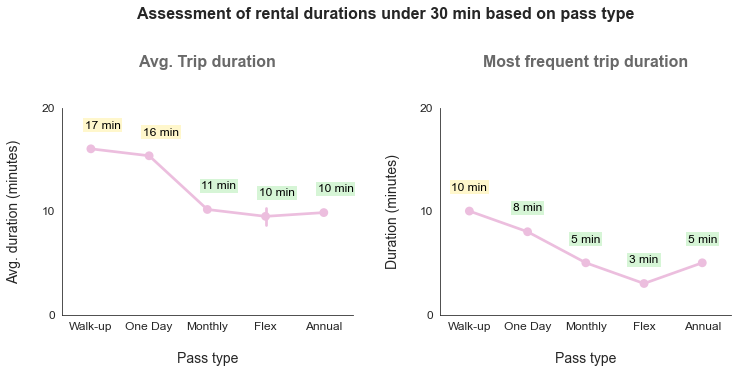

In [363]:
drop_index = duration_lim_30.query(' duration_min <= 1 ').index
temp_df = duration_lim_30.drop(drop_index)

plt.figure(figsize = [12, 5])
sb.set_palette(palette = "colorblind", n_colors = 10, desat = 0.6)
base_color = sb.color_palette()[6]

# left plot: point plot - Avg trip duration
sb.set_style('white')
plt.subplot(1, 2, 1)
ax1 = sb.pointplot(data = temp_df, x = "pass_type", y = "duration_min", linestyles = "-", color = base_color)
plt.title('Avg. Trip duration\n\n',  weight = 'bold', fontsize = 16, color = 'dimgrey')
plt.ylabel('Avg. duration (minutes)\n', fontsize = 14)
plt.xlabel('\nPass type', fontsize = 14)
plt.xticks(fontsize = 12)

locs, labels = plt.yticks()
y_ticks_new = np.arange(0, int(math.ceil(max(locs)))+10, 10)
plt.yticks(y_ticks_new, y_ticks_new, fontsize=12)
sb.despine(top=True, bottom=False, left=False, right=True);

# add annotations
# -------------------------------------------------------
cat_order = temp_df.pass_type.sort_values(ascending=True).unique()
avg_rental_counts = temp_df.groupby([temp_df["pass_type"]]).mean().duration_min[cat_order]
avg_rental_max = avg_rental_counts.max()
clrs = ['gold' if (count > ((avg_rental_max*4)/5)) else 'limegreen' for count in avg_rental_counts ]

# get the current tick locations and labels
locs, labels = plt.xticks()

# loop through each pair of locations and labels
for loc, label, avg_rental_count, clr in zip(locs, labels, avg_rental_counts, clrs):
    try:
        count = avg_rental_count
    except KeyError:
        count = 0   
    pct_string = '{:0.0f} min'.format(math.ceil(count))
    # print the annotation depending on the bar length
    plt.text(loc+0.2, count + int(avg_rental_max/8), pct_string, ha = 'center', color = 'black', 
             fontsize = 12, bbox=dict(pad=1.9,alpha=0.2,color='none',fc=clr))
# -------------------------------------------------------

# right plot: Bar chart - most frequent trip duration
sb.set_style('white')
plt.subplot(1, 2, 2)
walkup_mode = temp_df.query(' pass_type == "Walk-up" ').duration_min.mode()[0]
oneday_mode = temp_df.query(' pass_type == "One Day" ').duration_min.mode()[0]
monthly_mode = temp_df.query(' pass_type == "Monthly" ').duration_min.mode()[0]
flex_mode = temp_df.query(' pass_type == "Flex" ').duration_min.mode()[0]
annual_mode = temp_df.query(' pass_type == "Annual" ').duration_min.mode()[0]
heights = [walkup_mode, oneday_mode, monthly_mode, flex_mode, annual_mode]
labels = temp_df.pass_type.sort_values(ascending=True).unique()
sb.pointplot(x = labels, y = heights, color = base_color)
plt.title('Most frequent trip duration\n\n',  weight = 'bold', fontsize = 16, color = 'dimgrey')
plt.xlabel('\nPass type', fontsize = 14)
plt.ylabel('Duration (minutes)\n', fontsize = 14)
plt.xticks(fontsize = 12)
plt.ylim(ax1.get_ylim())

locs, labels = plt.yticks()
y_ticks_new = np.arange(0, int(math.ceil(max(locs)))+10, 10)
plt.yticks(y_ticks_new, y_ticks_new, fontsize=12)
sb.despine();

# add annotations
# -------------------------------------------------------
freq_rental_counts = heights
freq_rental_max = max(freq_rental_counts)
clrs = ['gold' if (count > ((freq_rental_max*4)/5)) else 'limegreen' for count in freq_rental_counts ]

# get the current tick locations and labels
locs, labels = plt.xticks()

# loop through each pair of locations and labels
for loc, label, freq_rental_count, clr in zip(locs, labels, freq_rental_counts, clrs):
    try:
        count = freq_rental_count
    except KeyError:
        count = 0   
    pct_string = '{:0.0f} min'.format(math.ceil(count))
    # print the annotation depending on the bar length
    plt.text(loc, count + (freq_rental_max/5), pct_string, ha = 'center', color = 'black', 
             fontsize = 12, bbox=dict(pad=1.9,alpha=0.2,color='none',fc=clr))
# -------------------------------------------------------

plt.subplots_adjust(wspace=0.3, hspace=0.3)
plt.subplots_adjust(top=0.7)
plt.suptitle('Assessment of rental durations under 30 min based on pass type\n', fontsize = 16, weight = 'bold');

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.21.n Average trip durations under 30 minutes based on pass type.png', dpi=300, bbox_inches='tight')

`When the dataset is limited to trips under 30 minutes (excluding 1 minute trips):`

> + If the `pass_type` is `Walk-up`, then the bike rentals has an increase in average rental duration to `17 minutes` and mode of `10 minutes`.
+ If the `pass_type` is `One Day`, then the bike rentals has an increase in average rental duration to `16 minutes` and mode of `8 minutes`.
+ If the `pass_type` is `Monthly`, then the bike rentals has an increase in average rental duration to `11 minutes` and mode of `5 minutes`.
+ If the `pass_type` is `Flex`, then the bike rentals has an average rental duration of `10 minutes` and mode of `3 minutes`.
+ If the `pass_type` is `Annual`, then the bike rentals has an average rental duration of `10 minutes` and mode of `5 minutes`.

`Tabular data of the average trip durations based on the dataset limitation of duration entries:`

| Dataset used to measure - |	Avg trip duration (min) |
|:-------------------------:|:-------------------------:|

|                           |     Walk-up    |     One Day    |     Monthly    |      Flex      |     Annual     |
|:-------------------------:|:--------------:|:--------------:|:--------------:|:--------------:|:--------------:|
|  trips under 30 minutes	|       17       |       16       |       11       |       10       |       10       |
|  trips under 120 minutes	|       32       |       31       |       12       |       12       |       13       |
|  overall trips		    |       52       |       61       |       15       |       17       |       25       |

`Tabular data of the most frequent trip durations based on the dataset limitation of duration entries:`

| Dataset used to measure - | Most freq trip duration (min) |
|:-------------------------:|:-----------------------------:|


|                           |     Walk-up    |     One Day    |     Monthly    |      Flex      |     Annual     |
|:-------------------------:|:--------------:|:--------------:|:--------------:|:--------------:|:--------------:|
|  trips under 30 minutes	|       10       |        8       |        5       |        3       |        5       |
|  trips under 120 minutes	|       10       |        8       |        5       |        3       |        5       |
|  overall trips		    |       10       |        8       |        5       |        3       |        5       |

In [364]:
duration_df = pd.DataFrame()
duration_df['dataset'] = ['< 30', '< 30', '< 30', '< 30', '< 30',
                          '< 120', '< 120', '< 120', '< 120', '< 120',
                          'overall', 'overall', 'overall', 'overall', 'overall']

duration_df['pass_type'] = ['Walk-up', 'One Day', 'Monthly', 'Flex', 'Annual', 
                            'Walk-up', 'One Day', 'Monthly', 'Flex', 'Annual',
                            'Walk-up', 'One Day', 'Monthly', 'Flex', 'Annual']

duration_df['duration_avg'] = [17, 16, 11, 10, 10,
                               32, 31, 12, 12, 13,
                               52, 61, 15, 17, 25]

duration_df['duration_mode'] = [10, 8, 5, 3, 5,
                                10, 8, 5, 3, 5,
                                10, 8, 5, 3, 5]
duration_df

,dataset,pass_type,duration_avg,duration_mode
0,< 30,Walk-up,17,10
1,< 30,One Day,16,8
2,< 30,Monthly,11,5
3,< 30,Flex,10,3
4,< 30,Annual,10,5
5,< 120,Walk-up,32,10
6,< 120,One Day,31,8
7,< 120,Monthly,12,5
8,< 120,Flex,12,3
9,< 120,Annual,13,5


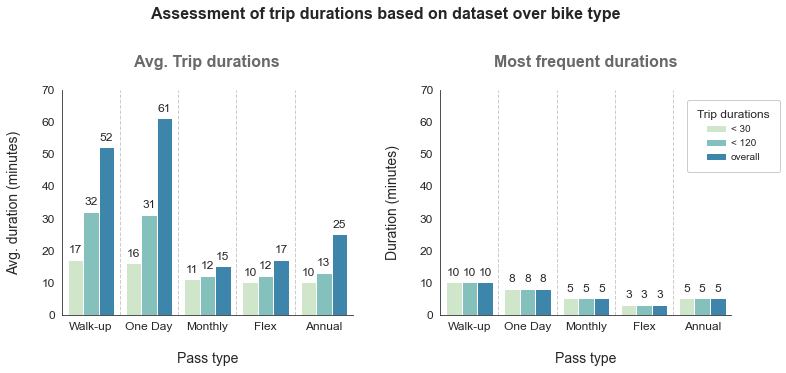

In [365]:
plt.figure(figsize = [12, 5])
sb.set_palette(palette = "GnBu", n_colors = 3, desat = None)
base_color = sb.color_palette()[2]

# left plot: point plot - Avg trip duration
# -------------------------------------------------------
sb.set_style('white')
plt.subplot(1, 2, 1)
ax1 = sb.barplot(data = duration_df, x = 'pass_type', y = 'duration_avg', hue = 'dataset')
plt.title('Avg. Trip durations\n',  weight = 'bold', fontsize = 16, color ='dimgrey')
plt.ylabel('Avg. duration (minutes)\n', fontsize = 14)
plt.xlabel('\nPass type', fontsize = 14)
plt.xticks(fontsize = 12)

locs, labels = plt.yticks()
y_ticks_new = np.arange(0, int(math.ceil(max(locs)))+10, 10)
plt.yticks(y_ticks_new, y_ticks_new, fontsize=12)

plt.legend('', frameon=False, fancybox=False)

# add annotations
for p in ax1.patches:
    ax1.annotate(format(p.get_height(), '.0f'), (p.get_x() + p.get_width() / 2., p.get_height()), 
                 ha = 'center', va = 'center', xytext = (0, 10), textcoords = 'offset points', fontsize = 12)

separators = [0.5, 1.5, 2.5, 3.5]
for loc in separators:
    plt.axvline(loc, ls='--', color='grey', linewidth=1, alpha=0.4);

sb.despine(top=True, bottom=False, left=False, right=True);
# -------------------------------------------------------


# right plot: Bar chart - most frequent trip duration
# -------------------------------------------------------
sb.set_style('white')
plt.subplot(1, 2, 2)
g = sb.barplot(data = duration_df, x = 'pass_type', y = 'duration_mode', hue = 'dataset')
plt.title('Most frequent durations\n',  weight = 'bold', fontsize = 16, color ='dimgrey')
plt.ylabel('Duration (minutes)\n', fontsize = 14)
plt.xlabel('\nPass type', fontsize = 14)
plt.xticks(fontsize = 12)
plt.ylim(ax1.get_ylim())

locs, labels = plt.yticks()
y_ticks_new = np.arange(0, int(math.ceil(max(locs)))+10, 10)
plt.yticks(y_ticks_new, y_ticks_new, fontsize=12)

plt.legend(scatterpoints=1, frameon=True, fancybox=True, shadow=False, framealpha = 1, 
           borderpad=1, borderaxespad=1, loc = 'upper right', labelspacing=0.5, ncol = 1,  
           title='Trip durations', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(1.2, 1))

# add annotations
for p in g.patches:
    g.annotate(format(p.get_height(), '.0f'), (p.get_x() + p.get_width() / 2., p.get_height()), 
               ha = 'center', va = 'center', xytext = (0, 10), textcoords = 'offset points', fontsize = 12)

separators = [0.5, 1.5, 2.5, 3.5]
for loc in separators:
    plt.axvline(loc, ls='--', color='grey', linewidth=1, alpha=0.4);

sb.despine(top=True, bottom=False, left=False, right=True);
# -------------------------------------------------------

plt.subplots_adjust(wspace=0.3, hspace=0.3)
plt.subplots_adjust(top=0.75)
plt.suptitle('Assessment of trip durations based on dataset over bike type\n', fontsize = 16, weight = 'bold');

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.21.o Assessment of trip durations based on dataset over bike type.png', dpi=300, bbox_inches='tight')

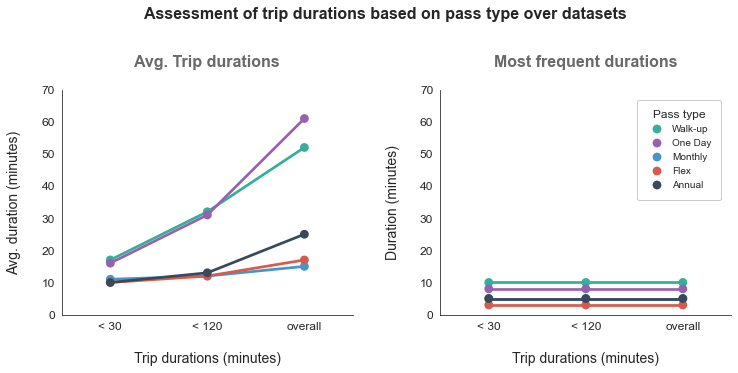

In [366]:
plt.figure(figsize = [12, 5])
flatui = ["#26bda7", "#9b59b6", "#3498db", "#e74c3c", "#34495e"]
sb.set_palette(flatui, n_colors=5, desat=0.8)

# left plot: point plot - Avg trip duration
# -------------------------------------------------------
# -------------------------------------------------------
sb.set_style('white')
plt.subplot(1, 2, 1)

ax1 = sb.pointplot(data = duration_df, x = 'dataset', y = 'duration_avg', hue = 'pass_type', alpha = 0.8)
plt.title('Avg. Trip durations\n',  weight = 'bold', fontsize = 16, color = 'dimgrey')
plt.ylabel('Avg. duration (minutes)\n', fontsize = 14)
plt.xlabel('\nTrip durations (minutes)', fontsize = 14)
plt.xticks(fontsize = 12)

locs, labels = plt.yticks()
y_ticks_new = np.arange(0, int(math.ceil(max(locs)))+10, 10)
plt.yticks(y_ticks_new, y_ticks_new, fontsize=12)

plt.legend('', frameon=False, fancybox=False)
sb.despine(top=True, bottom=False, left=False, right=True);
# -------------------------------------------------------
# -------------------------------------------------------


# right plot: point plot - most frequent trip duration
# -------------------------------------------------------
# -------------------------------------------------------
sb.set_style('white')
plt.subplot(1, 2, 2)

g = sb.pointplot(data = duration_df, x = 'dataset', y = 'duration_mode', hue = 'pass_type', alpha = 0.8)
plt.title('Most frequent durations\n',  weight = 'bold', fontsize = 16, color = 'dimgrey')
plt.ylabel('Duration (minutes)\n', fontsize = 14)
plt.xlabel('\nTrip durations (minutes)', fontsize = 14)
plt.xticks(fontsize = 12)
plt.ylim(ax1.get_ylim())

locs, labels = plt.yticks()
y_ticks_new = np.arange(0, int(math.ceil(max(locs)))+10, 10)
plt.yticks(y_ticks_new, y_ticks_new, fontsize=12)

plt.legend(scatterpoints=1, frameon=True, fancybox=True, shadow=False, framealpha = 1, 
           borderpad=1, borderaxespad=1, loc = 'upper right', labelspacing=0.5, ncol = 1,  
           title='Pass type', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5)

sb.despine(top=True, bottom=False, left=False, right=True);
# -------------------------------------------------------
# -------------------------------------------------------

plt.subplots_adjust(wspace=0.3, hspace=0.3)
plt.subplots_adjust(top=0.75)
plt.suptitle('Assessment of trip durations based on pass type over datasets\n', fontsize = 16, weight = 'bold');

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.21.p Assessment of trip durations based on pass type over datasets.png', dpi=300, bbox_inches='tight')

> The lines subjected to each pass type are closely packed and hard to interpret. Hence plot the distribution of trip duratioins based on pass type over different datasets in bar type chart.

**`Observation:`** There is a clear influence of outliers on the average trip durations. This can be observed between `Walk-up` and `One day` average trip durations. As the dataset increased/included outliers the difference between them increased. Same can be observed between `Monthly`, `Flex` and `Annual` trip durations.

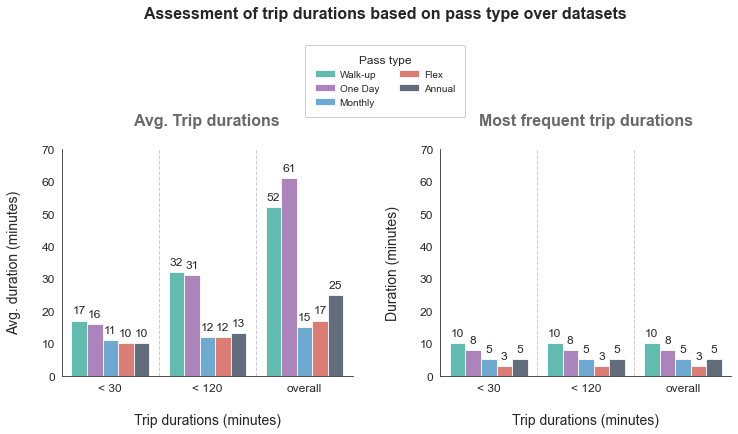

In [367]:
plt.figure(figsize = [12, 6])
flatui = ["#26bda7", "#9b59b6", "#3498db", "#e74c3c", "#34495e"]
sb.set_palette(flatui, n_colors=5, desat=None)

# left plot: bar chart - Avg trip duration
# -------------------------------------------------------
# -------------------------------------------------------
sb.set_style('white')
plt.subplot(1, 2, 1)

ax1 = sb.barplot(data = duration_df, x = 'dataset', y = 'duration_avg', hue = 'pass_type', alpha = 0.8)
plt.title('Avg. Trip durations\n',  weight = 'bold', fontsize = 16, color = 'dimgrey')
plt.ylabel('Avg. duration (minutes)\n', fontsize = 14)
plt.xlabel('\nTrip durations (minutes)', fontsize = 14)
plt.xticks(fontsize = 12)

locs, labels = plt.yticks()
y_ticks_new = np.arange(0, int(math.ceil(max(locs)))+10, 10)
plt.yticks(y_ticks_new, y_ticks_new, fontsize=12)

# add annotations
# -------------------------------------------------------
for p in ax1.patches:
    ax1.annotate(format(p.get_height(), '.0f'), (p.get_x() + p.get_width() / 2., p.get_height()), 
                 ha = 'center', va = 'center', xytext = (0, 10), textcoords = 'offset points', fontsize = 12)

separators = [0.5, 1.5]
for loc in separators:
    plt.axvline(loc, ls='--', color='grey', linewidth=1, alpha=0.4)
# -------------------------------------------------------

plt.legend('', frameon=False, fancybox=False)
sb.despine(top=True, bottom=False, left=False, right=True);
# -------------------------------------------------------
# -------------------------------------------------------


# right plot: bar chart - most frequent trip duration
# -------------------------------------------------------
# -------------------------------------------------------
sb.set_style('white')
plt.subplot(1, 2, 2)

g = sb.barplot(data = duration_df, x = 'dataset', y = 'duration_mode', hue = 'pass_type', alpha = 0.8)
plt.title('Most frequent trip durations\n',  weight = 'bold', fontsize = 16, color = 'dimgrey')
plt.ylabel('Duration (minutes)\n', fontsize = 14)
plt.xlabel('\nTrip durations (minutes)', fontsize = 14)
plt.xticks(fontsize = 12)
plt.ylim(ax1.get_ylim())

locs, labels = plt.yticks()
y_ticks_new = np.arange(0, int(math.ceil(max(locs)))+10, 10)
plt.yticks(y_ticks_new, y_ticks_new, fontsize=12)

# add annotations
# -------------------------------------------------------
for p in g.patches:
    g.annotate(format(p.get_height(), '.0f'), (p.get_x() + p.get_width() / 2., p.get_height()), 
               ha = 'center', va = 'center', xytext = (0, 10), textcoords = 'offset points', fontsize = 12)

separators = [0.5, 1.5]
for loc in separators:
    plt.axvline(loc, ls='--', color='grey', linewidth=1, alpha=0.4)
# -------------------------------------------------------

plt.legend(scatterpoints=1, frameon=True, fancybox=True, shadow=False, framealpha = 1, 
           borderpad=1, borderaxespad=1, loc = 'upper left', labelspacing=0.5, ncol = 2,  
           title='Pass type', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(-0.5, 1.5))

sb.despine(top=True, bottom=False, left=False, right=True);
# -------------------------------------------------------
# -------------------------------------------------------

plt.subplots_adjust(wspace=0.3, hspace=0.3)
plt.subplots_adjust(top=0.65)
plt.suptitle('Assessment of trip durations based on pass type over datasets\n', fontsize = 16, weight = 'bold');

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.21.q Assessment of trip durations based on pass type over datasets.png', dpi=300, bbox_inches='tight')

----

#### 3.2.22 Bivariate analysis of `duration_min` and `fare_type` columns:

+ `Columns`: duration_min, trip_type
+ `Data type`: (Numerical, continuous) and (Categorical, nominal)
+ `Plot`: Facet Grid, Violin plot, Box plot, Adapted Barchart

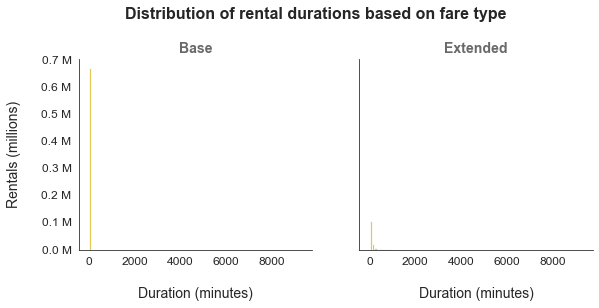

In [368]:
sb.set_style('white')
flatui = ["gold"]
sb.set_palette(palette = flatui, n_colors = 10, desat = 0.7)
base_color = sb.color_palette()[0]

g = sb.FacetGrid(data = bikeshare, col = 'fare_type', col_wrap = 2, height = 4, aspect = 1, )
g.map(plt.hist, "duration_min", color = base_color, 
      bins = np.arange(0, bikeshare.duration_min.max()+100, 100), alpha = 0.8)
g.fig.subplots_adjust(top=0.8)
g.fig.suptitle('Distribution of rental durations based on fare type\n', fontsize = 16, weight = 'bold')
g.set_titles('{col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# obtain y_ticks and convert them to a multiple of millions
# obtain the x_ticks and store them as a list
y_tick_names = []
x_tick_names = []
for ax in g.axes.flat:
    for y_label in ax.get_yticklabels():
        y_label_value = int(y_label.get_text())
        y_label_new_value = '{:0.1f} M'.format(y_label_value/1000000)
        y_tick_names.append(y_label_new_value)
        
    for x_label in ax.get_xticklabels():
        x_label_value = x_label.get_text()
        x_tick_names.append(x_label_value)

g.set_yticklabels(y_tick_names, size = 12)
g.set_xticklabels(x_tick_names, size = 12)
g.set_xlabels('\nDuration (minutes)', size = 14)
g.set_ylabels('Rentals (millions)\n', size = 14)

plt.subplots_adjust(wspace=0.2, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.22.a Facet Grid of rental durations on fare type.png', dpi=300, bbox_inches='tight')

The distribution of `duration_min` values are vague and not easy to interpret. This can be overcome by limiting the plot to a threshold value.

> Let us plot more variety of graphs to observe the distribution of data and hidden insights.

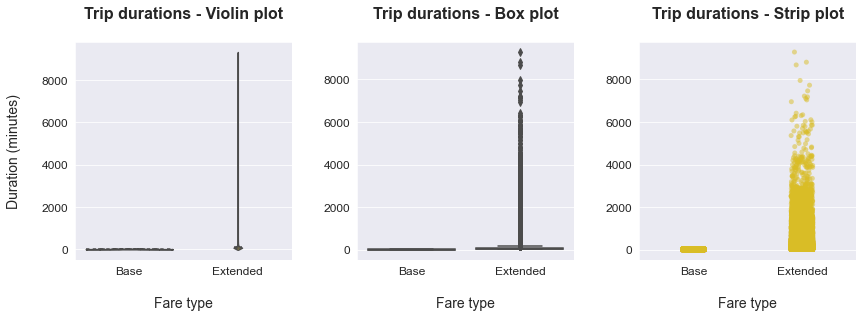

In [369]:
plt.figure(figsize = [14, 4])
sb.set_style('darkgrid')
flatui = ["gold"]
sb.set_palette(palette = flatui, n_colors = 10, desat = 0.7)
base_color = sb.color_palette()[0]

# left plot: violin plot
plt.subplot(1, 3, 1)
sb.violinplot(data = bikeshare, x = 'fare_type', y = 'duration_min', inner = 'quartile',
              color = base_color)
plt.title('Trip durations - Violin plot\n',  weight = 'bold', fontsize = 16)
plt.xlabel('\nFare type', fontsize = 14)
plt.ylabel('Duration (minutes)\n', fontsize = 14)
plt.xticks(fontsize = 12)
plt.yticks(fontsize = 12)

# center plot: box plot
plt.subplot(1, 3, 2)
sb.boxplot(data = bikeshare, x = 'fare_type', y = 'duration_min', color = base_color)
plt.title('Trip durations - Box plot\n',  weight = 'bold', fontsize = 16)
plt.xlabel('\nFare type', fontsize = 14)
plt.ylabel('', fontsize = 14)
plt.xticks(fontsize = 12)
plt.yticks(fontsize = 12)

# right plot: strip chart
plt.subplot(1, 3, 3)
sb.stripplot( data = bikeshare, x = "fare_type", y = "duration_min", alpha = 0.5, color = base_color)
plt.title('Trip durations - Strip plot\n',  weight = 'bold', fontsize = 16)
plt.xlabel('\nFare type', fontsize = 14)
plt.ylabel('', fontsize = 14)
plt.xticks(fontsize = 12)
plt.yticks(fontsize = 12)

plt.subplots_adjust(wspace=0.3, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust dhe figure to include all of the x and y labels
plt.savefig('plots/3.2.22.b Distribution of fare type durations on various plots.png', dpi=300, bbox_inches='tight')

> The above plot depicts the presense of long tail of outliers, and require closer observation for better understanding of the data distribution.

Calculate the `average trip duration` and the `most frequent trip duration` subjected to each `fare type`.

In [370]:
base_mean = math.ceil(bikeshare.query(' fare_type == "Base" ').duration_min.mean())
base_mode = bikeshare.query(' fare_type == "Base" ').duration_min.mode()[0]

extended_mean = math.ceil(bikeshare.query(' fare_type == "Extended" ').duration_min.mean())
extended_mode = bikeshare.query(' fare_type == "Extended" ').duration_min.mode()[0]

print('Duration mean'.center(30,'-'))
print('base_mean     : ', base_mean, 'minutes')
print('extended_mean : ', extended_mean, 'minutes')
print('\n')
print('Duration mode'.center(30,'-'))
print('base_mode     : ', base_mode, 'minutes')
print('extended_mode : ', extended_mode, 'minutes')

--------Duration mean---------
base_mean     :  12 minutes
extended_mean :  119 minutes


--------Duration mode---------
base_mode     :  6 minutes
extended_mode :  31 minutes


> The calculations are influenced by the presence of outliers

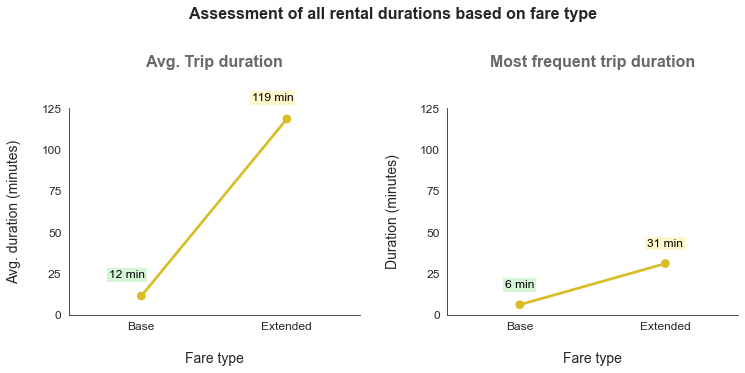

In [371]:
plt.figure(figsize = [12, 5])

flatui = ["gold"]
sb.set_palette(palette = flatui, n_colors = 10, desat = 0.7)
base_color = sb.color_palette()[0]

# left plot: point plot - Avg trip duration
sb.set_style('white')
plt.subplot(1, 2, 1)
ax1 = sb.pointplot(data = bikeshare, x = "fare_type", y = "duration_min", linestyles = "-", color = base_color)
plt.title('Avg. Trip duration\n\n',  weight = 'bold', fontsize = 16, color = 'dimgrey')
plt.ylabel('Avg. duration (minutes)\n', fontsize = 14)
plt.xlabel('\nFare type', fontsize = 14)
plt.xticks(fontsize = 12)

locs, labels = plt.yticks()
y_ticks_new = np.arange(0, int(math.ceil(max(locs)))+5, 25)
plt.yticks(y_ticks_new, y_ticks_new, fontsize=12)
sb.despine(top=True, bottom=False, left=False, right=True);

# add annotations
# -------------------------------------------------------
cat_order = bikeshare.fare_type.sort_values(ascending=True).unique()
avg_rental_counts = bikeshare.groupby([bikeshare["fare_type"]]).mean().duration_min[cat_order]
avg_rental_max = avg_rental_counts.max()
clrs = ['gold' if (count > ((avg_rental_max*4)/5)) else 'limegreen' for count in avg_rental_counts ]

# get the current tick locations and labels
locs, labels = plt.xticks()

# loop through each pair of locations and labels
for loc, label, avg_rental_count, clr in zip(locs, labels, avg_rental_counts, clrs):
    try:
        count = avg_rental_count
    except KeyError:
        count = 0   
    pct_string = '{:0.0f} min'.format(math.ceil(count))
    # print the annotation depending on the bar length
    plt.text(loc-0.1, count + int(avg_rental_max/10), pct_string, ha = 'center', color = 'black', 
             fontsize = 12, bbox=dict(pad=1.9,alpha=0.2,color='none',fc=clr))
# -------------------------------------------------------

# right plot: Bar chart - most frequent trip duration
sb.set_style('white')
plt.subplot(1, 2, 2)
base_mode = bikeshare.query(' fare_type == "Base" ').duration_min.mode()[0]
extended_mode = bikeshare.query(' fare_type == "Extended" ').duration_min.mode()[0]
heights = [base_mode, extended_mode]
labels = bikeshare.fare_type.sort_values(ascending=True).unique()
sb.pointplot(x = labels, y = heights, color = base_color)
plt.title('Most frequent trip duration\n\n',  weight = 'bold', fontsize = 16, color = 'dimgrey')
plt.xlabel('\nFare type', fontsize = 14)
plt.ylabel('Duration (minutes)\n', fontsize = 14)
plt.xticks(fontsize = 12)
plt.ylim(ax1.get_ylim())

locs, labels = plt.yticks()
y_ticks_new = np.arange(0, int(math.ceil(max(locs)))+5, 25)
plt.yticks(y_ticks_new, y_ticks_new, fontsize=12)
sb.despine();

# add annotations
# -------------------------------------------------------
freq_rental_counts = heights
freq_rental_max = max(freq_rental_counts)
clrs = ['gold' if (count > ((freq_rental_max*4)/5)) else 'limegreen' for count in freq_rental_counts ]

# get the current tick locations and labels
locs, labels = plt.xticks()

# loop through each pair of locations and labels
for loc, label, freq_rental_count, clr in zip(locs, labels, freq_rental_counts, clrs):
    try:
        count = freq_rental_count
    except KeyError:
        count = 0   
    pct_string = '{:0.0f} min'.format(math.ceil(count))
    # print the annotation depending on the bar length
    plt.text(loc, count + (freq_rental_max/3), pct_string, ha = 'center', color = 'black', 
             fontsize = 12, bbox=dict(pad=1.9,alpha=0.2,color='none',fc=clr))
# -------------------------------------------------------

plt.subplots_adjust(wspace=0.3, hspace=0.3)
plt.subplots_adjust(top=0.7)
plt.suptitle('Assessment of all rental durations based on fare type\n', fontsize = 16, weight = 'bold');

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.22.c Average trip durations based on fare type.png', dpi=300, bbox_inches='tight')

> + If the `fare_type` is `Base`, then the bike rentals has an average rental duration of `12 minutes` and mode of `6 minutes`.
+ If the `fare_type` is `Extended`, then the bike rentals has an average rental duration of `119 minutes` and mode of `31 minutes`.

`The trip durations being 1 minute or less is probably because of return of the bikes immediately after rental due to technical or other issue. Hence exclude the trips that are under 1 minute duration and re-evalute the statistics.`

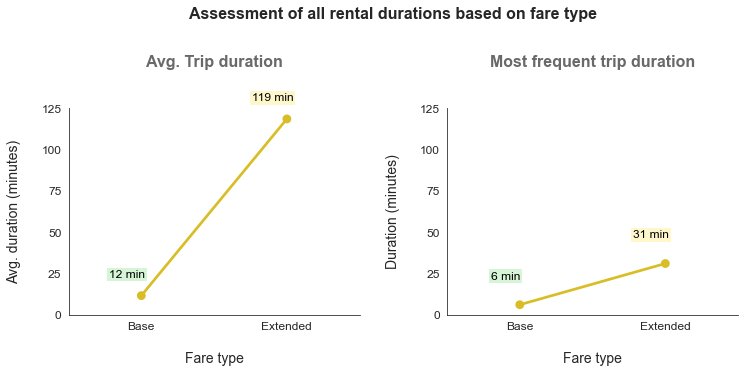

In [372]:
drop_index = bikeshare.query(' duration_min <= 1 ').index
temp_df = bikeshare.drop(drop_index)

plt.figure(figsize = [12, 5])
flatui = ["gold"]
sb.set_palette(palette = flatui, n_colors = 10, desat = 0.7)
base_color = sb.color_palette()[0]

# left plot: point plot - Avg trip duration
sb.set_style('white')
plt.subplot(1, 2, 1)
ax1 = sb.pointplot(data = temp_df, x = "fare_type", y = "duration_min", linestyles = "-", color = base_color)
plt.title('Avg. Trip duration\n\n',  weight = 'bold', fontsize = 16, color = 'dimgrey')
plt.ylabel('Avg. duration (minutes)\n', fontsize = 14)
plt.xlabel('\nFare type', fontsize = 14)
plt.xticks(fontsize = 12)

locs, labels = plt.yticks()
y_ticks_new = np.arange(0, int(math.ceil(max(locs)))+5, 25)
plt.yticks(y_ticks_new, y_ticks_new, fontsize=12)
sb.despine(top=True, bottom=False, left=False, right=True);

# add annotations
# -------------------------------------------------------
cat_order = temp_df.fare_type.sort_values(ascending=True).unique()
avg_rental_counts = temp_df.groupby([temp_df["fare_type"]]).mean().duration_min[cat_order]
avg_rental_max = avg_rental_counts.max()
clrs = ['gold' if (count > ((avg_rental_max*4)/5)) else 'limegreen' for count in avg_rental_counts ]

# get the current tick locations and labels
locs, labels = plt.xticks()

# loop through each pair of locations and labels
for loc, label, avg_rental_count, clr in zip(locs, labels, avg_rental_counts, clrs):
    try:
        count = avg_rental_count
    except KeyError:
        count = 0   
    pct_string = '{:0.0f} min'.format(math.ceil(count))
    # print the annotation depending on the bar length
    plt.text(loc-0.1, count + int(avg_rental_max/10), pct_string, ha = 'center', color = 'black', 
             fontsize = 12, bbox=dict(pad=1.9,alpha=0.2,color='none',fc=clr))
# -------------------------------------------------------

# right plot: Bar chart - most frequent trip duration
sb.set_style('white')
plt.subplot(1, 2, 2)
base_mode = temp_df.query(' fare_type == "Base" ').duration_min.mode()[0]
extended_mode = temp_df.query(' fare_type == "Extended" ').duration_min.mode()[0]
heights = [base_mode, extended_mode]
labels = temp_df.fare_type.sort_values(ascending=True).unique()
sb.pointplot(x = labels, y = heights, color = base_color)
plt.title('Most frequent trip duration\n\n',  weight = 'bold', fontsize = 16, color = 'dimgrey')
plt.xlabel('\nFare type', fontsize = 14)
plt.ylabel('Duration (minutes)\n', fontsize = 14)
plt.xticks(fontsize = 12)
plt.ylim(ax1.get_ylim())

locs, labels = plt.yticks()
y_ticks_new = np.arange(0, int(math.ceil(max(locs)))+5, 25)
plt.yticks(y_ticks_new, y_ticks_new, fontsize=12)
sb.despine();

# add annotations
# -------------------------------------------------------
freq_rental_counts = heights
freq_rental_max = max(freq_rental_counts)
clrs = ['gold' if (count > ((freq_rental_max*4)/5)) else 'limegreen' for count in freq_rental_counts ]

# get the current tick locations and labels
locs, labels = plt.xticks()

# loop through each pair of locations and labels
for loc, label, freq_rental_count, clr in zip(locs, labels, freq_rental_counts, clrs):
    try:
        count = freq_rental_count
    except KeyError:
        count = 0   
    pct_string = '{:0.0f} min'.format(math.ceil(count))
    # print the annotation depending on the bar length
    plt.text(loc-0.1, count + (freq_rental_max/2), pct_string, ha = 'center', color = 'black', 
             fontsize = 12, bbox=dict(pad=1.9,alpha=0.2,color='none',fc=clr))
# -------------------------------------------------------

plt.subplots_adjust(wspace=0.3, hspace=0.3)
plt.subplots_adjust(top=0.7)
plt.suptitle('Assessment of all rental durations based on fare type\n', fontsize = 16, weight = 'bold');

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.22.d Average trip durations based on fare type.png', dpi=300, bbox_inches='tight')

When the trips with durations `<= 1 minute` are removed from the assessment, then the result is as follows:

> + If the `fare_type` is `Base`, then the bike rentals has an average rental duration of `12 minutes` and mode of `6 minutes`.
+ If the `fare_type` is `Extended`, then the bike rentals has an average rental duration of `119 minutes` and mode of `31 minutes`.

**`Dataset limited under 120 min:`**

In [373]:
bikeshare.duration_min.describe()

count    808589.000000
mean         29.861795
std         119.355799
min           0.000000
25%           6.000000
50%          12.000000
75%          23.000000
max        9283.000000
Name: duration_min, dtype: float64

> The distribution of `duration_min` values are vague and not easy to interpret. This can be overcome by limiting the dataset to a threshold value, say `120 minutes` or `2 hours` as most of the `duration_min` values falls under this boundary.

In [374]:
# calculate the percentage of the dataset that falls under `2 hour` trip duration.
np.round((bikeshare.query(' duration_min <= 120 ').shape[0]/bikeshare.shape[0])*100, 2)

96.9

In [375]:
duration_120 = bikeshare.query(' duration_min > 120 ')

# calculate the proportion of the trips with 'Walk-up' pass type, that will be dropped
base_type_drops = np.round((duration_120.query(' fare_type == "Base" ').shape[0]/
                            bikeshare.query(' fare_type == "Base" ').shape[0])*100, 2)

# calculate the proportion of the trips with 'One Day' pass type, that will be dropped
extended_type_drops = np.round((duration_120.query(' fare_type == "Extended" ').shape[0]/
                                bikeshare.query(' fare_type == "Extended" ').shape[0])*100, 2)

print("Proportion of base type entries that will be dropped".ljust(60, ' '), ':', base_type_drops)
print("Proportion of extended type entries that will be dropped".ljust(60, ' '), ':', extended_type_drops)

Proportion of base type entries that will be dropped         : 0.0
Proportion of extended type entries that will be dropped     : 17.95


In [376]:
# Limit the dataset that has entries under 2 hours duration
duration_lim_120 = bikeshare.query(' duration_min <= 120 ')

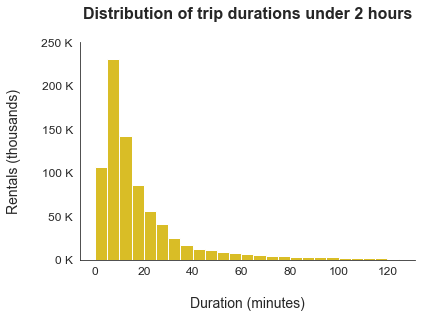

In [377]:
sb.set_style('white')
flatui = ["gold"]
sb.set_palette(palette = flatui, n_colors = 10, desat = 0.7)
base_color = sb.color_palette()[0]
bin_edges = np.arange(0, duration_lim_120.duration_min.max()+10, 5)

plt.hist(duration_lim_120['duration_min'], color = base_color, bins = bin_edges)
plt.title('Distribution of trip durations under 2 hours\n',  weight = 'bold', fontsize = 16)
plt.xlabel('\nDuration (minutes)', fontsize = 14)
plt.ylabel('Rentals (thousands)\n', fontsize = 14)
plt.xticks(fontsize = 12)

locs, labels = plt.yticks()
y_tick_locs = np.arange(0, int(math.ceil(max(locs)))+1000, 50000)
y_tick_names = ['{:0.0f} K'.format(loc/1000) for loc in y_tick_locs]
plt.yticks(y_tick_locs, y_tick_names, fontsize=12)
sb.despine();

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.22.e Distribution of trip durations under 2 hours.png', dpi=300, bbox_inches='tight')

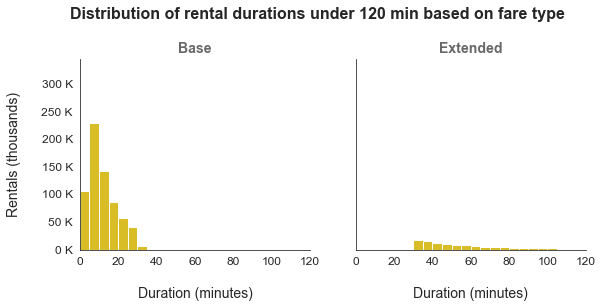

In [378]:
sb.set_style('white')
flatui = ["gold"]
sb.set_palette(palette = flatui, n_colors = 10, desat = 0.7)
base_color = sb.color_palette()[0]

g = sb.FacetGrid(data = duration_lim_120, col = 'fare_type', col_wrap = 2, height = 4, aspect = 1, xlim=(0,120))
g.set(xmargin=0.5, ymargin=0.5)
g.map(plt.hist, "duration_min", color = base_color, bins = np.arange(0, duration_lim_120.duration_min.max()+10, 5))
g.fig.subplots_adjust(top=0.8)
g.fig.suptitle('Distribution of rental durations under 120 min based on fare type\n', fontsize = 16, weight = 'bold')
g.set_titles('{col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# obtain y_ticks and convert them to a multiple of thousands
# obtain the x_ticks and store them as a list
y_tick_names = []
x_tick_names = []
for ax in g.axes.flat:
    for y_label in ax.get_yticklabels():
        y_label_value = int(y_label.get_text())
        y_label_new_value = '{:0.0f} K'.format(y_label_value/1000)
        y_tick_names.append(y_label_new_value)
        
    for x_label in ax.get_xticklabels():
        x_label_value = x_label.get_text()
        x_tick_names.append(x_label_value)

g.set_yticklabels(y_tick_names, size = 12)
g.set_xticklabels(x_tick_names, size = 12)
g.set_xlabels('\nDuration (minutes)', size = 14)
g.set_ylabels('Rentals (thousands)\n', size = 14)

plt.subplots_adjust(wspace=0.2, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.22.f Facet Grid of rental durations under 2 hours on fare type.png', dpi=300, bbox_inches='tight')

> Let us plot more variety of graphs to observe the distribution of data and hidden insights.

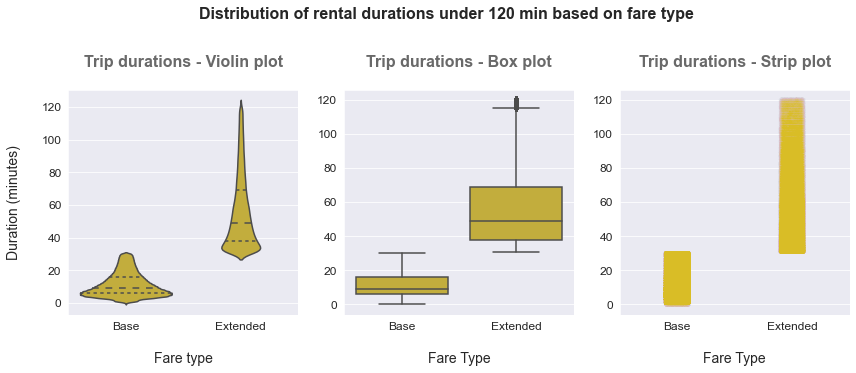

In [379]:
plt.figure(figsize = [14, 5])
sb.set_style('darkgrid')
flatui = ["gold"]
sb.set_palette(palette = flatui, n_colors = 10, desat = 0.7)
base_color = sb.color_palette()[0]

# left plot: violin plot
plt.subplot(1, 3, 1)
sb.violinplot(data = duration_lim_120, x = 'fare_type', y = 'duration_min', 
              inner = 'quartile', color = base_color)
plt.title('Trip durations - Violin plot\n',  weight = 'bold', fontsize = 16, color = 'dimgrey')
plt.xlabel('\nFare type', fontsize = 14)
plt.ylabel('Duration (minutes)\n', fontsize = 14)
plt.xticks(fontsize = 12)
plt.yticks(fontsize = 12)

# center plot: box plot
plt.subplot(1, 3, 2)
sb.boxplot(data = duration_lim_120, x = 'fare_type', y = 'duration_min', color = base_color)
plt.title('Trip durations - Box plot\n',  weight = 'bold', fontsize = 16, color = 'dimgrey')
plt.xlabel('\nFare Type', fontsize = 14)
plt.ylabel('', fontsize = 14)
plt.xticks(fontsize = 12)
plt.yticks(fontsize = 12)

# right plot: strip chart
plt.subplot(1, 3, 3)
sb.stripplot(data = duration_lim_120, x="fare_type", y="duration_min", alpha = 0.002, color = base_color)
plt.title('Trip durations - Strip plot\n',  weight = 'bold', fontsize = 16, color = 'dimgrey')
plt.xlabel('\nFare Type', fontsize = 14)
plt.ylabel('', fontsize = 14)
plt.xticks(fontsize = 12)
plt.yticks(fontsize = 12)

plt.subplots_adjust(wspace=0.2, hspace=0.3)
plt.subplots_adjust(top=0.75)
plt.suptitle('Distribution of rental durations under 120 min based on fare type\n', fontsize = 16, weight = 'bold');

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.22.g Distribution of fare type durations under 2 hours on various plots.png', dpi=300, bbox_inches='tight')

Calculate the `average trip duration` and the `most frequent trip duration` subjected to each `fare type`.

In [380]:
base_mean = math.ceil(duration_lim_120.query(' fare_type == "Base" ').duration_min.mean())
base_mode = duration_lim_120.query(' fare_type == "Base" ').duration_min.mode()[0]

extended_mean = math.ceil(duration_lim_120.query(' fare_type == "Extended" ').duration_min.mean())
extended_mode = duration_lim_120.query(' fare_type == "Extended" ').duration_min.mode()[0]

print('Duration mean'.center(30,'-'))
print('base_mean     : ', base_mean, 'minutes')
print('extended_mean : ', extended_mean, 'minutes')
print('\n')
print('Duration mode'.center(30,'-'))
print('base_mode     : ', base_mode, 'minutes')
print('extended_mode : ', extended_mode, 'minutes')

--------Duration mean---------
base_mean     :  12 minutes
extended_mean :  57 minutes


--------Duration mode---------
base_mode     :  6 minutes
extended_mode :  31 minutes


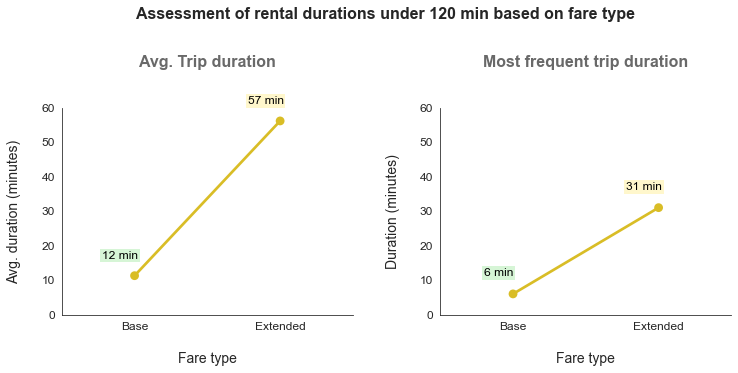

In [381]:
plt.figure(figsize = [12, 5])
flatui = ["gold"]
sb.set_palette(palette = flatui, n_colors = 10, desat = 0.7)
base_color = sb.color_palette()[0]

# left plot: point plot - Avg trip duration
sb.set_style('white')
plt.subplot(1, 2, 1)
ax1 = sb.pointplot(data = duration_lim_120, x = "fare_type", y = "duration_min", linestyles = "-", color = base_color)
plt.title('Avg. Trip duration\n\n',  weight = 'bold', fontsize = 16, color = 'dimgrey')
plt.ylabel('Avg. duration (minutes)\n', fontsize = 14)
plt.xlabel('\nFare type', fontsize = 14)
plt.xticks(fontsize = 12)

locs, labels = plt.yticks()
y_ticks_new = np.arange(0, int(math.ceil(max(locs)))+10, 10)
plt.yticks(y_ticks_new, y_ticks_new, fontsize=12)
sb.despine(top=True, bottom=False, left=False, right=True);

# add annotations
# -------------------------------------------------------
cat_order = duration_lim_120.fare_type.sort_values(ascending=True).unique()
avg_rental_counts = duration_lim_120.groupby([duration_lim_120["fare_type"]]).mean().duration_min[cat_order]
avg_rental_max = avg_rental_counts.max()
clrs = ['gold' if (count > ((avg_rental_max*4)/5)) else 'limegreen' for count in avg_rental_counts ]

# get the current tick locations and labels
locs, labels = plt.xticks()

# loop through each pair of locations and labels
for loc, label, avg_rental_count, clr in zip(locs, labels, avg_rental_counts, clrs):
    try:
        count = avg_rental_count
    except KeyError:
        count = 0   
    pct_string = '{:0.0f} min'.format(math.ceil(count))
    # print the annotation depending on the bar length
    plt.text(loc-0.1, count + int(avg_rental_max/10), pct_string, ha = 'center', color = 'black', 
             fontsize = 12, bbox=dict(pad=1.9,alpha=0.2,color='none',fc=clr))
# -------------------------------------------------------

# right plot: Bar chart - most frequent trip duration
sb.set_style('white')
plt.subplot(1, 2, 2)
base_mode = duration_lim_120.query(' fare_type == "Base" ').duration_min.mode()[0]
extended_mode = duration_lim_120.query(' fare_type == "Extended" ').duration_min.mode()[0]
heights = [base_mode, extended_mode]
labels = duration_lim_120.fare_type.sort_values(ascending=True).unique()
sb.pointplot(x = labels, y = heights, color = base_color)
plt.title('Most frequent trip duration\n\n',  weight = 'bold', fontsize = 16, color = 'dimgrey')
plt.xlabel('\nFare type', fontsize = 14)
plt.ylabel('Duration (minutes)\n', fontsize = 14)
plt.xticks(fontsize = 12)
plt.ylim(ax1.get_ylim())

locs, labels = plt.yticks()
y_ticks_new = np.arange(0, int(math.ceil(max(locs)))+10, 10)
plt.yticks(y_ticks_new, y_ticks_new, fontsize=12)
sb.despine();

# add annotations
# -------------------------------------------------------
freq_rental_counts = heights
freq_rental_max = max(freq_rental_counts)
clrs = ['gold' if (count > ((freq_rental_max*4)/5)) else 'limegreen' for count in freq_rental_counts ]

# get the current tick locations and labels
locs, labels = plt.xticks()

# loop through each pair of locations and labels
for loc, label, freq_rental_count, clr in zip(locs, labels, freq_rental_counts, clrs):
    try:
        count = freq_rental_count
    except KeyError:
        count = 0   
    pct_string = '{:0.0f} min'.format(math.ceil(count))
    # print the annotation depending on the bar length
    plt.text(loc-0.1, count + (freq_rental_max/6), pct_string, ha = 'center', color = 'black', 
             fontsize = 12, bbox=dict(pad=1.9,alpha=0.2,color='none',fc=clr))
# -------------------------------------------------------

plt.subplots_adjust(wspace=0.3, hspace=0.3)
plt.subplots_adjust(top=0.7)
plt.suptitle('Assessment of rental durations under 120 min based on fare type\n', fontsize = 16, weight = 'bold');

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.22.h Average trip durations under 2 hours based on fare type.png', dpi=300, bbox_inches='tight')

`When the dataset is limited to trips under 120 minutes:`

> + If the `fare_type` is `Base`, then the bike rentals has an average rental duration of `12 minutes` and mode of `6 minutes`.
+ If the `fare_type` is `Extended`, then the bike rentals has an average rental duration of `57 minutes` and mode of `31 minutes`.

`The trip durations being 1 minute or less is probably because of return of the bikes immediately after rental due to technical or other issue. Hence exclude the trips that are under 1 minute duration and re-evalute the statistics.`

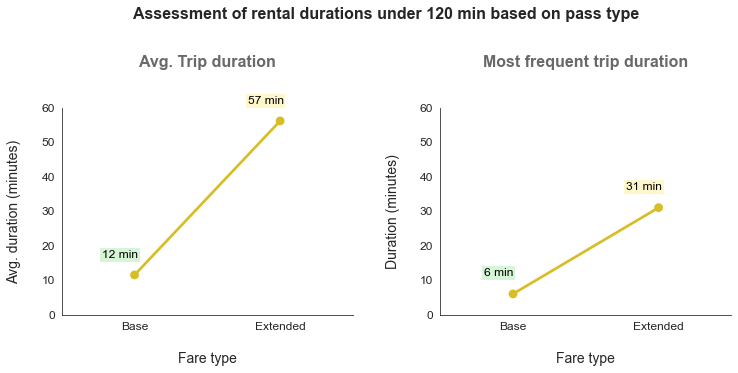

In [382]:
drop_index = duration_lim_120.query(' duration_min <= 1 ').index
temp_df = duration_lim_120.drop(drop_index)

plt.figure(figsize = [12, 5])
flatui = ["gold"]
sb.set_palette(palette = flatui, n_colors = 10, desat = 0.7)
base_color = sb.color_palette()[0]

# left plot: point plot - Avg trip duration
sb.set_style('white')
plt.subplot(1, 2, 1)
ax1 = sb.pointplot(data = temp_df, x = "fare_type", y = "duration_min", linestyles = "-", color = base_color)
plt.title('Avg. Trip duration\n\n',  weight = 'bold', fontsize = 16, color = 'dimgrey')
plt.ylabel('Avg. duration (minutes)\n', fontsize = 14)
plt.xlabel('\nFare type', fontsize = 14)
plt.xticks(fontsize = 12)

locs, labels = plt.yticks()
y_ticks_new = np.arange(0, int(math.ceil(max(locs)))+10, 10)
plt.yticks(y_ticks_new, y_ticks_new, fontsize=12)
sb.despine(top=True, bottom=False, left=False, right=True);

# add annotations
# -------------------------------------------------------
cat_order = temp_df.fare_type.sort_values(ascending=True).unique()
avg_rental_counts = temp_df.groupby([temp_df["fare_type"]]).mean().duration_min[cat_order]
avg_rental_max = avg_rental_counts.max()
clrs = ['gold' if (count > ((avg_rental_max*4)/5)) else 'limegreen' for count in avg_rental_counts ]

# get the current tick locations and labels
locs, labels = plt.xticks()

# loop through each pair of locations and labels
for loc, label, avg_rental_count, clr in zip(locs, labels, avg_rental_counts, clrs):
    try:
        count = avg_rental_count
    except KeyError:
        count = 0   
    pct_string = '{:0.0f} min'.format(math.ceil(count))
    # print the annotation depending on the bar length
    plt.text(loc-0.1, count + int(avg_rental_max/10), pct_string, ha = 'center', color = 'black', 
             fontsize = 12, bbox=dict(pad=1.9,alpha=0.2,color='none',fc=clr))
# -------------------------------------------------------

# right plot: Bar chart - most frequent trip duration
sb.set_style('white')
plt.subplot(1, 2, 2)
base_mode = temp_df.query(' fare_type == "Base" ').duration_min.mode()[0]
extended_mode = temp_df.query(' fare_type == "Extended" ').duration_min.mode()[0]
heights = [base_mode, extended_mode]
labels = temp_df.fare_type.sort_values(ascending=True).unique()
sb.pointplot(x = labels, y = heights, color = base_color)
plt.title('Most frequent trip duration\n\n',  weight = 'bold', fontsize = 16, color = 'dimgrey')
plt.xlabel('\nFare type', fontsize = 14)
plt.ylabel('Duration (minutes)\n', fontsize = 14)
plt.xticks(fontsize = 12)
plt.ylim(ax1.get_ylim())

locs, labels = plt.yticks()
y_ticks_new = np.arange(0, int(math.ceil(max(locs)))+10, 10)
plt.yticks(y_ticks_new, y_ticks_new, fontsize=12)
sb.despine();

# add annotations
# -------------------------------------------------------
freq_rental_counts = heights
freq_rental_max = max(freq_rental_counts)
clrs = ['gold' if (count > ((freq_rental_max*4)/5)) else 'limegreen' for count in freq_rental_counts ]

# get the current tick locations and labels
locs, labels = plt.xticks()

# loop through each pair of locations and labels
for loc, label, freq_rental_count, clr in zip(locs, labels, freq_rental_counts, clrs):
    try:
        count = freq_rental_count
    except KeyError:
        count = 0   
    pct_string = '{:0.0f} min'.format(math.ceil(count))
    # print the annotation depending on the bar length
    plt.text(loc-0.1, count + (freq_rental_max/6), pct_string, ha = 'center', color = 'black', 
             fontsize = 12, bbox=dict(pad=1.9,alpha=0.2,color='none',fc=clr))
# -------------------------------------------------------

plt.subplots_adjust(wspace=0.3, hspace=0.3)
plt.subplots_adjust(top=0.7)
plt.suptitle('Assessment of rental durations under 120 min based on pass type\n', fontsize = 16, weight = 'bold');

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.22.i Average trip durations under 2 hours based on fare type.png', dpi=300, bbox_inches='tight')

`When the dataset is limited to trips under 120 minutes (excluding 1 minute trips):`

> + If the `fare_type` is `Base`, then the bike rentals has an average rental duration of `12 minutes` and mode of `6 minutes`.
+ If the `fare_type` is `Extended`, then the bike rentals has an average rental duration of `57 minutes` and mode of `31 minutes`.

**`Dataset limited under 30 min:`**

In [383]:
bikeshare.duration_min.describe()

count    808589.000000
mean         29.861795
std         119.355799
min           0.000000
25%           6.000000
50%          12.000000
75%          23.000000
max        9283.000000
Name: duration_min, dtype: float64

> The calculations are influenced by the presence of outliers. This can be overcome by limiting the dataset to a threshold value, say `30 minutes` as more than `75%` of the `duration_min` values falls under this boundary.

In [384]:
# Limit the dataset that has entries under 30 minutes duration
duration_lim_30 = bikeshare.query(' duration_min <= 30 ')

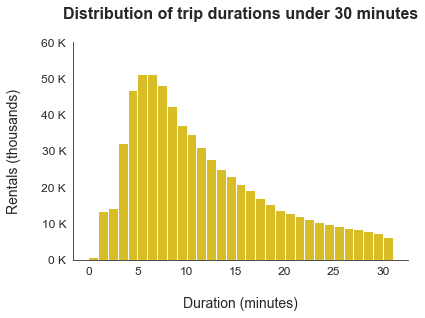

In [385]:
sb.set_style('white')
flatui = ["gold"]
sb.set_palette(palette = flatui, n_colors = 10, desat = 0.7)
base_color = sb.color_palette()[0]
bin_edges = np.arange(0, duration_lim_30.duration_min.max()+2, 1)

plt.hist(duration_lim_30['duration_min'], color = base_color, bins = bin_edges)
plt.title('Distribution of trip durations under 30 minutes\n',  weight = 'bold', fontsize = 16)
plt.xlabel('\nDuration (minutes)', fontsize = 14)
plt.ylabel('Rentals (thousands)\n', fontsize = 14)
plt.xticks(fontsize = 12)

locs, labels = plt.yticks()
y_tick_locs = np.arange(0, int(math.ceil(max(locs)))+1000, 10000)
y_tick_names = ['{:0.0f} K'.format(loc/1000) for loc in y_tick_locs]
plt.yticks(y_tick_locs, y_tick_names, fontsize=12)
sb.despine();

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.22.j Distribution of trip durations under 30 minutes.png', dpi=300, bbox_inches='tight')

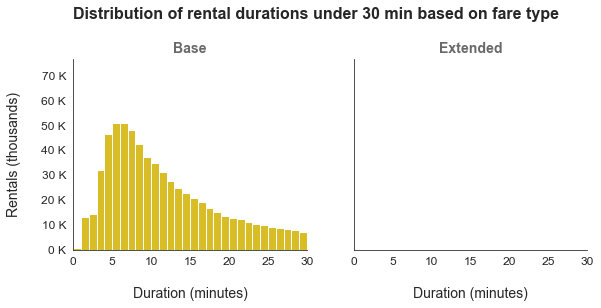

In [386]:
sb.set_style('white')
flatui = ["gold"]
sb.set_palette(palette = flatui, n_colors = 10, desat = 0.7)
base_color = sb.color_palette()[0]

g = sb.FacetGrid(data = duration_lim_30, col = 'fare_type', col_wrap = 2, height = 4, aspect = 1, xlim=(0,30))
g.set(xmargin=0.5, ymargin=0.5)
g.map(plt.hist, "duration_min", color = base_color, bins = np.arange(0, duration_lim_30.duration_min.max()+2, 1))
g.fig.subplots_adjust(top=0.8)
g.fig.suptitle('Distribution of rental durations under 30 min based on fare type\n', fontsize = 16, weight = 'bold')
g.set_titles('{col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# obtain y_ticks and convert them to a multiple of thousands
# obtain the x_ticks and store them as a list
y_tick_names = []
x_tick_names = []
for ax in g.axes.flat:
    for y_label in ax.get_yticklabels():
        y_label_value = int(y_label.get_text())
        y_label_new_value = '{:0.0f} K'.format(y_label_value/1000)
        y_tick_names.append(y_label_new_value)
        
    for x_label in ax.get_xticklabels():
        x_label_value = x_label.get_text()
        x_tick_names.append(x_label_value)

g.set_yticklabels(y_tick_names, size = 12)
g.set_xticklabels(x_tick_names, size = 12)
g.set_xlabels('\nDuration (minutes)', size = 14)
g.set_ylabels('Rentals (thousands)\n', size = 14)

plt.subplots_adjust(wspace=0.2, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.22.k Facet Grid of rental durations under 30 minutes on fare type.png', dpi=300, bbox_inches='tight')

> Let us plot more variety of graphs to observe the distribution of data and hidden insights.

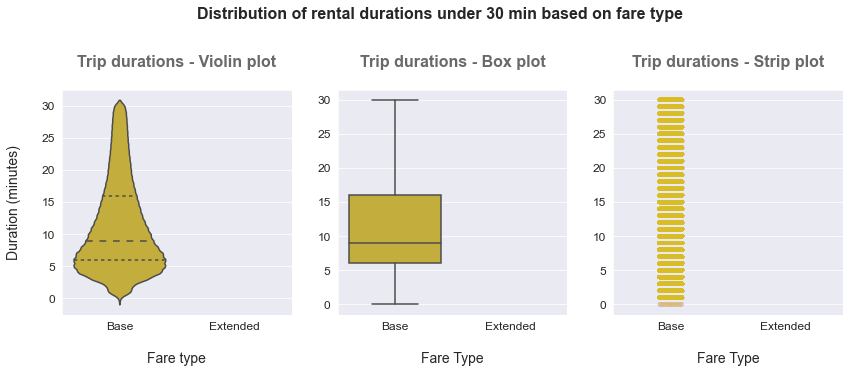

In [387]:
plt.figure(figsize = [14, 5])
sb.set_style('darkgrid')
flatui = ["gold"]
sb.set_palette(palette = flatui, n_colors = 10, desat = 0.7)
base_color = sb.color_palette()[0]

# left plot: violin plot
plt.subplot(1, 3, 1)
sb.violinplot(data = duration_lim_30, x = 'fare_type', y = 'duration_min', 
              inner = 'quartile', color = base_color)
plt.title('Trip durations - Violin plot\n',  weight = 'bold', fontsize = 16, color = 'dimgrey')
plt.xlabel('\nFare type', fontsize = 14)
plt.ylabel('Duration (minutes)\n', fontsize = 14)
plt.xticks(fontsize = 12)
plt.yticks(fontsize = 12)

# center plot: box plot
plt.subplot(1, 3, 2)
sb.boxplot(data = duration_lim_30, x = 'fare_type', y = 'duration_min', color = base_color)
plt.title('Trip durations - Box plot\n',  weight = 'bold', fontsize = 16, color = 'dimgrey')
plt.xlabel('\nFare Type', fontsize = 14)
plt.ylabel('', fontsize = 14)
plt.xticks(fontsize = 12)
plt.yticks(fontsize = 12)

# right plot: strip chart
plt.subplot(1, 3, 3)
sb.stripplot(data = duration_lim_30, x="fare_type", y="duration_min", alpha = 0.002, color = base_color)
plt.title('Trip durations - Strip plot\n',  weight = 'bold', fontsize = 16, color = 'dimgrey')
plt.xlabel('\nFare Type', fontsize = 14)
plt.ylabel('', fontsize = 14)
plt.xticks(fontsize = 12)
plt.yticks(fontsize = 12)

plt.subplots_adjust(wspace=0.2, hspace=0.3)
plt.subplots_adjust(top=0.75)
plt.suptitle('Distribution of rental durations under 30 min based on fare type\n', fontsize = 16, weight = 'bold');

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.22.l Distribution of fare type durations under 30 minutes on various plots.png', dpi=300, bbox_inches='tight')

Calculate the `average trip duration` and the `most frequent trip duration` subjected to each `fare type`.

In [388]:
base_mean = math.ceil(duration_lim_30.query(' fare_type == "Base" ').duration_min.mean())
base_mode = duration_lim_30.query(' fare_type == "Base" ').duration_min.mode()[0]

# extended statistics are not calculated as they do not exist under 30 minutes

print('Duration mean'.center(30,'-'))
print('base_mean     : ', base_mean, 'minutes')
print('\n')
print('Duration mode'.center(30,'-'))
print('base_mode     : ', base_mode, 'minutes')

--------Duration mean---------
base_mean     :  12 minutes


--------Duration mode---------
base_mode     :  6 minutes


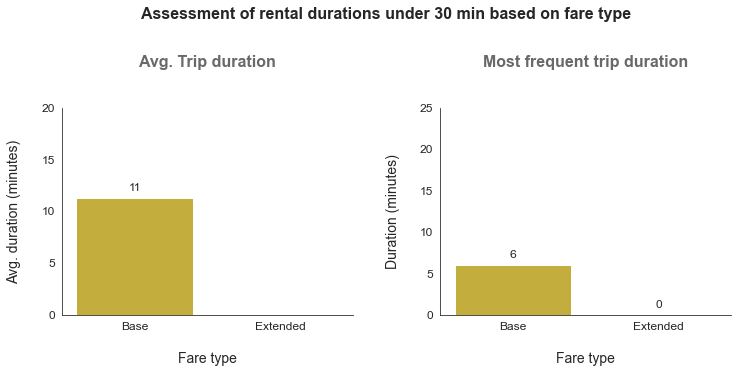

In [389]:
plt.figure(figsize = [12, 5])
flatui = ["gold"]
sb.set_palette(palette = flatui, n_colors = 10, desat = 0.7)
base_color = sb.color_palette()[0]

# left plot: point plot - Avg trip duration
sb.set_style('white')
plt.subplot(1, 2, 1)
ax1 = sb.barplot(data = duration_lim_30, x = "fare_type", y = "duration_min", color = base_color)
plt.title('Avg. Trip duration\n\n',  weight = 'bold', fontsize = 16, color = 'dimgrey')
plt.ylabel('Avg. duration (minutes)\n', fontsize = 14)
plt.xlabel('\nFare type', fontsize = 14)
plt.xticks(fontsize = 12)

locs, labels = plt.yticks()
y_ticks_new = np.arange(0, int(math.ceil(max(locs)))+10, 5)
plt.yticks(y_ticks_new, y_ticks_new, fontsize=12)
sb.despine(top=True, bottom=False, left=False, right=True);

# add annotations
# -------------------------------------------------------
for p in ax1.patches:
    ax1.annotate(format(p.get_height(), '.0f'), (p.get_x() + p.get_width() / 2., p.get_height()), 
                 ha = 'center', va = 'center', xytext = (0, 10), textcoords = 'offset points', fontsize = 12)
# -------------------------------------------------------

# right plot: Bar chart - most frequent trip duration
sb.set_style('white')
plt.subplot(1, 2, 2)
base_mode = duration_lim_30.query(' fare_type == "Base" ').duration_min.mode()[0]
heights = [base_mode, 0]
labels = ['Base', 'Extended']
g = sb.barplot(x = labels, y = heights, color = base_color)
plt.title('Most frequent trip duration\n\n',  weight = 'bold', fontsize = 16, color = 'dimgrey')
plt.xlabel('\nFare type', fontsize = 14)
plt.ylabel('Duration (minutes)\n', fontsize = 14)
plt.xticks(fontsize = 12)
plt.ylim(ax1.get_ylim())

locs, labels = plt.yticks()
y_ticks_new = np.arange(0, int(math.ceil(max(locs)))+10, 5)
plt.yticks(y_ticks_new, y_ticks_new, fontsize=12)
sb.despine();

# add annotations
# -------------------------------------------------------
for p in g.patches:
    g.annotate(format(p.get_height(), '.0f'), (p.get_x() + p.get_width() / 2., p.get_height()), 
               ha = 'center', va = 'center', xytext = (0, 10), textcoords = 'offset points', fontsize = 12)
# -------------------------------------------------------

plt.subplots_adjust(wspace=0.3, hspace=0.3)
plt.subplots_adjust(top=0.7)
plt.suptitle('Assessment of rental durations under 30 min based on fare type\n', fontsize = 16, weight = 'bold');

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.22.m Average trip durations under 30 minutes based on fare type.png', dpi=300, bbox_inches='tight')

`When the dataset is limited to trips under 30 minutes:`

> + If the `fare_type` is `Base`, then the bike rentals has an average rental duration of `11 minutes` and mode of `6 minutes`.
+ The `fare_type` of `Extended` does not exist under 30 minutes as they start after 30 minute duration.

`The trip durations being 1 minute or less is probably because of return of the bikes immediately after rental due to technical or other issue. Hence exclude the trips that are under 1 minute duration and re-evalute the statistics.`

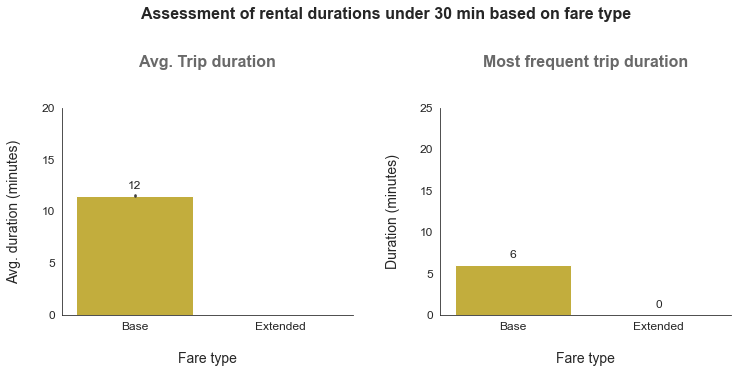

In [390]:
drop_index = duration_lim_30.query(' duration_min <= 1 ').index
temp_df = duration_lim_30.drop(drop_index)

plt.figure(figsize = [12, 5])
flatui = ["gold"]
sb.set_palette(palette = flatui, n_colors = 10, desat = 0.7)
base_color = sb.color_palette()[0]

# left plot: point plot - Avg trip duration
sb.set_style('white')
plt.subplot(1, 2, 1)
ax1 = sb.barplot(data = temp_df, x = "fare_type", y = "duration_min", color = base_color)
plt.title('Avg. Trip duration\n\n',  weight = 'bold', fontsize = 16, color = 'dimgrey')
plt.ylabel('Avg. duration (minutes)\n', fontsize = 14)
plt.xlabel('\nFare type', fontsize = 14)
plt.xticks(fontsize = 12)

locs, labels = plt.yticks()
y_ticks_new = np.arange(0, int(math.ceil(max(locs)))+10, 5)
plt.yticks(y_ticks_new, y_ticks_new, fontsize=12)
sb.despine(top=True, bottom=False, left=False, right=True);

# add annotations
# -------------------------------------------------------
for p in ax1.patches:
    ax1.annotate(format(p.get_height(), '.0f'), (p.get_x() + p.get_width() / 2., p.get_height()), 
                 ha = 'center', va = 'center', xytext = (0, 10), textcoords = 'offset points', fontsize = 12)
# -------------------------------------------------------

# right plot: Bar chart - most frequent trip duration
sb.set_style('white')
plt.subplot(1, 2, 2)
base_mode = temp_df.query(' fare_type == "Base" ').duration_min.mode()[0]
heights = [base_mode, 0]
labels = ['Base', 'Extended']
g = sb.barplot(x = labels, y = heights, color = base_color)
plt.title('Most frequent trip duration\n\n',  weight = 'bold', fontsize = 16, color = 'dimgrey')
plt.xlabel('\nFare type', fontsize = 14)
plt.ylabel('Duration (minutes)\n', fontsize = 14)
plt.xticks(fontsize = 12)
plt.ylim(ax1.get_ylim())

locs, labels = plt.yticks()
y_ticks_new = np.arange(0, int(math.ceil(max(locs)))+10, 5)
plt.yticks(y_ticks_new, y_ticks_new, fontsize=12)
sb.despine();

# add annotations
# -------------------------------------------------------
for p in g.patches:
    g.annotate(format(p.get_height(), '.0f'), (p.get_x() + p.get_width() / 2., p.get_height()), 
               ha = 'center', va = 'center', xytext = (0, 10), textcoords = 'offset points', fontsize = 12)
# -------------------------------------------------------

plt.subplots_adjust(wspace=0.3, hspace=0.3)
plt.subplots_adjust(top=0.7)
plt.suptitle('Assessment of rental durations under 30 min based on fare type\n', fontsize = 16, weight = 'bold');

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.22.n Average trip durations under 30 minutes based on fare type.png', dpi=300, bbox_inches='tight')

`When the dataset is limited to trips under 30 minutes (excluding 1 minute trips):`

> + If the `fare_type` is `Base`, then the bike rentals has an increase in average rental duration to `12 minutes` and mode of `6 minutes`.
+ The `fare_type` of `Extended` does not exist under 30 minutes as they start after 30 minute duration.

`Tabular data of the average trip durations based on the dataset limitation of duration entries:`

| Dataset used to measure - |	Avg trip duration (min) |
|:-------------------------:|:-------------------------:|

|                           |       Base     |     Extended   |
|:-------------------------:|:--------------:|:--------------:|
|  trips under 30 minutes	|       12       |        0       |
|  trips under 120 minutes	|       12       |       57       | 
|  overall trips		    |       12       |      119       |

`Tabular data of the most frequent trip durations based on the dataset limitation of duration entries:`

| Dataset used to measure - | Most freq trip duration (min) |
|:-------------------------:|:-----------------------------:|

|                           |       Base     |     Extended   |
|:-------------------------:|:--------------:|:--------------:|
|  trips under 30 minutes	|        6       |        0       |
|  trips under 120 minutes	|        6       |       31       | 
|  overall trips		    |        6       |       31       |

In [391]:
duration_df = pd.DataFrame()
duration_df['dataset'] = ['< 30', '< 30',
                          '< 120', '< 120',
                          'overall', 'overall']

duration_df['fare_type'] = ['Base', 'Extended', 
                            'Base', 'Extended',
                            'Base', 'Extended']

duration_df['duration_avg'] = [12,  np.nan,
                               12, 57,
                               12, 119]

duration_df['duration_mode'] = [6,  np.nan,
                                6, 31,
                                6, 31]
duration_df

,dataset,fare_type,duration_avg,duration_mode
0,< 30,Base,12.0,6.0
1,< 30,Extended,NaN,NaN
2,< 120,Base,12.0,6.0
3,< 120,Extended,57.0,31.0
4,overall,Base,12.0,6.0
5,overall,Extended,119.0,31.0


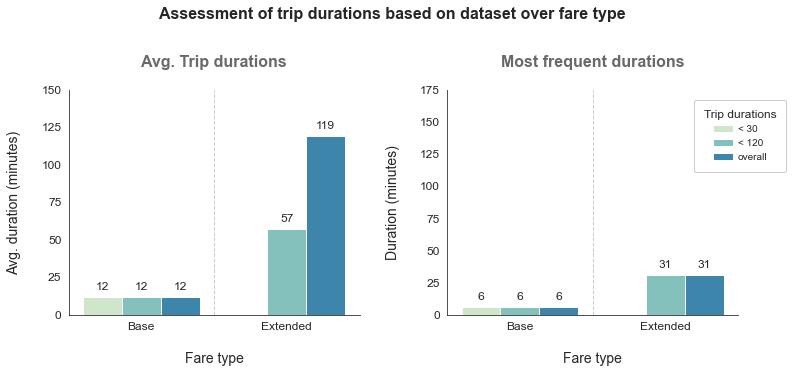

In [392]:
plt.figure(figsize = [12, 5])
sb.set_palette(palette = "GnBu", n_colors = 3, desat = None)
base_color = sb.color_palette()[2]

# left plot: point plot - Avg trip duration
# -------------------------------------------------------
sb.set_style('white')
plt.subplot(1, 2, 1)
ax1 = sb.barplot(data = duration_df, x = 'fare_type', y = 'duration_avg', hue = 'dataset')
plt.title('Avg. Trip durations\n',  weight = 'bold', fontsize = 16, color ='dimgrey')
plt.ylabel('Avg. duration (minutes)\n', fontsize = 14)
plt.xlabel('\nFare type', fontsize = 14)
plt.xticks(fontsize = 12)

locs, labels = plt.yticks()
y_ticks_new = np.arange(0, int(math.ceil(max(locs)))+25, 25)
plt.yticks(y_ticks_new, y_ticks_new, fontsize=12)

plt.legend('', frameon=False, fancybox=False)

# add annotations
for p in ax1.patches:
    ax1.annotate(format(p.get_height(), '.0f'), (p.get_x() + p.get_width() / 2., p.get_height()), 
                 ha = 'center', va = 'center', xytext = (0, 10), textcoords = 'offset points', fontsize = 12)

separators = [0.5]
for loc in separators:
    plt.axvline(loc, ls='--', color='grey', linewidth=1, alpha=0.4);

sb.despine(top=True, bottom=False, left=False, right=True);
# -------------------------------------------------------


# right plot: Bar chart - most frequent trip duration
# -------------------------------------------------------
sb.set_style('white')
plt.subplot(1, 2, 2)
g = sb.barplot(data = duration_df, x = 'fare_type', y = 'duration_mode', hue = 'dataset')
plt.title('Most frequent durations\n',  weight = 'bold', fontsize = 16, color ='dimgrey')
plt.ylabel('Duration (minutes)\n', fontsize = 14)
plt.xlabel('\nFare type', fontsize = 14)
plt.xticks(fontsize = 12)
plt.ylim(ax1.get_ylim())

locs, labels = plt.yticks()
y_ticks_new = np.arange(0, int(math.ceil(max(locs)))+25, 25)
plt.yticks(y_ticks_new, y_ticks_new, fontsize=12)

plt.legend(scatterpoints=1, frameon=True, fancybox=True, shadow=False, framealpha = 1, 
           borderpad=1, borderaxespad=1, loc = 'upper right', labelspacing=0.5, ncol = 1,  
           title='Trip durations', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(1.2, 1))

# add annotations
for p in g.patches:
    g.annotate(format(p.get_height(), '.0f'), (p.get_x() + p.get_width() / 2., p.get_height()), 
               ha = 'center', va = 'center', xytext = (0, 10), textcoords = 'offset points', fontsize = 12)

separators = [0.5]
for loc in separators:
    plt.axvline(loc, ls='--', color='grey', linewidth=1, alpha=0.4);

sb.despine(top=True, bottom=False, left=False, right=True);
# -------------------------------------------------------

plt.subplots_adjust(wspace=0.3, hspace=0.3)
plt.subplots_adjust(top=0.75)
plt.suptitle('Assessment of trip durations based on dataset over fare type\n', fontsize = 16, weight = 'bold');

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.22.o Assessment of trip durations based on dataset over fare type.png', dpi=300, bbox_inches='tight')

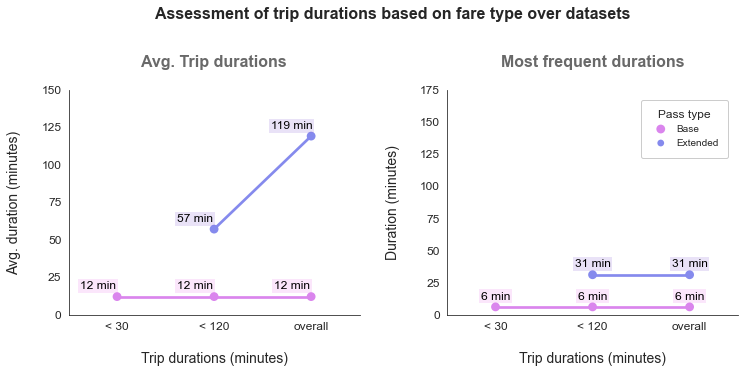

In [393]:
plt.figure(figsize = [12, 5])
flatui = ["#e278fa", "#787efa"]
sb.set_palette(flatui, n_colors=2, desat=0.8)

# left plot: point plot - Avg trip duration
# -------------------------------------------------------
# -------------------------------------------------------
sb.set_style('white')
plt.subplot(1, 2, 1)

ax1 = sb.pointplot(data = duration_df, x = 'dataset', y = 'duration_avg', hue = 'fare_type', alpha = 0.8)
plt.title('Avg. Trip durations\n',  weight = 'bold', fontsize = 16, color = 'dimgrey')
plt.ylabel('Avg. duration (minutes)\n', fontsize = 14)
plt.xlabel('\nTrip durations (minutes)', fontsize = 14)
plt.xticks(fontsize = 12)

locs, labels = plt.yticks()
y_ticks_new = np.arange(0, int(math.ceil(max(locs)))+25, 25)
plt.yticks(y_ticks_new, y_ticks_new, fontsize=12)

plt.legend('', frameon=False, fancybox=False)
sb.despine(top=True, bottom=False, left=False, right=True);

# add annotations
# -------------------------------------------------------
locs = [0, 0, 1, 1, 2, 2]
avg_rental_counts = duration_df["duration_avg"]
avg_rental_types = duration_df["fare_type"]
avg_rental_max = avg_rental_counts.max()
clrs = ['mediumpurple' if (trip == "Extended") else 'violet' for trip in avg_rental_types ]

# get the current tick locations and labels
# locs, labels = plt.xticks()

# loop through each pair of locations and labels
for loc, avg_rental_count, clr in zip(locs, avg_rental_counts, clrs):
    try:
        count = avg_rental_count
    except KeyError:
        count = 0
    # print the pct string if the count is not 'nan'
    if count == count:
        pct_string = '{:0.0f} min'.format(math.ceil(count))
        # print the annotation depending on the bar length
        plt.text(loc-0.2, count + int(avg_rental_max/20), pct_string, ha = 'center', color = 'black', fontsize = 12,
                 bbox={'pad':1.9,'alpha':0.2,'color':'none','fc':clr})
# -------------------------------------------------------
# -------------------------------------------------------


# right plot: point plot - most frequent trip duration
# -------------------------------------------------------
# -------------------------------------------------------
sb.set_style('white')
plt.subplot(1, 2, 2)

g = sb.pointplot(data = duration_df, x = 'dataset', y = 'duration_mode', hue = 'fare_type', alpha = 0.8)
plt.title('Most frequent durations\n',  weight = 'bold', fontsize = 16, color = 'dimgrey')
plt.ylabel('Duration (minutes)\n', fontsize = 14)
plt.xlabel('\nTrip durations (minutes)', fontsize = 14)
plt.xticks(fontsize = 12)
plt.ylim(ax1.get_ylim())

locs, labels = plt.yticks()
y_ticks_new = np.arange(0, int(math.ceil(max(locs)))+25, 25)
plt.yticks(y_ticks_new, y_ticks_new, fontsize=12)

plt.legend(scatterpoints=1, frameon=True, fancybox=True, shadow=False, framealpha = 1, 
           borderpad=1, borderaxespad=1, loc = 'upper right', labelspacing=0.5, ncol = 1,  
           title='Pass type', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5)

sb.despine(top=True, bottom=False, left=False, right=True);

# add annotations
# -------------------------------------------------------
locs = [0, 0, 1, 1, 2, 2]
freq_rental_counts = duration_df["duration_mode"]
freq_rental_types = duration_df["fare_type"]
freq_rental_max = freq_rental_counts.max()
clrs = ['mediumpurple' if (trip == "Extended") else 'violet' for trip in freq_rental_types ]

# loop through each pair of locations and labels
for loc, freq_rental_count, clr in zip(locs, freq_rental_counts, clrs):
    try:
        count = freq_rental_count
    except KeyError:
        count = 0
    # print the pct string if the count is not 'nan'
    if count == count:
        pct_string = '{:0.0f} min'.format(math.ceil(count))
        # print the annotation depending on the bar length
        plt.text(loc, count + int(freq_rental_max/5), pct_string, ha = 'center', color = 'black', fontsize = 12,
                 bbox={'pad':1.9,'alpha':0.2,'color':'none','fc':clr})
# -------------------------------------------------------
# -------------------------------------------------------

plt.subplots_adjust(wspace=0.3, hspace=0.3)
plt.subplots_adjust(top=0.75)
plt.suptitle('Assessment of trip durations based on fare type over datasets\n', fontsize = 16, weight = 'bold');

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.22.p Assessment of trip durations based on fare type over datasets.png', dpi=300, bbox_inches='tight')

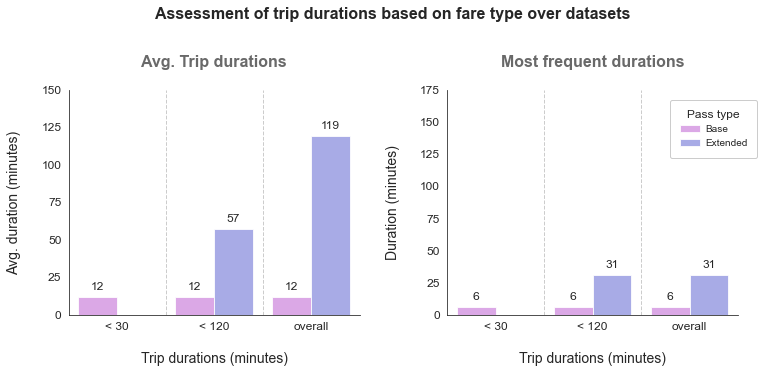

In [394]:
plt.figure(figsize = [12, 5])
flatui = ["#e278fa", "#787efa"]
sb.set_palette(flatui, n_colors=2, desat=0.8)

# left plot: point plot - Avg trip duration
# -------------------------------------------------------
# -------------------------------------------------------
sb.set_style('white')
plt.subplot(1, 2, 1)

ax1 = sb.barplot(data = duration_df, x = 'dataset', y = 'duration_avg', hue = 'fare_type', alpha = 0.8)
plt.title('Avg. Trip durations\n',  weight = 'bold', fontsize = 16, color = 'dimgrey')
plt.ylabel('Avg. duration (minutes)\n', fontsize = 14)
plt.xlabel('\nTrip durations (minutes)', fontsize = 14)
plt.xticks(fontsize = 12)

locs, labels = plt.yticks()
y_ticks_new = np.arange(0, int(math.ceil(max(locs)))+25, 25)
plt.yticks(y_ticks_new, y_ticks_new, fontsize=12)

plt.legend('', frameon=False, fancybox=False)
sb.despine(top=True, bottom=False, left=False, right=True);

# add annotations
# -------------------------------------------------------
for p in ax1.patches:
    ax1.annotate(format(p.get_height(), '.0f'), (p.get_x() + p.get_width() / 2., p.get_height()), 
                 ha = 'center', va = 'center', xytext = (0, 10), textcoords = 'offset points', fontsize = 12)

separators = [0.5, 1.5]
for loc in separators:
    plt.axvline(loc, ls='--', color='grey', linewidth=1, alpha=0.4)
# -------------------------------------------------------
# -------------------------------------------------------


# right plot: point plot - most frequent trip duration
# -------------------------------------------------------
# -------------------------------------------------------
sb.set_style('white')
plt.subplot(1, 2, 2)

g = sb.barplot(data = duration_df, x = 'dataset', y = 'duration_mode', hue = 'fare_type', alpha = 0.8)
plt.title('Most frequent durations\n',  weight = 'bold', fontsize = 16, color = 'dimgrey')
plt.ylabel('Duration (minutes)\n', fontsize = 14)
plt.xlabel('\nTrip durations (minutes)', fontsize = 14)
plt.xticks(fontsize = 12)
plt.ylim(ax1.get_ylim())

locs, labels = plt.yticks()
y_ticks_new = np.arange(0, int(math.ceil(max(locs)))+25, 25)
plt.yticks(y_ticks_new, y_ticks_new, fontsize=12)

plt.legend(scatterpoints=1, frameon=True, fancybox=True, shadow=False, framealpha = 1, 
           borderpad=1, borderaxespad=1, loc = 'upper right', labelspacing=0.5, ncol = 1,  
           title='Pass type', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(1.1, 1))

sb.despine(top=True, bottom=False, left=False, right=True);

# add annotations
# -------------------------------------------------------
for p in g.patches:
    g.annotate(format(p.get_height(), '.0f'), (p.get_x() + p.get_width() / 2., p.get_height()), 
               ha = 'center', va = 'center', xytext = (0, 10), textcoords = 'offset points', fontsize = 12)

separators = [0.5, 1.5]
for loc in separators:
    plt.axvline(loc, ls='--', color='grey', linewidth=1, alpha=0.4)
# -------------------------------------------------------
# -------------------------------------------------------

plt.subplots_adjust(wspace=0.3, hspace=0.3)
plt.subplots_adjust(top=0.75)
plt.suptitle('Assessment of trip durations based on fare type over datasets\n', fontsize = 16, weight = 'bold');

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.22.q Assessment of trip durations based on fare type over datasets.png', dpi=300, bbox_inches='tight')

-----

#### 3.2.23 Bivariate analysis of `distance_miles` and `trip_type` columns:

+ `Columns`: distance_miles, trip_type
+ `Data type`: (Numerical, continuous) and (Categorical, nominal)
+ `Plot`: Facet Grid, Violin plot, Box plot, Adapted Barchart

In [395]:
# Observe the distribution of distances through descriptive statistics
bikeshare.distance_miles.describe()

count    808589.000000
mean          0.709956
std           0.692094
min           0.000000
25%           0.310000
50%           0.580000
75%           0.970000
max          24.940000
Name: distance_miles, dtype: float64

> Use the above descriptive statistics to set the `bin size` for the upcoming plots

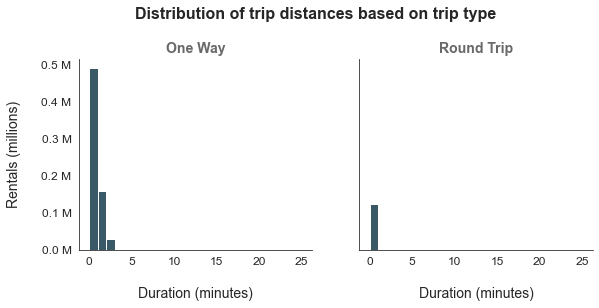

In [396]:
sb.set_style('white')
sb.set_palette(palette = "GnBu_d", n_colors = 5, desat = None)
base_color = sb.color_palette()[0]

g = sb.FacetGrid(data = bikeshare, col = 'trip_type', col_wrap = 2, height = 4, aspect = 1, )
g.map(plt.hist, "distance_miles", color = base_color, bins = np.arange(0, bikeshare.distance_miles.max()+1, 1))
g.fig.subplots_adjust(top=0.8)
g.fig.suptitle('Distribution of trip distances based on trip type\n', fontsize = 16, weight = 'bold')
g.set_titles('{col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# obtain y_ticks and convert them to a multiple of millions
# obtain the x_ticks and store them as a list
y_tick_names = []
x_tick_names = []
for ax in g.axes.flat:
    for y_label in ax.get_yticklabels():
        y_label_value = int(y_label.get_text())
        y_label_new_value = '{:0.1f} M'.format(y_label_value/1000000)
        y_tick_names.append(y_label_new_value)
        
    for x_label in ax.get_xticklabels():
        x_label_value = x_label.get_text()
        x_tick_names.append(x_label_value)

g.set_yticklabels(y_tick_names, size = 12)
g.set_xticklabels(x_tick_names, size = 12)
g.set_xlabels('\nDuration (minutes)', size = 14)
g.set_ylabels('Rentals (millions)\n', size = 14)

plt.subplots_adjust(wspace=0.2, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.23.a Facet Grid of trip distances on trip type.png', dpi=300, bbox_inches='tight')

The distribution of `distance_miles` values are right skewed and needs closer interpretation. This can be achieved by limiting the plot to a threshold value.

> Let us plot more variety of graphs to observe the distribution of data and hidden insights.

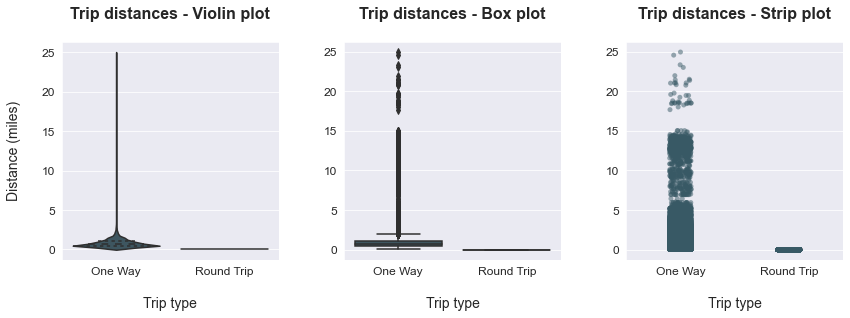

In [397]:
plt.figure(figsize = [14, 4])
sb.set_style('darkgrid')
sb.set_palette(palette = "GnBu_d", n_colors = 5, desat = None)
base_color = sb.color_palette()[0]

# left plot: violin plot
plt.subplot(1, 3, 1)
sb.violinplot(data = bikeshare, x = 'trip_type', y = 'distance_miles', inner = 'quartile',
              color = base_color)
plt.title('Trip distances - Violin plot\n',  weight = 'bold', fontsize = 16)
plt.xlabel('\nTrip type', fontsize = 14)
plt.ylabel('Distance (miles)\n', fontsize = 14)
plt.xticks(fontsize = 12)
plt.yticks(fontsize = 12)

# center plot: box plot
plt.subplot(1, 3, 2)
sb.boxplot(data = bikeshare, x = 'trip_type', y = 'distance_miles', color = base_color)
plt.title('Trip distances - Box plot\n',  weight = 'bold', fontsize = 16)
plt.xlabel('\nTrip type', fontsize = 14)
plt.ylabel('', fontsize = 14)
plt.xticks(fontsize = 12)
plt.yticks(fontsize = 12)

# right plot: strip chart
plt.subplot(1, 3, 3)
sb.stripplot(data = bikeshare, x = "trip_type", y = "distance_miles",  alpha = 0.5, color = base_color)
plt.title('Trip distances - Strip plot\n',  weight = 'bold', fontsize = 16)
plt.xlabel('\nTrip type', fontsize = 14)
plt.ylabel('', fontsize = 14);
plt.xticks(fontsize = 12)
plt.yticks(fontsize = 12)

plt.subplots_adjust(wspace=0.3, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust dhe figure to include all of the x and y labels
plt.savefig('plots/3.2.23.b Distribution of Trip type distances on various plots.png', dpi=300, bbox_inches='tight')

Calculate the `average trip distance` and the `most frequent trip distance` subjected to each `trip type`.

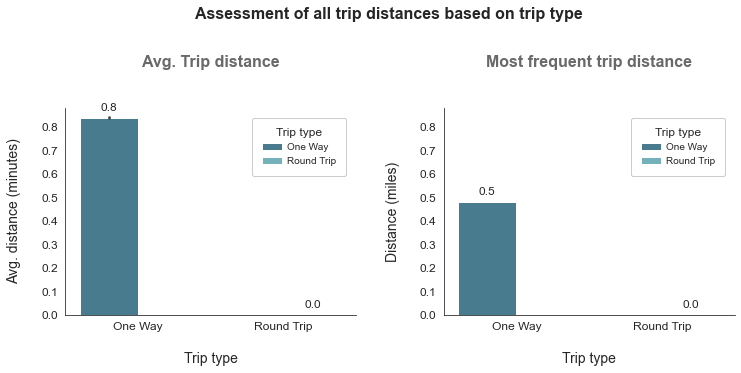

In [398]:
plt.figure(figsize = [12, 5])
sb.set_style('darkgrid')
sb.set_palette(palette = "GnBu_d", n_colors = 2, desat = None)
base_color = sb.color_palette()[0]

# left plot: bar chart - Avg trip duration
sb.set_style('white')
plt.subplot(1, 2, 1)
ax1 = sb.barplot(data = bikeshare, x = "trip_type", y = "distance_miles", hue = 'trip_type')
plt.title('Avg. Trip distance\n\n',  weight = 'bold', fontsize = 16, color = 'dimgrey')
plt.ylabel('Avg. distance (minutes)\n', fontsize = 14)
plt.xlabel('\nTrip type', fontsize = 14)
plt.xticks(fontsize = 12)
plt.yticks(fontsize=12)
sb.despine(top=True, bottom=False, left=False, right=True);

plt.legend(scatterpoints=1, frameon=True, fancybox=True, shadow=False, framealpha = 1, 
           borderpad=1, borderaxespad=1, loc = 'upper right', labelspacing=0.5, ncol = 1,  
           title='Trip type', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5)

# add annotations
# -------------------------------------------------------
for p in ax1.patches:
    ax1.annotate(format(p.get_height(), '.1f'), (p.get_x() + p.get_width() / 2., p.get_height()), 
                 ha = 'center', va = 'center', xytext = (0, 10), textcoords = 'offset points', fontsize = 12)
# -------------------------------------------------------

# right plot: bar chart - most frequent trip duration
sb.set_style('white')
plt.subplot(1, 2, 2)
oneway_mode = bikeshare.query(' trip_type == "One Way" ').distance_miles.mode()[0]
roundtrip_mode = bikeshare.query(' trip_type == "Round Trip" ').distance_miles.mode()[0]
heights = [oneway_mode, roundtrip_mode]
labels = bikeshare.trip_type.sort_values(ascending=True).unique()
g = sb.barplot(x = labels, y = heights, hue = labels)
plt.title('Most frequent trip distance\n\n',  weight = 'bold', fontsize = 16, color = 'dimgrey')
plt.xlabel('\nTrip type', fontsize = 14)
plt.ylabel('Distance (miles)\n', fontsize = 14)
plt.xticks(fontsize = 12)
plt.ylim(ax1.get_ylim())
plt.yticks(fontsize=12)
sb.despine(top=True, bottom=False, left=False, right=True);

plt.legend(scatterpoints=1, frameon=True, fancybox=True, shadow=False, framealpha = 1, 
           borderpad=1, borderaxespad=1, loc = 'upper right', labelspacing=0.5, ncol = 1,  
           title='Trip type', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5)

# add annotations
# -------------------------------------------------------
for p in g.patches:
    g.annotate(format(p.get_height(), '.1f'), (p.get_x() + p.get_width() / 2., p.get_height()), 
               ha = 'center', va = 'center', xytext = (0, 10), textcoords = 'offset points', fontsize = 12)
# -------------------------------------------------------

plt.subplots_adjust(wspace=0.3, hspace=0.3)
plt.subplots_adjust(top=0.7)
plt.suptitle('Assessment of all trip distances based on trip type\n', fontsize = 16, weight = 'bold');

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.23.c Assessment of all trip distances based on trip type.png', dpi=300, bbox_inches='tight')

**`Dataset limited by 3 miles:`**

In [399]:
# calculate the percentage of the dataset that falls under `3 miles` trip duration.
np.round((bikeshare.query(' distance_miles <= 3 ').shape[0]/bikeshare.shape[0])*100, 2)

99.5

The calculations are influenced by the presence of outliers. Calculate the `descriptive statistics` by limiting the data set to entries under `3 miles`, which constitute the `99%` of the distance distribution.

In [400]:
# Limit the dataset that has entries under 3 miles distance
distance_lim_3 = bikeshare.query(' distance_miles <= 3 ')

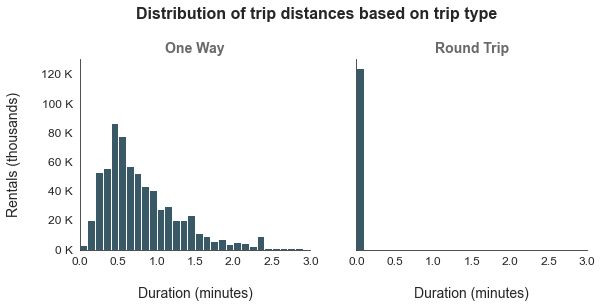

In [401]:
sb.set_style('white')
sb.set_palette(palette = "GnBu_d", n_colors = 5, desat = None)
base_color = sb.color_palette()[0]

g = sb.FacetGrid(data = distance_lim_3, col = 'trip_type', col_wrap = 2, height = 4, aspect = 1, xlim=(0,3))
g.map(plt.hist, "distance_miles", color = base_color, bins = np.arange(0, bikeshare.distance_miles.max()+0.1, 0.1))
g.fig.subplots_adjust(top=0.8)
g.fig.suptitle('Distribution of trip distances based on trip type\n', fontsize = 16, weight = 'bold')
g.set_titles('{col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# obtain y_ticks and convert them to a multiple of millions
# obtain the x_ticks and store them as a list
y_tick_names = []
x_tick_names = []
for ax in g.axes.flat:
    for y_label in ax.get_yticklabels():
        y_label_value = int(y_label.get_text())
        y_label_new_value = '{:0.0f} K'.format(y_label_value/1000)
        y_tick_names.append(y_label_new_value)
        
    for x_label in ax.get_xticklabels():
        x_label_value = x_label.get_text()
        x_tick_names.append(x_label_value)

g.set_yticklabels(y_tick_names, size = 12)
g.set_xticklabels(x_tick_names, size = 12)
g.set_xlabels('\nDuration (minutes)', size = 14)
g.set_ylabels('Rentals (thousands)\n', size = 14)

plt.subplots_adjust(wspace=0.2, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.23.d Facet Grid of trip distances under 3 miles on trip type.png', dpi=300, bbox_inches='tight')

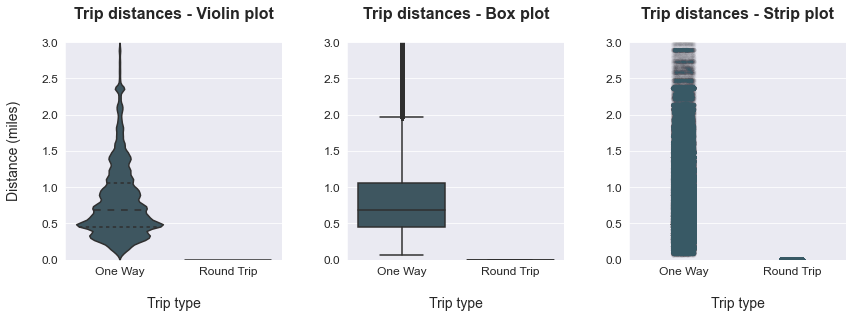

In [402]:
plt.figure(figsize = [14, 4])
sb.set_style('darkgrid')
sb.set_palette(palette = "GnBu_d", n_colors = 5, desat = None)
base_color = sb.color_palette()[0]

# left plot: violin plot
plt.subplot(1, 3, 1)
sb.violinplot(data = distance_lim_3, x = 'trip_type', y = 'distance_miles', inner = 'quartile',
              color = base_color)
plt.ylim(0, 3)
plt.title('Trip distances - Violin plot\n',  weight = 'bold', fontsize = 16)
plt.xlabel('\nTrip type', fontsize = 14)
plt.ylabel('Distance (miles)\n', fontsize = 14)
plt.xticks(fontsize = 12)
plt.yticks(fontsize = 12)

# center plot: box plot
plt.subplot(1, 3, 2)
sb.boxplot(data = distance_lim_3, x = 'trip_type', y = 'distance_miles', color = base_color)
plt.ylim(0, 3)
plt.title('Trip distances - Box plot\n',  weight = 'bold', fontsize = 16)
plt.xlabel('\nTrip type', fontsize = 14)
plt.ylabel('', fontsize = 14)
plt.xticks(fontsize = 12)
plt.yticks(fontsize = 12)

# right plot: strip chart
plt.subplot(1, 3, 3)
sb.stripplot(data = distance_lim_3, x = "trip_type", y = "distance_miles", alpha = 0.005, color = base_color)
plt.ylim(0, 3)
plt.title('Trip distances - Strip plot\n',  weight = 'bold', fontsize = 16)
plt.xlabel('\nTrip type', fontsize = 14)
plt.ylabel('', fontsize = 14);
plt.xticks(fontsize = 12)
plt.yticks(fontsize = 12)

plt.subplots_adjust(wspace=0.3, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust dhe figure to include all of the x and y labels
plt.savefig('plots/3.2.23.e Distribution of Trip type distances under 3 miles on various plots.png', dpi=300, bbox_inches='tight')

Calculate the `average trip distance` and the `most frequent trip distance` subjected to each `trip type`.

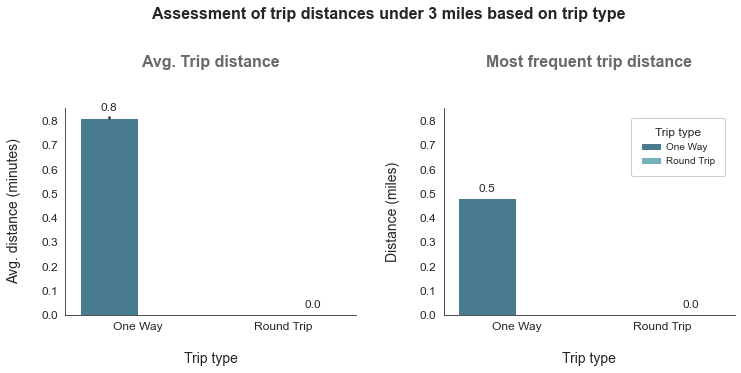

In [403]:
plt.figure(figsize = [12, 5])
sb.set_style('darkgrid')
sb.set_palette(palette = "GnBu_d", n_colors = 2, desat = None)
base_color = sb.color_palette()[0]

# left plot: bar chart - Avg trip duration
sb.set_style('white')
plt.subplot(1, 2, 1)
ax1 = sb.barplot(data = distance_lim_3, x = "trip_type", y = "distance_miles", hue = 'trip_type')
plt.title('Avg. Trip distance\n\n',  weight = 'bold', fontsize = 16, color = 'dimgrey')
plt.ylabel('Avg. distance (minutes)\n', fontsize = 14)
plt.xlabel('\nTrip type', fontsize = 14)
plt.xticks(fontsize = 12)
plt.yticks(fontsize=12)
sb.despine(top=True, bottom=False, left=False, right=True);

plt.legend('', frameon=False, fancybox=False)

# add annotations
# -------------------------------------------------------
for p in ax1.patches:
    ax1.annotate(format(p.get_height(), '.1f'), (p.get_x() + p.get_width() / 2., p.get_height()), 
                 ha = 'center', va = 'center', xytext = (0, 10), textcoords = 'offset points', fontsize = 12)
# -------------------------------------------------------

# right plot: bar chart - most frequent trip duration
sb.set_style('white')
plt.subplot(1, 2, 2)
oneway_mode = distance_lim_3.query(' trip_type == "One Way" ').distance_miles.mode()[0]
roundtrip_mode = distance_lim_3.query(' trip_type == "Round Trip" ').distance_miles.mode()[0]
heights = [oneway_mode, roundtrip_mode]
labels = distance_lim_3.trip_type.sort_values(ascending=True).unique()
g = sb.barplot(x = labels, y = heights, hue = labels)
plt.title('Most frequent trip distance\n\n',  weight = 'bold', fontsize = 16, color = 'dimgrey')
plt.xlabel('\nTrip type', fontsize = 14)
plt.ylabel('Distance (miles)\n', fontsize = 14)
plt.xticks(fontsize = 12)
plt.ylim(ax1.get_ylim())
plt.yticks(fontsize=12)
sb.despine(top=True, bottom=False, left=False, right=True);

plt.legend(scatterpoints=1, frameon=True, fancybox=True, shadow=False, framealpha = 1, 
           borderpad=1, borderaxespad=1, loc = 'upper right', labelspacing=0.5, ncol = 1,  
           title='Trip type', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5)

# add annotations
# -------------------------------------------------------
for p in g.patches:
    g.annotate(format(p.get_height(), '.1f'), (p.get_x() + p.get_width() / 2., p.get_height()), 
               ha = 'center', va = 'center', xytext = (0, 10), textcoords = 'offset points', fontsize = 12)
# -------------------------------------------------------

plt.subplots_adjust(wspace=0.3, hspace=0.3)
plt.subplots_adjust(top=0.7)
plt.suptitle('Assessment of trip distances under 3 miles based on trip type\n', fontsize = 16, weight = 'bold');

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.23.f Assessment of trip distances under 3 miles based on trip type.png', dpi=300, bbox_inches='tight')

---

#### 3.2.24 Bivariate analysis of `distance_miles` and `bike_type` columns:

+ `Columns`: distance_miles, bike_type
+ `Data type`: (Numerical, continuous) and (Categorical, nominal)
+ `Plot`: Facet Grid, Violin plot, Box plot, Adapted Barchart

In [404]:
# Observe the distribution of distances through descriptive statistics
bikeshare.distance_miles.describe()

count    808589.000000
mean          0.709956
std           0.692094
min           0.000000
25%           0.310000
50%           0.580000
75%           0.970000
max          24.940000
Name: distance_miles, dtype: float64

> Use the above descriptive statistics to set the `bin size` for the upcoming plots

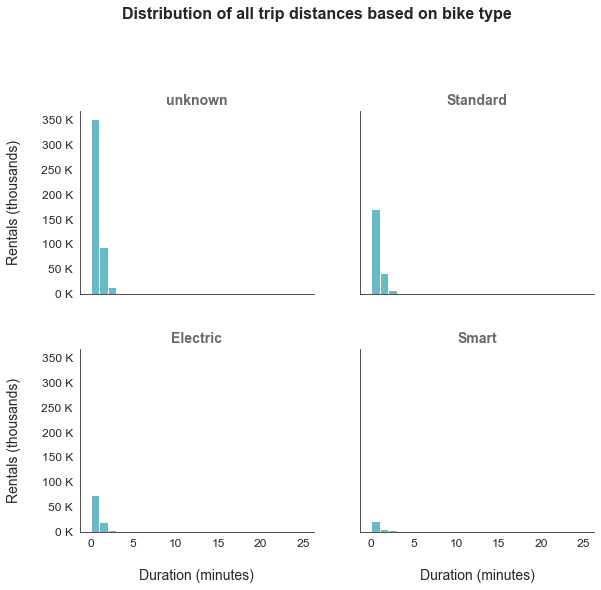

In [405]:
sb.set_style('white')
sb.set_palette(palette = "GnBu_d", n_colors = 5, desat = None)
base_color = sb.color_palette()[3]

g = sb.FacetGrid(data = bikeshare, col = 'bike_type', col_wrap = 2, height = 4, aspect = 1 )
g.map(plt.hist, "distance_miles", color = base_color, bins = np.arange(0, bikeshare.distance_miles.max()+1, 1))
g.fig.subplots_adjust(top=0.8)
g.fig.suptitle('Distribution of all trip distances based on bike type\n', fontsize = 16, weight = 'bold')
g.set_titles('{col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# obtain y_ticks and convert them to a multiple of millions
# obtain the x_ticks and store them as a list
y_tick_names = []
x_tick_names = []
for ax in g.axes.flat:
    for y_label in ax.get_yticklabels():
        y_label_value = int(y_label.get_text())
        y_label_new_value = '{:0.0f} K'.format(y_label_value/1000)
        y_tick_names.append(y_label_new_value)
        
    for x_label in ax.get_xticklabels():
        x_label_value = x_label.get_text()
        x_tick_names.append(x_label_value)

g.set_yticklabels(y_tick_names, size = 12)
g.set_xticklabels(x_tick_names, size = 12)
g.set_xlabels('\nDuration (minutes)', size = 14)
g.set_ylabels('Rentals (thousands)\n', size = 14)

plt.subplots_adjust(wspace=0.2, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.24.a Facet Grid of trip distances on bike type.png', dpi=300, bbox_inches='tight')

The distribution of `distance_miles` values are `right skewed` and needs closer interpretation. This can be achieved by limiting the plot to a threshold value.

> Let us plot more variety of graphs to observe the distribution of data and hidden insights.

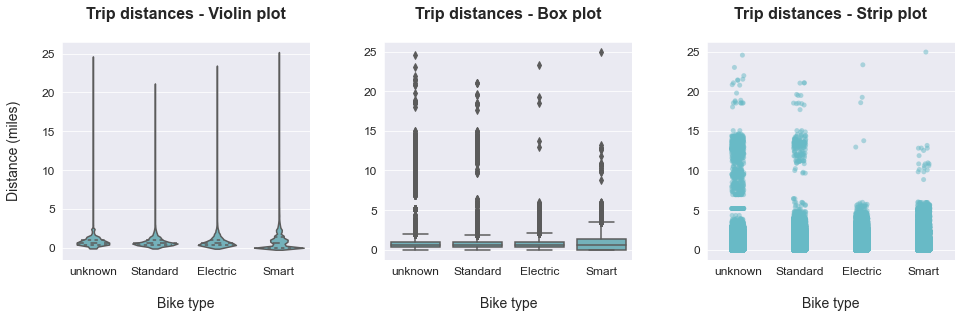

In [406]:
plt.figure(figsize = [16, 4])
sb.set_style('darkgrid')
sb.set_palette(palette = "GnBu_d", n_colors = 5, desat = None)
base_color = sb.color_palette()[3]

# left plot: violin plot
plt.subplot(1, 3, 1)
sb.violinplot(data = bikeshare, x = 'bike_type', y = 'distance_miles', inner = 'quartile',
              color = base_color)
plt.title('Trip distances - Violin plot\n',  weight = 'bold', fontsize = 16)
plt.xlabel('\nBike type', fontsize = 14)
plt.ylabel('Distance (miles)\n', fontsize = 14)
plt.xticks(fontsize = 12)
plt.yticks(fontsize = 12)

# center plot: box plot
plt.subplot(1, 3, 2)
sb.boxplot(data = bikeshare, x = 'bike_type', y = 'distance_miles', color = base_color)
plt.title('Trip distances - Box plot\n',  weight = 'bold', fontsize = 16)
plt.xlabel('\nBike type', fontsize = 14)
plt.ylabel('', fontsize = 14)
plt.xticks(fontsize = 12)
plt.yticks(fontsize = 12)

# right plot: strip chart
plt.subplot(1, 3, 3)
sb.stripplot(x="bike_type", y="distance_miles", data=bikeshare, alpha = 0.5, color = base_color)
plt.title('Trip distances - Strip plot\n',  weight = 'bold', fontsize = 16)
plt.xlabel('\nBike type', fontsize = 14)
plt.ylabel('', fontsize = 14);
plt.xticks(fontsize = 12)
plt.yticks(fontsize = 12)

plt.subplots_adjust(wspace=0.3, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust dhe figure to include all of the x and y labels
plt.savefig('plots/3.2.24.b Distribution of Bike type distances on various plots.png', dpi=300, bbox_inches='tight')

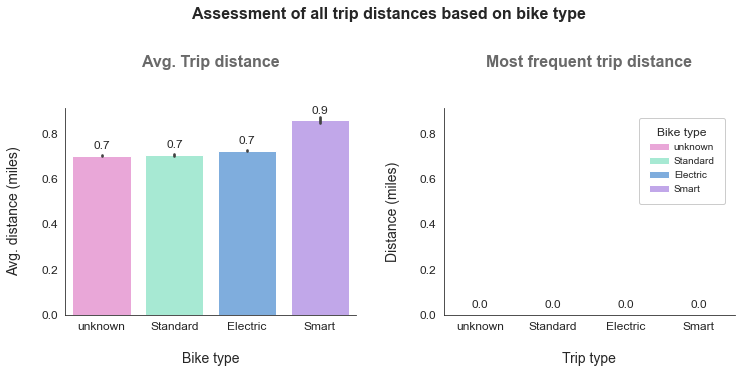

In [407]:
plt.figure(figsize = [12, 5])
flatui = ['#ff91e2', '#91ffda', '#60acfc', '#bd91ff']
sb.set_palette(flatui, n_colors=4, desat=0.8)

# left plot: bar chart - Avg trip duration
sb.set_style('white')
plt.subplot(1, 2, 1)
ax1 = sb.barplot(data = bikeshare, x = "bike_type", y = "distance_miles", hue = 'bike_type', dodge=False)
plt.title('Avg. Trip distance\n\n',  weight = 'bold', fontsize = 16, color = 'dimgrey')
plt.ylabel('Avg. distance (miles)\n', fontsize = 14)
plt.xlabel('\nBike type', fontsize = 14)
plt.xticks(fontsize = 12)
plt.yticks(fontsize=12)
sb.despine(top=True, bottom=False, left=False, right=True);

plt.legend('', frameon=False, fancybox=False)

# add annotations
# -------------------------------------------------------
for p in ax1.patches:
    ax1.annotate(format(p.get_height(), '.1f'), (p.get_x() + p.get_width() / 2., p.get_height()), 
                 ha = 'center', va = 'center', xytext = (0, 10), textcoords = 'offset points', fontsize = 12)
# -------------------------------------------------------

# right plot: Bar chart - most frequent trip duration
sb.set_style('white')
plt.subplot(1, 2, 2)
unknown_mode = bikeshare.query(' bike_type == "unknown" ').distance_miles.mode()[0]
standard_mode = bikeshare.query(' bike_type == "Standard" ').distance_miles.mode()[0]
electric_mode = bikeshare.query(' bike_type == "Electric" ').distance_miles.mode()[0]
smart_mode = bikeshare.query(' bike_type == "Smart" ').distance_miles.mode()[0]
heights = [unknown_mode, standard_mode, electric_mode, smart_mode]
labels = bikeshare.bike_type.sort_values(ascending=True).unique()
g = sb.barplot(x = labels, y = heights, hue = labels, dodge=False)
plt.title('Most frequent trip distance\n\n',  weight = 'bold', fontsize = 16, color = 'dimgrey')
plt.xlabel('\nTrip type', fontsize = 14)
plt.ylabel('Distance (miles)\n', fontsize = 14)
plt.xticks(fontsize = 12)
plt.ylim(ax1.get_ylim())
plt.yticks(fontsize=12)
sb.despine(top=True, bottom=False, left=False, right=True);

plt.legend(scatterpoints=1, frameon=True, fancybox=True, shadow=False, framealpha = 1, 
           borderpad=1, borderaxespad=1, loc = 'upper right', labelspacing=0.5, ncol = 1,  
           title='Bike type', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5)

# add annotations
# -------------------------------------------------------
for p in g.patches:
    g.annotate(format(p.get_height(), '.1f'), (p.get_x() + p.get_width() / 2., p.get_height()), 
               ha = 'center', va = 'center', xytext = (0, 10), textcoords = 'offset points', fontsize = 12)
# -------------------------------------------------------

plt.subplots_adjust(wspace=0.3, hspace=0.3)
plt.subplots_adjust(top=0.7)
plt.suptitle('Assessment of all trip distances based on bike type\n', fontsize = 16, weight = 'bold');

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.24.c Average trip distances based on trip type.png', dpi=300, bbox_inches='tight')

> The `Round Trip` entries have a distance/displacement equal to `Zero` and clustered together unlike `One Way` trips which are distributed between `1-25 miles`. Hence remove the entries with duration value `0` and re-evaluate the descriptive statistics, to calculate the correct mode values.

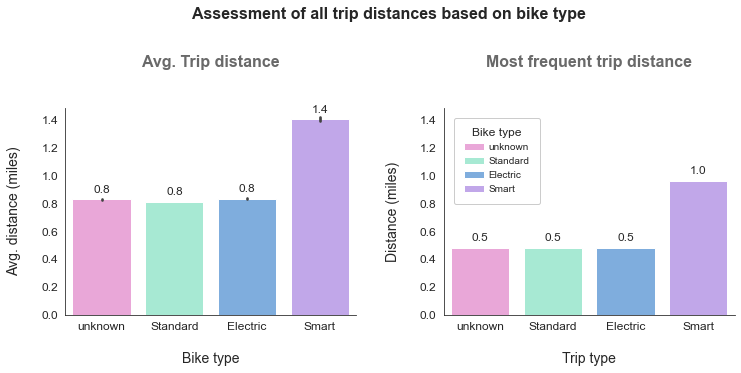

In [408]:
drop_index = bikeshare.query(' distance_miles == 0 ').index
temp_df = bikeshare.drop(drop_index)

plt.figure(figsize = [12, 5])
flatui = ['#ff91e2', '#91ffda', '#60acfc', '#bd91ff']
sb.set_palette(flatui, n_colors=4, desat=0.8)

# left plot: bar chart - Avg trip duration
sb.set_style('white')
plt.subplot(1, 2, 1)
ax1 = sb.barplot(data = temp_df, x = "bike_type", y = "distance_miles", hue = 'bike_type', dodge=False)
plt.title('Avg. Trip distance\n\n',  weight = 'bold', fontsize = 16, color = 'dimgrey')
plt.ylabel('Avg. distance (miles)\n', fontsize = 14)
plt.xlabel('\nBike type', fontsize = 14)
plt.xticks(fontsize = 12)
plt.yticks(fontsize=12)
sb.despine(top=True, bottom=False, left=False, right=True);

plt.legend('', frameon=False, fancybox=False)

# add annotations
# -------------------------------------------------------
for p in ax1.patches:
    ax1.annotate(format(p.get_height(), '.1f'), (p.get_x() + p.get_width() / 2., p.get_height()), 
                 ha = 'center', va = 'center', xytext = (0, 10), textcoords = 'offset points', fontsize = 12)
# -------------------------------------------------------

# right plot: Bar chart - most frequent trip duration
sb.set_style('white')
plt.subplot(1, 2, 2)
unknown_mode = temp_df.query(' bike_type == "unknown" ').distance_miles.mode()[0]
standard_mode = temp_df.query(' bike_type == "Standard" ').distance_miles.mode()[0]
electric_mode = temp_df.query(' bike_type == "Electric" ').distance_miles.mode()[0]
smart_mode = temp_df.query(' bike_type == "Smart" ').distance_miles.mode()[0]
heights = [unknown_mode, standard_mode, electric_mode, smart_mode]
labels = temp_df.bike_type.sort_values(ascending=True).unique()
g = sb.barplot(x = labels, y = heights, hue = labels, dodge=False)
plt.title('Most frequent trip distance\n\n',  weight = 'bold', fontsize = 16, color = 'dimgrey')
plt.xlabel('\nTrip type', fontsize = 14)
plt.ylabel('Distance (miles)\n', fontsize = 14)
plt.xticks(fontsize = 12)
plt.ylim(ax1.get_ylim())
plt.yticks(fontsize=12)
sb.despine(top=True, bottom=False, left=False, right=True);

plt.legend(scatterpoints=1, frameon=True, fancybox=True, shadow=False, framealpha = 1, 
           borderpad=1, borderaxespad=1, loc = 'upper left', labelspacing=0.5, ncol = 1,  
           title='Bike type', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5)

# add annotations
# -------------------------------------------------------
for p in g.patches:
    g.annotate(format(p.get_height(), '.1f'), (p.get_x() + p.get_width() / 2., p.get_height()), 
               ha = 'center', va = 'center', xytext = (0, 10), textcoords = 'offset points', fontsize = 12)
# -------------------------------------------------------

plt.subplots_adjust(wspace=0.3, hspace=0.3)
plt.subplots_adjust(top=0.7)
plt.suptitle('Assessment of all trip distances based on bike type\n', fontsize = 16, weight = 'bold');

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.24.d Assessment of all trip distances based on bike type.png', dpi=300, bbox_inches='tight')

**`Dataset limited by 3 miles:`**

In [409]:
# calculate the percentage of the dataset that falls under `3 miles` trip distance.
np.round((bikeshare.query(' distance_miles <= 3 ').shape[0]/bikeshare.shape[0])*100, 2)

99.5

The calculations are influenced by the presence of outliers. Calculate the `descriptive statistics` by limiting the data set to entries under `3 miles`, which constitute the `99%` of the distance distribution. Also remove the entries with distance valued `Zero` as they are clustered by `Round Trip` data and influence the actual statistics.

In [410]:
# calculate the percentage of the dataset that falls under `3 miles` trip distance and above '0 miles'.
np.round((bikeshare.query(' distance_miles <= 3  and distance_miles > 0 ').shape[0]/bikeshare.shape[0])*100, 2)

84.13

In [411]:
# Limit the dataset that has entries under 3 miles distance and above '0' miles
distance_lim_3 = bikeshare.query(' distance_miles <= 3  and distance_miles > 0 ')

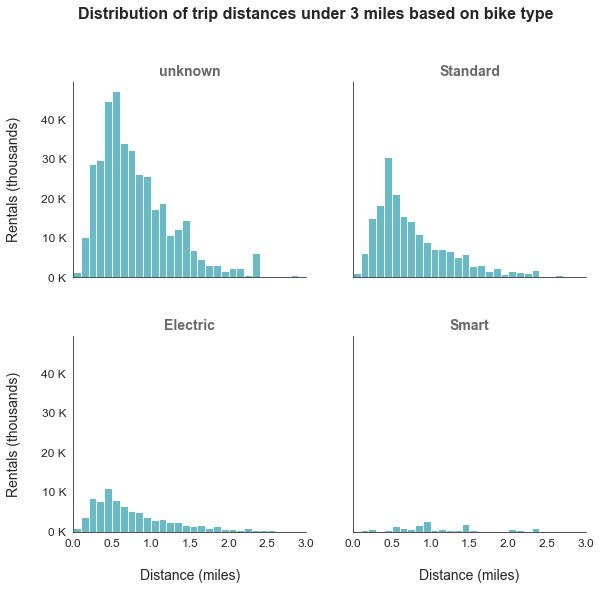

In [412]:
sb.set_style('white')
sb.set_palette(palette = "GnBu_d", n_colors = 5, desat = None)
base_color = sb.color_palette()[3]

g = sb.FacetGrid(data = distance_lim_3, col = 'bike_type', col_wrap = 2, height = 4, aspect = 1, xlim=(0,3))
g.map(plt.hist, "distance_miles", color = base_color, bins = np.arange(0, bikeshare.distance_miles.max()+0.1, 0.1))
g.fig.subplots_adjust(top=0.85)
g.fig.suptitle('Distribution of trip distances under 3 miles based on bike type\n', fontsize = 16, weight = 'bold')
g.set_titles('{col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# obtain y_ticks and convert them to a multiple of millions
# obtain the x_ticks and store them as a list
y_tick_names = []
x_tick_names = []
for ax in g.axes.flat:
    for y_label in ax.get_yticklabels():
        y_label_value = int(y_label.get_text())
        y_label_new_value = '{:0.0f} K'.format(y_label_value/1000)
        y_tick_names.append(y_label_new_value)
        
    for x_label in ax.get_xticklabels():
        x_label_value = x_label.get_text()
        x_tick_names.append(x_label_value)

g.set_yticklabels(y_tick_names, size = 12)
g.set_xticklabels(x_tick_names, size = 12)
g.set_xlabels('\nDistance (miles)', size = 14)
g.set_ylabels('Rentals (thousands)\n', size = 14)

plt.subplots_adjust(wspace=0.2, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.24.e Facet Grid of trip distances under 3 miles on bike type.png', dpi=300, bbox_inches='tight')

> Let us plot more variety of graphs to observe the distribution of data and hidden insights.

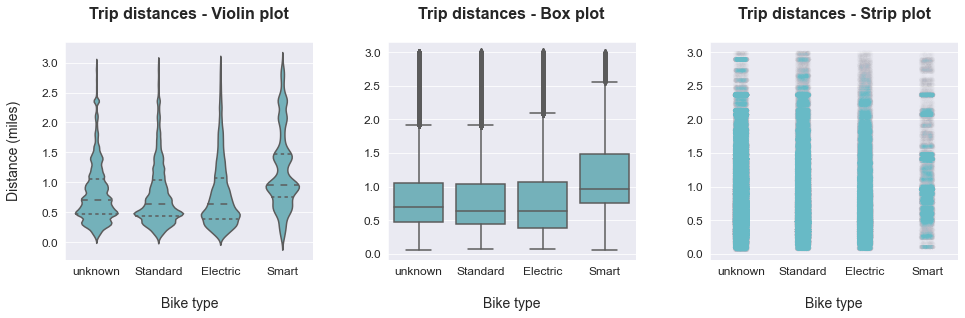

In [413]:
plt.figure(figsize = [16, 4])
sb.set_style('darkgrid')
sb.set_palette(palette = "GnBu_d", n_colors = 5, desat = None)
base_color = sb.color_palette()[3]

# left plot: violin plot
plt.subplot(1, 3, 1)
sb.violinplot(data = distance_lim_3, x = 'bike_type', y = 'distance_miles', inner = 'quartile', color = base_color)
plt.title('Trip distances - Violin plot\n',  weight = 'bold', fontsize = 16)
plt.xlabel('\nBike type', fontsize = 14)
plt.ylabel('Distance (miles)\n', fontsize = 14)
plt.xticks(fontsize = 12)
plt.yticks(fontsize = 12)

# center plot: box plot
plt.subplot(1, 3, 2)
sb.boxplot(data = distance_lim_3, x = 'bike_type', y = 'distance_miles', color = base_color)
plt.title('Trip distances - Box plot\n',  weight = 'bold', fontsize = 16)
plt.xlabel('\nBike type', fontsize = 14)
plt.ylabel('', fontsize = 14)
plt.xticks(fontsize = 12)
plt.yticks(fontsize = 12)

# right plot: strip chart
plt.subplot(1, 3, 3)
sb.stripplot(data = distance_lim_3, x = "bike_type", y = "distance_miles", alpha = 0.005, color = base_color)
plt.title('Trip distances - Strip plot\n',  weight = 'bold', fontsize = 16)
plt.xlabel('\nBike type', fontsize = 14)
plt.ylabel('', fontsize = 14);
plt.xticks(fontsize = 12)
plt.yticks(fontsize = 12)

plt.subplots_adjust(wspace=0.3, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust dhe figure to include all of the x and y labels
plt.savefig('plots/3.2.24.f Distribution of Bike type distances under 3 miles on various plots.png', dpi=300, bbox_inches='tight')

Calculate the `average trip distance` and the `most frequent trip distance` subjected to each `bike type`.

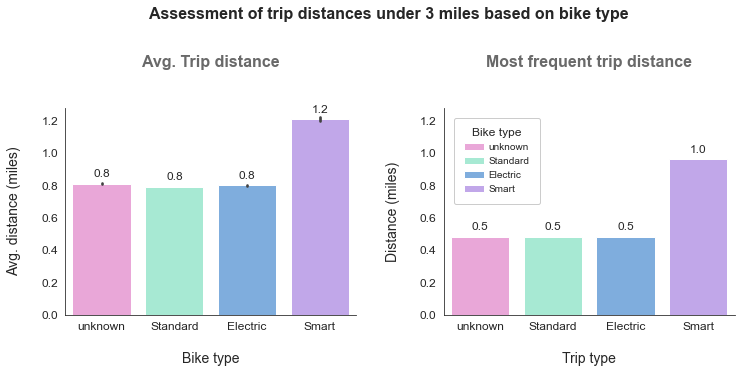

In [414]:
plt.figure(figsize = [12, 5])
flatui = ['#ff91e2', '#91ffda', '#60acfc', '#bd91ff']
sb.set_palette(flatui, n_colors=4, desat=0.8)

# left plot: bar chart - Avg trip duration
sb.set_style('white')
plt.subplot(1, 2, 1)
ax1 = sb.barplot(data = distance_lim_3, x = "bike_type", y = "distance_miles", hue = 'bike_type', dodge=False)
plt.title('Avg. Trip distance\n\n',  weight = 'bold', fontsize = 16, color = 'dimgrey')
plt.ylabel('Avg. distance (miles)\n', fontsize = 14)
plt.xlabel('\nBike type', fontsize = 14)
plt.xticks(fontsize = 12)
plt.yticks(fontsize=12)
sb.despine(top=True, bottom=False, left=False, right=True);

plt.legend('', frameon=False, fancybox=False)

# add annotations
# -------------------------------------------------------
for p in ax1.patches:
    ax1.annotate(format(p.get_height(), '.1f'), (p.get_x() + p.get_width() / 2., p.get_height()), 
                 ha = 'center', va = 'center', xytext = (0, 10), textcoords = 'offset points', fontsize = 12)
# -------------------------------------------------------

# right plot: Bar chart - most frequent trip duration
sb.set_style('white')
plt.subplot(1, 2, 2)
unknown_mode = distance_lim_3.query(' bike_type == "unknown" ').distance_miles.mode()[0]
standard_mode = distance_lim_3.query(' bike_type == "Standard" ').distance_miles.mode()[0]
electric_mode = distance_lim_3.query(' bike_type == "Electric" ').distance_miles.mode()[0]
smart_mode = distance_lim_3.query(' bike_type == "Smart" ').distance_miles.mode()[0]
heights = [unknown_mode, standard_mode, electric_mode, smart_mode]
labels = distance_lim_3.bike_type.sort_values(ascending=True).unique()
g = sb.barplot(x = labels, y = heights, hue = labels, dodge=False)
plt.title('Most frequent trip distance\n\n',  weight = 'bold', fontsize = 16, color = 'dimgrey')
plt.xlabel('\nTrip type', fontsize = 14)
plt.ylabel('Distance (miles)\n', fontsize = 14)
plt.xticks(fontsize = 12)
plt.ylim(ax1.get_ylim())
plt.yticks(fontsize=12)
sb.despine(top=True, bottom=False, left=False, right=True);

plt.legend(scatterpoints=1, frameon=True, fancybox=True, shadow=False, framealpha = 1, 
           borderpad=1, borderaxespad=1, loc = 'upper left', labelspacing=0.5, ncol = 1,  
           title='Bike type', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5)

# add annotations
# -------------------------------------------------------
for p in g.patches:
    g.annotate(format(p.get_height(), '.1f'), (p.get_x() + p.get_width() / 2., p.get_height()), 
               ha = 'center', va = 'center', xytext = (0, 10), textcoords = 'offset points', fontsize = 12)
# -------------------------------------------------------

plt.subplots_adjust(wspace=0.3, hspace=0.3)
plt.subplots_adjust(top=0.7)
plt.suptitle('Assessment of trip distances under 3 miles based on bike type\n', fontsize = 16, weight = 'bold');

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.24.g Assessment of trip distances under 3 miles based on bike type.png', dpi=300, bbox_inches='tight')

---------

#### 3.2.25 Bivariate analysis of `distance_miles` and `pass_type` columns:

+ `Columns`: distance_miles, pass_type
+ `Data type`: (Numerical, continuous) and (Categorical, nominal)
+ `Plot`: Facet Grid, Violin plot, Box plot, Adapted Barchart

In [415]:
# Observe the distribution of distances through descriptive statistics
bikeshare.distance_miles.describe()

count    808589.000000
mean          0.709956
std           0.692094
min           0.000000
25%           0.310000
50%           0.580000
75%           0.970000
max          24.940000
Name: distance_miles, dtype: float64

> Use the above descriptive statistics to set the `bin size` for the upcoming plots

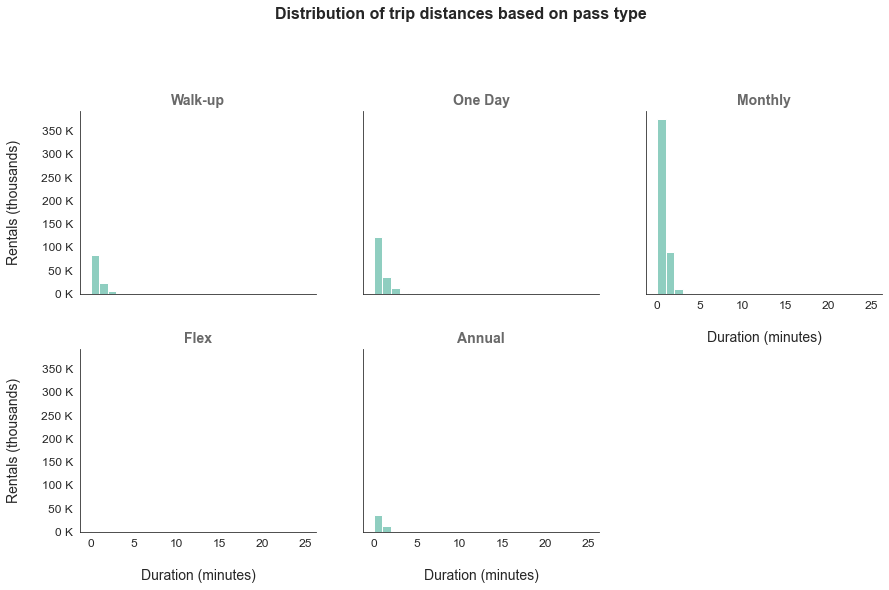

In [416]:
sb.set_style('white')
sb.set_palette(palette = "GnBu_d", n_colors = 5, desat = None)
base_color = sb.color_palette()[4]

g = sb.FacetGrid(data = bikeshare, col = 'pass_type', col_wrap = 3, height = 4, aspect = 1 )
g.map(plt.hist, "distance_miles", color = base_color, bins = np.arange(0, bikeshare.distance_miles.max()+1, 1))
g.fig.subplots_adjust(top=0.8)
g.fig.suptitle('Distribution of trip distances based on pass type\n', fontsize = 16, weight = 'bold')
g.set_titles('{col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# obtain y_ticks and convert them to a multiple of millions
# obtain the x_ticks and store them as a list
y_tick_names = []
x_tick_names = []
for ax in g.axes.flat:
    for y_label in ax.get_yticklabels():
        y_label_value = int(y_label.get_text())
        y_label_new_value = '{:0.0f} K'.format(y_label_value/1000)
        y_tick_names.append(y_label_new_value)
        
    for x_label in ax.get_xticklabels():
        x_label_value = x_label.get_text()
        x_tick_names.append(x_label_value)

g.set_yticklabels(y_tick_names, size = 12)
g.set_xticklabels(x_tick_names, size = 12)
g.set_xlabels('\nDuration (minutes)', size = 14)
g.set_ylabels('Rentals (thousands)\n', size = 14)

plt.subplots_adjust(wspace=0.2, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.25.a Facet Grid of trip distances on pass type.png', dpi=300, bbox_inches='tight')

The distribution of `distance_miles` values are `right skewed` and needs closer interpretation. This can be achieved by limiting the plot to a threshold value.

> Let us plot more variety of graphs to observe the distribution of data and hidden insights.

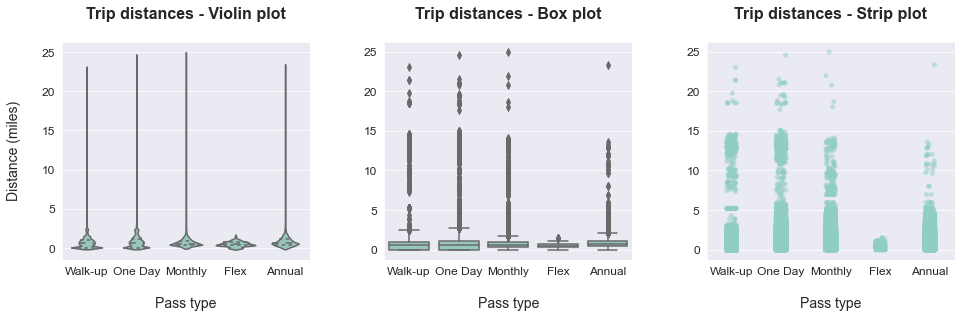

In [417]:
plt.figure(figsize = [16, 4])
sb.set_style('darkgrid')
sb.set_palette(palette = "GnBu_d", n_colors = 5, desat = None)
base_color = sb.color_palette()[4]

# left plot: violin plot
plt.subplot(1, 3, 1)
sb.violinplot(data = bikeshare, x = 'pass_type', y = 'distance_miles', inner = 'quartile',
              color = base_color)
plt.title('Trip distances - Violin plot\n',  weight = 'bold', fontsize = 16)
plt.xlabel('\nPass type', fontsize = 14)
plt.ylabel('Distance (miles)\n', fontsize = 14)
plt.xticks(fontsize = 12)
plt.yticks(fontsize = 12)

# center plot: box plot
plt.subplot(1, 3, 2)
sb.boxplot(data = bikeshare, x = 'pass_type', y = 'distance_miles', color = base_color)
plt.title('Trip distances - Box plot\n',  weight = 'bold', fontsize = 16)
plt.xlabel('\nPass type', fontsize = 14)
plt.ylabel('', fontsize = 14)
plt.xticks(fontsize = 12)
plt.yticks(fontsize = 12)

# right plot: strip chart
plt.subplot(1, 3, 3)
sb.stripplot(data = bikeshare, x = "pass_type", y = "distance_miles", alpha = 0.5, color = base_color)
plt.title('Trip distances - Strip plot\n',  weight = 'bold', fontsize = 16)
plt.xlabel('\nPass type', fontsize = 14)
plt.ylabel('', fontsize = 14);
plt.xticks(fontsize = 12)
plt.yticks(fontsize = 12)

plt.subplots_adjust(wspace=0.3, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust dhe figure to include all of the x and y labels
plt.savefig('plots/3.2.25.b Distribution of Pass type durations on various plots.png', dpi=300, bbox_inches='tight')

Calculate the `average trip distance` and the `most frequent trip distance` subjected to each `pass type`.

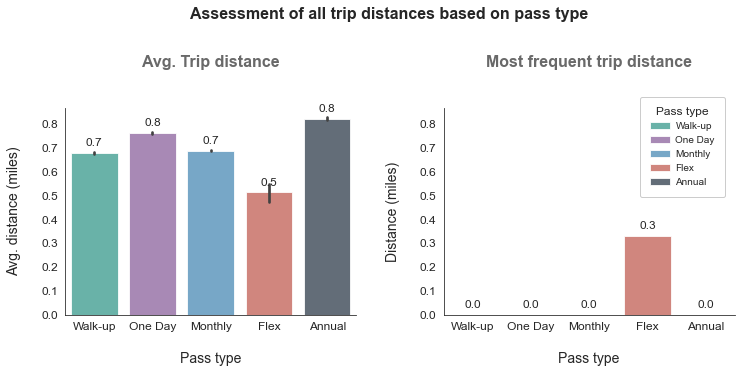

In [418]:
plt.figure(figsize = [12, 5])
flatui = ["#26bda7", "#9b59b6", "#3498db", "#e74c3c", "#34495e"]
sb.set_palette(flatui, n_colors=5, desat=0.8)

# left plot: point plot - Avg trip duration
sb.set_style('white')
plt.subplot(1, 2, 1)
ax1 = sb.barplot(data = bikeshare, x = "pass_type", y = "distance_miles", hue = 'pass_type', alpha = 0.8, dodge=False)
plt.title('Avg. Trip distance\n\n',  weight = 'bold', fontsize = 16, color = 'dimgrey')
plt.ylabel('Avg. distance (miles)\n', fontsize = 14)
plt.xlabel('\nPass type', fontsize = 14)
plt.xticks(fontsize = 12)
plt.yticks(fontsize=12)
sb.despine(top=True, bottom=False, left=False, right=True);

plt.legend('', frameon=False, fancybox=False)

# add annotations
# -------------------------------------------------------
for p in ax1.patches:
    ax1.annotate(format(p.get_height(), '.1f'), (p.get_x() + p.get_width() / 2., p.get_height()), 
                 ha = 'center', va = 'center', xytext = (0, 10), textcoords = 'offset points', fontsize = 12)
# -------------------------------------------------------

# right plot: Bar chart - most frequent trip duration
sb.set_style('white')
plt.subplot(1, 2, 2)
walkup_mode = bikeshare.query(' pass_type == "Walk-up" ').distance_miles.mode()[0]
oneday_mode = bikeshare.query(' pass_type == "One Day" ').distance_miles.mode()[0]
monthly_mode = bikeshare.query(' pass_type == "Monthly" ').distance_miles.mode()[0]
flex_mode = bikeshare.query(' pass_type == "Flex" ').distance_miles.mode()[0]
annual_mode = bikeshare.query(' pass_type == "Annual" ').distance_miles.mode()[0]
heights = [walkup_mode, oneday_mode, monthly_mode, flex_mode, annual_mode]
labels = bikeshare.pass_type.sort_values(ascending=True).unique()
g = sb.barplot(x = labels, y = heights, hue = labels, alpha = 0.8, dodge=False)
plt.title('Most frequent trip distance\n\n',  weight = 'bold', fontsize = 16, color = 'dimgrey')
plt.xlabel('\nPass type', fontsize = 14)
plt.ylabel('Distance (miles)\n', fontsize = 14)
plt.xticks(fontsize = 12)
plt.ylim(ax1.get_ylim())
plt.yticks(fontsize=12)
sb.despine(top=True, bottom=False, left=False, right=True);

plt.legend(scatterpoints=1, frameon=True, fancybox=True, shadow=False, framealpha = 1, 
           borderpad=1, borderaxespad=1, loc = 'upper right', labelspacing=0.5, ncol = 1,  
           title='Pass type', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(1, 1.1))

# add annotations
# -------------------------------------------------------
for p in g.patches:
    g.annotate(format(p.get_height(), '.1f'), (p.get_x() + p.get_width() / 2., p.get_height()), 
               ha = 'center', va = 'center', xytext = (0, 10), textcoords = 'offset points', fontsize = 12)
# -------------------------------------------------------

plt.subplots_adjust(wspace=0.3, hspace=0.3)
plt.subplots_adjust(top=0.7)
plt.suptitle('Assessment of all trip distances based on pass type\n', fontsize = 16, weight = 'bold');

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.25.c Average trip distances based on pass type.png', dpi=300, bbox_inches='tight')

> The `Round Trip` entries have a distance/displacement equal to `Zero` and clustered together unlike `One Way` trips which are distributed between `1-25 miles`. Hence remove the entries with duration value `0` and re-evaluate the descriptive statistics, to calculate the correct mode values.

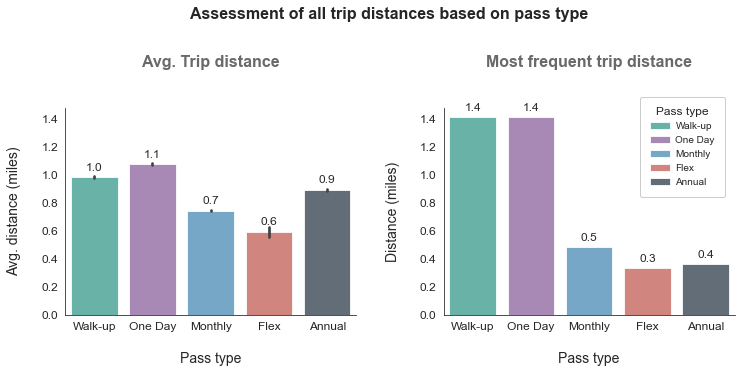

In [419]:
drop_index = bikeshare.query(' distance_miles == 0 ').index
temp_df = bikeshare.drop(drop_index)

plt.figure(figsize = [12, 5])
flatui = ["#26bda7", "#9b59b6", "#3498db", "#e74c3c", "#34495e"]
sb.set_palette(flatui, n_colors=5, desat=0.8)

# left plot: point plot - Avg trip duration
sb.set_style('white')
plt.subplot(1, 2, 1)
ax1 = sb.barplot(data = temp_df, x = "pass_type", y = "distance_miles", hue = 'pass_type', 
                 alpha = 0.8, dodge=False)
plt.title('Avg. Trip distance\n\n',  weight = 'bold', fontsize = 16, color = 'dimgrey')
plt.ylabel('Avg. distance (miles)\n', fontsize = 14)
plt.xlabel('\nPass type', fontsize = 14)
plt.xticks(fontsize = 12)
plt.yticks(fontsize=12)
sb.despine(top=True, bottom=False, left=False, right=True);

plt.legend('', frameon=False, fancybox=False)

# add annotations
# -------------------------------------------------------
for p in ax1.patches:
    ax1.annotate(format(p.get_height(), '.1f'), (p.get_x() + p.get_width() / 2., p.get_height()), 
                 ha = 'center', va = 'center', xytext = (0, 10), textcoords = 'offset points', fontsize = 12)
# -------------------------------------------------------

# right plot: Bar chart - most frequent trip duration
sb.set_style('white')
plt.subplot(1, 2, 2)
walkup_mode = temp_df.query(' pass_type == "Walk-up" ').distance_miles.mode()[0]
oneday_mode = temp_df.query(' pass_type == "One Day" ').distance_miles.mode()[0]
monthly_mode = temp_df.query(' pass_type == "Monthly" ').distance_miles.mode()[0]
flex_mode = temp_df.query(' pass_type == "Flex" ').distance_miles.mode()[0]
annual_mode = temp_df.query(' pass_type == "Annual" ').distance_miles.mode()[0]
heights = [walkup_mode, oneday_mode, monthly_mode, flex_mode, annual_mode]
labels = temp_df.pass_type.sort_values(ascending=True).unique()
ax2 = sb.barplot(x = labels, y = heights, hue = labels, alpha = 0.8, dodge=False)
plt.title('Most frequent trip distance\n\n',  weight = 'bold', fontsize = 16, color = 'dimgrey')
plt.xlabel('\nPass type', fontsize = 14)
plt.ylabel('Distance (miles)\n', fontsize = 14)
plt.xticks(fontsize = 12)
# plt.ylim(ax1.get_ylim())
plt.yticks(fontsize=12)
sb.despine(top=True, bottom=False, left=False, right=True);

plt.legend(scatterpoints=1, frameon=True, fancybox=True, shadow=False, framealpha = 1, 
           borderpad=1, borderaxespad=1, loc = 'upper right', labelspacing=0.5, ncol = 1,  
           title='Pass type', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(1, 1.1))

# add annotations
# -------------------------------------------------------
for p in ax2.patches:
    ax2.annotate(format(p.get_height(), '.1f'), (p.get_x() + p.get_width() / 2., p.get_height()), 
               ha = 'center', va = 'center', xytext = (0, 10), textcoords = 'offset points', fontsize = 12)
# -------------------------------------------------------

# increase first plot's y axis limit if second plot's y axis limit is higher
if ax1.get_ylim() < ax2.get_ylim():
    ax1.set_ylim(ax2.get_ylim())

plt.subplots_adjust(wspace=0.3, hspace=0.3)
plt.subplots_adjust(top=0.7)
plt.suptitle('Assessment of all trip distances based on pass type\n', fontsize = 16, weight = 'bold');

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.25.d Assessment of all trip distances based on pass type.png', dpi=300, bbox_inches='tight')

**`Dataset limited by 3 miles:`**

In [420]:
# calculate the percentage of the dataset that falls under `3 miles` trip distance.
np.round((bikeshare.query(' distance_miles <= 3 ').shape[0]/bikeshare.shape[0])*100, 2)

99.5

The calculations are influenced by the presence of outliers. Calculate the `descriptive statistics` by limiting the data set to entries under `3 miles`, which constitute the `99%` of the distance distribution. Also remove the entries with distance valued `Zero` as they are clustered by `Round Trip` data and influence the actual statistics.

In [421]:
# calculate the percentage of the dataset that falls under `3 miles` trip distance and above '0 miles'.
np.round((bikeshare.query(' distance_miles <= 3  and distance_miles > 0 ').shape[0]/bikeshare.shape[0])*100, 2)

84.13

In [422]:
# Limit the dataset that has entries under 3 miles distance and above '0' miles
distance_lim_3 = bikeshare.query(' distance_miles <= 3  and distance_miles > 0 ')

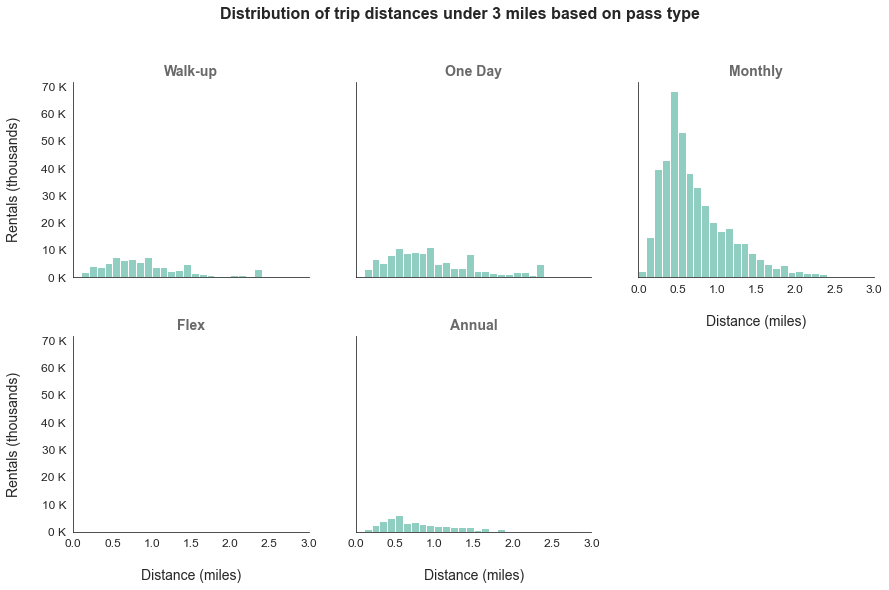

In [423]:
sb.set_style('white')
sb.set_palette(palette = "GnBu_d", n_colors = 5, desat = None)
base_color = sb.color_palette()[4]

g = sb.FacetGrid(data = distance_lim_3, col = 'pass_type', col_wrap = 3, height = 4, aspect = 1, xlim=(0,3))
g.map(plt.hist, "distance_miles", color = base_color, bins = np.arange(0, bikeshare.distance_miles.max()+0.1, 0.1))
g.fig.subplots_adjust(top=0.85)
g.fig.suptitle('Distribution of trip distances under 3 miles based on pass type\n', fontsize = 16, weight = 'bold')
g.set_titles('{col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# obtain y_ticks and convert them to a multiple of millions
# obtain the x_ticks and store them as a list
y_tick_names = []
x_tick_names = []
for ax in g.axes.flat:
    for y_label in ax.get_yticklabels():
        y_label_value = int(y_label.get_text())
        y_label_new_value = '{:0.0f} K'.format(y_label_value/1000)
        y_tick_names.append(y_label_new_value)
        
    for x_label in ax.get_xticklabels():
        x_label_value = x_label.get_text()
        x_tick_names.append(x_label_value)

g.set_yticklabels(y_tick_names, size = 12)
g.set_xticklabels(x_tick_names, size = 12)
g.set_xlabels('\nDistance (miles)', size = 14)
g.set_ylabels('Rentals (thousands)\n', size = 14)

plt.subplots_adjust(wspace=0.2, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.25.e Facet Grid of trip distances under 3 miles on bike type.png', dpi=300, bbox_inches='tight')

> Let us plot more variety of graphs to observe the distribution of data and hidden insights.

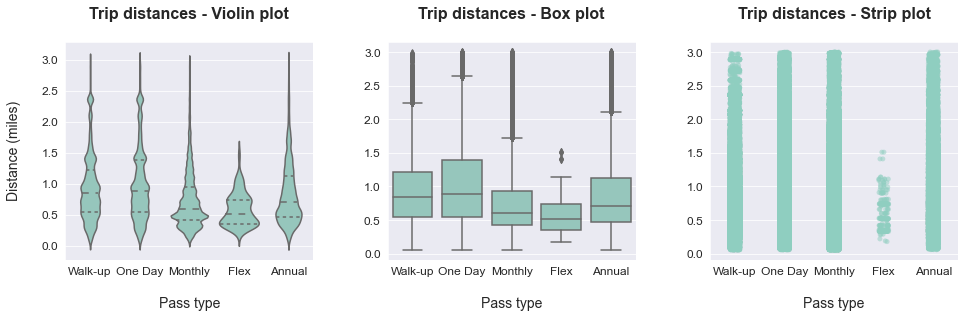

In [424]:
plt.figure(figsize = [16, 4])
sb.set_style('darkgrid')
sb.set_palette(palette = "GnBu_d", n_colors = 5, desat = None)
base_color = sb.color_palette()[4]

# left plot: violin plot
plt.subplot(1, 3, 1)
sb.violinplot(data = distance_lim_3, x = 'pass_type', y = 'distance_miles', inner = 'quartile',
              color = base_color)
plt.title('Trip distances - Violin plot\n',  weight = 'bold', fontsize = 16)
plt.xlabel('\nPass type', fontsize = 14)
plt.ylabel('Distance (miles)\n', fontsize = 14)
plt.xticks(fontsize = 12)
plt.yticks(fontsize = 12)

# center plot: box plot
plt.subplot(1, 3, 2)
sb.boxplot(data = distance_lim_3, x = 'pass_type', y = 'distance_miles', color = base_color)
plt.title('Trip distances - Box plot\n',  weight = 'bold', fontsize = 16)
plt.xlabel('\nPass type', fontsize = 14)
plt.ylabel('', fontsize = 14)
plt.xticks(fontsize = 12)
plt.yticks(fontsize = 12)

# right plot: strip chart
plt.subplot(1, 3, 3)
sb.stripplot(data = distance_lim_3,  x = "pass_type", y = "distance_miles", alpha = 0.5, color = base_color)
plt.title('Trip distances - Strip plot\n',  weight = 'bold', fontsize = 16)
plt.xlabel('\nPass type', fontsize = 14)
plt.ylabel('', fontsize = 14);
plt.xticks(fontsize = 12)
plt.yticks(fontsize = 12)

plt.subplots_adjust(wspace=0.3, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust dhe figure to include all of the x and y labels
plt.savefig('plots/3.2.25.f Distribution of Pass type durations under 3 miles on various plots.png', dpi=300, bbox_inches='tight')

Calculate the `average trip distance` and the `most frequent trip distance` subjected to each `pass type`.

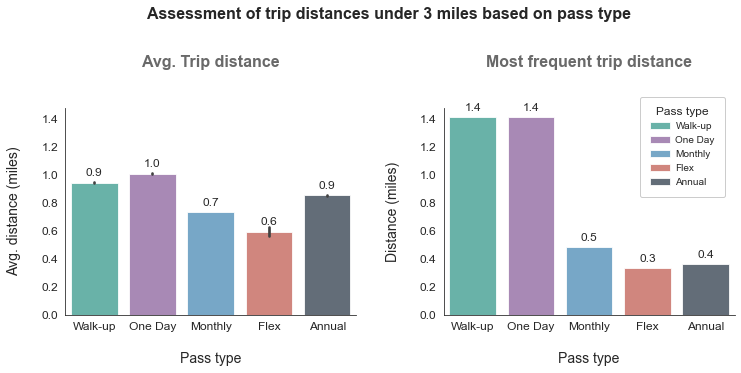

In [425]:
plt.figure(figsize = [12, 5])
flatui = ["#26bda7", "#9b59b6", "#3498db", "#e74c3c", "#34495e"]
sb.set_palette(flatui, n_colors=5, desat=0.8)

# left plot: point plot - Avg trip duration
sb.set_style('white')
plt.subplot(1, 2, 1)
ax1 = sb.barplot(data = distance_lim_3, x = "pass_type", y = "distance_miles", hue = 'pass_type', 
                 alpha = 0.8, dodge=False)
plt.title('Avg. Trip distance\n\n',  weight = 'bold', fontsize = 16, color = 'dimgrey')
plt.ylabel('Avg. distance (miles)\n', fontsize = 14)
plt.xlabel('\nPass type', fontsize = 14)
plt.xticks(fontsize = 12)
plt.yticks(fontsize=12)
sb.despine(top=True, bottom=False, left=False, right=True);

plt.legend('', frameon=False, fancybox=False)

# add annotations
# -------------------------------------------------------
for p in ax1.patches:
    ax1.annotate(format(p.get_height(), '.1f'), (p.get_x() + p.get_width() / 2., p.get_height()), 
                 ha = 'center', va = 'center', xytext = (0, 10), textcoords = 'offset points', fontsize = 12)
# -------------------------------------------------------

# right plot: Bar chart - most frequent trip duration
sb.set_style('white')
plt.subplot(1, 2, 2)
walkup_mode = distance_lim_3.query(' pass_type == "Walk-up" ').distance_miles.mode()[0]
oneday_mode = distance_lim_3.query(' pass_type == "One Day" ').distance_miles.mode()[0]
monthly_mode = distance_lim_3.query(' pass_type == "Monthly" ').distance_miles.mode()[0]
flex_mode = distance_lim_3.query(' pass_type == "Flex" ').distance_miles.mode()[0]
annual_mode = distance_lim_3.query(' pass_type == "Annual" ').distance_miles.mode()[0]
heights = [walkup_mode, oneday_mode, monthly_mode, flex_mode, annual_mode]
labels = distance_lim_3.pass_type.sort_values(ascending=True).unique()
ax2 = sb.barplot(x = labels, y = heights, hue = labels, alpha = 0.8, dodge=False)
plt.title('Most frequent trip distance\n\n',  weight = 'bold', fontsize = 16, color = 'dimgrey')
plt.xlabel('\nPass type', fontsize = 14)
plt.ylabel('Distance (miles)\n', fontsize = 14)
plt.xticks(fontsize = 12)
plt.yticks(fontsize=12)
sb.despine(top=True, bottom=False, left=False, right=True);

plt.legend(scatterpoints=1, frameon=True, fancybox=True, shadow=False, framealpha = 1, 
           borderpad=1, borderaxespad=1, loc = 'upper right', labelspacing=0.5, ncol = 1,  
           title='Pass type', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(1, 1.1))

# add annotations
# -------------------------------------------------------
for p in ax2.patches:
    ax2.annotate(format(p.get_height(), '.1f'), (p.get_x() + p.get_width() / 2., p.get_height()), 
                 ha = 'center', va = 'center', xytext = (0, 10), textcoords = 'offset points', fontsize = 12)
# -------------------------------------------------------

# increase first plot's y axis limit if second plot's y axis limit is higher
if ax1.get_ylim() < ax2.get_ylim():
    ax1.set_ylim(ax2.get_ylim())

plt.subplots_adjust(wspace=0.3, hspace=0.3)
plt.subplots_adjust(top=0.7)
plt.suptitle('Assessment of trip distances under 3 miles based on pass type\n', fontsize = 16, weight = 'bold');

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.25.g Assessment of trip distances under 3 miles based on pass type.png', dpi=300, bbox_inches='tight')

---------

#### 3.2.26 Bivariate analysis of `distance_miles` and `fare_type` columns:

+ `Columns`: distance_miles, fare_type
+ `Data type`: (Numerical, continuous) and (Categorical, nominal)
+ `Plot`: Facet Grid, Violin plot, Box plot, Adapted Barchart

In [426]:
# Observe the distribution of distances through descriptive statistics
bikeshare.distance_miles.describe()

count    808589.000000
mean          0.709956
std           0.692094
min           0.000000
25%           0.310000
50%           0.580000
75%           0.970000
max          24.940000
Name: distance_miles, dtype: float64

> Use the above descriptive statistics to set the `bin size` for the upcoming plots

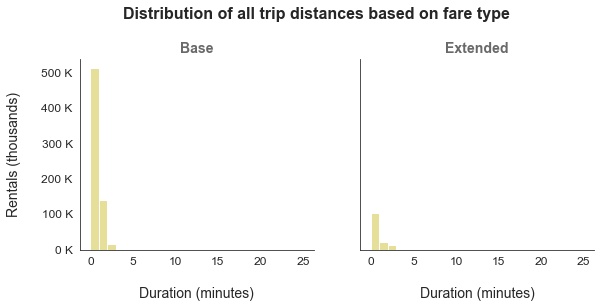

In [427]:
sb.set_style('white')
flatui = ["#fff480"]
sb.set_palette(flatui, n_colors=1, desat=0.6)
base_color = sb.color_palette()[0]

g = sb.FacetGrid(data = bikeshare, col = 'fare_type', col_wrap = 2, height = 4, aspect = 1 )
g.map(plt.hist, "distance_miles", color = base_color, bins = np.arange(0, bikeshare.distance_miles.max()+1, 1))
g.fig.subplots_adjust(top=0.8)
g.fig.suptitle('Distribution of all trip distances based on fare type\n', fontsize = 16, weight = 'bold')
g.set_titles('{col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# obtain y_ticks and convert them to a multiple of millions
# obtain the x_ticks and store them as a list
y_tick_names = []
x_tick_names = []
for ax in g.axes.flat:
    for y_label in ax.get_yticklabels():
        y_label_value = int(y_label.get_text())
        y_label_new_value = '{:0.0f} K'.format(y_label_value/1000)
        y_tick_names.append(y_label_new_value)
        
    for x_label in ax.get_xticklabels():
        x_label_value = x_label.get_text()
        x_tick_names.append(x_label_value)

g.set_yticklabels(y_tick_names, size = 12)
g.set_xticklabels(x_tick_names, size = 12)
g.set_xlabels('\nDuration (minutes)', size = 14)
g.set_ylabels('Rentals (thousands)\n', size = 14)

plt.subplots_adjust(wspace=0.2, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.26.a Facet Grid of trip distances on fare type.png', dpi=300, bbox_inches='tight')

The distribution of `distance_miles` values are `right skewed` and needs closer interpretation. This can be achieved by limiting the plot to a threshold value.

> Let us plot more variety of graphs to observe the distribution of data and hidden insights.

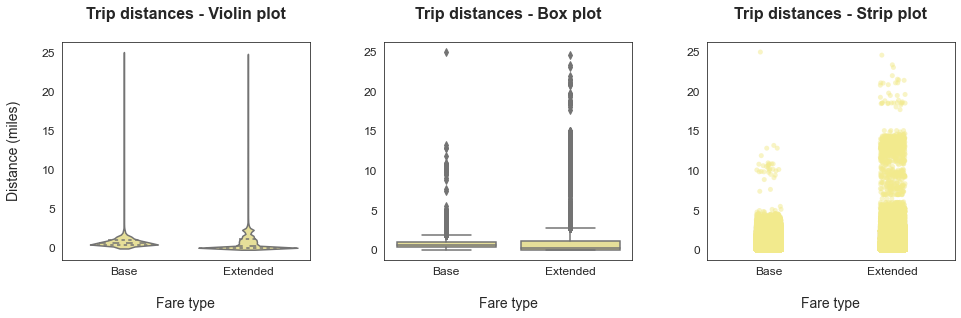

In [428]:
plt.figure(figsize = [16, 4])
flatui = ["#fff480"]
sb.set_palette(flatui, n_colors=1, desat=0.8)
base_color = sb.color_palette()[0]

# left plot: violin plot
plt.subplot(1, 3, 1)
sb.violinplot(data = bikeshare, x = 'fare_type', y = 'distance_miles', inner = 'quartile',
              color = base_color)
plt.title('Trip distances - Violin plot\n',  weight = 'bold', fontsize = 16)
plt.xlabel('\nFare type', fontsize = 14)
plt.ylabel('Distance (miles)\n', fontsize = 14)
plt.xticks(fontsize = 12)
plt.yticks(fontsize = 12)

# center plot: box plot
plt.subplot(1, 3, 2)
sb.boxplot(data = bikeshare, x = 'fare_type', y = 'distance_miles', color = base_color)
plt.title('Trip distances - Box plot\n',  weight = 'bold', fontsize = 16)
plt.xlabel('\nFare type', fontsize = 14)
plt.ylabel('', fontsize = 14)
plt.xticks(fontsize = 12)
plt.yticks(fontsize = 12)

# right plot: strip chart
plt.subplot(1, 3, 3)
sb.stripplot(data = bikeshare, x = "fare_type", y = "distance_miles", alpha = 0.5, color = base_color)
plt.title('Trip distances - Strip plot\n',  weight = 'bold', fontsize = 16)
plt.xlabel('\nFare type', fontsize = 14)
plt.ylabel('', fontsize = 14);
plt.xticks(fontsize = 12)
plt.yticks(fontsize = 12)

plt.subplots_adjust(wspace=0.3, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust dhe figure to include all of the x and y labels
plt.savefig('plots/3.2.26.b Distribution of Fare type durations on various plots.png', dpi=300, bbox_inches='tight')

Calculate the `average trip distance` and the `most frequent trip distance` subjected to each `fare type`.

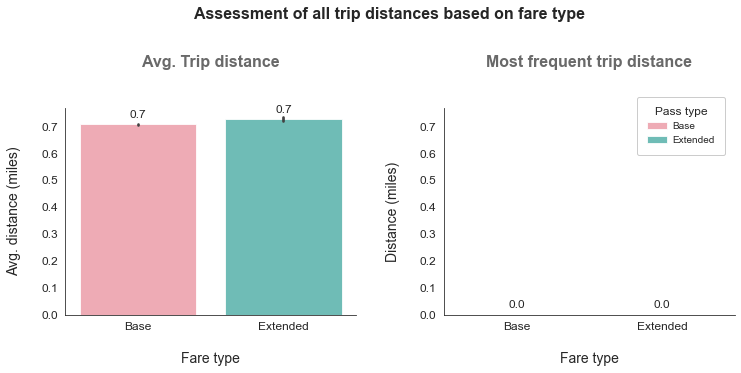

In [429]:
plt.figure(figsize = [12, 5])
flatui = ["#fff480"]
sb.set_palette(flatui, n_colors=1, desat=0.8)
base_color = sb.color_palette()[0]

# left plot: point plot - Avg trip duration
sb.set_style('white')
plt.subplot(1, 2, 1)
ax1 = sb.barplot(data = bikeshare, x = "fare_type", y = "distance_miles", hue = 'fare_type', alpha = 0.8, dodge=False)
plt.title('Avg. Trip distance\n\n',  weight = 'bold', fontsize = 16, color = 'dimgrey')
plt.ylabel('Avg. distance (miles)\n', fontsize = 14)
plt.xlabel('\nFare type', fontsize = 14)
plt.xticks(fontsize = 12)
plt.yticks(fontsize=12)
sb.despine(top=True, bottom=False, left=False, right=True);

plt.legend('', frameon=False, fancybox=False)

# add annotations
# -------------------------------------------------------
for p in ax1.patches:
    ax1.annotate(format(p.get_height(), '.1f'), (p.get_x() + p.get_width() / 2., p.get_height()), 
                 ha = 'center', va = 'center', xytext = (0, 10), textcoords = 'offset points', fontsize = 12)
# -------------------------------------------------------

# right plot: Bar chart - most frequent trip duration
sb.set_style('white')
plt.subplot(1, 2, 2)
base_mode = bikeshare.query(' fare_type == "Base" ').distance_miles.mode()[0]
extended_mode = bikeshare.query(' fare_type == "Extended" ').distance_miles.mode()[0]
heights = [base_mode, extended_mode]
labels = bikeshare.fare_type.sort_values(ascending=True).unique()
ax2 = sb.barplot(x = labels, y = heights, hue = labels, alpha = 0.8, dodge=False)
plt.title('Most frequent trip distance\n\n',  weight = 'bold', fontsize = 16, color = 'dimgrey')
plt.xlabel('\nFare type', fontsize = 14)
plt.ylabel('Distance (miles)\n', fontsize = 14)
plt.xticks(fontsize = 12)
plt.yticks(fontsize=12)
sb.despine(top=True, bottom=False, left=False, right=True);

plt.legend(scatterpoints=1, frameon=True, fancybox=True, shadow=False, framealpha = 1, 
           borderpad=1, borderaxespad=1, loc = 'upper right', labelspacing=0.5, ncol = 1,  
           title='Pass type', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(1, 1.1))

# add annotations
# -------------------------------------------------------
for p in ax2.patches:
    ax2.annotate(format(p.get_height(), '.1f'), (p.get_x() + p.get_width() / 2., p.get_height()), 
                 ha = 'center', va = 'center', xytext = (0, 10), textcoords = 'offset points', fontsize = 12)
# -------------------------------------------------------

# adjust the two plots to have the same y axis limits
if ax1.get_ylim() < ax2.get_ylim():
    ax1.set_ylim(ax2.get_ylim())
else:
    ax2.set_ylim(ax1.get_ylim())

plt.subplots_adjust(wspace=0.3, hspace=0.3)
plt.subplots_adjust(top=0.7)
plt.suptitle('Assessment of all trip distances based on fare type\n', fontsize = 16, weight = 'bold');

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.26.c Average trip distances based on fare type.png', dpi=300, bbox_inches='tight')

> The `Round Trip` entries have a distance/displacement equal to `Zero` and clustered together unlike `One Way` trips which are distributed between `1-25 miles`. Hence remove the entries with duration value `0` and re-evaluate the descriptive statistics, to calculate the correct mode values.

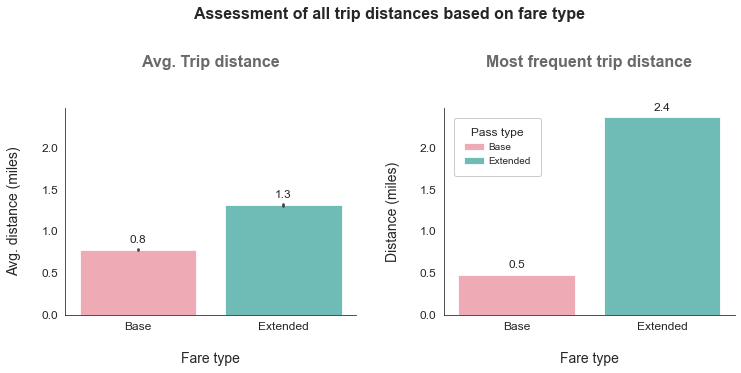

In [430]:
drop_index = bikeshare.query(' distance_miles == 0 ').index
temp_df = bikeshare.drop(drop_index)

plt.figure(figsize = [12, 5])
flatui = ["#fff480"]
sb.set_palette(flatui, n_colors=1, desat=0.8)
base_color = sb.color_palette()[0]

# left plot: point plot - Avg trip duration
sb.set_style('white')
plt.subplot(1, 2, 1)
ax1 = sb.barplot(data = temp_df, x = "fare_type", y = "distance_miles", hue = 'fare_type', alpha = 0.8, dodge=False)
plt.title('Avg. Trip distance\n\n',  weight = 'bold', fontsize = 16, color = 'dimgrey')
plt.ylabel('Avg. distance (miles)\n', fontsize = 14)
plt.xlabel('\nFare type', fontsize = 14)
plt.xticks(fontsize = 12)
plt.yticks(fontsize=12)
sb.despine(top=True, bottom=False, left=False, right=True);

plt.legend('', frameon=False, fancybox=False)

# add annotations
# -------------------------------------------------------
for p in ax1.patches:
    ax1.annotate(format(p.get_height(), '.1f'), (p.get_x() + p.get_width() / 2., p.get_height()), 
                 ha = 'center', va = 'center', xytext = (0, 10), textcoords = 'offset points', fontsize = 12)
# -------------------------------------------------------

# right plot: Bar chart - most frequent trip duration
sb.set_style('white')
plt.subplot(1, 2, 2)
base_mode = temp_df.query(' fare_type == "Base" ').distance_miles.mode()[0]
extended_mode = temp_df.query(' fare_type == "Extended" ').distance_miles.mode()[0]
heights = [base_mode, extended_mode]
labels = temp_df.fare_type.sort_values(ascending=True).unique()
ax2 = sb.barplot(x = labels, y = heights, hue = labels, alpha = 0.8, dodge=False)
plt.title('Most frequent trip distance\n\n',  weight = 'bold', fontsize = 16, color = 'dimgrey')
plt.xlabel('\nFare type', fontsize = 14)
plt.ylabel('Distance (miles)\n', fontsize = 14)
plt.xticks(fontsize = 12)
plt.yticks(fontsize=12)
sb.despine(top=True, bottom=False, left=False, right=True);

plt.legend(scatterpoints=1, frameon=True, fancybox=True, shadow=False, framealpha = 1, 
           borderpad=1, borderaxespad=1, loc = 'upper left', labelspacing=0.5, ncol = 1,  
           title='Pass type', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5)

# add annotations
# -------------------------------------------------------
for p in ax2.patches:
    ax2.annotate(format(p.get_height(), '.1f'), (p.get_x() + p.get_width() / 2., p.get_height()), 
                 ha = 'center', va = 'center', xytext = (0, 10), textcoords = 'offset points', fontsize = 12)
# -------------------------------------------------------

# adjust the two plots to have the same y axis limits
if ax1.get_ylim() < ax2.get_ylim():
    ax1.set_ylim(ax2.get_ylim())
else:
    ax2.set_ylim(ax1.get_ylim())

plt.subplots_adjust(wspace=0.3, hspace=0.3)
plt.subplots_adjust(top=0.7)
plt.suptitle('Assessment of all trip distances based on fare type\n', fontsize = 16, weight = 'bold');

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.26.d Assessment of all trip distances based on fare type.png', dpi=300, bbox_inches='tight')

**`Dataset limited by 3 miles:`**

In [431]:
# calculate the percentage of the dataset that falls under `3 miles` trip distance.
np.round((bikeshare.query(' distance_miles <= 3 ').shape[0]/bikeshare.shape[0])*100, 2)

99.5

The calculations are influenced by the presence of outliers. Calculate the `descriptive statistics` by limiting the data set to entries under `3 miles`, which constitute the `99%` of the distance distribution. Also remove the entries with distance valued `Zero` as they are clustered by `Round Trip` data and influence the actual statistics.

In [432]:
# calculate the percentage of the dataset that falls under `3 miles` trip distance and above '0 miles'.
np.round((bikeshare.query(' distance_miles <= 3  and distance_miles > 0 ').shape[0]/bikeshare.shape[0])*100, 2)

84.13

In [433]:
# Limit the dataset that has entries under 3 miles distance and above '0' miles
distance_lim_3 = bikeshare.query(' distance_miles <= 3  and distance_miles > 0 ')

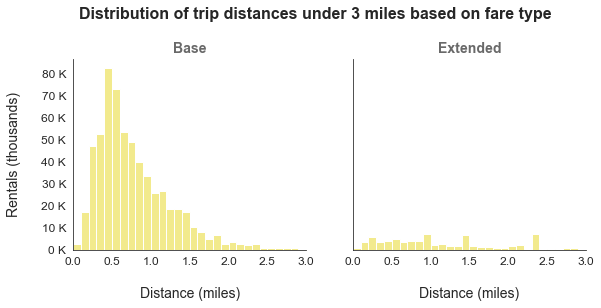

In [434]:
sb.set_style('white')
flatui = ["#fff480"]
sb.set_palette(flatui, n_colors=1, desat=0.8)
base_color = sb.color_palette()[0]

g = sb.FacetGrid(data = distance_lim_3, col = 'fare_type', col_wrap = 2, height = 4, aspect = 1, xlim=(0,3))
g.map(plt.hist, "distance_miles", color = base_color, bins = np.arange(0, bikeshare.distance_miles.max()+0.1, 0.1))
g.fig.subplots_adjust(top=0.8)
g.fig.suptitle('Distribution of trip distances under 3 miles based on fare type\n', fontsize = 16, weight = 'bold')
g.set_titles('{col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# obtain y_ticks and convert them to a multiple of millions
# obtain the x_ticks and store them as a list
y_tick_names = []
x_tick_names = []
for ax in g.axes.flat:
    for y_label in ax.get_yticklabels():
        y_label_value = int(y_label.get_text())
        y_label_new_value = '{:0.0f} K'.format(y_label_value/1000)
        y_tick_names.append(y_label_new_value)
        
    for x_label in ax.get_xticklabels():
        x_label_value = x_label.get_text()
        x_tick_names.append(x_label_value)

g.set_yticklabels(y_tick_names, size = 12)
g.set_xticklabels(x_tick_names, size = 12)
g.set_xlabels('\nDistance (miles)', size = 14)
g.set_ylabels('Rentals (thousands)\n', size = 14)

plt.subplots_adjust(wspace=0.2, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.26.e Facet Grid of trip distances under 3 miles on bike type.png', dpi=300, bbox_inches='tight')

> Let us plot more variety of graphs to observe the distribution of data and hidden insights.

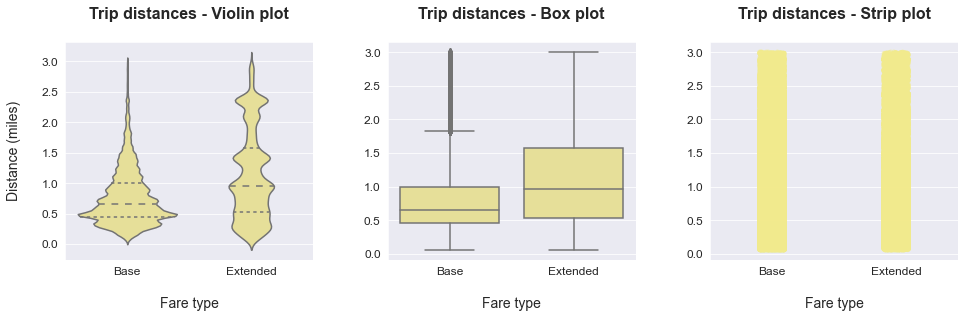

In [435]:
plt.figure(figsize = [16, 4])
sb.set_style('darkgrid')
flatui = ["#fff480"]
sb.set_palette(flatui, n_colors=1, desat=0.8)
base_color = sb.color_palette()[0]

# left plot: violin plot
plt.subplot(1, 3, 1)
sb.violinplot(data = distance_lim_3, x = 'fare_type', y = 'distance_miles', inner = 'quartile',
              color = base_color)
plt.title('Trip distances - Violin plot\n',  weight = 'bold', fontsize = 16)
plt.xlabel('\nFare type', fontsize = 14)
plt.ylabel('Distance (miles)\n', fontsize = 14)
plt.xticks(fontsize = 12)
plt.yticks(fontsize = 12)

# center plot: box plot
plt.subplot(1, 3, 2)
sb.boxplot(data = distance_lim_3, x = 'fare_type', y = 'distance_miles', color = base_color)
plt.title('Trip distances - Box plot\n',  weight = 'bold', fontsize = 16)
plt.xlabel('\nFare type', fontsize = 14)
plt.ylabel('', fontsize = 14)
plt.xticks(fontsize = 12)
plt.yticks(fontsize = 12)

# right plot: strip chart
plt.subplot(1, 3, 3)
sb.stripplot(data = distance_lim_3,  x = "fare_type", y = "distance_miles", alpha = 0.5, color = base_color)
plt.title('Trip distances - Strip plot\n',  weight = 'bold', fontsize = 16)
plt.xlabel('\nFare type', fontsize = 14)
plt.ylabel('', fontsize = 14);
plt.xticks(fontsize = 12)
plt.yticks(fontsize = 12)

plt.subplots_adjust(wspace=0.3, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust dhe figure to include all of the x and y labels
plt.savefig('plots/3.2.26.f Distribution of Fare type durations under 3 miles on various plots.png', dpi=300, bbox_inches='tight')

Calculate the `average trip distance` and the `most frequent trip distance` subjected to each `fare type`.

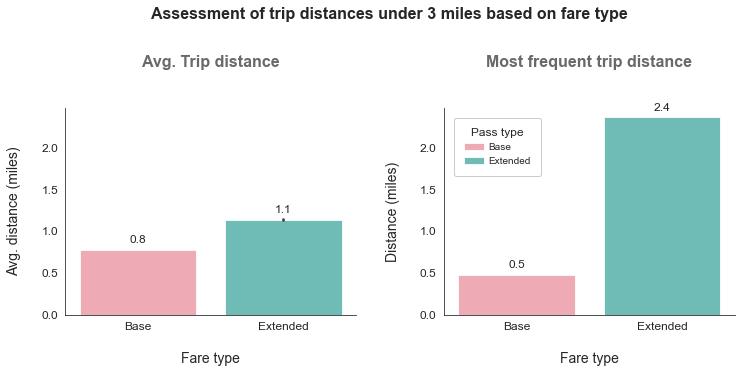

In [436]:
plt.figure(figsize = [12, 5])
flatui = ["#fff480"]
sb.set_palette(flatui, n_colors=1, desat=0.8)
base_color = sb.color_palette()[0]

# left plot: point plot - Avg trip duration
sb.set_style('white')
plt.subplot(1, 2, 1)
ax1 = sb.barplot(data = distance_lim_3, x = "fare_type", y = "distance_miles", hue = 'fare_type', 
                 alpha = 0.8, dodge=False)
plt.title('Avg. Trip distance\n\n',  weight = 'bold', fontsize = 16, color = 'dimgrey')
plt.ylabel('Avg. distance (miles)\n', fontsize = 14)
plt.xlabel('\nFare type', fontsize = 14)
plt.xticks(fontsize = 12)
plt.yticks(fontsize=12)
sb.despine(top=True, bottom=False, left=False, right=True);

plt.legend('', frameon=False, fancybox=False)

# add annotations
# -------------------------------------------------------
for p in ax1.patches:
    ax1.annotate(format(p.get_height(), '.1f'), (p.get_x() + p.get_width() / 2., p.get_height()), 
                 ha = 'center', va = 'center', xytext = (0, 10), textcoords = 'offset points', fontsize = 12)
# -------------------------------------------------------

# right plot: Bar chart - most frequent trip duration
sb.set_style('white')
plt.subplot(1, 2, 2)
base_mode = distance_lim_3.query(' fare_type == "Base" ').distance_miles.mode()[0]
extended_mode = distance_lim_3.query(' fare_type == "Extended" ').distance_miles.mode()[0]
heights = [base_mode, extended_mode]
labels = distance_lim_3.fare_type.sort_values(ascending=True).unique()
ax2 = sb.barplot(x = labels, y = heights, hue = labels, alpha = 0.8, dodge=False)
plt.title('Most frequent trip distance\n\n',  weight = 'bold', fontsize = 16, color = 'dimgrey')
plt.xlabel('\nFare type', fontsize = 14)
plt.ylabel('Distance (miles)\n', fontsize = 14)
plt.xticks(fontsize = 12)
plt.yticks(fontsize=12)
sb.despine(top=True, bottom=False, left=False, right=True);

plt.legend(scatterpoints=1, frameon=True, fancybox=True, shadow=False, framealpha = 1, 
           borderpad=1, borderaxespad=1, loc = 'upper left', labelspacing=0.5, ncol = 1,  
           title='Pass type', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5)

# add annotations
# -------------------------------------------------------
for p in ax2.patches:
    ax2.annotate(format(p.get_height(), '.1f'), (p.get_x() + p.get_width() / 2., p.get_height()), 
                 ha = 'center', va = 'center', xytext = (0, 10), textcoords = 'offset points', fontsize = 12)
# -------------------------------------------------------

# adjust the two plots to have the same y axis limits
if ax1.get_ylim() < ax2.get_ylim():
    ax1.set_ylim(ax2.get_ylim())
else:
    ax2.set_ylim(ax1.get_ylim())

plt.subplots_adjust(wspace=0.3, hspace=0.3)
plt.subplots_adjust(top=0.7)
plt.suptitle('Assessment of trip distances under 3 miles based on fare type\n', fontsize = 16, weight = 'bold');

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.26.g Assessment of trip distances under 3 miles based on fare type.png', dpi=300, bbox_inches='tight')

---------

#### 3.2.27 Bivariate analysis of `bikeshare.hour` and `trip_type` columns:

+ `Columns`: hour, trip_type
+ `Data type`: (Numerical, continuous) and (Categorical, nominal)
+ `Plot`: Facet Grid, Violin plot, Box plot, Adapted Barchart

**`Stack plot:`**

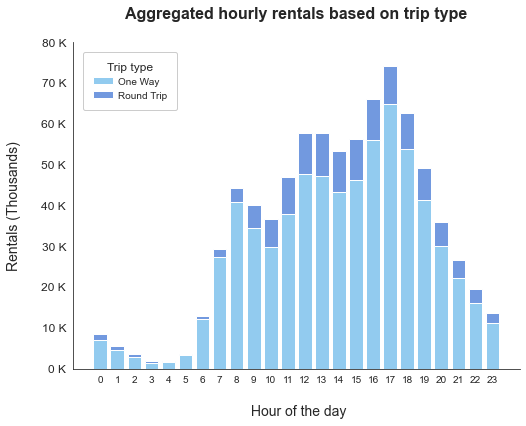

In [437]:
sb.set_style('white')
flatui = ["lightskyblue", "cornflowerblue"]
sb.set_palette(flatui, desat = 0.8)
plt.figure(figsize = [8, 6])

cat1_order = bikeshare.hour.unique()
cat2_order = bikeshare.trip_type.unique()

# plot stacked plot
baselines = np.zeros(len(cat1_order))
# for each second-variable category:
for i in range(len(cat2_order)):
    # isolate the counts of the first category,
    cat2 = cat2_order[i]
    inner_counts = bikeshare[bikeshare['trip_type'] == cat2]['hour'].value_counts()
    # then plot those counts on top of the accumulated baseline
    plt.bar(x = np.arange(len(cat1_order)), height = inner_counts[cat1_order].fillna(0),
            bottom = baselines)
    baselines += inner_counts[cat1_order].fillna(0)

# improve plot aesthetics
max_count = bikeshare.groupby([bikeshare['hour']]).size().reset_index(name='rentals').max()['rentals']
y_tick_values = np.arange(0, max_count + 10000, 10000)
y_tick_names = ['{:0.0f} K'.format(v/1000) for v in y_tick_values]

plt.title('Aggregated hourly rentals based on trip type\n', weight = 'bold', fontsize = 16)
plt.xticks(np.arange(len(cat1_order)), cat1_order)
plt.yticks(y_tick_values, y_tick_names, fontsize=12)
plt.xlabel('\n Hour of the day', fontsize=14)
plt.ylabel('Rentals (Thousands)\n', fontsize=14)
plt.legend(cat2_order, scatterpoints=1, frameon=True, fancybox=True, shadow=False, ncol = 1, 
           framealpha = 1, borderpad=1, borderaxespad=1, loc = 'upper left', labelspacing=0.5,  
           title='Trip type', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5)

sb.despine();

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.27.a Stacked plot of trip rentals based on hour of the day.png', dpi=300, bbox_inches='tight')

**`Line Plot:`**

> The data needs some summirization by grouping together the respective variables. Then, reset the index and name the summerized data values accordingly.

In [438]:
categorical_counts = bikeshare.groupby([bikeshare['trip_type'], 
                                        bikeshare['hour']]).size().reset_index(name='rentals')
categorical_counts.head(10)

,trip_type,hour,rentals
0,One Way,0,7030
1,One Way,1,4497
2,One Way,2,2939
3,One Way,3,1471
4,One Way,4,1534
5,One Way,5,3334
6,One Way,6,12198
7,One Way,7,27398
8,One Way,8,40972
9,One Way,9,34570


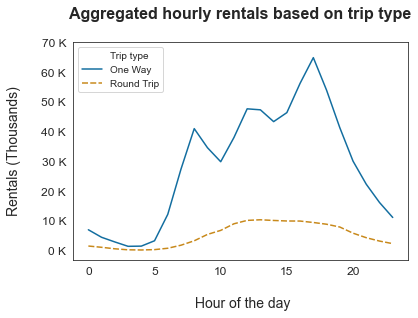

In [439]:
# set the palette as per requirement
sb.set_palette(palette = "colorblind", n_colors = 2, desat = 0.8)
current_palette = sb.color_palette()
sb.set_style('white')

plt.figure(figsize = [6, 4])
max_count = categorical_counts.rentals.max()
y_tick_values = np.arange(0, max_count + 10000, 10000)
y_tick_names = ['{:0.0f} K'.format(v/1000) for v in y_tick_values]

# plot line plot
ax = sb.lineplot(data=categorical_counts, x = "hour", y = "rentals", hue="trip_type", style="trip_type", err_style="bars")
plt.title('Aggregated hourly rentals based on trip type\n', weight = 'bold', fontsize = 16)
plt.xticks(fontsize=12)
plt.yticks(y_tick_values, y_tick_names, fontsize=12)
plt.xlabel('\n Hour of the day', fontsize=14)
plt.ylabel('Rentals (Thousands)\n', fontsize=14)
plt.legend(scatterpoints=1, frameon=True, fancybox=True, shadow=False, ncol = 1, framealpha = 1, 
           borderpad=1, borderaxespad=1, loc = 'upper left', labelspacing=0.5,  
           title='Trip type', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5)

# when a hue is used that appears as a legend title,
# remove this title, and replace it with custom title.
legend = ax.legend()
legend.texts[0].set_text("Trip type");

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.27.b Line plot of trip rentals based on hour of the day.png', dpi=300, bbox_inches='tight')

**`Individual plots of aggregated distribution of hourly rentals over trip type:`**

<Figure size 576x288 with 0 Axes>

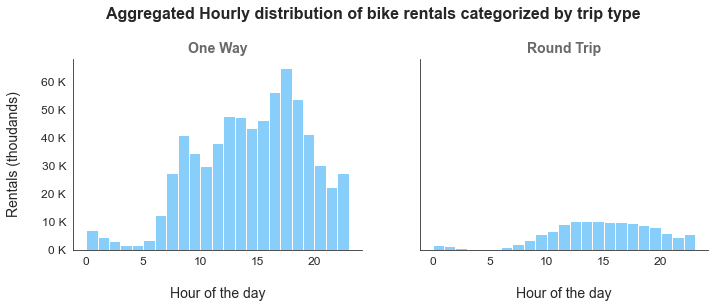

In [440]:
sb.set_style('white')
plt.figure(figsize = [8, 4])

# plot facet grid
g = sb.FacetGrid(data = bikeshare, col = 'trip_type', col_wrap = 2, height = 4, aspect = 1.2)
g.map(plt.hist, "hour", color = 'lightskyblue', bins = np.arange(0, bikeshare.hour.max()+1, 1))
g.fig.subplots_adjust(top=0.8)
g.fig.suptitle('Aggregated Hourly distribution of bike rentals categorized by trip type\n', fontsize = 16, weight = 'bold')
g.set_titles('{col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# obtain y_ticks and convert them to a multiple of millions
# obtain the x_ticks and store them as a list
y_tick_names = []
x_tick_names = []
for ax in g.axes.flat:
    for y_label in ax.get_yticklabels():
        y_label_value = int(y_label.get_text())
        y_label_new_value = '{:0.0f} K'.format(y_label_value/1000)
        y_tick_names.append(y_label_new_value)
        
    for x_label in ax.get_xticklabels():
        x_label_value = x_label.get_text()
        x_tick_names.append(x_label_value)

g.set_yticklabels(y_tick_names, size = 12)
g.set_xticklabels(x_tick_names, size = 12)
g.set_xlabels('\nHour of the day', size = 14)
g.set_ylabels('Rentals (thoudands)\n', size = 14)

plt.subplots_adjust(wspace=0.2, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.27.c Facet Grid of trip rentals based on hour of the day.png', dpi=300, bbox_inches='tight')

> Let us plot more variety of graphs to observe the distribution of data and hidden insights.

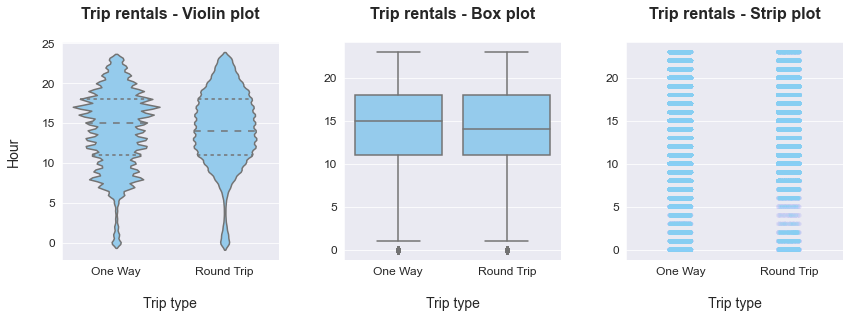

In [441]:
plt.figure(figsize = [14, 4])
sb.set_style('darkgrid')
base_color = 'lightskyblue'

# left plot: violin plot
plt.subplot(1, 3, 1)
sb.violinplot(data = bikeshare, x = 'trip_type', y = 'hour', inner = 'quartile',
              color = base_color)
plt.title('Trip rentals - Violin plot\n',  weight = 'bold', fontsize = 16)
plt.xlabel('\nTrip type', fontsize = 14)
plt.ylabel('Hour\n', fontsize = 14)
plt.xticks(fontsize = 12)
plt.yticks(fontsize = 12)

# center plot: box plot
plt.subplot(1, 3, 2)
sb.boxplot(data = bikeshare, x = 'trip_type', y = 'hour', color = base_color)
plt.title('Trip rentals - Box plot\n',  weight = 'bold', fontsize = 16)
plt.xlabel('\nTrip type', fontsize = 14)
plt.ylabel('', fontsize = 14)
plt.xticks(fontsize = 12)
plt.yticks(fontsize = 12)

# right plot: strip chart
plt.subplot(1, 3, 3)
sb.stripplot(data = bikeshare, x = "trip_type", y = "hour", alpha = 0.002, color = base_color)
plt.title('Trip rentals - Strip plot\n',  weight = 'bold', fontsize = 16)
plt.xlabel('\nTrip type', fontsize = 14)
plt.ylabel('', fontsize = 14);
plt.xticks(fontsize = 12)
plt.yticks(fontsize = 12)

plt.subplots_adjust(wspace=0.3, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust dhe figure to include all of the x and y labels
plt.savefig('plots/3.2.27.d Distribution of Trip rentals based on hour of the day.png', dpi=300, bbox_inches='tight')

**`Heat Map:`**

One alternative way of depicting the relationship between two categorical variables is through a **Heat map**. Heat maps were introduced earlier as the 2-d version of a histogram; here, we're using them as the 2-d version of a bar chart. The seaborn function `heatmap` is at home with this type of heat map implementation, but the input arguments are unlike most of the visualization functions. Instead of providing the original dataframe, we need to summarize the counts into a matrix that will then be plotted.

> Now lets make a pivot from the categorical dataset created earlier into a more appropriate data structure.

In [442]:
categorical_counts = categorical_counts.pivot(index = 'trip_type', columns = 'hour', values = 'rentals')
categorical_counts

hour,0,1,2,3,4,5,6,7,8,9,...,14,15,16,17,18,19,20,21,22,23
trip_type,,,,,,,,,,,,,,,,,,,,,
One Way,7030,4497,2939,1471,1534,3334,12198,27398,40972,34570,...,43324,46352,56192,64801,53883,41298,30065,22310,16185,11152
Round Trip,1567,1141,639,299,240,362,821,1842,3327,5466,...,10151,9973,9949,9469,8886,7946,5883,4358,3235,2365


> The data is ready to be plotred as the `Heat map`.

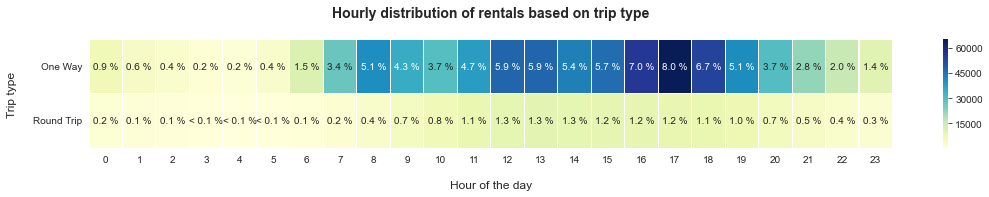

In [443]:
# plot heat map
plt.figure(figsize = [18, 2])
res = sb.heatmap(categorical_counts, annot = True, fmt = '.0f', annot_kws={'size':10}, linewidths=0.1, cmap="YlGnBu")
plt.yticks(rotation=0, fontsize="10", va="center")
plt.title('Hourly distribution of rentals based on trip type\n', fontsize = 14, weight = 'bold')
plt.xlabel('\nHour of the day', fontsize=12)
plt.ylabel('Trip type\n', fontsize=12);

# convert annotations to percentages
for t in res.texts: 
    p = np.round(np.round(int(t.get_text())/bikeshare.shape[0], 4)*100, 1)
    if p < 0.1:
        t.set_text('< 0.1 %')
    else:
        t.set_text('{} %'.format(p));
               
# savefig by passing (bbox_inches='tight'),which will adjust dhe figure to include all of the x and y labels
plt.savefig('plots/3.2.27.e Heat map of Trip rentals based on hour of the day.png', dpi=300, bbox_inches='tight')

**`Find average rentals based on the hour of the day:`**

In [444]:
hours_df = bikeshare.groupby([bikeshare["year"], 
                              bikeshare["month"],
                              bikeshare["day"],
                              bikeshare["hour"],
                              bikeshare["trip_type"]]).count()['trip_id'].reset_index(name='rentals')

hours_df['rentals'] = hours_df['rentals'].fillna(0).astype(int)
hours_df.head(10)

,year,month,day,hour,trip_type,rentals
0,2017,1,1,0,One Way,6
1,2017,1,1,0,Round Trip,3
2,2017,1,1,1,One Way,5
3,2017,1,1,1,Round Trip,0
4,2017,1,1,2,One Way,8
5,2017,1,1,2,Round Trip,0
6,2017,1,1,3,One Way,2
7,2017,1,1,3,Round Trip,0
8,2017,1,1,4,One Way,1
9,2017,1,1,4,Round Trip,0


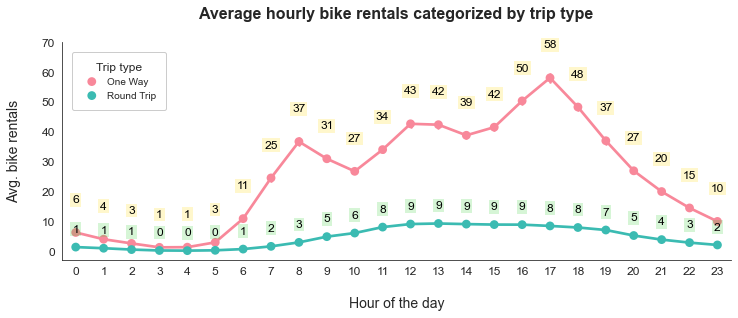

In [445]:
plt.figure(figsize=[12,4])
sb.set_style('white')
flatui = ["#fff480"]
sb.set_palette(flatui, n_colors=1, desat=0.8)
base_color = sb.color_palette()[0]

sb.pointplot(data = hours_df, x = "hour", y = "rentals", linestyles = "-", hue = 'trip_type')
plt.title('Average hourly bike rentals categorized by trip type\n',  weight = 'bold', fontsize = 16)
plt.ylabel('Avg. bike rentals\n', fontsize = 14)
plt.xlabel('\nHour of the day', fontsize = 14)
plt.xticks(fontsize = 12)

# get ytick locs and rearrage them with respect to zero
locs, labels = plt.yticks()
max_count = locs.max()
y_tick_values = np.arange(0,  max_count+10, 10)
y_tick_names = ['{:0.0f}'.format(v) for v in y_tick_values]
plt.yticks(y_tick_values, y_tick_names, fontsize = 12)

# add annotations
# -------------------------------------------------------
avg_rentals = hours_df.groupby([hours_df["trip_type"], hours_df["hour"]]).mean()['rentals'].reset_index()
avg_rentals_max = avg_rentals.rentals.max()
avg_rentals_oneway = avg_rentals.query(' trip_type == "One Way" ')
avg_rentals_roundtrip = avg_rentals.query(' trip_type == "Round Trip" ')

# get the current tick locations and labels
locs, labels = plt.xticks()

for categorical_df in [avg_rentals_oneway, avg_rentals_roundtrip]:
    clrs = ['gold' if trip == "One Way" else 'limegreen' for trip in categorical_df.trip_type ]
    # loop through each pair of locations and labels
    for loc, label, avg_rental_count, clr in zip(locs, labels, categorical_df.rentals, clrs):
        try:
            count = avg_rental_count
        except KeyError:
            count = 0   
        pct_string = '{:0.0f}'.format(count)
        if categorical_df.trip_type.unique() == "One Way":
            indent = 10
        else:
            indent = 5
        # print the annotation depending on the bar length
        plt.text(loc, count + indent, pct_string, ha = 'center', color = 'black', 
                 fontsize = 12, bbox=dict(pad=1.9,alpha=0.2,color='none',fc=clr))
# -------------------------------------------------------

plt.legend(scatterpoints=1, frameon=True, fancybox=True, shadow=False, ncol = 1, 
           framealpha = 1, borderpad=1, borderaxespad=1, loc = 'upper left', labelspacing=0.5,  
           title='Trip type', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5)

sb.despine(top=True, right=True, left=False, bottom=False);

plt.savefig('plots/3.2.27.f Average hourly bike rentals categorized by trip type.png', dpi=300, bbox_inches='tight')

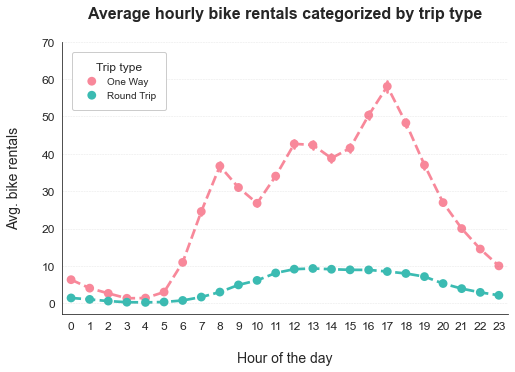

In [446]:
plt.figure(figsize=[8,5])
sb.set_style('white')
flatui = ["#fff480"]
sb.set_palette(flatui, n_colors=1, desat=0.8)
base_color = sb.color_palette()[0]

sb.pointplot(data = hours_df, x = "hour", y = "rentals", linestyles = "--", hue = 'trip_type')
plt.title('Average hourly bike rentals categorized by trip type\n',  weight = 'bold', fontsize = 16)
plt.ylabel('Avg. bike rentals\n', fontsize = 14)
plt.xlabel('\nHour of the day', fontsize = 14)
plt.xticks(fontsize = 12)

# get ytick locs and rearrage them with respect to zero
locs, labels = plt.yticks()
hours_rental_avg_max = 70
y_tick_values = np.arange(0, hours_rental_avg_max+10, 10)
y_tick_names = ['{:0.0f}'.format(v) for v in y_tick_values]
plt.yticks(y_tick_values, y_tick_names, fontsize = 12)

plt.legend(scatterpoints=1, frameon=True, fancybox=True, shadow=False, ncol = 1, 
           framealpha = 1, borderpad=1, borderaxespad=1, loc = 'upper left', labelspacing=0.5,  
           title='Trip type', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5)

sb.despine(top=True, right=True, left=False, bottom=False);

for loc in y_tick_values:
    plt.axhline(loc, ls='--', color='grey', linewidth=0.5, alpha=0.2)

plt.savefig('plots/3.2.27.g Average hourly bike rentals categorized by trip type.png', dpi=300, bbox_inches='tight')

------------

#### 3.2.28 Bivariate analysis of `bikeshare.hour` and `bike_type` columns:

+ `Columns`: hour, bike_type
+ `Data type`: (Numerical, continuous) and (Categorical, nominal)
+ `Plot`: Facet Grid, Violin plot, Box plot, Adapted Barchart

**`Stack plot:`**

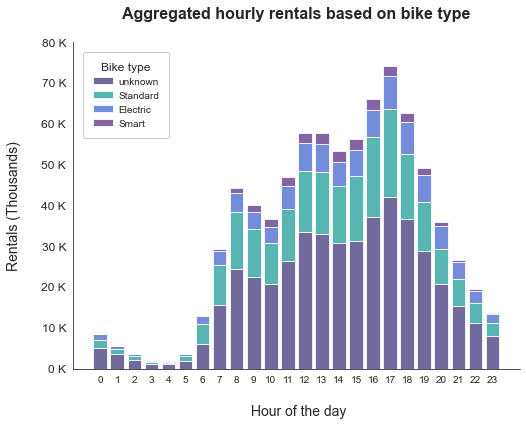

In [447]:
# Assign palette as per requirement
sb.set_style('white')
flatui = ["darkslateblue", "lightseagreen", "royalblue", "rebeccapurple"]
sb.set_palette(flatui, desat = 0.8)
plt.figure(figsize = [8, 6])

cat1_order = bikeshare.hour.sort_values(ascending=True).unique()
cat2_order = bikeshare.bike_type.sort_values(ascending=True).unique()

# plot stacked plot
baselines = np.zeros(len(cat1_order))
# for each second-variable category:
for i in range(len(cat2_order)):
    # isolate the counts of the first category,
    cat2 = cat2_order[i]
    inner_counts = bikeshare[bikeshare['bike_type'] == cat2]['hour'].value_counts()
    # then plot those counts on top of the accumulated baseline
    plt.bar(x = np.arange(len(cat1_order)), height = inner_counts[cat1_order].fillna(0),
            bottom = baselines, alpha = 0.8)
    baselines += inner_counts[cat1_order].fillna(0)

# improve plot aesthetics
max_count = bikeshare.groupby([bikeshare['hour']]).size().reset_index(name='rentals').max()['rentals']
y_tick_values = np.arange(0, max_count + 10000, 10000)
y_tick_names = ['{:0.0f} K'.format(v/1000) for v in y_tick_values]

plt.title('Aggregated hourly rentals based on bike type\n', weight = 'bold', fontsize = 16)
plt.xticks(np.arange(len(cat1_order)), cat1_order)
plt.yticks(y_tick_values, y_tick_names, fontsize=12)
plt.xlabel('\n Hour of the day', fontsize=14)
plt.ylabel('Rentals (Thousands)\n', fontsize=14)
plt.legend(cat2_order, scatterpoints=1, frameon=True, fancybox=True, shadow=False, ncol = 1, 
           framealpha = 1, borderpad=1, borderaxespad=1, loc = 'upper left', labelspacing=0.5,  
           title='Bike type', title_fontsize=12, fontsize=10, facecolor='white',
           markerfirst=True, handlelength=2, handletextpad=0.5)

sb.despine();

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.28.a Stack plot of rentals based on bike type and hour of the day.png', dpi=300, bbox_inches='tight')

**`Line plot:`**

> The data needs some summirization by grouping together the respective variables. Then, reset the index and name the summerized data values accordingly.

In [448]:
categorical_counts = bikeshare.groupby([bikeshare['bike_type'], 
                                        bikeshare['hour']]).size().reset_index(name='rentals')
categorical_counts.head(10)

,bike_type,hour,rentals
0,unknown,0,4942
1,unknown,1,3478
2,unknown,2,2146
3,unknown,3,1157
4,unknown,4,1051
5,unknown,5,1969
6,unknown,6,5963
7,unknown,7,15540
8,unknown,8,24542
9,unknown,9,22457


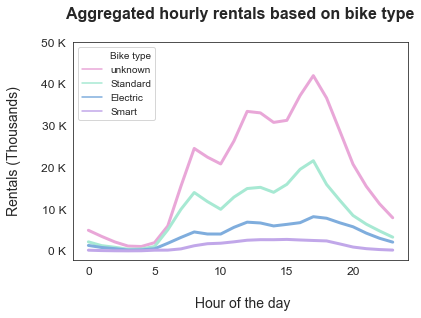

In [449]:
# set the palette as per requirement
sb.set_style('white')
# flatui = ["darkslateblue", "lightseagreen", "royalblue", "rebeccapurple"]
flatui = ['#ff91e2', '#91ffda', '#60acfc', '#bd91ff']
sb.set_palette(flatui, n_colors=4, desat=0.6)

plt.figure(figsize = [6, 4])
max_count = categorical_counts.rentals.max()
y_tick_values = np.arange(0, max_count + 10000, 10000)
y_tick_names = ['{:0.0f} K'.format(v/1000) for v in y_tick_values]

# plot line plot
ax = sb.lineplot(data=categorical_counts, x = "hour", y = "rentals", hue="bike_type", linewidth=3)
plt.title('Aggregated hourly rentals based on bike type\n', weight = 'bold', fontsize = 16)
plt.xticks(fontsize=12)
plt.yticks(y_tick_values, y_tick_names, fontsize=12)
plt.xlabel('\n Hour of the day', fontsize=14)
plt.ylabel('Rentals (Thousands)\n', fontsize=14)
plt.legend(scatterpoints=1, frameon=True, fancybox=True, shadow=False, ncol = 1, framealpha = 1, 
           borderpad=1, borderaxespad=1, loc = 'upper left', labelspacing=0.5,  
           title='Bike type', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5)

# when 'hue' is used, its label appears as legend title
# replace default title with custom title.
legend = ax.legend()
legend.texts[0].set_text("Bike type");

# savefig by passing (bbox_inches='tight'),which will adjust dhe figure to include all of the x and y labels
plt.savefig('plots/3.2.28.b Line plot of Trip rentals based on hour of the day over bike type.png', dpi=300, bbox_inches='tight')

**`Individual plots of aggregated distribution of hourly rentals over bike type:`**

<Figure size 576x288 with 0 Axes>

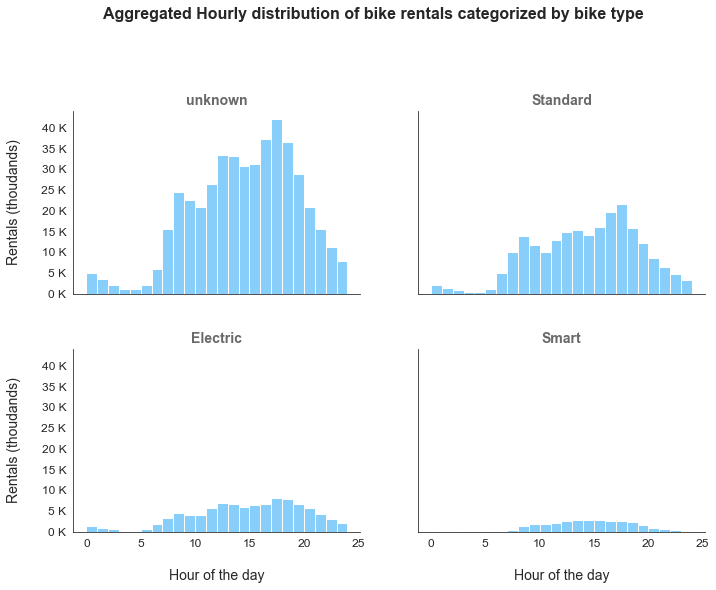

In [450]:
sb.set_style('white')
plt.figure(figsize = [8, 4])

# plot facet grid
g = sb.FacetGrid(data = bikeshare, col = 'bike_type', col_wrap = 2, height = 4, aspect = 1.2)
g.map(plt.hist, "hour", color = 'lightskyblue', bins = np.arange(0, bikeshare.hour.max()+2, 1))
g.fig.subplots_adjust(top=0.8)
g.fig.suptitle('Aggregated Hourly distribution of bike rentals categorized by bike type\n', fontsize = 16, weight = 'bold')
g.set_titles('{col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# obtain y_ticks and convert them to a multiple of millions
# obtain the x_ticks and store them as a list
y_tick_names = []
x_tick_names = []
for ax in g.axes.flat:
    for y_label in ax.get_yticklabels():
        y_label_value = int(y_label.get_text())
        y_label_new_value = '{:0.0f} K'.format(y_label_value/1000)
        y_tick_names.append(y_label_new_value)
        
    for x_label in ax.get_xticklabels():
        x_label_value = x_label.get_text()
        x_tick_names.append(x_label_value)

g.set_yticklabels(y_tick_names, size = 12)
g.set_xticklabels(x_tick_names, size = 12)
g.set_xlabels('\nHour of the day', size = 14)
g.set_ylabels('Rentals (thoudands)\n', size = 14)

plt.subplots_adjust(wspace=0.2, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.28.c Facet Grid of trip rentals based on hour of the day over bike type.png', dpi=300, bbox_inches='tight')

> Let us plot more variety of graphs to observe the distribution of data and hidden insights.

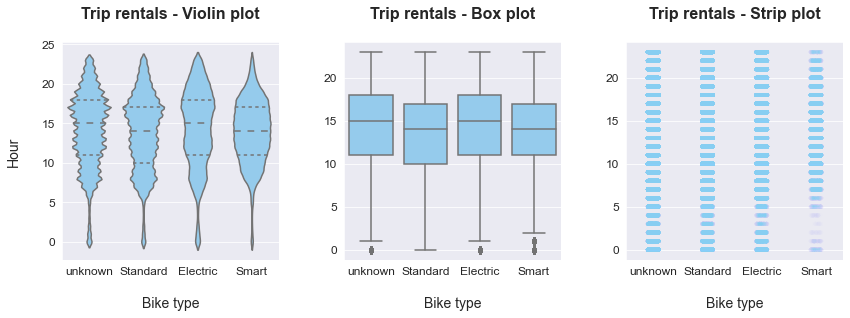

In [451]:
plt.figure(figsize = [14, 4])
sb.set_style('darkgrid')
base_color = 'lightskyblue'

# left plot: violin plot
plt.subplot(1, 3, 1)
sb.violinplot(data = bikeshare, x = 'bike_type', y = 'hour', inner = 'quartile',
              color = base_color)
plt.title('Trip rentals - Violin plot\n',  weight = 'bold', fontsize = 16)
plt.xlabel('\nBike type', fontsize = 14)
plt.ylabel('Hour\n', fontsize = 14)
plt.xticks(fontsize = 12)
plt.yticks(fontsize = 12)

# center plot: box plot
plt.subplot(1, 3, 2)
sb.boxplot(data = bikeshare, x = 'bike_type', y = 'hour', color = base_color)
plt.title('Trip rentals - Box plot\n',  weight = 'bold', fontsize = 16)
plt.xlabel('\nBike type', fontsize = 14)
plt.ylabel('', fontsize = 14)
plt.xticks(fontsize = 12)
plt.yticks(fontsize = 12)

# right plot: strip chart
plt.subplot(1, 3, 3)
sb.stripplot(data = bikeshare, x = "bike_type", y = "hour", alpha = 0.002, color = base_color)
plt.title('Trip rentals - Strip plot\n',  weight = 'bold', fontsize = 16)
plt.xlabel('\nBike type', fontsize = 14)
plt.ylabel('', fontsize = 14);
plt.xticks(fontsize = 12)
plt.yticks(fontsize = 12)

plt.subplots_adjust(wspace=0.3, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust dhe figure to include all of the x and y labels
plt.savefig('plots/3.2.28.d Distribution of Trip rentals based on hour of the day over bike type.png', dpi=300, bbox_inches='tight')

**`Heat Map:`**

> Now lets make a pivot from the categorical dataset created earlier into a more appropriate data structure.

In [452]:
categorical_counts = categorical_counts.pivot(index = 'bike_type', columns = 'hour', values = 'rentals')
categorical_counts

hour,0,1,2,3,4,5,6,7,8,9,...,14,15,16,17,18,19,20,21,22,23
bike_type,,,,,,,,,,,,,,,,,,,,,
unknown,4942,3478,2146,1157,1051,1969,5963,15540,24542,22457,...,30779,31272,37218,41980,36632,28729,20764,15470,11284,7935
Standard,2172,1261,867,399,443,1051,5042,9980,13983,11809,...,14033,15946,19543,21600,15926,12116,8483,6405,4783,3287
Electric,1311,821,532,199,243,507,1827,3233,4539,4049,...,5980,6354,6764,8194,7822,6729,5778,4257,3031,2100
Smart,172,78,33,15,37,169,187,487,1235,1721,...,2683,2753,2616,2496,2389,1670,923,536,322,195


> The data is ready to be plotred as the `Heat map`.

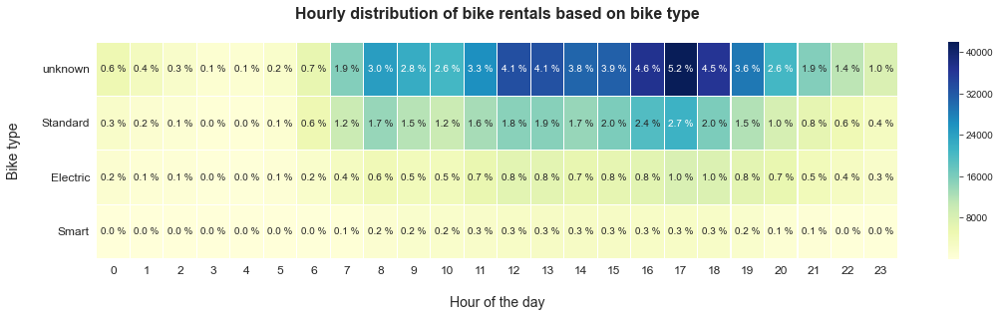

In [453]:
# plot heat map
plt.figure(figsize = [18, 4])
res = sb.heatmap(categorical_counts, annot = True, fmt = '.0f', annot_kws={'size':10}, linewidths=0.1, cmap="YlGnBu")
plt.yticks(rotation=0, fontsize="12", va="center")
plt.xticks(fontsize="12")
plt.title('Hourly distribution of bike rentals based on bike type\n', fontsize = 16, weight = 'bold')
plt.xlabel('\nHour of the day', fontsize=14)
plt.ylabel('Bike type\n', fontsize=14);

# convert annotations to percentages
for t in res.texts: 
    p = np.round(np.round(int(t.get_text())/bikeshare.shape[0], 4)*100, 1)
    t.set_text(str(p)+' %')
               
# savefig by passing (bbox_inches='tight'),which will adjust dhe figure to include all of the x and y labels
plt.savefig('plots/3.2.28.e Heat map of Trip rentals based on hour of the day over bike type.png', dpi=300, bbox_inches='tight')

**`Find average rentals based on the hour of the day:`**

In [454]:
hours_df = bikeshare.groupby([bikeshare["year"], 
                              bikeshare["month"],
                              bikeshare["day"],
                              bikeshare["hour"],
                              bikeshare["bike_type"]]).size().rename_axis(['year',
                                                                           'month',
                                                                           'day',
                                                                           'hour',
                                                                           'bike_type']).reset_index(name='rentals')
hours_df.head()

,year,month,day,hour,bike_type,rentals
0,2017,1,1,0,unknown,9
1,2017,1,1,1,unknown,5
2,2017,1,1,2,unknown,8
3,2017,1,1,3,unknown,2
4,2017,1,1,4,unknown,1


In [455]:
hours_df[-10:]

,year,month,day,hour,bike_type,rentals
35955,2019,12,31,20,Standard,15
35956,2019,12,31,20,Electric,27
35957,2019,12,31,20,Smart,1
35958,2019,12,31,21,Standard,9
35959,2019,12,31,21,Electric,14
35960,2019,12,31,22,Standard,8
35961,2019,12,31,22,Electric,10
35962,2019,12,31,22,Smart,3
35963,2019,12,31,23,Standard,7
35964,2019,12,31,23,Electric,8


> The `bike_type` needs to be converted into categorical datatype, otherwise the `groupby` method will ignore `NaN` rental values and inturn produce **incorrect** `avg. rental value`. Also use of `size()` method ignores the unused level combinations of the groups, hence use `count()` method.This can be observed in the above dataframe that the entries subjected to `2017` does not have `bike_type` of either `Standard/Electric/Smart` with respect to each hour.

In [456]:
hours_df = bikeshare.groupby([bikeshare["year"], 
                              bikeshare["month"],
                              bikeshare["day"],
                              bikeshare["hour"],
                              bikeshare["bike_type"]]).count()['trip_id'].reset_index(name='rentals')

hours_df['rentals'] = hours_df['rentals'].fillna(0).astype(int)
hours_df.head(10)

,year,month,day,hour,bike_type,rentals
0,2017,1,1,0,unknown,9
1,2017,1,1,0,Standard,0
2,2017,1,1,0,Electric,0
3,2017,1,1,0,Smart,0
4,2017,1,1,1,unknown,5
5,2017,1,1,1,Standard,0
6,2017,1,1,1,Electric,0
7,2017,1,1,1,Smart,0
8,2017,1,1,2,unknown,8
9,2017,1,1,2,Standard,0


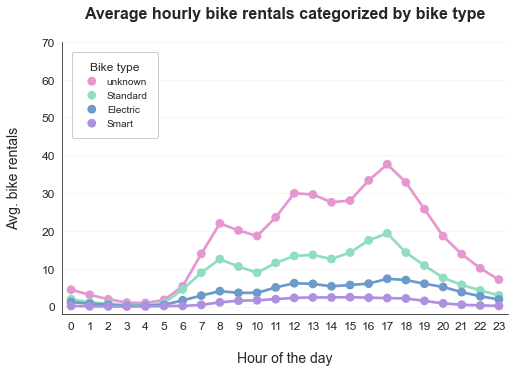

In [457]:
plt.figure(figsize=[8,5])
sb.set_style('white')
# flatui = ['#ff91e2', '#91ffda', '#60acfc', '#bd91ff']
flatui = ['#ff7ddd', '#77f7cc', '#4b99eb', '#aa75fa']
sb.set_palette(flatui, n_colors=4, desat=0.6)
base_color = sb.color_palette()[0]

sb.pointplot(data = hours_df, x = "hour", y = "rentals", linestyles = "-", hue = 'bike_type', 
             scale = 1, ci = None)
plt.title('Average hourly bike rentals categorized by bike type\n',  weight = 'bold', fontsize = 16)
plt.ylabel('Avg. bike rentals\n', fontsize = 14)
plt.xlabel('\nHour of the day', fontsize = 14)
plt.xticks(fontsize = 12)

# get ytick locs and rearrage them with respect to zero
locs, labels = plt.yticks()
hours_rental_avg_max = 70
y_tick_values = np.arange(0, hours_rental_avg_max+10, 10)
y_tick_names = ['{:0.0f}'.format(v) for v in y_tick_values]
plt.yticks(y_tick_values, y_tick_names, fontsize = 12)

plt.legend(scatterpoints=1, frameon=True, fancybox=True, shadow=False, ncol = 1, 
           framealpha = 1, borderpad=1, borderaxespad=1, loc = 'upper left', labelspacing=0.5,  
           title='Bike type', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5)

sb.despine(top=True, right=True, left=False, bottom=False);

for loc in y_tick_values:
    plt.axhline(loc, ls='--', color='grey', linewidth=0.5, alpha=0.2)

plt.savefig('plots/3.2.28.f Average hourly bike rentals categorized by bike type.png', dpi=300, bbox_inches='tight')

------

#### 3.2.29 Bivariate analysis of `bikeshare.hour` and `pass_type` columns:

+ `Columns`: hour, pass_type
+ `Data type`: (Numerical, continuous) and (Categorical, nominal)
+ `Plot`: Facet Grid, Violin plot, Box plot, Adapted Barchart

**`Stack plot:`**

C:\Users\VAMSHI-KRISHNA-PRIME\Anaconda3\lib\site-packages\pandas\core\series.py:1143: FutureWarning: 
Passing list-likes to .loc or [] with any missing label will raise
KeyError in the future, you can use .reindex() as an alternative.

See the documentation here:
https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#deprecate-loc-reindex-listlike
  return self.loc[key]


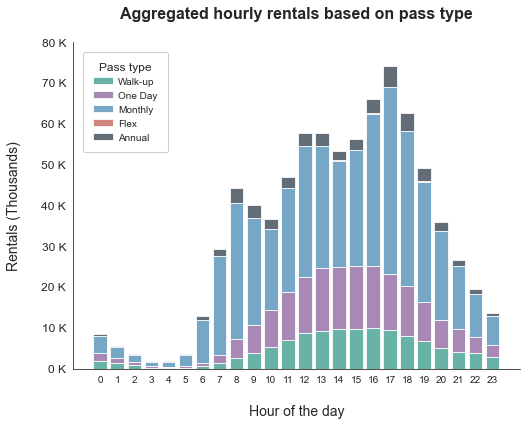

In [458]:
# Assign palette as per requirement
sb.set_style('white')
plt.figure(figsize = [8, 6])
flatui = ["#26bda7", "#9b59b6", "#3498db", "#e74c3c", "#34495e"]
sb.set_palette(flatui, n_colors=5, desat=0.6)

cat1_order = bikeshare.hour.sort_values(ascending=True).unique()
cat2_order = bikeshare.pass_type.sort_values(ascending=True).unique()

# plot stacked plot
baselines = np.zeros(len(cat1_order))
# for each second-variable category:
for i in range(len(cat2_order)):
    # isolate the counts of the first category,
    cat2 = cat2_order[i]
    inner_counts = bikeshare[bikeshare['pass_type'] == cat2]['hour'].value_counts()
    # then plot those counts on top of the accumulated baseline
    plt.bar(x = np.arange(len(cat1_order)), height = inner_counts[cat1_order].fillna(0),
            bottom = baselines, alpha = 0.8)
    baselines += inner_counts[cat1_order].fillna(0)

# improve plot aesthetics
max_count = bikeshare.groupby([bikeshare['hour']]).size().reset_index(name='rentals').max()['rentals']
y_tick_values = np.arange(0, max_count + 10000, 10000)
y_tick_names = ['{:0.0f} K'.format(v/1000) for v in y_tick_values]

plt.title('Aggregated hourly rentals based on pass type\n', weight = 'bold', fontsize = 16)
plt.xticks(np.arange(len(cat1_order)), cat1_order)
plt.yticks(y_tick_values, y_tick_names, fontsize=12)
plt.xlabel('\nHour of the day', fontsize=14)
plt.ylabel('Rentals (Thousands)\n', fontsize=14)
plt.legend(cat2_order, scatterpoints=1, frameon=True, fancybox=True, shadow=False, ncol = 1, 
           framealpha = 1, borderpad=1, borderaxespad=1, loc = 'upper left', labelspacing=0.5,  
           title='Pass type', title_fontsize=12, fontsize=10, facecolor='white',
           markerfirst=True, handlelength=2, handletextpad=0.5)

sb.despine();

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.29.a Stack plot of rentals based on pass type and hour of the day.png', dpi=300, bbox_inches='tight')

**`Line plot:`**

> The data needs some summirization by grouping together the respective variables. Then, reset the index and name the summerized data values accordingly.

In [459]:
categorical_counts = bikeshare.groupby([bikeshare['pass_type'], 
                                        bikeshare['hour']]).size().reset_index(name='rentals')
categorical_counts.head(10)

,pass_type,hour,rentals
0,Walk-up,0,1745
1,Walk-up,1,1315
2,Walk-up,2,788
3,Walk-up,3,254
4,Walk-up,4,197
5,Walk-up,5,241
6,Walk-up,6,555
7,Walk-up,7,1272
8,Walk-up,8,2574
9,Walk-up,9,3767


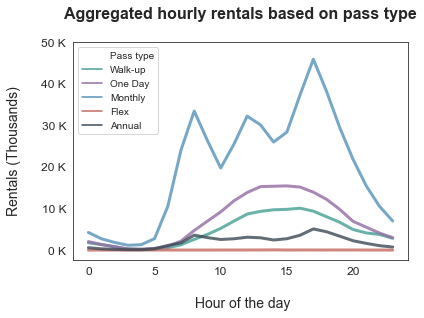

In [460]:
# set the palette as per requirement
sb.set_style('white')
flatui = ["#26bda7", "#9b59b6", "#3498db", "#e74c3c", "#34495e"]
sb.set_palette(flatui, n_colors=5, desat=0.6)

plt.figure(figsize = [6, 4])
max_count = categorical_counts.rentals.max()
y_tick_values = np.arange(0, max_count + 10000, 10000)
y_tick_names = ['{:0.0f} K'.format(v/1000) for v in y_tick_values]

# plot line plot
ax = sb.lineplot(data=categorical_counts, x = "hour", y = "rentals", hue="pass_type", linewidth=3, alpha = 0.8)
plt.title('Aggregated hourly rentals based on pass type\n', weight = 'bold', fontsize = 16)
plt.xticks(fontsize=12)
plt.yticks(y_tick_values, y_tick_names, fontsize=12)
plt.xlabel('\n Hour of the day', fontsize=14)
plt.ylabel('Rentals (Thousands)\n', fontsize=14)
plt.legend(scatterpoints=1, frameon=True, fancybox=True, shadow=False, ncol = 1, framealpha = 1, 
           borderpad=1, borderaxespad=1, loc = 'upper left', labelspacing=0.5,  
           title='Pass type', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5)

# when 'hue' is used, its label appears as legend title
# replace default title with custom title.
legend = ax.legend()
legend.texts[0].set_text("Pass type");

# savefig by passing (bbox_inches='tight'),which will adjust dhe figure to include all of the x and y labels
plt.savefig('plots/3.2.29.b Line plot of Trip rentals based on hour of the day over pass type.png', dpi=300, bbox_inches='tight')

**`Individual plots of aggregated distribution of hourly rentals over bike type:`**

<Figure size 576x288 with 0 Axes>

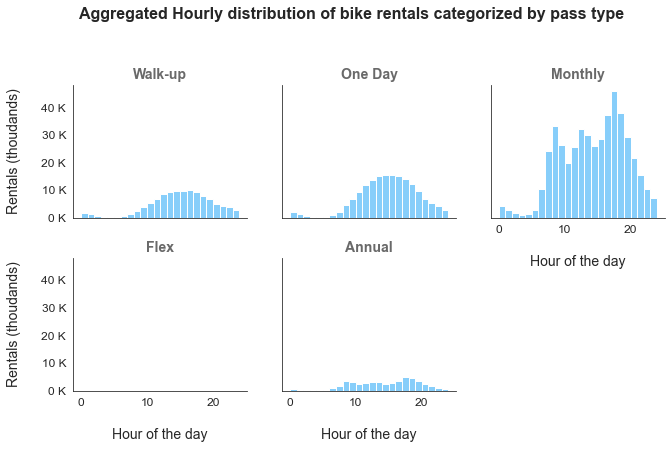

In [461]:
sb.set_style('white')
plt.figure(figsize = [8, 4])

# plot facet grid
g = sb.FacetGrid(data = bikeshare, col = 'pass_type', col_wrap = 3, height = 3, aspect = 1)
g.map(plt.hist, "hour", color = 'lightskyblue', bins = np.arange(0, bikeshare.hour.max()+2, 1))
g.fig.subplots_adjust(top=0.8)
g.fig.suptitle('Aggregated Hourly distribution of bike rentals categorized by pass type\n', fontsize = 16, weight = 'bold')
g.set_titles('{col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# obtain y_ticks and convert them to a multiple of millions
# obtain the x_ticks and store them as a list
y_tick_names = []
x_tick_names = []
for ax in g.axes.flat:
    for y_label in ax.get_yticklabels():
        y_label_value = int(y_label.get_text())
        y_label_new_value = '{:0.0f} K'.format(y_label_value/1000)
        y_tick_names.append(y_label_new_value)
        
    for x_label in ax.get_xticklabels():
        x_label_value = x_label.get_text()
        x_tick_names.append(x_label_value)

g.set_yticklabels(y_tick_names, size = 12)
g.set_xticklabels(x_tick_names, size = 12)
g.set_xlabels('\nHour of the day', size = 14)
g.set_ylabels('Rentals (thoudands)\n', size = 14)

plt.subplots_adjust(wspace=0.2, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.29.c Facet Grid of trip rentals based on hour of the day over pass type.png', dpi=300, bbox_inches='tight')

> Let us plot more variety of graphs to observe the distribution of data and hidden insights.

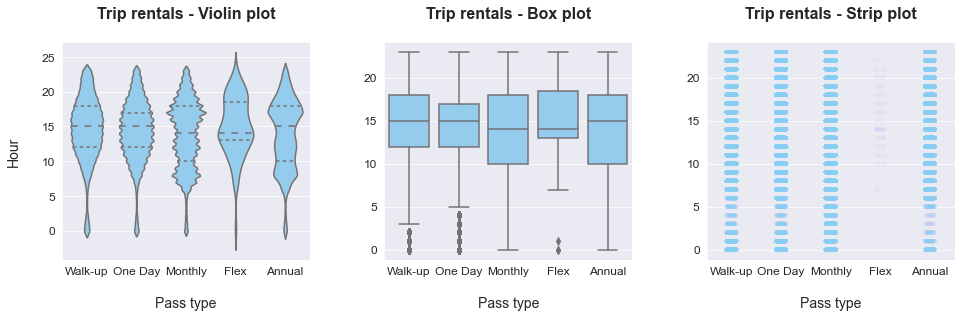

In [462]:
plt.figure(figsize = [16, 4])
sb.set_style('darkgrid')
base_color = 'lightskyblue'

# left plot: violin plot
plt.subplot(1, 3, 1)
sb.violinplot(data = bikeshare, x = 'pass_type', y = 'hour', inner = 'quartile',
              color = base_color)
plt.title('Trip rentals - Violin plot\n',  weight = 'bold', fontsize = 16)
plt.xlabel('\nPass type', fontsize = 14)
plt.ylabel('Hour\n', fontsize = 14)
plt.xticks(fontsize = 12)
plt.yticks(fontsize = 12)

# center plot: box plot
plt.subplot(1, 3, 2)
sb.boxplot(data = bikeshare, x = 'pass_type', y = 'hour', color = base_color)
plt.title('Trip rentals - Box plot\n',  weight = 'bold', fontsize = 16)
plt.xlabel('\nPass type', fontsize = 14)
plt.ylabel('', fontsize = 14)
plt.xticks(fontsize = 12)
plt.yticks(fontsize = 12)

# right plot: strip chart
plt.subplot(1, 3, 3)
sb.stripplot(data = bikeshare, x = "pass_type", y = "hour", alpha = 0.002, color = base_color)
plt.title('Trip rentals - Strip plot\n',  weight = 'bold', fontsize = 16)
plt.xlabel('\nPass type', fontsize = 14)
plt.ylabel('', fontsize = 14);
plt.xticks(fontsize = 12)
plt.yticks(fontsize = 12)

plt.subplots_adjust(wspace=0.3, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust dhe figure to include all of the x and y labels
plt.savefig('plots/3.2.29.d Distribution of Trip rentals based on hour of the day over pass type.png', dpi=300, bbox_inches='tight')

**`Heat Map:`**

> Now lets make a pivot from the categorical dataset created earlier into a more appropriate data structure.

In [463]:
categorical_counts = categorical_counts.pivot(index = 'pass_type', columns = 'hour', values = 'rentals')
categorical_counts

hour,0,1,2,3,4,5,6,7,8,9,...,14,15,16,17,18,19,20,21,22,23
pass_type,,,,,,,,,,,,,,,,,,,,,
Walk-up,1745.0,1315.0,788.0,254.0,197.0,241.0,555.0,1272.0,2574.0,3767.0,...,9684.0,9788.0,10069.0,9360.0,8012.0,6680.0,4943.0,4121.0,3754.0,2830.0
One Day,2049.0,1328.0,802.0,282.0,191.0,410.0,875.0,2163.0,4721.0,6963.0,...,15349.0,15433.0,15146.0,13921.0,12199.0,9775.0,6913.0,5495.0,4091.0,2969.0
Monthly,4231.0,2700.0,1819.0,1154.0,1298.0,2750.0,10483.0,24062.0,33416.0,26309.0,...,25973.0,28368.0,37340.0,45890.0,38144.0,29433.0,21825.0,15431.0,10513.0,6984.0
Flex,2.0,1.0,NaN,NaN,NaN,NaN,NaN,10.0,2.0,4.0,...,47.0,11.0,22.0,16.0,14.0,22.0,21.0,13.0,8.0,2.0
Annual,570.0,294.0,169.0,80.0,88.0,295.0,1106.0,1733.0,3586.0,2993.0,...,2422.0,2725.0,3564.0,5083.0,4400.0,3334.0,2246.0,1608.0,1054.0,732.0


> The data is ready to be plotred as the `Heat map`.

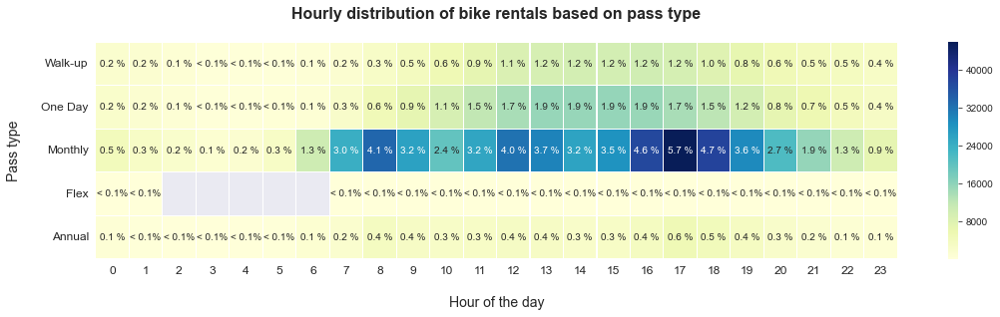

In [464]:
# plot heat map
plt.figure(figsize = [18, 4])
res = sb.heatmap(categorical_counts, annot = True, fmt = '.0f', annot_kws={'size':10}, linewidths=0.1, cmap="YlGnBu")
plt.yticks(rotation=0, fontsize="12", va="center")
plt.xticks(fontsize="12")
plt.title('Hourly distribution of bike rentals based on pass type\n', fontsize = 16, weight = 'bold')
plt.xlabel('\nHour of the day', fontsize=14)
plt.ylabel('Pass type\n', fontsize=14);

# convert annotations to percentages
for t in res.texts: 
    p = np.round(np.round(int(t.get_text())/bikeshare.shape[0], 4)*100, 1)
    if p < 0.1:
        t.set_text('< 0.1%')
    else:
        t.set_text(str(p)+' %');  

# savefig by passing (bbox_inches='tight'),which will adjust dhe figure to include all of the x and y labels
plt.savefig('plots/3.2.29.d Heat map of Trip rentals based on hour of the day over pass type.png', dpi=300, bbox_inches='tight')

**`Find average rentals based on the hour of the day:`**

> The `pass_type` needs to be converted into categorical datatype, otherwise the `groupby` method will ignore `NaN` rental values and inturn produce **incorrect** `avg. rental value`. Also use of `size()` method ignores the unused level combinations of the groups, hence use `count()` method.

In [465]:
hours_df = bikeshare.groupby([bikeshare["year"], 
                              bikeshare["month"],
                              bikeshare["day"],
                              bikeshare["hour"],
                              bikeshare["pass_type"]]).count()['trip_id'].reset_index(name='rentals')

hours_df['rentals'] = hours_df['rentals'].fillna(0).astype(int)
hours_df.head(10)

,year,month,day,hour,pass_type,rentals
0,2017,1,1,0,Walk-up,6
1,2017,1,1,0,One Day,0
2,2017,1,1,0,Monthly,3
3,2017,1,1,0,Flex,0
4,2017,1,1,0,Annual,0
5,2017,1,1,1,Walk-up,4
6,2017,1,1,1,One Day,0
7,2017,1,1,1,Monthly,1
8,2017,1,1,1,Flex,0
9,2017,1,1,1,Annual,0


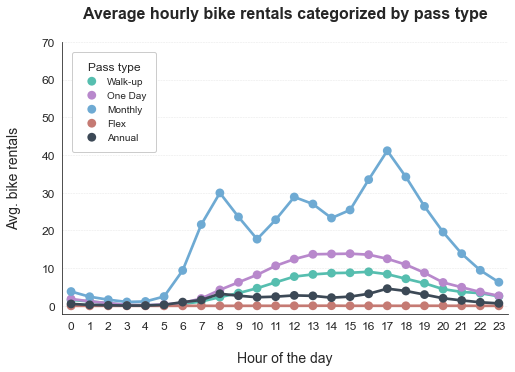

In [466]:
plt.figure(figsize=[8,5])
sb.set_style('white')
# flatui = ["#26bda7", "#9b59b6", "#3498db", "#e74c3c", "#34495e"]
flatui = ["#34e0c7", "#c271e3", "#4cb1f5", "#e06458", "#34495e"]
sb.set_palette(flatui, n_colors=5, desat=0.6)
base_color = sb.color_palette()[0]

sb.pointplot(data = hours_df, x = "hour", y = "rentals", linestyles = "-", hue = 'pass_type', 
             scale = 1, ci = None)
plt.title('Average hourly bike rentals categorized by pass type\n',  weight = 'bold', fontsize = 16)
plt.ylabel('Avg. bike rentals\n', fontsize = 14)
plt.xlabel('\nHour of the day', fontsize = 14)
plt.xticks(fontsize = 12)

# get ytick locs and rearrage them with respect to zero
locs, labels = plt.yticks()
hours_rental_avg_max = 70
y_tick_values = np.arange(0, hours_rental_avg_max+10, 10)
y_tick_names = ['{:0.0f}'.format(v) for v in y_tick_values]
plt.yticks(y_tick_values, y_tick_names, fontsize = 12)

plt.legend(scatterpoints=1, frameon=True, fancybox=True, shadow=False, ncol = 1, 
           framealpha = 1, borderpad=1, borderaxespad=1, loc = 'upper left', labelspacing=0.5,  
           title='Pass type', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5)

sb.despine(top=True, right=True, left=False, bottom=False);

for loc in y_tick_values:
    plt.axhline(loc, ls='--', color='grey', linewidth=0.5, alpha=0.2)

plt.savefig('plots/3.2.29.e Average hourly bike rentals categorized by pass type.png', dpi=300, bbox_inches='tight')

---

#### 3.2.30 Bivariate analysis of `bikeshare.hour` and `fare_type` columns:

+ `Columns`: hour, fare_type
+ `Data type`: (Numerical, continuous) and (Categorical, nominal)
+ `Plot`: Facet Grid, Violin plot, Box plot, Adapted Barchart

**`Stack plot:`**

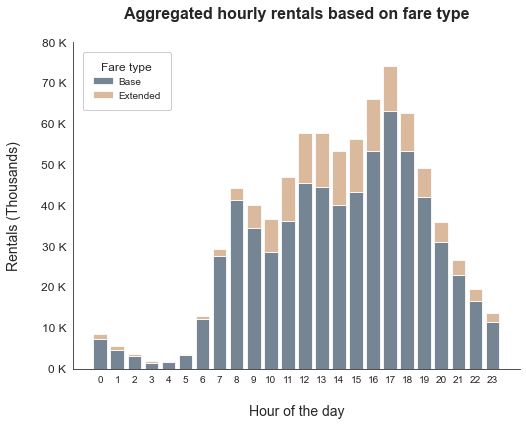

In [467]:
# Assign palette as per requirement
sb.set_style('white')
plt.figure(figsize = [8, 6])
flatui = ['#466887', '#eda668']
sb.set_palette(flatui, n_colors=2, desat=0.6)

cat1_order = bikeshare.hour.sort_values(ascending=True).unique()
cat2_order = bikeshare.fare_type.sort_values(ascending=True).unique()

# plot stacked plot
baselines = np.zeros(len(cat1_order))
# for each second-variable category:
for i in range(len(cat2_order)):
    # isolate the counts of the first category,
    cat2 = cat2_order[i]
    inner_counts = bikeshare[bikeshare['fare_type'] == cat2]['hour'].value_counts()
    # then plot those counts on top of the accumulated baseline
    plt.bar(x = np.arange(len(cat1_order)), height = inner_counts[cat1_order].fillna(0),
            bottom = baselines, alpha = 0.8)
    baselines += inner_counts[cat1_order].fillna(0)

# improve plot aesthetics
max_count = bikeshare.groupby([bikeshare['hour']]).size().reset_index(name='rentals').max()['rentals']
y_tick_values = np.arange(0, max_count + 10000, 10000)
y_tick_names = ['{:0.0f} K'.format(v/1000) for v in y_tick_values]

plt.title('Aggregated hourly rentals based on fare type\n', weight = 'bold', fontsize = 16)
plt.xticks(np.arange(len(cat1_order)), cat1_order)
plt.yticks(y_tick_values, y_tick_names, fontsize=12)
plt.xlabel('\nHour of the day', fontsize=14)
plt.ylabel('Rentals (Thousands)\n', fontsize=14)
plt.legend(cat2_order, scatterpoints=1, frameon=True, fancybox=True, shadow=False, ncol = 1, 
           framealpha = 1, borderpad=1, borderaxespad=1, loc = 'upper left', labelspacing=0.5,  
           title='Fare type', title_fontsize=12, fontsize=10, facecolor='white',
           markerfirst=True, handlelength=2, handletextpad=0.5)

sb.despine();

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.30.a Stack plot of rentals based on fare type and hour of the day.png', dpi=300, bbox_inches='tight')

**`Line plot:`**

> The data needs some summirization by grouping together the respective variables. Then, reset the index and name the summerized data values accordingly.

In [468]:
categorical_counts = bikeshare.groupby([bikeshare['fare_type'], 
                                        bikeshare['hour']]).size().reset_index(name='rentals')
categorical_counts.head(10)

,fare_type,hour,rentals
0,Base,0,7141
1,Base,1,4622
2,Base,2,2992
3,Base,3,1477
4,Base,4,1581
5,Base,5,3273
6,Base,6,12261
7,Base,7,27684
8,Base,8,41304
9,Base,9,34542


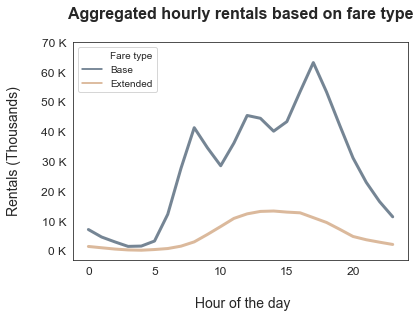

In [469]:
# set the palette as per requirement
sb.set_style('white')
flatui = ['#466887', '#eda668']
sb.set_palette(flatui, n_colors=2, desat=0.6)

plt.figure(figsize = [6, 4])
max_count = categorical_counts.rentals.max()
y_tick_values = np.arange(0, max_count + 10000, 10000)
y_tick_names = ['{:0.0f} K'.format(v/1000) for v in y_tick_values]

# plot line plot
ax = sb.lineplot(data=categorical_counts, x = "hour", y = "rentals", hue="fare_type", linewidth=3, alpha = 0.8)
plt.title('Aggregated hourly rentals based on fare type\n', weight = 'bold', fontsize = 16)
plt.xticks(fontsize=12)
plt.yticks(y_tick_values, y_tick_names, fontsize=12)
plt.xlabel('\n Hour of the day', fontsize=14)
plt.ylabel('Rentals (Thousands)\n', fontsize=14)
plt.legend(scatterpoints=1, frameon=True, fancybox=True, shadow=False, ncol = 1, framealpha = 1, 
           borderpad=1, borderaxespad=1, loc = 'upper left', labelspacing=0.5,  
           title='Fare type', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5)

# when 'hue' is used, its label appears as legend title
# replace default title with custom title.
legend = ax.legend()
legend.texts[0].set_text("Fare type");

# savefig by passing (bbox_inches='tight'),which will adjust dhe figure to include all of the x and y labels
plt.savefig('plots/3.2.30.b Line plot of Trip rentals based on hour of the day over fare type.png', dpi=300, bbox_inches='tight')

**`Individual plots of aggregated distribution of hourly rentals over bike type:`**

<Figure size 576x288 with 0 Axes>

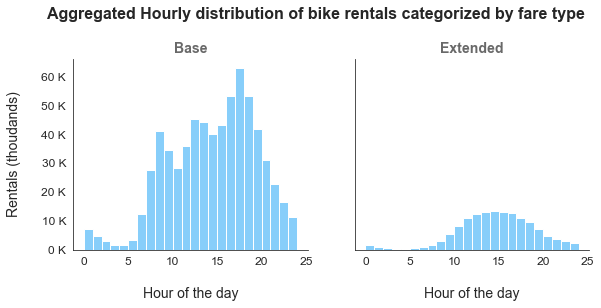

In [470]:
sb.set_style('white')
plt.figure(figsize = [8, 4])

# plot facet grid
g = sb.FacetGrid(data = bikeshare, col = 'fare_type', col_wrap = 2, height = 4, aspect = 1)
g.map(plt.hist, "hour", color = 'lightskyblue', bins = np.arange(0, bikeshare.hour.max()+2, 1))
g.fig.subplots_adjust(top=0.8)
g.fig.suptitle('Aggregated Hourly distribution of bike rentals categorized by fare type\n', fontsize = 16, weight = 'bold')
g.set_titles('{col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# obtain y_ticks and convert them to a multiple of millions
# obtain the x_ticks and store them as a list
y_tick_names = []
x_tick_names = []
for ax in g.axes.flat:
    for y_label in ax.get_yticklabels():
        y_label_value = int(y_label.get_text())
        y_label_new_value = '{:0.0f} K'.format(y_label_value/1000)
        y_tick_names.append(y_label_new_value)
        
    for x_label in ax.get_xticklabels():
        x_label_value = x_label.get_text()
        x_tick_names.append(x_label_value)

g.set_yticklabels(y_tick_names, size = 12)
g.set_xticklabels(x_tick_names, size = 12)
g.set_xlabels('\nHour of the day', size = 14)
g.set_ylabels('Rentals (thoudands)\n', size = 14)

plt.subplots_adjust(wspace=0.2, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.30.c Facet Grid of trip rentals based on hour of the day over fare type.png', dpi=300, bbox_inches='tight')

> Let us plot more variety of graphs to observe the distribution of data and hidden insights.

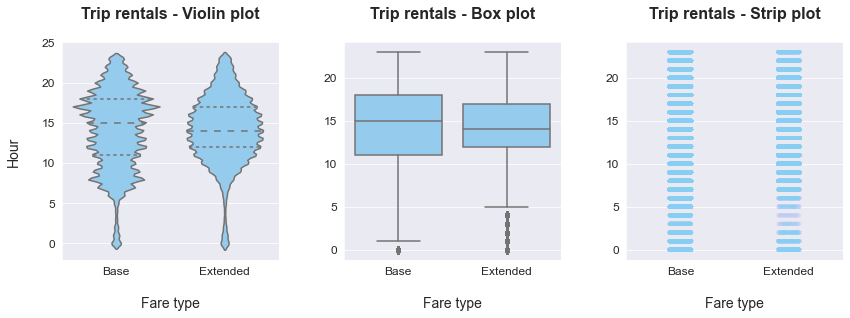

In [471]:
plt.figure(figsize = [14, 4])
sb.set_style('darkgrid')
base_color = 'lightskyblue'

# left plot: violin plot
plt.subplot(1, 3, 1)
sb.violinplot(data = bikeshare, x = 'fare_type', y = 'hour', inner = 'quartile',
              color = base_color)
plt.title('Trip rentals - Violin plot\n',  weight = 'bold', fontsize = 16)
plt.xlabel('\nFare type', fontsize = 14)
plt.ylabel('Hour\n', fontsize = 14)
plt.xticks(fontsize = 12)
plt.yticks(fontsize = 12)

# center plot: box plot
plt.subplot(1, 3, 2)
sb.boxplot(data = bikeshare, x = 'fare_type', y = 'hour', color = base_color)
plt.title('Trip rentals - Box plot\n',  weight = 'bold', fontsize = 16)
plt.xlabel('\nFare type', fontsize = 14)
plt.ylabel('', fontsize = 14)
plt.xticks(fontsize = 12)
plt.yticks(fontsize = 12)

# right plot: strip chart
plt.subplot(1, 3, 3)
sb.stripplot(data = bikeshare, x = "fare_type", y = "hour", alpha = 0.002, color = base_color)
plt.title('Trip rentals - Strip plot\n',  weight = 'bold', fontsize = 16)
plt.xlabel('\nFare type', fontsize = 14)
plt.ylabel('', fontsize = 14);
plt.xticks(fontsize = 12)
plt.yticks(fontsize = 12)

plt.subplots_adjust(wspace=0.3, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust dhe figure to include all of the x and y labels
plt.savefig('plots/3.2.30.d Distribution of Trip rentals based on hour of the day over fare type.png', dpi=300, bbox_inches='tight')

**`Heat Map:`**

> Now lets make a pivot from the categorical dataset created earlier into a more appropriate data structure.

In [472]:
categorical_counts = categorical_counts.pivot(index = 'fare_type', columns = 'hour', values = 'rentals')
categorical_counts

hour,0,1,2,3,4,5,6,7,8,9,...,14,15,16,17,18,19,20,21,22,23
fare_type,,,,,,,,,,,,,,,,,,,,,
Base,7141,4622,2992,1477,1581,3273,12261,27684,41304,34542,...,40130,43342,53399,63149,53270,42050,31143,22962,16529,11393
Extended,1456,1016,586,293,193,423,758,1556,2995,5494,...,13345,12983,12742,11121,9499,7194,4805,3706,2891,2124


> The data is ready to be plotred as the `Heat map`.

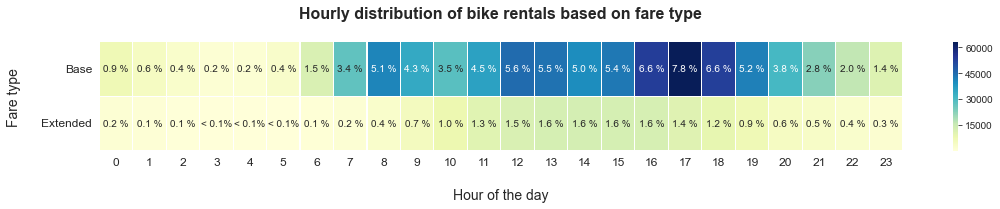

In [473]:
# plot heat map
plt.figure(figsize = [18, 2])
res = sb.heatmap(categorical_counts, annot = True, fmt = '.0f', annot_kws={'size':10}, linewidths=0.1, cmap="YlGnBu")
plt.yticks(rotation=0, fontsize="12", va="center")
plt.xticks(fontsize="12")
plt.title('Hourly distribution of bike rentals based on fare type\n', fontsize = 16, weight = 'bold')
plt.xlabel('\nHour of the day', fontsize=14)
plt.ylabel('Fare type\n', fontsize=14);

# convert annotations to percentages
for t in res.texts: 
    p = np.round(np.round(int(t.get_text())/bikeshare.shape[0], 4)*100, 1)
    if p < 0.1:
        t.set_text('< 0.1%')
    else:
        t.set_text(str(p)+' %');  

# savefig by passing (bbox_inches='tight'),which will adjust dhe figure to include all of the x and y labels
plt.savefig('plots/3.2.30.e Heat map of Trip rentals based on hour of the day over fare type.png', dpi=300, bbox_inches='tight')

**`Find average rentals based on the hour of the day:`**

> The `fare_type` needs to be converted into categorical datatype, otherwise the `groupby` method will ignore `NaN` rental values and inturn produce **incorrect** `avg. rental value`. Also use of `size()` method ignores the unused level combinations of the groups, hence use `count()` method.

In [474]:
hours_df = bikeshare.groupby([bikeshare["year"], 
                              bikeshare["month"],
                              bikeshare["day"],
                              bikeshare["hour"],
                              bikeshare["fare_type"]]).count()['trip_id'].reset_index(name='rentals')

hours_df['rentals'] = hours_df['rentals'].fillna(0).astype(int)
hours_df.head(10)

,year,month,day,hour,fare_type,rentals
0,2017,1,1,0,Base,7
1,2017,1,1,0,Extended,2
2,2017,1,1,1,Base,5
3,2017,1,1,1,Extended,0
4,2017,1,1,2,Base,7
5,2017,1,1,2,Extended,1
6,2017,1,1,3,Base,2
7,2017,1,1,3,Extended,0
8,2017,1,1,4,Base,1
9,2017,1,1,4,Extended,0


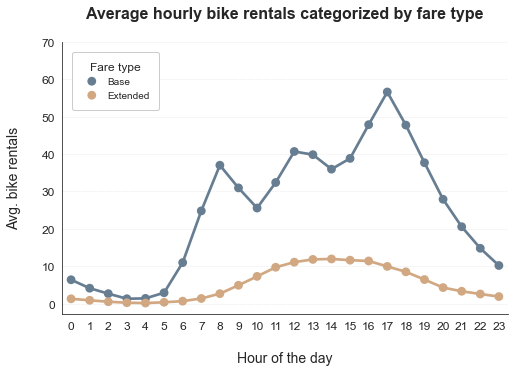

In [475]:
plt.figure(figsize=[8,5])
sb.set_style('white')
flatui = ['#577da1', '#eda668']
sb.set_palette(flatui, n_colors=2, desat=0.6)
base_color = sb.color_palette()[0]

sb.pointplot(data = hours_df, x = "hour", y = "rentals", linestyles = "-", hue = 'fare_type', 
             scale = 1, ci = None)
plt.title('Average hourly bike rentals categorized by fare type\n',  weight = 'bold', fontsize = 16)
plt.ylabel('Avg. bike rentals\n', fontsize = 14)
plt.xlabel('\nHour of the day', fontsize = 14)
plt.xticks(fontsize = 12)

# get ytick locs and rearrage them with respect to zero
locs, labels = plt.yticks()
hours_rental_avg_max = 70
y_tick_values = np.arange(0, hours_rental_avg_max+10, 10)
y_tick_names = ['{:0.0f}'.format(v) for v in y_tick_values]
plt.yticks(y_tick_values, y_tick_names, fontsize = 12)

plt.legend(scatterpoints=1, frameon=True, fancybox=True, shadow=False, ncol = 1, 
           framealpha = 1, borderpad=1, borderaxespad=1, loc = 'upper left', labelspacing=0.5,  
           title='Fare type', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5)

sb.despine(top=True, right=True, left=False, bottom=False);

for loc in y_tick_values:
    plt.axhline(loc, ls='--', color='grey', linewidth=0.5, alpha=0.2)

plt.savefig('plots/3.2.30.f Average hourly bike rentals categorized by fare type.png', dpi=300, bbox_inches='tight')

------

#### 3.2.31 Bivariate analysis of `bikeshare.daytime` and `trip_type` columns:

+ `Columns`: daytime, trip_type
+ `Data type`: (Categorical, ordered) and (Categorical, nominal)
+ `Plot`: Facet Grid, Violin plot, Box plot, Adapted Barchart

**`Stack plot:`**

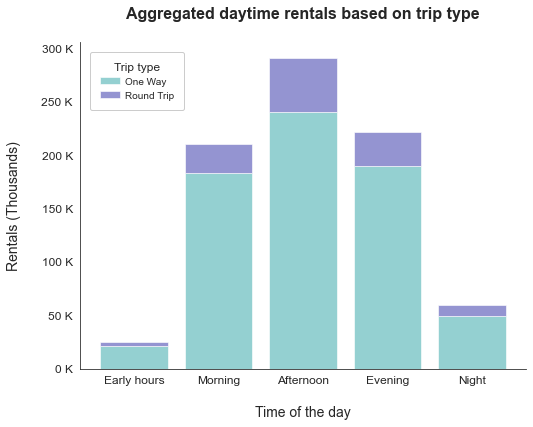

In [476]:
sb.set_style('white')
flatui = ["cyan", "blue"]
sb.set_palette(flatui, desat = 0.4)
plt.figure(figsize = [8, 6])

cat1_order = bikeshare.daytime.sort_values(ascending=True).unique()
cat2_order = bikeshare.trip_type.sort_values(ascending=True).unique()

# plot stacked plot
baselines = np.zeros(len(cat1_order))
# for each second-variable category:
for i in range(len(cat2_order)):
    # isolate the counts of the first category,
    cat2 = cat2_order[i]
    inner_counts = bikeshare[bikeshare['trip_type'] == cat2]['daytime'].value_counts()
    # then plot those counts on top of the accumulated baseline
    plt.bar(x = np.arange(len(cat1_order)), height = inner_counts[cat1_order].fillna(0),
            bottom = baselines, alpha =0.6)
    baselines += inner_counts[cat1_order].fillna(0)

# improve plot aesthetics
max_count = bikeshare.groupby([bikeshare['daytime']]).size().reset_index(name='rentals').max()['rentals']
y_tick_values = np.arange(0, max_count + 50000, 50000)
y_tick_names = ['{:0.0f} K'.format(v/1000) for v in y_tick_values]

plt.title('Aggregated daytime rentals based on trip type\n', weight = 'bold', fontsize = 16)
plt.xticks(np.arange(len(cat1_order)), cat1_order, fontsize=12)
plt.yticks(y_tick_values, y_tick_names, fontsize=12)
plt.xlabel('\nTime of the day', fontsize=14)
plt.ylabel('Rentals (Thousands)\n', fontsize=14)
plt.legend(cat2_order, scatterpoints=1, frameon=True, fancybox=True, shadow=False, ncol = 1, 
           framealpha = 1, borderpad=1, borderaxespad=1, loc = 'upper left', labelspacing=0.5,  
           title='Trip type', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5)

sb.despine();

# savefig by passing (bbox_inches='tight'),which will adjust dhe figure to include all of the x and y labels
plt.savefig('plots/3.2.31.a Stack plot of Trip rentals based on daytime over trip type.png', dpi=300, bbox_inches='tight')

**`Line Plot:`**

> The data needs some summirization by grouping together the respective variables. Then, reset the index and name the summerized data values accordingly.

In [477]:
categorical_counts = bikeshare.groupby([bikeshare['trip_type'], 
                                        bikeshare['daytime']]).size().reset_index(name='rentals')
categorical_counts.head(10)

,trip_type,daytime,rentals
0,One Way,Early hours,20805
1,One Way,Morning,182991
2,One Way,Afternoon,240777
3,One Way,Evening,190047
4,One Way,Night,49647
5,Round Trip,Early hours,4248
6,Round Trip,Morning,27306
7,Round Trip,Afternoon,50626
8,Round Trip,Evening,32184
9,Round Trip,Night,9958


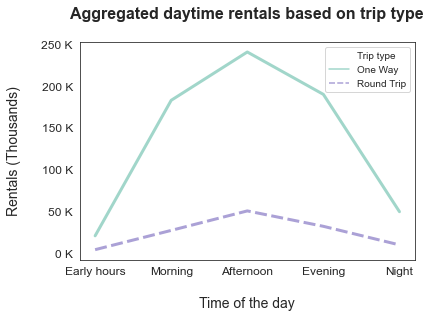

In [478]:
# set the palette as per requirement
flatui = ["#78ffe0", "#9178ff"]
sb.set_palette(flatui, n_colors = 2, desat = 0.4)
sb.set_style('white')

plt.figure(figsize = [6, 4])
max_count = categorical_counts.rentals.max()
y_tick_values = np.arange(0, max_count + 50000, 50000)
y_tick_names = ['{:0.0f} K'.format(v/1000) for v in y_tick_values]

# plot line plot
ax = sb.lineplot(data=categorical_counts, x = "daytime", y = "rentals", hue="trip_type", 
                 style="trip_type", err_style="bars", linewidth=3)
plt.title('Aggregated daytime rentals based on trip type\n', weight = 'bold', fontsize = 16)
plt.xticks(fontsize=12)
plt.yticks(y_tick_values, y_tick_names, fontsize=12)
plt.xlabel('\nTime of the day', fontsize=14)
plt.ylabel('Rentals (Thousands)\n', fontsize=14)
plt.legend(scatterpoints=1, frameon=True, fancybox=True, shadow=False, ncol = 1, framealpha = 1, 
           borderpad=1, borderaxespad=1, loc = 'upper left', labelspacing=0.5,  
           title='Trip type', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5)

# when a hue is used that appears as a legend title,
# remove this title, and replace it with custom title.
legend = ax.legend()
legend.texts[0].set_text("Trip type");

# savefig by passing (bbox_inches='tight'),which will adjust dhe figure to include all of the x and y labels
plt.savefig('plots/3.2.31.b Line plot of Trip rentals based on daytime over trip type.png', dpi=300, bbox_inches='tight')

**`Individual plots of aggregated distribution of daytime rentals over trip type:`**

<Figure size 576x288 with 0 Axes>

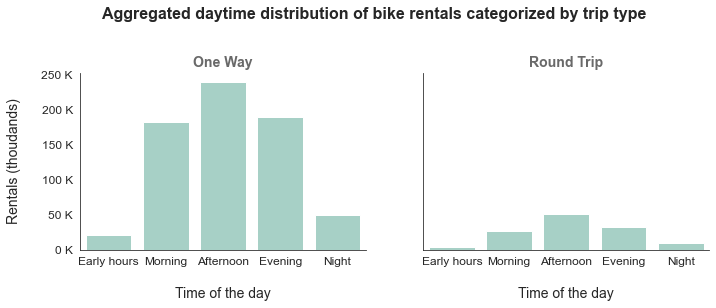

In [479]:
# set the palette as per requirement
flatui = ["#78ffe0", "#9178ff"]
sb.set_palette(flatui, n_colors = 2, desat = 0.4)
base_color = sb.color_palette()[0]
sb.set_style('white')
plt.figure(figsize = [8, 4])

# plot facet grid
g = sb.FacetGrid(data = bikeshare, col = 'trip_type', col_wrap = 2, height = 4, aspect = 1.2)
g.map(sb.countplot, "daytime", color = base_color, order = bikeshare.daytime.sort_values(ascending=True).unique())
g.fig.subplots_adjust(top=0.75)
g.fig.suptitle('Aggregated daytime distribution of bike rentals categorized by trip type\n', fontsize = 16, weight = 'bold')
g.set_titles('{col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# obtain y_ticks and convert them to a multiple of millions
# obtain the x_ticks and store them as a list
y_tick_names = []
x_tick_names = []
for ax in g.axes.flat:
    for y_label in ax.get_yticklabels():
        y_label_value = int(y_label.get_text())
        y_label_new_value = '{:0.0f} K'.format(y_label_value/1000)
        y_tick_names.append(y_label_new_value)
        
    for x_label in ax.get_xticklabels():
        x_label_value = x_label.get_text()
        x_tick_names.append(x_label_value)

g.set_yticklabels(y_tick_names, size = 12)
g.set_xticklabels(x_tick_names, size = 12)
g.set_xlabels('\nTime of the day', size = 14)
g.set_ylabels('Rentals (thoudands)\n', size = 14)

plt.subplots_adjust(wspace=0.2, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust dhe figure to include all of the x and y labels
plt.savefig('plots/3.2.31.c Facet grid of Trip rentals based on daytime over trip type.png', dpi=300, bbox_inches='tight')

> Let us plot more variety of graphs to observe the distribution of data and hidden insights.

**`Heat Map:`**

One alternative way of depicting the relationship between two categorical variables is through a **Heat map**. Heat maps were introduced earlier as the 2-d version of a histogram; here, we're using them as the 2-d version of a bar chart. The seaborn function `heatmap` is at home with this type of heat map implementation, but the input arguments are unlike most of the visualization functions. Instead of providing the original dataframe, we need to summarize the counts into a matrix that will then be plotted.

> Now lets make a pivot from the categorical dataset created earlier into a more appropriate data structure.

In [480]:
categorical_counts = categorical_counts.pivot(index = 'trip_type', columns = 'daytime', values = 'rentals')
categorical_counts

daytime,Early hours,Morning,Afternoon,Evening,Night
trip_type,,,,,
One Way,20805,182991,240777,190047,49647
Round Trip,4248,27306,50626,32184,9958


> The data is ready to be plotred as the `Heat map`.

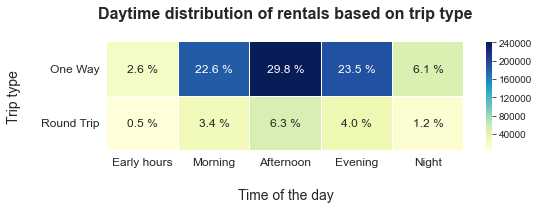

In [481]:
# plot heat map
plt.figure(figsize = [8, 2])
res = sb.heatmap(categorical_counts, annot = True, fmt = '.0f', annot_kws={'size':12}, linewidths=0.1, cmap="YlGnBu")
plt.yticks(rotation=0, fontsize="12", va="center")
plt.xticks(fontsize="12")
plt.title('Daytime distribution of rentals based on trip type\n', fontsize = 16, weight = 'bold')
plt.xlabel('\nTime of the day', fontsize=14)
plt.ylabel('Trip type\n', fontsize=14);

# convert annotations to percentages
for t in res.texts: 
    p = np.round(np.round(int(t.get_text())/bikeshare.shape[0], 4)*100, 1)
    t.set_text(str(p)+' %')
               
# savefig by passing (bbox_inches='tight'),which will adjust dhe figure to include all of the x and y labels
plt.savefig('plots/3.2.31.d Heat map of Trip rentals based on daytime over trip type.png', dpi=300, bbox_inches='tight')

**`Find average rentals based on the daytime:`**

> The `trip_type` needs to be converted into categorical datatype, otherwise the `groupby` method will ignore `NaN` rental values and inturn produce **incorrect** `avg. rental value`. Also use of `size()` method ignores the unused level combinations of the groups, hence use `count()` method.

In [482]:
daytime_df = bikeshare.groupby([bikeshare["year"], 
                                bikeshare["month"],
                                bikeshare["day"],
                                bikeshare["daytime"],
                                bikeshare["trip_type"]]).count()['trip_id'].reset_index(name='rentals')

daytime_df['rentals'] = daytime_df['rentals'].fillna(0).astype(int)
daytime_df.head(10)

,year,month,day,daytime,trip_type,rentals
0,2017,1,1,Early hours,One Way,24
1,2017,1,1,Early hours,Round Trip,3
2,2017,1,1,Morning,One Way,33
3,2017,1,1,Morning,Round Trip,2
4,2017,1,1,Afternoon,One Way,122
5,2017,1,1,Afternoon,Round Trip,21
6,2017,1,1,Evening,One Way,37
7,2017,1,1,Evening,Round Trip,13
8,2017,1,1,Night,One Way,12
9,2017,1,1,Night,Round Trip,3


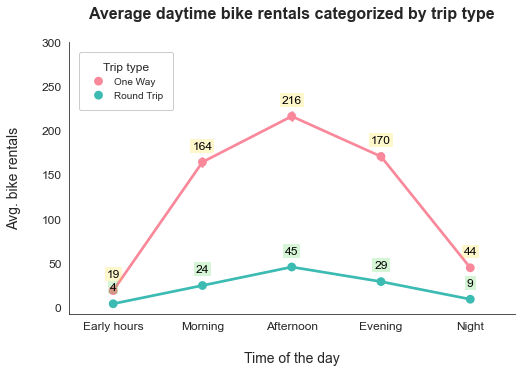

In [483]:
plt.figure(figsize=[8, 5])
sb.set_style('white')
flatui = ["#fff480"]
sb.set_palette(flatui, n_colors=1, desat=0.8)
base_color = sb.color_palette()[0]

sb.pointplot(data = daytime_df, x = "daytime", y = "rentals", linestyles = ['-', '-'], hue = 'trip_type')
plt.title('Average daytime bike rentals categorized by trip type\n',  weight = 'bold', fontsize = 16)
plt.ylabel('Avg. bike rentals\n', fontsize = 14)
plt.xlabel('\nTime of the day', fontsize = 14)
plt.xticks(fontsize = 12)

# get ytick locs and rearrage them with respect to zero
locs, labels = plt.yticks()
daytime_rental_avg_max = 300
y_tick_values = np.arange(0, daytime_rental_avg_max+50, 50)
y_tick_names = ['{:0.0f}'.format(v) for v in y_tick_values]
plt.yticks(y_tick_values, y_tick_names, fontsize = 12)

# add annotations
# -------------------------------------------------------
avg_rentals = daytime_df.groupby([daytime_df["trip_type"], daytime_df["daytime"]]).mean()['rentals'].reset_index()
avg_rentals_max = avg_rentals.rentals.max()
avg_rentals_oneway = avg_rentals.query(' trip_type == "One Way" ')
avg_rentals_roundtrip = avg_rentals.query(' trip_type == "Round Trip" ')

# get the current tick locations and labels
locs, labels = plt.xticks()

for categorical_df in [avg_rentals_oneway, avg_rentals_roundtrip]:
    clrs = ['gold' if trip == "One Way" else 'limegreen' for trip in categorical_df.trip_type ]
    # loop through each pair of locations and labels
    for loc, label, avg_rental_count, clr in zip(locs, labels, categorical_df.rentals, clrs):
        try:
            count = avg_rental_count
        except KeyError:
            count = 0   
        pct_string = '{:0.0f}'.format(count)
        if categorical_df.trip_type.unique() == "One Way":
            indent = 15
        else:
            indent = 15
        # print the annotation depending on the bar length
        plt.text(loc, count + indent, pct_string, ha = 'center', color = 'black', 
                 fontsize = 12, bbox=dict(pad=1.9,alpha=0.2,color='none',fc=clr))
# -------------------------------------------------------

plt.legend(scatterpoints=1, frameon=True, fancybox=True, shadow=False, ncol = 1, 
           framealpha = 1, borderpad=1, borderaxespad=1, loc = 'upper left', labelspacing=0.5,  
           title='Trip type', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5)

sb.despine(top=True, right=True, left=False, bottom=False);

# savefig by passing (bbox_inches='tight'),which will adjust dhe figure to include all of the x and y labels
plt.savefig('plots/3.2.31.e Average daytime bike rentals categorized by trip type.png', dpi=300, bbox_inches='tight')

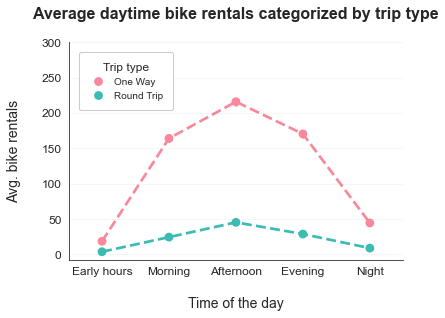

In [484]:
plt.figure(figsize=[6,4])
sb.set_style('white')
flatui = ["#fff480"]
sb.set_palette(flatui, n_colors=1, desat=0.8)
base_color = sb.color_palette()[0]

sb.pointplot(data = daytime_df, x = "daytime", y = "rentals", linestyles = ['--', '--'], hue = 'trip_type')
plt.title('Average daytime bike rentals categorized by trip type\n',  weight = 'bold', fontsize = 16)
plt.ylabel('Avg. bike rentals\n', fontsize = 14)
plt.xlabel('\nTime of the day', fontsize = 14)
plt.xticks(fontsize = 12)

# get ytick locs and rearrage them with respect to zero
locs, labels = plt.yticks()
daytime_rental_avg_max = 300
y_tick_values = np.arange(0, daytime_rental_avg_max+50, 50)
y_tick_names = ['{:0.0f}'.format(v) for v in y_tick_values]
plt.yticks(y_tick_values, y_tick_names, fontsize = 12)

plt.legend(scatterpoints=1, frameon=True, fancybox=True, shadow=False, ncol = 1, 
           framealpha = 1, borderpad=1, borderaxespad=1, loc = 'upper left', labelspacing=0.5,  
           title='Trip type', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5)

sb.despine(top=True, right=True, left=False, bottom=False);

for loc in y_tick_values:
    plt.axhline(loc, ls='--', color='grey', linewidth=0.5, alpha=0.2)

# savefig by passing (bbox_inches='tight'),which will adjust dhe figure to include all of the x and y labels
plt.savefig('plots/3.2.31.f Average daytime bike rentals categorized by trip type.png', dpi=300, bbox_inches='tight')

------------

#### 3.2.32 Bivariate analysis of `bikeshare.daytime` and `bike_type` columns:

+ `Columns`: daytime, bike_type
+ `Data type`: (Categorical, ordered) and (Categorical, nominal)
+ `Plot`: Facet Grid, Violin plot, Box plot, Adapted Barchart

**`Stack plot:`**

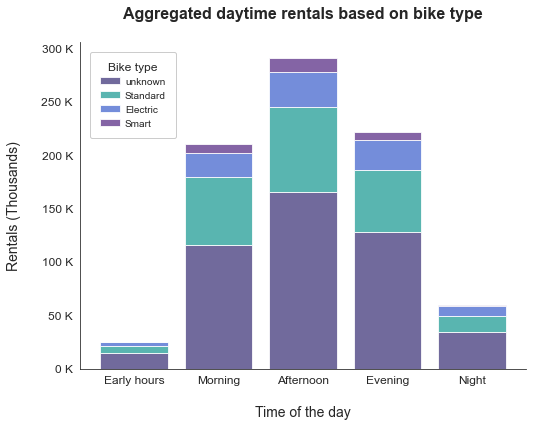

In [485]:
# Assign palette as per requirement
sb.set_style('white')
flatui = ["darkslateblue", "lightseagreen", "royalblue", "rebeccapurple"]
sb.set_palette(flatui, desat = 0.8)
plt.figure(figsize = [8, 6])

cat1_order = bikeshare.daytime.sort_values(ascending=True).unique()
cat2_order = bikeshare.bike_type.sort_values(ascending=True).unique()

# plot stacked plot
baselines = np.zeros(len(cat1_order))
# for each second-variable category:
for i in range(len(cat2_order)):
    # isolate the counts of the first category,
    cat2 = cat2_order[i]
    inner_counts = bikeshare[bikeshare['bike_type'] == cat2]['daytime'].value_counts()
    # then plot those counts on top of the accumulated baseline
    plt.bar(x = np.arange(len(cat1_order)), height = inner_counts[cat1_order].fillna(0),
            bottom = baselines, alpha = 0.8)
    baselines += inner_counts[cat1_order].fillna(0)

# improve plot aesthetics
max_count = bikeshare.groupby([bikeshare['daytime']]).size().reset_index(name='rentals').max()['rentals']
y_tick_values = np.arange(0, max_count + 50000, 50000)
y_tick_names = ['{:0.0f} K'.format(v/1000) for v in y_tick_values]

plt.title('Aggregated daytime rentals based on bike type\n', weight = 'bold', fontsize = 16)
plt.xticks(np.arange(len(cat1_order)), cat1_order, fontsize=12)
plt.yticks(y_tick_values, y_tick_names, fontsize=12)
plt.xlabel('\nTime of the day', fontsize=14)
plt.ylabel('Rentals (Thousands)\n', fontsize=14)
plt.legend(cat2_order, scatterpoints=1, frameon=True, fancybox=True, shadow=False, ncol = 1, 
           framealpha = 1, borderpad=1, borderaxespad=1, loc = 'upper left', labelspacing=0.5,  
           title='Bike type', title_fontsize=12, fontsize=10, facecolor='white',
           markerfirst=True, handlelength=2, handletextpad=0.5)

sb.despine();

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.32.a Stack plot of rentals based on bike type and daytime.png', dpi=300, bbox_inches='tight')

**`Line plot:`**

> The data needs some summirization by grouping together the respective variables. Then, reset the index and name the summerized data values accordingly.

In [486]:
categorical_counts = bikeshare.groupby([bikeshare['bike_type'], 
                                        bikeshare['daytime']]).size().reset_index(name='rentals')
categorical_counts.head(10)

,bike_type,daytime,rentals
0,unknown,Early hours,14743
1,unknown,Morning,115655
2,unknown,Afternoon,165743
3,unknown,Evening,128105
4,unknown,Night,34689
5,Standard,Early hours,6193
6,Standard,Morning,63661
7,Standard,Afternoon,79689
8,Standard,Evening,58125
9,Standard,Night,14475


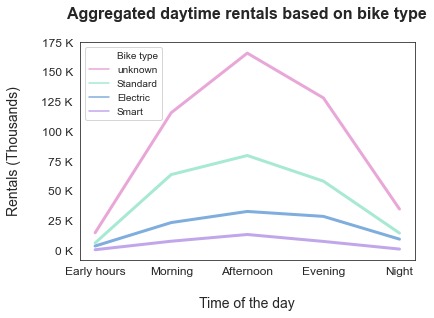

In [487]:
# set the palette as per requirement
sb.set_style('white')
# flatui = ["darkslateblue", "lightseagreen", "royalblue", "rebeccapurple"]
flatui = ['#ff91e2', '#91ffda', '#60acfc', '#bd91ff']
sb.set_palette(flatui, n_colors=4, desat=0.6)

plt.figure(figsize = [6, 4])
max_count = categorical_counts.rentals.max()
y_tick_values = np.arange(0, max_count + 25000, 25000)
y_tick_names = ['{:0.0f} K'.format(v/1000) for v in y_tick_values]

# plot line plot
ax = sb.lineplot(data = categorical_counts, x = "daytime", y = "rentals", hue="bike_type", linewidth=3)
plt.title('Aggregated daytime rentals based on bike type\n', weight = 'bold', fontsize = 16)
plt.xticks(fontsize=12)
plt.yticks(y_tick_values, y_tick_names, fontsize=12)
plt.xlabel('\nTime of the day', fontsize=14)
plt.ylabel('Rentals (Thousands)\n', fontsize=14)
plt.legend(scatterpoints=1, frameon=True, fancybox=True, shadow=False, ncol = 1, framealpha = 1, 
           borderpad=1, borderaxespad=1, loc = 'upper left', labelspacing=0.5,  
           title='Bike type', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5)

# when 'hue' is used, its label appears as legend title
# replace default title with custom title.
legend = ax.legend()
legend.texts[0].set_text("Bike type");

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.32.b Line plot of rentals based on bike type and daytime.png', dpi=300, bbox_inches='tight')

**`Individual plots of aggregated distribution of daytime rentals over bike type:`**

<Figure size 576x288 with 0 Axes>

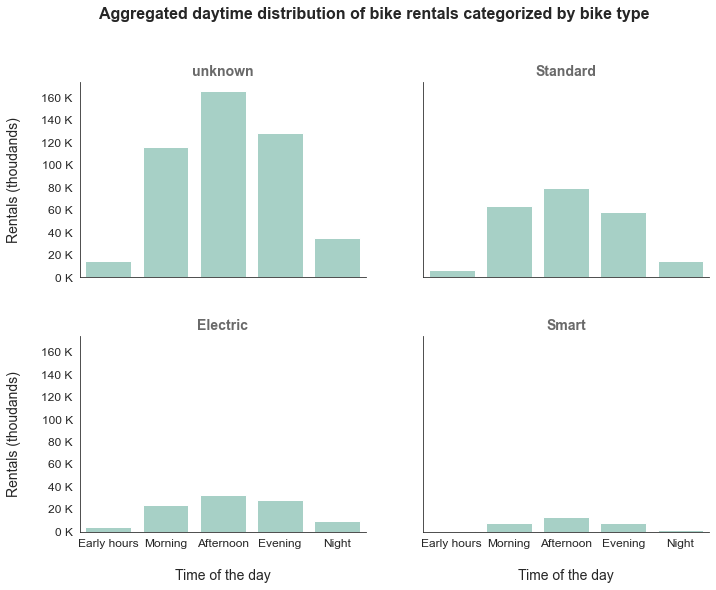

In [488]:
# set the palette as per requirement
flatui = ["#78ffe0", "#9178ff"]
sb.set_palette(flatui, n_colors = 2, desat = 0.4)
base_color = sb.color_palette()[0]
sb.set_style('white')
plt.figure(figsize = [8, 4])

# plot facet grid
g = sb.FacetGrid(data = bikeshare, col = 'bike_type', col_wrap = 2, height = 4, aspect = 1.2)
g.map(sb.countplot, "daytime", color = base_color, order = bikeshare.daytime.sort_values(ascending=True).unique())
g.fig.subplots_adjust(top=0.85)
g.fig.suptitle('Aggregated daytime distribution of bike rentals categorized by bike type\n', fontsize = 16, weight = 'bold')
g.set_titles('{col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# obtain y_ticks and convert them to a multiple of millions
# obtain the x_ticks and store them as a list
y_tick_names = []
x_tick_names = []
for ax in g.axes.flat:
    for y_label in ax.get_yticklabels():
        y_label_value = int(y_label.get_text())
        y_label_new_value = '{:0.0f} K'.format(y_label_value/1000)
        y_tick_names.append(y_label_new_value)
        
    for x_label in ax.get_xticklabels():
        x_label_value = x_label.get_text()
        x_tick_names.append(x_label_value)

g.set_yticklabels(y_tick_names, size = 12)
g.set_xticklabels(x_tick_names, size = 12)
g.set_xlabels('\nTime of the day', size = 14)
g.set_ylabels('Rentals (thoudands)\n', size = 14)

plt.subplots_adjust(wspace=0.2, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.32.c Facet grid of rentals based on bike type and daytime.png', dpi=300, bbox_inches='tight')

> Let us plot more variety of graphs to observe the distribution of data and hidden insights.

**`Heat Map:`**

> Now lets make a pivot from the categorical dataset created earlier into a more appropriate data structure.

In [489]:
categorical_counts = categorical_counts.pivot(index = 'bike_type', columns = 'daytime', values = 'rentals')
categorical_counts

daytime,Early hours,Morning,Afternoon,Evening,Night
bike_type,,,,,
unknown,14743,115655,165743,128105,34689
Standard,6193,63661,79689,58125,14475
Electric,3613,23333,32672,28523,9388
Smart,504,7648,13299,7478,1053


> The data is ready to be plotred as the `Heat map`.

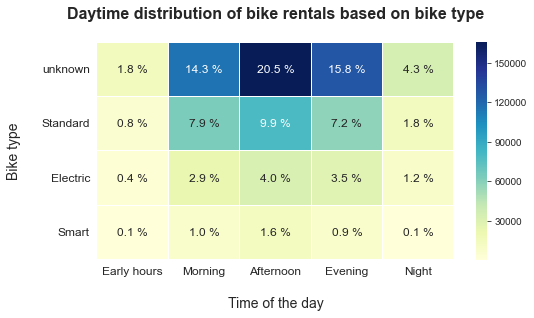

In [490]:
# plot heat map
plt.figure(figsize = [8, 4])
res = sb.heatmap(categorical_counts, annot = True, fmt = '.0f', annot_kws={'size':12}, linewidths=0.1, cmap="YlGnBu")
plt.yticks(rotation=0, fontsize="12", va="center")
plt.xticks(fontsize="12")
plt.title('Daytime distribution of bike rentals based on bike type\n', fontsize = 16, weight = 'bold')
plt.xlabel('\nTime of the day', fontsize=14)
plt.ylabel('Bike type\n', fontsize=14);

# convert annotations to percentages
for t in res.texts: 
    p = np.round(np.round(int(t.get_text())/bikeshare.shape[0], 4)*100, 1)
    t.set_text(str(p)+' %')
               
# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.32.d Heat map of rentals based on bike type and daytime.png', dpi=300, bbox_inches='tight')

**`Find average rentals based on the daytime:`**

> The `bike_type` needs to be converted into categorical datatype, otherwise the `groupby` method will ignore `NaN` rental values and inturn produce **incorrect** `avg. rental value`. Also use of `size()` method ignores the unused level combinations of the groups, hence use `count()` method.

In [491]:
daytime_df = bikeshare.groupby([bikeshare["year"], 
                                bikeshare["month"],
                                bikeshare["day"],
                                bikeshare["daytime"],
                                bikeshare["bike_type"]]).count()['trip_id'].reset_index(name='rentals')

daytime_df['rentals'] = daytime_df['rentals'].fillna(0).astype(int)
daytime_df.head(10)

,year,month,day,daytime,bike_type,rentals
0,2017,1,1,Early hours,unknown,27
1,2017,1,1,Early hours,Standard,0
2,2017,1,1,Early hours,Electric,0
3,2017,1,1,Early hours,Smart,0
4,2017,1,1,Morning,unknown,35
5,2017,1,1,Morning,Standard,0
6,2017,1,1,Morning,Electric,0
7,2017,1,1,Morning,Smart,0
8,2017,1,1,Afternoon,unknown,143
9,2017,1,1,Afternoon,Standard,0


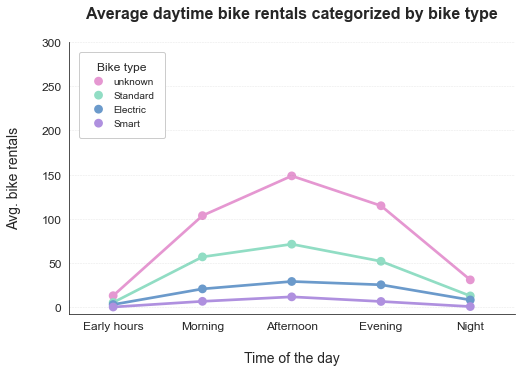

In [492]:
plt.figure(figsize=[8,5])
sb.set_style('white')
# flatui = ['#ff91e2', '#91ffda', '#60acfc', '#bd91ff']
flatui = ['#ff7ddd', '#77f7cc', '#4b99eb', '#aa75fa']
sb.set_palette(flatui, n_colors=4, desat=0.6)
base_color = sb.color_palette()[0]

sb.pointplot(data = daytime_df, x = "daytime", y = "rentals", linestyles = "-", hue = 'bike_type', 
             scale = 1, ci = None)
plt.title('Average daytime bike rentals categorized by bike type\n',  weight = 'bold', fontsize = 16)
plt.ylabel('Avg. bike rentals\n', fontsize = 14)
plt.xlabel('\nTime of the day', fontsize = 14)
plt.xticks(fontsize = 12)

# get ytick locs and rearrage them with respect to zero
locs, labels = plt.yticks()
daytime_rental_avg_max = 300
y_tick_values = np.arange(0, daytime_rental_avg_max+50, 50)
y_tick_names = ['{:0.0f}'.format(v) for v in y_tick_values]
plt.yticks(y_tick_values, y_tick_names, fontsize = 12)

plt.legend(scatterpoints=1, frameon=True, fancybox=True, shadow=False, ncol = 1, 
           framealpha = 1, borderpad=1, borderaxespad=1, loc = 'upper left', labelspacing=0.5,  
           title='Bike type', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5)

sb.despine(top=True, right=True, left=False, bottom=False);

for loc in y_tick_values:
    plt.axhline(loc, ls='--', color='grey', linewidth=0.5, alpha=0.2)

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.32.e Average daytime bike rentals categorized by bike type.png', dpi=300, bbox_inches='tight')

------

#### 3.2.33 Bivariate analysis of `bikeshare.daytime` and `pass_type` columns:

+ `Columns`: daytime, pass_type
+ `Data type`: (Categorical, ordered) and (Categorical, nominal)
+ `Plot`: Facet Grid, Violin plot, Box plot, Adapted Barchart

**`Stack plot:`**

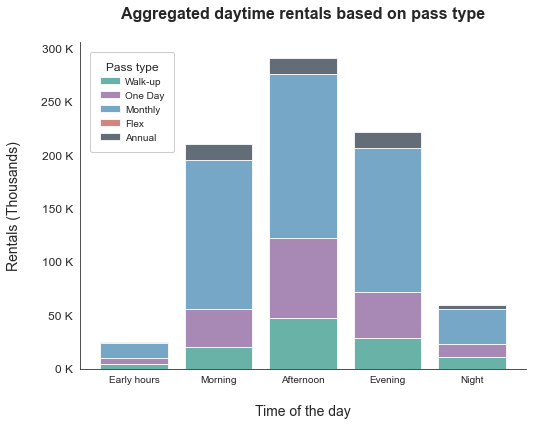

In [493]:
# Assign palette as per requirement
sb.set_style('white')
plt.figure(figsize = [8, 6])
flatui = ["#26bda7", "#9b59b6", "#3498db", "#e74c3c", "#34495e"]
sb.set_palette(flatui, n_colors=5, desat=0.6)

cat1_order = bikeshare.daytime.sort_values(ascending=True).unique()
cat2_order = bikeshare.pass_type.sort_values(ascending=True).unique()

# plot stacked plot
baselines = np.zeros(len(cat1_order))
# for each second-variable category:
for i in range(len(cat2_order)):
    # isolate the counts of the first category,
    cat2 = cat2_order[i]
    inner_counts = bikeshare[bikeshare['pass_type'] == cat2]['daytime'].value_counts()
    # then plot those counts on top of the accumulated baseline
    plt.bar(x = np.arange(len(cat1_order)), height = inner_counts[cat1_order].fillna(0),
            bottom = baselines, alpha = 0.8)
    baselines += inner_counts[cat1_order].fillna(0)

# improve plot aesthetics
max_count = bikeshare.groupby([bikeshare['daytime']]).size().reset_index(name='rentals').max()['rentals']
y_tick_values = np.arange(0, max_count + 50000, 50000)
y_tick_names = ['{:0.0f} K'.format(v/1000) for v in y_tick_values]

plt.title('Aggregated daytime rentals based on pass type\n', weight = 'bold', fontsize = 16)
plt.xticks(np.arange(len(cat1_order)), cat1_order)
plt.yticks(y_tick_values, y_tick_names, fontsize=12)
plt.xlabel('\nTime of the day', fontsize=14)
plt.ylabel('Rentals (Thousands)\n', fontsize=14)
plt.legend(cat2_order, scatterpoints=1, frameon=True, fancybox=True, shadow=False, ncol = 1, 
           framealpha = 1, borderpad=1, borderaxespad=1, loc = 'upper left', labelspacing=0.5,  
           title='Pass type', title_fontsize=12, fontsize=10, facecolor='white',
           markerfirst=True, handlelength=2, handletextpad=0.5)

sb.despine();

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.33.a Stack plot of rentals based on pass type and daytime.png', dpi=300, bbox_inches='tight')

**`Line plot:`**

> The data needs some summirization by grouping together the respective variables. Then, reset the index and name the summerized data values accordingly.

In [494]:
categorical_counts = bikeshare.groupby([bikeshare['pass_type'], 
                                        bikeshare['daytime']]).size().reset_index(name='rentals')
categorical_counts.head(10)

,pass_type,daytime,rentals
0,Walk-up,Early hours,4540
1,Walk-up,Morning,20344
2,Walk-up,Afternoon,47494
3,Walk-up,Evening,28995
4,Walk-up,Night,10705
5,One Day,Early hours,5062
6,One Day,Morning,35750
7,One Day,Afternoon,75017
8,One Day,Evening,42808
9,One Day,Night,12555


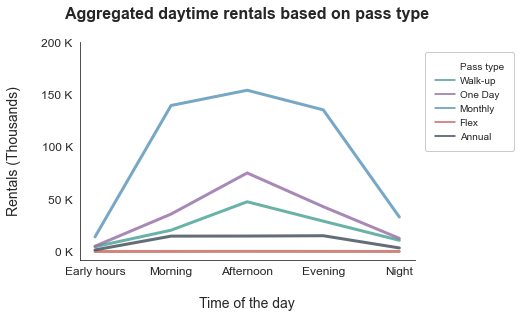

In [495]:
# set the palette as per requirement
sb.set_style('white')
flatui = ["#26bda7", "#9b59b6", "#3498db", "#e74c3c", "#34495e"]
sb.set_palette(flatui, n_colors=5, desat=0.6)

plt.figure(figsize = [6, 4])
max_count = categorical_counts.rentals.max()
y_tick_values = np.arange(0, max_count + 50000, 50000)
y_tick_names = ['{:0.0f} K'.format(v/1000) for v in y_tick_values]

# plot line plot
ax = sb.lineplot(data=categorical_counts, x = "daytime", y = "rentals", hue="pass_type", linewidth=3, alpha = 0.8)
plt.title('Aggregated daytime rentals based on pass type\n', weight = 'bold', fontsize = 16)
plt.xticks(fontsize=12)
plt.yticks(y_tick_values, y_tick_names, fontsize=12)
plt.xlabel('\nTime of the day', fontsize=14)
plt.ylabel('Rentals (Thousands)\n', fontsize=14)

# when 'hue' is used, its label appears as legend title
# replace default title with custom title.
ax.legend(scatterpoints=1, frameon=True, fancybox=True, shadow=False, ncol = 1, framealpha = 1, 
          borderpad=1, borderaxespad=1, loc = 'upper left', labelspacing=0.5, title_fontsize=12,
          fontsize=10, facecolor='white', markerfirst=True, handlelength=2,
          handletextpad=0.5, bbox_to_anchor=(1, 1)).texts[0].set_text("Pass type")

sb.despine();

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.33.b Line plot of rentals based on pass type and daytime.png', dpi=300, bbox_inches='tight')

**`Individual plots of aggregated distribution of daytime rentals over bike type:`**

<Figure size 576x288 with 0 Axes>

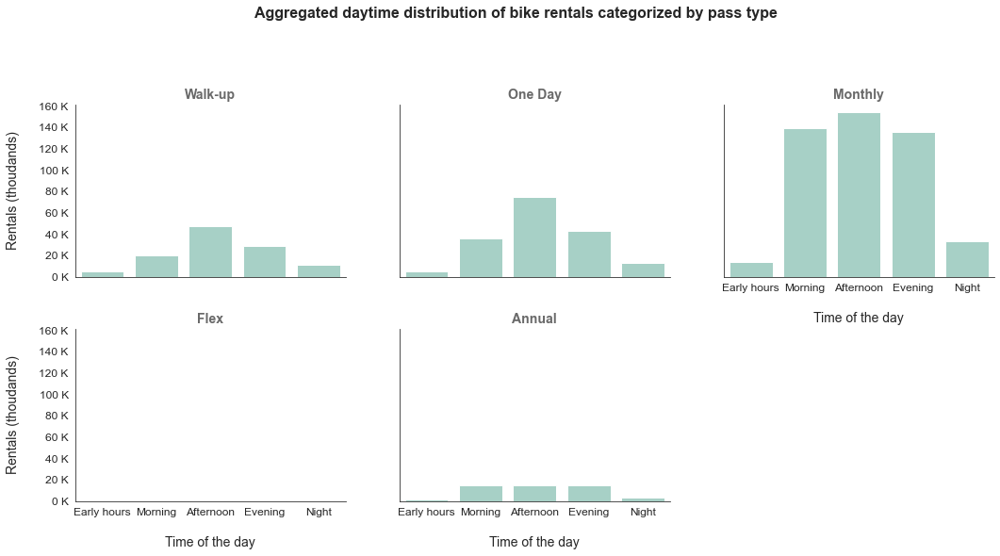

In [496]:
# set the palette as per requirement
flatui = ["#78ffe0", "#9178ff"]
sb.set_palette(flatui, n_colors = 2, desat = 0.4)
base_color = sb.color_palette()[0]
sb.set_style('white')
plt.figure(figsize = [8, 4])

# plot facet grid
g = sb.FacetGrid(data = bikeshare, col = 'pass_type', col_wrap = 3, height = 4, aspect = 1.2)
g.map(sb.countplot, "daytime", color = base_color, order = bikeshare.daytime.sort_values(ascending=True).unique())
g.fig.subplots_adjust(top=0.8)
g.fig.suptitle('Aggregated daytime distribution of bike rentals categorized by pass type\n', fontsize = 16, weight = 'bold')
g.set_titles('{col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# obtain y_ticks and convert them to a multiple of millions
# obtain the x_ticks and store them as a list
y_tick_names = []
x_tick_names = []
for ax in g.axes.flat:
    for y_label in ax.get_yticklabels():
        y_label_value = int(y_label.get_text())
        y_label_new_value = '{:0.0f} K'.format(y_label_value/1000)
        y_tick_names.append(y_label_new_value)
        
    for x_label in ax.get_xticklabels():
        x_label_value = x_label.get_text()
        x_tick_names.append(x_label_value)

g.set_yticklabels(y_tick_names, size = 12)
g.set_xticklabels(x_tick_names, size = 12)
g.set_xlabels('\nTime of the day', size = 14)
g.set_ylabels('Rentals (thoudands)\n', size = 14)

plt.subplots_adjust(wspace=0.2, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.33.c Facet grid of rentals based on pass type and daytime.png', dpi=300, bbox_inches='tight')

> Let us plot more variety of graphs to observe the distribution of data and hidden insights.

**`Heat Map:`**

> Now lets make a pivot from the categorical dataset created earlier into a more appropriate data structure.

In [497]:
categorical_counts = categorical_counts.pivot(index = 'pass_type', columns = 'daytime', values = 'rentals')
categorical_counts

daytime,Early hours,Morning,Afternoon,Evening,Night
pass_type,,,,,
Walk-up,4540,20344,47494,28995,10705
One Day,5062,35750,75017,42808,12555
Monthly,13952,139477,154017,135292,32928
Flex,3,45,119,73,23
Annual,1496,14681,14756,15063,3394


> The data is ready to be plotred as the `Heat map`.

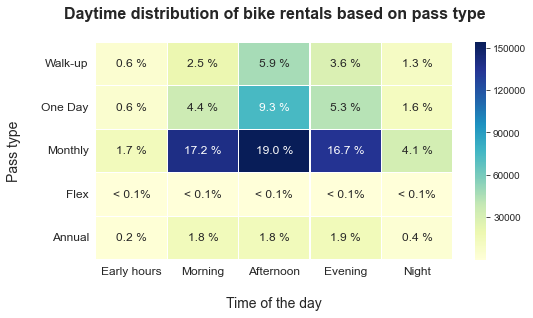

In [498]:
# plot heat map
plt.figure(figsize = [8, 4])
res = sb.heatmap(categorical_counts, annot = True, fmt = '.0f', annot_kws={'size':12}, linewidths=0.1, cmap="YlGnBu")
plt.yticks(rotation=0, fontsize="12", va="center")
plt.xticks(fontsize="12")
plt.title('Daytime distribution of bike rentals based on pass type\n', fontsize = 16, weight = 'bold')
plt.xlabel('\nTime of the day', fontsize=14)
plt.ylabel('Pass type\n', fontsize=14);

# convert annotations to percentages
for t in res.texts: 
    p = np.round(np.round(int(t.get_text())/bikeshare.shape[0], 4)*100, 1)
    if p < 0.1:
        t.set_text('< 0.1%')
    else:
        t.set_text(str(p)+' %');  

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.33.d Heat map of rentals based on pass type and daytime.png', dpi=300, bbox_inches='tight')

**`Find average rentals based on the daytime:`**

> The `pass_type` needs to be converted into categorical datatype, otherwise the `groupby` method will ignore `NaN` rental values and inturn produce **incorrect** `avg. rental value`. Also use of `size()` method ignores the unused level combinations of the groups, hence use `count()` method.

In [499]:
daytime_df = bikeshare.groupby([bikeshare["year"], 
                                bikeshare["month"],
                                bikeshare["day"],
                                bikeshare["daytime"],
                                bikeshare["pass_type"]]).count()['trip_id'].reset_index(name='rentals')

daytime_df['rentals'] = daytime_df['rentals'].fillna(0).astype(int)
daytime_df.head(10)

,year,month,day,daytime,pass_type,rentals
0,2017,1,1,Early hours,Walk-up,19
1,2017,1,1,Early hours,One Day,0
2,2017,1,1,Early hours,Monthly,8
3,2017,1,1,Early hours,Flex,0
4,2017,1,1,Early hours,Annual,0
5,2017,1,1,Morning,Walk-up,15
6,2017,1,1,Morning,One Day,0
7,2017,1,1,Morning,Monthly,19
8,2017,1,1,Morning,Flex,0
9,2017,1,1,Morning,Annual,1


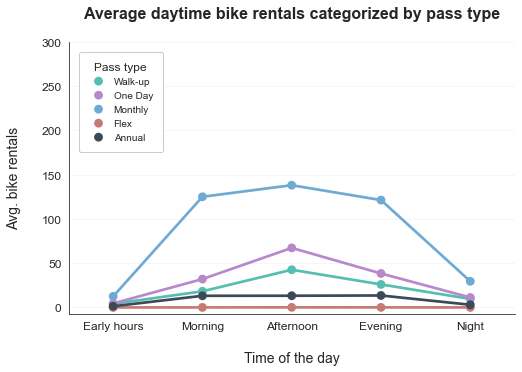

In [500]:
plt.figure(figsize=[8,5])
sb.set_style('white')
# flatui = ["#26bda7", "#9b59b6", "#3498db", "#e74c3c", "#34495e"]
flatui = ["#34e0c7", "#c271e3", "#4cb1f5", "#e06458", "#34495e"]
sb.set_palette(flatui, n_colors=5, desat=0.6)
base_color = sb.color_palette()[0]

sb.pointplot(data = daytime_df, x = "daytime", y = "rentals", linestyles = "-", hue = 'pass_type', 
             scale = 1, ci = None)
plt.title('Average daytime bike rentals categorized by pass type\n',  weight = 'bold', fontsize = 16)
plt.ylabel('Avg. bike rentals\n', fontsize = 14)
plt.xlabel('\nTime of the day', fontsize = 14)
plt.xticks(fontsize = 12)

# get ytick locs and rearrage them with respect to zero
locs, labels = plt.yticks()
daytime_rental_avg_max = 300
y_tick_values = np.arange(0, daytime_rental_avg_max+50, 50)
y_tick_names = ['{:0.0f}'.format(v) for v in y_tick_values]
plt.yticks(y_tick_values, y_tick_names, fontsize = 12)

plt.legend(scatterpoints=1, frameon=True, fancybox=True, shadow=False, ncol = 1, 
           framealpha = 1, borderpad=1, borderaxespad=1, loc = 'upper left', labelspacing=0.5,  
           title='Pass type', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5)

sb.despine(top=True, right=True, left=False, bottom=False);

for loc in y_tick_values:
    plt.axhline(loc, ls='--', color='grey', linewidth=0.5, alpha=0.2)

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.33.e Average daytime bike rentals categorized by pass type.png', dpi=300, bbox_inches='tight')

---

#### 3.2.34 Bivariate analysis of `bikeshare.daytime` and `fare_type` columns:

+ `Columns`: daytime, fare_type
+ `Data type`: (Categorical, ordered) and (Categorical, nominal)
+ `Plot`: Facet Grid, Violin plot, Box plot, Adapted Barchart

**`Stack plot:`**

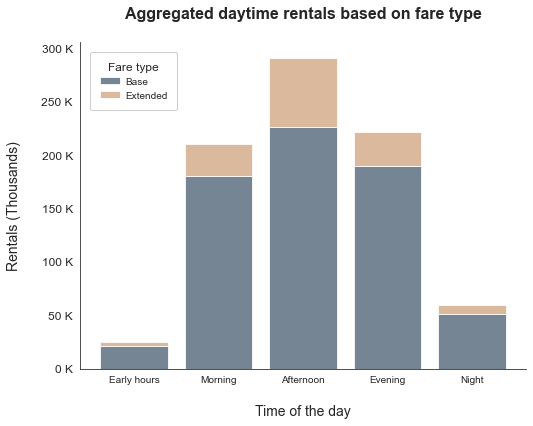

In [501]:
# Assign palette as per requirement
sb.set_style('white')
plt.figure(figsize = [8, 6])
flatui = ['#466887', '#eda668']
sb.set_palette(flatui, n_colors=2, desat=0.6)

cat1_order = bikeshare.daytime.sort_values(ascending=True).unique()
cat2_order = bikeshare.fare_type.sort_values(ascending=True).unique()

# plot stacked plot
baselines = np.zeros(len(cat1_order))
# for each second-variable category:
for i in range(len(cat2_order)):
    # isolate the counts of the first category,
    cat2 = cat2_order[i]
    inner_counts = bikeshare[bikeshare['fare_type'] == cat2]['daytime'].value_counts()
    # then plot those counts on top of the accumulated baseline
    plt.bar(x = np.arange(len(cat1_order)), height = inner_counts[cat1_order].fillna(0),
            bottom = baselines, alpha = 0.8)
    baselines += inner_counts[cat1_order].fillna(0)

# improve plot aesthetics
max_count = bikeshare.groupby([bikeshare['daytime']]).size().reset_index(name='rentals').max()['rentals']
y_tick_values = np.arange(0, max_count + 50000, 50000)
y_tick_names = ['{:0.0f} K'.format(v/1000) for v in y_tick_values]

plt.title('Aggregated daytime rentals based on fare type\n', weight = 'bold', fontsize = 16)
plt.xticks(np.arange(len(cat1_order)), cat1_order)
plt.yticks(y_tick_values, y_tick_names, fontsize=12)
plt.xlabel('\nTime of the day', fontsize=14)
plt.ylabel('Rentals (Thousands)\n', fontsize=14)
plt.legend(cat2_order, scatterpoints=1, frameon=True, fancybox=True, shadow=False, ncol = 1, 
           framealpha = 1, borderpad=1, borderaxespad=1, loc = 'upper left', labelspacing=0.5,  
           title='Fare type', title_fontsize=12, fontsize=10, facecolor='white',
           markerfirst=True, handlelength=2, handletextpad=0.5)

sb.despine();

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.34.a Stack plot of rentals based on fare type and daytime.png', dpi=300, bbox_inches='tight')

**`Line plot:`**

> The data needs some summirization by grouping together the respective variables. Then, reset the index and name the summerized data values accordingly.

In [502]:
categorical_counts = bikeshare.groupby([bikeshare['fare_type'], 
                                        bikeshare['daytime']]).size().reset_index(name='rentals')
categorical_counts.head(10)

,fare_type,daytime,rentals
0,Base,Early hours,21086
1,Base,Morning,180477
2,Base,Afternoon,226730
3,Base,Evening,189612
4,Base,Night,50884
5,Extended,Early hours,3967
6,Extended,Morning,29820
7,Extended,Afternoon,64673
8,Extended,Evening,32619
9,Extended,Night,8721


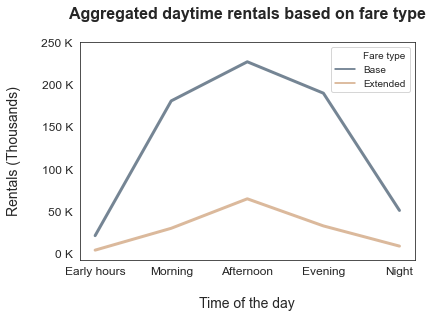

In [503]:
# set the palette as per requirement
sb.set_style('white')
flatui = ['#466887', '#eda668']
sb.set_palette(flatui, n_colors=2, desat=0.6)

plt.figure(figsize = [6, 4])
max_count = categorical_counts.rentals.max()
y_tick_values = np.arange(0, max_count + 50000, 50000)
y_tick_names = ['{:0.0f} K'.format(v/1000) for v in y_tick_values]

# plot line plot
ax = sb.lineplot(data=categorical_counts, x = "daytime", y = "rentals", hue="fare_type", linewidth=3, alpha = 0.8)
plt.title('Aggregated daytime rentals based on fare type\n', weight = 'bold', fontsize = 16)
plt.xticks(fontsize=12)
plt.yticks(y_tick_values, y_tick_names, fontsize=12)
plt.xlabel('\nTime of the day', fontsize=14)
plt.ylabel('Rentals (Thousands)\n', fontsize=14)
ax.legend(scatterpoints=1, frameon=True, fancybox=True, shadow=False, ncol = 1, framealpha = 1, 
           borderpad=1, borderaxespad=1, loc = 'upper right', labelspacing=0.5,  
           title='Fare type', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5)

# when 'hue' is used, its label appears as legend title
# replace default title with custom title.
legend = ax.legend()
legend.texts[0].set_text("Fare type");

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.34.b Line plot of rentals based on fare type and daytime.png', dpi=300, bbox_inches='tight')

**`Individual plots of aggregated distribution of daytime rentals over bike type:`**

<Figure size 576x288 with 0 Axes>

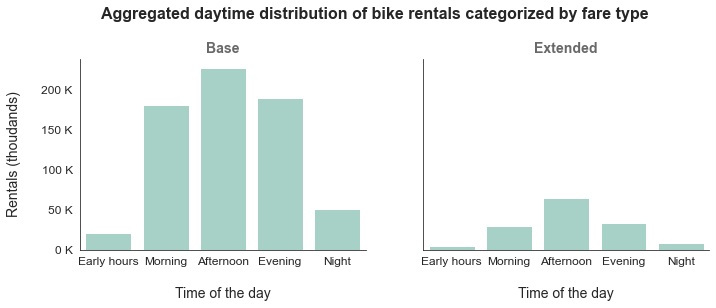

In [504]:
# set the palette as per requirement
flatui = ["#78ffe0", "#9178ff"]
sb.set_palette(flatui, n_colors = 2, desat = 0.4)
base_color = sb.color_palette()[0]
sb.set_style('white')
plt.figure(figsize = [8, 4])

# plot facet grid
g = sb.FacetGrid(data = bikeshare, col = 'fare_type', col_wrap = 2, height = 4, aspect = 1.2)
g.map(sb.countplot, "daytime", color = base_color, order = bikeshare.daytime.sort_values(ascending=True).unique())
g.fig.subplots_adjust(top=0.8)
g.fig.suptitle('Aggregated daytime distribution of bike rentals categorized by fare type\n', fontsize = 16, weight = 'bold')
g.set_titles('{col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# obtain y_ticks and convert them to a multiple of millions
# obtain the x_ticks and store them as a list
y_tick_names = []
x_tick_names = []
for ax in g.axes.flat:
    for y_label in ax.get_yticklabels():
        y_label_value = int(y_label.get_text())
        y_label_new_value = '{:0.0f} K'.format(y_label_value/1000)
        y_tick_names.append(y_label_new_value)
        
    for x_label in ax.get_xticklabels():
        x_label_value = x_label.get_text()
        x_tick_names.append(x_label_value)

g.set_yticklabels(y_tick_names, size = 12)
g.set_xticklabels(x_tick_names, size = 12)
g.set_xlabels('\nTime of the day', size = 14)
g.set_ylabels('Rentals (thoudands)\n', size = 14)

plt.subplots_adjust(wspace=0.2, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.34.c Facet grid of rentals based on fare type and daytime.png', dpi=300, bbox_inches='tight')

> Let us plot more variety of graphs to observe the distribution of data and hidden insights.

**`Heat Map:`**

> Now lets make a pivot from the categorical dataset created earlier into a more appropriate data structure.

In [505]:
categorical_counts = categorical_counts.pivot(index = 'fare_type', columns = 'daytime', values = 'rentals')
categorical_counts

daytime,Early hours,Morning,Afternoon,Evening,Night
fare_type,,,,,
Base,21086,180477,226730,189612,50884
Extended,3967,29820,64673,32619,8721


> The data is ready to be plotred as the `Heat map`.

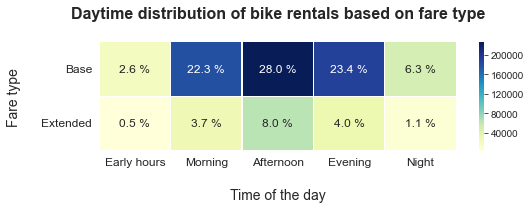

In [506]:
# plot heat map
plt.figure(figsize = [8, 2])
res = sb.heatmap(categorical_counts, annot = True, fmt = '.0f', annot_kws={'size':12}, linewidths=0.1, cmap="YlGnBu")
plt.yticks(rotation=0, fontsize="12", va="center")
plt.xticks(fontsize="12")
plt.title('Daytime distribution of bike rentals based on fare type\n', fontsize = 16, weight = 'bold')
plt.xlabel('\nTime of the day', fontsize=14)
plt.ylabel('Fare type\n', fontsize=14);

# convert annotations to percentages
for t in res.texts: 
    p = np.round(np.round(int(t.get_text())/bikeshare.shape[0], 4)*100, 1)
    if p < 0.1:
        t.set_text('< 0.1%')
    else:
        t.set_text(str(p)+' %');  

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.34.d Heat map of rentals based on fare type and daytime.png', dpi=300, bbox_inches='tight')

**`Find average rentals based on the daytime:`**

> The `fare_type` needs to be converted into categorical datatype, otherwise the `groupby` method will ignore `NaN` rental values and inturn produce **incorrect** `avg. rental value`. Also use of `size()` method ignores the unused level combinations of the groups, hence use `count()` method.

In [507]:
daytime_df = bikeshare.groupby([bikeshare["year"], 
                                bikeshare["month"],
                                bikeshare["day"],
                                bikeshare["daytime"],
                                bikeshare["fare_type"]]).count()['trip_id'].reset_index(name='rentals')

daytime_df['rentals'] = daytime_df['rentals'].fillna(0).astype(int)
daytime_df.head(10)

,year,month,day,daytime,fare_type,rentals
0,2017,1,1,Early hours,Base,24
1,2017,1,1,Early hours,Extended,3
2,2017,1,1,Morning,Base,26
3,2017,1,1,Morning,Extended,9
4,2017,1,1,Afternoon,Base,112
5,2017,1,1,Afternoon,Extended,31
6,2017,1,1,Evening,Base,42
7,2017,1,1,Evening,Extended,8
8,2017,1,1,Night,Base,7
9,2017,1,1,Night,Extended,8


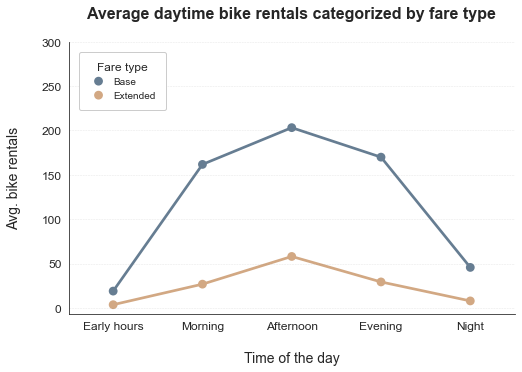

In [508]:
plt.figure(figsize=[8,5])
sb.set_style('white')
flatui = ['#577da1', '#eda668']
sb.set_palette(flatui, n_colors=2, desat=0.6)
base_color = sb.color_palette()[0]

sb.pointplot(data = daytime_df, x = "daytime", y = "rentals", linestyles = "-", hue = 'fare_type', 
             scale = 1, ci = None)
plt.title('Average daytime bike rentals categorized by fare type\n',  weight = 'bold', fontsize = 16)
plt.ylabel('Avg. bike rentals\n', fontsize = 14)
plt.xlabel('\nTime of the day', fontsize = 14)
plt.xticks(fontsize = 12)

# get ytick locs and rearrage them with respect to zero
locs, labels = plt.yticks()
daytime_rental_avg_max = 300
y_tick_values = np.arange(0, daytime_rental_avg_max+50, 50)
y_tick_names = ['{:0.0f}'.format(v) for v in y_tick_values]
plt.yticks(y_tick_values, y_tick_names, fontsize = 12)

plt.legend(scatterpoints=1, frameon=True, fancybox=True, shadow=False, ncol = 1, 
           framealpha = 1, borderpad=1, borderaxespad=1, loc = 'upper left', labelspacing=0.5,  
           title='Fare type', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5)

sb.despine(top=True, right=True, left=False, bottom=False);

for loc in y_tick_values:
    plt.axhline(loc, ls='--', color='grey', linewidth=0.5, alpha=0.2)

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.34.e Average daytime bike rentals categorized by fare type.png', dpi=300, bbox_inches='tight')

----

#### 3.2.35 Bivariate analysis of `bikeshare.day` and `trip_type` columns:

+ `Columns`: day, trip_type
+ `Data type`: (Categorical, ordered) and (Categorical, nominal)
+ `Plot`: Facet Grid, Violin plot, Box plot, Adapted Barchart

**`Stack plot:`**

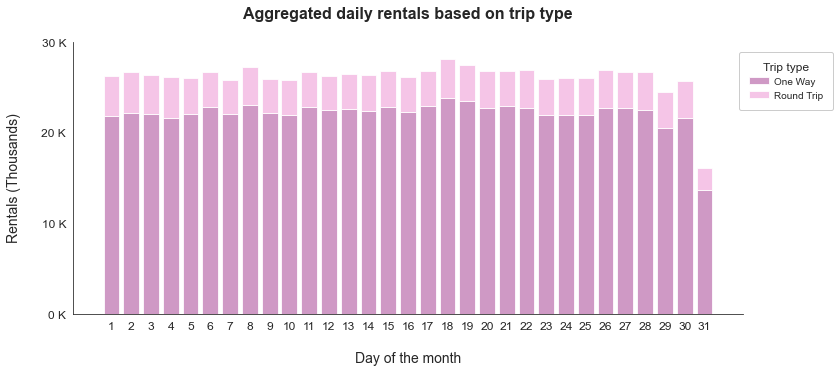

In [509]:
sb.set_style('white')
sb.set_palette(palette = 'colorblind', n_colors = 10, desat = 1)
flatui = [sb.color_palette()[4], sb.color_palette()[6]]
sb.set_palette(flatui, desat = 0.8)
plt.figure(figsize = [12, 5])

cat1_order = bikeshare.day.sort_values(ascending=True).unique()
cat2_order = bikeshare.trip_type.sort_values(ascending=True).unique()

# plot stacked plot
baselines = np.zeros(len(cat1_order))
# for each second-variable category:
for i in range(len(cat2_order)):
    # isolate the counts of the first category,
    cat2 = cat2_order[i]
    inner_counts = bikeshare[bikeshare['trip_type'] == cat2]['day'].value_counts()
    # then plot those counts on top of the accumulated baseline
    plt.bar(x = np.arange(len(cat1_order)), height = inner_counts[cat1_order].fillna(0),
            bottom = baselines, alpha =0.8)
    baselines += inner_counts[cat1_order].fillna(0)

# improve plot aesthetics
max_count = bikeshare.groupby([bikeshare['day']]).size().reset_index(name='rentals').max()['rentals']
y_tick_values = np.arange(0, max_count + 10000, 10000)
y_tick_names = ['{:0.0f} K'.format(v/1000) for v in y_tick_values]

plt.title('Aggregated daily rentals based on trip type\n', weight = 'bold', fontsize = 16)
plt.xticks(np.arange(len(cat1_order)), cat1_order, fontsize=12)
plt.yticks(y_tick_values, y_tick_names, fontsize=12)
plt.xlabel('\nDay of the month', fontsize=14)
plt.ylabel('Rentals (Thousands)\n', fontsize=14)
plt.legend(cat2_order, scatterpoints=1, frameon=True, fancybox=True, shadow=False, ncol = 1, 
           framealpha = 1, borderpad=1, borderaxespad=1, loc = 'upper right', labelspacing=0.5,  
           title='Trip type', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(1.15, 1))

sb.despine();

# savefig by passing (bbox_inches='tight'),which will adjust dhe figure to include all of the x and y labels
plt.savefig('plots/3.2.35.a Stack plot of Trip rentals based on trip type and day of the month.png', dpi=300, bbox_inches='tight')

**`Line Plot:`**

> The data needs some summirization by grouping together the respective variables. Then, reset the index and name the summerized data values accordingly.

In [510]:
categorical_counts = bikeshare.groupby([bikeshare['trip_type'], 
                                        bikeshare['day']]).size().reset_index(name='rentals')
categorical_counts.head(10)

,trip_type,day,rentals
0,One Way,1,21819
1,One Way,2,22189
2,One Way,3,21983
3,One Way,4,21599
4,One Way,5,22052
5,One Way,6,22757
6,One Way,7,22020
7,One Way,8,23037
8,One Way,9,22087
9,One Way,10,21895


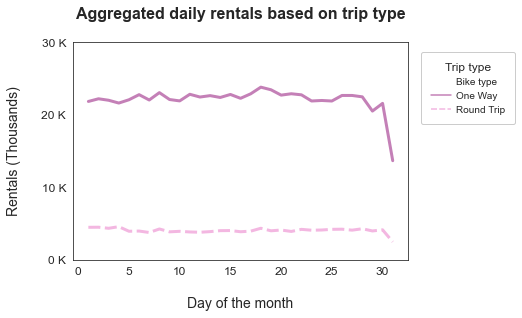

In [511]:
# set the palette as per requirement
sb.set_palette(palette = 'colorblind', n_colors = 10, desat = 1)
flatui = [sb.color_palette()[4], sb.color_palette()[6]]
sb.set_palette(flatui, desat = 0.8)
sb.set_style('white')

plt.figure(figsize = [6, 4])
max_count = categorical_counts.rentals.max()
y_tick_values = np.arange(0, max_count + 10000, 10000)
y_tick_names = ['{:0.0f} K'.format(v/1000) for v in y_tick_values]

# plot line plot
ax = sb.lineplot(data=categorical_counts, x = "day", y = "rentals", hue="trip_type", 
                 style="trip_type", err_style="bars", linewidth=3)
plt.title('Aggregated daily rentals based on trip type\n', weight = 'bold', fontsize = 16)
plt.xticks(fontsize=12)
plt.yticks(y_tick_values, y_tick_names, fontsize=12)
plt.xlabel('\nDay of the month', fontsize=14)
plt.ylabel('Rentals (Thousands)\n', fontsize=14)

# when a hue is used that appears as a legend title,
# remove this title, and replace it with custom title.
ax.legend(scatterpoints=1, frameon=True, fancybox=True, shadow=False, ncol = 1, framealpha = 1, 
          borderpad=1, borderaxespad=1, loc = 'upper right', labelspacing=0.5,  
          title='Trip type', title_fontsize=12, fontsize=10, facecolor='white', markerfirst=True, 
          handlelength=2, handletextpad=0.5, bbox_to_anchor=(1.35, 1)).texts[0].set_text("Bike type");

# savefig by passing (bbox_inches='tight'),which will adjust dhe figure to include all of the x and y labels
plt.savefig('plots/3.2.35.b Line plot of Trip rentals based on trip type and day of the month.png', dpi=300, bbox_inches='tight')

**`Individual plots of aggregated distribution of daily rentals over trip type:`**

<Figure size 864x288 with 0 Axes>

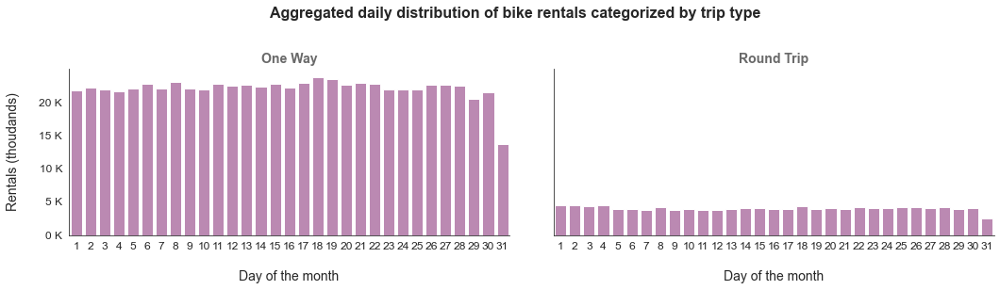

In [512]:
# set the palette as per requirement
sb.set_palette(palette = 'colorblind', n_colors = 10, desat = 1)
flatui = [sb.color_palette()[4], sb.color_palette()[6]]
sb.set_palette(flatui, desat = 0.8)
base_color = sb.color_palette()[0]
sb.set_style('white')
plt.figure(figsize = [12, 4])

# plot facet grid
g = sb.FacetGrid(data = bikeshare, col = 'trip_type', col_wrap = 2, height = 4, aspect = 1.8)
g.map(sb.countplot, "day", color = base_color, order = bikeshare.day.sort_values(ascending=True).unique())
g.fig.subplots_adjust(top=0.75)
g.fig.suptitle('Aggregated daily distribution of bike rentals categorized by trip type\n', fontsize = 16, weight = 'bold')
g.set_titles('{col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# obtain y_ticks and convert them to a multiple of millions
# obtain the x_ticks and store them as a list
y_tick_names = []
x_tick_names = []
for ax in g.axes.flat:
    for y_label in ax.get_yticklabels():
        y_label_value = int(y_label.get_text())
        y_label_new_value = '{:0.0f} K'.format(y_label_value/1000)
        y_tick_names.append(y_label_new_value)
        
    for x_label in ax.get_xticklabels():
        x_label_value = x_label.get_text()
        x_tick_names.append(x_label_value)

g.set_yticklabels(y_tick_names, size = 12)
g.set_xticklabels(x_tick_names, size = 12)
g.set_xlabels('\nDay of the month', size = 14)
g.set_ylabels('Rentals (thoudands)\n', size = 14)

plt.subplots_adjust(wspace=0.1, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust dhe figure to include all of the x and y labels
plt.savefig('plots/3.2.35.c Facet grid of Trip rentals based on trip type and day of the month.png', dpi=300, bbox_inches='tight')

> Let us plot more variety of graphs to observe the distribution of data and hidden insights.

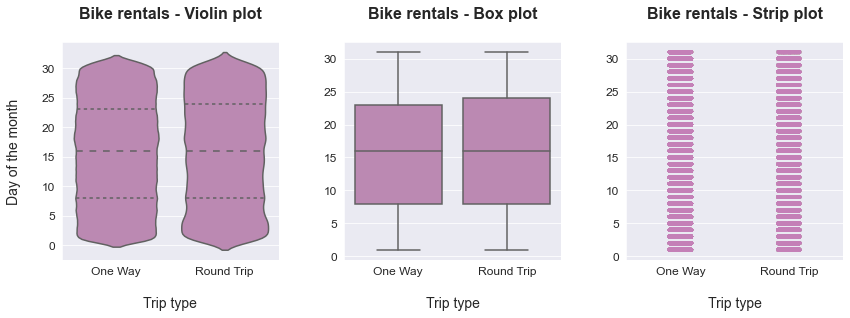

In [513]:
plt.figure(figsize = [14, 4])
sb.set_style('darkgrid')

# set the palette as per requirement
sb.set_palette(palette = 'colorblind', n_colors = 10, desat = 1)
flatui = [sb.color_palette()[4], sb.color_palette()[6]]
sb.set_palette(flatui, desat = 0.8)
base_color = sb.color_palette()[0]

# left plot: violin plot
plt.subplot(1, 3, 1)
sb.violinplot(data = bikeshare, x = 'trip_type', y = 'day', inner = 'quartile',
              color = base_color)
plt.title('Bike rentals - Violin plot\n',  weight = 'bold', fontsize = 16)
plt.xlabel('\nTrip type', fontsize = 14)
plt.ylabel('Day of the month\n', fontsize = 14)
plt.xticks(fontsize = 12)
plt.yticks(fontsize = 12)

# center plot: box plot
plt.subplot(1, 3, 2)
sb.boxplot(data = bikeshare, x = 'trip_type', y = 'day', color = base_color)
plt.title('Bike rentals - Box plot\n',  weight = 'bold', fontsize = 16)
plt.xlabel('\nTrip type', fontsize = 14)
plt.ylabel('', fontsize = 14)
plt.xticks(fontsize = 12)
plt.yticks(fontsize = 12)

# right plot: strip chart
plt.subplot(1, 3, 3)
sb.stripplot(data = bikeshare, x = "trip_type", y = "day", alpha = 0.002, color = base_color)
plt.title('Bike rentals - Strip plot\n',  weight = 'bold', fontsize = 16)
plt.xlabel('\nTrip type', fontsize = 14)
plt.ylabel('', fontsize = 14);
plt.xticks(fontsize = 12)
plt.yticks(fontsize = 12)

plt.subplots_adjust(wspace=0.3, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust dhe figure to include all of the x and y labels
plt.savefig('plots/3.2.35.d Distribution of Trip rentals based on trip type and day of the month.png', dpi=300, bbox_inches='tight')

**`Heat Map:`**

One alternative way of depicting the relationship between two categorical variables is through a **Heat map**. Heat maps were introduced earlier as the 2-d version of a histogram; here, we're using them as the 2-d version of a bar chart. The seaborn function `heatmap` is at home with this type of heat map implementation, but the input arguments are unlike most of the visualization functions. Instead of providing the original dataframe, we need to summarize the counts into a matrix that will then be plotted.

> Now lets make a pivot from the categorical dataset created earlier into a more appropriate data structure.

In [514]:
categorical_counts = categorical_counts.pivot(index = 'trip_type', columns = 'day', values = 'rentals')
categorical_counts

day,1,2,3,4,5,6,7,8,9,10,...,22,23,24,25,26,27,28,29,30,31
trip_type,,,,,,,,,,,,,,,,,,,,,
One Way,21819,22189,21983,21599,22052,22757,22020,23037,22087,21895,...,22734,21883,21954,21880,22647,22646,22456,20495,21555,13644
Round Trip,4456,4467,4320,4544,3911,3939,3739,4224,3831,3902,...,4173,4053,4084,4175,4195,4063,4257,3953,4110,2448


> The data is ready to be plotred as the `Heat map`.

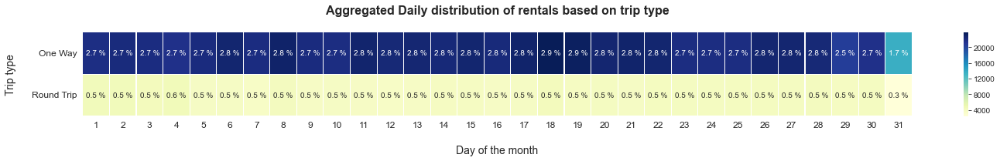

In [515]:
# plot heat map
plt.figure(figsize = [24, 2])
res = sb.heatmap(categorical_counts, annot = True, fmt = '.0f', annot_kws={'size':10}, linewidths=0.1, cmap="YlGnBu")
plt.yticks(rotation=0, fontsize="12", va="center")
plt.xticks(fontsize="12")
plt.title('Aggregated Daily distribution of rentals based on trip type\n', fontsize = 16, weight = 'bold')
plt.xlabel('\nDay of the month', fontsize=14)
plt.ylabel('Trip type\n', fontsize=14);

# convert annotations to percentages
for t in res.texts: 
    p = np.round(np.round(int(t.get_text())/bikeshare.shape[0], 4)*100, 1)
    t.set_text(str(p)+' %')
               
# savefig by passing (bbox_inches='tight'),which will adjust dhe figure to include all of the x and y labels
plt.savefig('plots/3.2.35.e Heat map of Trip rentals based on trip type and day of the month.png', dpi=300, bbox_inches='tight')

**`Find average rentals based on the day of the month:`**

> The `trip_type` needs to be converted into categorical datatype, otherwise the `groupby` method will ignore `NaN` rental values and inturn produce **incorrect** `avg. rental value`. Also use of `size()` method ignores the unused level combinations of the groups, hence use `count()` method.

> However, the above plots depicts that the rentals decrease during the end of the month, especially on 31'st of the month. The bike rentals are categorized over the day of the month, the distribution is calculated based on the cummulative summation of day over 3 years but not individual month. Hence, there are only 21 occurances of day 31st, while other days has an occurance of 36 over the time period of 3 years (2017-2019), except for days 29 and 30 which counts to 33 due to absence in February month. This denotes that the rate of rentals is actually high on 31st compared to other days.

> Hence in order to compute the average daily rentals based on the occurances  of the day in any month, apply `size()` meathod instead of `count()` method to take missing dates into account.

In [516]:
day_df = bikeshare.groupby([bikeshare["year"], 
                            bikeshare["month"],
                            bikeshare["day"],
                            bikeshare["trip_type"]]).size().reset_index(name='rentals')
day_df.head(10)

,year,month,day,trip_type,rentals
0,2017,1,1,One Way,228
1,2017,1,1,Round Trip,42
2,2017,1,2,One Way,228
3,2017,1,2,Round Trip,31
4,2017,1,3,One Way,288
5,2017,1,3,Round Trip,39
6,2017,1,4,One Way,325
7,2017,1,4,Round Trip,25
8,2017,1,5,One Way,211
9,2017,1,5,Round Trip,20


In [517]:
cat_order = day_df.day.sort_values(ascending=True).unique()
print('Day - Occurances')
day_df.day.value_counts()[cat_order]

Day - Occurances


1     72
2     72
3     72
4     72
5     72
6     72
7     72
8     72
9     72
10    72
11    72
12    72
13    72
14    72
15    72
16    72
17    72
18    72
19    72
20    72
21    72
22    72
23    72
24    72
25    72
26    72
27    72
28    72
29    66
30    66
31    42
Name: day, dtype: int64

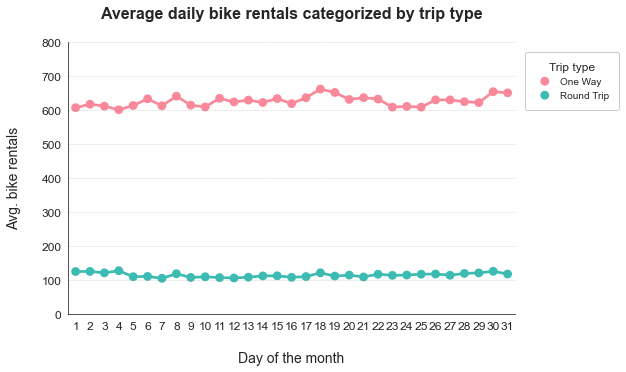

In [518]:
plt.figure(figsize=[8, 5])
sb.set_style('white')
flatui = ["#fff480"]
sb.set_palette(flatui, n_colors=1, desat=0.8)
base_color = sb.color_palette()[0]

sb.pointplot(data = day_df, x = "day", y = "rentals", linestyles = ['-', '-'], hue = 'trip_type', ci = None)
plt.title('Average daily bike rentals categorized by trip type\n',  weight = 'bold', fontsize = 16)
plt.ylabel('Avg. bike rentals\n', fontsize = 14)
plt.xlabel('\nDay of the month', fontsize = 14)
plt.xticks(fontsize = 12)

# get ytick locs and rearrage them with respect to zero
locs, labels = plt.yticks()
daily_rental_avg_max = 800
y_tick_values = np.arange(0, daily_rental_avg_max+100, 100)
y_tick_names = ['{:0.0f}'.format(v) for v in y_tick_values]
plt.yticks(y_tick_values, y_tick_names, fontsize = 12)

plt.legend(scatterpoints=1, frameon=True, fancybox=True, shadow=False, ncol = 1, 
           framealpha = 1, borderpad=1, borderaxespad=1, loc = 'upper left', labelspacing=0.5,  
           title='Trip type', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(1, 1))

sb.despine(top=True, right=True, left=False, bottom=False);

for loc in y_tick_values:
    plt.axhline(loc, ls='--', color='grey', linewidth=0.5, alpha=0.4)

# savefig by passing (bbox_inches='tight'),which will adjust dhe figure to include all of the x and y labels
plt.savefig('plots/3.2.35.f Average daily bike rentals categorized by trip type.png', dpi=300, bbox_inches='tight')

------------

#### 3.2.36 Bivariate analysis of `bikeshare.day` and `bike_type` columns:

+ `Columns`: day, bike_type
+ `Data type`: (Categorical, ordered) and (Categorical, nominal)
+ `Plot`: Facet Grid, Violin plot, Box plot, Adapted Barchart

**`Stack plot:`**

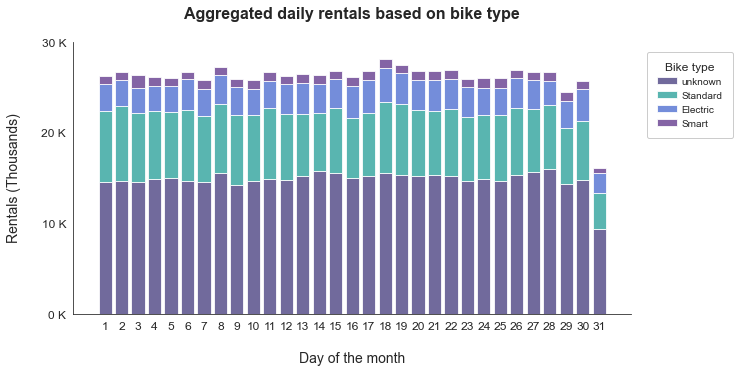

In [519]:
# Assign palette as per requirement
sb.set_style('white')
flatui = ["darkslateblue", "lightseagreen", "royalblue", "rebeccapurple"]
sb.set_palette(flatui, desat = 0.8)
plt.figure(figsize = [10, 5])

cat1_order = bikeshare.day.sort_values(ascending=True).unique()
cat2_order = bikeshare.bike_type.sort_values(ascending=True).unique()

# plot stacked plot
baselines = np.zeros(len(cat1_order))
# for each second-variable category:
for i in range(len(cat2_order)):
    # isolate the counts of the first category,
    cat2 = cat2_order[i]
    inner_counts = bikeshare[bikeshare['bike_type'] == cat2]['day'].value_counts()
    # then plot those counts on top of the accumulated baseline
    plt.bar(x = np.arange(len(cat1_order)), height = inner_counts[cat1_order].fillna(0),
            bottom = baselines, alpha = 0.8)
    baselines += inner_counts[cat1_order].fillna(0)

# improve plot aesthetics
max_count = bikeshare.groupby([bikeshare['day']]).size().reset_index(name='rentals').max()['rentals']
y_tick_values = np.arange(0, max_count + 10000, 10000)
y_tick_names = ['{:0.0f} K'.format(v/1000) for v in y_tick_values]

plt.title('Aggregated daily rentals based on bike type\n', weight = 'bold', fontsize = 16)
plt.xticks(np.arange(len(cat1_order)), cat1_order, fontsize=12)
plt.yticks(y_tick_values, y_tick_names, fontsize=12)
plt.xlabel('\nDay of the month', fontsize=14)
plt.ylabel('Rentals (Thousands)\n', fontsize=14)
plt.legend(cat2_order, scatterpoints=1, frameon=True, fancybox=True, shadow=False, ncol = 1, 
           framealpha = 1, borderpad=1, borderaxespad=1, loc = 'upper right', labelspacing=0.5,  
           title='Bike type', title_fontsize=12, fontsize=10, facecolor='white',
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(1.2, 1))

sb.despine();

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.36.a Stack plot of rentals based on bike type and day of the month.png', dpi=300, bbox_inches='tight')

**`Line plot:`**

> The data needs some summirization by grouping together the respective variables. Then, reset the index and name the summerized data values accordingly.

In [520]:
categorical_counts = bikeshare.groupby([bikeshare['bike_type'], 
                                        bikeshare['day']]).size().reset_index(name='rentals')
categorical_counts.head(10)

,bike_type,day,rentals
0,unknown,1,14498
1,unknown,2,14590
2,unknown,3,14523
3,unknown,4,14821
4,unknown,5,14924
5,unknown,6,14614
6,unknown,7,14499
7,unknown,8,15545
8,unknown,9,14170
9,unknown,10,14641


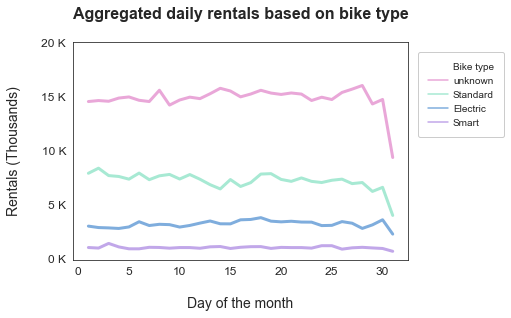

In [521]:
# set the palette as per requirement
sb.set_style('white')
flatui = ['#ff91e2', '#91ffda', '#60acfc', '#bd91ff']
sb.set_palette(flatui, n_colors=4, desat=0.6)

plt.figure(figsize = [6, 4])
max_count = categorical_counts.rentals.max()
y_tick_values = np.arange(0, max_count + 5000, 5000)
y_tick_names = ['{:0.0f} K'.format(v/1000) for v in y_tick_values]

# plot line plot
ax = sb.lineplot(data = categorical_counts, x = "day", y = "rentals", hue="bike_type", linewidth=3)
plt.title('Aggregated daily rentals based on bike type\n', weight = 'bold', fontsize = 16)
plt.xticks(fontsize=12)
plt.yticks(y_tick_values, y_tick_names, fontsize=12)
plt.xlabel('\nDay of the month', fontsize=14)
plt.ylabel('Rentals (Thousands)\n', fontsize=14)
ax.legend(scatterpoints=1, frameon=True, fancybox=True, shadow=False, ncol = 1, framealpha = 1, 
          borderpad=1, borderaxespad=1, loc = 'upper left', labelspacing=0.5,  
          title='', title_fontsize=12, fontsize=10, facecolor='white', markerfirst=True, 
          handlelength=2, handletextpad=0.5, bbox_to_anchor=(1, 1)).texts[0].set_text("Bike type");

# sb.despine();

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.36.b Line plot of rentals based on bike type and day of the month.png', dpi=300, bbox_inches='tight')

**`Individual plots of aggregated distribution of daily rentals over bike type:`**

<Figure size 576x288 with 0 Axes>

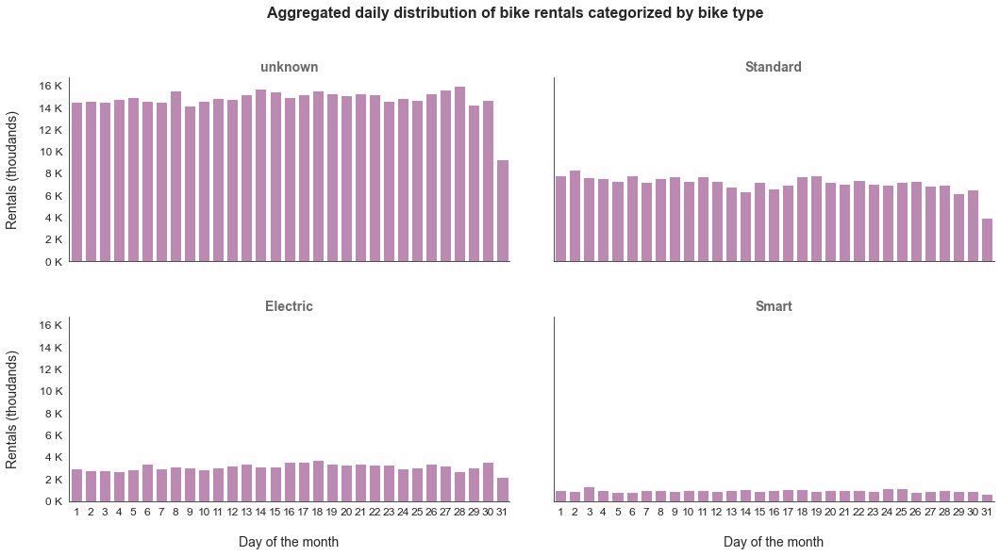

In [522]:
# set the palette as per requirement
sb.set_palette(palette = 'colorblind', n_colors = 10, desat = 1)
flatui = [sb.color_palette()[4], sb.color_palette()[6]]
sb.set_palette(flatui, desat = 0.8)
base_color = sb.color_palette()[0]
sb.set_style('white')
plt.figure(figsize = [8, 4])

# plot facet grid
g = sb.FacetGrid(data = bikeshare, col = 'bike_type', col_wrap = 2, height = 4, aspect = 1.8)
g.map(sb.countplot, "day", color = base_color, order = bikeshare.day.sort_values(ascending=True).unique())
g.fig.subplots_adjust(top=0.85)
g.fig.suptitle('Aggregated daily distribution of bike rentals categorized by bike type\n', fontsize = 16, weight = 'bold')
g.set_titles('{col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# obtain y_ticks and convert them to a multiple of millions
# obtain the x_ticks and store them as a list
y_tick_names = []
x_tick_names = []
for ax in g.axes.flat:
    for y_label in ax.get_yticklabels():
        y_label_value = int(y_label.get_text())
        y_label_new_value = '{:0.0f} K'.format(y_label_value/1000)
        y_tick_names.append(y_label_new_value)
        
    for x_label in ax.get_xticklabels():
        x_label_value = x_label.get_text()
        x_tick_names.append(x_label_value)

g.set_yticklabels(y_tick_names, size = 12)
g.set_xticklabels(x_tick_names, size = 12)
g.set_xlabels('\nDay of the month', size = 14)
g.set_ylabels('Rentals (thoudands)\n', size = 14)

plt.subplots_adjust(wspace=0.1, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.36.c Facet grid of rentals based on bike type and day of the month.png', dpi=300, bbox_inches='tight')

> Let us plot more variety of graphs to observe the distribution of data and hidden insights.

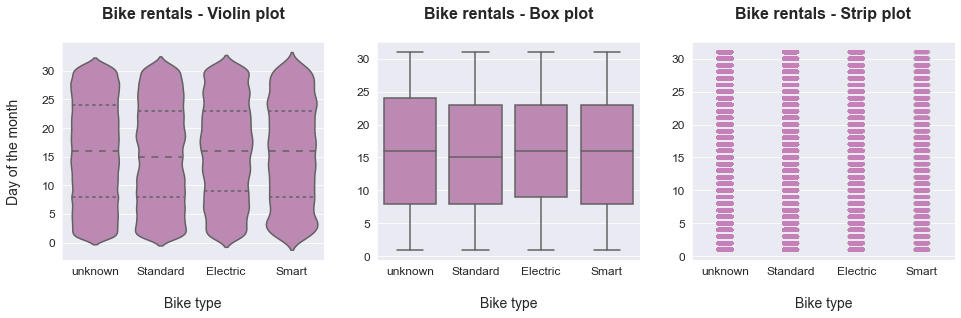

In [523]:
plt.figure(figsize = [16, 4])
sb.set_style('darkgrid')
# set the palette as per requirement
sb.set_palette(palette = 'colorblind', n_colors = 10, desat = 1)
flatui = [sb.color_palette()[4], sb.color_palette()[6]]
sb.set_palette(flatui, desat = 0.8)
base_color = sb.color_palette()[0]

# left plot: violin plot
plt.subplot(1, 3, 1)
sb.violinplot(data = bikeshare, x = 'bike_type', y = 'day', inner = 'quartile',
              color = base_color)
plt.title('Bike rentals - Violin plot\n',  weight = 'bold', fontsize = 16)
plt.xlabel('\nBike type', fontsize = 14)
plt.ylabel('Day of the month\n', fontsize = 14)
plt.xticks(fontsize = 12)
plt.yticks(fontsize = 12)

# center plot: box plot
plt.subplot(1, 3, 2)
sb.boxplot(data = bikeshare, x = 'bike_type', y = 'day', color = base_color)
plt.title('Bike rentals - Box plot\n',  weight = 'bold', fontsize = 16)
plt.xlabel('\nBike type', fontsize = 14)
plt.ylabel('', fontsize = 14)
plt.xticks(fontsize = 12)
plt.yticks(fontsize = 12)

# right plot: strip chart
plt.subplot(1, 3, 3)
sb.stripplot(data = bikeshare, x = "bike_type", y = "day", alpha = 0.002, color = base_color)
plt.title('Bike rentals - Strip plot\n',  weight = 'bold', fontsize = 16)
plt.xlabel('\nBike type', fontsize = 14)
plt.ylabel('', fontsize = 14);
plt.xticks(fontsize = 12)
plt.yticks(fontsize = 12)

plt.subplots_adjust(wspace=0.2, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust dhe figure to include all of the x and y labels
plt.savefig('plots/3.2.36.d Distribution of Trip rentals based on bike type and day of the month.png', dpi=300, bbox_inches='tight')

**`Heat Map:`**

> Now lets make a pivot from the categorical dataset created earlier into a more appropriate data structure.

In [524]:
categorical_counts = categorical_counts.pivot(index = 'bike_type', columns = 'day', values = 'rentals')
categorical_counts

day,1,2,3,4,5,6,7,8,9,10,...,22,23,24,25,26,27,28,29,30,31
bike_type,,,,,,,,,,,,,,,,,,,,,
unknown,14498,14590,14523,14821,14924,14614,14499,15545,14170,14641,...,15190,14595,14898,14685,15340,15648,15986,14273,14691,9312
Standard,7850,8323,7637,7555,7307,7869,7258,7615,7745,7319,...,7420,7102,6995,7204,7307,6893,6993,6170,6548,3945
Electric,2955,2822,2790,2739,2879,3361,3010,3124,3092,2868,...,3331,3323,3004,3026,3373,3224,2743,3071,3543,2214
Smart,972,921,1353,1028,853,852,992,977,911,969,...,966,916,1141,1140,822,944,991,934,883,621


> The data is ready to be plotred as the `Heat map`.

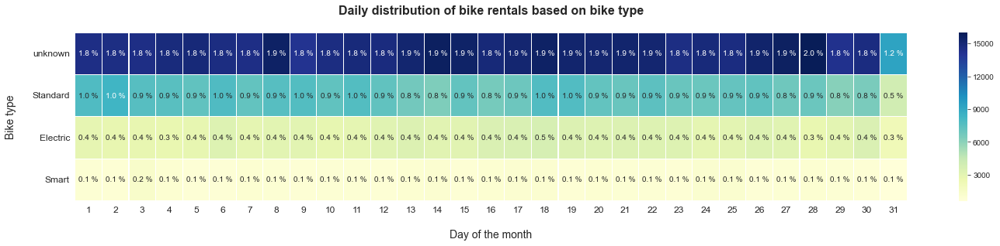

In [525]:
# plot heat map
plt.figure(figsize = [24, 4])
res = sb.heatmap(categorical_counts, annot = True, fmt = '.0f', annot_kws={'size':10}, linewidths=0.1, cmap="YlGnBu")
plt.yticks(rotation=0, fontsize="12", va="center")
plt.xticks(fontsize="12")
plt.title('Daily distribution of bike rentals based on bike type\n', fontsize = 16, weight = 'bold')
plt.xlabel('\nDay of the month', fontsize=14)
plt.ylabel('Bike type\n', fontsize=14);

# convert annotations to percentages
for t in res.texts: 
    p = np.round(np.round(int(t.get_text())/bikeshare.shape[0], 4)*100, 1)
    t.set_text(str(p)+' %')
               
# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.36.e Heat map of rentals based on bike type and day of the month.png', dpi=300, bbox_inches='tight')

**`Find average rentals based on the daytime:`**

> The `bike_type` needs to be converted into categorical datatype, otherwise the `groupby` method will ignore `NaN` rental values and inturn produce **incorrect** `avg. rental value`. Also use of `size()` method ignores the unused level combinations of the groups, hence use `count()` method.

> However, the above plots depicts that the rentals decrease during the end of the month, especially on 31'st of the month. The bike rentals are categorized over the day of the month, the distribution is calculated based on the cummulative summation of day over 3 years but not individual month. Hence, there are only 21 occurances of day 31st, while other days has an occurance of 36 over the time period of 3 years (2017-2019), except for days 29 and 30 which counts to 33 due to absence in February month. This denotes that the rate of rentals is actually high on 31st compared to other days.

> Hence in order to compute the average daily rentals based on the occurances  of the day in any month, apply `size()` meathod instead of `count()` method to take missing dates into account.

In [526]:
day_df = bikeshare.groupby([bikeshare["year"], 
                            bikeshare["month"],
                            bikeshare["day"],
                            bikeshare["bike_type"]]).size().reset_index(name='rentals')
day_df.head(10)

,year,month,day,bike_type,rentals
0,2017,1,1,unknown,270
1,2017,1,2,unknown,259
2,2017,1,3,unknown,327
3,2017,1,4,unknown,350
4,2017,1,5,unknown,231
5,2017,1,6,unknown,361
6,2017,1,7,unknown,277
7,2017,1,8,unknown,417
8,2017,1,9,unknown,306
9,2017,1,10,unknown,245


In [527]:
cat_order = day_df.day.sort_values(ascending=True).unique()
print('Day - Occurances')
day_df.day.value_counts()[cat_order]

Day - Occurances


1     56
2     56
3     56
4     56
5     56
6     56
7     56
8     57
9     58
10    57
11    57
12    57
13    57
14    57
15    57
16    57
17    56
18    57
19    57
20    57
21    58
22    56
23    56
24    57
25    56
26    56
27    56
28    57
29    53
30    54
31    34
Name: day, dtype: int64

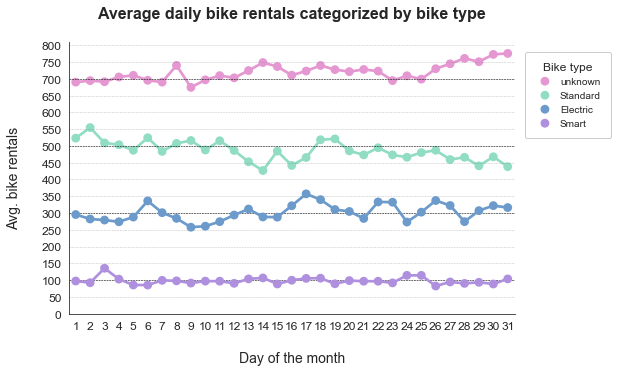

In [528]:
plt.figure(figsize=[8,5])
sb.set_style('white')
# flatui = ['#ff91e2', '#91ffda', '#60acfc', '#bd91ff']
flatui = ['#ff7ddd', '#77f7cc', '#4b99eb', '#aa75fa']
sb.set_palette(flatui, n_colors=4, desat=0.6)
base_color = sb.color_palette()[0]

sb.pointplot(data = day_df, x = "day", y = "rentals", linestyles = "-", hue = 'bike_type', 
             scale = 1, ci = None)
plt.title('Average daily bike rentals categorized by bike type\n',  weight = 'bold', fontsize = 16)
plt.ylabel('Avg. bike rentals\n', fontsize = 14)
plt.xlabel('\nDay of the month', fontsize = 14)
plt.xticks(fontsize = 12)

# get ytick locs and rearrage them with respect to zero
locs, labels = plt.yticks()
daily_rental_avg_max = 800
y_tick_values = np.arange(0, daily_rental_avg_max+50, 50)
y_tick_names = ['{:0.0f}'.format(v) for v in y_tick_values]
plt.yticks(y_tick_values, y_tick_names, fontsize = 12)

plt.legend(scatterpoints=1, frameon=True, fancybox=True, shadow=False, ncol = 1, 
           framealpha = 1, borderpad=1, borderaxespad=1, loc = 'upper left', labelspacing=0.5,  
           title='Bike type', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(1, 1))

sb.despine(top=True, right=True, left=False, bottom=False);

for loc in y_tick_values:
    plt.axhline(loc, ls='--', color='grey', linewidth=0.5, alpha=0.5)
    
for loc in [100, 300, 500, 700]:
    plt.axhline(loc, ls='--', color='black', linewidth=0.5, alpha=1)

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.36.f Average daily bike rentals categorized by bike type.png', dpi=300, bbox_inches='tight')

------

#### 3.2.37 Bivariate analysis of `bikeshare.day` and `pass_type` columns:

+ `Columns`: day, pass_type
+ `Data type`: (Categorical, ordered) and (Categorical, nominal)
+ `Plot`: Facet Grid, Violin plot, Box plot, Adapted Barchart

**`Stack plot:`**

C:\Users\VAMSHI-KRISHNA-PRIME\Anaconda3\lib\site-packages\pandas\core\series.py:1143: FutureWarning: 
Passing list-likes to .loc or [] with any missing label will raise
KeyError in the future, you can use .reindex() as an alternative.

See the documentation here:
https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#deprecate-loc-reindex-listlike
  return self.loc[key]


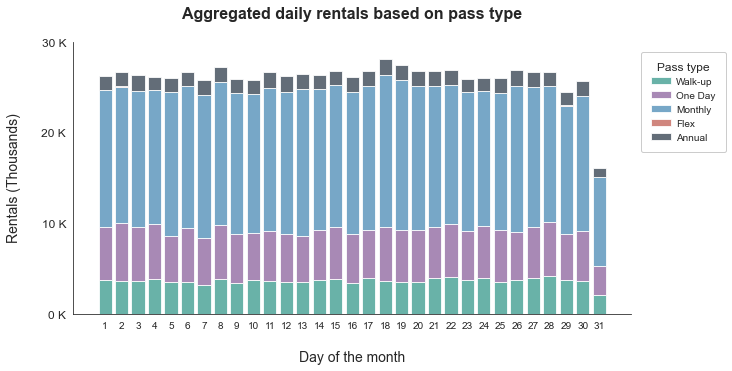

In [529]:
# Assign palette as per requirement
sb.set_style('white')
plt.figure(figsize = [10, 5])
flatui = ["#26bda7", "#9b59b6", "#3498db", "#e74c3c", "#34495e"]
sb.set_palette(flatui, n_colors=5, desat=0.6)

cat1_order = bikeshare.day.sort_values(ascending=True).unique()
cat2_order = bikeshare.pass_type.sort_values(ascending=True).unique()

# plot stacked plot
baselines = np.zeros(len(cat1_order))
# for each second-variable category:
for i in range(len(cat2_order)):
    # isolate the counts of the first category,
    cat2 = cat2_order[i]
    inner_counts = bikeshare[bikeshare['pass_type'] == cat2]['day'].value_counts()
    # then plot those counts on top of the accumulated baseline
    plt.bar(x = np.arange(len(cat1_order)), height = inner_counts[cat1_order].fillna(0),
            bottom = baselines, alpha = 0.8)
    baselines += inner_counts[cat1_order].fillna(0)

# improve plot aesthetics
max_count = bikeshare.groupby([bikeshare['day']]).size().reset_index(name='rentals').max()['rentals']
y_tick_values = np.arange(0, max_count + 10000, 10000)
y_tick_names = ['{:0.0f} K'.format(v/1000) for v in y_tick_values]

plt.title('Aggregated daily rentals based on pass type\n', weight = 'bold', fontsize = 16)
plt.xticks(np.arange(len(cat1_order)), cat1_order)
plt.yticks(y_tick_values, y_tick_names, fontsize=12)
plt.xlabel('\nDay of the month', fontsize=14)
plt.ylabel('Rentals (Thousands)\n', fontsize=14)
plt.legend(cat2_order, scatterpoints=1, frameon=True, fancybox=True, shadow=False, ncol = 1, 
           framealpha = 1, borderpad=1, borderaxespad=1, loc = 'upper left', labelspacing=0.5,  
           title='Pass type', title_fontsize=12, fontsize=10, facecolor='white',
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(1, 1))

sb.despine();

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.37.a Stack plot of rentals based on pass type and day of the month.png', dpi=300, bbox_inches='tight')

**`Line plot:`**

> The data needs some summirization by grouping together the respective variables. Then, reset the index and name the summerized data values accordingly.

In [530]:
categorical_counts = bikeshare.groupby([bikeshare['pass_type'], 
                                        bikeshare['day']]).size().reset_index(name='rentals')
categorical_counts.head(10)

,pass_type,day,rentals
0,Walk-up,1,3714
1,Walk-up,2,3566
2,Walk-up,3,3589
3,Walk-up,4,3837
4,Walk-up,5,3476
5,Walk-up,6,3456
6,Walk-up,7,3196
7,Walk-up,8,3874
8,Walk-up,9,3378
9,Walk-up,10,3689


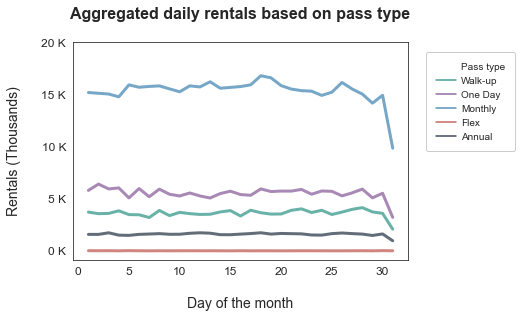

In [531]:
# set the palette as per requirement
sb.set_style('white')
flatui = ["#26bda7", "#9b59b6", "#3498db", "#e74c3c", "#34495e"]
sb.set_palette(flatui, n_colors=5, desat=0.6)

plt.figure(figsize = [6, 4])
max_count = categorical_counts.rentals.max()
y_tick_values = np.arange(0, max_count + 5000, 5000)
y_tick_names = ['{:0.0f} K'.format(v/1000) for v in y_tick_values]

# plot line plot
ax = sb.lineplot(data=categorical_counts, x = "day", y = "rentals", hue="pass_type", linewidth=3, alpha = 0.8)
plt.title('Aggregated daily rentals based on pass type\n', weight = 'bold', fontsize = 16)
plt.xticks(fontsize=12)
plt.yticks(y_tick_values, y_tick_names, fontsize=12)
plt.xlabel('\nDay of the month', fontsize=14)
plt.ylabel('Rentals (Thousands)\n', fontsize=14)

# when 'hue' is used, its label appears as legend title
# replace default title with custom title.
ax.legend(scatterpoints=1, frameon=True, fancybox=True, shadow=False, ncol = 1, framealpha = 1, 
          borderpad=1, borderaxespad=1, loc = 'upper right', labelspacing=0.5, title_fontsize=12,
          fontsize=10, facecolor='white', markerfirst=True, handlelength=2,
          handletextpad=0.5, bbox_to_anchor=(1.35, 1)).texts[0].set_text("Pass type");

# sb.despine();

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.37.b Line plot of rentals based on pass type and day of the month.png', dpi=300, bbox_inches='tight')

**`Individual plots of aggregated distribution of daily rentals over bike type:`**

<Figure size 1296x288 with 0 Axes>

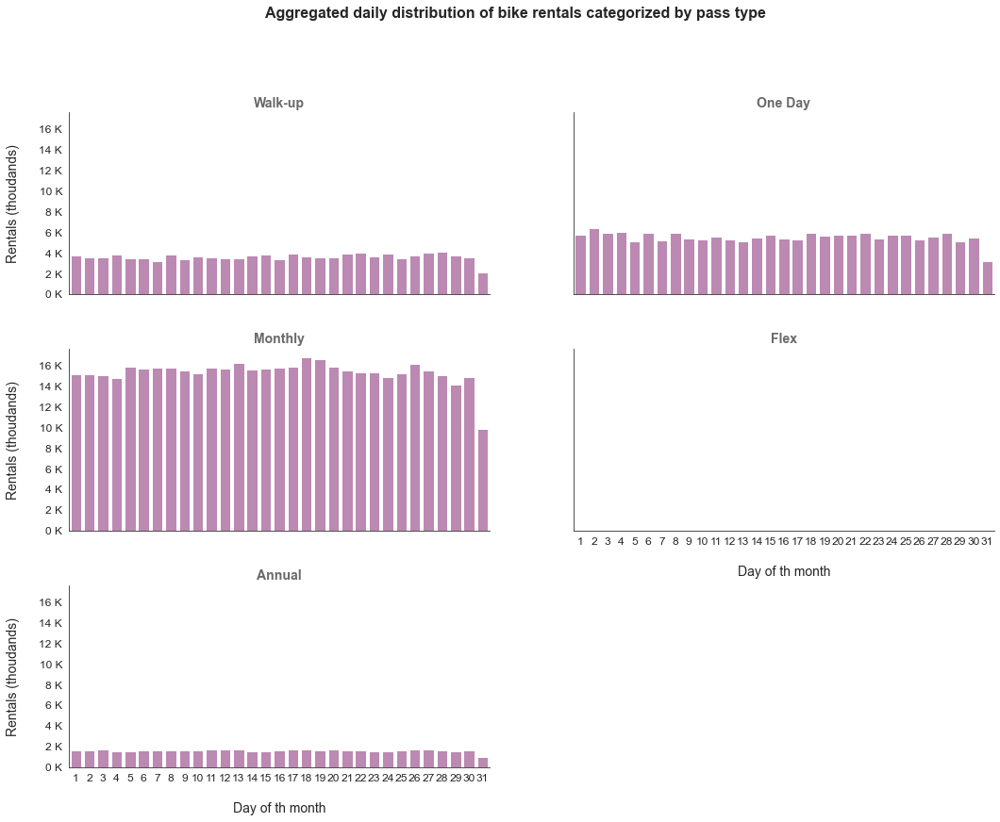

In [532]:
# set the palette as per requirement
sb.set_palette(palette = 'colorblind', n_colors = 10, desat = 1)
flatui = [sb.color_palette()[4], sb.color_palette()[6]]
sb.set_palette(flatui, desat = 0.8)
base_color = sb.color_palette()[0]
sb.set_style('white')
plt.figure(figsize = [18, 4])

# plot facet grid
g = sb.FacetGrid(data = bikeshare, col = 'pass_type', col_wrap = 2, height = 4, aspect = 1.8)
g.map(sb.countplot, "day", color = base_color, order = bikeshare.day.sort_values(ascending=True).unique())
g.fig.subplots_adjust(top=0.85)
g.fig.suptitle('Aggregated daily distribution of bike rentals categorized by pass type\n', fontsize = 16, weight = 'bold')
g.set_titles('{col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# obtain y_ticks and convert them to a multiple of millions
# obtain the x_ticks and store them as a list
y_tick_names = []
x_tick_names = []
for ax in g.axes.flat:
    for y_label in ax.get_yticklabels():
        y_label_value = int(y_label.get_text())
        y_label_new_value = '{:0.0f} K'.format(y_label_value/1000)
        y_tick_names.append(y_label_new_value)
        
    for x_label in ax.get_xticklabels():
        x_label_value = x_label.get_text()
        x_tick_names.append(x_label_value)

g.set_yticklabels(y_tick_names, size = 12)
g.set_xticklabels(x_tick_names, size = 12)
g.set_xlabels('\nDay of th month', size = 14)
g.set_ylabels('Rentals (thoudands)\n', size = 14)

plt.subplots_adjust(wspace=0.2, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.37.c Facet grid of rentals based on pass type and day of the month.png', dpi=300, bbox_inches='tight')

> Let us plot more variety of graphs to observe the distribution of data and hidden insights.

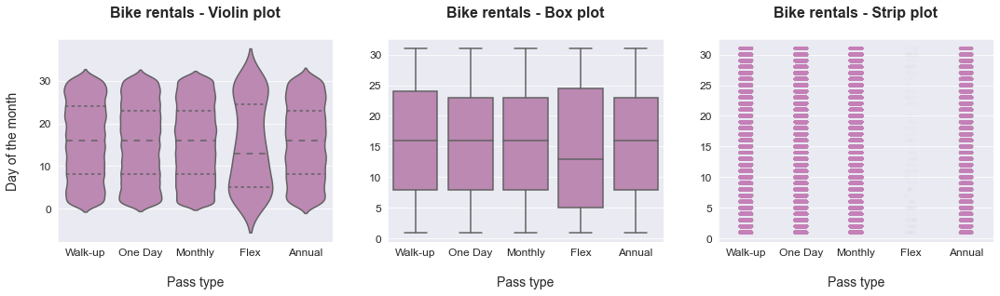

In [533]:
plt.figure(figsize = [18, 4])
sb.set_style('darkgrid')
# set the palette as per requirement
sb.set_palette(palette = 'colorblind', n_colors = 10, desat = 1)
flatui = [sb.color_palette()[4], sb.color_palette()[6]]
sb.set_palette(flatui, desat = 0.8)
base_color = sb.color_palette()[0]

# left plot: violin plot
plt.subplot(1, 3, 1)
sb.violinplot(data = bikeshare, x = 'pass_type', y = 'day', inner = 'quartile',
              color = base_color)
plt.title('Bike rentals - Violin plot\n',  weight = 'bold', fontsize = 16)
plt.xlabel('\nPass type', fontsize = 14)
plt.ylabel('Day of the month\n', fontsize = 14)
plt.xticks(fontsize = 12)
plt.yticks(fontsize = 12)

# center plot: box plot
plt.subplot(1, 3, 2)
sb.boxplot(data = bikeshare, x = 'pass_type', y = 'day', color = base_color)
plt.title('Bike rentals - Box plot\n',  weight = 'bold', fontsize = 16)
plt.xlabel('\nPass type', fontsize = 14)
plt.ylabel('', fontsize = 14)
plt.xticks(fontsize = 12)
plt.yticks(fontsize = 12)

# right plot: strip chart
plt.subplot(1, 3, 3)
sb.stripplot(data = bikeshare, x = "pass_type", y = "day", alpha = 0.002, color = base_color)
plt.title('Bike rentals - Strip plot\n',  weight = 'bold', fontsize = 16)
plt.xlabel('\nPass type', fontsize = 14)
plt.ylabel('', fontsize = 14);
plt.xticks(fontsize = 12)
plt.yticks(fontsize = 12)

plt.subplots_adjust(wspace=0.2, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust dhe figure to include all of the x and y labels
plt.savefig('plots/3.2.37.d Distribution of Trip rentals based on pass type and day of the month.png', dpi=300, bbox_inches='tight')

**`Heat Map:`**

> Now lets make a pivot from the categorical dataset created earlier into a more appropriate data structure.

In [534]:
categorical_counts = categorical_counts.pivot(index = 'pass_type', columns = 'day', values = 'rentals')
categorical_counts

day,1,2,3,4,5,6,7,8,9,10,...,22,23,24,25,26,27,28,29,30,31
pass_type,,,,,,,,,,,,,,,,,,,,,
Walk-up,3714.0,3566.0,3589.0,3837.0,3476.0,3456.0,3196.0,3874.0,3378.0,3689.0,...,4026.0,3673.0,3888.0,3487.0,3716.0,3980.0,4143.0,3733.0,3593.0,2076.0
One Day,5793.0,6399.0,5936.0,6033.0,5075.0,5970.0,5188.0,5915.0,5423.0,5262.0,...,5888.0,5429.0,5738.0,5706.0,5272.0,5556.0,5919.0,5081.0,5518.0,3206.0
Monthly,15173.0,15101.0,15031.0,14762.0,15907.0,15680.0,15758.0,15810.0,15524.0,15244.0,...,15353.0,15304.0,14898.0,15205.0,16138.0,15510.0,15030.0,14154.0,14911.0,9835.0
Flex,17.0,11.0,15.0,4.0,21.0,9.0,4.0,10.0,5.0,9.0,...,9.0,8.0,6.0,5.0,5.0,8.0,13.0,5.0,22.0,8.0
Annual,1578.0,1579.0,1732.0,1507.0,1484.0,1581.0,1613.0,1652.0,1588.0,1593.0,...,1631.0,1522.0,1508.0,1652.0,1711.0,1655.0,1608.0,1475.0,1621.0,967.0


> The data is ready to be plotred as the `Heat map`.

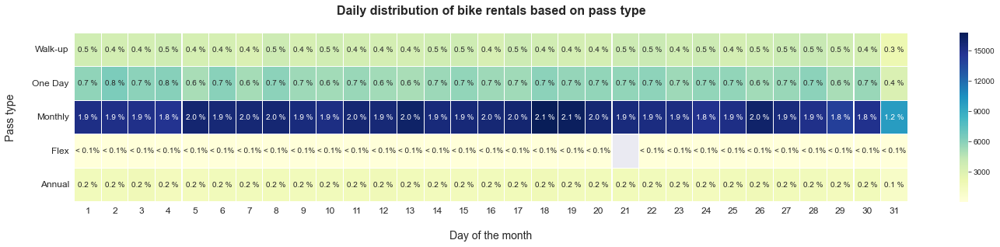

In [535]:
# plot heat map
plt.figure(figsize = [24, 4])
res = sb.heatmap(categorical_counts, annot = True, fmt = '.0f', annot_kws={'size':10}, linewidths=0.1, cmap="YlGnBu")
plt.yticks(rotation=0, fontsize="12", va="center")
plt.xticks(fontsize="12")
plt.title('Daily distribution of bike rentals based on pass type\n', fontsize = 16, weight = 'bold')
plt.xlabel('\nDay of the month', fontsize=14)
plt.ylabel('Pass type\n', fontsize=14);

# convert annotations to percentages
for t in res.texts: 
    p = np.round(np.round(int(t.get_text())/bikeshare.shape[0], 4)*100, 1)
    if p < 0.1:
        t.set_text('< 0.1%')
    else:
        t.set_text(str(p)+' %');  

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.37.e Heat map of rentals based on pass type and day of the month.png', dpi=300, bbox_inches='tight')

**`Find average rentals based on the daytime:`**

> The `pass_type` needs to be converted into categorical datatype, otherwise the `groupby` method will ignore `NaN` rental values and inturn produce **incorrect** `avg. rental value`. Also use of `size()` method ignores the unused level combinations of the groups, hence use `count()` method.

> However, the above plots depicts that the rentals decrease during the end of the month, especially on 31'st of the month. The bike rentals are categorized over the day of the month, the distribution is calculated based on the cummulative summation of day over 3 years but not individual month. Hence, there are only 21 occurances of day 31st, while other days has an occurance of 36 over the time period of 3 years (2017-2019), except for days 29 and 30 which counts to 33 due to absence in February month. This denotes that the rate of rentals is actually high on 31st compared to other days.

> Hence in order to compute the average daily rentals based on the occurances  of the day in any month, apply `size()` meathod instead of `count()` method to take missing dates into account.

In [536]:
day_df = bikeshare.groupby([bikeshare["year"], 
                            bikeshare["month"],
                            bikeshare["day"],
                            bikeshare["pass_type"]]).size().reset_index(name='rentals')
day_df.head(10)

,year,month,day,pass_type,rentals
0,2017,1,1,Walk-up,169
1,2017,1,1,Monthly,90
2,2017,1,1,Annual,11
3,2017,1,2,Walk-up,115
4,2017,1,2,Monthly,121
5,2017,1,2,Annual,23
6,2017,1,3,Walk-up,73
7,2017,1,3,Monthly,234
8,2017,1,3,Annual,20
9,2017,1,4,Walk-up,81


In [537]:
cat_order = day_df.day.sort_values(ascending=True).unique()
print('Day - Occurances')
day_df.day.value_counts()[cat_order]

Day - Occurances


1     119
2     119
3     119
4     118
5     119
6     119
7     119
8     121
9     120
10    119
11    119
12    118
13    119
14    119
15    119
16    119
17    120
18    119
19    120
20    119
21    117
22    119
23    119
24    119
25    119
26    119
27    120
28    120
29    109
30    110
31     70
Name: day, dtype: int64

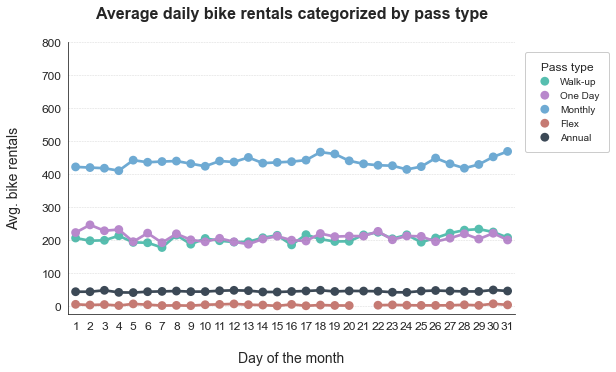

In [538]:
plt.figure(figsize=[8,5])
sb.set_style('white')
# flatui = ["#26bda7", "#9b59b6", "#3498db", "#e74c3c", "#34495e"]
flatui = ["#34e0c7", "#c271e3", "#4cb1f5", "#e06458", "#34495e"]
sb.set_palette(flatui, n_colors=5, desat=0.6)
base_color = sb.color_palette()[0]

sb.pointplot(data = day_df, x = "day", y = "rentals", linestyles = "-", hue = 'pass_type', 
             scale = 1, ci = None)
plt.title('Average daily bike rentals categorized by pass type\n',  weight = 'bold', fontsize = 16)
plt.ylabel('Avg. bike rentals\n', fontsize = 14)
plt.xlabel('\nDay of the month', fontsize = 14)
plt.xticks(fontsize = 12)

# get ytick locs and rearrage them with respect to zero
locs, labels = plt.yticks()
daily_rental_avg_max = 800
y_tick_values = np.arange(0, daily_rental_avg_max+100, 100)
y_tick_names = ['{:0.0f}'.format(v) for v in y_tick_values]
plt.yticks(y_tick_values, y_tick_names, fontsize = 12)

plt.legend(scatterpoints=1, frameon=True, fancybox=True, shadow=False, ncol = 1, 
           framealpha = 1, borderpad=1, borderaxespad=1, loc = 'upper left', labelspacing=0.5,  
           title='Pass type', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(1, 1))

sb.despine(top=True, right=True, left=False, bottom=False);

for loc in y_tick_values:
    plt.axhline(loc, ls='--', color='grey', linewidth=0.5, alpha=0.3)

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.37.f Average daily bike rentals categorized by pass type.png', dpi=300, bbox_inches='tight')

---

#### 3.2.38 Bivariate analysis of `bikeshare.day` and `fare_type` columns:

+ `Columns`: day, fare_type
+ `Data type`: (Categorical, ordered) and (Categorical, nominal)
+ `Plot`: Facet Grid, Violin plot, Box plot, Adapted Barchart

**`Stack plot:`**

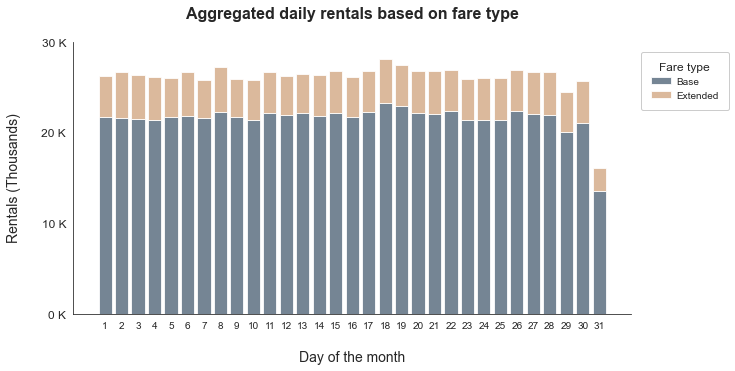

In [539]:
# Assign palette as per requirement
sb.set_style('white')
plt.figure(figsize = [10, 5])
flatui = ['#466887', '#eda668']
sb.set_palette(flatui, n_colors=2, desat=0.6)

cat1_order = bikeshare.day.sort_values(ascending=True).unique()
cat2_order = bikeshare.fare_type.sort_values(ascending=True).unique()

# plot stacked plot
baselines = np.zeros(len(cat1_order))
# for each second-variable category:
for i in range(len(cat2_order)):
    # isolate the counts of the first category,
    cat2 = cat2_order[i]
    inner_counts = bikeshare[bikeshare['fare_type'] == cat2]['day'].value_counts()
    # then plot those counts on top of the accumulated baseline
    plt.bar(x = np.arange(len(cat1_order)), height = inner_counts[cat1_order].fillna(0),
            bottom = baselines, alpha = 0.8)
    baselines += inner_counts[cat1_order].fillna(0)

# improve plot aesthetics
max_count = bikeshare.groupby([bikeshare['day']]).size().reset_index(name='rentals').max()['rentals']
y_tick_values = np.arange(0, max_count + 10000, 10000)
y_tick_names = ['{:0.0f} K'.format(v/1000) for v in y_tick_values]

plt.title('Aggregated daily rentals based on fare type\n', weight = 'bold', fontsize = 16)
plt.xticks(np.arange(len(cat1_order)), cat1_order)
plt.yticks(y_tick_values, y_tick_names, fontsize=12)
plt.xlabel('\nDay of the month', fontsize=14)
plt.ylabel('Rentals (Thousands)\n', fontsize=14)
plt.legend(cat2_order, scatterpoints=1, frameon=True, fancybox=True, shadow=False, ncol = 1, 
           framealpha = 1, borderpad=1, borderaxespad=1, loc = 'upper left', labelspacing=0.5,  
           title='Fare type', title_fontsize=12, fontsize=10, facecolor='white',
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(1, 1))

sb.despine();

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.38.a Stack plot of rentals based on fare type and day of the month.png', dpi=300, bbox_inches='tight')

**`Line plot:`**

> The data needs some summirization by grouping together the respective variables. Then, reset the index and name the summerized data values accordingly.

In [540]:
categorical_counts = bikeshare.groupby([bikeshare['fare_type'], 
                                        bikeshare['day']]).size().reset_index(name='rentals')
categorical_counts.head(10)

,fare_type,day,rentals
0,Base,1,21697
1,Base,2,21547
2,Base,3,21523
3,Base,4,21320
4,Base,5,21690
5,Base,6,21781
6,Base,7,21641
7,Base,8,22283
8,Base,9,21645
9,Base,10,21402


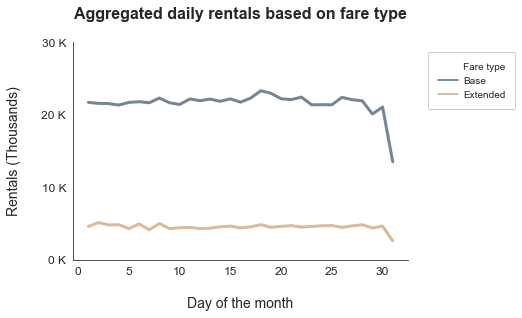

In [541]:
# set the palette as per requirement
sb.set_style('white')
flatui = ['#466887', '#eda668']
sb.set_palette(flatui, n_colors=2, desat=0.6)

plt.figure(figsize = [6, 4])
max_count = categorical_counts.rentals.max()
y_tick_values = np.arange(0, max_count + 10000, 10000)
y_tick_names = ['{:0.0f} K'.format(v/1000) for v in y_tick_values]

# plot line plot
ax = sb.lineplot(data=categorical_counts, x = "day", y = "rentals", hue="fare_type", linewidth=3, alpha = 0.8)
plt.title('Aggregated daily rentals based on fare type\n', weight = 'bold', fontsize = 16)
plt.xticks(fontsize=12)
plt.yticks(y_tick_values, y_tick_names, fontsize=12)
plt.xlabel('\nDay of the month', fontsize=14)
plt.ylabel('Rentals (Thousands)\n', fontsize=14)

# when 'hue' is used, its label appears as legend title
# replace default title with custom title.
ax.legend(scatterpoints=1, frameon=True, fancybox=True, shadow=False, ncol = 1, framealpha = 1, 
          borderpad=1, borderaxespad=1, loc = 'upper right', labelspacing=0.5,  
          title='', title_fontsize=12, fontsize=10, facecolor='white', markerfirst=True, 
          handlelength=2, handletextpad=0.5, bbox_to_anchor=(1.35, 1)).texts[0].set_text("Fare type")

sb.despine();

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.38.b Line plot of rentals based on fare type and day of the month.png', dpi=300, bbox_inches='tight')

**`Individual plots of aggregated distribution of daytime rentals over bike type:`**

<Figure size 1296x288 with 0 Axes>

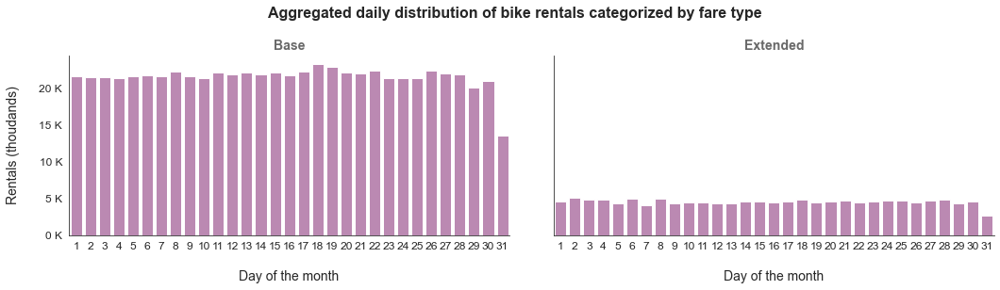

In [542]:
# set the palette as per requirement
sb.set_palette(palette = 'colorblind', n_colors = 10, desat = 1)
flatui = [sb.color_palette()[4], sb.color_palette()[6]]
sb.set_palette(flatui, desat = 0.8)
base_color = sb.color_palette()[0]
sb.set_style('white')
plt.figure(figsize = [18, 4])

# plot facet grid
g = sb.FacetGrid(data = bikeshare, col = 'fare_type', col_wrap = 2, height = 4, aspect = 1.8)
g.map(sb.countplot, "day", color = base_color, order = bikeshare.day.sort_values(ascending=True).unique())
g.fig.subplots_adjust(top=0.8)
g.fig.suptitle('Aggregated daily distribution of bike rentals categorized by fare type\n', fontsize = 16, weight = 'bold')
g.set_titles('{col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# obtain y_ticks and convert them to a multiple of millions
# obtain the x_ticks and store them as a list
y_tick_names = []
x_tick_names = []
for ax in g.axes.flat:
    for y_label in ax.get_yticklabels():
        y_label_value = int(y_label.get_text())
        y_label_new_value = '{:0.0f} K'.format(y_label_value/1000)
        y_tick_names.append(y_label_new_value)
        
    for x_label in ax.get_xticklabels():
        x_label_value = x_label.get_text()
        x_tick_names.append(x_label_value)

g.set_yticklabels(y_tick_names, size = 12)
g.set_xticklabels(x_tick_names, size = 12)
g.set_xlabels('\nDay of the month', size = 14)
g.set_ylabels('Rentals (thoudands)\n', size = 14)

plt.subplots_adjust(wspace=0.1, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.38.c Facet grid of rentals based on fare type and day of the month.png', dpi=300, bbox_inches='tight')

> Let us plot more variety of graphs to observe the distribution of data and hidden insights.

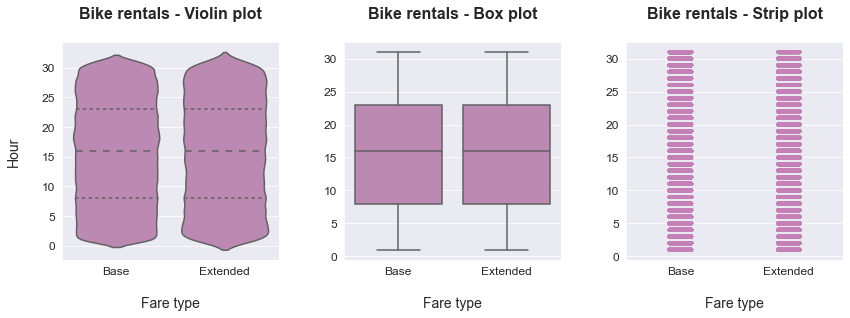

In [543]:
plt.figure(figsize = [14, 4])
sb.set_style('darkgrid')
# set the palette as per requirement
sb.set_palette(palette = 'colorblind', n_colors = 10, desat = 1)
flatui = [sb.color_palette()[4], sb.color_palette()[6]]
sb.set_palette(flatui, desat = 0.8)
base_color = sb.color_palette()[0]

# left plot: violin plot
plt.subplot(1, 3, 1)
sb.violinplot(data = bikeshare, x = 'fare_type', y = 'day', inner = 'quartile',
              color = base_color)
plt.title('Bike rentals - Violin plot\n',  weight = 'bold', fontsize = 16)
plt.xlabel('\nFare type', fontsize = 14)
plt.ylabel('Hour\n', fontsize = 14)
plt.xticks(fontsize = 12)
plt.yticks(fontsize = 12)

# center plot: box plot
plt.subplot(1, 3, 2)
sb.boxplot(data = bikeshare, x = 'fare_type', y = 'day', color = base_color)
plt.title('Bike rentals - Box plot\n',  weight = 'bold', fontsize = 16)
plt.xlabel('\nFare type', fontsize = 14)
plt.ylabel('', fontsize = 14)
plt.xticks(fontsize = 12)
plt.yticks(fontsize = 12)

# right plot: strip chart
plt.subplot(1, 3, 3)
sb.stripplot(data = bikeshare, x = "fare_type", y = "day", alpha = 0.002, color = base_color)
plt.title('Bike rentals - Strip plot\n',  weight = 'bold', fontsize = 16)
plt.xlabel('\nFare type', fontsize = 14)
plt.ylabel('', fontsize = 14);
plt.xticks(fontsize = 12)
plt.yticks(fontsize = 12)

plt.subplots_adjust(wspace=0.3, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust dhe figure to include all of the x and y labels
plt.savefig('plots/3.2.38.d Distribution of Trip rentals based fare type and day of the month.png', dpi=300, bbox_inches='tight')

**`Heat Map:`**

> Now lets make a pivot from the categorical dataset created earlier into a more appropriate data structure.

In [544]:
categorical_counts = categorical_counts.pivot(index = 'fare_type', columns = 'day', values = 'rentals')
categorical_counts

day,1,2,3,4,5,6,7,8,9,10,...,22,23,24,25,26,27,28,29,30,31
fare_type,,,,,,,,,,,,,,,,,,,,,
Base,21697,21547,21523,21320,21690,21781,21641,22283,21645,21402,...,22417,21360,21376,21358,22388,22061,21902,20088,21052,13496
Extended,4578,5109,4780,4823,4273,4915,4118,4978,4273,4395,...,4490,4576,4662,4697,4454,4648,4811,4360,4613,2596


> The data is ready to be plotred as the `Heat map`.

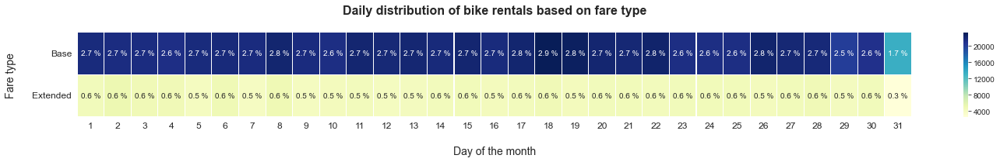

In [545]:
# plot heat map
plt.figure(figsize = [24, 2])
res = sb.heatmap(categorical_counts, annot = True, fmt = '.0f', annot_kws={'size':10}, linewidths=0.1, cmap="YlGnBu")
plt.yticks(rotation=0, fontsize="12", va="center")
plt.xticks(fontsize="12")
plt.title('Daily distribution of bike rentals based on fare type\n', fontsize = 16, weight = 'bold')
plt.xlabel('\nDay of the month', fontsize=14)
plt.ylabel('Fare type\n', fontsize=14);

# convert annotations to percentages
for t in res.texts: 
    p = np.round(np.round(int(t.get_text())/bikeshare.shape[0], 4)*100, 1)
    if p < 0.1:
        t.set_text('< 0.1%')
    else:
        t.set_text(str(p)+' %');  

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.38.e Heat map of rentals based on fare type and day of the month.png', dpi=300, bbox_inches='tight')

**`Find average rentals based on the daytime:`**

> The `fare_type` needs to be converted into categorical datatype, otherwise the `groupby` method will ignore `NaN` rental values and inturn produce **incorrect** `avg. rental value`. Also use of `size()` method ignores the unused level combinations of the groups, hence use `count()` method.

> However, the above plots depicts that the rentals decrease during the end of the month, especially on 31'st of the month. The bike rentals are categorized over the day of the month, the distribution is calculated based on the cummulative summation of day over 3 years but not individual month. Hence, there are only 21 occurances of day 31st, while other days has an occurance of 36 over the time period of 3 years (2017-2019), except for days 29 and 30 which counts to 33 due to absence in February month. This denotes that the rate of rentals is actually high on 31st compared to other days.

> Hence in order to compute the average daily rentals based on the occurances  of the day in any month, apply `size()` meathod instead of `count()` method to take missing dates into account.

In [546]:
day_df = bikeshare.groupby([bikeshare["year"], 
                            bikeshare["month"],
                            bikeshare["day"],
                            bikeshare["fare_type"]]).size().reset_index(name='rentals')
day_df.head(10)

,year,month,day,fare_type,rentals
0,2017,1,1,Base,211
1,2017,1,1,Extended,59
2,2017,1,2,Base,214
3,2017,1,2,Extended,45
4,2017,1,3,Base,296
5,2017,1,3,Extended,31
6,2017,1,4,Base,322
7,2017,1,4,Extended,28
8,2017,1,5,Base,216
9,2017,1,5,Extended,15


In [547]:
cat_order = day_df.day.sort_values(ascending=True).unique()
print('Day - Occurances')
day_df.day.value_counts()[cat_order]

Day - Occurances


1     72
2     72
3     72
4     72
5     72
6     72
7     72
8     72
9     72
10    72
11    72
12    72
13    72
14    72
15    72
16    72
17    72
18    72
19    72
20    72
21    72
22    72
23    72
24    72
25    72
26    72
27    72
28    72
29    66
30    66
31    42
Name: day, dtype: int64

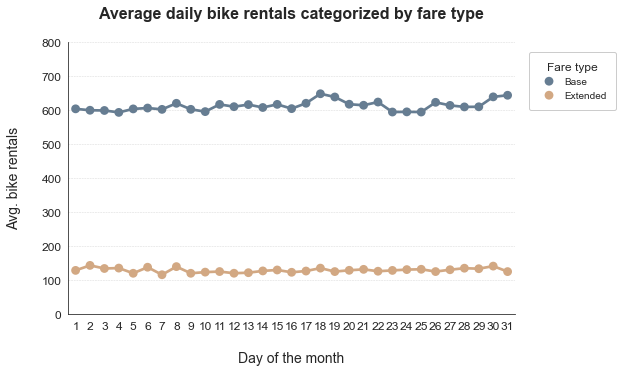

In [548]:
plt.figure(figsize=[8,5])
sb.set_style('white')
flatui = ['#577da1', '#eda668']
sb.set_palette(flatui, n_colors=2, desat=0.6)
base_color = sb.color_palette()[0]

sb.pointplot(data = day_df, x = "day", y = "rentals", linestyles = "-", hue = 'fare_type', 
             scale = 1, ci = None)
plt.title('Average daily bike rentals categorized by fare type\n',  weight = 'bold', fontsize = 16)
plt.ylabel('Avg. bike rentals\n', fontsize = 14)
plt.xlabel('\nDay of the month', fontsize = 14)
plt.xticks(fontsize = 12)

# get ytick locs and rearrage them with respect to zero
locs, labels = plt.yticks()
daily_rental_avg_max = 800
y_tick_values = np.arange(0, daily_rental_avg_max+100, 100)
y_tick_names = ['{:0.0f}'.format(v) for v in y_tick_values]
plt.yticks(y_tick_values, y_tick_names, fontsize = 12)

plt.legend(scatterpoints=1, frameon=True, fancybox=True, shadow=False, ncol = 1, 
           framealpha = 1, borderpad=1, borderaxespad=1, loc = 'upper right', labelspacing=0.5,  
           title='Fare type', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(1.25, 1))

sb.despine(top=True, right=True, left=False, bottom=False);

for loc in y_tick_values:
    plt.axhline(loc, ls='--', color='grey', linewidth=0.5, alpha=0.3)

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.38.f Average daily bike rentals categorized by fare type.png', dpi=300, bbox_inches='tight')

-------

#### 3.2.39 Bivariate analysis of `bikeshare.weekday` and `trip_type` columns:

+ `Columns`: weekday, trip_type
+ `Data type`: (Categorical, ordered) and (Categorical, nominal)
+ `Plot`: Facet Grid, Violin plot, Box plot, Adapted Barchart

**`Stack plot:`**

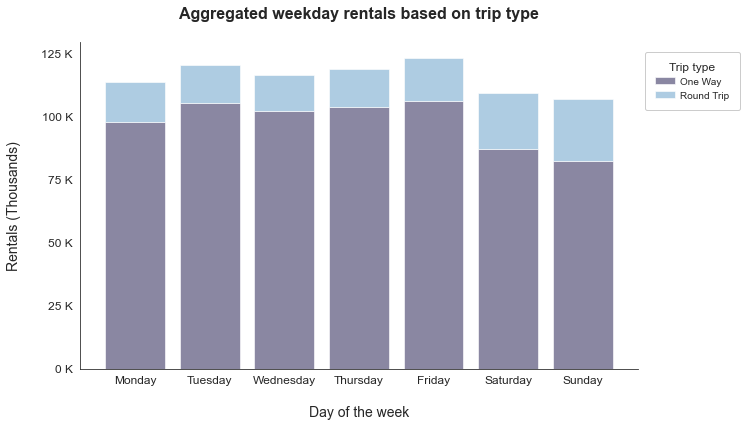

In [549]:
sb.set_style('white')
flatui = ["#37326b", "#6eacdb"]
sb.set_palette(flatui, desat = 0.8)
plt.figure(figsize = [10, 6])

cat1_order = bikeshare.weekday.sort_values(ascending=True).unique()
cat2_order = bikeshare.trip_type.sort_values(ascending=True).unique()

# plot stacked plot
baselines = np.zeros(len(cat1_order))
# for each second-variable category:
for i in range(len(cat2_order)):
    # isolate the counts of the first category,
    cat2 = cat2_order[i]
    inner_counts = bikeshare[bikeshare['trip_type'] == cat2]['weekday'].value_counts()
    # then plot those counts on top of the accumulated baseline
    plt.bar(x = np.arange(len(cat1_order)), height = inner_counts[cat1_order].fillna(0),
            bottom = baselines, alpha =0.6)
    baselines += inner_counts[cat1_order].fillna(0)

# improve plot aesthetics
max_count = bikeshare.groupby([bikeshare['weekday']]).size().reset_index(name='rentals').max()['rentals']
y_tick_values = np.arange(0, max_count + 25000, 25000)
y_tick_names = ['{:0.0f} K'.format(v/1000) for v in y_tick_values]

plt.title('Aggregated weekday rentals based on trip type\n', weight = 'bold', fontsize = 16)
plt.xticks(np.arange(len(cat1_order)), cat1_order, fontsize=12)
plt.yticks(y_tick_values, y_tick_names, fontsize=12)
plt.xlabel('\nDay of the week', fontsize=14)
plt.ylabel('Rentals (Thousands)\n', fontsize=14)
plt.legend(cat2_order, scatterpoints=1, frameon=True, fancybox=True, shadow=False, ncol = 1, 
           framealpha = 1, borderpad=1, borderaxespad=1, loc = 'upper right', labelspacing=0.5,  
           title='Trip type', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(1.2, 1))

sb.despine();

# savefig by passing (bbox_inches='tight'),which will adjust dhe figure to include all of the x and y labels
plt.savefig('plots/3.2.39.a Stack plot of Trip rentals based on trip type and day of the week.png', dpi=300, bbox_inches='tight')

**`Line Plot:`**

> The data needs some summirization by grouping together the respective variables. Then, reset the index and name the summerized data values accordingly.

In [550]:
categorical_counts = bikeshare.groupby([bikeshare['trip_type'], 
                                        bikeshare['weekday']]).size().reset_index(name='rentals')
categorical_counts.head(10)

,trip_type,weekday,rentals
0,One Way,Monday,97766
1,One Way,Tuesday,105270
2,One Way,Wednesday,102086
3,One Way,Thursday,103694
4,One Way,Friday,106059
5,One Way,Saturday,86891
6,One Way,Sunday,82501
7,Round Trip,Monday,15911
8,Round Trip,Tuesday,15256
9,Round Trip,Wednesday,14300


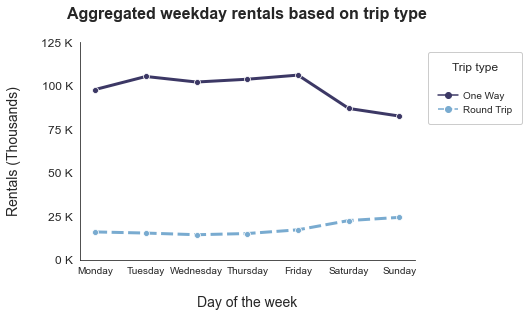

In [551]:
# set the palette as per requirement
flatui = ["#37326b", "#6eacdb"]
sb.set_palette(flatui, desat = 0.8)
sb.set_style('white')

plt.figure(figsize = [6, 4])
max_count = categorical_counts.rentals.max()
y_tick_values = np.arange(0, max_count + 25000, 25000)
y_tick_names = ['{:0.0f} K'.format(v/1000) for v in y_tick_values]

# plot line plot
ax = sb.lineplot(data=categorical_counts, x = "weekday", y = "rentals", hue="trip_type", 
                 style="trip_type", err_style="bars", linewidth=3, markers = ['o', 'o'])
plt.title('Aggregated weekday rentals based on trip type\n', weight = 'bold', fontsize = 16)
plt.xticks(fontsize=10)
plt.yticks(y_tick_values, y_tick_names, fontsize=12)
plt.xlabel('\nDay of the week', fontsize=14)
plt.ylabel('Rentals (Thousands)\n', fontsize=14)

# when a hue is used that appears as a legend title,
# remove this title, and replace it with custom title.
ax.legend(scatterpoints=1, frameon=True, fancybox=True, shadow=False, ncol = 1, framealpha = 1, 
           borderpad=1, borderaxespad=1, loc = 'upper right', labelspacing=0.5,  
           title='Trip type', title_fontsize=12, fontsize=10, facecolor='white', markerfirst=True, 
           handlelength=2, handletextpad=0.5, bbox_to_anchor=(1.35, 1)).texts[0].set_text("");

sb.despine();

# savefig by passing (bbox_inches='tight'),which will adjust dhe figure to include all of the x and y labels
plt.savefig('plots/3.2.39.b Line plot of Trip rentals based on trip type and day of the week.png', dpi=300, bbox_inches='tight')

**`Individual plots of aggregated distribution of weekday rentals over trip type:`**

<Figure size 576x288 with 0 Axes>

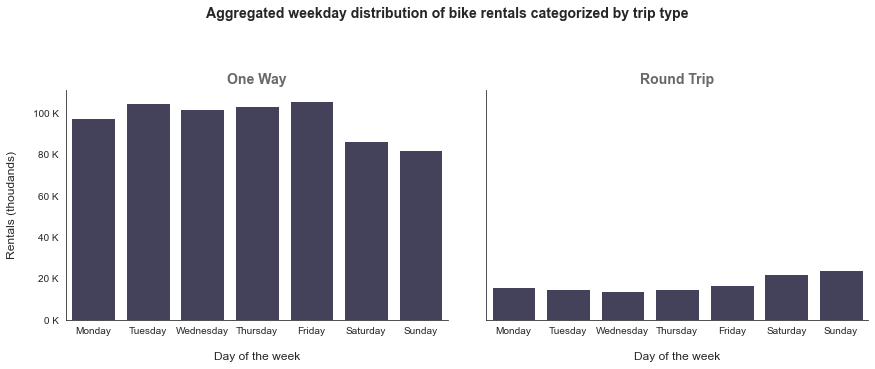

In [552]:
# set the palette as per requirement
flatui = ["#37326b", "#6eacdb"]
sb.set_palette(flatui, desat = 0.6)
base_color = sb.color_palette()[0]
sb.set_style('white')
plt.figure(figsize = [8, 4])

# plot facet grid
g = sb.FacetGrid(data = bikeshare, col = 'trip_type', col_wrap = 2, height = 5, aspect = 1.2)
g.map(sb.countplot, "weekday", color = base_color, order = bikeshare.weekday.sort_values(ascending=True).unique())
g.fig.subplots_adjust(top=0.75)
g.fig.suptitle('Aggregated weekday distribution of bike rentals categorized by trip type\n', fontsize = 14, weight = 'bold')
g.set_titles('{col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# obtain y_ticks and convert them to a multiple of millions
# obtain the x_ticks and store them as a list
y_tick_names = []
x_tick_names = []
for ax in g.axes.flat:
    for y_label in ax.get_yticklabels():
        y_label_value = int(y_label.get_text())
        y_label_new_value = '{:0.0f} K'.format(y_label_value/1000)
        y_tick_names.append(y_label_new_value)
        
    for x_label in ax.get_xticklabels():
        x_label_value = x_label.get_text()
        x_tick_names.append(x_label_value)

g.set_yticklabels(y_tick_names, size = 10)
g.set_xticklabels(x_tick_names, size = 10)
g.set_xlabels('\nDay of the week', size = 12)
g.set_ylabels('Rentals (thoudands)\n', size = 12)

plt.subplots_adjust(wspace=0.1, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust dhe figure to include all of the x and y labels
plt.savefig('plots/3.2.39.c Facet grid of Trip rentals based on trip type and day of the week.png', dpi=300, bbox_inches='tight')

> Let us plot more variety of graphs to observe the distribution of data and hidden insights.

**`Heat Map:`**

One alternative way of depicting the relationship between two categorical variables is through a **Heat map**. Heat maps were introduced earlier as the 2-d version of a histogram; here, we're using them as the 2-d version of a bar chart. The seaborn function `heatmap` is at home with this type of heat map implementation, but the input arguments are unlike most of the visualization functions. Instead of providing the original dataframe, we need to summarize the counts into a matrix that will then be plotted.

> Now lets make a pivot from the categorical dataset created earlier into a more appropriate data structure.

In [553]:
categorical_counts = categorical_counts.pivot(index = 'trip_type', columns = 'weekday', values = 'rentals')
categorical_counts

weekday,Monday,Tuesday,Wednesday,Thursday,Friday,Saturday,Sunday
trip_type,,,,,,,
One Way,97766,105270,102086,103694,106059,86891,82501
Round Trip,15911,15256,14300,14988,17136,22450,24281


> The data is ready to be plotred as the `Heat map`.

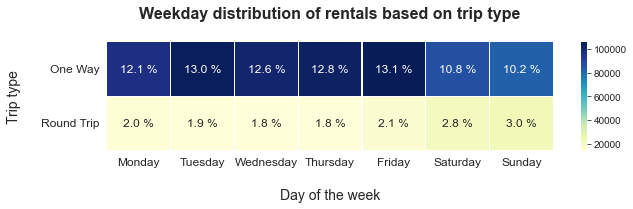

In [554]:
# plot heat map
plt.figure(figsize = [10, 2])
res = sb.heatmap(categorical_counts, annot = True, fmt = '.0f', annot_kws={'size':12}, linewidths=0.1, cmap="YlGnBu")
plt.yticks(rotation=0, fontsize="12", va="center")
plt.xticks(fontsize="12")
plt.title('Weekday distribution of rentals based on trip type\n', fontsize = 16, weight = 'bold')
plt.xlabel('\nDay of the week', fontsize=14)
plt.ylabel('Trip type\n', fontsize=14);

# convert annotations to percentages
for t in res.texts: 
    p = np.round(np.round(int(t.get_text())/bikeshare.shape[0], 4)*100, 1)
    t.set_text(str(p)+' %')
               
# savefig by passing (bbox_inches='tight'),which will adjust dhe figure to include all of the x and y labels
plt.savefig('plots/3.2.39.d Heat map of Trip rentals based on trip type and day of the week.png', dpi=300, bbox_inches='tight')

**`Find average rentals based on the weekday:`**

> The `trip_type` needs to be converted into categorical datatype, otherwise the `groupby` method will ignore `NaN` rental values and inturn produce **incorrect** `avg. rental value`. Also use of `size()` method ignores the unused level combinations of the groups, hence use `count()` method.

> Every fifth week in a month won't have all the occurances of the `weekday` as the month's are limited by uneven equal distribution of 7 day span (number of days in a week). Hence in order to accurately calculate the `average rentals` of the `weekday`, use `size()` method, which takes only the unique combinations in the occurances and ignores occurances with `NULL values`.

In [555]:
weekday_df = bikeshare.groupby([bikeshare["year"], 
                                bikeshare["month"],
                                bikeshare["week"],
                                bikeshare["weekday"],
                                bikeshare["trip_type"]]).size().reset_index(name='rentals')
weekday_df.head(10)

,year,month,week,weekday,trip_type,rentals
0,2017,1,First,Monday,One Way,228
1,2017,1,First,Monday,Round Trip,31
2,2017,1,First,Tuesday,One Way,288
3,2017,1,First,Tuesday,Round Trip,39
4,2017,1,First,Wednesday,One Way,325
5,2017,1,First,Wednesday,Round Trip,25
6,2017,1,First,Thursday,One Way,211
7,2017,1,First,Thursday,Round Trip,20
8,2017,1,First,Friday,One Way,325
9,2017,1,First,Friday,Round Trip,36


In [556]:
cat_order = weekday_df.weekday.sort_values(ascending=True).unique()
print('Weekday - Occurances')
weekday_df.weekday.value_counts()[cat_order]

Weekday - Occurances


Monday       314
Tuesday      314
Wednesday    312
Thursday     312
Friday       312
Saturday     312
Sunday       314
Name: weekday, dtype: int64

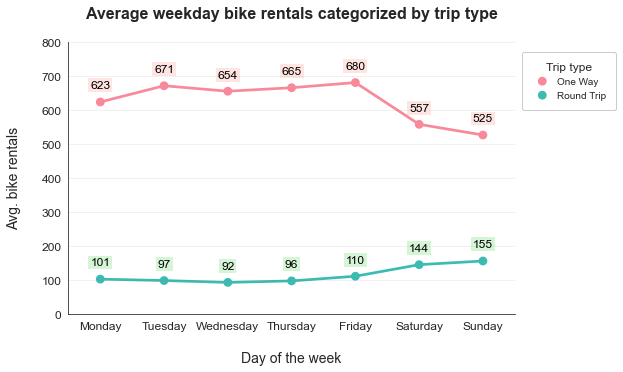

In [557]:
plt.figure(figsize=[8, 5])
sb.set_style('white')
flatui = ["#fff480"]
sb.set_palette(flatui, n_colors=1, desat=0.8)
base_color = sb.color_palette()[0]

sb.pointplot(data = weekday_df, x = "weekday", y = "rentals", linestyles = ['-', '-'], 
             hue = 'trip_type', ci = None)
plt.title('Average weekday bike rentals categorized by trip type\n',  weight = 'bold', fontsize = 16)
plt.ylabel('Avg. bike rentals\n', fontsize = 14)
plt.xlabel('\nDay of the week', fontsize = 14)
plt.xticks(fontsize = 12)

# get ytick locs and rearrage them with respect to zero
locs, labels = plt.yticks()
weekday_rental_avg_max = 800
y_tick_values = np.arange(0, weekday_rental_avg_max+100, 100)
y_tick_names = ['{:0.0f}'.format(v) for v in y_tick_values]
plt.yticks(y_tick_values, y_tick_names, fontsize = 12)

# add annotations
# -------------------------------------------------------
avg_rentals = weekday_df.groupby([weekday_df["trip_type"], weekday_df["weekday"]]).mean()['rentals'].reset_index()
avg_rentals_max = avg_rentals.rentals.max()
avg_rentals_oneway = avg_rentals.query(' trip_type == "One Way" ')
avg_rentals_roundtrip = avg_rentals.query(' trip_type == "Round Trip" ')

# get the current tick locations and labels
locs, labels = plt.xticks()

for categorical_df in [avg_rentals_oneway, avg_rentals_roundtrip]:
    clrs = ['salmon' if trip == "One Way" else 'limegreen' for trip in categorical_df.trip_type ]
    # loop through each pair of locations and labels
    for loc, label, avg_rental_count, clr in zip(locs, labels, categorical_df.rentals, clrs):
        try:
            count = avg_rental_count
        except KeyError:
            count = 0   
        pct_string = '{:0.0f}'.format(count)
        if categorical_df.trip_type.unique() == "One Way":
            indent = 40
        else:
            indent = 40
        # print the annotation depending on the bar length
        plt.text(loc, count + indent, pct_string, ha = 'center', color = 'black', 
                 fontsize = 12, bbox=dict(pad=1.9,alpha=0.2,color='none',fc=clr))
# -------------------------------------------------------

plt.legend(scatterpoints=1, frameon=True, fancybox=True, shadow=False, ncol = 1, 
           framealpha = 1, borderpad=1, borderaxespad=1, loc = 'upper right', labelspacing=0.5,  
           title='Trip type', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(1.25, 1))

for loc in y_tick_values:
    plt.axhline(loc, ls='--', color='grey', linewidth=0.5, alpha=0.3)
    
sb.despine(top=True, right=True, left=False, bottom=False);

# savefig by passing (bbox_inches='tight'),which will adjust dhe figure to include all of the x and y labels
plt.savefig('plots/3.2.39.e Average weekday bike rentals categorized by trip type.png', dpi=300, bbox_inches='tight')

------------

#### 3.2.40 Bivariate analysis of `bikeshare.weekday` and `bike_type` columns:

+ `Columns`: weekday, bike_type
+ `Data type`: (Categorical, ordered) and (Categorical, nominal)
+ `Plot`: Facet Grid, Violin plot, Box plot, Adapted Barchart

**`Stack plot:`**

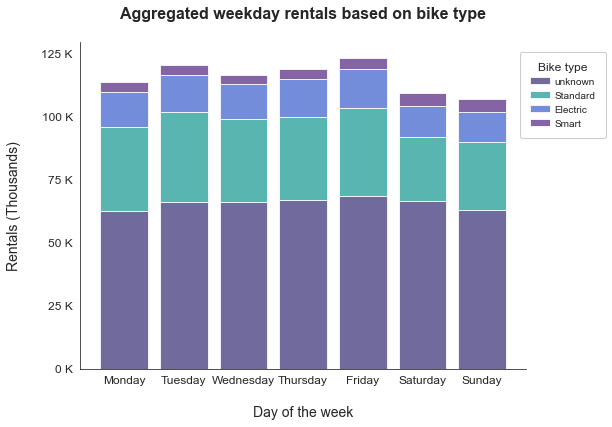

In [558]:
# Assign palette as per requirement
sb.set_style('white')
flatui = ["darkslateblue", "lightseagreen", "royalblue", "rebeccapurple"]
sb.set_palette(flatui, desat = 0.8)
plt.figure(figsize = [8, 6])

cat1_order = bikeshare.weekday.sort_values(ascending=True).unique()
cat2_order = bikeshare.bike_type.sort_values(ascending=True).unique()

# plot stacked plot
baselines = np.zeros(len(cat1_order))
# for each second-variable category:
for i in range(len(cat2_order)):
    # isolate the counts of the first category,
    cat2 = cat2_order[i]
    inner_counts = bikeshare[bikeshare['bike_type'] == cat2]['weekday'].value_counts()
    # then plot those counts on top of the accumulated baseline
    plt.bar(x = np.arange(len(cat1_order)), height = inner_counts[cat1_order].fillna(0),
            bottom = baselines, alpha = 0.8)
    baselines += inner_counts[cat1_order].fillna(0)

# improve plot aesthetics
max_count = bikeshare.groupby([bikeshare['weekday']]).size().reset_index(name='rentals').max()['rentals']
y_tick_values = np.arange(0, max_count + 25000, 25000)
y_tick_names = ['{:0.0f} K'.format(v/1000) for v in y_tick_values]

plt.title('Aggregated weekday rentals based on bike type\n', weight = 'bold', fontsize = 16)
plt.xticks(np.arange(len(cat1_order)), cat1_order, fontsize=12)
plt.yticks(y_tick_values, y_tick_names, fontsize=12)
plt.xlabel('\nDay of the week', fontsize=14)
plt.ylabel('Rentals (Thousands)\n', fontsize=14)
plt.legend(cat2_order, scatterpoints=1, frameon=True, fancybox=True, shadow=False, ncol = 1, 
           framealpha = 1, borderpad=1, borderaxespad=1, loc = 'upper right', labelspacing=0.5,  
           title='Bike type', title_fontsize=12, fontsize=10, facecolor='white',
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(1.2, 1))

sb.despine();

# savefig by passing (bbox_inches='tight'),which will adjust dhe figure to include all of the x and y labels
plt.savefig('plots/3.2.40.a Stack plot of Trip rentals based on bike type and day of the week.png', dpi=300, bbox_inches='tight')

**`Line plot:`**

> The data needs some summirization by grouping together the respective variables. Then, reset the index and name the summerized data values accordingly.

In [559]:
categorical_counts = bikeshare.groupby([bikeshare['bike_type'], 
                                        bikeshare['weekday']]).size().reset_index(name='rentals')
categorical_counts.head(10)

,bike_type,weekday,rentals
0,unknown,Monday,62614
1,unknown,Tuesday,66189
2,unknown,Wednesday,65857
3,unknown,Thursday,66656
4,unknown,Friday,68524
5,unknown,Saturday,66287
6,unknown,Sunday,62808
7,Standard,Monday,33080
8,Standard,Tuesday,35546
9,Standard,Wednesday,33051


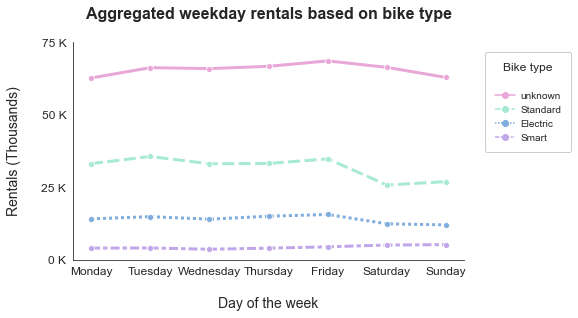

In [560]:
# set the palette as per requirement
sb.set_style('white')
# flatui = ["darkslateblue", "lightseagreen", "royalblue", "rebeccapurple"]
flatui = ['#ff91e2', '#91ffda', '#60acfc', '#bd91ff']
sb.set_palette(flatui, n_colors=4, desat=0.6)

plt.figure(figsize = [7, 4])
max_count = categorical_counts.rentals.max()
y_tick_values = np.arange(0, max_count + 25000, 25000)
y_tick_names = ['{:0.0f} K'.format(v/1000) for v in y_tick_values]

# plot line plot
ax = sb.lineplot(data = categorical_counts, x = "weekday", y = "rentals", hue="bike_type",
                 style="bike_type", err_style="bars", linewidth=3, markers = ['o', 'o', 'o', 'o'])
plt.title('Aggregated weekday rentals based on bike type\n', weight = 'bold', fontsize = 16)
plt.xticks(fontsize=12)
plt.yticks(y_tick_values, y_tick_names, fontsize=12)
plt.xlabel('\nDay of the week', fontsize=14)
plt.ylabel('Rentals (Thousands)\n', fontsize=14)

# when 'hue' is used, its label appears as legend title
# replace default title with custom title.
plt.legend(scatterpoints=1, frameon=True, fancybox=True, shadow=False, ncol = 1, framealpha = 1, 
           borderpad=1, borderaxespad=1, loc = 'upper right', labelspacing=0.5,  
           title='Bike type', title_fontsize=12, fontsize=10, facecolor='white', markerfirst=True, 
           handlelength=2, handletextpad=0.5, bbox_to_anchor=(1.3, 1)).texts[0].set_text("");

sb.despine();

# savefig by passing (bbox_inches='tight'),which will adjust dhe figure to include all of the x and y labels
plt.savefig('plots/3.2.40.b Line plot of Trip rentals based on bike type and day of the week.png', dpi=300, bbox_inches='tight')

**`Individual plots of aggregated distribution of weekday rentals over bike type:`**

<Figure size 576x288 with 0 Axes>

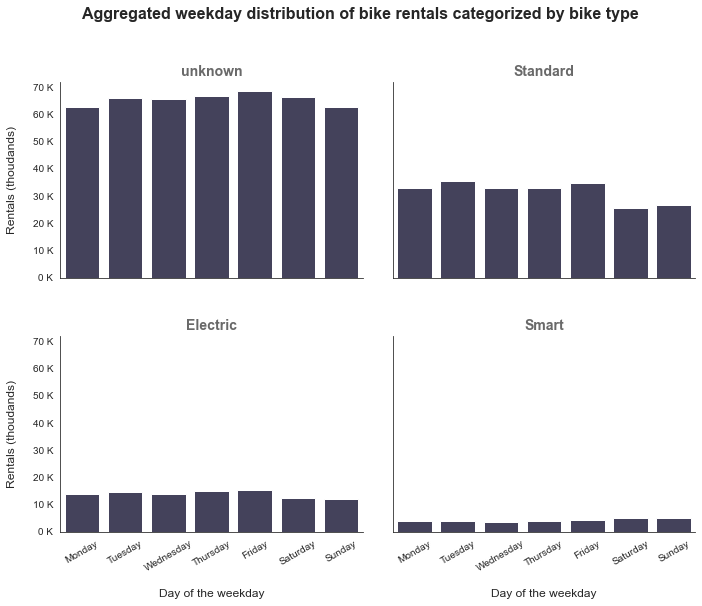

In [561]:
# set the palette as per requirement
flatui = ["#37326b", "#6eacdb"]
sb.set_palette(flatui, desat = 0.6)
base_color = sb.color_palette()[0]
sb.set_style('white')
plt.figure(figsize = [8, 4])

# plot facet grid
g = sb.FacetGrid(data = bikeshare, col = 'bike_type', col_wrap = 2, height = 4, aspect = 1.2)
g.map(sb.countplot, "weekday", color = base_color, order = bikeshare.weekday.sort_values(ascending=True).unique())
g.fig.subplots_adjust(top=0.85)
g.fig.suptitle('Aggregated weekday distribution of bike rentals categorized by bike type\n', fontsize = 16, weight = 'bold')
g.set_titles('{col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# obtain y_ticks and convert them to a multiple of millions
# obtain the x_ticks and store them as a list
y_tick_names = []
x_tick_names = []
for ax in g.axes.flat:
    for y_label in ax.get_yticklabels():
        y_label_value = int(y_label.get_text())
        y_label_new_value = '{:0.0f} K'.format(y_label_value/1000)
        y_tick_names.append(y_label_new_value)
        
    for x_label in ax.get_xticklabels():
        x_label_value = x_label.get_text()
        x_tick_names.append(x_label_value)

g.set_yticklabels(y_tick_names, size = 10)
g.set_xticklabels(x_tick_names, rotation = 30, size = 10)
g.set_xlabels('\nDay of the weekday', size = 12)
g.set_ylabels('Rentals (thoudands)\n', size = 12)

plt.subplots_adjust(wspace=0.1, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust dhe figure to include all of the x and y labels
plt.savefig('plots/3.2.40.c Facet grid of Trip rentals based on bike type and day of the week.png', dpi=300, bbox_inches='tight')

> Let us plot more variety of graphs to observe the distribution of data and hidden insights.

**`Heat Map:`**

> Now lets make a pivot from the categorical dataset created earlier into a more appropriate data structure.

In [562]:
categorical_counts = categorical_counts.pivot(index = 'bike_type', columns = 'weekday', values = 'rentals')
categorical_counts

weekday,Monday,Tuesday,Wednesday,Thursday,Friday,Saturday,Sunday
bike_type,,,,,,,
unknown,62614,66189,65857,66656,68524,66287,62808
Standard,33080,35546,33051,33139,34737,25707,26883
Electric,14034,14789,13926,14952,15544,12331,11953
Smart,3949,4002,3552,3935,4390,5016,5138


> The data is ready to be plotred as the `Heat map`.

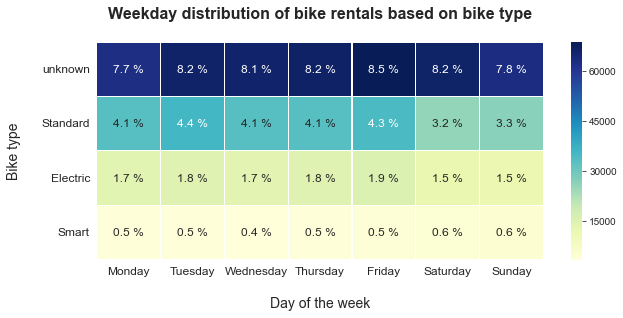

In [563]:
# plot heat map
plt.figure(figsize = [10, 4])
res = sb.heatmap(categorical_counts, annot = True, fmt = '.0f', annot_kws={'size':12}, linewidths=0.1, cmap="YlGnBu")
plt.yticks(rotation=0, fontsize="12", va="center")
plt.xticks(fontsize="12")
plt.title('Weekday distribution of bike rentals based on bike type\n', fontsize = 16, weight = 'bold')
plt.xlabel('\nDay of the week', fontsize=14)
plt.ylabel('Bike type\n', fontsize=14);

# convert annotations to percentages
for t in res.texts: 
    p = np.round(np.round(int(t.get_text())/bikeshare.shape[0], 4)*100, 1)
    t.set_text(str(p)+' %')
               
# savefig by passing (bbox_inches='tight'),which will adjust dhe figure to include all of the x and y labels
plt.savefig('plots/3.2.40.d Heat map of Trip rentals based on bike type and day of the week.png', dpi=300, bbox_inches='tight')

**`Find average rentals based on the daytime:`**

> The `bike_type` needs to be converted into categorical datatype, otherwise the `groupby` method will ignore `NaN` rental values and inturn produce **incorrect** `avg. rental value`. Also use of `size()` method ignores the unused level combinations of the groups, hence use `count()` method.

> Every fifth week in a month won't have all the occurances of the `weekday` as the month's are limited by uneven equal distribution of 7 day span (number of days in a week). Hence in order to accurately calculate the `average rentals` of the `weekday`, use `size()` method, which takes only the unique combinations in the occurances and ignores occurances with `NULL values`.

In [564]:
weekday_df = bikeshare.groupby([bikeshare["year"], 
                                bikeshare["month"],
                                bikeshare["week"],
                                bikeshare["weekday"],
                                bikeshare["bike_type"]]).size().reset_index(name='rentals')
weekday_df.head(10)

,year,month,week,weekday,bike_type,rentals
0,2017,1,First,Monday,unknown,259
1,2017,1,First,Tuesday,unknown,327
2,2017,1,First,Wednesday,unknown,350
3,2017,1,First,Thursday,unknown,231
4,2017,1,First,Friday,unknown,361
5,2017,1,First,Saturday,unknown,277
6,2017,1,First,Sunday,unknown,270
7,2017,1,Second,Monday,unknown,306
8,2017,1,Second,Tuesday,unknown,245
9,2017,1,Second,Wednesday,unknown,315


In [565]:
cat_order = weekday_df.weekday.sort_values(ascending=True).unique()
print('Weekday - Occurances')
weekday_df.weekday.value_counts()[cat_order]

Weekday - Occurances


Monday       247
Tuesday      248
Wednesday    244
Thursday     247
Friday       247
Saturday     246
Sunday       247
Name: weekday, dtype: int64

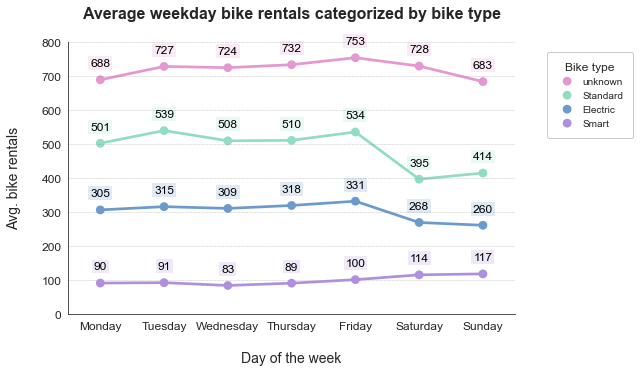

In [566]:
def assign_clr(bike): 
    if (bike == "unknown"): return sb.color_palette()[0] 
    elif (bike == "Standard"): return sb.color_palette()[1] 
    elif (bike == "Electric"): return sb.color_palette()[2] 
    elif (bike == "Smart"): return sb.color_palette()[3] 
    return 'gold'


plt.figure(figsize=[8,5])
sb.set_style('white')
# flatui = ['#ff91e2', '#91ffda', '#60acfc', '#bd91ff']
flatui = ['#ff7ddd', '#77f7cc', '#4b99eb', '#aa75fa']
sb.set_palette(flatui, n_colors=4, desat=0.6)
base_color = sb.color_palette()[0]

sb.pointplot(data = weekday_df, x = "weekday", y = "rentals", linestyles = "-", hue = 'bike_type', 
             scale = 1, ci = None)
plt.title('Average weekday bike rentals categorized by bike type\n',  weight = 'bold', fontsize = 16)
plt.ylabel('Avg. bike rentals\n', fontsize = 14)
plt.xlabel('\nDay of the week', fontsize = 14)
plt.xticks(fontsize = 12)

# get ytick locs and rearrage them with respect to zero
locs, labels = plt.yticks()
weekday_rental_avg_max = 800
y_tick_values = np.arange(0, weekday_rental_avg_max+100, 100)
y_tick_names = ['{:0.0f}'.format(v) for v in y_tick_values]
plt.yticks(y_tick_values, y_tick_names, fontsize = 12)

# add annotations
# -------------------------------------------------------
avg_rentals = weekday_df.groupby([weekday_df["bike_type"], weekday_df["weekday"]]).mean()['rentals'].reset_index()
avg_rentals_max = avg_rentals.rentals.max()
avg_rentals_unknown = avg_rentals.query(' bike_type == "unknown" ')
avg_rentals_standard = avg_rentals.query(' bike_type == "Standard" ')
avg_rentals_electric = avg_rentals.query(' bike_type == "Electric" ')
avg_rentals_smart = avg_rentals.query(' bike_type == "Smart" ')

# get the current tick locations and labels
locs, labels = plt.xticks()

for categorical_df in [avg_rentals_unknown, avg_rentals_standard, avg_rentals_electric, avg_rentals_smart]:
    clrs = [assign_clr(bike) for bike in categorical_df.bike_type]
    # loop through each pair of locations and labels
    for loc, label, avg_rental_count, clr in zip(locs, labels, categorical_df.rentals, clrs):
        try:
            count = avg_rental_count
        except KeyError:
            count = 0   
        pct_string = '{:0.0f}'.format(count)
        indent = 40
        # print the annotation depending on the bar length
        plt.text(loc, count + indent, pct_string, ha = 'center', color = 'black', 
                 fontsize = 12, bbox=dict(pad=1.9,alpha=0.2,color='none',fc=clr))
# -------------------------------------------------------

plt.legend(scatterpoints=1, frameon=True, fancybox=True, shadow=False, ncol = 1, 
           framealpha = 1, borderpad=1, borderaxespad=1, loc = 'upper left', labelspacing=0.5,  
           title='Bike type', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(1.05, 1))

sb.despine(top=True, right=True, left=False, bottom=False);

for loc in y_tick_values:
    plt.axhline(loc, ls='--', color='grey', linewidth=0.5, alpha=0.5)

# savefig by passing (bbox_inches='tight'),which will adjust dhe figure to include all of the x and y labels
plt.savefig('plots/3.2.40.e Average weekday bike rentals categorized by bike type.png', dpi=300, bbox_inches='tight')

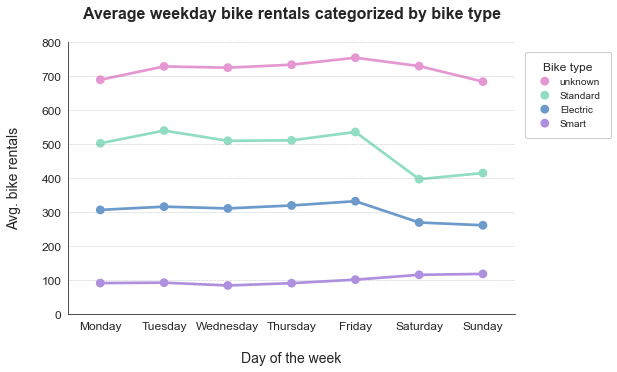

In [567]:
def assign_clr(bike): 
    if (bike == "unknown"): return sb.color_palette()[0] 
    elif (bike == "Standard"): return sb.color_palette()[1] 
    elif (bike == "Electric"): return sb.color_palette()[2] 
    elif (bike == "Smart"): return sb.color_palette()[3] 
    return 'gold'


plt.figure(figsize=[8,5])
sb.set_style('white')
# flatui = ['#ff91e2', '#91ffda', '#60acfc', '#bd91ff']
flatui = ['#ff7ddd', '#77f7cc', '#4b99eb', '#aa75fa']
sb.set_palette(flatui, n_colors=4, desat=0.6)
base_color = sb.color_palette()[0]

sb.pointplot(data = weekday_df, x = "weekday", y = "rentals", linestyles = "-", hue = 'bike_type', 
             scale = 1, ci = None)
plt.title('Average weekday bike rentals categorized by bike type\n',  weight = 'bold', fontsize = 16)
plt.ylabel('Avg. bike rentals\n', fontsize = 14)
plt.xlabel('\nDay of the week', fontsize = 14)
plt.xticks(fontsize = 12)

# get ytick locs and rearrage them with respect to zero
locs, labels = plt.yticks()
weekday_rental_avg_max = 800
y_tick_values = np.arange(0, weekday_rental_avg_max+100, 100)
y_tick_names = ['{:0.0f}'.format(v) for v in y_tick_values]
plt.yticks(y_tick_values, y_tick_names, fontsize = 12)

plt.legend(scatterpoints=1, frameon=True, fancybox=True, shadow=False, ncol = 1, 
           framealpha = 1, borderpad=1, borderaxespad=1, loc = 'upper left', labelspacing=0.5,  
           title='Bike type', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(1, 1))

sb.despine(top=True, right=True, left=False, bottom=False);

for loc in y_tick_values:
    plt.axhline(loc, ls='--', color='grey', linewidth=0.5, alpha=0.5)

# savefig by passing (bbox_inches='tight'),which will adjust dhe figure to include all of the x and y labels
plt.savefig('plots/3.2.40.f Average weekday bike rentals categorized by bike type.png', dpi=300, bbox_inches='tight')

------

#### 3.2.41 Bivariate analysis of `bikeshare.weekday` and `pass_type` columns:

+ `Columns`: weekday, pass_type
+ `Data type`: (Categorical, ordered) and (Categorical, nominal)
+ `Plot`: Facet Grid, Violin plot, Box plot, Adapted Barchart

**`Stack plot:`**

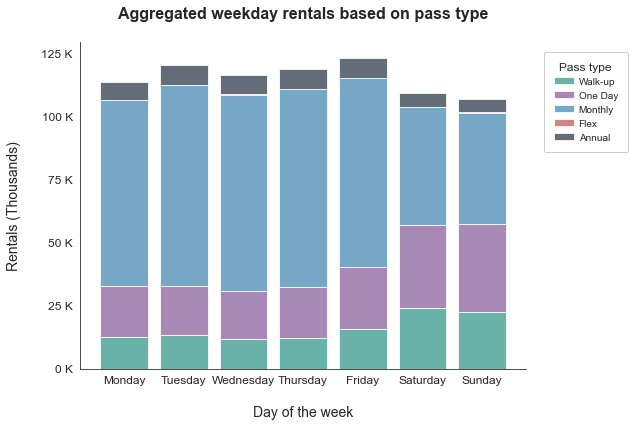

In [568]:
# Assign palette as per requirement
sb.set_style('white')
plt.figure(figsize = [8, 6])
flatui = ["#26bda7", "#9b59b6", "#3498db", "#e74c3c", "#34495e"]
sb.set_palette(flatui, n_colors=5, desat=0.6)

cat1_order = bikeshare.weekday.sort_values(ascending=True).unique()
cat2_order = bikeshare.pass_type.sort_values(ascending=True).unique()

# plot stacked plot
baselines = np.zeros(len(cat1_order))
# for each second-variable category:
for i in range(len(cat2_order)):
    # isolate the counts of the first category,
    cat2 = cat2_order[i]
    inner_counts = bikeshare[bikeshare['pass_type'] == cat2]['weekday'].value_counts()
    # then plot those counts on top of the accumulated baseline
    plt.bar(x = np.arange(len(cat1_order)), height = inner_counts[cat1_order].fillna(0),
            bottom = baselines, alpha = 0.8)
    baselines += inner_counts[cat1_order].fillna(0)

# improve plot aesthetics
max_count = bikeshare.groupby([bikeshare['weekday']]).size().reset_index(name='rentals').max()['rentals']
y_tick_values = np.arange(0, max_count + 25000, 25000)
y_tick_names = ['{:0.0f} K'.format(v/1000) for v in y_tick_values]

plt.title('Aggregated weekday rentals based on pass type\n', weight = 'bold', fontsize = 16)
plt.xticks(np.arange(len(cat1_order)), cat1_order, fontsize=12)
plt.yticks(y_tick_values, y_tick_names, fontsize=12)
plt.xlabel('\nDay of the week', fontsize=14)
plt.ylabel('Rentals (Thousands)\n', fontsize=14)
plt.legend(cat2_order, scatterpoints=1, frameon=True, fancybox=True, shadow=False, ncol = 1, 
           framealpha = 1, borderpad=1, borderaxespad=1, loc = 'upper right', labelspacing=0.5,  
           title='Pass type', title_fontsize=12, fontsize=10, facecolor='white',
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(1.25, 1))

sb.despine();

# savefig by passing (bbox_inches='tight'),which will adjust dhe figure to include all of the x and y labels
plt.savefig('plots/3.2.41.a Stack plot of Trip rentals based on pass type and day of the week.png', dpi=300, bbox_inches='tight')

**`Line plot:`**

> The data needs some summirization by grouping together the respective variables. Then, reset the index and name the summerized data values accordingly.

In [569]:
categorical_counts = bikeshare.groupby([bikeshare['pass_type'], 
                                        bikeshare['weekday']]).size().reset_index(name='rentals')
categorical_counts.head(10)

,pass_type,weekday,rentals
0,Walk-up,Monday,12357
1,Walk-up,Tuesday,13364
2,Walk-up,Wednesday,11855
3,Walk-up,Thursday,12228
4,Walk-up,Friday,15517
5,Walk-up,Saturday,24164
6,Walk-up,Sunday,22593
7,One Day,Monday,20560
8,One Day,Tuesday,19251
9,One Day,Wednesday,18923


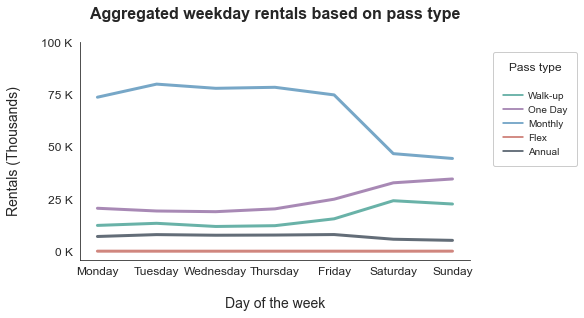

In [570]:
# set the palette as per requirement
sb.set_style('white')
flatui = ["#26bda7", "#9b59b6", "#3498db", "#e74c3c", "#34495e"]
sb.set_palette(flatui, n_colors=5, desat=0.6)

plt.figure(figsize = [7, 4])
max_count = categorical_counts.rentals.max()
y_tick_values = np.arange(0, max_count + 25000, 25000)
y_tick_names = ['{:0.0f} K'.format(v/1000) for v in y_tick_values]

# plot line plot
ax = sb.lineplot(data=categorical_counts, x = "weekday", y = "rentals", hue="pass_type",
                 alpha = 0.8, err_style="bars", linewidth=3)
plt.title('Aggregated weekday rentals based on pass type\n', weight = 'bold', fontsize = 16)
plt.xticks(fontsize=12)
plt.yticks(y_tick_values, y_tick_names, fontsize=12)
plt.xlabel('\nDay of the week', fontsize=14)
plt.ylabel('Rentals (Thousands)\n', fontsize=14)

# when 'hue' is used, its label appears as legend title
# replace default title with custom title.
ax.legend(scatterpoints=1, frameon=True, fancybox=True, shadow=False, ncol = 1, framealpha = 1, 
          borderpad=1, borderaxespad=1, loc = 'upper right', labelspacing=0.5, title = "Pass type",
          title_fontsize=12, fontsize=10, facecolor='white', markerfirst=True, handlelength=2,
          handletextpad=0.5, bbox_to_anchor=(1.3, 1)).texts[0].set_text("")

sb.despine();

# savefig by passing (bbox_inches='tight'),which will adjust dhe figure to include all of the x and y labels
plt.savefig('plots/3.2.41.b Line plot of Trip rentals based on pass type and day of the week.png', dpi=300, bbox_inches='tight')

**`Individual plots of aggregated distribution of weekday rentals over pass type:`**

<Figure size 576x288 with 0 Axes>

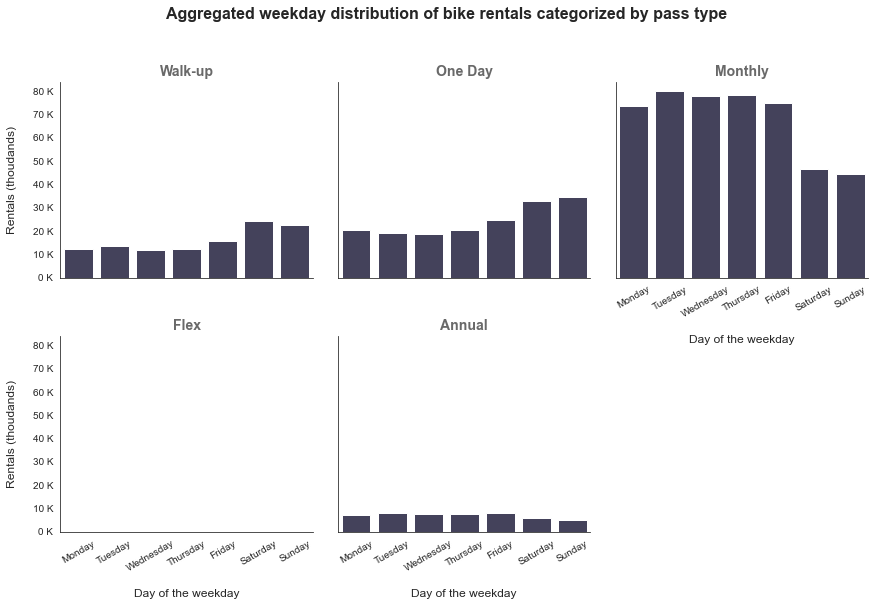

In [571]:
# set the palette as per requirement
flatui = ["#37326b", "#6eacdb"]
sb.set_palette(flatui, desat = 0.6)
base_color = sb.color_palette()[0]
sb.set_style('white')
plt.figure(figsize = [8, 4])

# plot facet grid
g = sb.FacetGrid(data = bikeshare, col = 'pass_type', col_wrap = 3, height = 4, aspect = 1)
g.map(sb.countplot, "weekday", color = base_color, order = bikeshare.weekday.sort_values(ascending=True).unique())
g.fig.subplots_adjust(top=0.85)
g.fig.suptitle('Aggregated weekday distribution of bike rentals categorized by pass type\n', fontsize = 16, weight = 'bold')
g.set_titles('{col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# obtain y_ticks and convert them to a multiple of millions
# obtain the x_ticks and store them as a list
y_tick_names = []
x_tick_names = []
for ax in g.axes.flat:
    for y_label in ax.get_yticklabels():
        y_label_value = int(y_label.get_text())
        y_label_new_value = '{:0.0f} K'.format(y_label_value/1000)
        y_tick_names.append(y_label_new_value)
        
    for x_label in ax.get_xticklabels():
        x_label_value = x_label.get_text()
        x_tick_names.append(x_label_value)

g.set_yticklabels(y_tick_names, size = 10)
g.set_xticklabels(x_tick_names, rotation = 30, size = 10)
g.set_xlabels('\nDay of the weekday', size = 12)
g.set_ylabels('Rentals (thoudands)\n', size = 12)

plt.subplots_adjust(wspace=0.1, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust dhe figure to include all of the x and y labels
plt.savefig('plots/3.2.41.c Facet grid of Trip rentals based on pass type and day of the week.png', dpi=300, bbox_inches='tight')

> Let us plot more variety of graphs to observe the distribution of data and hidden insights.

**`Heat Map:`**

> Now lets make a pivot from the categorical dataset created earlier into a more appropriate data structure.

In [572]:
categorical_counts = categorical_counts.pivot(index = 'pass_type', columns = 'weekday', values = 'rentals')
categorical_counts

weekday,Monday,Tuesday,Wednesday,Thursday,Friday,Saturday,Sunday
pass_type,,,,,,,
Walk-up,12357,13364,11855,12228,15517,24164,22593
One Day,20560,19251,18923,20271,24895,32727,34565
Monthly,73654,79915,77911,78396,74757,46670,44363
Flex,42,35,32,37,37,28,52
Annual,7064,7961,7665,7750,7989,5752,5209


> The data is ready to be plotred as the `Heat map`.

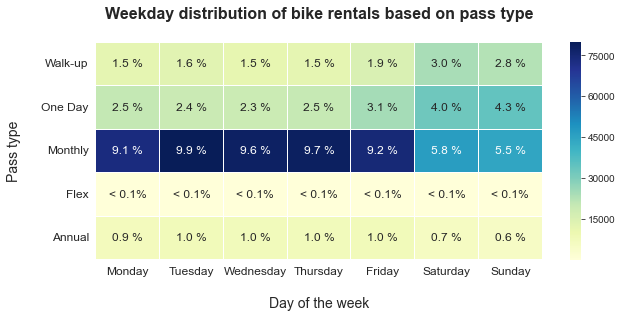

In [573]:
# plot heat map
plt.figure(figsize = [10, 4])
res = sb.heatmap(categorical_counts, annot = True, fmt = '.0f', annot_kws={'size':12}, linewidths=0.1, cmap="YlGnBu")
plt.yticks(rotation=0, fontsize="12", va="center")
plt.xticks(fontsize="12")
plt.title('Weekday distribution of bike rentals based on pass type\n', fontsize = 16, weight = 'bold')
plt.xlabel('\nDay of the week', fontsize=14)
plt.ylabel('Pass type\n', fontsize=14);

# convert annotations to percentages
for t in res.texts: 
    p = np.round(np.round(int(t.get_text())/bikeshare.shape[0], 4)*100, 1)
    if p < 0.1:
        t.set_text('< 0.1%')
    else:
        t.set_text(str(p)+' %');  

# savefig by passing (bbox_inches='tight'),which will adjust dhe figure to include all of the x and y labels
plt.savefig('plots/3.2.41.d Heat map of Trip rentals based on pass type and day of the week.png', dpi=300, bbox_inches='tight')

**`Find average rentals based on the weekday:`**

> The `pass_type` needs to be converted into categorical datatype, otherwise the `groupby` method will ignore `NaN` rental values and inturn produce **incorrect** `avg. rental value`. Also use of `size()` method ignores the unused level combinations of the groups, hence use `count()` method.

> Every fifth week in a month won't have all the occurances of the `weekday` as the month's are limited by uneven equal distribution of 7 day span (number of days in a week). Hence in order to accurately calculate the `average rentals` of the `weekday`, use `size()` method, which takes only the unique combinations in the occurances and ignores occurances with `NULL values`.

In [574]:
weekday_df = bikeshare.groupby([bikeshare["year"], 
                                bikeshare["month"],
                                bikeshare["week"],
                                bikeshare["weekday"],
                                bikeshare["pass_type"]]).size().reset_index(name='rentals')
weekday_df.head(10)

,year,month,week,weekday,pass_type,rentals
0,2017,1,First,Monday,Walk-up,115
1,2017,1,First,Monday,Monthly,121
2,2017,1,First,Monday,Annual,23
3,2017,1,First,Tuesday,Walk-up,73
4,2017,1,First,Tuesday,Monthly,234
5,2017,1,First,Tuesday,Annual,20
6,2017,1,First,Wednesday,Walk-up,81
7,2017,1,First,Wednesday,Monthly,244
8,2017,1,First,Wednesday,Annual,25
9,2017,1,First,Thursday,Walk-up,38


In [575]:
cat_order = weekday_df.weekday.sort_values(ascending=True).unique()
print('Weekday - Occurances')
weekday_df.weekday.value_counts()[cat_order]

Weekday - Occurances


Monday       521
Tuesday      519
Wednesday    516
Thursday     514
Friday       517
Saturday     516
Sunday       521
Name: weekday, dtype: int64

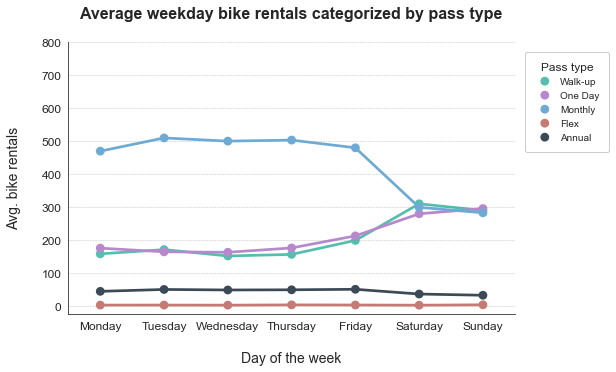

In [576]:
def assign_clr(pass_type): 
    if (pass_type == "Walk-up"): return sb.color_palette()[0] 
    elif (pass_type == "One Day"): return sb.color_palette()[1] 
    elif (pass_type == "Monthly"): return sb.color_palette()[2] 
    elif (pass_type == "Flex"): return sb.color_palette()[3]
    elif (pass_type == "Annual"): return sb.color_palette()[4]
    return 'gold'


plt.figure(figsize=[8,5])
sb.set_style('white')
flatui = ["#34e0c7", "#c271e3", "#4cb1f5", "#e06458", "#34495e"]
sb.set_palette(flatui, n_colors=5, desat=0.6)
base_color = sb.color_palette()[0]

sb.pointplot(data = weekday_df, x = "weekday", y = "rentals", linestyles = "-", hue = 'pass_type', 
             scale = 1, ci = None)
plt.title('Average weekday bike rentals categorized by pass type\n',  weight = 'bold', fontsize = 16)
plt.ylabel('Avg. bike rentals\n', fontsize = 14)
plt.xlabel('\nDay of the week', fontsize = 14)
plt.xticks(fontsize = 12)

# get ytick locs and rearrage them with respect to zero
locs, labels = plt.yticks()
weekday_rental_avg_max = 800
y_tick_values = np.arange(0, weekday_rental_avg_max+100, 100)
y_tick_names = ['{:0.0f}'.format(v) for v in y_tick_values]
plt.yticks(y_tick_values, y_tick_names, fontsize = 12)

plt.legend(scatterpoints=1, frameon=True, fancybox=True, shadow=False, ncol = 1, 
           framealpha = 1, borderpad=1, borderaxespad=1, loc = 'upper left', labelspacing=0.5,  
           title='Pass type', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(1, 1))

sb.despine(top=True, right=True, left=False, bottom=False);

for loc in y_tick_values:
    plt.axhline(loc, ls='--', color='grey', linewidth=0.5, alpha=0.5)

# savefig by passing (bbox_inches='tight'),which will adjust dhe figure to include all of the x and y labels
plt.savefig('plots/3.2.41.e Average weekday bike rentals categorized by pass type.png', dpi=300, bbox_inches='tight')

---

#### 3.2.42 Bivariate analysis of `bikeshare.weekday` and `fare_type` columns:

+ `Columns`: weekday, fare_type
+ `Data type`: (Categorical, ordered) and (Categorical, nominal)
+ `Plot`: Facet Grid, Violin plot, Box plot, Adapted Barchart

**`Stack plot:`**

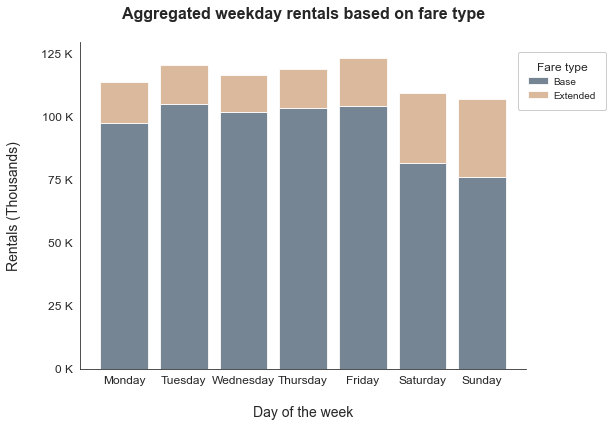

In [577]:
# Assign palette as per requirement
sb.set_style('white')
plt.figure(figsize = [8, 6])
flatui = ['#466887', '#eda668']
sb.set_palette(flatui, n_colors=2, desat=0.6)

cat1_order = bikeshare.weekday.sort_values(ascending=True).unique()
cat2_order = bikeshare.fare_type.sort_values(ascending=True).unique()

# plot stacked plot
baselines = np.zeros(len(cat1_order))
# for each second-variable category:
for i in range(len(cat2_order)):
    # isolate the counts of the first category,
    cat2 = cat2_order[i]
    inner_counts = bikeshare[bikeshare['fare_type'] == cat2]['weekday'].value_counts()
    # then plot those counts on top of the accumulated baseline
    plt.bar(x = np.arange(len(cat1_order)), height = inner_counts[cat1_order].fillna(0),
            bottom = baselines, alpha = 0.8)
    baselines += inner_counts[cat1_order].fillna(0)

# improve plot aesthetics
max_count = bikeshare.groupby([bikeshare['weekday']]).size().reset_index(name='rentals').max()['rentals']
y_tick_values = np.arange(0, max_count + 25000, 25000)
y_tick_names = ['{:0.0f} K'.format(v/1000) for v in y_tick_values]

plt.title('Aggregated weekday rentals based on fare type\n', weight = 'bold', fontsize = 16)
plt.xticks(np.arange(len(cat1_order)), cat1_order, fontsize=12)
plt.yticks(y_tick_values, y_tick_names, fontsize=12)
plt.xlabel('\nDay of the week', fontsize=14)
plt.ylabel('Rentals (Thousands)\n', fontsize=14)
plt.legend(cat2_order, scatterpoints=1, frameon=True, fancybox=True, shadow=False, ncol = 1, 
           framealpha = 1, borderpad=1, borderaxespad=1, loc = 'upper right', labelspacing=0.5,  
           title='Fare type', title_fontsize=12, fontsize=10, facecolor='white',
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(1.2, 1))

sb.despine();

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.42.a Stack plot of rentals based on fare type and day of the week.png', dpi=300, bbox_inches='tight')

**`Line plot:`**

> The data needs some summirization by grouping together the respective variables. Then, reset the index and name the summerized data values accordingly.

In [578]:
categorical_counts = bikeshare.groupby([bikeshare['fare_type'], 
                                        bikeshare['weekday']]).size().reset_index(name='rentals')
categorical_counts.head(10)

,fare_type,weekday,rentals
0,Base,Monday,97485
1,Base,Tuesday,104907
2,Base,Wednesday,101804
3,Base,Thursday,103150
4,Base,Friday,104070
5,Base,Saturday,81434
6,Base,Sunday,75939
7,Extended,Monday,16192
8,Extended,Tuesday,15619
9,Extended,Wednesday,14582


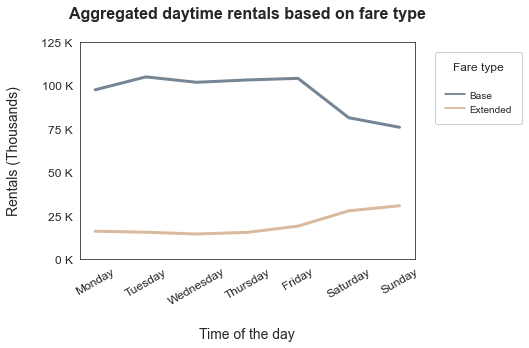

In [579]:
# set the palette as per requirement
sb.set_style('white')
flatui = ['#466887', '#eda668']
sb.set_palette(flatui, n_colors=2, desat=0.6)

plt.figure(figsize = [6, 4])
max_count = categorical_counts.rentals.max()
y_tick_values = np.arange(0, max_count + 25000, 25000)
y_tick_names = ['{:0.0f} K'.format(v/1000) for v in y_tick_values]

# plot line plot
ax = sb.lineplot(data=categorical_counts, x = "weekday", y = "rentals", hue="fare_type", 
                 alpha = 0.8, err_style="bars", linewidth=3)
plt.title('Aggregated daytime rentals based on fare type\n', weight = 'bold', fontsize = 16)
plt.xticks(rotation = 30, fontsize=12)
plt.yticks(y_tick_values, y_tick_names, fontsize=12)
plt.xlabel('\nTime of the day', fontsize=14)
plt.ylabel('Rentals (Thousands)\n', fontsize=14)

# when 'hue' is used, its label appears as legend title
# replace default title with custom title.
ax.legend(scatterpoints=1, frameon=True, fancybox=True, shadow=False, ncol = 1, framealpha = 1, 
           borderpad=1, borderaxespad=1, loc = 'upper right', labelspacing=0.5,  
           title='Fare type', title_fontsize=12, fontsize=10, facecolor='white', markerfirst=True, 
           handlelength=2, handletextpad=0.5, bbox_to_anchor=(1.35, 1)).texts[0].set_text("");

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.42.b Line plot of rentals based on fare type and day of the week.png', dpi=300, bbox_inches='tight')

**`Individual plots of aggregated distribution of weekday rentals over fare type:`**

<Figure size 576x288 with 0 Axes>

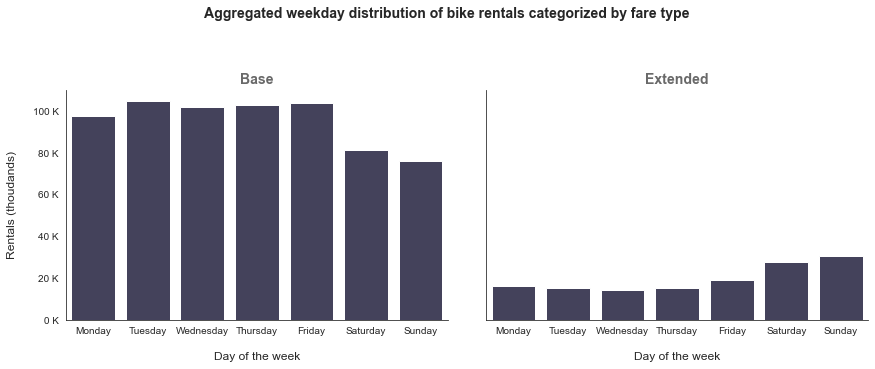

In [580]:
# set the palette as per requirement
flatui = ["#37326b", "#6eacdb"]
sb.set_palette(flatui, desat = 0.6)
base_color = sb.color_palette()[0]
sb.set_style('white')
plt.figure(figsize = [8, 4])

# plot facet grid
g = sb.FacetGrid(data = bikeshare, col = 'fare_type', col_wrap = 2, height = 5, aspect = 1.2)
g.map(sb.countplot, "weekday", color = base_color, order = bikeshare.weekday.sort_values(ascending=True).unique())
g.fig.subplots_adjust(top=0.75)
g.fig.suptitle('Aggregated weekday distribution of bike rentals categorized by fare type\n', fontsize = 14, weight = 'bold')
g.set_titles('{col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# obtain y_ticks and convert them to a multiple of millions
# obtain the x_ticks and store them as a list
y_tick_names = []
x_tick_names = []
for ax in g.axes.flat:
    for y_label in ax.get_yticklabels():
        y_label_value = int(y_label.get_text())
        y_label_new_value = '{:0.0f} K'.format(y_label_value/1000)
        y_tick_names.append(y_label_new_value)
        
    for x_label in ax.get_xticklabels():
        x_label_value = x_label.get_text()
        x_tick_names.append(x_label_value)

g.set_yticklabels(y_tick_names, size = 10)
g.set_xticklabels(x_tick_names, size = 10)
g.set_xlabels('\nDay of the week', size = 12)
g.set_ylabels('Rentals (thoudands)\n', size = 12)

plt.subplots_adjust(wspace=0.1, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.42.c Facet grid of rentals based on fare type and day of the week.png', dpi=300, bbox_inches='tight')

> Let us plot more variety of graphs to observe the distribution of data and hidden insights.

**`Heat Map:`**

> Now lets make a pivot from the categorical dataset created earlier into a more appropriate data structure.

In [581]:
categorical_counts = categorical_counts.pivot(index = 'fare_type', columns = 'weekday', values = 'rentals')
categorical_counts

weekday,Monday,Tuesday,Wednesday,Thursday,Friday,Saturday,Sunday
fare_type,,,,,,,
Base,97485,104907,101804,103150,104070,81434,75939
Extended,16192,15619,14582,15532,19125,27907,30843


> The data is ready to be plotred as the `Heat map`.

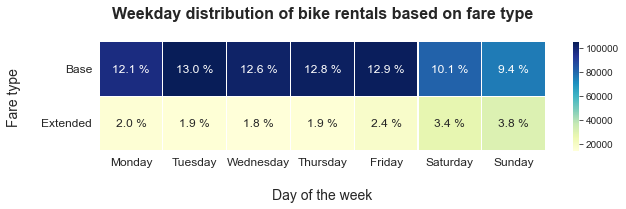

In [582]:
# plot heat map
plt.figure(figsize = [10, 2])
res = sb.heatmap(categorical_counts, annot = True, fmt = '.0f', annot_kws={'size':12}, linewidths=0.1, cmap="YlGnBu")
plt.yticks(rotation=0, fontsize="12", va="center")
plt.xticks(fontsize="12")
plt.title('Weekday distribution of bike rentals based on fare type\n', fontsize = 16, weight = 'bold')
plt.xlabel('\nDay of the week', fontsize=14)
plt.ylabel('Fare type\n', fontsize=14);

# convert annotations to percentages
for t in res.texts: 
    p = np.round(np.round(int(t.get_text())/bikeshare.shape[0], 4)*100, 1)
    if p < 0.1:
        t.set_text('< 0.1%')
    else:
        t.set_text(str(p)+' %');  

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.42.d Heat map of rentals based on fare type and day of the week.png', dpi=300, bbox_inches='tight')

**`Find average rentals based on the weekday:`**

> The `fare_type` needs to be converted into categorical datatype, otherwise the `groupby` method will ignore `NaN` rental values and inturn produce **incorrect** `avg. rental value`. Also use of `size()` method ignores the unused level combinations of the groups, hence use `count()` method.

> Every fifth week in a month won't have all the occurances of the `weekday` as the month's are limited by uneven equal distribution of 7 day span (number of days in a week). Hence in order to accurately calculate the `average rentals` of the `weekday`, use `size()` method, which takes only the unique combinations in the occurances and ignores occurances with `NULL values`.

In [583]:
weekday_df = bikeshare.groupby([bikeshare["year"], 
                                bikeshare["month"],
                                bikeshare["week"],
                                bikeshare["weekday"],
                                bikeshare["fare_type"]]).size().reset_index(name='rentals')
weekday_df.head(10)

,year,month,week,weekday,fare_type,rentals
0,2017,1,First,Monday,Base,214
1,2017,1,First,Monday,Extended,45
2,2017,1,First,Tuesday,Base,296
3,2017,1,First,Tuesday,Extended,31
4,2017,1,First,Wednesday,Base,322
5,2017,1,First,Wednesday,Extended,28
6,2017,1,First,Thursday,Base,216
7,2017,1,First,Thursday,Extended,15
8,2017,1,First,Friday,Base,335
9,2017,1,First,Friday,Extended,26


In [584]:
cat_order = weekday_df.weekday.sort_values(ascending=True).unique()
print('Weekday - Occurances')
weekday_df.weekday.value_counts()[cat_order]

Weekday - Occurances


Monday       314
Tuesday      314
Wednesday    312
Thursday     312
Friday       312
Saturday     312
Sunday       314
Name: weekday, dtype: int64

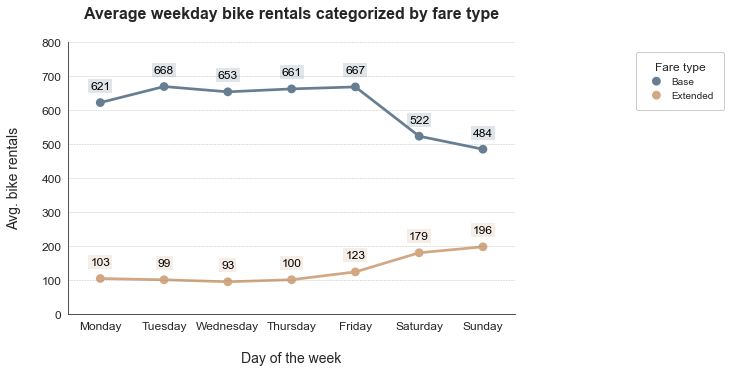

In [585]:
plt.figure(figsize=[8,5])
sb.set_style('white')
flatui = ['#577da1', '#eda668']
sb.set_palette(flatui, n_colors=2, desat=0.6)
base_color = sb.color_palette()[0]

sb.pointplot(data = weekday_df, x = "weekday", y = "rentals", linestyles = "-", hue = 'fare_type', 
             scale = 1, ci = None)
plt.title('Average weekday bike rentals categorized by fare type\n',  weight = 'bold', fontsize = 16)
plt.ylabel('Avg. bike rentals\n', fontsize = 14)
plt.xlabel('\nDay of the week', fontsize = 14)
plt.xticks(fontsize = 12)

# get ytick locs and rearrage them with respect to zero
locs, labels = plt.yticks()
weekday_rental_avg_max = 800
y_tick_values = np.arange(0, weekday_rental_avg_max+100, 100)
y_tick_names = ['{:0.0f}'.format(v) for v in y_tick_values]
plt.yticks(y_tick_values, y_tick_names, fontsize = 12)

# add annotations
# -------------------------------------------------------
avg_rentals = weekday_df.groupby([weekday_df["fare_type"], weekday_df["weekday"]]).mean()['rentals'].reset_index()
avg_rentals_max = avg_rentals.rentals.max()
avg_rentals_base = avg_rentals.query(' fare_type == "Base" ')
avg_rentals_extended = avg_rentals.query(' fare_type == "Extended" ')

# get the current tick locations and labels
locs, labels = plt.xticks()

for categorical_df in [avg_rentals_base, avg_rentals_extended]:
    clrs = [sb.color_palette()[0] if fare == "Base" else sb.color_palette()[1] for fare in categorical_df.fare_type ]
    # loop through each pair of locations and labels
    for loc, label, avg_rental_count, clr in zip(locs, labels, categorical_df.rentals, clrs):
        try:
            count = avg_rental_count
        except KeyError:
            count = 0   
        pct_string = '{:0.0f}'.format(count)
        indent = 40
        # print the annotation depending on the bar length
        plt.text(loc, count + indent, pct_string, ha = 'center', color = 'black', 
                 fontsize = 12, bbox=dict(pad=1.9,alpha=0.2,color='none',fc=clr))
# -------------------------------------------------------

plt.legend(scatterpoints=1, frameon=True, fancybox=True, shadow=False, ncol = 1, 
           framealpha = 1, borderpad=1, borderaxespad=1, loc = 'upper left', labelspacing=0.5,  
           title='Fare type', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(1.25, 1))

sb.despine(top=True, right=True, left=False, bottom=False);

for loc in y_tick_values:
    plt.axhline(loc, ls='--', color='grey', linewidth=0.5, alpha=0.5)

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.42.e Average weekday bike rentals categorized by fare type.png', dpi=300, bbox_inches='tight')

Average weekday bike rentals categorized by fare type, that potray the incremental/decremental of average rentals compared to previous day.

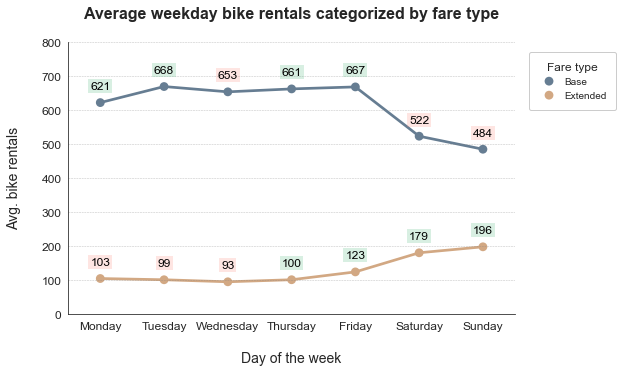

In [586]:
def assign_clrs(counts):
    clr_list = []
    for i in range(len(counts)):
        try:
            if counts[i] > counts[i-1]:
                clr_list.append('mediumseagreen')
            else:
                clr_list.append('salmon')
        except KeyError:
            clr_list.append('mediumseagreen')
    return clr_list


plt.figure(figsize=[8,5])
sb.set_style('white')
flatui = ['#577da1', '#eda668']
sb.set_palette(flatui, n_colors=2, desat=0.6)
base_color = sb.color_palette()[0]

sb.pointplot(data = weekday_df, x = "weekday", y = "rentals", linestyles = "-", hue = 'fare_type', 
             scale = 1, ci = None)
plt.title('Average weekday bike rentals categorized by fare type\n',  weight = 'bold', fontsize = 16)
plt.ylabel('Avg. bike rentals\n', fontsize = 14)
plt.xlabel('\nDay of the week', fontsize = 14)
plt.xticks(fontsize = 12)

# get ytick locs and rearrage them with respect to zero
locs, labels = plt.yticks()
weekday_rental_avg_max = 800
y_tick_values = np.arange(0, weekday_rental_avg_max+100, 100)
y_tick_names = ['{:0.0f}'.format(v) for v in y_tick_values]
plt.yticks(y_tick_values, y_tick_names, fontsize = 12)

# add annotations
# -------------------------------------------------------
avg_rentals = weekday_df.groupby([weekday_df["fare_type"], weekday_df["weekday"]]).mean()['rentals'].reset_index()
avg_rentals_base = avg_rentals.query(' fare_type == "Base" ')
avg_rentals_extended = avg_rentals.query(' fare_type == "Extended" ')

# get the current tick locations and labels
locs, labels = plt.xticks()

for categorical_df in [avg_rentals_base, avg_rentals_extended]:
    avg_rental_counts = list(categorical_df.rentals)
    clrs = assign_clrs(avg_rental_counts)
    
    # loop through each pair of locations and labels
    for loc, label, avg_rental_count, clr in zip(locs, labels, categorical_df.rentals, clrs):
        try:
            count = avg_rental_count
        except KeyError:
            count = 0   
        pct_string = '{:0.0f}'.format(count)
        indent = 40
        # print the annotation depending on the bar length
        plt.text(loc, count + indent, pct_string, ha = 'center', color = 'black', 
                 fontsize = 12, bbox=dict(pad=1.9,alpha=0.2,color='none',fc=clr))
# -------------------------------------------------------

plt.legend(scatterpoints=1, frameon=True, fancybox=True, shadow=False, ncol = 1, 
           framealpha = 1, borderpad=1, borderaxespad=1, loc = 'upper right', labelspacing=0.5,  
           title='Fare type', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(1.25, 1))

sb.despine(top=True, right=True, left=False, bottom=False);

for loc in y_tick_values:
    plt.axhline(loc, ls='--', color='grey', linewidth=0.5, alpha=0.5)

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.42.f Average weekday bike rentals categorized by fare type.png', dpi=300, bbox_inches='tight')

----

#### 3.2.43 Bivariate analysis of `bikeshare.month` and `trip_type` columns:

+ `Columns`: month, trip_type
+ `Data type`: (Categorical, ordered) and (Categorical, nominal)
+ `Plot`: Facet Grid, Violin plot, Box plot, Adapted Barchart

**`Stack plot:`**

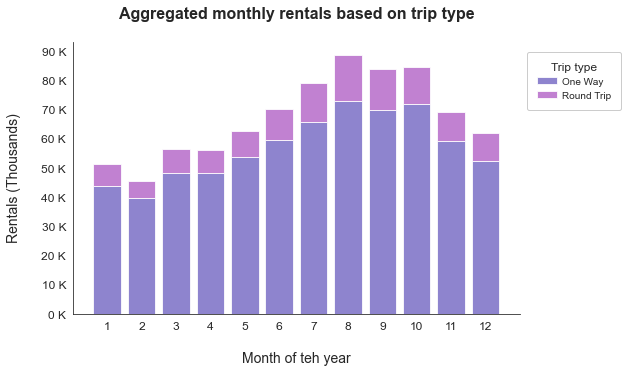

In [587]:
sb.set_style('white')
flatui = ["slateblue", "mediumorchid"]
sb.set_palette(flatui, desat = 0.8)
base_color = sb.color_palette()[0]
plt.figure(figsize = [8, 5])

cat1_order = bikeshare.month.sort_values(ascending=True).unique()
cat2_order = bikeshare.trip_type.sort_values(ascending=True).unique()

# plot stacked plot
baselines = np.zeros(len(cat1_order))
# for each second-variable category:
for i in range(len(cat2_order)):
    # isolate the counts of the first category,
    cat2 = cat2_order[i]
    inner_counts = bikeshare[bikeshare['trip_type'] == cat2]['month'].value_counts()
    # then plot those counts on top of the accumulated baseline
    plt.bar(x = np.arange(len(cat1_order)), height = inner_counts[cat1_order].fillna(0),
            bottom = baselines, alpha =0.8)
    baselines += inner_counts[cat1_order].fillna(0)

# improve plot aesthetics
max_count = bikeshare.groupby([bikeshare['month']]).size().reset_index(name='rentals').max()['rentals']
y_tick_values = np.arange(0, max_count + 10000, 10000)
y_tick_names = ['{:0.0f} K'.format(v/1000) for v in y_tick_values]

plt.title('Aggregated monthly rentals based on trip type\n', weight = 'bold', fontsize = 16)
plt.xticks(np.arange(len(cat1_order)), cat1_order, fontsize=12)
plt.yticks(y_tick_values, y_tick_names, fontsize=12)
plt.xlabel('\nMonth of teh year', fontsize=14)
plt.ylabel('Rentals (Thousands)\n', fontsize=14)
plt.legend(cat2_order, scatterpoints=1, frameon=True, fancybox=True, shadow=False, ncol = 1, 
           framealpha = 1, borderpad=1, borderaxespad=1, loc = 'upper right', labelspacing=0.5,  
           title='Trip type', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(1.25, 1))

sb.despine();

# savefig by passing (bbox_inches='tight'),which will adjust dhe figure to include all of the x and y labels
plt.savefig('plots/3.2.43.a Stack plot of Trip rentals based on trip type and month of the year.png', dpi=300, bbox_inches='tight')

**`Line Plot:`**

> The data needs some summirization by grouping together the respective variables. Then, reset the index and name the summerized data values accordingly.

In [588]:
categorical_counts = bikeshare.groupby([bikeshare['trip_type'], 
                                        bikeshare['month']]).size().reset_index(name='rentals')
categorical_counts.head(10)

,trip_type,month,rentals
0,One Way,1,43895
1,One Way,2,39607
2,One Way,3,48106
3,One Way,4,48041
4,One Way,5,53832
5,One Way,6,59372
6,One Way,7,65649
7,One Way,8,72773
8,One Way,9,69629
9,One Way,10,71924


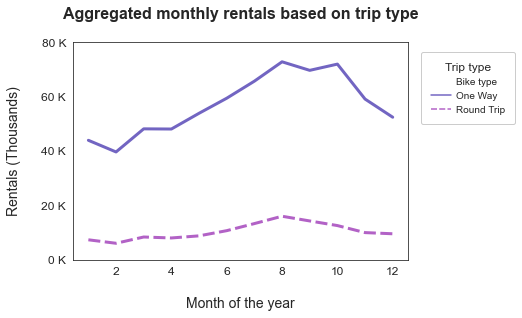

In [589]:
# set the palette as per requirement
flatui = ["slateblue", "mediumorchid"]
sb.set_palette(flatui, desat = 0.8)
base_color = sb.color_palette()[0]
sb.set_style('white')

plt.figure(figsize = [6, 4])
max_count = categorical_counts.rentals.max()
y_tick_values = np.arange(0, max_count + 20000, 20000)
y_tick_names = ['{:0.0f} K'.format(v/1000) for v in y_tick_values]

# plot line plot
ax = sb.lineplot(data=categorical_counts, x = "month", y = "rentals", hue="trip_type", 
                 style="trip_type", err_style="bars", linewidth=3)
plt.title('Aggregated monthly rentals based on trip type\n', weight = 'bold', fontsize = 16)
plt.xticks(fontsize=12)
plt.yticks(y_tick_values, y_tick_names, fontsize=12)
plt.xlabel('\nMonth of the year', fontsize=14)
plt.ylabel('Rentals (Thousands)\n', fontsize=14)

# when a hue is used that appears as a legend title,
# remove this title, and replace it with custom title.
ax.legend(scatterpoints=1, frameon=True, fancybox=True, shadow=False, ncol = 1, framealpha = 1, 
          borderpad=1, borderaxespad=1, loc = 'upper right', labelspacing=0.5,  
          title='Trip type', title_fontsize=12, fontsize=10, facecolor='white', markerfirst=True, 
          handlelength=2, handletextpad=0.5, bbox_to_anchor=(1.35, 1)).texts[0].set_text("Bike type");

# savefig by passing (bbox_inches='tight'),which will adjust dhe figure to include all of the x and y labels
plt.savefig('plots/3.2.43.b Line plot of Trip rentals based on trip type and month of the year.png', dpi=300, bbox_inches='tight')

**`Individual plots of aggregated distribution of monthly rentals over trip type:`**

<Figure size 576x288 with 0 Axes>

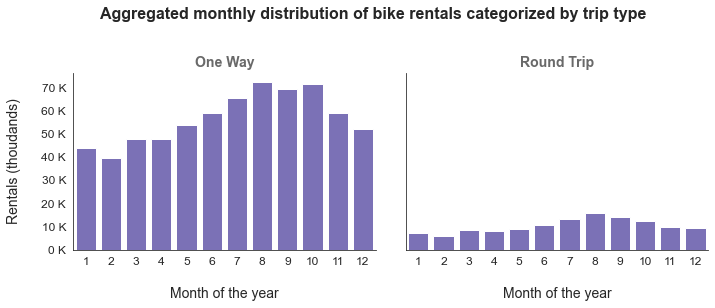

In [590]:
# set the palette as per requirement
flatui = ["slateblue", "mediumorchid"]
sb.set_palette(flatui, desat = 0.8)
base_color = sb.color_palette()[0]
sb.set_style('white')
plt.figure(figsize = [8, 4])

# plot facet grid
g = sb.FacetGrid(data = bikeshare, col = 'trip_type', col_wrap = 2, height = 4, aspect = 1.2)
g.map(sb.countplot, "month", color = base_color, order = bikeshare.month.sort_values(ascending=True).unique())
g.fig.subplots_adjust(top=0.75)
g.fig.suptitle('Aggregated monthly distribution of bike rentals categorized by trip type\n', fontsize = 16, weight = 'bold')
g.set_titles('{col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# obtain y_ticks and convert them to a multiple of millions
# obtain the x_ticks and store them as a list
y_tick_names = []
x_tick_names = []
for ax in g.axes.flat:
    for y_label in ax.get_yticklabels():
        y_label_value = int(y_label.get_text())
        y_label_new_value = '{:0.0f} K'.format(y_label_value/1000)
        y_tick_names.append(y_label_new_value)
        
    for x_label in ax.get_xticklabels():
        x_label_value = x_label.get_text()
        x_tick_names.append(x_label_value)

g.set_yticklabels(y_tick_names, size = 12)
g.set_xticklabels(x_tick_names, size = 12)
g.set_xlabels('\nMonth of the year', size = 14)
g.set_ylabels('Rentals (thoudands)\n', size = 14)

plt.subplots_adjust(wspace=0.1, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust dhe figure to include all of the x and y labels
plt.savefig('plots/3.2.43.c Facet grid of Trip rentals based on trip type and month of the year.png', dpi=300, bbox_inches='tight')

> Let us plot more variety of graphs to observe the distribution of data and hidden insights.

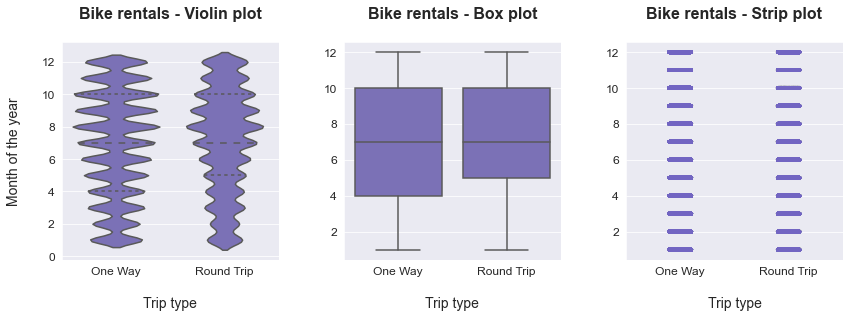

In [591]:
plt.figure(figsize = [14, 4])
sb.set_style('darkgrid')

# set the palette as per requirement
flatui = ["slateblue", "mediumorchid"]
sb.set_palette(flatui, desat = 0.8)
base_color = sb.color_palette()[0]

# left plot: violin plot
plt.subplot(1, 3, 1)
sb.violinplot(data = bikeshare, x = 'trip_type', y = 'month', inner = 'quartile',
              color = base_color)
plt.title('Bike rentals - Violin plot\n',  weight = 'bold', fontsize = 16)
plt.xlabel('\nTrip type', fontsize = 14)
plt.ylabel('Month of the year\n', fontsize = 14)
plt.xticks(fontsize = 12)
plt.yticks(fontsize = 12)

# center plot: box plot
plt.subplot(1, 3, 2)
sb.boxplot(data = bikeshare, x = 'trip_type', y = 'month', color = base_color)
plt.title('Bike rentals - Box plot\n',  weight = 'bold', fontsize = 16)
plt.xlabel('\nTrip type', fontsize = 14)
plt.ylabel('', fontsize = 14)
plt.xticks(fontsize = 12)
plt.yticks(fontsize = 12)

# right plot: strip chart
plt.subplot(1, 3, 3)
sb.stripplot(data = bikeshare, x = "trip_type", y = "month", alpha = 0.002, color = base_color)
plt.title('Bike rentals - Strip plot\n',  weight = 'bold', fontsize = 16)
plt.xlabel('\nTrip type', fontsize = 14)
plt.ylabel('', fontsize = 14);
plt.xticks(fontsize = 12)
plt.yticks(fontsize = 12)

plt.subplots_adjust(wspace=0.3, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust dhe figure to include all of the x and y labels
plt.savefig('plots/3.2.43.d Distribution of Trip rentals based on trip type and month of the year.png', dpi=300, bbox_inches='tight')

**`Heat Map:`**

One alternative way of depicting the relationship between two categorical variables is through a **Heat map**. Heat maps were introduced earlier as the 2-d version of a histogram; here, we're using them as the 2-d version of a bar chart. The seaborn function `heatmap` is at home with this type of heat map implementation, but the input arguments are unlike most of the visualization functions. Instead of providing the original dataframe, we need to summarize the counts into a matrix that will then be plotted.

> Now lets make a pivot from the categorical dataset created earlier into a more appropriate data structure.

In [592]:
categorical_counts = categorical_counts.pivot(index = 'trip_type', columns = 'month', values = 'rentals')
categorical_counts

month,1,2,3,4,5,6,7,8,9,10,11,12
trip_type,,,,,,,,,,,,
One Way,43895,39607,48106,48041,53832,59372,65649,72773,69629,71924,59062,52377
Round Trip,7284,6006,8312,7961,8737,10645,13251,15952,14220,12521,9933,9500


> The data is ready to be plotred as the `Heat map`.

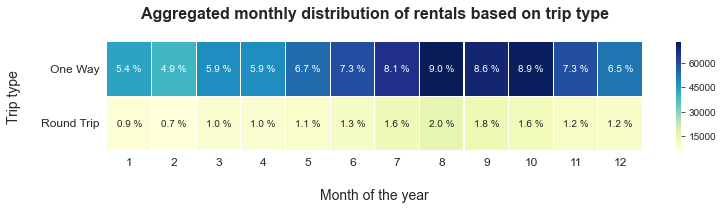

In [593]:
# plot heat map
plt.figure(figsize = [12, 2])
res = sb.heatmap(categorical_counts, annot = True, fmt = '.0f', annot_kws={'size':10}, linewidths=0.1, cmap="YlGnBu")
plt.yticks(rotation=0, fontsize="12", va="center")
plt.xticks(fontsize="12")
plt.title('Aggregated monthly distribution of rentals based on trip type\n', fontsize = 16, weight = 'bold')
plt.xlabel('\nMonth of the year', fontsize=14)
plt.ylabel('Trip type\n', fontsize=14);

# convert annotations to percentages
for t in res.texts: 
    p = np.round(np.round(int(t.get_text())/bikeshare.shape[0], 4)*100, 1)
    t.set_text(str(p)+' %')
               
# savefig by passing (bbox_inches='tight'),which will adjust dhe figure to include all of the x and y labels
plt.savefig('plots/3.2.43.e Heat map of Trip rentals based on trip type and month of the year.png', dpi=300, bbox_inches='tight')

**`Find average rentals based on the day of the month:`**

> The `trip_type` needs to be converted into categorical datatype, otherwise the `groupby` method will ignore `NaN` rental values and inturn produce **incorrect** `avg. rental value`. Also use of `size()` method ignores the unused level combinations of the groups, hence use `count()` method.

In [594]:
month_df = bikeshare.groupby([bikeshare["year"], 
                              bikeshare["month"],
                              bikeshare["trip_type"]]).count()['trip_id'].reset_index(name='rentals')

month_df['rentals'] = month_df['rentals'].fillna(0).astype(int)
month_df.head(10)

,year,month,trip_type,rentals
0,2017,1,One Way,9195
1,2017,1,Round Trip,961
2,2017,2,One Way,8557
3,2017,2,Round Trip,811
4,2017,3,One Way,12305
5,2017,3,Round Trip,1369
6,2017,4,One Way,12311
7,2017,4,Round Trip,1324
8,2017,5,One Way,17320
9,2017,5,Round Trip,1704


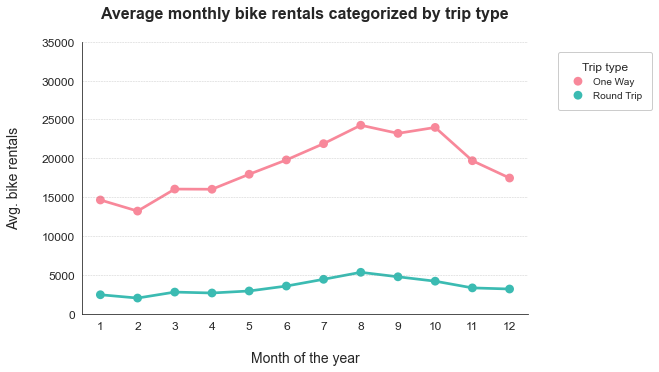

In [595]:
plt.figure(figsize=[8, 5])
sb.set_style('white')
flatui = ["#fff480"]
sb.set_palette(flatui, n_colors=1, desat=0.8)
base_color = sb.color_palette()[0]

sb.pointplot(data = month_df, x = "month", y = "rentals", linestyles = ['-', '-'], hue = 'trip_type', ci = None)
plt.title('Average monthly bike rentals categorized by trip type\n',  weight = 'bold', fontsize = 16)
plt.ylabel('Avg. bike rentals\n', fontsize = 14)
plt.xlabel('\nMonth of the year', fontsize = 14)
plt.xticks(fontsize = 12)

# get ytick locs and rearrage them with respect to zero
locs, labels = plt.yticks()
monthly_rental_avg_max = 35000
y_tick_values = np.arange(0, monthly_rental_avg_max+5000, 5000)
y_tick_names = ['{:0.0f}'.format(v) for v in y_tick_values]
plt.yticks(y_tick_values, y_tick_names, fontsize = 12)

plt.legend(scatterpoints=1, frameon=True, fancybox=True, shadow=False, ncol = 1, 
           framealpha = 1, borderpad=1, borderaxespad=1, loc = 'upper right', labelspacing=0.5,  
           title='Trip type', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(1.3, 1))

sb.despine(top=True, right=True, left=False, bottom=False);

for loc in y_tick_values:
    plt.axhline(loc, ls='--', color='grey', linewidth=0.5, alpha=0.4)

# savefig by passing (bbox_inches='tight'),which will adjust dhe figure to include all of the x and y labels
plt.savefig('plots/3.2.43.f Average monthly bike rentals categorized by trip type.png', dpi=300, bbox_inches='tight')

------------

#### 3.2.44 Bivariate analysis of `bikeshare.month` and `bike_type` columns:

+ `Columns`: month, bike_type
+ `Data type`: (Categorical, ordered) and (Categorical, nominal)
+ `Plot`: Facet Grid, Violin plot, Box plot, Adapted Barchart

**`Stack plot:`**

C:\Users\VAMSHI-KRISHNA-PRIME\Anaconda3\lib\site-packages\pandas\core\series.py:1143: FutureWarning: 
Passing list-likes to .loc or [] with any missing label will raise
KeyError in the future, you can use .reindex() as an alternative.

See the documentation here:
https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#deprecate-loc-reindex-listlike
  return self.loc[key]


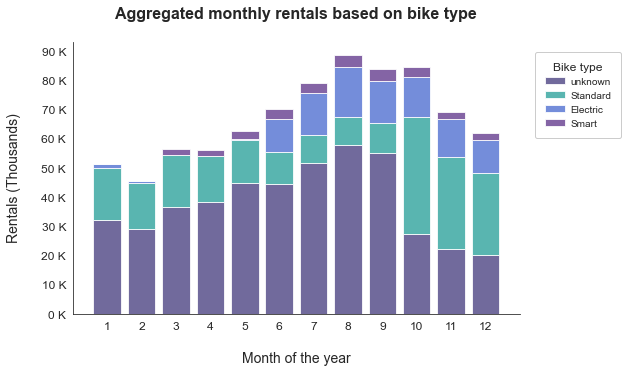

In [596]:
# Assign palette as per requirement
sb.set_style('white')
flatui = ["darkslateblue", "lightseagreen", "royalblue", "rebeccapurple"]
sb.set_palette(flatui, desat = 0.8)
plt.figure(figsize = [8, 5])

cat1_order = bikeshare.month.sort_values(ascending=True).unique()
cat2_order = bikeshare.bike_type.sort_values(ascending=True).unique()

# plot stacked plot
baselines = np.zeros(len(cat1_order))
# for each second-variable category:
for i in range(len(cat2_order)):
    # isolate the counts of the first category,
    cat2 = cat2_order[i]
    inner_counts = bikeshare[bikeshare['bike_type'] == cat2]['month'].value_counts()
    # then plot those counts on top of the accumulated baseline
    plt.bar(x = np.arange(len(cat1_order)), height = inner_counts[cat1_order].fillna(0),
            bottom = baselines, alpha = 0.8)
    baselines += inner_counts[cat1_order].fillna(0)

# improve plot aesthetics
max_count = bikeshare.groupby([bikeshare['month']]).size().reset_index(name='rentals').max()['rentals']
y_tick_values = np.arange(0, max_count + 10000, 10000)
y_tick_names = ['{:0.0f} K'.format(v/1000) for v in y_tick_values]

plt.title('Aggregated monthly rentals based on bike type\n', weight = 'bold', fontsize = 16)
plt.xticks(np.arange(len(cat1_order)), cat1_order, fontsize=12)
plt.yticks(y_tick_values, y_tick_names, fontsize=12)
plt.xlabel('\nMonth of the year', fontsize=14)
plt.ylabel('Rentals (Thousands)\n', fontsize=14)
plt.legend(cat2_order, scatterpoints=1, frameon=True, fancybox=True, shadow=False, ncol = 1, 
           framealpha = 1, borderpad=1, borderaxespad=1, loc = 'upper right', labelspacing=0.5,  
           title='Bike type', title_fontsize=12, fontsize=10, facecolor='white',
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(1.25, 1))

sb.despine();

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.44.a Stack plot of rentals based on bike type and month of the year.png', dpi=300, bbox_inches='tight')

**`Line plot:`**

> The data needs some summirization by grouping together the respective variables. Then, reset the index and name the summerized data values accordingly.

In [597]:
categorical_counts = bikeshare.groupby([bikeshare['bike_type'], 
                                        bikeshare['month']]).size().reset_index(name='rentals')
categorical_counts.head(10)

,bike_type,month,rentals
0,unknown,1,32016
1,unknown,2,28995
2,unknown,3,36468
3,unknown,4,38100
4,unknown,5,44729
5,unknown,6,44394
6,unknown,7,51739
7,unknown,8,57855
8,unknown,9,55147
9,unknown,10,27176


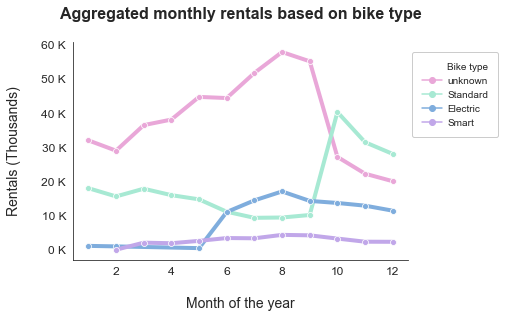

In [598]:
# set the palette as per requirement
sb.set_style('white')
flatui = ['#ff91e2', '#91ffda', '#60acfc', '#bd91ff']
sb.set_palette(flatui, n_colors=4, desat=0.6)

plt.figure(figsize = [6, 4])
max_count = categorical_counts.rentals.max()
y_tick_values = np.arange(0, max_count + 10000, 10000)
y_tick_names = ['{:0.0f} K'.format(v/1000) for v in y_tick_values]

# plot line plot
ax = sb.lineplot(data = categorical_counts, x = "month", y = "rentals", hue="bike_type", linewidth=4, 
                 style="bike_type", err_style="bars", markers = ['o', 'o', 'o', 'o'], markersize=6)
ax.lines[0].set_linestyle("-")
ax.lines[1].set_linestyle("-")
ax.lines[2].set_linestyle("-")
ax.lines[3].set_linestyle("-")

plt.title('Aggregated monthly rentals based on bike type\n', weight = 'bold', fontsize = 16)
plt.xticks(fontsize=12)
plt.yticks(y_tick_values, y_tick_names, fontsize=12)
plt.xlabel('\nMonth of the year', fontsize=14)
plt.ylabel('Rentals (Thousands)\n', fontsize=14)

# customize legend
leg = ax.legend(scatterpoints=1, frameon=True, fancybox=True, shadow=False, ncol = 1, framealpha = 1, 
          borderpad=1, borderaxespad=1, loc = 'upper right', labelspacing=0.5,  
          title='', title_fontsize=12, fontsize=10, facecolor='white', markerfirst=True, 
          handlelength=2, handletextpad=0.5, bbox_to_anchor=(1.3, 1))

leg_lines = leg.get_lines()
leg_lines[1].set_linestyle("-")
leg_lines[2].set_linestyle("-")
leg_lines[3].set_linestyle("-")
leg_lines[4].set_linestyle("-")
leg.texts[0].set_text("Bike type")

sb.despine();

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.44.b Line plot of rentals based on bike type and month of the year.png', dpi=300, bbox_inches='tight')

**`Individual plots of aggregated distribution of monthly rentals over bike type:`**

<Figure size 576x288 with 0 Axes>

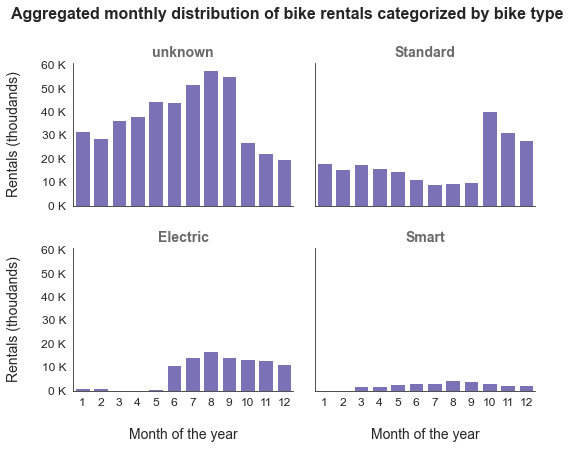

In [599]:
# set the palette as per requirement
flatui = ["slateblue", "mediumorchid"]
sb.set_palette(flatui, desat = 0.8)
base_color = sb.color_palette()[0]
sb.set_style('white')
plt.figure(figsize = [8, 4])

# plot facet grid
g = sb.FacetGrid(data = bikeshare, col = 'bike_type', col_wrap = 2, height = 3, aspect = 1.2)
g.map(sb.countplot, "month", color = base_color, order = bikeshare.month.sort_values(ascending=True).unique())
g.fig.subplots_adjust(top=0.85)
g.fig.suptitle('Aggregated monthly distribution of bike rentals categorized by bike type\n', fontsize = 16, weight = 'bold')
g.set_titles('{col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# obtain y_ticks and convert them to a multiple of millions
# obtain the x_ticks and store them as a list
y_tick_names = []
x_tick_names = []
for ax in g.axes.flat:
    for y_label in ax.get_yticklabels():
        y_label_value = int(y_label.get_text())
        y_label_new_value = '{:0.0f} K'.format(y_label_value/1000)
        y_tick_names.append(y_label_new_value)
        
    for x_label in ax.get_xticklabels():
        x_label_value = x_label.get_text()
        x_tick_names.append(x_label_value)

g.set_yticklabels(y_tick_names, size = 12)
g.set_xticklabels(x_tick_names, size = 12)
g.set_xlabels('\nMonth of the year', size = 14)
g.set_ylabels('Rentals (thoudands)\n', size = 14)

plt.subplots_adjust(wspace=0.1, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.44.c Facet grid of rentals based on bike type and month of the year.png', dpi=300, bbox_inches='tight')

> Let us plot more variety of graphs to observe the distribution of data and hidden insights.

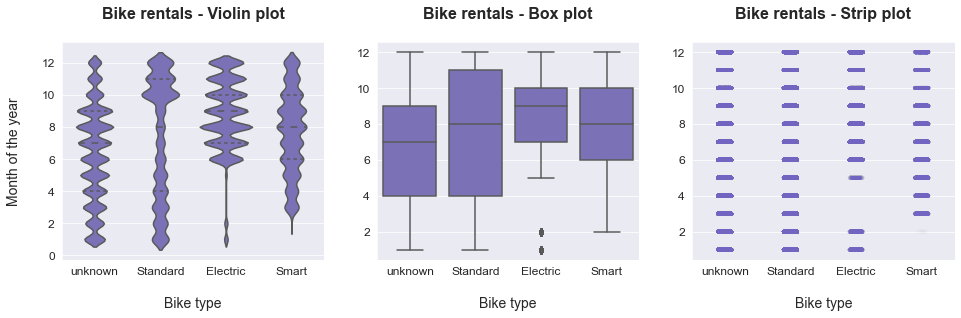

In [600]:
plt.figure(figsize = [16, 4])
sb.set_style('darkgrid')
# set the palette as per requirement
flatui = ["slateblue", "mediumorchid"]
sb.set_palette(flatui, desat = 0.8)
base_color = sb.color_palette()[0]

# left plot: violin plot
plt.subplot(1, 3, 1)
sb.violinplot(data = bikeshare, x = 'bike_type', y = 'month', inner = 'quartile',
              color = base_color)
plt.title('Bike rentals - Violin plot\n',  weight = 'bold', fontsize = 16)
plt.xlabel('\nBike type', fontsize = 14)
plt.ylabel('Month of the year\n', fontsize = 14)
plt.xticks(fontsize = 12)
plt.yticks(fontsize = 12)

# center plot: box plot
plt.subplot(1, 3, 2)
sb.boxplot(data = bikeshare, x = 'bike_type', y = 'month', color = base_color)
plt.title('Bike rentals - Box plot\n',  weight = 'bold', fontsize = 16)
plt.xlabel('\nBike type', fontsize = 14)
plt.ylabel('', fontsize = 14)
plt.xticks(fontsize = 12)
plt.yticks(fontsize = 12)

# right plot: strip chart
plt.subplot(1, 3, 3)
sb.stripplot(data = bikeshare, x = "bike_type", y = "month", alpha = 0.002, color = base_color)
plt.title('Bike rentals - Strip plot\n',  weight = 'bold', fontsize = 16)
plt.xlabel('\nBike type', fontsize = 14)
plt.ylabel('', fontsize = 14);
plt.xticks(fontsize = 12)
plt.yticks(fontsize = 12)

plt.subplots_adjust(wspace=0.2, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust dhe figure to include all of the x and y labels
plt.savefig('plots/3.2.44.d Distribution of Trip rentals based on bike type and month of the year.png', dpi=300, bbox_inches='tight')

**`Heat Map:`**

> Now lets make a pivot from the categorical dataset created earlier into a more appropriate data structure.

In [601]:
categorical_counts = categorical_counts.pivot(index = 'bike_type', columns = 'month', values = 'rentals')
categorical_counts

month,1,2,3,4,5,6,7,8,9,10,11,12
bike_type,,,,,,,,,,,,
unknown,32016.0,28995.0,36468.0,38100.0,44729.0,44394.0,51739.0,57855.0,55147.0,27176.0,22257.0,20059.0
Standard,18021.0,15609.0,17867.0,15983.0,14754.0,11133.0,9349.0,9443.0,10174.0,40296.0,31470.0,28044.0
Electric,1142.0,991.0,NaN,NaN,481.0,11054.0,14452.0,17067.0,14299.0,13695.0,12907.0,11441.0
Smart,NaN,18.0,2083.0,1919.0,2605.0,3436.0,3360.0,4360.0,4229.0,3278.0,2361.0,2333.0


> The data is ready to be plotred as the `Heat map`.

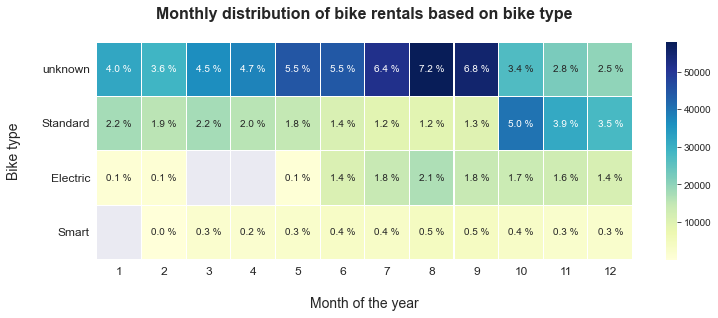

In [602]:
# plot heat map
plt.figure(figsize = [12, 4])
res = sb.heatmap(categorical_counts, annot = True, fmt = '.0f', annot_kws={'size':10}, linewidths=0.1, cmap="YlGnBu")
plt.yticks(rotation=0, fontsize="12", va="center")
plt.xticks(fontsize="12")
plt.title('Monthly distribution of bike rentals based on bike type\n', fontsize = 16, weight = 'bold')
plt.xlabel('\nMonth of the year', fontsize=14)
plt.ylabel('Bike type\n', fontsize=14);

# convert annotations to percentages
for t in res.texts: 
    p = np.round(np.round(int(t.get_text())/bikeshare.shape[0], 4)*100, 1)
    t.set_text(str(p)+' %')
               
# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.44.e Heat map of rentals based on bike type and month of the year.png', dpi=300, bbox_inches='tight')

**`Find average rentals based on the daytime:`**

> The `bike_type` needs to be converted into categorical datatype, otherwise the `groupby` method will ignore `NaN` rental values and inturn produce **incorrect** `avg. rental value`. Also use of `size()` method ignores the unused level combinations of the groups, hence use `count()` method.

In [603]:
month_df = bikeshare.groupby([bikeshare["year"], 
                              bikeshare["month"],
                              bikeshare["bike_type"]]).count()['trip_id'].reset_index(name='rentals')

month_df['rentals'] = month_df['rentals'].fillna(0).astype(int)
month_df.head(10)

,year,month,bike_type,rentals
0,2017,1,unknown,10156
1,2017,1,Standard,0
2,2017,1,Electric,0
3,2017,1,Smart,0
4,2017,2,unknown,9368
5,2017,2,Standard,0
6,2017,2,Electric,0
7,2017,2,Smart,0
8,2017,3,unknown,13674
9,2017,3,Standard,0


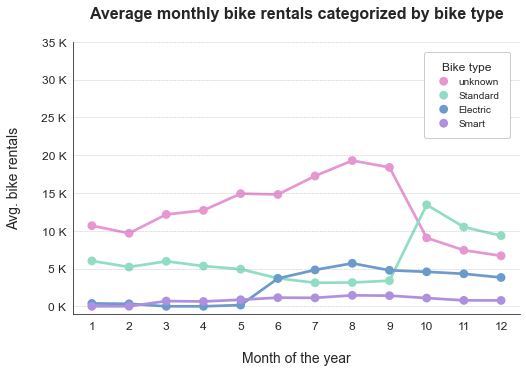

In [605]:
plt.figure(figsize=[8,5])
sb.set_style('white')
# flatui = ['#ff91e2', '#91ffda', '#60acfc', '#bd91ff']
flatui = ['#ff7ddd', '#77f7cc', '#4b99eb', '#aa75fa']
sb.set_palette(flatui, n_colors=4, desat=0.6)
base_color = sb.color_palette()[0]

sb.pointplot(data = month_df, x = "month", y = "rentals", linestyles = "-", hue = 'bike_type', 
             scale = 1, ci = None)
plt.title('Average monthly bike rentals categorized by bike type\n',  weight = 'bold', fontsize = 16)
plt.ylabel('Avg. bike rentals\n', fontsize = 14)
plt.xlabel('\nMonth of the year', fontsize = 14)
plt.xticks(fontsize = 12)

# get ytick locs and rearrage them with respect to zero
locs, labels = plt.yticks()
monthly_rental_avg_max = 35000
y_tick_values = np.arange(0, monthly_rental_avg_max+5000, 5000)
y_tick_names = ['{:0.0f} K'.format(v/1000) for v in y_tick_values]
plt.yticks(y_tick_values, y_tick_names, fontsize = 12)

plt.legend(scatterpoints=1, frameon=True, fancybox=True, shadow=False, ncol = 1, 
           framealpha = 1, borderpad=1, borderaxespad=1, loc = 'upper right', labelspacing=0.5,  
           title='Bike type', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(1, 1))

sb.despine(top=True, right=True, left=False, bottom=False);

for loc in y_tick_values:
    plt.axhline(loc, ls='--', color='grey', linewidth=0.5, alpha=0.5)

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.44.f Average monthly bike rentals categorized by bike type.png', dpi=300, bbox_inches='tight')

------

#### 3.2.45 Bivariate analysis of `bikeshare.month` and `pass_type` columns:

+ `Columns`: month, pass_type
+ `Data type`: (Categorical, ordered) and (Categorical, nominal)
+ `Plot`: Facet Grid, Violin plot, Box plot, Adapted Barchart

**`Stack plot:`**

C:\Users\VAMSHI-KRISHNA-PRIME\Anaconda3\lib\site-packages\pandas\core\series.py:1143: FutureWarning: 
Passing list-likes to .loc or [] with any missing label will raise
KeyError in the future, you can use .reindex() as an alternative.

See the documentation here:
https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#deprecate-loc-reindex-listlike
  return self.loc[key]


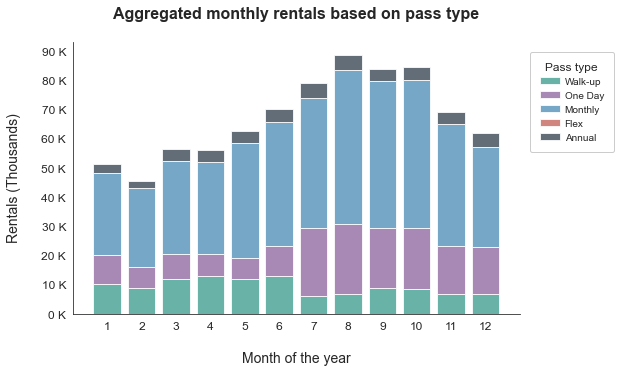

In [606]:
# Assign palette as per requirement
sb.set_style('white')
plt.figure(figsize = [8, 5])
flatui = ["#26bda7", "#9b59b6", "#3498db", "#e74c3c", "#34495e"]
sb.set_palette(flatui, n_colors=5, desat=0.6)

cat1_order = bikeshare.month.sort_values(ascending=True).unique()
cat2_order = bikeshare.pass_type.sort_values(ascending=True).unique()

# plot stacked plot
baselines = np.zeros(len(cat1_order))
# for each second-variable category:
for i in range(len(cat2_order)):
    # isolate the counts of the first category,
    cat2 = cat2_order[i]
    inner_counts = bikeshare[bikeshare['pass_type'] == cat2]['month'].value_counts()
    # then plot those counts on top of the accumulated baseline
    plt.bar(x = np.arange(len(cat1_order)), height = inner_counts[cat1_order].fillna(0),
            bottom = baselines, alpha = 0.8)
    baselines += inner_counts[cat1_order].fillna(0)

# improve plot aesthetics
max_count = bikeshare.groupby([bikeshare['month']]).size().reset_index(name='rentals').max()['rentals']
y_tick_values = np.arange(0, max_count + 10000, 10000)
y_tick_names = ['{:0.0f} K'.format(v/1000) for v in y_tick_values]

plt.title('Aggregated monthly rentals based on pass type\n', weight = 'bold', fontsize = 16)
plt.xticks(np.arange(len(cat1_order)), cat1_order, fontsize=12)
plt.yticks(y_tick_values, y_tick_names, fontsize=12)
plt.xlabel('\nMonth of the year', fontsize=14)
plt.ylabel('Rentals (Thousands)\n', fontsize=14)
plt.legend(cat2_order, scatterpoints=1, frameon=True, fancybox=True, shadow=False, ncol = 1, 
           framealpha = 1, borderpad=1, borderaxespad=1, loc = 'upper left', labelspacing=0.5,  
           title='Pass type', title_fontsize=12, fontsize=10, facecolor='white',
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(1, 1))

sb.despine();

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.45.a Stack plot of rentals based on pass type and month of the year.png', dpi=300, bbox_inches='tight')

**`Line plot:`**

> The data needs some summirization by grouping together the respective variables. Then, reset the index and name the summerized data values accordingly.

In [607]:
categorical_counts = bikeshare.groupby([bikeshare['pass_type'], 
                                        bikeshare['month']]).size().reset_index(name='rentals')
categorical_counts.head(10)

,pass_type,month,rentals
0,Walk-up,1,10212
1,Walk-up,2,8919
2,Walk-up,3,11922
3,Walk-up,4,13025
4,Walk-up,5,12030
5,Walk-up,6,12983
6,Walk-up,7,5877
7,Walk-up,8,6648
8,Walk-up,9,8639
9,Walk-up,10,8466


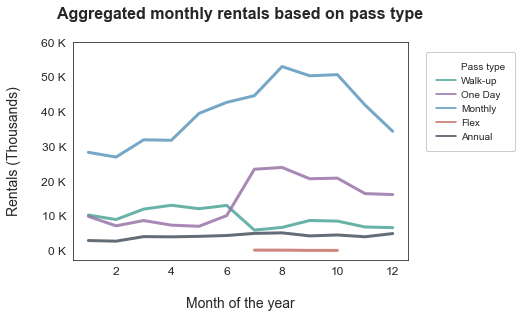

In [608]:
# set the palette as per requirement
sb.set_style('white')
flatui = ["#26bda7", "#9b59b6", "#3498db", "#e74c3c", "#34495e"]
sb.set_palette(flatui, n_colors=5, desat=0.6)

plt.figure(figsize = [6, 4])
max_count = categorical_counts.rentals.max()
y_tick_values = np.arange(0, max_count + 10000, 10000)
y_tick_names = ['{:0.0f} K'.format(v/1000) for v in y_tick_values]

# plot line plot
ax = sb.lineplot(data=categorical_counts, x = "month", y = "rentals", hue="pass_type", linewidth=3, alpha = 0.8)
plt.title('Aggregated monthly rentals based on pass type\n', weight = 'bold', fontsize = 16)
plt.xticks(fontsize=12)
plt.yticks(y_tick_values, y_tick_names, fontsize=12)
plt.xlabel('\nMonth of the year', fontsize=14)
plt.ylabel('Rentals (Thousands)\n', fontsize=14)

# when 'hue' is used, its label appears as legend title
# replace default title with custom title.
ax.legend(scatterpoints=1, frameon=True, fancybox=True, shadow=False, ncol = 1, framealpha = 1, 
          borderpad=1, borderaxespad=1, loc = 'upper right', labelspacing=0.5, title_fontsize=12,
          fontsize=10, facecolor='white', markerfirst=True, handlelength=2,
          handletextpad=0.5, bbox_to_anchor=(1.35, 1)).texts[0].set_text("Pass type");

# sb.despine();

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.45.b Line plot of rentals based on pass type and month of the year.png', dpi=300, bbox_inches='tight')

**`Individual plots of aggregated distribution of monthly rentals over bike type:`**

<Figure size 1296x288 with 0 Axes>

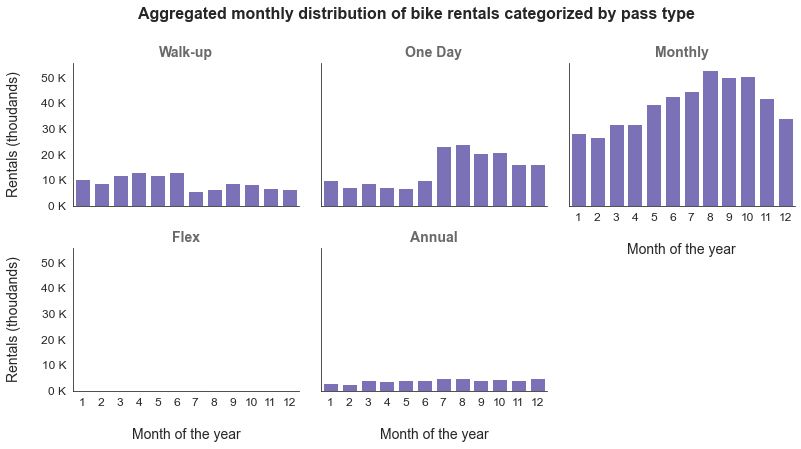

In [609]:
# set the palette as per requirement
flatui = ["slateblue", "mediumorchid"]
sb.set_palette(flatui, desat = 0.8)
base_color = sb.color_palette()[0]
sb.set_style('white')
plt.figure(figsize = [18, 4])

# plot facet grid
g = sb.FacetGrid(data = bikeshare, col = 'pass_type', col_wrap = 3, height = 3, aspect = 1.2)
g.map(sb.countplot, "month", color = base_color, order = bikeshare.month.sort_values(ascending=True).unique())
g.fig.subplots_adjust(top=0.85)
g.fig.suptitle('Aggregated monthly distribution of bike rentals categorized by pass type\n', fontsize = 16, weight = 'bold')
g.set_titles('{col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# obtain y_ticks and convert them to a multiple of millions
# obtain the x_ticks and store them as a list
y_tick_names = []
x_tick_names = []
for ax in g.axes.flat:
    for y_label in ax.get_yticklabels():
        y_label_value = int(y_label.get_text())
        y_label_new_value = '{:0.0f} K'.format(y_label_value/1000)
        y_tick_names.append(y_label_new_value)
        
    for x_label in ax.get_xticklabels():
        x_label_value = x_label.get_text()
        x_tick_names.append(x_label_value)

g.set_yticklabels(y_tick_names, size = 12)
g.set_xticklabels(x_tick_names, size = 12)
g.set_xlabels('\nMonth of the year', size = 14)
g.set_ylabels('Rentals (thoudands)\n', size = 14)

plt.subplots_adjust(wspace=0.1, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.45.c Facet grid of rentals based on pass type and month of the year.png', dpi=300, bbox_inches='tight')

> Let us plot more variety of graphs to observe the distribution of data and hidden insights.

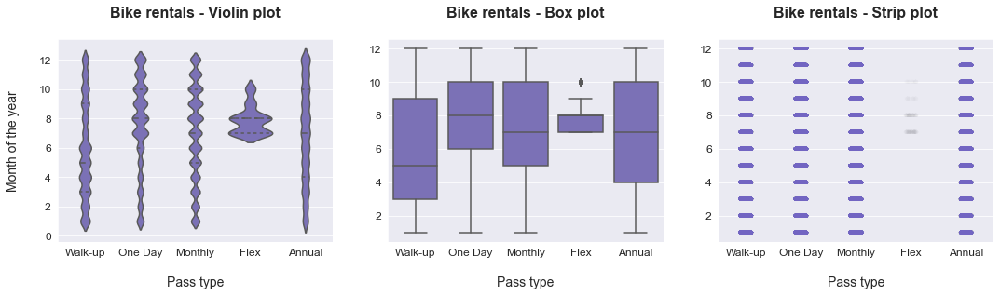

In [610]:
plt.figure(figsize = [18, 4])
sb.set_style('darkgrid')
# set the palette as per requirement
flatui = ["slateblue", "mediumorchid"]
sb.set_palette(flatui, desat = 0.8)
base_color = sb.color_palette()[0]

# left plot: violin plot
plt.subplot(1, 3, 1)
sb.violinplot(data = bikeshare, x = 'pass_type', y = 'month', inner = 'quartile',
              color = base_color)
plt.title('Bike rentals - Violin plot\n',  weight = 'bold', fontsize = 16)
plt.xlabel('\nPass type', fontsize = 14)
plt.ylabel('Month of the year\n', fontsize = 14)
plt.xticks(fontsize = 12)
plt.yticks(fontsize = 12)

# center plot: box plot
plt.subplot(1, 3, 2)
sb.boxplot(data = bikeshare, x = 'pass_type', y = 'month', color = base_color)
plt.title('Bike rentals - Box plot\n',  weight = 'bold', fontsize = 16)
plt.xlabel('\nPass type', fontsize = 14)
plt.ylabel('', fontsize = 14)
plt.xticks(fontsize = 12)
plt.yticks(fontsize = 12)

# right plot: strip chart
plt.subplot(1, 3, 3)
sb.stripplot(data = bikeshare, x = "pass_type", y = "month", alpha = 0.002, color = base_color)
plt.title('Bike rentals - Strip plot\n',  weight = 'bold', fontsize = 16)
plt.xlabel('\nPass type', fontsize = 14)
plt.ylabel('', fontsize = 14);
plt.xticks(fontsize = 12)
plt.yticks(fontsize = 12)

plt.subplots_adjust(wspace=0.2, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust dhe figure to include all of the x and y labels
plt.savefig('plots/3.2.45.d Distribution of Trip rentals based on pass type and month of the year.png', dpi=300, bbox_inches='tight')

**`Heat Map:`**

> Now lets make a pivot from the categorical dataset created earlier into a more appropriate data structure.

In [611]:
categorical_counts = categorical_counts.pivot(index = 'pass_type', columns = 'month', values = 'rentals')
categorical_counts

month,1,2,3,4,5,6,7,8,9,10,11,12
pass_type,,,,,,,,,,,,
Walk-up,10212.0,8919.0,11922.0,13025.0,12030.0,12983.0,5877.0,6648.0,8639.0,8466.0,6770.0,6587.0
One Day,9825.0,7106.0,8621.0,7299.0,6973.0,10060.0,23404.0,23921.0,20662.0,20836.0,16384.0,16101.0
Monthly,28271.0,26903.0,31875.0,31745.0,39492.0,42660.0,44586.0,52974.0,50314.0,50649.0,41884.0,34313.0
Flex,NaN,NaN,NaN,NaN,NaN,NaN,107.0,103.0,28.0,25.0,NaN,NaN
Annual,2871.0,2685.0,4000.0,3933.0,4074.0,4314.0,4926.0,5079.0,4206.0,4469.0,3957.0,4876.0


> The data is ready to be plotred as the `Heat map`.

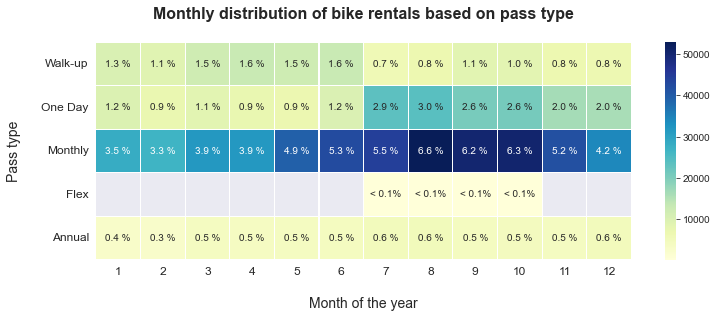

In [612]:
# plot heat map
plt.figure(figsize = [12, 4])
res = sb.heatmap(categorical_counts, annot = True, fmt = '.0f', annot_kws={'size':10}, linewidths=0.1, cmap="YlGnBu")
plt.yticks(rotation=0, fontsize="12", va="center")
plt.xticks(fontsize="12")
plt.title('Monthly distribution of bike rentals based on pass type\n', fontsize = 16, weight = 'bold')
plt.xlabel('\nMonth of the year', fontsize=14)
plt.ylabel('Pass type\n', fontsize=14);

# convert annotations to percentages
for t in res.texts: 
    p = np.round(np.round(int(t.get_text())/bikeshare.shape[0], 4)*100, 1)
    if p < 0.1:
        t.set_text('< 0.1%')
    else:
        t.set_text(str(p)+' %');  

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.45.e Heat map of rentals based on pass type and month of the year.png', dpi=300, bbox_inches='tight')

**`Find average rentals based on the daytime:`**

> The `pass_type` needs to be converted into categorical datatype, otherwise the `groupby` method will ignore `NaN` rental values and inturn produce **incorrect** `avg. rental value`. Also use of `size()` method ignores the unused level combinations of the groups, hence use `count()` method.

In [613]:
month_df = bikeshare.groupby([bikeshare["year"], 
                              bikeshare["month"],
                              bikeshare["pass_type"]]).count()['trip_id'].reset_index(name='rentals')

month_df['rentals'] = month_df['rentals'].fillna(0).astype(int)
month_df.head(10)

,year,month,pass_type,rentals
0,2017,1,Walk-up,3187
1,2017,1,One Day,0
2,2017,1,Monthly,6306
3,2017,1,Flex,0
4,2017,1,Annual,663
5,2017,2,Walk-up,2710
6,2017,2,One Day,0
7,2017,2,Monthly,6070
8,2017,2,Flex,0
9,2017,2,Annual,588


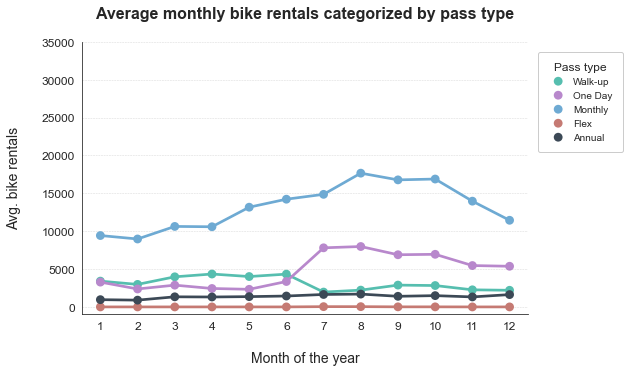

In [614]:
plt.figure(figsize=[8,5])
sb.set_style('white')
# flatui = ["#26bda7", "#9b59b6", "#3498db", "#e74c3c", "#34495e"]
flatui = ["#34e0c7", "#c271e3", "#4cb1f5", "#e06458", "#34495e"]
sb.set_palette(flatui, n_colors=5, desat=0.6)
base_color = sb.color_palette()[0]

sb.pointplot(data = month_df, x = "month", y = "rentals", linestyles = "-", hue = 'pass_type', 
             scale = 1, ci = None)
plt.title('Average monthly bike rentals categorized by pass type\n',  weight = 'bold', fontsize = 16)
plt.ylabel('Avg. bike rentals\n', fontsize = 14)
plt.xlabel('\nMonth of the year', fontsize = 14)
plt.xticks(fontsize = 12)

# get ytick locs and rearrage them with respect to zero
locs, labels = plt.yticks()
monthly_rental_avg_max = 35000
y_tick_values = np.arange(0, monthly_rental_avg_max+5000, 5000)
y_tick_names = ['{:0.0f}'.format(v) for v in y_tick_values]
plt.yticks(y_tick_values, y_tick_names, fontsize = 12)

plt.legend(scatterpoints=1, frameon=True, fancybox=True, shadow=False, ncol = 1, 
           framealpha = 1, borderpad=1, borderaxespad=1, loc = 'upper left', labelspacing=0.5,  
           title='Pass type', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(1, 1))

sb.despine(top=True, right=True, left=False, bottom=False);

for loc in y_tick_values:
    plt.axhline(loc, ls='--', color='grey', linewidth=0.5, alpha=0.3)

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.45.f Average monthly bike rentals categorized by pass type.png', dpi=300, bbox_inches='tight')

---

#### 3.2.46 Bivariate analysis of `bikeshare.month` and `fare_type` columns:

+ `Columns`: month, fare_type
+ `Data type`: (Categorical, ordered) and (Categorical, nominal)
+ `Plot`: Facet Grid, Violin plot, Box plot, Adapted Barchart

**`Stack plot:`**

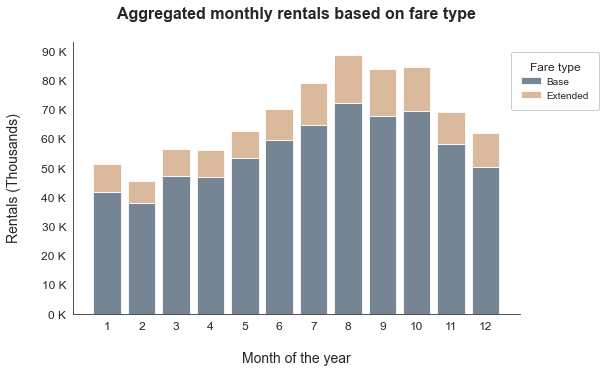

In [615]:
# Assign palette as per requirement
sb.set_style('white')
plt.figure(figsize = [8, 5])
flatui = ['#466887', '#eda668']
sb.set_palette(flatui, n_colors=2, desat=0.6)

cat1_order = bikeshare.month.sort_values(ascending=True).unique()
cat2_order = bikeshare.fare_type.sort_values(ascending=True).unique()

# plot stacked plot
baselines = np.zeros(len(cat1_order))
# for each second-variable category:
for i in range(len(cat2_order)):
    # isolate the counts of the first category,
    cat2 = cat2_order[i]
    inner_counts = bikeshare[bikeshare['fare_type'] == cat2]['month'].value_counts()
    # then plot those counts on top of the accumulated baseline
    plt.bar(x = np.arange(len(cat1_order)), height = inner_counts[cat1_order].fillna(0),
            bottom = baselines, alpha = 0.8)
    baselines += inner_counts[cat1_order].fillna(0)

# improve plot aesthetics
max_count = bikeshare.groupby([bikeshare['month']]).size().reset_index(name='rentals').max()['rentals']
y_tick_values = np.arange(0, max_count + 10000, 10000)
y_tick_names = ['{:0.0f} K'.format(v/1000) for v in y_tick_values]

plt.title('Aggregated monthly rentals based on fare type\n', weight = 'bold', fontsize = 16)
plt.xticks(np.arange(len(cat1_order)), cat1_order, fontsize=12)
plt.yticks(y_tick_values, y_tick_names, fontsize=12)
plt.xlabel('\nMonth of the year', fontsize=14)
plt.ylabel('Rentals (Thousands)\n', fontsize=14)
plt.legend(cat2_order, scatterpoints=1, frameon=True, fancybox=True, shadow=False, ncol = 1, 
           framealpha = 1, borderpad=1, borderaxespad=1, loc = 'upper right', labelspacing=0.5,  
           title='Fare type', title_fontsize=12, fontsize=10, facecolor='white',
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(1.2, 1))

sb.despine();

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.46.a Stack plot of rentals based on fare type and day of the month.png', dpi=300, bbox_inches='tight')

**`Line plot:`**

> The data needs some summirization by grouping together the respective variables. Then, reset the index and name the summerized data values accordingly.

In [616]:
categorical_counts = bikeshare.groupby([bikeshare['fare_type'], 
                                        bikeshare['month']]).size().reset_index(name='rentals')
categorical_counts.head(10)

,fare_type,month,rentals
0,Base,1,41692
1,Base,2,38014
2,Base,3,47059
3,Base,4,46731
4,Base,5,53231
5,Base,6,59384
6,Base,7,64725
7,Base,8,72345
8,Base,9,67724
9,Base,10,69341


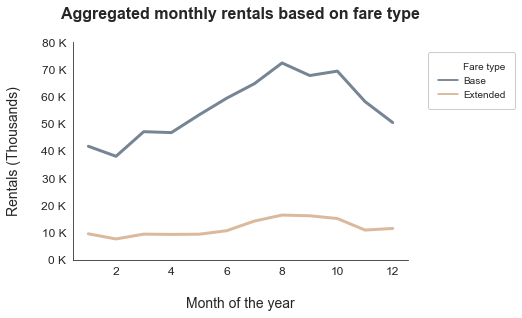

In [617]:
# set the palette as per requirement
sb.set_style('white')
flatui = ['#466887', '#eda668']
sb.set_palette(flatui, n_colors=2, desat=0.6)

plt.figure(figsize = [6, 4])
max_count = categorical_counts.rentals.max()
y_tick_values = np.arange(0, max_count + 10000, 10000)
y_tick_names = ['{:0.0f} K'.format(v/1000) for v in y_tick_values]

# plot line plot
ax = sb.lineplot(data=categorical_counts, x = "month", y = "rentals", hue="fare_type", linewidth=3, alpha = 0.8)
plt.title('Aggregated monthly rentals based on fare type\n', weight = 'bold', fontsize = 16)
plt.xticks(fontsize=12)
plt.yticks(y_tick_values, y_tick_names, fontsize=12)
plt.xlabel('\nMonth of the year', fontsize=14)
plt.ylabel('Rentals (Thousands)\n', fontsize=14)

# when 'hue' is used, its label appears as legend title
# replace default title with custom title.
ax.legend(scatterpoints=1, frameon=True, fancybox=True, shadow=False, ncol = 1, framealpha = 1, 
          borderpad=1, borderaxespad=1, loc = 'upper right', labelspacing=0.5,  
          title='', title_fontsize=12, fontsize=10, facecolor='white', markerfirst=True, 
          handlelength=2, handletextpad=0.5, bbox_to_anchor=(1.35, 1)).texts[0].set_text("Fare type")

sb.despine();

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.46.b Line plot of rentals based on fare type and day of the month.png', dpi=300, bbox_inches='tight')

**`Individual plots of aggregated distribution of monthly rentals over bike type:`**

<Figure size 864x288 with 0 Axes>

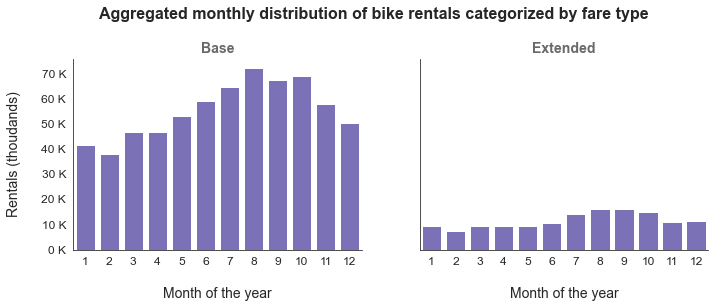

In [618]:
# set the palette as per requirement
flatui = ["slateblue", "mediumorchid"]
sb.set_palette(flatui, desat = 0.8)
base_color = sb.color_palette()[0]
sb.set_style('white')
plt.figure(figsize = [12, 4])

# plot facet grid
g = sb.FacetGrid(data = bikeshare, col = 'fare_type', col_wrap = 2, height = 4, aspect = 1.2)
g.map(sb.countplot, "month", color = base_color, order = bikeshare.month.sort_values(ascending=True).unique())
g.fig.subplots_adjust(top=0.8)
g.fig.suptitle('Aggregated monthly distribution of bike rentals categorized by fare type\n', fontsize = 16, weight = 'bold')
g.set_titles('{col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# obtain y_ticks and convert them to a multiple of millions
# obtain the x_ticks and store them as a list
y_tick_names = []
x_tick_names = []
for ax in g.axes.flat:
    for y_label in ax.get_yticklabels():
        y_label_value = int(y_label.get_text())
        y_label_new_value = '{:0.0f} K'.format(y_label_value/1000)
        y_tick_names.append(y_label_new_value)
        
    for x_label in ax.get_xticklabels():
        x_label_value = x_label.get_text()
        x_tick_names.append(x_label_value)

g.set_yticklabels(y_tick_names, size = 12)
g.set_xticklabels(x_tick_names, size = 12)
g.set_xlabels('\nMonth of the year', size = 14)
g.set_ylabels('Rentals (thoudands)\n', size = 14)

plt.subplots_adjust(wspace=0.2, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.46.c Facet grid of rentals based on fare type and day of the month.png', dpi=300, bbox_inches='tight')

> Let us plot more variety of graphs to observe the distribution of data and hidden insights.

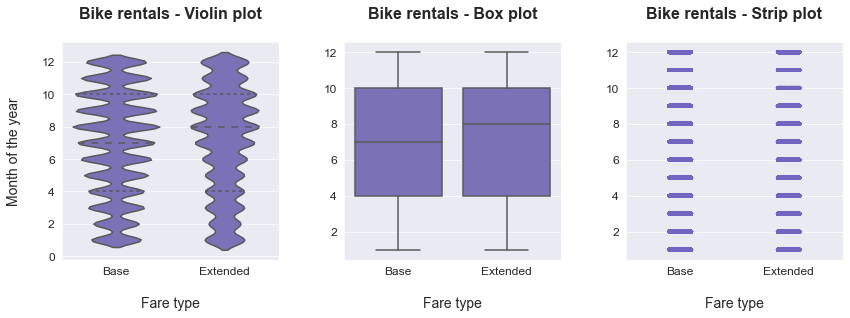

In [619]:
plt.figure(figsize = [14, 4])
sb.set_style('darkgrid')
# set the palette as per requirement
flatui = ["slateblue", "mediumorchid"]
sb.set_palette(flatui, desat = 0.8)
base_color = sb.color_palette()[0]

# left plot: violin plot
plt.subplot(1, 3, 1)
sb.violinplot(data = bikeshare, x = 'fare_type', y = 'month', inner = 'quartile',
              color = base_color)
plt.title('Bike rentals - Violin plot\n',  weight = 'bold', fontsize = 16)
plt.xlabel('\nFare type', fontsize = 14)
plt.ylabel('Month of the year\n', fontsize = 14)
plt.xticks(fontsize = 12)
plt.yticks(fontsize = 12)

# center plot: box plot
plt.subplot(1, 3, 2)
sb.boxplot(data = bikeshare, x = 'fare_type', y = 'month', color = base_color)
plt.title('Bike rentals - Box plot\n',  weight = 'bold', fontsize = 16)
plt.xlabel('\nFare type', fontsize = 14)
plt.ylabel('', fontsize = 14)
plt.xticks(fontsize = 12)
plt.yticks(fontsize = 12)

# right plot: strip chart
plt.subplot(1, 3, 3)
sb.stripplot(data = bikeshare, x = "fare_type", y = "month", alpha = 0.002, color = base_color)
plt.title('Bike rentals - Strip plot\n',  weight = 'bold', fontsize = 16)
plt.xlabel('\nFare type', fontsize = 14)
plt.ylabel('', fontsize = 14);
plt.xticks(fontsize = 12)
plt.yticks(fontsize = 12)

plt.subplots_adjust(wspace=0.3, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust dhe figure to include all of the x and y labels
plt.savefig('plots/3.2.46.d Distribution of Trip rentals based on fare type and month of the year.png', dpi=300, bbox_inches='tight')

**`Heat Map:`**

> Now lets make a pivot from the categorical dataset created earlier into a more appropriate data structure.

In [620]:
categorical_counts = categorical_counts.pivot(index = 'fare_type', columns = 'month', values = 'rentals')
categorical_counts

month,1,2,3,4,5,6,7,8,9,10,11,12
fare_type,,,,,,,,,,,,
Base,41692,38014,47059,46731,53231,59384,64725,72345,67724,69341,58128,50415
Extended,9487,7599,9359,9271,9338,10633,14175,16380,16125,15104,10867,11462


> The data is ready to be plotred as the `Heat map`.

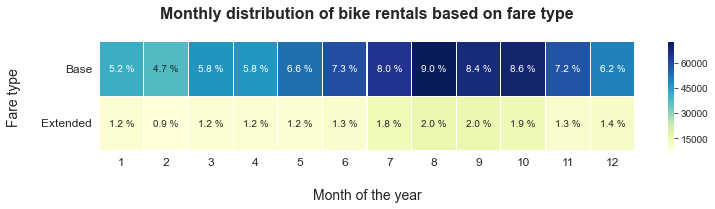

In [621]:
# plot heat map
plt.figure(figsize = [12, 2])
res = sb.heatmap(categorical_counts, annot = True, fmt = '.0f', annot_kws={'size':10}, linewidths=0.1, cmap="YlGnBu")
plt.yticks(rotation=0, fontsize="12", va="center")
plt.xticks(fontsize="12")
plt.title('Monthly distribution of bike rentals based on fare type\n', fontsize = 16, weight = 'bold')
plt.xlabel('\nMonth of the year', fontsize=14)
plt.ylabel('Fare type\n', fontsize=14);

# convert annotations to percentages
for t in res.texts: 
    p = np.round(np.round(int(t.get_text())/bikeshare.shape[0], 4)*100, 1)
    if p < 0.1:
        t.set_text('< 0.1%')
    else:
        t.set_text(str(p)+' %');  

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.46.e Heat map of rentals based on fare type and day of the month.png', dpi=300, bbox_inches='tight')

**`Find average rentals based on the daytime:`**

> The `fare_type` needs to be converted into categorical datatype, otherwise the `groupby` method will ignore `NaN` rental values and inturn produce **incorrect** `avg. rental value`. Also use of `size()` method ignores the unused level combinations of the groups, hence use `count()` method.

In [622]:
month_df = bikeshare.groupby([bikeshare["year"], 
                              bikeshare["month"],
                              bikeshare["fare_type"]]).count()['trip_id'].reset_index(name='rentals')

month_df['rentals'] = month_df['rentals'].fillna(0).astype(int)
month_df.head(10)

,year,month,fare_type,rentals
0,2017,1,Base,8925
1,2017,1,Extended,1231
2,2017,2,Base,8450
3,2017,2,Extended,918
4,2017,3,Base,12142
5,2017,3,Extended,1532
6,2017,4,Base,12110
7,2017,4,Extended,1525
8,2017,5,Base,17219
9,2017,5,Extended,1805


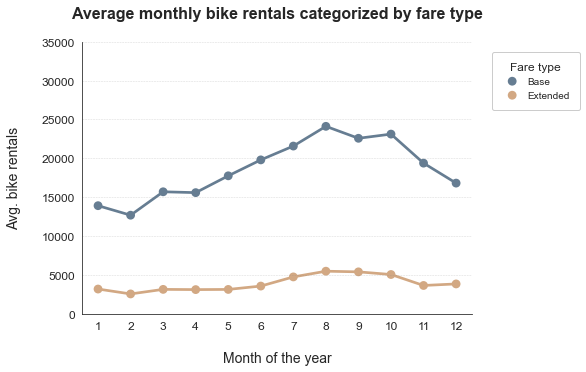

In [623]:
plt.figure(figsize=[7, 5])
sb.set_style('white')
flatui = ['#577da1', '#eda668']
sb.set_palette(flatui, n_colors=2, desat=0.6)
base_color = sb.color_palette()[0]

sb.pointplot(data = month_df, x = "month", y = "rentals", linestyles = "-", hue = 'fare_type', 
             scale = 1, ci = None)
plt.title('Average monthly bike rentals categorized by fare type\n',  weight = 'bold', fontsize = 16)
plt.ylabel('Avg. bike rentals\n', fontsize = 14)
plt.xlabel('\nMonth of the year', fontsize = 14)
plt.xticks(fontsize = 12)

# get ytick locs and rearrage them with respect to zero
locs, labels = plt.yticks()
monthly_rental_avg_max = 35000
y_tick_values = np.arange(0, monthly_rental_avg_max+5000, 5000)
y_tick_names = ['{:0.0f}'.format(v) for v in y_tick_values]
plt.yticks(y_tick_values, y_tick_names, fontsize = 12)

plt.legend(scatterpoints=1, frameon=True, fancybox=True, shadow=False, ncol = 1, 
           framealpha = 1, borderpad=1, borderaxespad=1, loc = 'upper right', labelspacing=0.5,  
           title='Fare type', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(1.3, 1))

sb.despine(top=True, right=True, left=False, bottom=False);

for loc in y_tick_values:
    plt.axhline(loc, ls='--', color='grey', linewidth=0.5, alpha=0.3)

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.46.f Average monthly bike rentals categorized by fare type.png', dpi=300, bbox_inches='tight')

-----

#### 3.2.47 Bivariate analysis of `bikeshare.quarter` and `trip_type` columns:

+ `Columns`: quarter, trip_type
+ `Data type`: (Categorical, ordered) and (Categorical, nominal)
+ `Plot`: Facet Grid, Violin plot, Box plot, Adapted Barchart

**`Stack plot:`**

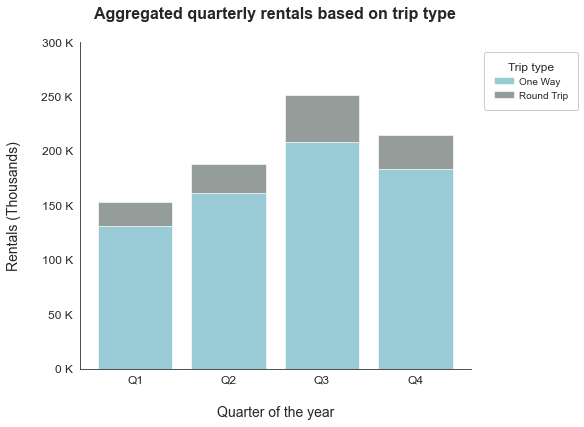

In [624]:
sb.set_style('white')
flatui = ["#47b1c9", "#4c5e58"]
sb.set_palette(flatui, desat = 0.8)
plt.figure(figsize = [7, 6])

cat1_order = bikeshare.quarter.sort_values(ascending=True).unique()
cat2_order = bikeshare.trip_type.sort_values(ascending=True).unique()

# plot stacked plot
baselines = np.zeros(len(cat1_order))
# for each second-variable category:
for i in range(len(cat2_order)):
    # isolate the counts of the first category,
    cat2 = cat2_order[i]
    inner_counts = bikeshare[bikeshare['trip_type'] == cat2]['quarter'].value_counts()
    # then plot those counts on top of the accumulated baseline
    plt.bar(x = np.arange(len(cat1_order)), height = inner_counts[cat1_order].fillna(0),
            bottom = baselines, alpha =0.6)
    baselines += inner_counts[cat1_order].fillna(0)

# improve plot aesthetics
max_count = bikeshare.groupby([bikeshare['quarter']]).size().reset_index(name='rentals').max()['rentals']
y_tick_values = np.arange(0, max_count + 50000, 50000)
y_tick_names = ['{:0.0f} K'.format(v/1000) for v in y_tick_values]

plt.title('Aggregated quarterly rentals based on trip type\n', weight = 'bold', fontsize = 16)
plt.xticks(np.arange(len(cat1_order)), cat1_order, fontsize=12)
plt.yticks(y_tick_values, y_tick_names, fontsize=12)
plt.xlabel('\nQuarter of the year', fontsize=14)
plt.ylabel('Rentals (Thousands)\n', fontsize=14)
plt.legend(cat2_order, scatterpoints=1, frameon=True, fancybox=True, shadow=False, ncol = 1, 
           framealpha = 1, borderpad=1, borderaxespad=1, loc = 'upper right', labelspacing=0.5,  
           title='Trip type', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(1.3, 1))

sb.despine();

# savefig by passing (bbox_inches='tight'),which will adjust dhe figure to include all of the x and y labels
plt.savefig('plots/3.2.47.a Stack plot of Trip rentals based on trip type and quarter of the year.png', dpi=300, bbox_inches='tight')

**`Line Plot:`**

> The data needs some summirization by grouping together the respective variables. Then, reset the index and name the summerized data values accordingly.

In [625]:
categorical_counts = bikeshare.groupby([bikeshare['trip_type'], 
                                        bikeshare['quarter']]).size().reset_index(name='rentals')
categorical_counts.head(10)

,trip_type,quarter,rentals
0,One Way,Q1,131608
1,One Way,Q2,161245
2,One Way,Q3,208051
3,One Way,Q4,183363
4,Round Trip,Q1,21602
5,Round Trip,Q2,27343
6,Round Trip,Q3,43423
7,Round Trip,Q4,31954


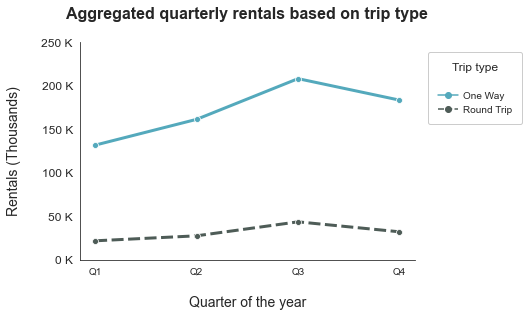

In [626]:
# set the palette as per requirement
flatui = ["#47b1c9", "#4c5e58"]
sb.set_palette(flatui, desat = 0.8)
sb.set_style('white')

plt.figure(figsize = [6, 4])
max_count = categorical_counts.rentals.max()
y_tick_values = np.arange(0, max_count + 50000, 50000)
y_tick_names = ['{:0.0f} K'.format(v/1000) for v in y_tick_values]

# plot line plot
ax = sb.lineplot(data=categorical_counts, x = "quarter", y = "rentals", hue="trip_type", 
                 style="trip_type", err_style="bars", linewidth=3, markers = ['o', 'o'])
plt.title('Aggregated quarterly rentals based on trip type\n', weight = 'bold', fontsize = 16)
plt.xticks(fontsize=10)
plt.yticks(y_tick_values, y_tick_names, fontsize=12)
plt.xlabel('\nQuarter of the year', fontsize=14)
plt.ylabel('Rentals (Thousands)\n', fontsize=14)

# when a hue is used that appears as a legend title,
# remove this title, and replace it with custom title.
ax.legend(scatterpoints=1, frameon=True, fancybox=True, shadow=False, ncol = 1, framealpha = 1, 
           borderpad=1, borderaxespad=1, loc = 'upper right', labelspacing=0.5,  
           title='Trip type', title_fontsize=12, fontsize=10, facecolor='white', markerfirst=True, 
           handlelength=2, handletextpad=0.5, bbox_to_anchor=(1.35, 1)).texts[0].set_text("");

sb.despine();

# savefig by passing (bbox_inches='tight'),which will adjust dhe figure to include all of the x and y labels
plt.savefig('plots/3.2.47.b Line plot of Trip rentals based on trip type and quarter of the year.png', dpi=300, bbox_inches='tight')

**`Individual plots of aggregated distribution of quarterly rentals over trip type:`**

<Figure size 576x288 with 0 Axes>

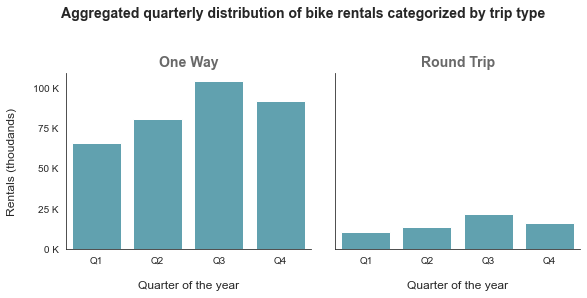

In [627]:
# set the palette as per requirement
flatui = ["#47b1c9", "#4c5e58"]
sb.set_palette(flatui, desat = 0.8)
base_color = sb.color_palette()[0]
sb.set_style('white')
plt.figure(figsize = [8, 4])

# plot facet grid
g = sb.FacetGrid(data = bikeshare, col = 'trip_type', col_wrap = 2, height = 4, aspect = 1)
g.map(sb.countplot, "quarter", color = base_color, order = bikeshare.quarter.sort_values(ascending=True).unique())
g.fig.subplots_adjust(top=0.75)
g.fig.suptitle('Aggregated quarterly distribution of bike rentals categorized by trip type\n', fontsize = 14, weight = 'bold')
g.set_titles('{col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# obtain y_ticks and convert them to a multiple of millions
# obtain the x_ticks and store them as a list
y_tick_names = []
x_tick_names = []
for ax in g.axes.flat:
    for y_label in ax.get_yticklabels():
        y_label_value = int(y_label.get_text())
        y_label_new_value = '{:0.0f} K'.format(y_label_value/1000)
        y_tick_names.append(y_label_new_value)
        
    for x_label in ax.get_xticklabels():
        x_label_value = x_label.get_text()
        x_tick_names.append(x_label_value)

g.set_yticklabels(y_tick_names, size = 10)
g.set_xticklabels(x_tick_names, size = 10)
g.set_xlabels('\nQuarter of the year', size = 12)
g.set_ylabels('Rentals (thoudands)\n', size = 12)

plt.subplots_adjust(wspace=0.1, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust dhe figure to include all of the x and y labels
plt.savefig('plots/3.2.47.c Facet grid of Trip rentals based on trip type and quarter of the year.png', dpi=300, bbox_inches='tight')

> Let us plot more variety of graphs to observe the distribution of data and hidden insights.

**`Heat Map:`**

One alternative way of depicting the relationship between two categorical variables is through a **Heat map**. Heat maps were introduced earlier as the 2-d version of a histogram; here, we're using them as the 2-d version of a bar chart. The seaborn function `heatmap` is at home with this type of heat map implementation, but the input arguments are unlike most of the visualization functions. Instead of providing the original dataframe, we need to summarize the counts into a matrix that will then be plotted.

> Now lets make a pivot from the categorical dataset created earlier into a more appropriate data structure.

In [628]:
categorical_counts = categorical_counts.pivot(index = 'trip_type', columns = 'quarter', values = 'rentals')
categorical_counts

quarter,Q1,Q2,Q3,Q4
trip_type,,,,
One Way,131608,161245,208051,183363
Round Trip,21602,27343,43423,31954


> The data is ready to be plotred as the `Heat map`.

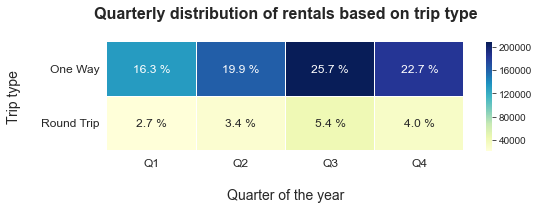

In [629]:
# plot heat map
plt.figure(figsize = [8, 2])
res = sb.heatmap(categorical_counts, annot = True, fmt = '.0f', annot_kws={'size':12}, linewidths=0.1, cmap="YlGnBu")
plt.yticks(rotation=0, fontsize="12", va="center")
plt.xticks(fontsize="12")
plt.title('Quarterly distribution of rentals based on trip type\n', fontsize = 16, weight = 'bold')
plt.xlabel('\nQuarter of the year', fontsize=14)
plt.ylabel('Trip type\n', fontsize=14);

# convert annotations to percentages
for t in res.texts: 
    p = np.round(np.round(int(t.get_text())/bikeshare.shape[0], 4)*100, 1)
    t.set_text(str(p)+' %')
               
# savefig by passing (bbox_inches='tight'),which will adjust dhe figure to include all of the x and y labels
plt.savefig('plots/3.2.47.d Heat map of Trip rentals based on trip type and quarter of the year.png', dpi=300, bbox_inches='tight')

**`Find average rentals based on the quarter:`**

> The `trip_type` needs to be converted into categorical datatype, otherwise the `groupby` method will ignore `NaN` rental values and inturn produce **incorrect** `avg. rental value`. Also use of `size()` method ignores the unused level combinations of the groups, hence use `count()` method.

In [630]:
quarter_df = bikeshare.groupby([bikeshare['year'], 
                                bikeshare['quarter'],
                                bikeshare['trip_type']]).count()['trip_id'].reset_index(name='rentals')

quarter_df['rentals'] = quarter_df['rentals'].fillna(0).astype(int)
quarter_df.head(10)

,year,quarter,trip_type,rentals
0,2017,Q1,One Way,30057
1,2017,Q1,Round Trip,3141
2,2017,Q2,One Way,46415
3,2017,Q2,Round Trip,4684
4,2017,Q3,One Way,61084
5,2017,Q3,Round Trip,10458
6,2017,Q4,One Way,58243
7,2017,Q4,Round Trip,11249
8,2018,Q1,One Way,53542
9,2018,Q1,Round Trip,10739


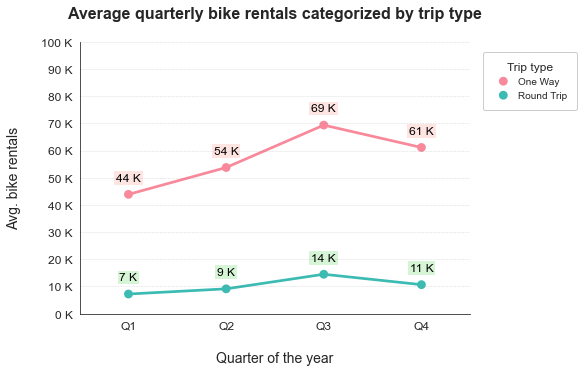

In [631]:
plt.figure(figsize=[7, 5])
sb.set_style('white')
flatui = ["#fff480"]
sb.set_palette(flatui, n_colors=1, desat=0.8)
base_color = sb.color_palette()[0]

sb.pointplot(data = quarter_df, x = "quarter", y = "rentals", linestyles = ['-', '-'], 
             hue = 'trip_type', ci = None)
plt.title('Average quarterly bike rentals categorized by trip type\n',  weight = 'bold', fontsize = 16)
plt.ylabel('Avg. bike rentals\n', fontsize = 14)
plt.xlabel('\nQuarter of the year', fontsize = 14)
plt.xticks(fontsize = 12)

# get ytick locs and rearrage them with respect to zero
locs, labels = plt.yticks()
quarter_rental_avg_max = 100000
y_tick_values = np.arange(0, quarter_rental_avg_max+10000, 10000)
y_tick_names = ['{:0.0f} K'.format(v/1000) for v in y_tick_values]
plt.yticks(y_tick_values, y_tick_names, fontsize = 12)

# add annotations
# -------------------------------------------------------
avg_rentals = quarter_df.groupby([quarter_df["trip_type"], quarter_df["quarter"]]).mean()['rentals'].reset_index()
avg_rentals_max = avg_rentals.rentals.max()
avg_rentals_oneway = avg_rentals.query(' trip_type == "One Way" ')
avg_rentals_roundtrip = avg_rentals.query(' trip_type == "Round Trip" ')

# get the current tick locations and labels
locs, labels = plt.xticks()

for categorical_df in [avg_rentals_oneway, avg_rentals_roundtrip]:
    clrs = ['salmon' if trip == "One Way" else 'limegreen' for trip in categorical_df.trip_type ]
    # loop through each pair of locations and labels
    for loc, label, avg_rental_count, clr in zip(locs, labels, categorical_df.rentals, clrs):
        try:
            count = avg_rental_count
        except KeyError:
            count = 0   
        pct_string = '{:0.0f} K'.format(count/1000)
        if categorical_df.trip_type.unique() == "One Way":
            indent = 5000
        else:
            indent = 5000
        # print the annotation depending on the bar length
        plt.text(loc, count + indent, pct_string, ha = 'center', color = 'black', 
                 fontsize = 12, bbox=dict(pad=1.9,alpha=0.2,color='none',fc=clr))
# -------------------------------------------------------

plt.legend(scatterpoints=1, frameon=True, fancybox=True, shadow=False, ncol = 1, 
           framealpha = 1, borderpad=1, borderaxespad=1, loc = 'upper right', labelspacing=0.5,  
           title='Trip type', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(1.3, 1))

for loc in y_tick_values:
    plt.axhline(loc, ls='--', color='grey', linewidth=0.5, alpha=0.3)
    
sb.despine(top=True, right=True, left=False, bottom=False);

# savefig by passing (bbox_inches='tight'),which will adjust dhe figure to include all of the x and y labels
plt.savefig('plots/3.2.47.e Average quarterly bike rentals categorized by trip type.png', dpi=300, bbox_inches='tight')

------------

#### 3.2.48 Bivariate analysis of `bikeshare.quarter` and `bike_type` columns:

+ `Columns`: quarter, bike_type
+ `Data type`: (Categorical, ordered) and (Categorical, nominal)
+ `Plot`: Facet Grid, Violin plot, Box plot, Adapted Barchart

**`Stack plot:`**

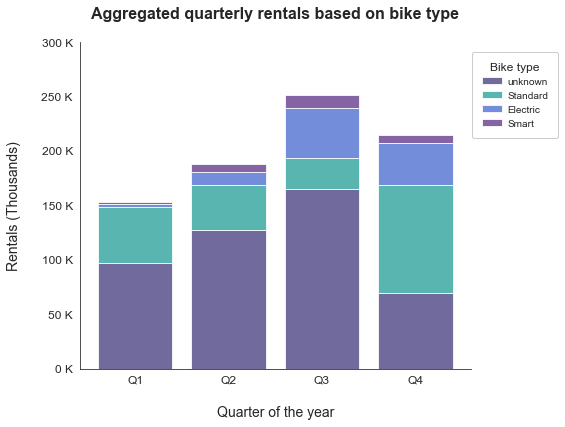

In [632]:
# Assign palette as per requirement
sb.set_style('white')
flatui = ["darkslateblue", "lightseagreen", "royalblue", "rebeccapurple"]
sb.set_palette(flatui, desat = 0.8)
plt.figure(figsize = [7, 6])

cat1_order = bikeshare.quarter.sort_values(ascending=True).unique()
cat2_order = bikeshare.bike_type.sort_values(ascending=True).unique()

# plot stacked plot
baselines = np.zeros(len(cat1_order))
# for each second-variable category:
for i in range(len(cat2_order)):
    # isolate the counts of the first category,
    cat2 = cat2_order[i]
    inner_counts = bikeshare[bikeshare['bike_type'] == cat2]['quarter'].value_counts()
    # then plot those counts on top of the accumulated baseline
    plt.bar(x = np.arange(len(cat1_order)), height = inner_counts[cat1_order].fillna(0),
            bottom = baselines, alpha = 0.8)
    baselines += inner_counts[cat1_order].fillna(0)

# improve plot aesthetics
max_count = bikeshare.groupby([bikeshare['quarter']]).size().reset_index(name='rentals').max()['rentals']
y_tick_values = np.arange(0, max_count + 50000, 50000)
y_tick_names = ['{:0.0f} K'.format(v/1000) for v in y_tick_values]

plt.title('Aggregated quarterly rentals based on bike type\n', weight = 'bold', fontsize = 16)
plt.xticks(np.arange(len(cat1_order)), cat1_order, fontsize=12)
plt.yticks(y_tick_values, y_tick_names, fontsize=12)
plt.xlabel('\nQuarter of the year', fontsize=14)
plt.ylabel('Rentals (Thousands)\n', fontsize=14)
plt.legend(cat2_order, scatterpoints=1, frameon=True, fancybox=True, shadow=False, ncol = 1, 
           framealpha = 1, borderpad=1, borderaxespad=1, loc = 'upper right', labelspacing=0.5,  
           title='Bike type', title_fontsize=12, fontsize=10, facecolor='white',
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(1.25, 1))

sb.despine();

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.48.a Stack plot of rentals based on bike type and quarter of the year.png', dpi=300, bbox_inches='tight')

**`Line plot:`**

> The data needs some summirization by grouping together the respective variables. Then, reset the index and name the summerized data values accordingly.

In [633]:
categorical_counts = bikeshare.groupby([bikeshare['bike_type'], 
                                        bikeshare['quarter']]).size().reset_index(name='rentals')
categorical_counts.head(10)

,bike_type,quarter,rentals
0,unknown,Q1,97479
1,unknown,Q2,127223
2,unknown,Q3,164741
3,unknown,Q4,69492
4,Standard,Q1,51497
5,Standard,Q2,41870
6,Standard,Q3,28966
7,Standard,Q4,99810
8,Electric,Q1,2133
9,Electric,Q2,11535


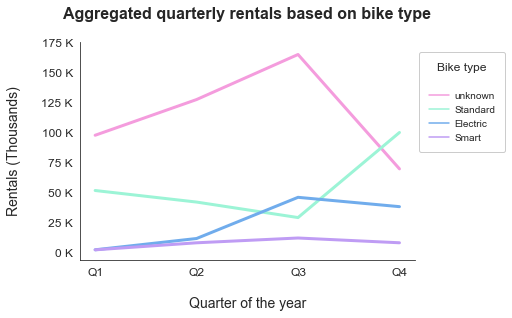

In [634]:
# set the palette as per requirement
sb.set_style('white')
# flatui = ["darkslateblue", "lightseagreen", "royalblue", "rebeccapurple"]
flatui = ['#ff91e2', '#91ffda', '#60acfc', '#bd91ff']
sb.set_palette(flatui, n_colors=4, desat=0.8)

plt.figure(figsize = [6, 4])
max_count = categorical_counts.rentals.max()
y_tick_values = np.arange(0, max_count + 25000, 25000)
y_tick_names = ['{:0.0f} K'.format(v/1000) for v in y_tick_values]

# plot line plot
ax = sb.lineplot(data = categorical_counts, x = "quarter", y = "rentals", hue="bike_type", linewidth=3)
plt.title('Aggregated quarterly rentals based on bike type\n', weight = 'bold', fontsize = 16)
plt.xticks(fontsize=12)
plt.yticks(y_tick_values, y_tick_names, fontsize=12)
plt.xlabel('\nQuarter of the year', fontsize=14)
plt.ylabel('Rentals (Thousands)\n', fontsize=14)

# when 'hue' is used, its label appears as legend title
# replace default title with custom title.
plt.legend(scatterpoints=1, frameon=True, fancybox=True, shadow=False, ncol = 1, framealpha = 1, 
           borderpad=1, borderaxespad=1, loc = 'upper right', labelspacing=0.5,  
           title='Bike type', title_fontsize=12, fontsize=10, facecolor='white', markerfirst=True, 
           handlelength=2, handletextpad=0.5, bbox_to_anchor=(1.3, 1)).texts[0].set_text("");

sb.despine();

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.48.b Line plot of rentals based on bike type and quarter of the year.png', dpi=300, bbox_inches='tight')

**`Individual plots of aggregated distribution of quarterly rentals over bike type:`**

<Figure size 576x288 with 0 Axes>

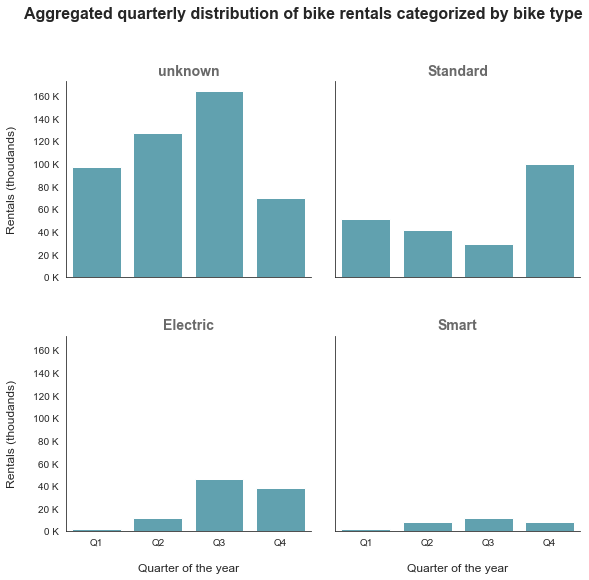

In [635]:
# set the palette as per requirement
flatui = ["#47b1c9", "#4c5e58"]
sb.set_palette(flatui, desat = 0.8)
base_color = sb.color_palette()[0]
sb.set_style('white')
plt.figure(figsize = [8, 4])

# plot facet grid
g = sb.FacetGrid(data = bikeshare, col = 'bike_type', col_wrap = 2, height = 4, aspect = 1)
g.map(sb.countplot, "quarter", color = base_color, order = bikeshare.quarter.sort_values(ascending=True).unique())
g.fig.subplots_adjust(top=0.85)
g.fig.suptitle('Aggregated quarterly distribution of bike rentals categorized by bike type\n', fontsize = 16, weight = 'bold')
g.set_titles('{col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# obtain y_ticks and convert them to a multiple of millions
# obtain the x_ticks and store them as a list
y_tick_names = []
x_tick_names = []
for ax in g.axes.flat:
    for y_label in ax.get_yticklabels():
        y_label_value = int(y_label.get_text())
        y_label_new_value = '{:0.0f} K'.format(y_label_value/1000)
        y_tick_names.append(y_label_new_value)
        
    for x_label in ax.get_xticklabels():
        x_label_value = x_label.get_text()
        x_tick_names.append(x_label_value)

g.set_yticklabels(y_tick_names, size = 10)
g.set_xticklabels(x_tick_names, size = 10)
g.set_xlabels('\nQuarter of the year', size = 12)
g.set_ylabels('Rentals (thoudands)\n', size = 12)

plt.subplots_adjust(wspace=0.1, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.48.c Facet grid of rentals based on bike type and quarter of the year.png', dpi=300, bbox_inches='tight')

> Let us plot more variety of graphs to observe the distribution of data and hidden insights.

**`Heat Map:`**

> Now lets make a pivot from the categorical dataset created earlier into a more appropriate data structure.

In [636]:
categorical_counts = categorical_counts.pivot(index = 'bike_type', columns = 'quarter', values = 'rentals')
categorical_counts

quarter,Q1,Q2,Q3,Q4
bike_type,,,,
unknown,97479,127223,164741,69492
Standard,51497,41870,28966,99810
Electric,2133,11535,45818,38043
Smart,2101,7960,11949,7972


> The data is ready to be plotred as the `Heat map`.

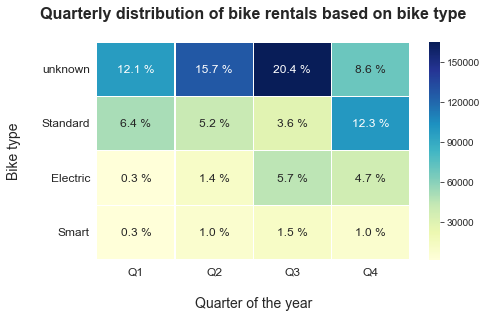

In [637]:
# plot heat map
plt.figure(figsize = [7, 4])
res = sb.heatmap(categorical_counts, annot = True, fmt = '.0f', annot_kws={'size':12}, linewidths=0.1, cmap="YlGnBu")
plt.yticks(rotation=0, fontsize="12", va="center")
plt.xticks(fontsize="12")
plt.title('Quarterly distribution of bike rentals based on bike type\n', fontsize = 16, weight = 'bold')
plt.xlabel('\nQuarter of the year', fontsize=14)
plt.ylabel('Bike type\n', fontsize=14);

# convert annotations to percentages
for t in res.texts: 
    p = np.round(np.round(int(t.get_text())/bikeshare.shape[0], 4)*100, 1)
    t.set_text(str(p)+' %')
               
# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.48.d Heat map of rentals based on bike type and quarter of the year.png', dpi=300, bbox_inches='tight')

**`Find average rentals based on the quarter of the year:`**

> The `bike_type` needs to be converted into categorical datatype, otherwise the `groupby` method will ignore `NaN` rental values and inturn produce **incorrect** `avg. rental value`. Also use of `size()` method ignores the unused level combinations of the groups, hence use `count()` method.

In [638]:
quarter_df = bikeshare.groupby([bikeshare['year'], 
                                bikeshare['quarter'],
                                bikeshare['bike_type']]).count()['trip_id'].reset_index(name='rentals')

quarter_df['rentals'] = quarter_df['rentals'].fillna(0).astype(int)
quarter_df.head(10)

,year,quarter,bike_type,rentals
0,2017,Q1,unknown,33198
1,2017,Q1,Standard,0
2,2017,Q1,Electric,0
3,2017,Q1,Smart,0
4,2017,Q2,unknown,51099
5,2017,Q2,Standard,0
6,2017,Q2,Electric,0
7,2017,Q2,Smart,0
8,2017,Q3,unknown,71542
9,2017,Q3,Standard,0


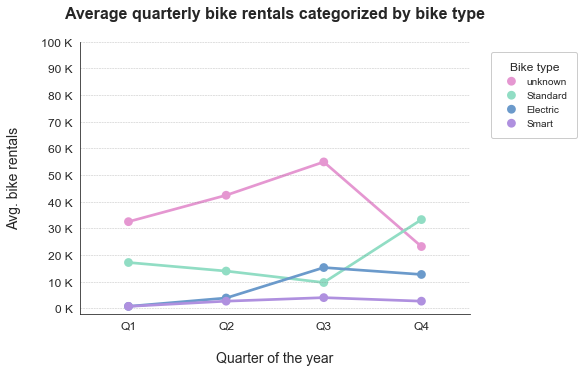

In [639]:
plt.figure(figsize=[7, 5])
sb.set_style('white')
# flatui = ['#ff91e2', '#91ffda', '#60acfc', '#bd91ff']
flatui = ['#ff7ddd', '#77f7cc', '#4b99eb', '#aa75fa']
sb.set_palette(flatui, n_colors=4, desat=0.6)
base_color = sb.color_palette()[0]

sb.pointplot(data = quarter_df, x = "quarter", y = "rentals", linestyles = "-", hue = 'bike_type', 
             scale = 1, ci = None)
plt.title('Average quarterly bike rentals categorized by bike type\n',  weight = 'bold', fontsize = 16)
plt.ylabel('Avg. bike rentals\n', fontsize = 14)
plt.xlabel('\nQuarter of the year', fontsize = 14)
plt.xticks(fontsize = 12)

# get ytick locs and rearrage them with respect to zero
locs, labels = plt.yticks()
quarterly_rental_avg_max = 100000
y_tick_values = np.arange(0, quarterly_rental_avg_max+10000, 10000)
y_tick_names = ['{:0.0f} K'.format(v/1000) for v in y_tick_values]
plt.yticks(y_tick_values, y_tick_names, fontsize = 12)

plt.legend(scatterpoints=1, frameon=True, fancybox=True, shadow=False, ncol = 1, 
           framealpha = 1, borderpad=1, borderaxespad=1, loc = 'upper right', labelspacing=0.5,  
           title='Bike type', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(1.3, 1))

sb.despine(top=True, right=True, left=False, bottom=False);

for loc in y_tick_values:
    plt.axhline(loc, ls='--', color='grey', linewidth=0.5, alpha=0.5)

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.48.e Average quarterly bike rentals categorized by bike type.png', dpi=300, bbox_inches='tight')

------

#### 3.2.49 Bivariate analysis of `bikeshare.quarter` and `pass_type` columns:

+ `Columns`: quarter, pass_type
+ `Data type`: (Categorical, ordered) and (Categorical, nominal)
+ `Plot`: Facet Grid, Violin plot, Box plot, Adapted Barchart

**`Stack plot:`**

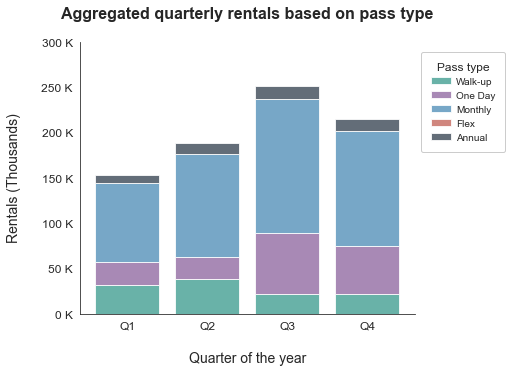

In [640]:
# Assign palette as per requirement
sb.set_style('white')
plt.figure(figsize = [6, 5])
flatui = ["#26bda7", "#9b59b6", "#3498db", "#e74c3c", "#34495e"]
sb.set_palette(flatui, n_colors=5, desat=0.6)

cat1_order = bikeshare.quarter.sort_values(ascending=True).unique()
cat2_order = bikeshare.pass_type.sort_values(ascending=True).unique()

# plot stacked plot
baselines = np.zeros(len(cat1_order))
# for each second-variable category:
for i in range(len(cat2_order)):
    # isolate the counts of the first category,
    cat2 = cat2_order[i]
    inner_counts = bikeshare[bikeshare['pass_type'] == cat2]['quarter'].value_counts()
    # then plot those counts on top of the accumulated baseline
    plt.bar(x = np.arange(len(cat1_order)), height = inner_counts[cat1_order].fillna(0),
            bottom = baselines, alpha = 0.8)
    baselines += inner_counts[cat1_order].fillna(0)

# improve plot aesthetics
max_count = bikeshare.groupby([bikeshare['quarter']]).size().reset_index(name='rentals').max()['rentals']
y_tick_values = np.arange(0, max_count + 50000, 50000)
y_tick_names = ['{:0.0f} K'.format(v/1000) for v in y_tick_values]

plt.title('Aggregated quarterly rentals based on pass type\n', weight = 'bold', fontsize = 16)
plt.xticks(np.arange(len(cat1_order)), cat1_order, fontsize=12)
plt.yticks(y_tick_values, y_tick_names, fontsize=12)
plt.xlabel('\nQuarter of the year', fontsize=14)
plt.ylabel('Rentals (Thousands)\n', fontsize=14)
plt.legend(cat2_order, scatterpoints=1, frameon=True, fancybox=True, shadow=False, ncol = 1, 
           framealpha = 1, borderpad=1, borderaxespad=1, loc = 'upper right', labelspacing=0.5,  
           title='Pass type', title_fontsize=12, fontsize=10, facecolor='white',
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(1.3, 1))

sb.despine();

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.49.a Stack plot of rentals based on pass type and quarter of the year.png', dpi=300, bbox_inches='tight')

**`Line plot:`**

> The data needs some summirization by grouping together the respective variables. Then, reset the index and name the summerized data values accordingly.

In [641]:
categorical_counts = bikeshare.groupby([bikeshare['pass_type'], 
                                        bikeshare['quarter']]).size().reset_index(name='rentals')
categorical_counts.head(10)

,pass_type,quarter,rentals
0,Walk-up,Q1,31053
1,Walk-up,Q2,38038
2,Walk-up,Q3,21164
3,Walk-up,Q4,21823
4,One Day,Q1,25552
5,One Day,Q2,24332
6,One Day,Q3,67987
7,One Day,Q4,53321
8,Monthly,Q1,87049
9,Monthly,Q2,113897


C:\Users\VAMSHI-KRISHNA-PRIME\Anaconda3\lib\site-packages\seaborn\algorithms.py:70: RuntimeWarning: Mean of empty slice.
  return getattr(x, func)()
C:\Users\VAMSHI-KRISHNA-PRIME\Anaconda3\lib\site-packages\numpy\core\_methods.py:85: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


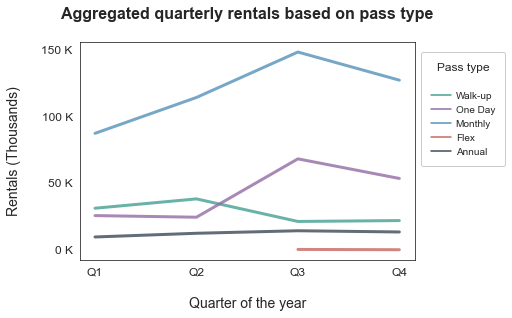

In [642]:
# set the palette as per requirement
sb.set_style('white')
flatui = ["#26bda7", "#9b59b6", "#3498db", "#e74c3c", "#34495e"]
sb.set_palette(flatui, n_colors=5, desat=0.6)

plt.figure(figsize = [6, 4])
max_count = categorical_counts.rentals.max()
y_tick_values = np.arange(0, max_count + 50000, 50000)
y_tick_names = ['{:0.0f} K'.format(v/1000) for v in y_tick_values]

# plot line plot
ax = sb.lineplot(data=categorical_counts, x = "quarter", y = "rentals", hue="pass_type",
                 alpha = 0.8, err_style="bars", linewidth=3)
plt.title('Aggregated quarterly rentals based on pass type\n', weight = 'bold', fontsize = 16)
plt.xticks(fontsize=12)
plt.yticks(y_tick_values, y_tick_names, fontsize=12)
plt.xlabel('\nQuarter of the year', fontsize=14)
plt.ylabel('Rentals (Thousands)\n', fontsize=14)

# when 'hue' is used, its label appears as legend title
# replace default title with custom title.
ax.legend(scatterpoints=1, frameon=True, fancybox=True, shadow=False, ncol = 1, framealpha = 1, 
          borderpad=1, borderaxespad=1, loc = 'upper right', labelspacing=0.5, title = "Pass type",
          title_fontsize=12, fontsize=10, facecolor='white', markerfirst=True, handlelength=2,
          handletextpad=0.5, bbox_to_anchor=(1.3, 1)).texts[0].set_text("");

# sb.despine();

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.49.b Line plot of rentals based on pass type and quarter of the year.png', dpi=300, bbox_inches='tight')

**`Individual plots of aggregated distribution of quarterly rentals over pass type:`**

<Figure size 576x288 with 0 Axes>

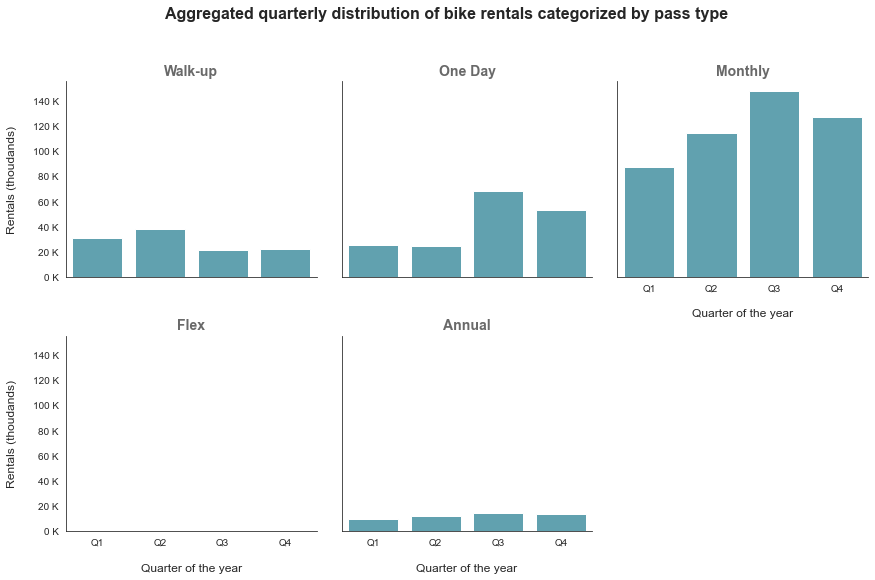

In [643]:
# set the palette as per requirement
flatui = ["#47b1c9", "#4c5e58"]
sb.set_palette(flatui, desat = 0.8)
base_color = sb.color_palette()[0]
sb.set_style('white')
plt.figure(figsize = [8, 4])

# plot facet grid
g = sb.FacetGrid(data = bikeshare, col = 'pass_type', col_wrap = 3, height = 4, aspect = 1)
g.map(sb.countplot, "quarter", color = base_color, order = bikeshare.quarter.sort_values(ascending=True).unique())
g.fig.subplots_adjust(top=0.85)
g.fig.suptitle('Aggregated quarterly distribution of bike rentals categorized by pass type\n', fontsize = 16, weight = 'bold')
g.set_titles('{col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# obtain y_ticks and convert them to a multiple of millions
# obtain the x_ticks and store them as a list
y_tick_names = []
x_tick_names = []
for ax in g.axes.flat:
    for y_label in ax.get_yticklabels():
        y_label_value = int(y_label.get_text())
        y_label_new_value = '{:0.0f} K'.format(y_label_value/1000)
        y_tick_names.append(y_label_new_value)
        
    for x_label in ax.get_xticklabels():
        x_label_value = x_label.get_text()
        x_tick_names.append(x_label_value)

g.set_yticklabels(y_tick_names, size = 10)
g.set_xticklabels(x_tick_names, size = 10)
g.set_xlabels('\nQuarter of the year', size = 12)
g.set_ylabels('Rentals (thoudands)\n', size = 12)

plt.subplots_adjust(wspace=0.1, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.49.c Facet grid of rentals based on pass type and quarter of the year.png', dpi=300, bbox_inches='tight')

> Let us plot more variety of graphs to observe the distribution of data and hidden insights.

**`Heat Map:`**

> Now lets make a pivot from the categorical dataset created earlier into a more appropriate data structure.

In [644]:
categorical_counts = categorical_counts.pivot(index = 'pass_type', columns = 'quarter', values = 'rentals')
categorical_counts

quarter,Q1,Q2,Q3,Q4
pass_type,,,,
Walk-up,31053.0,38038.0,21164.0,21823.0
One Day,25552.0,24332.0,67987.0,53321.0
Monthly,87049.0,113897.0,147874.0,126846.0
Flex,NaN,NaN,238.0,25.0
Annual,9556.0,12321.0,14211.0,13302.0


> The data is ready to be plotred as the `Heat map`.

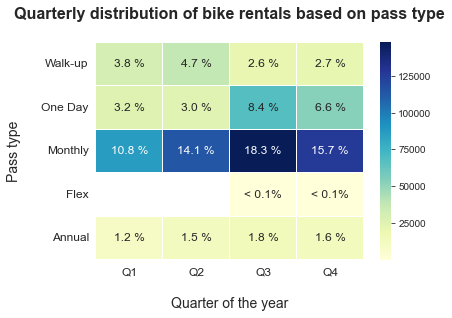

In [645]:
# plot heat map
plt.figure(figsize = [6, 4])
res = sb.heatmap(categorical_counts, annot = True, fmt = '.0f', annot_kws={'size':12}, linewidths=0.1, cmap="YlGnBu")
plt.yticks(rotation=0, fontsize="12", va="center")
plt.xticks(fontsize="12")
plt.title('Quarterly distribution of bike rentals based on pass type\n', fontsize = 16, weight = 'bold')
plt.xlabel('\nQuarter of the year', fontsize=14)
plt.ylabel('Pass type\n', fontsize=14);

# convert annotations to percentages
for t in res.texts: 
    p = np.round(np.round(int(t.get_text())/bikeshare.shape[0], 4)*100, 1)
    if p < 0.1:
        t.set_text('< 0.1%')
    else:
        t.set_text(str(p)+' %');  

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.49.d Heat map of rentals based on pass type and quarter of the year.png', dpi=300, bbox_inches='tight')

**`Find average rentals based on quarter of the year:`**

> The `pass_type` needs to be converted into categorical datatype, otherwise the `groupby` method will ignore `NaN` rental values and inturn produce **incorrect** `avg. rental value`. Also use of `size()` method ignores the unused level combinations of the groups, hence use `count()` method.

In [646]:
quarter_df = bikeshare.groupby([bikeshare['year'], 
                                bikeshare['quarter'],
                                bikeshare['pass_type']]).count()['trip_id'].reset_index(name='rentals')

quarter_df['rentals'] = quarter_df['rentals'].fillna(0).astype(int)
quarter_df.head(10)

,year,quarter,pass_type,rentals
0,2017,Q1,Walk-up,10211
1,2017,Q1,One Day,0
2,2017,Q1,Monthly,20730
3,2017,Q1,Flex,0
4,2017,Q1,Annual,2257
5,2017,Q2,Walk-up,12740
6,2017,Q2,One Day,0
7,2017,Q2,Monthly,35297
8,2017,Q2,Flex,0
9,2017,Q2,Annual,3062


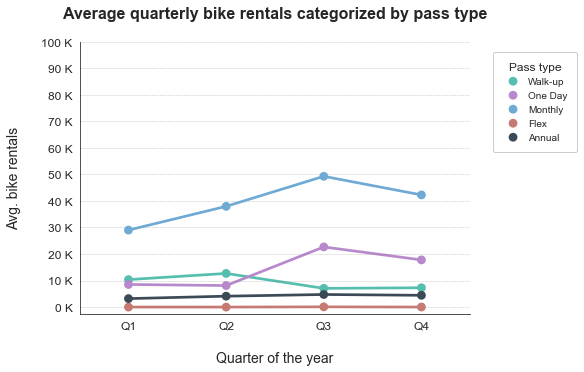

In [647]:
plt.figure(figsize=[7,5])
sb.set_style('white')
flatui = ["#34e0c7", "#c271e3", "#4cb1f5", "#e06458", "#34495e"]
sb.set_palette(flatui, n_colors=5, desat=0.6)
base_color = sb.color_palette()[0]

sb.pointplot(data = quarter_df, x = "quarter", y = "rentals", linestyles = "-", hue = 'pass_type', 
             scale = 1, ci = None)
plt.title('Average quarterly bike rentals categorized by pass type\n',  weight = 'bold', fontsize = 16)
plt.ylabel('Avg. bike rentals\n', fontsize = 14)
plt.xlabel('\nQuarter of the year', fontsize = 14)
plt.xticks(fontsize = 12)

# get ytick locs and rearrage them with respect to zero
locs, labels = plt.yticks()
weekday_rental_avg_max = 100000
y_tick_values = np.arange(0, weekday_rental_avg_max+10000, 10000)
y_tick_names = ['{:0.0f} K'.format(v/1000) for v in y_tick_values]
plt.yticks(y_tick_values, y_tick_names, fontsize = 12)

plt.legend(scatterpoints=1, frameon=True, fancybox=True, shadow=False, ncol = 1, 
           framealpha = 1, borderpad=1, borderaxespad=1, loc = 'upper right', labelspacing=0.5,  
           title='Pass type', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(1.3, 1))

sb.despine(top=True, right=True, left=False, bottom=False);

for loc in y_tick_values:
    plt.axhline(loc, ls='--', color='grey', linewidth=0.5, alpha=0.5)

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.49.e Average quarterly bike rentals categorized by pass type.png', dpi=300, bbox_inches='tight')

---

#### 3.2.50 Bivariate analysis of `bikeshare.quarter` and `fare_type` columns:

+ `Columns`: quarter, fare
_type
+ `Data type`: (Categorical, ordered) and (Categorical, nominal)
+ `Plot`: Facet Grid, Violin plot, Box plot, Adapted Barchart

**`Stack plot:`**

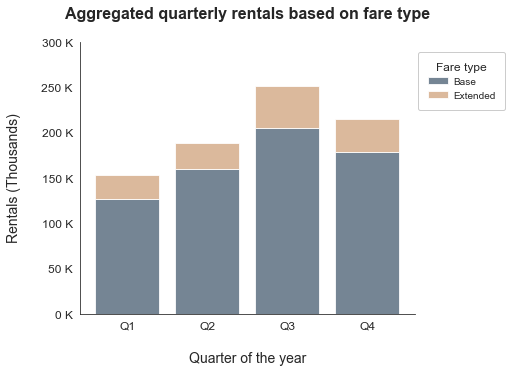

In [648]:
# Assign palette as per requirement
sb.set_style('white')
plt.figure(figsize = [6, 5])
flatui = ['#466887', '#eda668']
sb.set_palette(flatui, n_colors=2, desat=0.6)

cat1_order = bikeshare.quarter.sort_values(ascending=True).unique()
cat2_order = bikeshare.fare_type.sort_values(ascending=True).unique()

# plot stacked plot
baselines = np.zeros(len(cat1_order))
# for each second-variable category:
for i in range(len(cat2_order)):
    # isolate the counts of the first category,
    cat2 = cat2_order[i]
    inner_counts = bikeshare[bikeshare['fare_type'] == cat2]['quarter'].value_counts()
    # then plot those counts on top of the accumulated baseline
    plt.bar(x = np.arange(len(cat1_order)), height = inner_counts[cat1_order].fillna(0),
            bottom = baselines, alpha = 0.8)
    baselines += inner_counts[cat1_order].fillna(0)

# improve plot aesthetics
max_count = bikeshare.groupby([bikeshare['quarter']]).size().reset_index(name='rentals').max()['rentals']
y_tick_values = np.arange(0, max_count + 50000, 50000)
y_tick_names = ['{:0.0f} K'.format(v/1000) for v in y_tick_values]

plt.title('Aggregated quarterly rentals based on fare type\n', weight = 'bold', fontsize = 16)
plt.xticks(np.arange(len(cat1_order)), cat1_order, fontsize=12)
plt.yticks(y_tick_values, y_tick_names, fontsize=12)
plt.xlabel('\nQuarter of the year', fontsize=14)
plt.ylabel('Rentals (Thousands)\n', fontsize=14)
plt.legend(cat2_order, scatterpoints=1, frameon=True, fancybox=True, shadow=False, ncol = 1, 
           framealpha = 1, borderpad=1, borderaxespad=1, loc = 'upper right', labelspacing=0.5,  
           title='Fare type', title_fontsize=12, fontsize=10, facecolor='white',
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(1.3, 1))

sb.despine();

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.50.a Stack plot of rentals based on fare type and quarter of the year.png', dpi=300, bbox_inches='tight')

**`Line plot:`**

> The data needs some summirization by grouping together the respective variables. Then, reset the index and name the summerized data values accordingly.

In [649]:
categorical_counts = bikeshare.groupby([bikeshare['fare_type'], 
                                        bikeshare['quarter']]).size().reset_index(name='rentals')
categorical_counts.head(10)

,fare_type,quarter,rentals
0,Base,Q1,126765
1,Base,Q2,159346
2,Base,Q3,204794
3,Base,Q4,177884
4,Extended,Q1,26445
5,Extended,Q2,29242
6,Extended,Q3,46680
7,Extended,Q4,37433


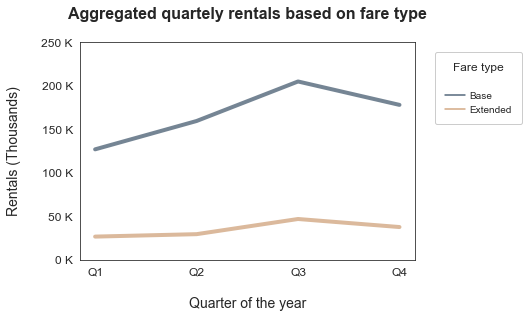

In [650]:
# set the palette as per requirement
sb.set_style('white')
flatui = ['#466887', '#eda668']
sb.set_palette(flatui, n_colors=2, desat=0.6)

plt.figure(figsize = [6, 4])
max_count = categorical_counts.rentals.max()
y_tick_values = np.arange(0, max_count + 50000, 50000)
y_tick_names = ['{:0.0f} K'.format(v/1000) for v in y_tick_values]

# plot line plot
ax = sb.lineplot(data=categorical_counts, x = "quarter", y = "rentals", hue="fare_type", 
                 alpha = 0.8, err_style="bars", linewidth=4)
plt.title('Aggregated quartely rentals based on fare type\n', weight = 'bold', fontsize = 16)
plt.xticks(fontsize=12)
plt.yticks(y_tick_values, y_tick_names, fontsize=12)
plt.xlabel('\nQuarter of the year', fontsize=14)
plt.ylabel('Rentals (Thousands)\n', fontsize=14)

# when 'hue' is used, its label appears as legend title
# replace default title with custom title.
ax.legend(scatterpoints=1, frameon=True, fancybox=True, shadow=False, ncol = 1, framealpha = 1, 
           borderpad=1, borderaxespad=1, loc = 'upper right', labelspacing=0.5,  
           title='Fare type', title_fontsize=12, fontsize=10, facecolor='white', markerfirst=True, 
           handlelength=2, handletextpad=0.5, bbox_to_anchor=(1.35, 1)).texts[0].set_text("");

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.50.b Line plot of rentals based on fare type and quarter of the year.png', dpi=300, bbox_inches='tight')

**`Individual plots of aggregated distribution of weekday rentals over fare type:`**

<Figure size 576x288 with 0 Axes>

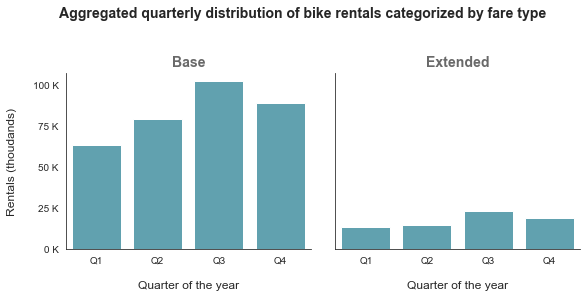

In [651]:
# set the palette as per requirement
flatui = ["#47b1c9", "#4c5e58"]
sb.set_palette(flatui, desat = 0.8)
base_color = sb.color_palette()[0]
sb.set_style('white')
plt.figure(figsize = [8, 4])

# plot facet grid
g = sb.FacetGrid(data = bikeshare, col = 'fare_type', col_wrap = 2, height = 4, aspect = 1)
g.map(sb.countplot, "quarter", color = base_color, order = bikeshare.quarter.sort_values(ascending=True).unique())
g.fig.subplots_adjust(top=0.75)
g.fig.suptitle('Aggregated quarterly distribution of bike rentals categorized by fare type\n', fontsize = 14, weight = 'bold')
g.set_titles('{col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# obtain y_ticks and convert them to a multiple of millions
# obtain the x_ticks and store them as a list
y_tick_names = []
x_tick_names = []
for ax in g.axes.flat:
    for y_label in ax.get_yticklabels():
        y_label_value = int(y_label.get_text())
        y_label_new_value = '{:0.0f} K'.format(y_label_value/1000)
        y_tick_names.append(y_label_new_value)
        
    for x_label in ax.get_xticklabels():
        x_label_value = x_label.get_text()
        x_tick_names.append(x_label_value)

g.set_yticklabels(y_tick_names, size = 10)
g.set_xticklabels(x_tick_names, size = 10)
g.set_xlabels('\nQuarter of the year', size = 12)
g.set_ylabels('Rentals (thoudands)\n', size = 12)

plt.subplots_adjust(wspace=0.1, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.50.c Facet grid of rentals based on fare type and quarter of the year.png', dpi=300, bbox_inches='tight')

> Let us plot more variety of graphs to observe the distribution of data and hidden insights.

**`Heat Map:`**

> Now lets make a pivot from the categorical dataset created earlier into a more appropriate data structure.

In [652]:
categorical_counts = categorical_counts.pivot(index = 'fare_type', columns = 'quarter', values = 'rentals')
categorical_counts

quarter,Q1,Q2,Q3,Q4
fare_type,,,,
Base,126765,159346,204794,177884
Extended,26445,29242,46680,37433


> The data is ready to be plotred as the `Heat map`.

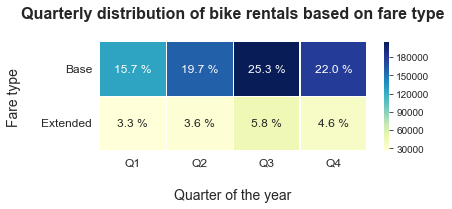

In [653]:
# plot heat map
plt.figure(figsize = [6, 2])
res = sb.heatmap(categorical_counts, annot = True, fmt = '.0f', annot_kws={'size':12}, linewidths=0.1, cmap="YlGnBu")
plt.yticks(rotation=0, fontsize="12", va="center")
plt.xticks(fontsize="12")
plt.title('Quarterly distribution of bike rentals based on fare type\n', fontsize = 16, weight = 'bold')
plt.xlabel('\nQuarter of the year', fontsize=14)
plt.ylabel('Fare type\n', fontsize=14);

# convert annotations to percentages
for t in res.texts: 
    p = np.round(np.round(int(t.get_text())/bikeshare.shape[0], 4)*100, 1)
    if p < 0.1:
        t.set_text('< 0.1%')
    else:
        t.set_text(str(p)+' %');  

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.50.d Heat map of rentals based on fare type and quarter of the year.png', dpi=300, bbox_inches='tight')

**`Find average rentals based on the quarter of the year:`**

> The `fare_type` needs to be converted into categorical datatype, otherwise the `groupby` method will ignore `NaN` rental values and inturn produce **incorrect** `avg. rental value`. Also use of `size()` method ignores the unused level combinations of the groups, hence use `count()` method.

In [654]:
quarter_df = bikeshare.groupby([bikeshare['year'], 
                                bikeshare['quarter'],
                                bikeshare['fare_type']]).count()['trip_id'].reset_index(name='rentals')

quarter_df['rentals'] = quarter_df['rentals'].fillna(0).astype(int)
quarter_df.head(10)

,year,quarter,fare_type,rentals
0,2017,Q1,Base,29517
1,2017,Q1,Extended,3681
2,2017,Q2,Base,46286
3,2017,Q2,Extended,4813
4,2017,Q3,Base,61400
5,2017,Q3,Extended,10142
6,2017,Q4,Base,55142
7,2017,Q4,Extended,14350
8,2018,Q1,Base,50353
9,2018,Q1,Extended,13928


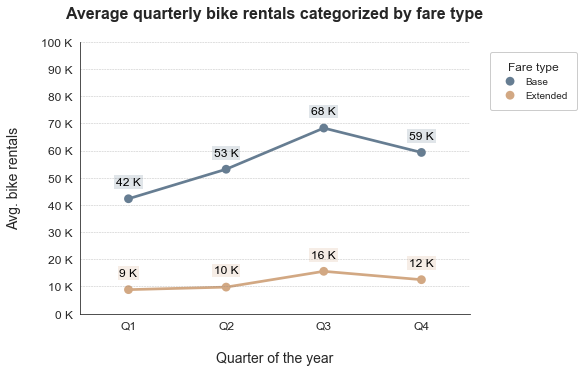

In [655]:
plt.figure(figsize=[7,5])
sb.set_style('white')
flatui = ['#577da1', '#eda668']
sb.set_palette(flatui, n_colors=2, desat=0.6)
base_color = sb.color_palette()[0]

sb.pointplot(data = quarter_df, x = "quarter", y = "rentals", linestyles = "-", hue = 'fare_type', 
             scale = 1, ci = None)
plt.title('Average quarterly bike rentals categorized by fare type\n',  weight = 'bold', fontsize = 16)
plt.ylabel('Avg. bike rentals\n', fontsize = 14)
plt.xlabel('\nQuarter of the year', fontsize = 14)
plt.xticks(fontsize = 12)

# get ytick locs and rearrage them with respect to zero
locs, labels = plt.yticks()
quarterly_rental_avg_max = 100000
y_tick_values = np.arange(0, quarterly_rental_avg_max+10000, 10000)
y_tick_names = ['{:0.0f} K'.format(v/1000) for v in y_tick_values]
plt.yticks(y_tick_values, y_tick_names, fontsize = 12)

# add annotations
# -------------------------------------------------------
avg_rentals = quarter_df.groupby([quarter_df["fare_type"], quarter_df["quarter"]]).mean()['rentals'].reset_index()
avg_rentals_max = avg_rentals.rentals.max()
avg_rentals_base = avg_rentals.query(' fare_type == "Base" ')
avg_rentals_extended = avg_rentals.query(' fare_type == "Extended" ')

# get the current tick locations and labels
locs, labels = plt.xticks()

for categorical_df in [avg_rentals_base, avg_rentals_extended]:
    clrs = [sb.color_palette()[0] if fare == "Base" else sb.color_palette()[1] for fare in categorical_df.fare_type ]
    # loop through each pair of locations and labels
    for loc, label, avg_rental_count, clr in zip(locs, labels, categorical_df.rentals, clrs):
        try:
            count = avg_rental_count
        except KeyError:
            count = 0   
        pct_string = '{:0.0f} K'.format(count/1000)
        indent = 5000
        # print the annotation depending on the bar length
        plt.text(loc, count + indent, pct_string, ha = 'center', color = 'black', 
                 fontsize = 12, bbox=dict(pad=1.9,alpha=0.2,color='none',fc=clr))
# -------------------------------------------------------

plt.legend(scatterpoints=1, frameon=True, fancybox=True, shadow=False, ncol = 1, 
           framealpha = 1, borderpad=1, borderaxespad=1, loc = 'upper right', labelspacing=0.5,  
           title='Fare type', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(1.3, 1))

sb.despine(top=True, right=True, left=False, bottom=False);

for loc in y_tick_values:
    plt.axhline(loc, ls='--', color='grey', linewidth=0.5, alpha=0.5)

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.50.e Average quarterly bike rentals categorized by fare type.png', dpi=300, bbox_inches='tight')

----

#### 3.2.51 Bivariate analysis of `bikeshare.year` and `trip_type` columns:

+ `Columns`: year, trip_type
+ `Data type`: (Categorical, ordered) and (Categorical, nominal)
+ `Plot`: Facet Grid, Violin plot, Box plot, Adapted Barchart

**`Stack plot:`**

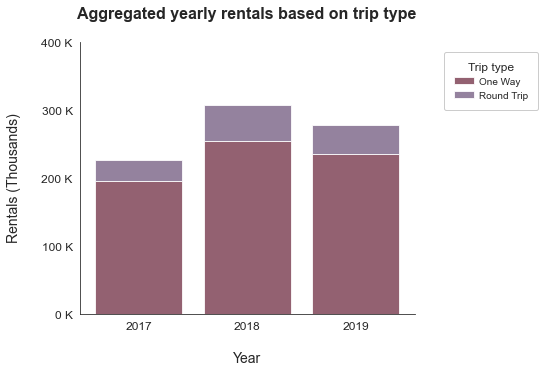

In [656]:
sb.set_style('white')
flatui = ["#80324a", "#7b5f8a"]
sb.set_palette(flatui, desat = 0.8)
base_color = sb.color_palette()[0]
plt.figure(figsize = [6, 5])

cat1_order = bikeshare.year.sort_values(ascending=True).unique()
cat2_order = bikeshare.trip_type.sort_values(ascending=True).unique()

# plot stacked plot
baselines = np.zeros(len(cat1_order))
# for each second-variable category:
for i in range(len(cat2_order)):
    # isolate the counts of the first category,
    cat2 = cat2_order[i]
    inner_counts = bikeshare[bikeshare['trip_type'] == cat2]['year'].value_counts()
    # then plot those counts on top of the accumulated baseline
    plt.bar(x = np.arange(len(cat1_order)), height = inner_counts[cat1_order].fillna(0),
            bottom = baselines, alpha =0.8)
    baselines += inner_counts[cat1_order].fillna(0)

# improve plot aesthetics
max_count = bikeshare.groupby([bikeshare['year']]).size().reset_index(name='rentals').max()['rentals']
y_tick_values = np.arange(0, max_count + 100000, 100000)
y_tick_names = ['{:0.0f} K'.format(v/1000) for v in y_tick_values]

plt.title('Aggregated yearly rentals based on trip type\n', weight = 'bold', fontsize = 16)
plt.xticks(np.arange(len(cat1_order)), cat1_order, fontsize=12)
plt.yticks(y_tick_values, y_tick_names, fontsize=12)
plt.xlabel('\nYear', fontsize=14)
plt.ylabel('Rentals (Thousands)\n', fontsize=14)
plt.legend(cat2_order, scatterpoints=1, frameon=True, fancybox=True, shadow=False, ncol = 1, 
           framealpha = 1, borderpad=1, borderaxespad=1, loc = 'upper right', labelspacing=0.5,  
           title='Trip type', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(1.4, 1))

sb.despine();

# savefig by passing (bbox_inches='tight'),which will adjust dhe figure to include all of the x and y labels
plt.savefig('plots/3.2.51.a Stack plot of Trip rentals based on trip type and the year.png', dpi=300, bbox_inches='tight')

**`Line Plot:`**

> The data needs some summirization by grouping together the respective variables. Then, reset the index and name the summerized data values accordingly.

In [657]:
categorical_counts = bikeshare.groupby([bikeshare['trip_type'], 
                                        bikeshare['year']]).size().reset_index(name='rentals')
categorical_counts.head(10)

,trip_type,year,rentals
0,One Way,2017,195799
1,One Way,2018,253699
2,One Way,2019,234769
3,Round Trip,2017,29532
4,Round Trip,2018,52668
5,Round Trip,2019,42122


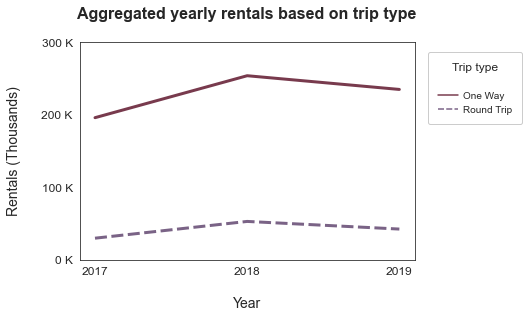

In [658]:
# set the palette as per requirement
flatui = ["#80324a", "#7b5f8a"]
sb.set_palette(flatui, desat = 0.8)
base_color = sb.color_palette()[0]
sb.set_style('white')

plt.figure(figsize = [6, 4])
max_count = categorical_counts.rentals.max()
y_tick_values = np.arange(0, max_count + 100000, 100000)
y_tick_names = ['{:0.0f} K'.format(v/1000) for v in y_tick_values]

# plot line plot
ax = sb.lineplot(data=categorical_counts, x = "year", y = "rentals", hue="trip_type", 
                 style="trip_type", err_style="bars", linewidth=3)
plt.title('Aggregated yearly rentals based on trip type\n', weight = 'bold', fontsize = 16)
plt.yticks(y_tick_values, y_tick_names, fontsize=12)
plt.xlabel('\nYear', fontsize=14)
plt.ylabel('Rentals (Thousands)\n', fontsize=14)

# set custom xticks to avoid segmentation of continuous values of year (['2017.25', '2017.50', '2017.75, ....'])
# get alloted xticks, if decimal part equals to 0, set it as xtick value else skip the xtick value
xlabels = ['{:.0f}'.format(x) if divmod(x, 1)[1] == 0 else "" for x in ax.get_xticks()]
ax.set_xticklabels(xlabels)
plt.xticks(fontsize=12)

# when a hue is used that appears as a legend title,
# remove this title, and replace it with custom title.
ax.legend(scatterpoints=1, frameon=True, fancybox=True, shadow=False, ncol = 1, framealpha = 1, 
          borderpad=1, borderaxespad=1, loc = 'upper right', labelspacing=0.5,  
          title='Trip type', title_fontsize=12, fontsize=10, facecolor='white', markerfirst=True, 
          handlelength=2, handletextpad=0.5, bbox_to_anchor=(1.35, 1)).texts[0].set_text("");

# savefig by passing (bbox_inches='tight'),which will adjust dhe figure to include all of the x and y labels
plt.savefig('plots/3.2.51.b Line plot of Trip rentals based on trip type and the year.png', dpi=300, bbox_inches='tight')

**`Individual plots of aggregated distribution of yearly rentals over trip type:`**

<Figure size 576x288 with 0 Axes>

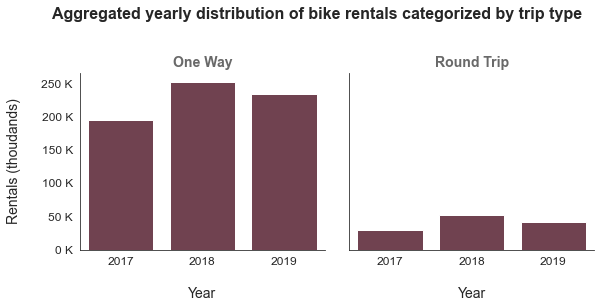

In [659]:
# set the palette as per requirement
flatui = ["#80324a", "#7b5f8a"]
sb.set_palette(flatui, desat = 0.8)
base_color = sb.color_palette()[0]
sb.set_style('white')
plt.figure(figsize = [8, 4])

# plot facet grid
g = sb.FacetGrid(data = bikeshare, col = 'trip_type', col_wrap = 2, height = 4, aspect = 1)
g.map(sb.countplot, "year", color = base_color, order = bikeshare.year.sort_values(ascending=True).unique())
g.fig.subplots_adjust(top=0.75)
g.fig.suptitle('Aggregated yearly distribution of bike rentals categorized by trip type\n', fontsize = 16, weight = 'bold')
g.set_titles('{col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# obtain y_ticks and convert them to a multiple of millions
# obtain the x_ticks and store them as a list
y_tick_names = []
x_tick_names = []
for ax in g.axes.flat:
    for y_label in ax.get_yticklabels():
        y_label_value = int(y_label.get_text())
        y_label_new_value = '{:0.0f} K'.format(y_label_value/1000)
        y_tick_names.append(y_label_new_value)
        
    for x_label in ax.get_xticklabels():
        x_label_value = x_label.get_text()
        x_tick_names.append(x_label_value)

g.set_yticklabels(y_tick_names, size = 12)
g.set_xticklabels(x_tick_names, size = 12)
g.set_xlabels('\nYear', size = 14)
g.set_ylabels('Rentals (thoudands)\n', size = 14)

plt.subplots_adjust(wspace=0.1, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust dhe figure to include all of the x and y labels
plt.savefig('plots/3.2.51.c Facet grid of Trip rentals based on trip type and the year.png', dpi=300, bbox_inches='tight')

> Let us plot more variety of graphs to observe the distribution of data and hidden insights.

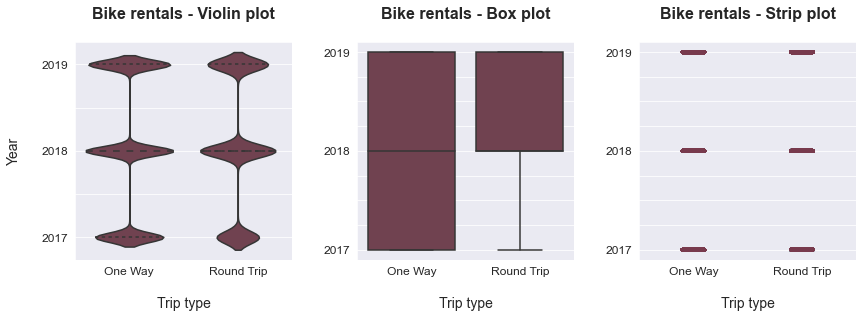

In [660]:
plt.figure(figsize = [14, 4])
sb.set_style('darkgrid')

# set the palette as per requirement
flatui = ["#80324a", "#7b5f8a"]
sb.set_palette(flatui, desat = 0.8)
base_color = sb.color_palette()[0]

# left plot: violin plot
plt.subplot(1, 3, 1)
ax1 = sb.violinplot(data = bikeshare, x = 'trip_type', y = 'year', inner = 'quartile',
              color = base_color)
plt.title('Bike rentals - Violin plot\n',  weight = 'bold', fontsize = 16)
plt.xlabel('\nTrip type', fontsize = 14)
plt.ylabel('Year\n', fontsize = 14)
plt.xticks(fontsize = 12)
# set custom yticks to avoid segmentation of continuous values of year (['2017.25', '2017.50', '2017.75, ....'])
# get alloted yticks, if decimal part equals to 0, set it as ytick value else skip the ytick value
ylabels = ['{:.0f}'.format(y) if divmod(y, 1)[1] == 0 else "" for y in ax1.get_yticks()]
ax1.set_yticklabels(ylabels)
plt.yticks(fontsize = 12)

# center plot: box plot
plt.subplot(1, 3, 2)
ax2 = sb.boxplot(data = bikeshare, x = 'trip_type', y = 'year', color = base_color)
plt.title('Bike rentals - Box plot\n',  weight = 'bold', fontsize = 16)
plt.xlabel('\nTrip type', fontsize = 14)
plt.ylabel('', fontsize = 14)
plt.xticks(fontsize = 12)
# set custom yticks to avoid segmentation of continuous values of year (['2017.25', '2017.50', '2017.75, ....'])
# get alloted yticks, if decimal part equals to 0, set it as ytick value else skip the ytick value
ylabels = ['{:.0f}'.format(y) if divmod(y, 1)[1] == 0 else "" for y in ax2.get_yticks()]
ax2.set_yticklabels(ylabels)
plt.yticks(fontsize = 12)

# right plot: strip chart
plt.subplot(1, 3, 3)
ax3 = sb.stripplot(data = bikeshare, x = "trip_type", y = "year", alpha = 0.002, color = base_color)
plt.title('Bike rentals - Strip plot\n',  weight = 'bold', fontsize = 16)
plt.xlabel('\nTrip type', fontsize = 14)
plt.ylabel('', fontsize = 14);
plt.xticks(fontsize = 12)
# set custom yticks to avoid segmentation of continuous values of year (['2017.25', '2017.50', '2017.75, ....'])
# get alloted yticks, if decimal part equals to 0, set it as ytick value else skip the ytick value
ylabels = ['{:.0f}'.format(y) if divmod(y, 1)[1] == 0 else "" for y in ax3.get_yticks()]
ax3.set_yticklabels(ylabels)
plt.yticks(fontsize = 12)

plt.subplots_adjust(wspace=0.3, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust dhe figure to include all of the x and y labels
plt.savefig('plots/3.2.51.d Distribution of Trip rentals based on trip type and the year.png', dpi=300, bbox_inches='tight')

**`Heat Map:`**

One alternative way of depicting the relationship between two categorical variables is through a **Heat map**. Heat maps were introduced earlier as the 2-d version of a histogram; here, we're using them as the 2-d version of a bar chart. The seaborn function `heatmap` is at home with this type of heat map implementation, but the input arguments are unlike most of the visualization functions. Instead of providing the original dataframe, we need to summarize the counts into a matrix that will then be plotted.

> Now lets make a pivot from the categorical dataset created earlier into a more appropriate data structure.

In [661]:
categorical_counts = categorical_counts.pivot(index = 'trip_type', columns = 'year', values = 'rentals')
categorical_counts

year,2017,2018,2019
trip_type,,,
One Way,195799,253699,234769
Round Trip,29532,52668,42122


> The data is ready to be plotred as the `Heat map`.

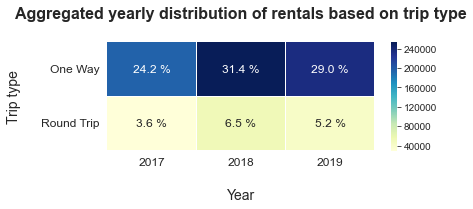

In [662]:
# plot heat map
plt.figure(figsize = [6, 2])
res = sb.heatmap(categorical_counts, annot = True, fmt = '.0f', annot_kws={'size':12}, linewidths=0.1, cmap="YlGnBu")
plt.yticks(rotation=0, fontsize="12", va="center")
plt.xticks(fontsize="12")
plt.title('Aggregated yearly distribution of rentals based on trip type\n', fontsize = 16, weight = 'bold')
plt.xlabel('\nYear', fontsize=14)
plt.ylabel('Trip type\n', fontsize=14);

# convert annotations to percentages
for t in res.texts: 
    p = np.round(np.round(int(t.get_text())/bikeshare.shape[0], 4)*100, 1)
    t.set_text(str(p)+' %')
               
# savefig by passing (bbox_inches='tight'),which will adjust dhe figure to include all of the x and y labels
plt.savefig('plots/3.2.51.e Heat map of Trip rentals based on trip type and the year.png', dpi=300, bbox_inches='tight')

**`Find average rentals based on the year:`**

> The `trip_type` needs to be converted into categorical datatype, otherwise the `groupby` method will ignore `NaN` rental values and inturn produce **incorrect** `avg. rental value`. Also use of `size()` method ignores the unused level combinations of the groups, hence use `count()` method.

In [663]:
year_df = bikeshare.groupby([bikeshare["year"],
                             bikeshare["trip_type"]]).count()['trip_id'].reset_index(name='rentals')

year_df['rentals'] = year_df['rentals'].fillna(0).astype(int)
year_df.head(10)

,year,trip_type,rentals
0,2017,One Way,195799
1,2017,Round Trip,29532
2,2018,One Way,253699
3,2018,Round Trip,52668
4,2019,One Way,234769
5,2019,Round Trip,42122


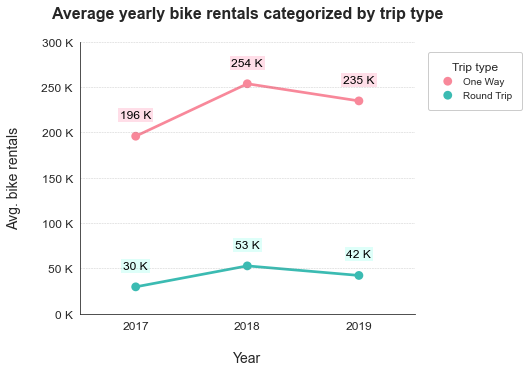

In [664]:
plt.figure(figsize=[6, 5])
sb.set_style('white')
flatui = ["#fff480"]
sb.set_palette(flatui, n_colors=1, desat=0.8)
base_color = sb.color_palette()[0]

sb.pointplot(data = year_df, x = "year", y = "rentals", linestyles = ['-', '-'], hue = 'trip_type', ci = None)
plt.title('Average yearly bike rentals categorized by trip type\n',  weight = 'bold', fontsize = 16)
plt.ylabel('Avg. bike rentals\n', fontsize = 14)
plt.xlabel('\nYear', fontsize = 14)
plt.xticks(fontsize = 12)

# get ytick locs and rearrage them with respect to zero
locs, labels = plt.yticks()
yearly_rental_avg_max = 300000
y_tick_values = np.arange(0, yearly_rental_avg_max+50000, 50000)
y_tick_names = ['{:0.0f} K'.format(v/1000) for v in y_tick_values]
plt.yticks(y_tick_values, y_tick_names, fontsize = 12)

# add annotations
# -------------------------------------------------------
avg_rentals = year_df.groupby([year_df["trip_type"], year_df["year"]]).mean()['rentals'].reset_index()
avg_rentals_max = avg_rentals.rentals.max()
avg_rentals_base = avg_rentals.query(' trip_type == "One Way" ')
avg_rentals_extended = avg_rentals.query(' trip_type == "Round Trip" ')

# get the current tick locations and labels
locs, labels = plt.xticks()

for categorical_df in [avg_rentals_base, avg_rentals_extended]:
    clrs = ['#ff5e8c' if fare == "One Way" else '#5effe4' for fare in categorical_df.trip_type ]
    # loop through each pair of locations and labels
    for loc, label, avg_rental_count, clr in zip(locs, labels, categorical_df.rentals, clrs):
        try:
            count = avg_rental_count
        except KeyError:
            count = 0   
        pct_string = '{:0.0f} K'.format(count/1000)
        indent = 20000
        # print the annotation depending on the bar length
        plt.text(loc, count + indent, pct_string, ha = 'center', color = 'black', 
                 fontsize = 12, bbox=dict(pad=1.9,alpha=0.2,color='none',fc=clr))
# -------------------------------------------------------

plt.legend(scatterpoints=1, frameon=True, fancybox=True, shadow=False, ncol = 1, 
           framealpha = 1, borderpad=1, borderaxespad=1, loc = 'upper right', labelspacing=0.5,  
           title='Trip type', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(1.35, 1))

sb.despine(top=True, right=True, left=False, bottom=False);

for loc in y_tick_values:
    plt.axhline(loc, ls='--', color='grey', linewidth=0.5, alpha=0.4)

# savefig by passing (bbox_inches='tight'),which will adjust dhe figure to include all of the x and y labels
plt.savefig('plots/3.2.51.f Average yearly bike rentals categorized by trip type.png', dpi=300, bbox_inches='tight')

------------

#### 3.2.52 Bivariate analysis of `bikeshare.year` and `bike_type` columns:

+ `Columns`: year, bike_type
+ `Data type`: (Categorical, ordered) and (Categorical, nominal)
+ `Plot`: Facet Grid, Violin plot, Box plot, Adapted Barchart

**`Stack plot:`**

C:\Users\VAMSHI-KRISHNA-PRIME\Anaconda3\lib\site-packages\pandas\core\series.py:1143: FutureWarning: 
Passing list-likes to .loc or [] with any missing label will raise
KeyError in the future, you can use .reindex() as an alternative.

See the documentation here:
https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#deprecate-loc-reindex-listlike
  return self.loc[key]


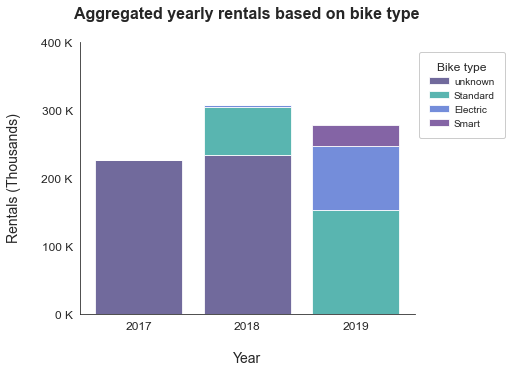

In [665]:
# Assign palette as per requirement
sb.set_style('white')
flatui = ["darkslateblue", "lightseagreen", "royalblue", "rebeccapurple"]
sb.set_palette(flatui, desat = 0.8)
plt.figure(figsize = [6, 5])

cat1_order = bikeshare.year.sort_values(ascending=True).unique()
cat2_order = bikeshare.bike_type.sort_values(ascending=True).unique()

# plot stacked plot
baselines = np.zeros(len(cat1_order))
# for each second-variable category:
for i in range(len(cat2_order)):
    # isolate the counts of the first category,
    cat2 = cat2_order[i]
    inner_counts = bikeshare[bikeshare['bike_type'] == cat2]['year'].value_counts()
    # then plot those counts on top of the accumulated baseline
    plt.bar(x = np.arange(len(cat1_order)), height = inner_counts[cat1_order].fillna(0),
            bottom = baselines, alpha = 0.8)
    baselines += inner_counts[cat1_order].fillna(0)

# improve plot aesthetics
max_count = bikeshare.groupby([bikeshare['year']]).size().reset_index(name='rentals').max()['rentals']
y_tick_values = np.arange(0, max_count + 100000, 100000)
y_tick_names = ['{:0.0f} K'.format(v/1000) for v in y_tick_values]

plt.title('Aggregated yearly rentals based on bike type\n', weight = 'bold', fontsize = 16)
plt.xticks(np.arange(len(cat1_order)), cat1_order, fontsize=12)
plt.yticks(y_tick_values, y_tick_names, fontsize=12)
plt.xlabel('\nYear', fontsize=14)
plt.ylabel('Rentals (Thousands)\n', fontsize=14)
plt.legend(cat2_order, scatterpoints=1, frameon=True, fancybox=True, shadow=False, ncol = 1, 
           framealpha = 1, borderpad=1, borderaxespad=1, loc = 'upper right', labelspacing=0.5,  
           title='Bike type', title_fontsize=12, fontsize=10, facecolor='white',
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(1.3, 1))

sb.despine();

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.52.a Stack plot of rentals based on bike type and the year.png', dpi=300, bbox_inches='tight')

**`Line plot:`**

> The data needs some summirization by grouping together the respective variables. Then, reset the index and name the summerized data values accordingly.

In [666]:
categorical_counts = bikeshare.groupby([bikeshare['bike_type'], 
                                        bikeshare['year']]).size().reset_index(name='rentals')
categorical_counts.head(10)

,bike_type,year,rentals
0,unknown,2017,225331
1,unknown,2018,233604
2,Standard,2018,70354
3,Standard,2019,151789
4,Electric,2018,2409
5,Electric,2019,95120
6,Smart,2019,29982


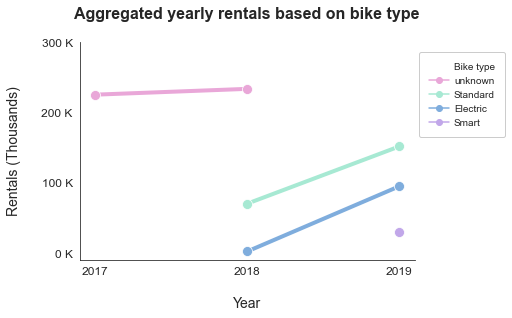

In [667]:
# set the palette as per requirement
sb.set_style('white')
flatui = ['#ff91e2', '#91ffda', '#60acfc', '#bd91ff']
sb.set_palette(flatui, n_colors=4, desat=0.6)

plt.figure(figsize = [6, 4])
max_count = categorical_counts.rentals.max()
y_tick_values = np.arange(0, max_count + 100000, 100000)
y_tick_names = ['{:0.0f} K'.format(v/1000) for v in y_tick_values]

# plot line plot
ax = sb.lineplot(data = categorical_counts, x = "year", y = "rentals", hue="bike_type", linewidth=4, 
                 style="bike_type", err_style="bars", markers = ['o', 'o', 'o', 'o'], markersize=10)
ax.lines[0].set_linestyle("-")
ax.lines[1].set_linestyle("-")
ax.lines[2].set_linestyle("-")
ax.lines[3].set_linestyle("-")

plt.title('Aggregated yearly rentals based on bike type\n', weight = 'bold', fontsize = 16)
plt.yticks(y_tick_values, y_tick_names, fontsize=12)
plt.xlabel('\nYear', fontsize=14)
plt.ylabel('Rentals (Thousands)\n', fontsize=14)

# set custom xticks to avoid segmentation of continuous values of year (['2017.25', '2017.50', '2017.75, ....'])
# get alloted xticks, if decimal part equals to 0, set it as xtick value else skip the xtick value
xlabels = ['{:.0f}'.format(x) if divmod(x, 1)[1] == 0 else "" for x in ax.get_xticks()]
ax.set_xticklabels(xlabels)
plt.xticks(fontsize=12)

# customize legend
leg = ax.legend(scatterpoints=1, frameon=True, fancybox=True, shadow=False, ncol = 1, framealpha = 1, 
          borderpad=1, borderaxespad=1, loc = 'upper right', labelspacing=0.5,  
          title='', title_fontsize=12, fontsize=10, facecolor='white', markerfirst=True, 
          handlelength=2, handletextpad=0.5, bbox_to_anchor=(1.3, 1))

leg_lines = leg.get_lines()
leg_lines[1].set_linestyle("-")
leg_lines[2].set_linestyle("-")
leg_lines[3].set_linestyle("-")
leg_lines[4].set_linestyle("-")
leg.texts[0].set_text("Bike type")

sb.despine();

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.52.b Line plot of rentals based on bike type and the year.png', dpi=300, bbox_inches='tight')

**`Individual plots of aggregated distribution of yearly rentals over bike type:`**

<Figure size 576x288 with 0 Axes>

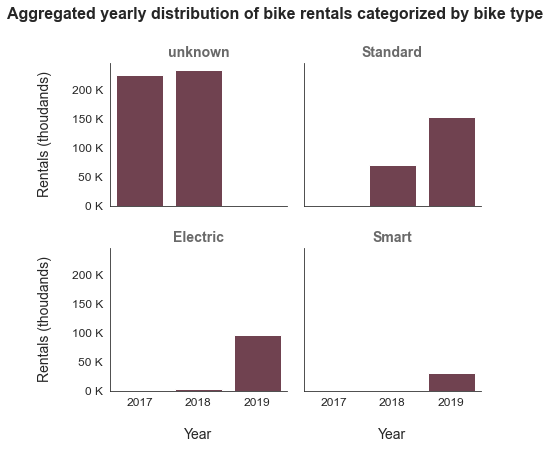

In [668]:
# set the palette as per requirement
flatui = ["#80324a", "#7b5f8a"]
sb.set_palette(flatui, desat = 0.8)
base_color = sb.color_palette()[0]
sb.set_style('white')
plt.figure(figsize = [8, 4])

# plot facet grid
g = sb.FacetGrid(data = bikeshare, col = 'bike_type', col_wrap = 2, height = 3, aspect = 1)
g.map(sb.countplot, "year", color = base_color, order = bikeshare.year.sort_values(ascending=True).unique())
g.fig.subplots_adjust(top=0.85)
g.fig.suptitle('Aggregated yearly distribution of bike rentals categorized by bike type\n', fontsize = 16, weight = 'bold')
g.set_titles('{col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# obtain y_ticks and convert them to a multiple of millions
# obtain the x_ticks and store them as a list
y_tick_names = []
x_tick_names = []
for ax in g.axes.flat:
    for y_label in ax.get_yticklabels():
        y_label_value = int(y_label.get_text())
        y_label_new_value = '{:0.0f} K'.format(y_label_value/1000)
        y_tick_names.append(y_label_new_value)
        
    for x_label in ax.get_xticklabels():
        x_label_value = x_label.get_text()
        x_tick_names.append(x_label_value)

g.set_yticklabels(y_tick_names, size = 12)
g.set_xticklabels(x_tick_names, size = 12)
g.set_xlabels('\nYear', size = 14)
g.set_ylabels('Rentals (thoudands)\n', size = 14)

plt.subplots_adjust(wspace=0.1, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.52.c Facet grid of rentals based on bike type and the year.png', dpi=300, bbox_inches='tight')

> Let us plot more variety of graphs to observe the distribution of data and hidden insights.

**`Heat Map:`**

> Now lets make a pivot from the categorical dataset created earlier into a more appropriate data structure.

In [669]:
categorical_counts = categorical_counts.pivot(index = 'bike_type', columns = 'year', values = 'rentals')
categorical_counts

year,2017,2018,2019
bike_type,,,
unknown,225331.0,233604.0,NaN
Standard,NaN,70354.0,151789.0
Electric,NaN,2409.0,95120.0
Smart,NaN,NaN,29982.0


> The data is ready to be plotred as the `Heat map`.

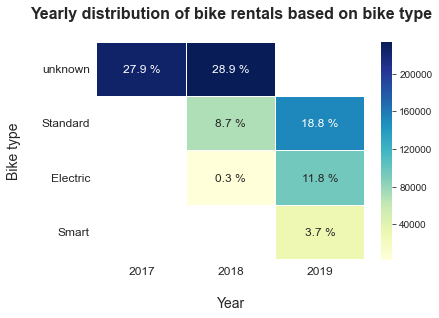

In [670]:
# plot heat map
plt.figure(figsize = [6, 4])
res = sb.heatmap(categorical_counts, annot = True, fmt = '.0f', annot_kws={'size':12}, linewidths=0.1, cmap="YlGnBu")
plt.yticks(rotation=0, fontsize="12", va="center")
plt.xticks(fontsize="12")
plt.title('Yearly distribution of bike rentals based on bike type\n', fontsize = 16, weight = 'bold')
plt.xlabel('\nYear', fontsize=14)
plt.ylabel('Bike type\n', fontsize=14);

# convert annotations to percentages
for t in res.texts: 
    p = np.round(np.round(int(t.get_text())/bikeshare.shape[0], 4)*100, 1)
    t.set_text(str(p)+' %')
    
# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.52.d Heat map of rentals based on bike type and the year.png', dpi=300, bbox_inches='tight')

**`Find average rentals based on the year:`**

> The `bike_type` needs to be converted into categorical datatype, otherwise the `groupby` method will ignore `NaN` rental values and inturn produce **incorrect** `avg. rental value`. Also use of `size()` method ignores the unused level combinations of the groups, hence use `count()` method.

In [671]:
year_df = bikeshare.groupby([bikeshare["year"],
                             bikeshare["bike_type"]]).count()['trip_id'].reset_index(name='rentals')

year_df.head(10)

,year,bike_type,rentals
0,2017,unknown,225331.0
1,2017,Standard,NaN
2,2017,Electric,NaN
3,2017,Smart,NaN
4,2018,unknown,233604.0
5,2018,Standard,70354.0
6,2018,Electric,2409.0
7,2018,Smart,NaN
8,2019,unknown,NaN
9,2019,Standard,151789.0


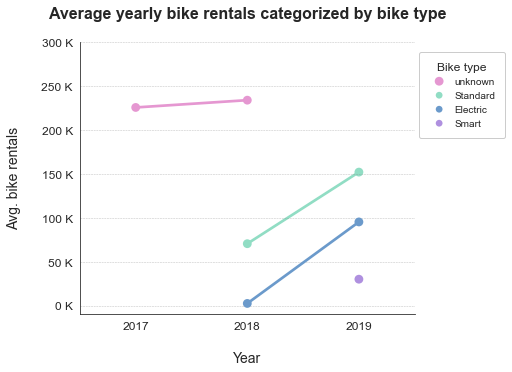

In [672]:
plt.figure(figsize=[6,5])
sb.set_style('white')
# flatui = ['#ff91e2', '#91ffda', '#60acfc', '#bd91ff']
flatui = ['#ff7ddd', '#77f7cc', '#4b99eb', '#aa75fa']
sb.set_palette(flatui, n_colors=4, desat=0.6)
base_color = sb.color_palette()[0]

sb.pointplot(data = year_df, x = "year", y = "rentals", linestyles = "-", hue = 'bike_type', 
             scale = 1, ci = None)
plt.title('Average yearly bike rentals categorized by bike type\n',  weight = 'bold', fontsize = 16)
plt.ylabel('Avg. bike rentals\n', fontsize = 14)
plt.xlabel('\nYear', fontsize = 14)
plt.xticks(fontsize = 12)

# get ytick locs and rearrage them with respect to zero
locs, labels = plt.yticks()
yearly_rental_avg_max = 300000
y_tick_values = np.arange(0, yearly_rental_avg_max+50000, 50000)
y_tick_names = ['{:0.0f} K'.format(v/1000) for v in y_tick_values]
plt.yticks(y_tick_values, y_tick_names, fontsize = 12)

plt.legend(scatterpoints=1, frameon=True, fancybox=True, shadow=False, ncol = 1, 
           framealpha = 1, borderpad=1, borderaxespad=1, loc = 'upper right', labelspacing=0.5,  
           title='Bike type', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(1.3, 1))

sb.despine(top=True, right=True, left=False, bottom=False);

for loc in y_tick_values:
    plt.axhline(loc, ls='--', color='grey', linewidth=0.5, alpha=0.5)

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.52.e Average yearly bike rentals categorized by bike type.png', dpi=300, bbox_inches='tight')

------

#### 3.2.53 Bivariate analysis of `bikeshare.year` and `pass_type` columns:

+ `Columns`: year, pass_type
+ `Data type`: (Categorical, ordered) and (Categorical, nominal)
+ `Plot`: Facet Grid, Violin plot, Box plot, Adapted Barchart

**`Stack plot:`**

C:\Users\VAMSHI-KRISHNA-PRIME\Anaconda3\lib\site-packages\pandas\core\series.py:1143: FutureWarning: 
Passing list-likes to .loc or [] with any missing label will raise
KeyError in the future, you can use .reindex() as an alternative.

See the documentation here:
https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#deprecate-loc-reindex-listlike
  return self.loc[key]


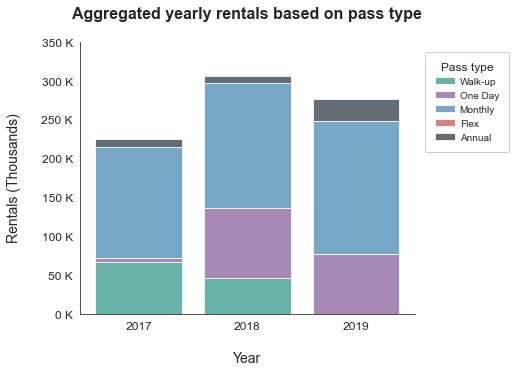

In [673]:
# Assign palette as per requirement
sb.set_style('white')
plt.figure(figsize = [6, 5])
flatui = ["#26bda7", "#9b59b6", "#3498db", "#e74c3c", "#34495e"]
sb.set_palette(flatui, n_colors=5, desat=0.6)

cat1_order = bikeshare.year.sort_values(ascending=True).unique()
cat2_order = bikeshare.pass_type.sort_values(ascending=True).unique()

# plot stacked plot
baselines = np.zeros(len(cat1_order))
# for each second-variable category:
for i in range(len(cat2_order)):
    # isolate the counts of the first category,
    cat2 = cat2_order[i]
    inner_counts = bikeshare[bikeshare['pass_type'] == cat2]['year'].value_counts()
    # then plot those counts on top of the accumulated baseline
    plt.bar(x = np.arange(len(cat1_order)), height = inner_counts[cat1_order].fillna(0),
            bottom = baselines, alpha = 0.8)
    baselines += inner_counts[cat1_order].fillna(0)

# improve plot aesthetics
max_count = bikeshare.groupby([bikeshare['year']]).size().reset_index(name='rentals').max()['rentals']
y_tick_values = np.arange(0, max_count + 50000, 50000)
y_tick_names = ['{:0.0f} K'.format(v/1000) for v in y_tick_values]

plt.title('Aggregated yearly rentals based on pass type\n', weight = 'bold', fontsize = 16)
plt.xticks(np.arange(len(cat1_order)), cat1_order, fontsize=12)
plt.yticks(y_tick_values, y_tick_names, fontsize=12)
plt.xlabel('\nYear', fontsize=14)
plt.ylabel('Rentals (Thousands)\n', fontsize=14)
plt.legend(cat2_order, scatterpoints=1, frameon=True, fancybox=True, shadow=False, ncol = 1, 
           framealpha = 1, borderpad=1, borderaxespad=1, loc = 'upper left', labelspacing=0.5,  
           title='Pass type', title_fontsize=12, fontsize=10, facecolor='white',
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(1, 1))

sb.despine();

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.53.a Stack plot of rentals based on pass type and the year.png', dpi=300, bbox_inches='tight')

**`Line plot:`**

> The data needs some summirization by grouping together the respective variables. Then, reset the index and name the summerized data values accordingly.

In [674]:
categorical_counts = bikeshare.groupby([bikeshare['pass_type'], 
                                        bikeshare['year']]).size().reset_index(name='rentals')
categorical_counts.head(10)

,pass_type,year,rentals
0,Walk-up,2017,65938
1,Walk-up,2018,46140
2,One Day,2017,5412
3,One Day,2018,89595
4,One Day,2019,76185
5,Monthly,2017,143044
6,Monthly,2018,161060
7,Monthly,2019,171562
8,Flex,2018,263
9,Annual,2017,10937


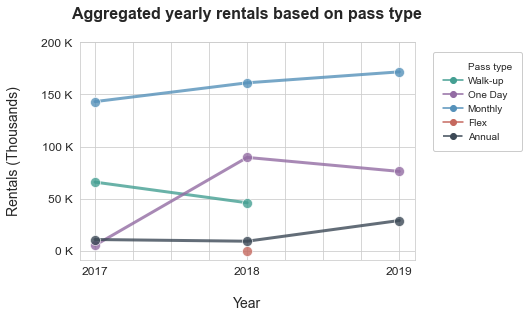

In [675]:
# set the palette as per requirement
sb.set_style('whitegrid')
flatui = ["#26bda7", "#9b59b6", "#3498db", "#e74c3c", "#34495e"]
sb.set_palette(flatui, n_colors=5, desat=0.6)

plt.figure(figsize = [6, 4])
max_count = categorical_counts.rentals.max()
y_tick_values = np.arange(0, max_count + 50000, 50000)
y_tick_names = ['{:0.0f} K'.format(v/1000) for v in y_tick_values]

# plot line plot
ax = sb.lineplot(data=categorical_counts, x = "year", y = "rentals", hue="pass_type", linewidth=3, alpha = 0.8, 
                 style="pass_type", err_style="bars", markers = ['o', 'o', 'o', 'o', 'o'], markersize=10)
ax.lines[0].set_linestyle("-")
ax.lines[1].set_linestyle("-")
ax.lines[2].set_linestyle("-")
ax.lines[3].set_linestyle("-")
ax.lines[4].set_linestyle("-")

plt.title('Aggregated yearly rentals based on pass type\n', weight = 'bold', fontsize = 16)
plt.yticks(y_tick_values, y_tick_names, fontsize=12)
plt.xlabel('\nYear', fontsize=14)
plt.ylabel('Rentals (Thousands)\n', fontsize=14)
# set custom xticks to avoid segmentation of continuous values of year (['2017.25', '2017.50', '2017.75, ....'])
# get alloted xticks, if decimal part equals to 0, set it as xtick value else skip the xtick value
xlabels = ['{:.0f}'.format(x) if divmod(x, 1)[1] == 0 else "" for x in ax.get_xticks()]
ax.set_xticklabels(xlabels)
plt.xticks(fontsize=12)

# customize legend
leg = ax.legend(scatterpoints=1, frameon=True, fancybox=True, shadow=False, ncol = 1, framealpha = 1, 
          borderpad=1, borderaxespad=1, loc = 'upper right', labelspacing=0.5,  
          title='', title_fontsize=12, fontsize=10, facecolor='white', markerfirst=True, 
          handlelength=2, handletextpad=0.5, bbox_to_anchor=(1.35, 1))

leg_lines = leg.get_lines()
leg_lines[1].set_linestyle("-")
leg_lines[2].set_linestyle("-")
leg_lines[3].set_linestyle("-")
leg_lines[4].set_linestyle("-")
leg.texts[0].set_text("Pass type");

# sb.despine();

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.53.b Line plot of rentals based on pass type and the year.png', dpi=300, bbox_inches='tight')

**`Individual plots of aggregated distribution of yearly rentals over bike type:`**

<Figure size 1296x288 with 0 Axes>

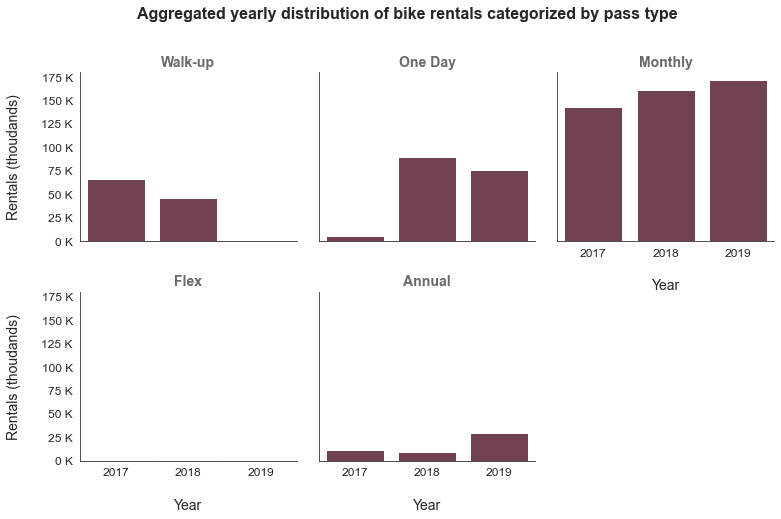

In [676]:
# set the palette as per requirement
flatui = ["#80324a", "#7b5f8a"]
sb.set_palette(flatui, desat = 0.8)
base_color = sb.color_palette()[0]
sb.set_style('white')
plt.figure(figsize = [18, 4])

# plot facet grid
g = sb.FacetGrid(data = bikeshare, col = 'pass_type', col_wrap = 3, height = 3.5, aspect = 1)
g.map(sb.countplot, "year", color = base_color, order = bikeshare.year.sort_values(ascending=True).unique())
g.fig.subplots_adjust(top=0.85)
g.fig.suptitle('Aggregated yearly distribution of bike rentals categorized by pass type\n', fontsize = 16, weight = 'bold')
g.set_titles('{col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# obtain y_ticks and convert them to a multiple of millions
# obtain the x_ticks and store them as a list
y_tick_names = []
x_tick_names = []
for ax in g.axes.flat:
    for y_label in ax.get_yticklabels():
        y_label_value = int(y_label.get_text())
        y_label_new_value = '{:0.0f} K'.format(y_label_value/1000)
        y_tick_names.append(y_label_new_value)
        
    for x_label in ax.get_xticklabels():
        x_label_value = x_label.get_text()
        x_tick_names.append(x_label_value)

g.set_yticklabels(y_tick_names, size = 12)
g.set_xticklabels(x_tick_names, size = 12)
g.set_xlabels('\nYear', size = 14)
g.set_ylabels('Rentals (thoudands)\n', size = 14)

plt.subplots_adjust(wspace=0.1, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.53.c Facet grid of rentals based on pass type and the year.png', dpi=300, bbox_inches='tight')

> Let us plot more variety of graphs to observe the distribution of data and hidden insights.

**`Heat Map:`**

> Now lets make a pivot from the categorical dataset created earlier into a more appropriate data structure.

In [677]:
categorical_counts = categorical_counts.pivot(index = 'pass_type', columns = 'year', values = 'rentals')
categorical_counts

year,2017,2018,2019
pass_type,,,
Walk-up,65938.0,46140.0,NaN
One Day,5412.0,89595.0,76185.0
Monthly,143044.0,161060.0,171562.0
Flex,NaN,263.0,NaN
Annual,10937.0,9309.0,29144.0


> The data is ready to be plotred as the `Heat map`.

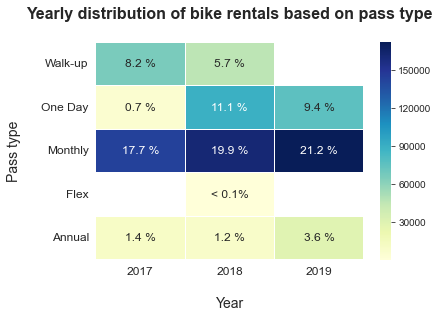

In [678]:
# plot heat map
plt.figure(figsize = [6, 4])
res = sb.heatmap(categorical_counts, annot = True, fmt = '.0f', annot_kws={'size':12}, linewidths=0.1, cmap="YlGnBu")
plt.yticks(rotation=0, fontsize="12", va="center")
plt.xticks(fontsize="12")
plt.title('Yearly distribution of bike rentals based on pass type\n', fontsize = 16, weight = 'bold')
plt.xlabel('\nYear', fontsize=14)
plt.ylabel('Pass type\n', fontsize=14);

# convert annotations to percentages
for t in res.texts: 
    p = np.round(np.round(int(t.get_text())/bikeshare.shape[0], 4)*100, 1)
    if p < 0.1:
        t.set_text('< 0.1%')
    else:
        t.set_text(str(p)+' %');  

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.53.d Heat map of rentals based on pass type and the year.png', dpi=300, bbox_inches='tight')

**`Find average rentals based on the year:`**

> The `pass_type` needs to be converted into categorical datatype, otherwise the `groupby` method will ignore `NaN` rental values and inturn produce **incorrect** `avg. rental value`. Also use of `size()` method ignores the unused level combinations of the groups, hence use `count()` method.

In [679]:
year_df = bikeshare.groupby([bikeshare["year"],
                             bikeshare["pass_type"]]).count()['trip_id'].reset_index(name='rentals')

year_df

,year,pass_type,rentals
0,2017,Walk-up,65938.0
1,2017,One Day,5412.0
2,2017,Monthly,143044.0
3,2017,Flex,NaN
4,2017,Annual,10937.0
5,2018,Walk-up,46140.0
6,2018,One Day,89595.0
7,2018,Monthly,161060.0
8,2018,Flex,263.0
9,2018,Annual,9309.0


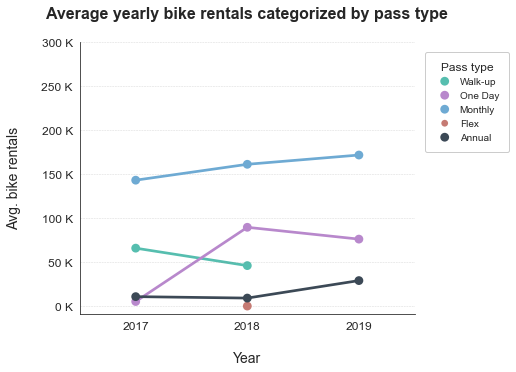

In [680]:
plt.figure(figsize=[6,5])
sb.set_style('white')
# flatui = ["#26bda7", "#9b59b6", "#3498db", "#e74c3c", "#34495e"]
flatui = ["#34e0c7", "#c271e3", "#4cb1f5", "#e06458", "#34495e"]
sb.set_palette(flatui, n_colors=5, desat=0.6)
base_color = sb.color_palette()[0]

sb.pointplot(data = year_df, x = "year", y = "rentals", linestyles = "-", hue = 'pass_type', 
             scale = 1, ci = None)
plt.title('Average yearly bike rentals categorized by pass type\n',  weight = 'bold', fontsize = 16)
plt.ylabel('Avg. bike rentals\n', fontsize = 14)
plt.xlabel('\nYear', fontsize = 14)
plt.xticks(fontsize = 12)

# get ytick locs and rearrage them with respect to zero
locs, labels = plt.yticks()
yearly_rental_avg_max = 300000
y_tick_values = np.arange(0, yearly_rental_avg_max+50000, 50000)
y_tick_names = ['{:0.0f} K'.format(v/1000) for v in y_tick_values]
plt.yticks(y_tick_values, y_tick_names, fontsize = 12)

plt.legend(scatterpoints=1, frameon=True, fancybox=True, shadow=False, ncol = 1, 
           framealpha = 1, borderpad=1, borderaxespad=1, loc = 'upper left', labelspacing=0.5,  
           title='Pass type', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(1, 1))

sb.despine(top=True, right=True, left=False, bottom=False);

for loc in y_tick_values:
    plt.axhline(loc, ls='--', color='grey', linewidth=0.5, alpha=0.3)

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.53.e Average yearly bike rentals categorized by pass type.png', dpi=300, bbox_inches='tight')

---

#### 3.2.54 Bivariate analysis of `bikeshare.year` and `fare_type` columns:

+ `Columns`: year, fare_type
+ `Data type`: (Categorical, ordered) and (Categorical, nominal)
+ `Plot`: Facet Grid, Violin plot, Box plot, Adapted Barchart

**`Stack plot:`**

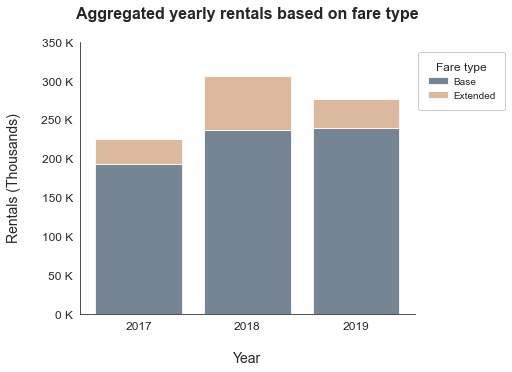

In [681]:
# Assign palette as per requirement
sb.set_style('white')
plt.figure(figsize = [6, 5])
flatui = ['#466887', '#eda668']
sb.set_palette(flatui, n_colors=2, desat=0.6)

cat1_order = bikeshare.year.sort_values(ascending=True).unique()
cat2_order = bikeshare.fare_type.sort_values(ascending=True).unique()

# plot stacked plot
baselines = np.zeros(len(cat1_order))
# for each second-variable category:
for i in range(len(cat2_order)):
    # isolate the counts of the first category,
    cat2 = cat2_order[i]
    inner_counts = bikeshare[bikeshare['fare_type'] == cat2]['year'].value_counts()
    # then plot those counts on top of the accumulated baseline
    plt.bar(x = np.arange(len(cat1_order)), height = inner_counts[cat1_order].fillna(0),
            bottom = baselines, alpha = 0.8)
    baselines += inner_counts[cat1_order].fillna(0)

# improve plot aesthetics
max_count = bikeshare.groupby([bikeshare['year']]).size().reset_index(name='rentals').max()['rentals']
y_tick_values = np.arange(0, max_count + 50000, 50000)
y_tick_names = ['{:0.0f} K'.format(v/1000) for v in y_tick_values]

plt.title('Aggregated yearly rentals based on fare type\n', weight = 'bold', fontsize = 16)
plt.xticks(np.arange(len(cat1_order)), cat1_order, fontsize=12)
plt.yticks(y_tick_values, y_tick_names, fontsize=12)
plt.xlabel('\nYear', fontsize=14)
plt.ylabel('Rentals (Thousands)\n', fontsize=14)
plt.legend(cat2_order, scatterpoints=1, frameon=True, fancybox=True, shadow=False, ncol = 1, 
           framealpha = 1, borderpad=1, borderaxespad=1, loc = 'upper right', labelspacing=0.5,  
           title='Fare type', title_fontsize=12, fontsize=10, facecolor='white',
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(1.3, 1))

sb.despine();

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.54.a Stack plot of rentals based on fare type and the year.png', dpi=300, bbox_inches='tight')

**`Line plot:`**

> The data needs some summirization by grouping together the respective variables. Then, reset the index and name the summerized data values accordingly.

In [682]:
categorical_counts = bikeshare.groupby([bikeshare['fare_type'], 
                                        bikeshare['year']]).size().reset_index(name='rentals')
categorical_counts.head(10)

,fare_type,year,rentals
0,Base,2017,192345
1,Base,2018,236886
2,Base,2019,239558
3,Extended,2017,32986
4,Extended,2018,69481
5,Extended,2019,37333


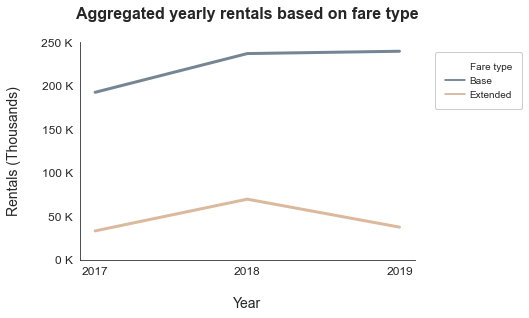

In [683]:
# set the palette as per requirement
sb.set_style('white')
flatui = ['#466887', '#eda668']
sb.set_palette(flatui, n_colors=2, desat=0.6)

plt.figure(figsize = [6, 4])
max_count = categorical_counts.rentals.max()
y_tick_values = np.arange(0, max_count + 50000, 50000)
y_tick_names = ['{:0.0f} K'.format(v/1000) for v in y_tick_values]

# plot line plot
ax = sb.lineplot(data=categorical_counts, x = "year", y = "rentals", hue="fare_type", linewidth=3, alpha = 0.8)
plt.title('Aggregated yearly rentals based on fare type\n', weight = 'bold', fontsize = 16)
plt.yticks(y_tick_values, y_tick_names, fontsize=12)
plt.xlabel('\nYear', fontsize=14)
plt.ylabel('Rentals (Thousands)\n', fontsize=14)
# set custom xticks to avoid segmentation of continuous values of year (['2017.25', '2017.50', '2017.75, ....'])
# get alloted xticks, if decimal part equals to 0, set it as xtick value else skip the xtick value
xlabels = ['{:.0f}'.format(x) if divmod(x, 1)[1] == 0 else "" for x in ax.get_xticks()]
ax.set_xticklabels(xlabels)
plt.xticks(fontsize=12)

# when 'hue' is used, its label appears as legend title
# replace default title with custom title.
ax.legend(scatterpoints=1, frameon=True, fancybox=True, shadow=False, ncol = 1, framealpha = 1, 
          borderpad=1, borderaxespad=1, loc = 'upper right', labelspacing=0.5,  
          title='', title_fontsize=12, fontsize=10, facecolor='white', markerfirst=True, 
          handlelength=2, handletextpad=0.5, bbox_to_anchor=(1.35, 1)).texts[0].set_text("Fare type")

sb.despine();

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.54.b Line plot of rentals based on fare type and the year.png', dpi=300, bbox_inches='tight')

**`Individual plots of aggregated distribution of yearly rentals over bike type:`**

<Figure size 864x288 with 0 Axes>

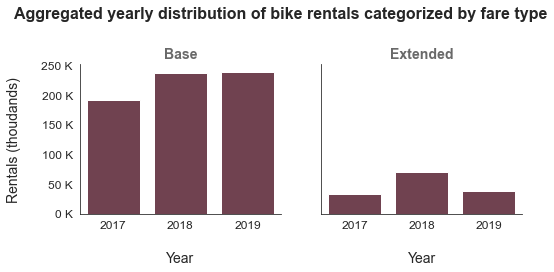

In [684]:
# set the palette as per requirement
flatui = ["#80324a", "#7b5f8a"]
sb.set_palette(flatui, desat = 0.8)
base_color = sb.color_palette()[0]
sb.set_style('white')
plt.figure(figsize = [12, 4])

# plot facet grid
g = sb.FacetGrid(data = bikeshare, col = 'fare_type', col_wrap = 2, height = 3.5, aspect = 1)
g.map(sb.countplot, "year", color = base_color, order = bikeshare.year.sort_values(ascending=True).unique())
g.fig.subplots_adjust(top=0.75)
g.fig.suptitle('Aggregated yearly distribution of bike rentals categorized by fare type\n', fontsize = 16, weight = 'bold')
g.set_titles('{col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# obtain y_ticks and convert them to a multiple of millions
# obtain the x_ticks and store them as a list
y_tick_names = []
x_tick_names = []
for ax in g.axes.flat:
    for y_label in ax.get_yticklabels():
        y_label_value = int(y_label.get_text())
        y_label_new_value = '{:0.0f} K'.format(y_label_value/1000)
        y_tick_names.append(y_label_new_value)
        
    for x_label in ax.get_xticklabels():
        x_label_value = x_label.get_text()
        x_tick_names.append(x_label_value)

g.set_yticklabels(y_tick_names, size = 12)
g.set_xticklabels(x_tick_names, size = 12)
g.set_xlabels('\nYear', size = 14)
g.set_ylabels('Rentals (thoudands)\n', size = 14)

plt.subplots_adjust(wspace=0.2, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.54.c Facet grid of rentals based on fare type and the year.png', dpi=300, bbox_inches='tight')

> Let us plot more variety of graphs to observe the distribution of data and hidden insights.

**`Heat Map:`**

> Now lets make a pivot from the categorical dataset created earlier into a more appropriate data structure.

In [685]:
categorical_counts = categorical_counts.pivot(index = 'fare_type', columns = 'year', values = 'rentals')
categorical_counts

year,2017,2018,2019
fare_type,,,
Base,192345,236886,239558
Extended,32986,69481,37333


> The data is ready to be plotred as the `Heat map`.

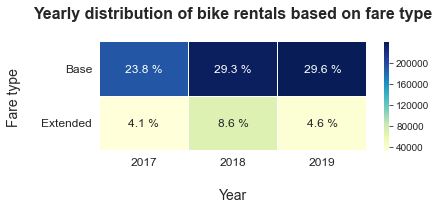

In [686]:
# plot heat map
plt.figure(figsize = [6, 2])
res = sb.heatmap(categorical_counts, annot = True, fmt = '.0f', annot_kws={'size':12}, linewidths=0.1, cmap="YlGnBu")
plt.yticks(rotation=0, fontsize="12", va="center")
plt.xticks(fontsize="12")
plt.title('Yearly distribution of bike rentals based on fare type\n', fontsize = 16, weight = 'bold')
plt.xlabel('\nYear', fontsize=14)
plt.ylabel('Fare type\n', fontsize=14);

# convert annotations to percentages
for t in res.texts: 
    p = np.round(np.round(int(t.get_text())/bikeshare.shape[0], 4)*100, 1)
    if p < 0.1:
        t.set_text('< 0.1%')
    else:
        t.set_text(str(p)+' %');  

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.54.d Heat map of rentals based on fare type and the year.png', dpi=300, bbox_inches='tight')

**`Find average rentals based on the year:`**

> The `fare_type` needs to be converted into categorical datatype, otherwise the `groupby` method will ignore `NaN` rental values and inturn produce **incorrect** `avg. rental value`. Also use of `size()` method ignores the unused level combinations of the groups, hence use `count()` method.

In [687]:
year_df = bikeshare.groupby([bikeshare["year"], 
                              bikeshare["fare_type"]]).count()['trip_id'].reset_index(name='rentals')

year_df

,year,fare_type,rentals
0,2017,Base,192345
1,2017,Extended,32986
2,2018,Base,236886
3,2018,Extended,69481
4,2019,Base,239558
5,2019,Extended,37333


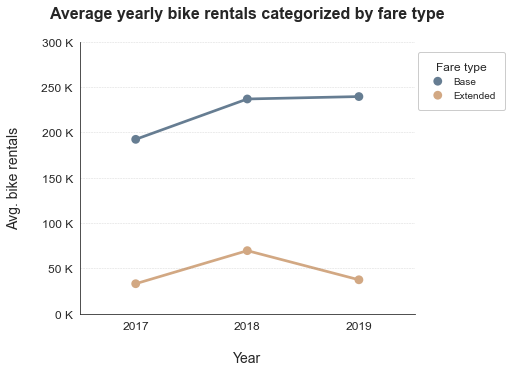

In [688]:
plt.figure(figsize=[6, 5])
sb.set_style('white')
flatui = ['#577da1', '#eda668']
sb.set_palette(flatui, n_colors=2, desat=0.6)
base_color = sb.color_palette()[0]

sb.pointplot(data = year_df, x = "year", y = "rentals", linestyles = "-", hue = 'fare_type', 
             scale = 1, ci = None)
plt.title('Average yearly bike rentals categorized by fare type\n',  weight = 'bold', fontsize = 16)
plt.ylabel('Avg. bike rentals\n', fontsize = 14)
plt.xlabel('\nYear', fontsize = 14)
plt.xticks(fontsize = 12)

# get ytick locs and rearrage them with respect to zero
locs, labels = plt.yticks()
yearly_rental_avg_max = 300000
y_tick_values = np.arange(0, yearly_rental_avg_max+50000, 50000)
y_tick_names = ['{:0.0f} K'.format(v/1000) for v in y_tick_values]
plt.yticks(y_tick_values, y_tick_names, fontsize = 12)

plt.legend(scatterpoints=1, frameon=True, fancybox=True, shadow=False, ncol = 1, 
           framealpha = 1, borderpad=1, borderaxespad=1, loc = 'upper right', labelspacing=0.5,  
           title='Fare type', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(1.3, 1))

sb.despine(top=True, right=True, left=False, bottom=False);

for loc in y_tick_values:
    plt.axhline(loc, ls='--', color='grey', linewidth=0.5, alpha=0.3)

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.54.e Average yearly bike rentals categorized by fare type.png', dpi=300, bbox_inches='tight')

-----

#### 3.2.55 Bivariate analysis of `duration_min` and `distance_miles` columns:

+ `Columns`: duration_min, distance_miles
+ `Data type`: (Numerical, continuous) and (Numerical, continuous)
+ `Plot`: Scatter plot

**`Scatter plot:`**

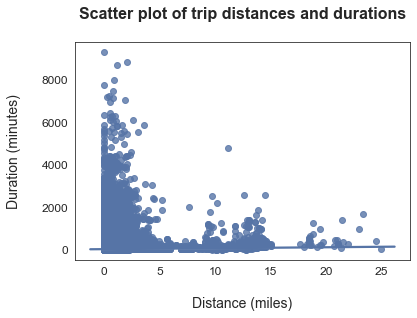

In [689]:
# assign color palette
sb.set_palette('deep', n_colors=4, desat=0.8)
current_palette = sb.color_palette()
sb.set_style('white')

# plot seaborns regplot
sb.regplot(data = bikeshare, y = 'duration_min', x = 'distance_miles');

# improve plot aesthetics
plt.title('Scatter plot of trip distances and durations\n',  weight = 'bold', fontsize = 16)
plt.ylabel('Duration (minutes)\n', fontsize = 14)
plt.xlabel('\nDistance (miles)', fontsize = 14)
plt.xticks(fontsize = 12)
plt.yticks(fontsize = 12)

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.55.a Scatter plot of trip distances and durations.png', dpi=300, bbox_inches='tight')

Add transparency to the scatter plot for clear interpretation.

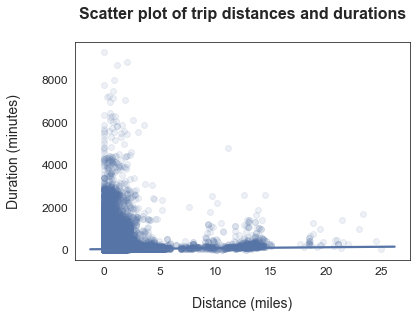

In [690]:
# assign color palette
sb.set_palette('deep', n_colors=4, desat=0.8)
current_palette = sb.color_palette()
sb.set_style('white')

# plot seaborns regplot with transparency
sb.regplot(data = bikeshare, y = 'duration_min', x = 'distance_miles', scatter_kws = {'alpha' : 1/10});

# improve plot aesthetics
plt.title('Scatter plot of trip distances and durations\n',  weight = 'bold', fontsize = 16)
plt.ylabel('Duration (minutes)\n', fontsize = 14)
plt.xlabel('\nDistance (miles)', fontsize = 14)
plt.xticks(fontsize = 12)
plt.yticks(fontsize = 12)

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.55.b Scatter plot of trip distances and durations.png', dpi=300, bbox_inches='tight')

Remove round trips and convert the data into logarithmic transformation as the data is skewed right.

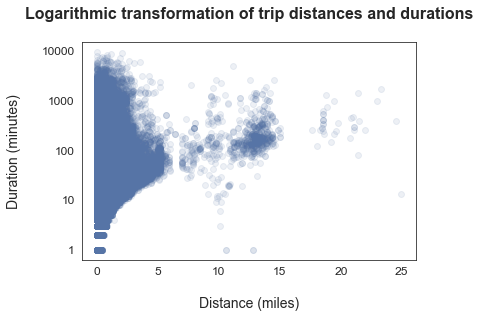

In [691]:
def log_trans(x, inverse = False):
    if not inverse:
        return np.log10(x)
    else:
        return np.power(10, x)


# assign color palette
sb.set_palette('deep', n_colors=4, desat=0.8)
current_palette = sb.color_palette()
sb.set_style('white')

# plot seaborns regplot
df = bikeshare.query(' duration_min != 0 ').copy()
sb.regplot(df['distance_miles'], df['duration_min'].apply(log_trans), 
           fit_reg = False, scatter_kws = {'alpha' : 1/10})

# improve plot aesthetics
plt.title('Logarithmic transformation of trip distances and durations\n',  weight = 'bold', fontsize = 16)
plt.ylabel('Duration (minutes)\n', fontsize = 14)
plt.xlabel('\nDistance (miles)', fontsize = 14)
plt.xticks(fontsize = 12)
tick_locs = [1, 10, 100, 1000, 10000]
plt.yticks(log_trans(tick_locs), tick_locs, fontsize = 12);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.2.55.c Logarithmic transformation of trip distances and durations.png', dpi=300, bbox_inches='tight')

------

<h4><center>-------- End of 3.2.Bivariate Data Analysis --------</center></h4>

----

### <ins>`3.3 Multivariate Data Analysis:`</ins>

#### 3.3.1 Multivariate analysis of `duration_min`, `distance_miles`, and `fare` columns:

+ `Columns`: duration_min, distance_miles, fare
+ `Data type`: (Numerical, continuous) and (Numerical, continuous)
+ `Plot`: Scatter plot

Logarithmic transformation of trip durations and analysis of trip distances and trip fares.

**`Scatter plot:`**

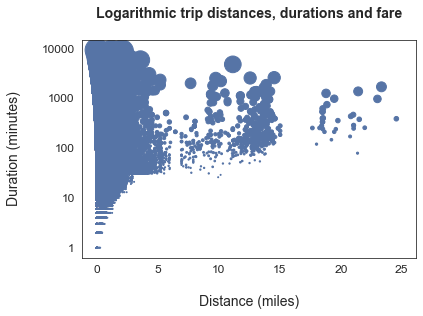

In [692]:
def log_trans(x, inverse = False):
    if not inverse:
        return np.log10(x)
    else:
        return np.power(10, x)

temp_df = bikeshare.query(' duration_min != 0 ').copy()
temp_df['duration_log'] = temp_df['duration_min'].apply(log_trans)


# assign color palette
sb.set_palette('deep', n_colors=4, desat=0.8)
current_palette = sb.color_palette()
sb.set_style('white')

# plot seaborns regplot
df = bikeshare.query(' duration_min != 0 ').copy()
# sb.regplot(df['distance_miles'], df['duration_min'].apply(log_trans), 
#            fit_reg = False, scatter_kws = {'alpha' : 1/10})
plt.scatter(data = temp_df, x = 'distance_miles', y = 'duration_log', s = 'fare')

# improve plot aesthetics
plt.title('Logarithmic trip distances, durations and fare\n',  weight = 'bold', fontsize = 14)
plt.ylabel('Duration (minutes)\n', fontsize = 14)
plt.xlabel('\nDistance (miles)', fontsize = 14)
plt.xticks(fontsize = 12)
tick_locs = [1, 10, 100, 1000, 10000]
plt.yticks(log_trans(tick_locs), tick_locs, fontsize = 12);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.3.1 Logarithmic transformation of trip distances, durations and fares.png', dpi=300, bbox_inches='tight')

------

#### 3.3.2 Multivariate analysis of `duration_min`, `distance_miles`, `trip_type` and `fare` columns:

+ `Columns`: duration_min, distance_miles, fare, trip_type
+ `Data type`: (Numerical, continuous) and (categorical ,ordered)
+ `Plot`: Scatter plot

Logarithmic transformation of trip durations and analysis of trip distances and trip fares over trip type.

**`Scatter plot:`**

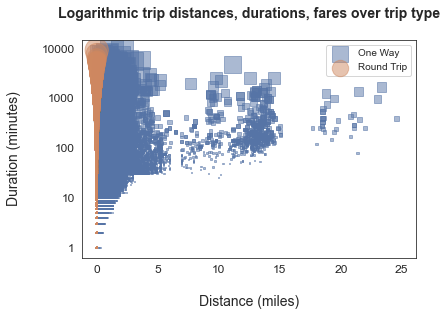

In [693]:
def log_trans(x, inverse = False):
    if not inverse:
        return np.log10(x)
    else:
        return np.power(10, x)

temp_df = bikeshare.query(' duration_min != 0 ').copy()
temp_df['duration_log'] = temp_df['duration_min'].apply(log_trans)


# assign color palette
sb.set_palette('deep', n_colors=4, desat=0.8)
current_palette = sb.color_palette()
sb.set_style('white')

# plot seaborns regplot
cat_markers = [['One Way', 's'],
               ['Round Trip', 'o']]

for cat, marker in cat_markers:
    df_cat = temp_df[temp_df['trip_type'] == cat]
    plt.scatter(data = df_cat, x = 'distance_miles', y = 'duration_log', s = 'fare', alpha = 0.5, marker = marker)
plt.legend(['One Way','Round Trip'])


# improve plot aesthetics
plt.title('Logarithmic trip distances, durations, fares over trip type\n',  weight = 'bold', fontsize = 14)
plt.ylabel('Duration (minutes)\n', fontsize = 14)
plt.xlabel('\nDistance (miles)', fontsize = 14)
plt.xticks(fontsize = 12)
tick_locs = [1, 10, 100, 1000, 10000]
plt.yticks(log_trans(tick_locs), tick_locs, fontsize = 12);


# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.3.2 Logarithmic transformation of trip distances, durations, fares over trip type.png', dpi=300, bbox_inches='tight')

------

#### 3.3.3 Multivariate analysis of `duration_min`, `distance_miles`, and `trip_type` columns:

+ `Columns`: duration_min, distance_miles
+ `Data type`: (Numerical, continuous) and (Numerical, continuous)
+ `Plot`: Scatter plot

Logarithmic transformation of trip durations and analysis of trip distances over trip type.

**`Hexbin plot:`**

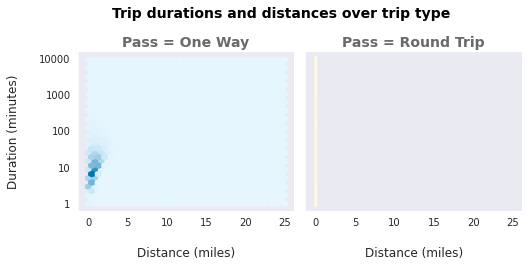

In [694]:
def hexbin(x, y, color, **kwargs):
    cmap = sb.light_palette(color, as_cmap=True)
    plt.hexbin(x, y, gridsize=30, cmap=cmap, **kwargs)

def log_trans(x, inverse = False):
    if not inverse:
        return np.log10(x)
    else:
        return np.power(10, x)

temp_df = bikeshare.query(' duration_min != 0 ').copy()
temp_df['duration_log'] = temp_df['duration_min'].apply(log_trans)

with sb.axes_style("dark"):
    g = sb.FacetGrid(temp_df, hue="trip_type", col="trip_type", col_wrap = 2, height=3.5)
g.map(hexbin, "distance_miles", "duration_log");

# improve plot aesthetics
g.fig.subplots_adjust(top=0.8)
g.fig.suptitle('Trip durations and distances over trip type\n', fontsize = 14, weight = 'bold')
g.set_titles('Pass = {col_name}', weight = 'bold', size = 14, color = 'dimgrey')
g.set_xlabels('\nDistance (miles)', size = 12)
g.set_ylabels('Duration (minutes)\n', size = 12)

x_tick_locs = [0, 5, 10, 15, 20, 25]
y_tick_locs = [1, 10, 100, 1000, 10000]
for ax in g.axes.flat:
    plt.yticks(log_trans(y_tick_locs), y_tick_locs)
    plt.xticks(x_tick_locs, x_tick_locs)

g.set_yticklabels(y_tick_locs, size = 10)
g.set_xticklabels(x_tick_locs, size = 10);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.3.3.a Logarithmic transformation of trip distances, durations over trip type.png', dpi=300, bbox_inches='tight')

Limit the dataset to trip durations under `120` minutes and distances under `3` miles for closer observation.

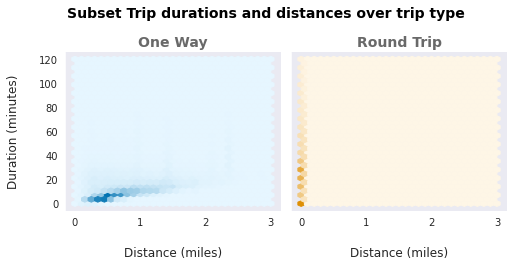

In [695]:
def hexbin(x, y, color, **kwargs):
    cmap = sb.light_palette(color, as_cmap=True)
    plt.hexbin(x, y, gridsize=30, cmap=cmap, **kwargs)


temp_df = bikeshare.query(' duration_min <= 120 and distance_miles <= 3 ').copy()

with sb.axes_style("dark"):
    g = sb.FacetGrid(temp_df, hue="trip_type", col="trip_type", col_wrap = 2, height=3.5)
g.map(hexbin, "distance_miles", "duration_min", extent=[0, 3, 0, 120]);

# improve plot aesthetics
g.fig.subplots_adjust(top=0.8)
g.fig.suptitle('Subset Trip durations and distances over trip type\n', fontsize = 14, weight = 'bold')
g.set_titles('{col_name}', weight = 'bold', size = 14, color = 'dimgrey')
g.set_xlabels('\nDistance (miles)', size = 12)
g.set_ylabels('Duration (minutes)\n', size = 12)

x_tick_locs = np.arange(0, 3+1, 1)
y_tick_locs = np.arange(0, 120+20, 20)
for ax in g.axes.flat:
    plt.yticks(y_tick_locs, y_tick_locs)
    plt.xticks(x_tick_locs, x_tick_locs)

g.set_yticklabels(y_tick_locs, size = 10)
g.set_xticklabels(x_tick_locs, size = 10);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.3.3.b Subset of trip distances, durations over trip type.png', dpi=300, bbox_inches='tight')

---

#### 3.3.4 Multivariate analysis of `duration_min`, `distance_miles`, and `bike_type` columns:

+ `Columns`: duration_min, distance_miles
+ `Data type`: (Numerical, continuous) and (Numerical, continuous)
+ `Plot`: Scatter plot

Logarithmic transformation of trip durations and analysis of trip distances over bike type.

**`Hexbin plot:`**

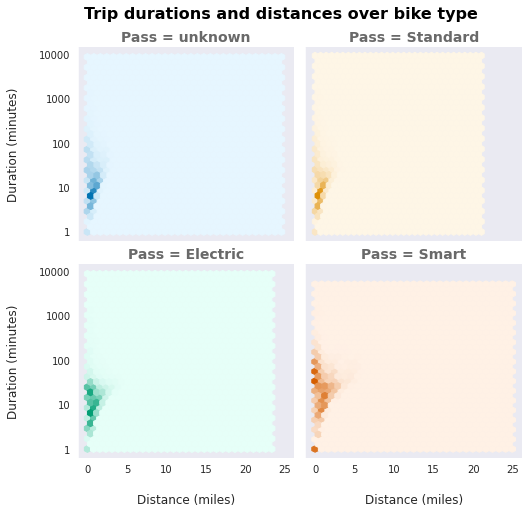

In [696]:
def hexbin(x, y, color, **kwargs):
    cmap = sb.light_palette(color, as_cmap=True)
    plt.hexbin(x, y, gridsize=30, cmap=cmap, **kwargs)

def log_trans(x, inverse = False):
    if not inverse:
        return np.log10(x)
    else:
        return np.power(10, x)

temp_df = bikeshare.query(' duration_min != 0 ').copy()
temp_df['duration_log'] = temp_df['duration_min'].apply(log_trans)

with sb.axes_style("dark"):
    g = sb.FacetGrid(temp_df, hue="bike_type", col="bike_type", col_wrap = 2, height=3.5)
g.map(hexbin, "distance_miles", "duration_log");

# improve plot aesthetics
g.fig.subplots_adjust(top=0.9)
g.fig.suptitle('Trip durations and distances over bike type\n', fontsize = 16, weight = 'bold')
g.set_titles('Pass = {col_name}', weight = 'bold', size = 14, color = 'dimgrey')
g.set_xlabels('\nDistance (miles)', size = 12)
g.set_ylabels('Duration (minutes)\n', size = 12)

x_tick_locs = [0, 5, 10, 15, 20, 25]
y_tick_locs = [1, 10, 100, 1000, 10000]
for ax in g.axes.flat:
    plt.yticks(log_trans(y_tick_locs), y_tick_locs)
    plt.xticks(x_tick_locs, x_tick_locs)

g.set_yticklabels(y_tick_locs, size = 10)
g.set_xticklabels(x_tick_locs, size = 10);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.3.4.a Logarithmic transformation of trip distances, durations over bike type.png', dpi=300, bbox_inches='tight')

Limit the dataset to trip durations under `120` minutes and distances under `3` miles for closer observation.

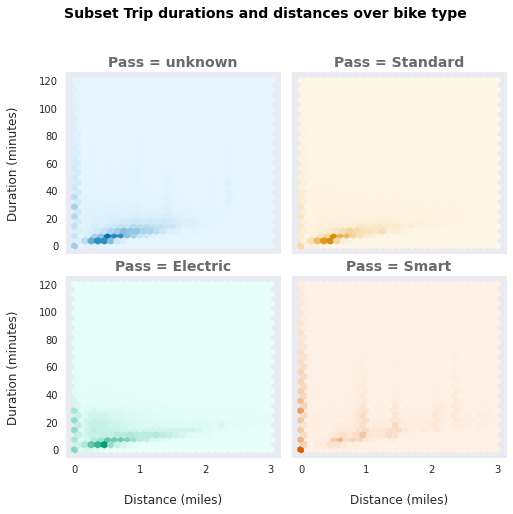

In [697]:
def hexbin(x, y, color, **kwargs):
    cmap = sb.light_palette(color, as_cmap=True)
    plt.hexbin(x, y, gridsize=30, cmap=cmap, **kwargs)


temp_df = bikeshare.query(' duration_min <= 120 and distance_miles <= 3 ').copy()

with sb.axes_style("dark"):
    g = sb.FacetGrid(temp_df, hue="bike_type", col="bike_type", col_wrap = 2, height=3.5)
g.map(hexbin, "distance_miles", "duration_min", extent=[0, 3, 0, 120]);

# improve plot aesthetics
g.fig.subplots_adjust(top=0.85)
g.fig.suptitle('Subset Trip durations and distances over bike type\n', fontsize = 14, weight = 'bold')
g.set_titles('Pass = {col_name}', weight = 'bold', size = 14, color = 'dimgrey')
g.set_xlabels('\nDistance (miles)', size = 12)
g.set_ylabels('Duration (minutes)\n', size = 12)

x_tick_locs = np.arange(0, 3+1, 1)
y_tick_locs = np.arange(0, 120+20, 20)
for ax in g.axes.flat:
    plt.yticks(y_tick_locs, y_tick_locs)
    plt.xticks(x_tick_locs, x_tick_locs)

g.set_yticklabels(y_tick_locs, size = 10)
g.set_xticklabels(x_tick_locs, size = 10);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.3.4.b Subset of trip distances, durations over bike type.png', dpi=300, bbox_inches='tight')

------

#### 3.3.5 Multivariate analysis of `duration_min`, `distance_miles`, and `pass_type` columns:

+ `Columns`: duration_min, distance_miles
+ `Data type`: (Numerical, continuous) and (Numerical, continuous)
+ `Plot`: Scatter plot

Logarithmic transformation of trip durations and analysis of trip distances over pass type.

**`Hexbin plot:`**

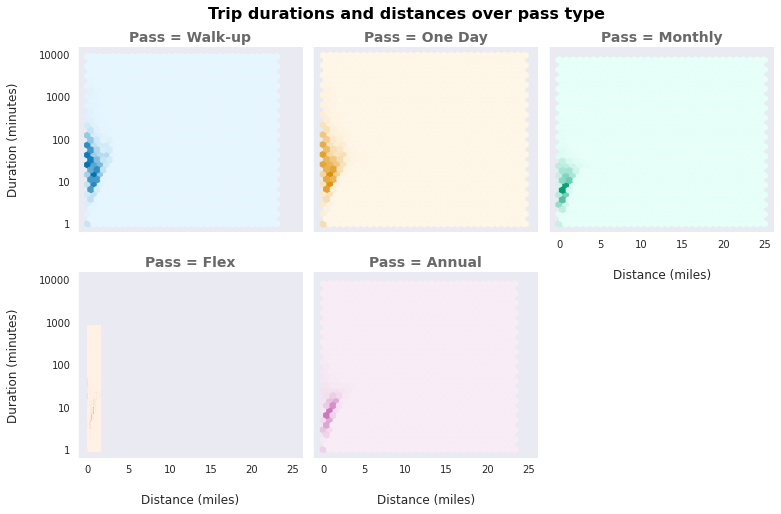

In [698]:
def hexbin(x, y, color, **kwargs):
    cmap = sb.light_palette(color, as_cmap=True)
    plt.hexbin(x, y, gridsize=30, cmap=cmap, **kwargs)

def log_trans(x, inverse = False):
    if not inverse:
        return np.log10(x)
    else:
        return np.power(10, x)

temp_df = bikeshare.query(' duration_min != 0 ').copy()
temp_df['duration_log'] = temp_df['duration_min'].apply(log_trans)

with sb.axes_style("dark"):
    g = sb.FacetGrid(temp_df, hue="pass_type", col="pass_type", col_wrap = 3, height=3.5)
g.map(hexbin, "distance_miles", "duration_log");

# improve plot aesthetics
g.fig.subplots_adjust(top=0.9)
g.fig.suptitle('Trip durations and distances over pass type\n', fontsize = 16, weight = 'bold')
g.set_titles('Pass = {col_name}', weight = 'bold', size = 14, color = 'dimgrey')
g.set_xlabels('\nDistance (miles)', size = 12)
g.set_ylabels('Duration (minutes)\n', size = 12)

x_tick_locs = [0, 5, 10, 15, 20, 25]
y_tick_locs = [1, 10, 100, 1000, 10000]
for ax in g.axes.flat:
    plt.yticks(log_trans(y_tick_locs), y_tick_locs)
    plt.xticks(x_tick_locs, x_tick_locs)

g.set_yticklabels(y_tick_locs, size = 10)
g.set_xticklabels(x_tick_locs, size = 10);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.3.5.a Logarithmic transformation of trip distances, durations over pass type.png', dpi=300, bbox_inches='tight')

Limit the dataset to trip durations under `120` minutes and distances under `3` miles for closer observation.

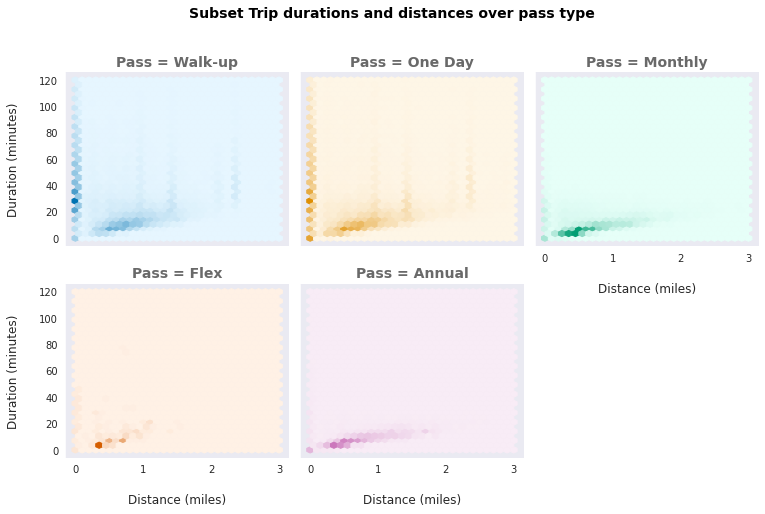

In [699]:
def hexbin(x, y, color, **kwargs):
    cmap = sb.light_palette(color, as_cmap=True)
    plt.hexbin(x, y, gridsize=30, cmap=cmap, **kwargs)


temp_df = bikeshare.query(' duration_min <= 120 and distance_miles <= 3 ').copy()

with sb.axes_style("dark"):
    g = sb.FacetGrid(temp_df, hue="pass_type", col="pass_type", col_wrap = 3, height=3.5)
g.map(hexbin, "distance_miles", "duration_min", extent=[0, 3, 0, 120]);

# improve plot aesthetics
g.fig.subplots_adjust(top=0.85)
g.fig.suptitle('Subset Trip durations and distances over pass type\n', fontsize = 14, weight = 'bold')
g.set_titles('Pass = {col_name}', weight = 'bold', size = 14, color = 'dimgrey')
g.set_xlabels('\nDistance (miles)', size = 12)
g.set_ylabels('Duration (minutes)\n', size = 12)

x_tick_locs = np.arange(0, 3+1, 1)
y_tick_locs = np.arange(0, 120+20, 20)
for ax in g.axes.flat:
    plt.yticks(y_tick_locs, y_tick_locs)
    plt.xticks(x_tick_locs, x_tick_locs)

g.set_yticklabels(y_tick_locs, size = 10)
g.set_xticklabels(x_tick_locs, size = 10);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.3.5.b Subset of trip distances, durations over pass type.png', dpi=300, bbox_inches='tight')

------

#### 3.3.6 Multivariate analysis of `duration_min`, `distance_miles`, and `fare_type` columns:

+ `Columns`: duration_min, distance_miles
+ `Data type`: (Numerical, continuous) and (Numerical, continuous)
+ `Plot`: Scatter plot

Logarithmic transformation of trip durations and analysis of trip distances over fare type.

**`Hexbin plot:`**

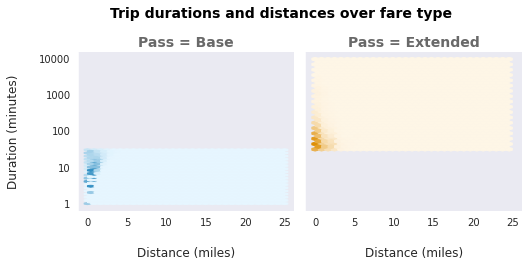

In [700]:
def hexbin(x, y, color, **kwargs):
    cmap = sb.light_palette(color, as_cmap=True)
    plt.hexbin(x, y, gridsize=30, cmap=cmap, **kwargs)

def log_trans(x, inverse = False):
    if not inverse:
        return np.log10(x)
    else:
        return np.power(10, x)

temp_df = bikeshare.query(' duration_min != 0 ').copy()
temp_df['duration_log'] = temp_df['duration_min'].apply(log_trans)

with sb.axes_style("dark"):
    g = sb.FacetGrid(temp_df, hue="fare_type", col="fare_type", col_wrap = 2, height=3.5)
g.map(hexbin, "distance_miles", "duration_log");

# improve plot aesthetics
g.fig.subplots_adjust(top=0.8)
g.fig.suptitle('Trip durations and distances over fare type\n', fontsize = 14, weight = 'bold')
g.set_titles('Pass = {col_name}', weight = 'bold', size = 14, color = 'dimgrey')
g.set_xlabels('\nDistance (miles)', size = 12)
g.set_ylabels('Duration (minutes)\n', size = 12)

x_tick_locs = [0, 5, 10, 15, 20, 25]
y_tick_locs = [1, 10, 100, 1000, 10000]
for ax in g.axes.flat:
    plt.yticks(log_trans(y_tick_locs), y_tick_locs)
    plt.xticks(x_tick_locs, x_tick_locs)

g.set_yticklabels(y_tick_locs, size = 10)
g.set_xticklabels(x_tick_locs, size = 10);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.3.6.a Logarithmic transformation of trip distances, durations over fare type.png', dpi=300, bbox_inches='tight')

Limit the dataset to trip durations under `120` minutes and distances under `3` miles for closer observation.

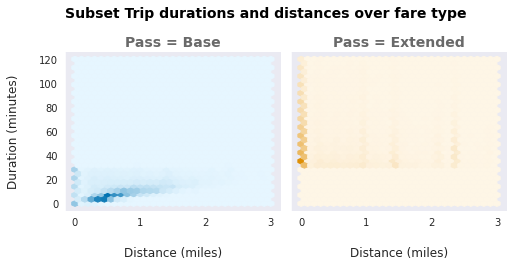

In [701]:
def hexbin(x, y, color, **kwargs):
    cmap = sb.light_palette(color, as_cmap=True)
    plt.hexbin(x, y, gridsize=30, cmap=cmap, **kwargs)


temp_df = bikeshare.query(' duration_min <= 120 and distance_miles <= 3 ').copy()

with sb.axes_style("dark"):
    g = sb.FacetGrid(temp_df, hue="fare_type", col="fare_type", col_wrap = 2, height=3.5)
g.map(hexbin, "distance_miles", "duration_min", extent=[0, 3, 0, 120]);

# improve plot aesthetics
g.fig.subplots_adjust(top=0.8)
g.fig.suptitle('Subset Trip durations and distances over fare type\n', fontsize = 14, weight = 'bold')
g.set_titles('Pass = {col_name}', weight = 'bold', size = 14, color = 'dimgrey')
g.set_xlabels('\nDistance (miles)', size = 12)
g.set_ylabels('Duration (minutes)\n', size = 12)

x_tick_locs = np.arange(0, 3+1, 1)
y_tick_locs = np.arange(0, 120+20, 20)
for ax in g.axes.flat:
    plt.yticks(y_tick_locs, y_tick_locs)
    plt.xticks(x_tick_locs, x_tick_locs)

g.set_yticklabels(y_tick_locs, size = 10)
g.set_xticklabels(x_tick_locs, size = 10);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.3.6.b Subset of trip distances, durations over fare type.png', dpi=300, bbox_inches='tight')

------

#### 3.3.7 Multivariate analysis of `duration_min`,`distance_miles`, and `trip_type` columns:

+ `Columns`: duration_min, distance_miles, trip_type
+ `Data type`: (Numerical, continuous), (Numerical, continuous), (categorical, nominal)
+ `Plot`: Facet grid, Scatter plot

**`lmplot:`**

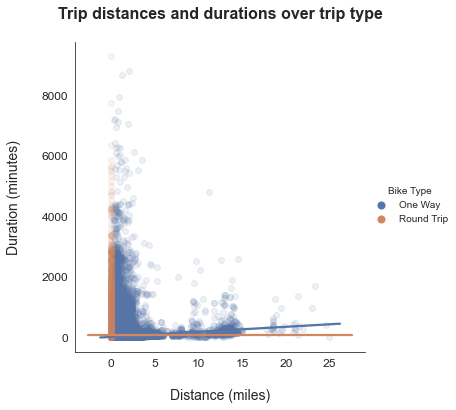

In [702]:
# assign color palette
sb.set_palette('deep', n_colors=2, desat=0.8)
current_palette = sb.color_palette()
sb.set_style('white')

# plot seaborns lmplot with transparency
g = sb.lmplot(data = bikeshare, x = 'distance_miles', y = 'duration_min', scatter_kws = {'alpha' : 1/10}, 
              legend = True, legend_out=True, hue = 'trip_type');

# improve plot aesthetics
plt.title('Trip distances and durations over trip type\n',  weight = 'bold', fontsize = 16)
plt.ylabel('Duration (minutes)\n', fontsize = 14)
plt.xlabel('\nDistance (miles)', fontsize = 14)
plt.xticks(fontsize = 12)
plt.yticks(fontsize = 12)

# add custom legend
g._legend.set_title("Bike Type")

for lh in g._legend.legendHandles: 
    lh.set_alpha(1)
    lh._sizes = [50]

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.3.7.a Trip distances and durations over trip type.png', dpi=300, bbox_inches='tight')

Logarithmic transformation of trip durations and analysis of trip distances and trip fares over trip type.

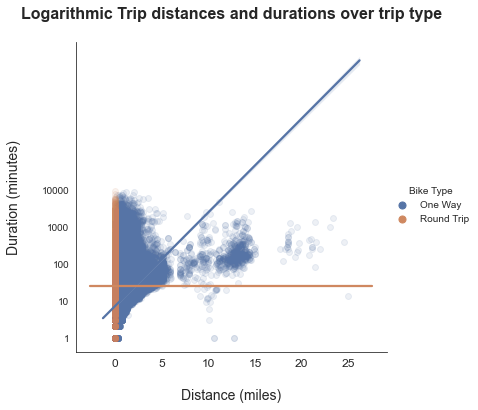

In [703]:
def log_trans(x, inverse = False):
    if not inverse:
        return np.log10(x)
    else:
        return np.power(10, x)


# assign color palette
sb.set_palette('deep', n_colors=2, desat=0.8)
current_palette = sb.color_palette()
sb.set_style('white')

# plot seaborns lmplot with transparency
df = bikeshare.query(' duration_min != 0 ').copy()
df['duration_log'] = df['duration_min'].apply(log_trans)
g = sb.lmplot(data = df, x = 'distance_miles', y = 'duration_log', scatter_kws = {'alpha' : 1/10}, 
              legend = True, legend_out=True, hue = 'trip_type');

# improve plot aesthetics
plt.title('Logarithmic Trip distances and durations over trip type\n',  weight = 'bold', fontsize = 16)
plt.ylabel('Duration (minutes)\n', fontsize = 14)
plt.xlabel('\nDistance (miles)', fontsize = 14)
plt.xticks(fontsize = 12)
tick_locs = [1, 10, 100, 1000, 10000]
plt.yticks(log_trans(tick_locs), tick_locs);

# add custom legend
g._legend.set_title("Bike Type")

for lh in g._legend.legendHandles: 
    lh.set_alpha(1)
    lh._sizes = [50]

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.3.7.b Logarithmic Trip distances and durations over trip type.png', dpi=300, bbox_inches='tight')

**`Facet grid:`**

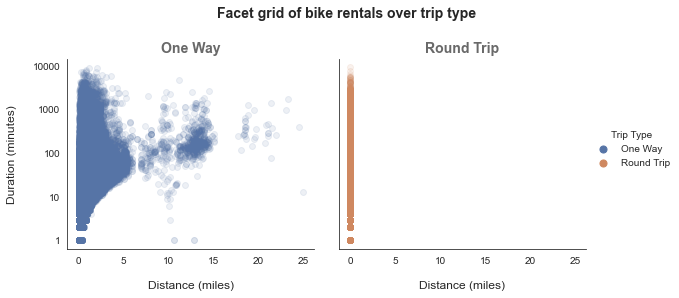

In [704]:
def log_trans(x, inverse = False):
    if not inverse:
        return np.log10(x)
    else:
        return np.power(10, x)


sb.set_palette('deep', n_colors=2, desat=0.8)
current_palette = sb.color_palette()

temp_df = bikeshare.query(' duration_min != 0 ').copy()
temp_df['duration_log'] = temp_df['duration_min'].apply(log_trans)

# plot facet grid
g = sb.FacetGrid(data = temp_df, col = 'trip_type', col_wrap = 2, height = 4, aspect = 1, hue = 'trip_type')
g.map(sb.regplot, 'distance_miles', 'duration_log', fit_reg = False, scatter_kws = {'alpha' : 1/10})

# improve plot aesthetics
g.fig.subplots_adjust(top=0.8)
g.fig.suptitle('Facet grid of bike rentals over trip type\n', fontsize = 14, weight = 'bold')
g.set_titles('{col_name}', weight = 'bold', size = 14, color = 'dimgrey')
g.set_xlabels('\nDistance (miles)', size = 12)
g.set_ylabels('Duration (minutes)\n', size = 12)

x_tick_locs = [0, 5, 10, 15, 20, 25]
y_tick_locs = [1, 10, 100, 1000, 10000]
for ax in g.axes.flat:
    plt.yticks(log_trans(y_tick_locs), y_tick_locs)
    plt.xticks(x_tick_locs, x_tick_locs)

g.set_yticklabels(y_tick_locs, size = 10)
g.set_xticklabels(x_tick_locs, size = 10)
plt.subplots_adjust(wspace=0.1, hspace=0.3);
g.add_legend()

# add custom legend
g._legend.set_title("Trip Type")

for lh in g._legend.legendHandles: 
    lh.set_alpha(1)
    lh._sizes = [50]
    
# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.3.7.c Facet grid of Trip distances and durations over trip type.png', dpi=300, bbox_inches='tight')

Plot a regression line for analysis purpose:

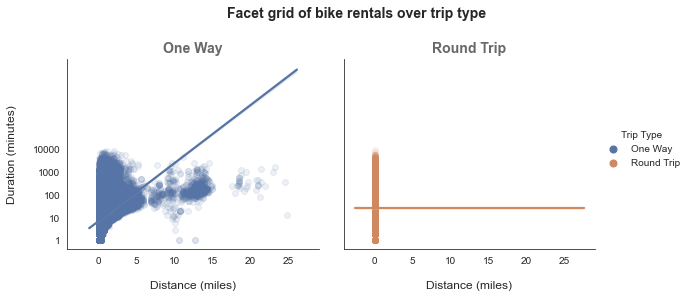

In [705]:
def log_trans(x, inverse = False):
    if not inverse:
        return np.log10(x)
    else:
        return np.power(10, x)


sb.set_palette('deep', n_colors=2, desat=0.8)
current_palette = sb.color_palette()

temp_df = bikeshare.query(' duration_min != 0 ').copy()
temp_df['duration_log'] = temp_df['duration_min'].apply(log_trans)

# plot facet grid
g = sb.FacetGrid(data = temp_df, col = 'trip_type', col_wrap = 2, height = 4, aspect = 1, hue = 'trip_type')
g.map(sb.regplot, 'distance_miles', 'duration_log', fit_reg = True, scatter_kws = {'alpha' : 1/10})

# improve plot aesthetics
g.fig.subplots_adjust(top=0.8)
g.fig.suptitle('Facet grid of bike rentals over trip type\n', fontsize = 14, weight = 'bold')
g.set_titles('{col_name}', weight = 'bold', size = 14, color = 'dimgrey')
g.set_xlabels('\nDistance (miles)', size = 12)
g.set_ylabels('Duration (minutes)\n', size = 12)

x_tick_locs = [0, 5, 10, 15, 20, 25]
y_tick_locs = [1, 10, 100, 1000, 10000]
for ax in g.axes.flat:
    plt.yticks(log_trans(y_tick_locs), y_tick_locs)
    plt.xticks(x_tick_locs, x_tick_locs)

g.set_yticklabels(y_tick_locs, size = 10)
g.set_xticklabels(x_tick_locs, size = 10)
plt.subplots_adjust(wspace=0.1, hspace=0.3);
g.add_legend()

# add custom legend
g._legend.set_title("Trip Type")

for lh in g._legend.legendHandles: 
    lh.set_alpha(1)
    lh._sizes = [50]
    
# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.3.7.d Facet grid of Trip distances and durations over trip type.png', dpi=300, bbox_inches='tight')

------

#### 3.3.8 Multivariate analysis of `duration_min`,`distance_miles`, and `bike_type` columns:

+ `Columns`: duration_min, distance_miles, bike_type
+ `Data type`: (Numerical, continuous), (Numerical, continuous), (categorical, nominal)
+ `Plot`: Facet grid, Scatter plot

**`lmplot:`**

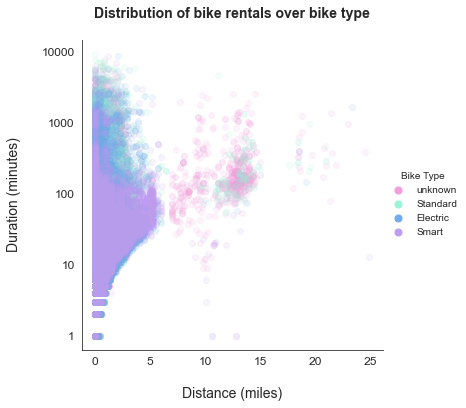

In [706]:
def log_trans(x, inverse = False):
    if not inverse:
        return np.log10(x)
    else:
        return np.power(10, x)


flatui = ['#ff91e2', '#91ffda', '#60acfc', '#bd91ff']
sb.set_palette(flatui, n_colors=4, desat=0.8)

df = bikeshare.query(' duration_min != 0 ').copy()
df['duration_log'] = df['duration_min'].apply(log_trans)

g = sb.lmplot(data = df, x = 'distance_miles', y = 'duration_log', legend = True, legend_out=True, 
              fit_reg = False, scatter_kws = {'alpha' : 1/10}, hue = 'bike_type')

# improve plot aesthetics
plt.title('Distribution of bike rentals over bike type\n',  weight = 'bold', fontsize = 14)
plt.ylabel('Duration (minutes)\n', fontsize = 14)
plt.xlabel('\nDistance (miles)', fontsize = 14)
plt.xticks(fontsize = 12)
tick_locs = [1, 10, 100, 1000, 10000]
plt.yticks(log_trans(tick_locs), tick_locs, fontsize = 12);

# add custom legend
g._legend.set_title("Bike Type")

for lh in g._legend.legendHandles: 
    lh.set_alpha(1)
    lh._sizes = [50]

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.3.8.a Logarithmic Trip distances and durations over bike type.png', dpi=300, bbox_inches='tight')

The data related to each bike category are overlapped on each other and difficult to interpret. Plot the distribution of each bike type on an individual plot for better interpretation.

**`Facet grid:`**

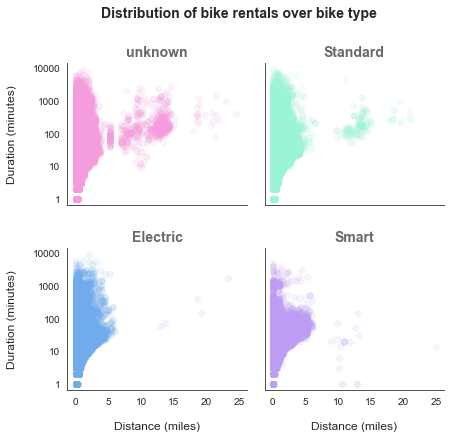

In [707]:
def log_trans(x, inverse = False):
    if not inverse:
        return np.log10(x)
    else:
        return np.power(10, x)


flatui = ['#ff91e2', '#91ffda', '#60acfc', '#bd91ff']
sb.set_palette(flatui, n_colors=4, desat=0.8)
current_palette = sb.color_palette()

temp_df = bikeshare.query(' duration_min != 0 ').copy()
temp_df['duration_log'] = temp_df['duration_min'].apply(log_trans)

# plot facet grid
g = sb.FacetGrid(data = temp_df, col = 'bike_type', col_wrap = 2, height = 3, aspect = 1, hue = 'bike_type')
g.map(sb.regplot, 'distance_miles', 'duration_log', fit_reg = False, scatter_kws = {'alpha' : 1/10})

# improve plot aesthetics
g.fig.subplots_adjust(top=0.85)
g.fig.suptitle('Distribution of bike rentals over bike type\n', fontsize = 14, weight = 'bold')
g.set_titles('{col_name}', weight = 'bold', size = 14, color = 'dimgrey')
g.set_xlabels('\nDistance (miles)', size = 12)
g.set_ylabels('Duration (minutes)\n', size = 12)

x_tick_locs = [0, 5, 10, 15, 20, 25]
y_tick_locs = [1, 10, 100, 1000, 10000]
for ax in g.axes.flat:
    plt.yticks(log_trans(y_tick_locs), y_tick_locs)
    plt.xticks(x_tick_locs, x_tick_locs)

g.set_yticklabels(y_tick_locs, size = 10)
g.set_xticklabels(x_tick_locs, size = 10)
plt.subplots_adjust(wspace=0.1, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.3.8.b Facet grid of Trip distances and durations over bike type.png', dpi=300, bbox_inches='tight')

Limit the dataset to trip durations under `120` minutes and distances under `3` miles for closer observation.

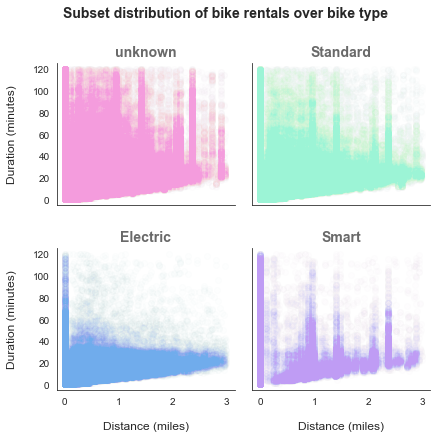

In [708]:
flatui = ['#ff91e2', '#91ffda', '#60acfc', '#bd91ff']
sb.set_palette(flatui, n_colors=4, desat=0.8)
current_palette = sb.color_palette()

temp_df = bikeshare.query(' duration_min != 0 and duration_min <= 120 and distance_miles <= 3 ').copy()

# plot facet grid
g = sb.FacetGrid(data = temp_df, col = 'bike_type', col_wrap = 2, height = 3, aspect = 1, hue = 'bike_type')
g.map(sb.regplot, 'distance_miles', 'duration_min', fit_reg = False, scatter_kws = {'alpha' : 1/100})

# improve plot aesthetics
g.fig.subplots_adjust(top=0.85)
g.fig.suptitle('Subset distribution of bike rentals over bike type\n', fontsize = 14, weight = 'bold')
g.set_titles('{col_name}', weight = 'bold', size = 14, color = 'dimgrey')
g.set_xlabels('\nDistance (miles)', size = 12)
g.set_ylabels('Duration (minutes)\n', size = 12)

plt.subplots_adjust(wspace=0.1, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.3.8.c Subset Facet grid of Trip distances and durations over bike type.png', dpi=300, bbox_inches='tight')

Plot a regression line for analysis purpose:

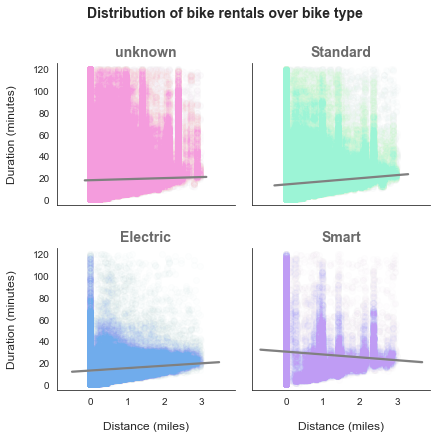

In [709]:
flatui = ['#ff91e2', '#91ffda', '#60acfc', '#bd91ff']
sb.set_palette(flatui, n_colors=4, desat=0.8)
current_palette = sb.color_palette()

temp_df = bikeshare.query(' duration_min != 0 and duration_min <= 120 and distance_miles <= 3 ').copy()

# plot facet grid
g = sb.FacetGrid(data = temp_df, col = 'bike_type', col_wrap = 2, height = 3, aspect = 1, hue = 'bike_type')
g.map(sb.regplot, 'distance_miles', 'duration_min', fit_reg = True, scatter_kws = {'alpha' : 1/100}, 
      line_kws = {'color' : 'grey'})

# improve plot aesthetics
g.fig.subplots_adjust(top=0.85)
g.fig.suptitle('Distribution of bike rentals over bike type\n', fontsize = 14, weight = 'bold')
g.set_titles('{col_name}', weight = 'bold', size = 14, color = 'dimgrey')
g.set_xlabels('\nDistance (miles)', size = 12)
g.set_ylabels('Duration (minutes)\n', size = 12)

plt.subplots_adjust(wspace=0.1, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.3.8.d Subset Facet grid of Trip distances and durations over bike type with regression.png', dpi=300, bbox_inches='tight')

----

#### 3.3.9 Multivariate analysis of `duration_min`,`distance_miles`, and `pass_type` columns:

+ `Columns`: duration_min, distance_miles, pass_type
+ `Data type`: (Numerical, continuous), (Numerical, continuous), (categorical, nominal)
+ `Plot`: Facet grid, Scatter plot

**`Facet grid:`**

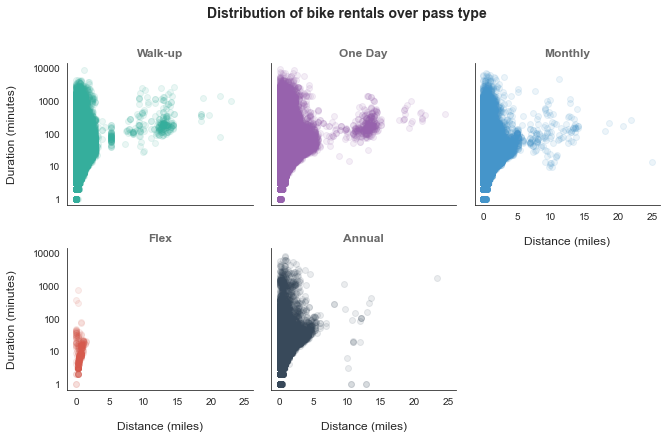

In [710]:
def log_trans(x, inverse = False):
    if not inverse:
        return np.log10(x)
    else:
        return np.power(10, x)


flatui = ["#26bda7", "#9b59b6", "#3498db", "#e74c3c", "#34495e"]
sb.set_palette(flatui, n_colors=5, desat=0.8)
current_palette = sb.color_palette()

temp_df = bikeshare.query(' duration_min != 0 ').copy()
temp_df['duration_log'] = temp_df['duration_min'].apply(log_trans)

# plot facet grid
g = sb.FacetGrid(data = temp_df, col = 'pass_type', col_wrap = 3, height = 3, aspect = 1, hue = 'pass_type')
g.map(sb.regplot, 'distance_miles', 'duration_log', fit_reg = False, scatter_kws = {'alpha' : 1/10})

# improve plot aesthetics
g.fig.subplots_adjust(top=0.85)
g.fig.suptitle('Distribution of bike rentals over pass type\n', fontsize = 14, weight = 'bold')
g.set_titles('{col_name}', weight = 'bold', size = 12, color = 'dimgrey')
g.set_xlabels('\nDistance (miles)', size = 12)
g.set_ylabels('Duration (minutes)\n', size = 12)

x_tick_locs = [0, 5, 10, 15, 20, 25]
y_tick_locs = [1, 10, 100, 1000, 10000]
for ax in g.axes.flat:
    plt.yticks(log_trans(y_tick_locs), y_tick_locs)
    plt.xticks(x_tick_locs, x_tick_locs)

g.set_yticklabels(y_tick_locs, size = 10)
g.set_xticklabels(x_tick_locs, size = 10)
plt.subplots_adjust(wspace=0.1, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.3.9.a Facet grid of Trip distances and durations over pass type.png', dpi=300, bbox_inches='tight')

Limit the dataset to trip durations under `120` minutes and distances under `3` miles for closer observation.

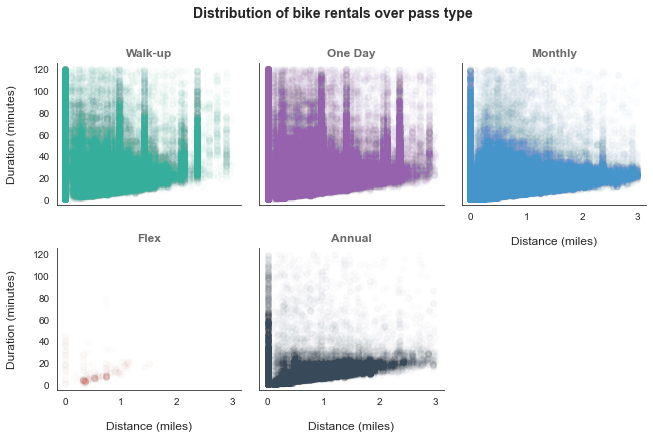

In [711]:
flatui = ["#26bda7", "#9b59b6", "#3498db", "#e74c3c", "#34495e"]
sb.set_palette(flatui, n_colors=5, desat=0.8)

temp_df = bikeshare.query(' duration_min != 0 and duration_min <= 120 and distance_miles <= 3 ').copy()

# plot facet grid
g = sb.FacetGrid(data = temp_df, col = 'pass_type', col_wrap = 3, height = 3, aspect = 1, hue = 'pass_type')
g.map(sb.regplot, 'distance_miles', 'duration_min', fit_reg = False, scatter_kws = {'alpha' : 1/100})

# improve plot aesthetics
g.fig.subplots_adjust(top=0.85)
g.fig.suptitle('Distribution of bike rentals over pass type\n', fontsize = 14, weight = 'bold')
g.set_titles('{col_name}', weight = 'bold', size = 12, color = 'dimgrey')
g.set_xlabels('\nDistance (miles)', size = 12)
g.set_ylabels('Duration (minutes)\n', size = 12)

plt.subplots_adjust(wspace=0.1, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.3.9.b Subset Facet grid of Trip distances and durations over pass type.png', dpi=300, bbox_inches='tight')

Plot a regression line for analysis purpose:

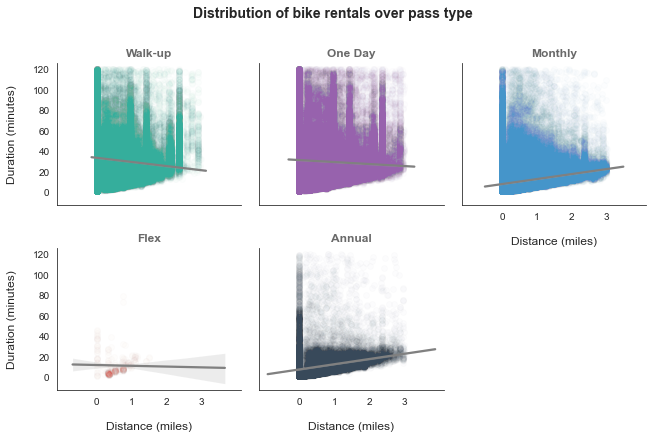

In [712]:
flatui = ["#26bda7", "#9b59b6", "#3498db", "#e74c3c", "#34495e"]
sb.set_palette(flatui, n_colors=5, desat=0.8)

temp_df = bikeshare.query(' duration_min != 0 and duration_min <= 120 and distance_miles <= 3 ').copy()

# plot facet grid
g = sb.FacetGrid(data = temp_df, col = 'pass_type', col_wrap = 3, height = 3, aspect = 1, hue = 'pass_type')
g.map(sb.regplot, 'distance_miles', 'duration_min', fit_reg = True, scatter_kws = {'alpha' : 1/100}, 
      line_kws = {'color' : 'grey'})

# improve plot aesthetics
g.fig.subplots_adjust(top=0.85)
g.fig.suptitle('Distribution of bike rentals over pass type\n', fontsize = 14, weight = 'bold')
g.set_titles('{col_name}', weight = 'bold', size = 12, color = 'dimgrey')
g.set_xlabels('\nDistance (miles)', size = 12)
g.set_ylabels('Duration (minutes)\n', size = 12)

x_tick_locs = np.arange(0, 3+1, 1)
y_tick_locs = np.arange(0, 120+20, 20)
for ax in g.axes.flat:
    plt.yticks(y_tick_locs, y_tick_locs)
    plt.xticks(x_tick_locs, x_tick_locs)

g.set_yticklabels(y_tick_locs, size = 10)
g.set_xticklabels(x_tick_locs, size = 10)
plt.subplots_adjust(wspace=0.1, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.3.9.c Subset Facet grid of Trip distances and durations over pass type with regression.png', dpi=300, bbox_inches='tight')

------

#### 3.3.10 Multivariate analysis of `duration_min`,`distance_miles`, and `fare_type` columns:

+ `Columns`: duration_min, distance_miles, fare_type
+ `Data type`: (Numerical, continuous), (Numerical, continuous), (categorical, nominal)
+ `Plot`: Facet grid, Scatter plot

**`lmplot:`**

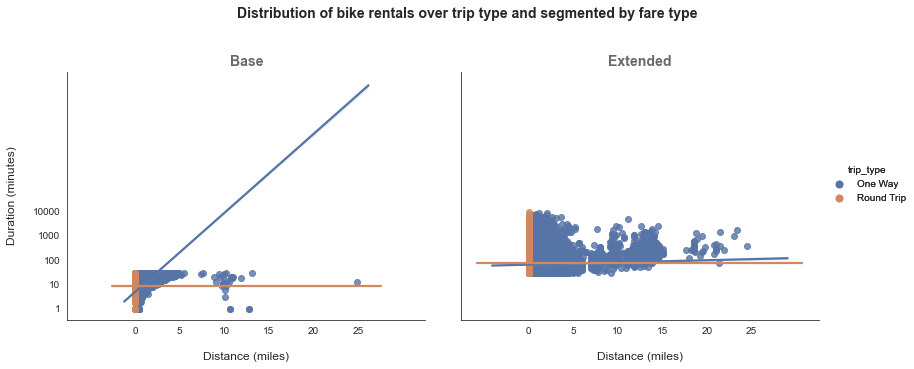

In [713]:
def log_trans(x, inverse = False):
    if not inverse:
        return np.log10(x)
    else:
        return np.power(10, x)


sb.set_palette('deep', n_colors=2, desat=0.8)
current_palette = sb.color_palette()

temp_df = bikeshare.query(' duration_min != 0 ').copy()
temp_df['duration_log'] = temp_df['duration_min'].apply(log_trans)

# plot facet grid
g = sb.lmplot(x='distance_miles', y='duration_log', hue='trip_type', col='fare_type', data=temp_df);

# improve plot aesthetics
g.fig.subplots_adjust(top=0.8)
g.fig.suptitle('Distribution of bike rentals over trip type and segmented by fare type\n', fontsize = 14, weight = 'bold')
g.set_titles('{col_name}', weight = 'bold', size = 14, color = 'dimgrey')
g.set_xlabels('\nDistance (miles)', size = 12)
g.set_ylabels('Duration (minutes)\n', size = 12)

x_tick_locs = [0, 5, 10, 15, 20, 25]
y_tick_locs = [1, 10, 100, 1000, 10000]
for ax in g.axes.flat:
    plt.yticks(log_trans(y_tick_locs), y_tick_locs)
    plt.xticks(x_tick_locs, x_tick_locs)

g.set_yticklabels(y_tick_locs, size = 10)
g.set_xticklabels(x_tick_locs, size = 10)

# add legend
g.add_legend()
# g._legend.set_title("Trip Type")

for lh in g._legend.legendHandles: 
    lh.set_alpha(1)
    lh._sizes = [50]
    
plt.subplots_adjust(wspace=0.1, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.3.10 Facet grid of Trip distances and durations over fare type.png', dpi=300, bbox_inches='tight')

-----

#### 3.3.11 Multivariate analysis of `duration_min`,`distance_miles`, `bike_type` and `trip_type` columns:

+ `Columns`: duration_min, distance_miles, bike_type, trip_type
+ `Data type`: (Numerical, continuous), (Numerical, continuous), (categorical, nominal), (categorical, nominal)
+ `Plot`: Facet grid, Scatter plot

Limit the dataset to trip durations under `120` minutes and distances under `3` miles for closer observation.

**`lmplot:`**

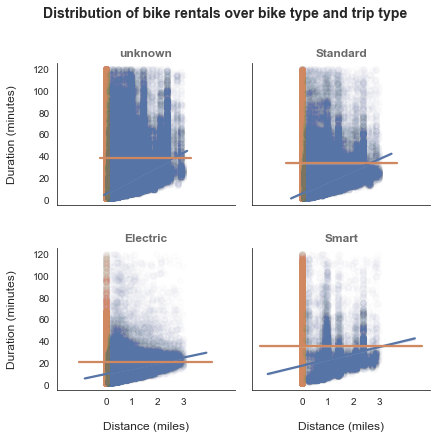

In [714]:
sb.set_palette('deep', n_colors=2, desat=0.8)
current_palette = sb.color_palette()

temp_df = bikeshare.query(' duration_min != 0 and duration_min <= 120 and distance_miles <= 3 ').copy()

# plot facet grid
g = sb.FacetGrid(data = temp_df, col = 'bike_type', col_wrap = 2, height = 3, aspect = 1, hue = 'trip_type')
g.map(sb.regplot, 'distance_miles', 'duration_min', fit_reg = True, scatter_kws = {'alpha' : 1/100})

# improve plot aesthetics
g.fig.subplots_adjust(top=0.85)
g.fig.suptitle('Distribution of bike rentals over bike type and trip type\n', fontsize = 14, weight = 'bold')
g.set_titles('{col_name}', weight = 'bold', size = 12, color = 'dimgrey')
g.set_xlabels('\nDistance (miles)', size = 12)
g.set_ylabels('Duration (minutes)\n', size = 12)

x_tick_locs = np.arange(0, 3+1, 1)
y_tick_locs = np.arange(0, 120+20, 20)
for ax in g.axes.flat:
    plt.yticks(y_tick_locs, y_tick_locs)
    plt.xticks(x_tick_locs, x_tick_locs)

g.set_yticklabels(y_tick_locs, size = 10)
g.set_xticklabels(x_tick_locs, size = 10)
plt.subplots_adjust(wspace=0.1, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.3.11 Facet grid of Trip distances and durations over bike type and trip type.png', dpi=300, bbox_inches='tight')

-----

#### 3.3.12 Multivariate analysis of `duration_min`,`distance_miles`, `pass_type` and `trip_type` columns:

+ `Columns`: duration_min, distance_miles, pass_type, trip_type
+ `Data type`: (Numerical, continuous), (Numerical, continuous), (categorical, nominal), (categorical, nominal)
+ `Plot`: Facet grid, Scatter plot

Limit the dataset to trip durations under `120` minutes and distances under `3` miles for closer observation.

**`lmplot:`**

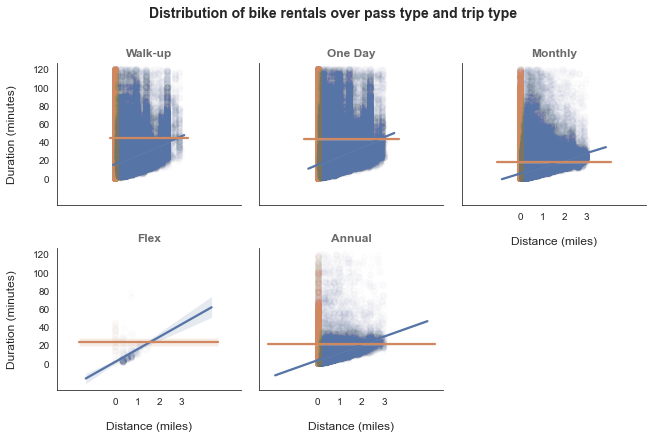

In [715]:
sb.set_palette('deep', n_colors=2, desat=0.8)
current_palette = sb.color_palette()

temp_df = bikeshare.query(' duration_min != 0 and duration_min <= 120 and distance_miles <= 3 ').copy()

# plot facet grid
g = sb.FacetGrid(data = temp_df, col = 'pass_type', col_wrap = 3, height = 3, aspect = 1, hue = 'trip_type')
g.map(sb.regplot, 'distance_miles', 'duration_min', fit_reg = True, scatter_kws = {'alpha' : 1/100})

# improve plot aesthetics
g.fig.subplots_adjust(top=0.85)
g.fig.suptitle('Distribution of bike rentals over pass type and trip type\n', fontsize = 14, weight = 'bold')
g.set_titles('{col_name}', weight = 'bold', size = 12, color = 'dimgrey')
g.set_xlabels('\nDistance (miles)', size = 12)
g.set_ylabels('Duration (minutes)\n', size = 12)

x_tick_locs = np.arange(0, 3+1, 1)
y_tick_locs = np.arange(0, 120+20, 20)
for ax in g.axes.flat:
    plt.yticks(y_tick_locs, y_tick_locs)
    plt.xticks(x_tick_locs, x_tick_locs)

g.set_yticklabels(y_tick_locs, size = 10)
g.set_xticklabels(x_tick_locs, size = 10)
plt.subplots_adjust(wspace=0.1, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.3.12 Facet grid of Trip distances and durations over pass type and trip type.png', dpi=300, bbox_inches='tight')

-----

#### 3.3.13 Multivariate analysis of `duration_min`,`distance_miles`, `bike_type` and `pass_type` columns:

+ `Columns`: duration_min, distance_miles, bike_type, pass_type
+ `Data type`: (Numerical, continuous), (Numerical, continuous), (categorical, nominal), (categorical, nominal)
+ `Plot`: Facet grid, Scatter plot

Limit the dataset to trip durations under `120` minutes and distances under `3` miles for closer observation.

**`lmplot:`**

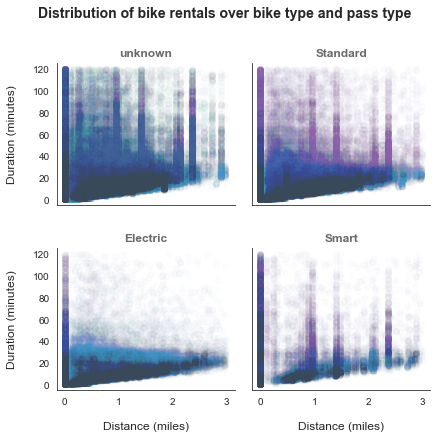

In [716]:
flatui = ["#26bda7", "#9b59b6", "#3498db", "#e74c3c", "#34495e"]
sb.set_palette(flatui, n_colors=5, desat=0.8)

temp_df = bikeshare.query(' duration_min != 0 and duration_min <= 120 and distance_miles <= 3 ').copy()

# plot facet grid
g = sb.FacetGrid(data = temp_df, col = 'bike_type', col_wrap = 2, height = 3, aspect = 1, hue = 'pass_type')
g.map(sb.regplot, 'distance_miles', 'duration_min', fit_reg = False, scatter_kws = {'alpha' : 1/100})

# improve plot aesthetics
g.fig.subplots_adjust(top=0.85)
g.fig.suptitle('Distribution of bike rentals over bike type and pass type\n', fontsize = 14, weight = 'bold')
g.set_titles('{col_name}', weight = 'bold', size = 12, color = 'dimgrey')
g.set_xlabels('\nDistance (miles)', size = 12)
g.set_ylabels('Duration (minutes)\n', size = 12)

plt.subplots_adjust(wspace=0.1, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.3.13.a Facet grid of Trip distances and durations over bike type and pass type.png', dpi=300, bbox_inches='tight')

Plot a regression line for analysis purpose:

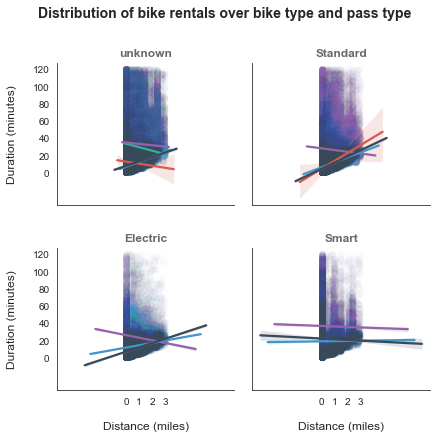

In [717]:
flatui = ["#26bda7", "#9b59b6", "#3498db", "#e74c3c", "#34495e"]
sb.set_palette(flatui, n_colors=5, desat=0.8)

temp_df = bikeshare.query(' duration_min != 0 and duration_min <= 120 and distance_miles <= 3 ').copy()

# plot facet grid
g = sb.FacetGrid(data = temp_df, col = 'bike_type', col_wrap = 2, height = 3, aspect = 1, hue = 'pass_type')
g.map(sb.regplot, 'distance_miles', 'duration_min', fit_reg = True, scatter_kws = {'alpha' : 1/100})

# improve plot aesthetics
g.fig.subplots_adjust(top=0.85)
g.fig.suptitle('Distribution of bike rentals over bike type and pass type\n', fontsize = 14, weight = 'bold')
g.set_titles('{col_name}', weight = 'bold', size = 12, color = 'dimgrey')
g.set_xlabels('\nDistance (miles)', size = 12)
g.set_ylabels('Duration (minutes)\n', size = 12)

x_tick_locs = np.arange(0, 3+1, 1)
y_tick_locs = np.arange(0, 120+20, 20)
for ax in g.axes.flat:
    plt.yticks(y_tick_locs, y_tick_locs)
    plt.xticks(x_tick_locs, x_tick_locs)

g.set_yticklabels(y_tick_locs, size = 10)
g.set_xticklabels(x_tick_locs, size = 10)
plt.subplots_adjust(wspace=0.1, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.3.13.b Facet grid of Trip distances and durations over bike type and pass type with regression.png', dpi=300, bbox_inches='tight')

-----

#### 3.3.14 Multivariate analysis of `duration_min`,`distance_miles`, `bike_type` and `fare_type` columns:

+ `Columns`: duration_min, distance_miles, bike_type, fare_type
+ `Data type`: (Numerical, continuous), (Numerical, continuous), (categorical, nominal), (categorical, nominal)
+ `Plot`: Facet grid, Scatter plot

Limit the dataset to trip durations under `120` minutes and distances under `3` miles for closer observation.

**`lmplot:`**

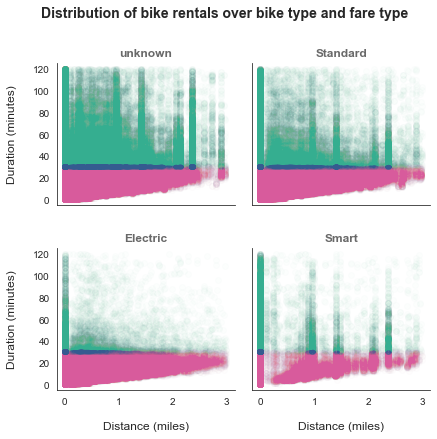

In [718]:
flatui = ["#e74c9c", "#26bd97"]
sb.set_palette(flatui, n_colors=2, desat=0.8)

temp_df = bikeshare.query(' duration_min != 0 and duration_min <= 120 and distance_miles <= 3 ').copy()

# plot facet grid
g = sb.FacetGrid(data = temp_df, col = 'bike_type', col_wrap = 2, height = 3, aspect = 1, hue = 'fare_type')
g.map(sb.regplot, 'distance_miles', 'duration_min', fit_reg = False, scatter_kws = {'alpha' : 1/100})

# improve plot aesthetics
g.fig.subplots_adjust(top=0.85)
g.fig.suptitle('Distribution of bike rentals over bike type and fare type\n', fontsize = 14, weight = 'bold')
g.set_titles('{col_name}', weight = 'bold', size = 12, color = 'dimgrey')
g.set_xlabels('\nDistance (miles)', size = 12)
g.set_ylabels('Duration (minutes)\n', size = 12)

plt.subplots_adjust(wspace=0.1, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.3.14.a Facet grid of Trip distances and durations over bike type and fare type.png', dpi=300, bbox_inches='tight')

Plot a regression line for analysis purpose:

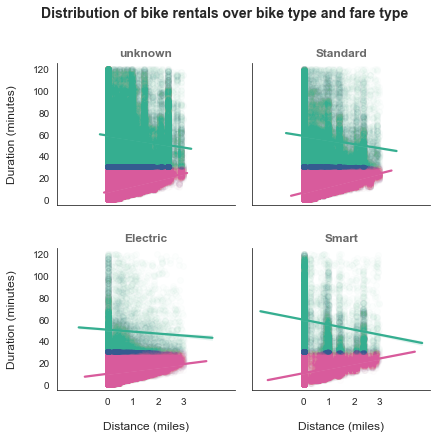

In [719]:
flatui = ["#e74c9c", "#26bd97"]
sb.set_palette(flatui, n_colors=2, desat=0.8)

temp_df = bikeshare.query(' duration_min != 0 and duration_min <= 120 and distance_miles <= 3 ').copy()

# plot facet grid
g = sb.FacetGrid(data = temp_df, col = 'bike_type', col_wrap = 2, height = 3, aspect = 1, hue = 'fare_type')
g.map(sb.regplot, 'distance_miles', 'duration_min', fit_reg = True, scatter_kws = {'alpha' : 1/100} )

# improve plot aesthetics
g.fig.subplots_adjust(top=0.85)
g.fig.suptitle('Distribution of bike rentals over bike type and fare type\n', fontsize = 14, weight = 'bold')
g.set_titles('{col_name}', weight = 'bold', size = 12, color = 'dimgrey')
g.set_xlabels('\nDistance (miles)', size = 12)
g.set_ylabels('Duration (minutes)\n', size = 12)

x_tick_locs = np.arange(0, 3+1, 1)
y_tick_locs = np.arange(0, 120+20, 20)
for ax in g.axes.flat:
    plt.yticks(y_tick_locs, y_tick_locs)
    plt.xticks(x_tick_locs, x_tick_locs)

g.set_yticklabels(y_tick_locs, size = 10)
g.set_xticklabels(x_tick_locs, size = 10)
plt.subplots_adjust(wspace=0.1, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.3.14.b Facet grid of Trip distances and durations over bike type and fare type with regression.png', dpi=300, bbox_inches='tight')

------

#### 3.3.15 Multivariate analysis of `duration_min`,`distance_miles`, `pass_type` and `fare_type` columns:

+ `Columns`: duration_min, distance_miles, pass_type, fare_type
+ `Data type`: (Numerical, continuous), (Numerical, continuous), (categorical, nominal), (categorical, nominal)
+ `Plot`: Facet grid, Scatter plot

Limit the dataset to trip durations under `120` minutes and distances under `3` miles for closer observation.

**`lmplot:`**

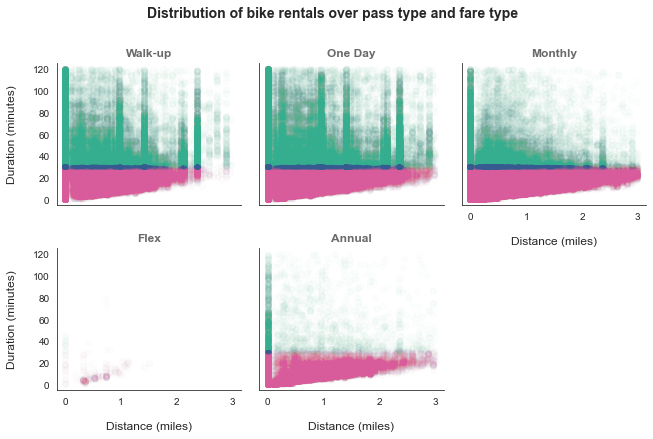

In [720]:
flatui = ["#e74c9c", "#26bd97"]
sb.set_palette(flatui, n_colors=2, desat=0.8)

temp_df = bikeshare.query(' duration_min != 0 and duration_min <= 120 and distance_miles <= 3 ').copy()

# plot facet grid
g = sb.FacetGrid(data = temp_df, col = 'pass_type', col_wrap = 3, height = 3, aspect = 1, hue = 'fare_type')
g.map(sb.regplot, 'distance_miles', 'duration_min', fit_reg = False, scatter_kws = {'alpha' : 1/100})

# improve plot aesthetics
g.fig.subplots_adjust(top=0.85)
g.fig.suptitle('Distribution of bike rentals over pass type and fare type\n', fontsize = 14, weight = 'bold')
g.set_titles('{col_name}', weight = 'bold', size = 12, color = 'dimgrey')
g.set_xlabels('\nDistance (miles)', size = 12)
g.set_ylabels('Duration (minutes)\n', size = 12)

plt.subplots_adjust(wspace=0.1, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.3.15.a Facet grid of Trip distances and durations over pass type and fare type.png', dpi=300, bbox_inches='tight')

Plot a regression line for analysis purpose:

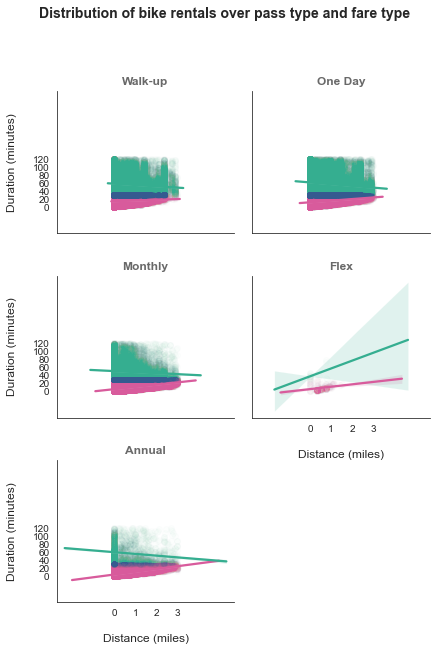

In [721]:
flatui = ["#e74c9c", "#26bd97"]
sb.set_palette(flatui, n_colors=2, desat=0.8)

temp_df = bikeshare.query(' duration_min != 0 and duration_min <= 120 and distance_miles <= 3 ').copy()

# plot facet grid
g = sb.FacetGrid(data = temp_df, col = 'pass_type', col_wrap = 2, height = 3, aspect = 1, hue = 'fare_type')
g.map(sb.regplot, 'distance_miles', 'duration_min', fit_reg = True, scatter_kws = {'alpha' : 1/100} )

# improve plot aesthetics
g.fig.subplots_adjust(top=0.85)
g.fig.suptitle('Distribution of bike rentals over pass type and fare type\n', fontsize = 14, weight = 'bold')
g.set_titles('{col_name}', weight = 'bold', size = 12, color = 'dimgrey')
g.set_xlabels('\nDistance (miles)', size = 12)
g.set_ylabels('Duration (minutes)\n', size = 12)

x_tick_locs = np.arange(0, 3+1, 1)
y_tick_locs = np.arange(0, 120+20, 20)
for ax in g.axes.flat:
    plt.yticks(y_tick_locs, y_tick_locs)
    plt.xticks(x_tick_locs, x_tick_locs)

g.set_yticklabels(y_tick_locs, size = 10)
g.set_xticklabels(x_tick_locs, size = 10)
plt.subplots_adjust(wspace=0.1, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.3.15.b Facet grid of Trip distances and durations over pass type and fare type with regression.png', dpi=300, bbox_inches='tight')

----

#### 3.3.16 Multivariate analysis of `duration_min`,`distance_miles`, `pass_type`, `bike_type` and `trip_type` columns:

+ `Columns`: duration_min, distance_miles, pass_type, fare_type
+ `Data type`: (Numerical, continuous), (Numerical, continuous), (categorical, nominal), (categorical, nominal)
+ `Plot`: Facet grid, Scatter plot

**`lmplot:`**

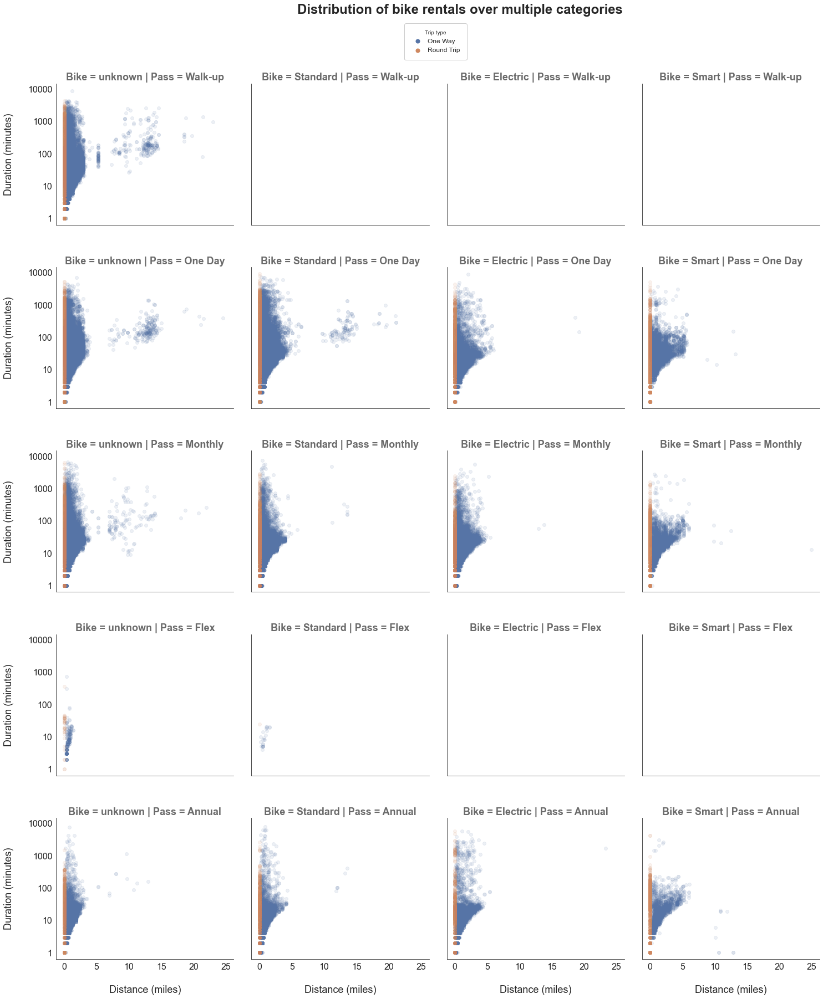

In [722]:
def log_trans(x, inverse = False):
    if not inverse:
        return np.log10(x)
    else:
        return np.power(10, x)


sb.set_palette('deep', n_colors=2, desat=0.8)
current_palette = sb.color_palette()

temp_df = bikeshare.query(' duration_min != 0 ').copy()
temp_df['duration_log'] = temp_df['duration_min'].apply(log_trans)

# plot facet grid
g = sb.lmplot(x='distance_miles', y='duration_log', fit_reg=False, scatter_kws = {'alpha' : 1/10},
              hue='trip_type', col='bike_type', row='pass_type', data=temp_df, legend=False);

# improve plot aesthetics
g.fig.subplots_adjust(top=0.9)
g.fig.suptitle('Distribution of bike rentals over multiple categories\n', fontsize = 24, weight = 'bold')
g.set_titles('Bike = {col_name} | Pass = {row_name}', weight = 'bold', size = 18, color = 'dimgrey')
g.set_xlabels('\nDistance (miles)', size = 18)
g.set_ylabels('Duration (minutes)\n', size = 18)

x_tick_locs = [0, 5, 10, 15, 20, 25]
y_tick_locs = [1, 10, 100, 1000, 10000]
for ax in g.axes.flat:
    plt.yticks(log_trans(y_tick_locs), y_tick_locs)
    plt.xticks(x_tick_locs, x_tick_locs)

g.set_yticklabels(y_tick_locs, size = 16)
g.set_xticklabels(x_tick_locs, size = 16)

# add legend
g.add_legend(scatterpoints=1, frameon=True, fancybox=True, shadow=False, ncol = 1, 
             framealpha = 1, borderpad=1, borderaxespad=1, labelspacing=0.5,  
             title='Trip type', title_fontsize=14, fontsize=12, facecolor='white', 
             markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(0.55, 0.96))
# g._legend.set_title("Trip Type")

for lh in g._legend.legendHandles: 
    lh.set_alpha(1)
    lh._sizes = [50]
    
plt.subplots_adjust(wspace=0.1, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.3.16.a Facet grid of Trip distances and durations over pass type, bike type and trip type.png', dpi=300, bbox_inches='tight')

Add more tranparency to identify the clusters of data.

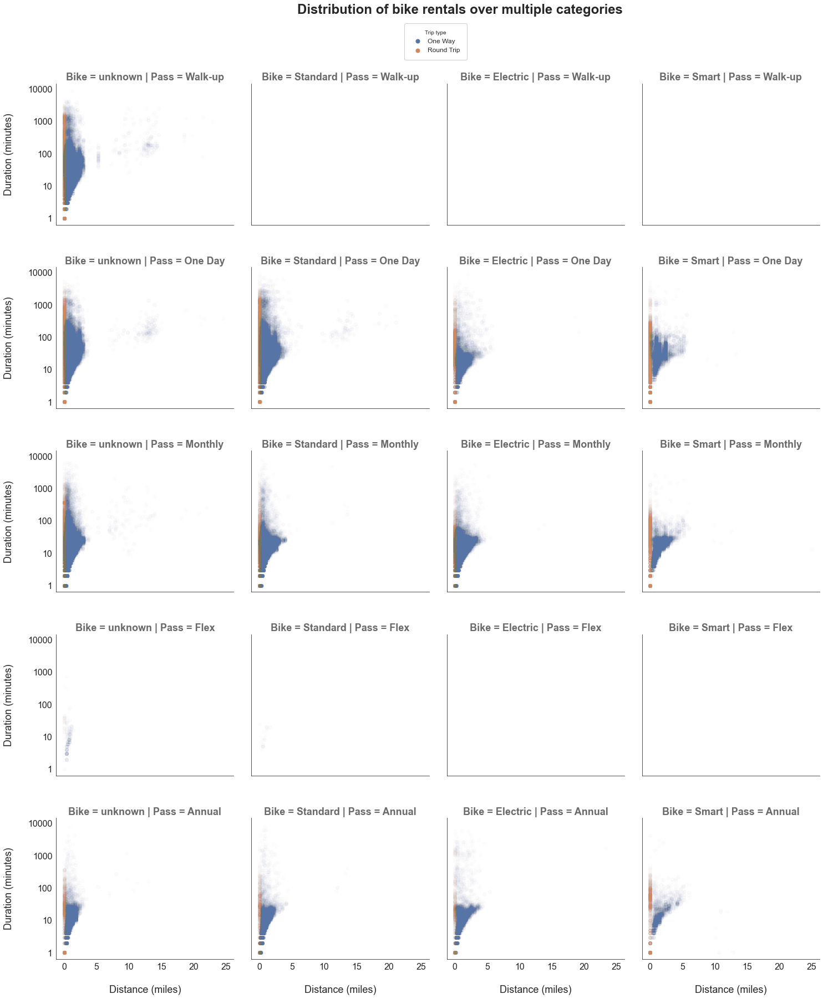

In [723]:
def log_trans(x, inverse = False):
    if not inverse:
        return np.log10(x)
    else:
        return np.power(10, x)


sb.set_palette('deep', n_colors=2, desat=0.8)
current_palette = sb.color_palette()

temp_df = bikeshare.query(' duration_min != 0 ').copy()
temp_df['duration_log'] = temp_df['duration_min'].apply(log_trans)

# plot facet grid
g = sb.lmplot(x='distance_miles', y='duration_log', fit_reg=False, scatter_kws = {'alpha' : 1/100},
              hue='trip_type', col='bike_type', row='pass_type', data=temp_df, legend=False);

# improve plot aesthetics
g.fig.subplots_adjust(top=0.9)
g.fig.suptitle('Distribution of bike rentals over multiple categories\n', fontsize = 24, weight = 'bold')
g.set_titles('Bike = {col_name} | Pass = {row_name}', weight = 'bold', size = 18, color = 'dimgrey')
g.set_xlabels('\nDistance (miles)', size = 18)
g.set_ylabels('Duration (minutes)\n', size = 18)

x_tick_locs = [0, 5, 10, 15, 20, 25]
y_tick_locs = [1, 10, 100, 1000, 10000]
for ax in g.axes.flat:
    plt.yticks(log_trans(y_tick_locs), y_tick_locs)
    plt.xticks(x_tick_locs, x_tick_locs)

g.set_yticklabels(y_tick_locs, size = 16)
g.set_xticklabels(x_tick_locs, size = 16)

# add legend
g.add_legend(scatterpoints=1, frameon=True, fancybox=True, shadow=False, ncol = 1, 
             framealpha = 1, borderpad=1, borderaxespad=1, labelspacing=0.5,  
             title='Trip type', title_fontsize=14, fontsize=12, facecolor='white', 
             markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(0.55, 0.96))
# g._legend.set_title("Trip Type")

for lh in g._legend.legendHandles: 
    lh.set_alpha(1)
    lh._sizes = [50]
    
plt.subplots_adjust(wspace=0.1, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.3.16.b Facet grid of Trip distances and durations over pass type, bike type and trip type.png', dpi=300, bbox_inches='tight')

Limit the dataset to trip durations under `120` minutes and distances under `3` miles for closer observation.

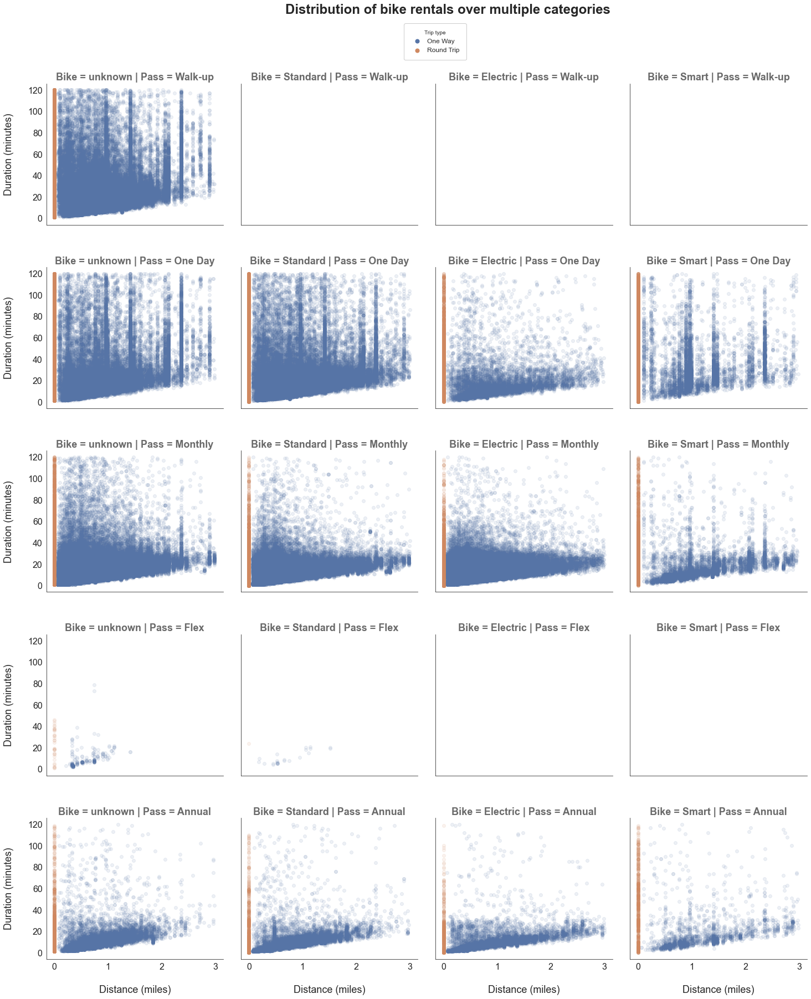

In [724]:
sb.set_palette('deep', n_colors=2, desat=0.8)
current_palette = sb.color_palette()

temp_df = bikeshare.query(' duration_min <= 120 and distance_miles <= 3 ').copy()

# plot facet grid
g = sb.lmplot(x='distance_miles', y='duration_min', fit_reg=False, scatter_kws = {'alpha' : 1/10},
              hue='trip_type', col='bike_type', row='pass_type', data=temp_df, legend=False);

# improve plot aesthetics
g.fig.subplots_adjust(top=0.9)
g.fig.suptitle('Distribution of bike rentals over multiple categories\n', fontsize = 24, weight = 'bold')
g.set_titles('Bike = {col_name} | Pass = {row_name}', weight = 'bold', size = 18, color = 'dimgrey')
g.set_xlabels('\nDistance (miles)', size = 18)
g.set_ylabels('Duration (minutes)\n', size = 18)

x_tick_locs = np.arange(0, 3+1, 1)
y_tick_locs = np.arange(0, 120+20, 20)
for ax in g.axes.flat:
    plt.yticks(y_tick_locs, y_tick_locs)
    plt.xticks(x_tick_locs, x_tick_locs)

g.set_yticklabels(y_tick_locs, size = 16)
g.set_xticklabels(x_tick_locs, size = 16)

# add legend
g.add_legend(scatterpoints=1, frameon=True, fancybox=True, shadow=False, ncol = 1, 
             framealpha = 1, borderpad=1, borderaxespad=1, labelspacing=0.5,  
             title='Trip type', title_fontsize=14, fontsize=12, facecolor='white', 
             markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(0.55, 0.96))
# g._legend.set_title("Trip Type")

for lh in g._legend.legendHandles: 
    lh.set_alpha(1)
    lh._sizes = [50]
    
plt.subplots_adjust(wspace=0.1, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.3.16.c Subset Facet grid of Trip distances and durations over pass type, bike type and trip type.png', dpi=300, bbox_inches='tight')

Add more tranparency to identify the clusters of data.

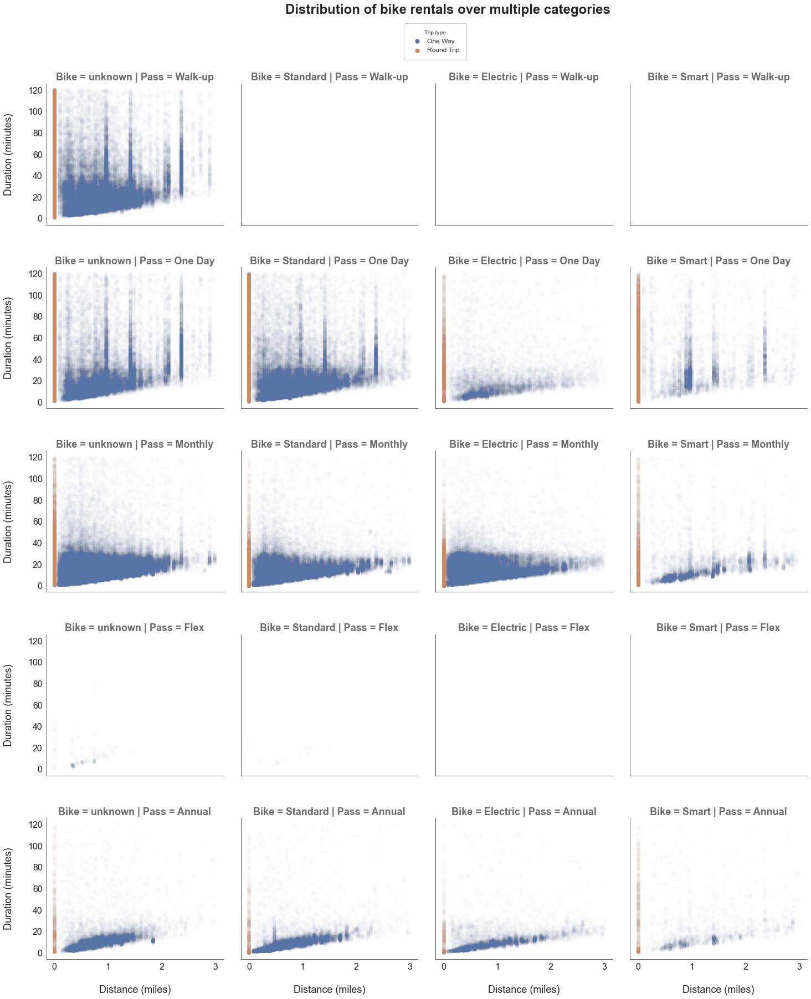

In [725]:
sb.set_palette('deep', n_colors=2, desat=0.8)
current_palette = sb.color_palette()

temp_df = bikeshare.query(' duration_min <= 120 and distance_miles <= 3 ').copy()

# plot facet grid
g = sb.lmplot(x='distance_miles', y='duration_min', fit_reg=False, scatter_kws = {'alpha' : 1/100},
              hue='trip_type', col='bike_type', row='pass_type', data=temp_df, legend=False);

# improve plot aesthetics
g.fig.subplots_adjust(top=0.9)
g.fig.suptitle('Distribution of bike rentals over multiple categories\n', fontsize = 24, weight = 'bold')
g.set_titles('Bike = {col_name} | Pass = {row_name}', weight = 'bold', size = 18, color = 'dimgrey')
g.set_xlabels('\nDistance (miles)', size = 18)
g.set_ylabels('Duration (minutes)\n', size = 18)

x_tick_locs = np.arange(0, 3+1, 1)
y_tick_locs = np.arange(0, 120+20, 20)
for ax in g.axes.flat:
    plt.yticks(y_tick_locs, y_tick_locs)
    plt.xticks(x_tick_locs, x_tick_locs)

g.set_yticklabels(y_tick_locs, size = 16)
g.set_xticklabels(x_tick_locs, size = 16)

# add legend
g.add_legend(scatterpoints=1, frameon=True, fancybox=True, shadow=False, ncol = 1, 
             framealpha = 1, borderpad=1, borderaxespad=1, labelspacing=0.5,  
             title='Trip type', title_fontsize=14, fontsize=12, facecolor='white', 
             markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(0.55, 0.96))
# g._legend.set_title("Trip Type")

for lh in g._legend.legendHandles: 
    lh.set_alpha(1)
    lh._sizes = [50]
    
plt.subplots_adjust(wspace=0.1, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.3.16.d Subset Facet grid of Trip distances and durations over pass type, bike type and trip type.png', dpi=300, bbox_inches='tight')

----

#### 3.3.17 Multivariate analysis of `hour`  and `year` columns:

+ `Columns`: hour, year
+ `Data type`: (Numerical, continuous) and (Categorical, nominal)
+ `Plot`: Point plot

**`Find average rentals based on the hour of the day over years:`**

Create a dataset which contain bike rentals relative to each `hour` in the day over respective months in the year. Care should be taken as to inlcude all hours in every day of the month over individual years. Use all categorical combinations and fill the `NULL values` with numerical zero's so as to consider bike rentals subjected to every hour in any day.

In [818]:
# create a dataset for bike rentals over each hour in a day
hours_df = bikeshare.groupby([bikeshare["year"], 
                              bikeshare["month"],
                              bikeshare["day"],
                              bikeshare["hour"]]).count()['trip_id'].reset_index(name='rentals')

hours_df['rentals'] = hours_df['rentals'].fillna(0).astype(int)
hours_df.head(10)

,year,month,day,hour,rentals
0,2017,1,1,0,9
1,2017,1,1,1,5
2,2017,1,1,2,8
3,2017,1,1,3,2
4,2017,1,1,4,1
5,2017,1,1,5,2
6,2017,1,1,6,1
7,2017,1,1,7,1
8,2017,1,1,8,4
9,2017,1,1,9,5


**`Point plot:`**

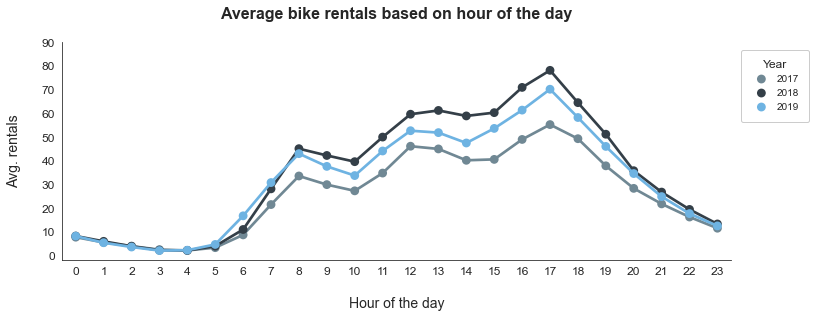

In [819]:
# Assign color palette and figure size as per requirement
plt.figure(figsize=[12,4])
sb.set_style('white')
flatui = ['#6b8a99', '#31404a', '#60b6f0']
sb.set_palette(flatui, n_colors=3, desat=0.8)

# Seaborn's point plot
plot_order = hours_df.hour.sort_values(ascending=True).unique()
sb.pointplot(data = hours_df, x = "hour", y = "rentals", linestyles = "-", 
             hue = 'year', ci = None, order = plot_order)

# improve plot aesthetics
plt.title('Average bike rentals based on hour of the day\n',  weight = 'bold', fontsize = 16)
plt.ylabel('Avg. rentals\n', fontsize = 14)
plt.xlabel('\nHour of the day', fontsize = 14)
plt.xticks(fontsize = 12)

# get ytick locs and rearrage them with respect to zero
locs, labels = plt.yticks()
max_count = locs.max()
y_tick_values = np.arange(0,  max_count+10, 10)
y_tick_names = ['{:0.0f}'.format(v) for v in y_tick_values]
plt.yticks(y_tick_values, y_tick_names, fontsize = 12)

# plot legend
plt.legend(scatterpoints=1, frameon=True, fancybox=True, shadow=False, ncol = 1, framealpha = 1, 
           borderpad=1, borderaxespad=1, bbox_to_anchor = (1, 0.8), loc = 6, labelspacing=0.5,  
           title='Year', title_fontsize=12, fontsize=10, facecolor='white', markerfirst=True, 
           handlelength=2, handletextpad=0.5)

sb.despine(top=True, right=True, left=False, bottom=False);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.3.17 Average bike rentals based on hour of the day over years.png', dpi=300, bbox_inches='tight')

----

#### 3.3.18 Multivariate analysis of `daytime`  and `year` columns:

+ `Columns`: daytime, year
+ `Data type`: (Categorical, nominal) and (Categorical, nominal)
+ `Plot`: Point plot

**`Find average rentals based on the daytime of the day over years:`**

Create a dataset which contain bike rentals relative to each `daytime` in the day over respective months in the year. Care should be taken as to inlcude all daytimes in every day of the month over individual years. Use all categorical combinations and fill the `NULL values` with numerical zero's so as to consider bike rentals subjected to every daytime in any day.

In [820]:
# create a dataset for bike rentals over each daytime in a day
daytime_df = bikeshare.groupby([bikeshare["year"], 
                                bikeshare["month"],
                                bikeshare["day"],
                                bikeshare["daytime"]]).count()['trip_id'].reset_index(name='rentals')

daytime_df['rentals'] = daytime_df['rentals'].fillna(0).astype(int)
daytime_df.head(10)

,year,month,day,daytime,rentals
0,2017,1,1,Early hours,27
1,2017,1,1,Morning,35
2,2017,1,1,Afternoon,143
3,2017,1,1,Evening,50
4,2017,1,1,Night,15
5,2017,1,2,Early hours,4
6,2017,1,2,Morning,50
7,2017,1,2,Afternoon,145
8,2017,1,2,Evening,44
9,2017,1,2,Night,16


**`Point plot:`**

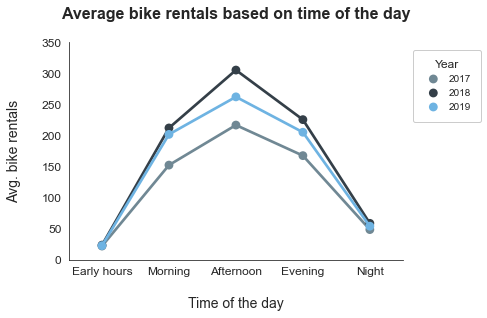

In [821]:
# Assign color palette and figure size as per requirement
plt.figure(figsize=[6,4])
sb.set_style('white')
flatui = ['#6b8a99', '#31404a', '#60b6f0']
sb.set_palette(flatui, n_colors=3, desat=0.8)

# Seaborn's point plot
plot_order = daytime_df.daytime.sort_values(ascending=True).unique()
sb.pointplot(data = daytime_df, x = "daytime", y = "rentals", linestyles = "-", 
             hue = 'year', ci = None, order = plot_order)

# improve plot aesthetics
plt.title('Average bike rentals based on time of the day\n',  weight = 'bold', fontsize = 16)
plt.ylabel('Avg. bike rentals\n', fontsize = 14)
plt.xlabel('\nTime of the day', fontsize = 14)
plt.xticks(fontsize = 12)

# get ytick locs and rearrage them with respect to zero
locs, labels = plt.yticks()
max_count = locs.max()
y_tick_values = np.arange(0,  max_count+50, 50)
y_tick_names = ['{:0.0f}'.format(v) for v in y_tick_values]
plt.yticks(y_tick_values, y_tick_names, fontsize = 12)

# plot legend
plt.legend(scatterpoints=1, frameon=True, fancybox=True, shadow=False, ncol = 1, framealpha = 1, 
           borderpad=1, borderaxespad=1, bbox_to_anchor = (1, 0.8), loc = 6, labelspacing=0.5,  
           title='Year', title_fontsize=12, fontsize=10, facecolor='white', markerfirst=True, 
           handlelength=2, handletextpad=0.5)

sb.despine(top=True, right=True, left=False, bottom=False);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.3.18 Average bike rentals based on daytime of the day over years.png', dpi=300, bbox_inches='tight')

----

#### 3.3.19 Multivariate analysis of `weekday`  and `year` columns:

+ `Columns`: weekday, year
+ `Data type`: (Categorical, nominal) and (Categorical, nominal)
+ `Plot`: Point plot

**`Find average rentals based on the weekday of each week in a month over years:`**

Create a dataset which contain bike rentals relative to `weekday` of each week in the month over respective years. Care should be taken as to inlcude all weekdays in every week of the month over individual years. Use all categorical combinations and fill the `NULL values` with numerical zero's so as to consider bike rentals subjected to every weekday in any week.

In [822]:
# create a dataset for bike rentals over each weekday in a week
weekday_df = bikeshare.groupby([bikeshare["year"], 
                                bikeshare["month"],
                                bikeshare["week"],
                                bikeshare["weekday"]]).count()['trip_id'].reset_index(name='rentals')

weekday_df['rentals'] = weekday_df['rentals'].fillna(0).astype(int)
weekday_df.head(10)

,year,month,week,weekday,rentals
0,2017,1,First,Monday,259
1,2017,1,First,Tuesday,327
2,2017,1,First,Wednesday,350
3,2017,1,First,Thursday,231
4,2017,1,First,Friday,361
5,2017,1,First,Saturday,277
6,2017,1,First,Sunday,270
7,2017,1,Second,Monday,306
8,2017,1,Second,Tuesday,245
9,2017,1,Second,Wednesday,315


**`Point plot:`**

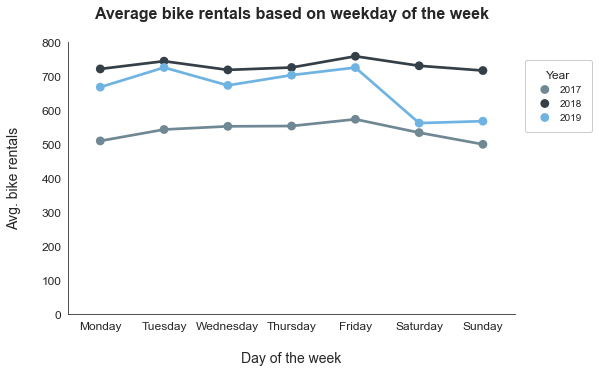

In [823]:
# Assign color palette and figure size as per requirement
plt.figure(figsize=[8,5])
sb.set_style('white')
flatui = ['#6b8a99', '#31404a', '#60b6f0']
sb.set_palette(flatui, n_colors=3, desat=0.8)

# Seaborn's point plot
plot_order = weekday_df.weekday.sort_values(ascending=True).unique()
sb.pointplot(data = weekday_df, x = "weekday", y = "rentals", linestyles = "-", 
             hue = 'year', ci = None, order = plot_order)

# improve plot aesthetics
plt.title('Average bike rentals based on weekday of the week\n',  weight = 'bold', fontsize = 16)
plt.ylabel('Avg. bike rentals\n', fontsize = 14)
plt.xlabel('\nDay of the week', fontsize = 14)
plt.xticks(fontsize = 12)

# get ytick locs and rearrage them with respect to zero
locs, labels = plt.yticks()
max_count = locs.max()
y_tick_values = np.arange(0,  max_count+100, 100)
y_tick_names = ['{:0.0f}'.format(v) for v in y_tick_values]
plt.yticks(y_tick_values, y_tick_names, fontsize = 12)

# plot legend
plt.legend(scatterpoints=1, frameon=True, fancybox=True, shadow=False, ncol = 1, framealpha = 1, 
           borderpad=1, borderaxespad=1, bbox_to_anchor = (1, 0.8), loc = 6, labelspacing=0.5,  
           title='Year', title_fontsize=12, fontsize=10, facecolor='white', markerfirst=True, 
           handlelength=2, handletextpad=0.5)

sb.despine(top=True, right=True, left=False, bottom=False);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.3.19 Average bike rentals based on day of the week over years.png', dpi=300, bbox_inches='tight')

----

#### 3.3.20 Multivariate analysis of `day`  and `year` columns:

+ `Columns`: day, year
+ `Data type`: (Categorical, ordered) and (Categorical, nominal)
+ `Plot`: Point plot

**`Find average rentals based on the day of the month over years:`**

Create a dataset which contain bike rentals relative to `day` of each month over respective years. Care should be taken as to inlcude only the days related to each month over individual years. Use only available categorical combinations and do not fill the `NULL values` with numerical zero's so as to consider bike rentals subjected to respective day in any month.

In [824]:
# create a dataset for bike rentals over each day in a month
days_df = bikeshare.groupby([bikeshare["year"], 
                             bikeshare["month"],
                             bikeshare["day"]]).count()['trip_id'].reset_index(name='rentals')
days_df.head(10)

,year,month,day,rentals
0,2017,1,1,270
1,2017,1,2,259
2,2017,1,3,327
3,2017,1,4,350
4,2017,1,5,231
5,2017,1,6,361
6,2017,1,7,277
7,2017,1,8,417
8,2017,1,9,306
9,2017,1,10,245


**`Point plot:`**

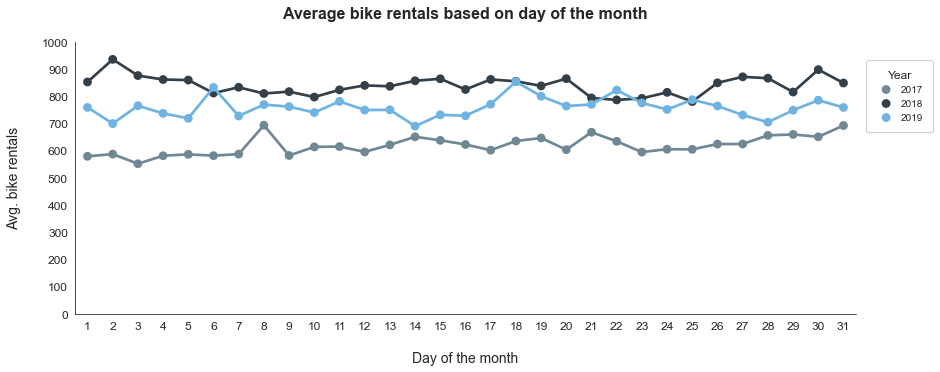

In [825]:
# Assign color palette and figure size as per requirement
plt.figure(figsize=[14,5])
sb.set_style('white')
flatui = ['#6b8a99', '#31404a', '#60b6f0']
sb.set_palette(flatui, n_colors=3, desat=0.8)

# Seaborn's point plot
plot_order = days_df.day.sort_values(ascending=True).unique()
sb.pointplot(data = days_df, x = "day", y = "rentals", linestyles = "-", 
             hue = 'year', ci = None, order = plot_order)

# improve plot aesthetics
plt.title('Average bike rentals based on day of the month\n',  weight = 'bold', fontsize = 16)
plt.ylabel('Avg. bike rentals\n', fontsize = 14)
plt.xlabel('\nDay of the month', fontsize = 14)
plt.xticks(fontsize = 12)

# get ytick locs and rearrage them with respect to zero
locs, labels = plt.yticks()
max_count = locs.max()
y_tick_values = np.arange(0,  max_count+100, 100)
y_tick_names = ['{:0.0f}'.format(v) for v in y_tick_values]
plt.yticks(y_tick_values, y_tick_names, fontsize = 12)

# plot legend
plt.legend(scatterpoints=1, frameon=True, fancybox=True, shadow=False, ncol = 1, framealpha = 1, 
           borderpad=1, borderaxespad=1, bbox_to_anchor = (1, 0.8), loc = 6, labelspacing=0.5,  
           title='Year', title_fontsize=12, fontsize=10, facecolor='white', markerfirst=True, 
           handlelength=2, handletextpad=0.5)

sb.despine(top=True, right=True, left=False, bottom=False);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.3.20 Average bike rentals based on day of the month over years.png', dpi=300, bbox_inches='tight')

----

#### 3.3.21 Multivariate analysis of `month`  and `year` columns:

+ `Columns`: month, year
+ `Data type`: (Categorical, ordered) and (Categorical, nominal)
+ `Plot`: Point plot

**`Find average rentals based on the month over years:`**

Create a dataset which contain bike rentals relative to each `month` over respective years. Care should be taken as to inlcude all the rentals related to each month over individual years. Use all categorical combinations and fill the `NULL values` with numerical zero's so as to consider bike rentals subjected to respective month in any year.

In [826]:
# create a dataset for bike rentals over each month in a year
month_df = bikeshare.groupby([bikeshare["year"], 
                                bikeshare["month"]]).count()['trip_id'].reset_index(name='rentals')

month_df['rentals'] = month_df['rentals'].fillna(0).astype(int)
month_df.head(10)

,year,month,rentals
0,2017,1,10156
1,2017,2,9368
2,2017,3,13674
3,2017,4,13635
4,2017,5,19024
5,2017,6,18440
6,2017,7,21723
7,2017,8,24866
8,2017,9,24953
9,2017,10,27176


**`Point plot:`**

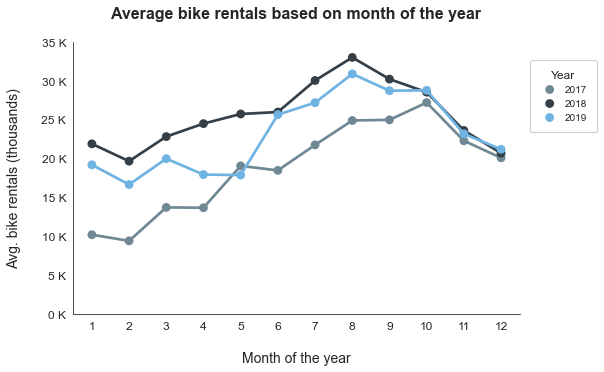

In [827]:
# Assign color palette and figure size as per requirement
plt.figure(figsize=[8,5])
sb.set_style('white')
flatui = ['#6b8a99', '#31404a', '#60b6f0']
sb.set_palette(flatui, n_colors=3, desat=0.8)

# Seaborn's point plot
plot_order = month_df.month.sort_values(ascending=True).unique()
sb.pointplot(data = month_df, x = "month", y = "rentals", linestyles = "-", 
             hue = 'year', ci = None, order = plot_order)

# improve plot aesthetics
plt.title('Average bike rentals based on month of the year\n',  weight = 'bold', fontsize = 16)
plt.ylabel('Avg. bike rentals (thousands)\n', fontsize = 14)
plt.xlabel('\nMonth of the year', fontsize = 14)
plt.xticks(fontsize = 12)

# get ytick locs and rearrage them with respect to zero
locs, labels = plt.yticks()
max_count = locs.max()
y_tick_values = np.arange(0,  max_count+5000, 5000)
y_tick_names = ['{:0.0f} K'.format(v/1000) for v in y_tick_values]
plt.yticks(y_tick_values, y_tick_names, fontsize = 12)

# plot legend
plt.legend(scatterpoints=1, frameon=True, fancybox=True, shadow=False, ncol = 1, framealpha = 1, 
           borderpad=1, borderaxespad=1, bbox_to_anchor = (1, 0.8), loc = 6, labelspacing=0.5,  
           title='Year', title_fontsize=12, fontsize=10, facecolor='white', markerfirst=True, 
           handlelength=2, handletextpad=0.5)

sb.despine(top=True, right=True, left=False, bottom=False);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.3.21 Average bike rentals based on the month over years.png', dpi=300, bbox_inches='tight')

----

#### 3.3.22 Multivariate analysis of `quarter`  and `year` columns:

+ `Columns`: quarter, year
+ `Data type`: (Categorical, ordered) and (Categorical, nominal)
+ `Plot`: Point plot

**`Find average rentals based on the quarter of the year:`**

Create a dataset which contain bike rentals relative to each `quarter` over respective years. Care should be taken as to inlcude all the rentals related to each quarter over individual years. Use all categorical combinations and fill the `NULL values` with numerical zero's so as to consider bike rentals subjected to respective quarter in any year.

In [828]:
# create a dataset for bike rentals over each quarter in a year
quarter_df = bikeshare.groupby([bikeshare["year"], 
                                bikeshare["quarter"]]).count()['trip_id'].reset_index(name='rentals')

quarter_df['rentals'] = quarter_df['rentals'].fillna(0).astype(int)
quarter_df.head(10)

,year,quarter,rentals
0,2017,Q1,33198
1,2017,Q2,51099
2,2017,Q3,71542
3,2017,Q4,69492
4,2018,Q1,64281
5,2018,Q2,76124
6,2018,Q3,93199
7,2018,Q4,72763
8,2019,Q1,55731
9,2019,Q2,61365


**`Point plot:`**

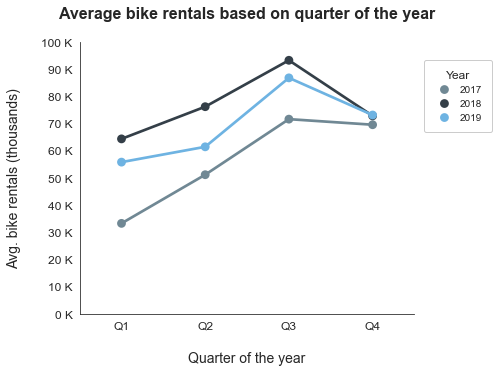

In [829]:
# Assign color palette and figure size as per requirement
plt.figure(figsize=[6,5])
sb.set_style('white')
flatui = ['#6b8a99', '#31404a', '#60b6f0']
sb.set_palette(flatui, n_colors=3, desat=0.8)

# Seaborn's point plot
plot_order = quarter_df.quarter.sort_values(ascending=True).unique()
sb.pointplot(data = quarter_df, x = "quarter", y = "rentals", linestyles = "-", 
             hue = 'year', ci = None, order = plot_order)

# improve plot aesthetics
plt.title('Average bike rentals based on quarter of the year\n',  weight = 'bold', fontsize = 16)
plt.ylabel('Avg. bike rentals (thousands)\n', fontsize = 14)
plt.xlabel('\nQuarter of the year', fontsize = 14)
plt.xticks(fontsize = 12)

# get ytick locs and rearrage them with respect to zero
locs, labels = plt.yticks()
max_count = locs.max()
y_tick_values = np.arange(0,  max_count+10000, 10000)
y_tick_names = ['{:0.0f} K'.format(v/1000) for v in y_tick_values]
plt.yticks(y_tick_values, y_tick_names, fontsize = 12)

# plot legend
plt.legend(scatterpoints=1, frameon=True, fancybox=True, shadow=False, ncol = 1, framealpha = 1, 
           borderpad=1, borderaxespad=1, bbox_to_anchor = (1, 0.8), loc = 6, labelspacing=0.5,  
           title='Year', title_fontsize=12, fontsize=10, facecolor='white', markerfirst=True, 
           handlelength=2, handletextpad=0.5)

sb.despine(top=True, right=True, left=False, bottom=False);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.3.22 Average bike rentals based on the quarter over years.png', dpi=300, bbox_inches='tight')

----

#### 3.3.23 Multivariate analysis of `hour`, `year`  and `trip_type` columns:

+ `Columns`: hour, year, trip_type
+ `Data type`: (numerical, continuous), (Categorical, ordered) and (Categorical, nominal)
+ `Plot`: Point plot

**`Find average rentals based on the hour of the year:`**

Create a dataset which contain bike rentals relative to each `hour` in the day over respective months in the year. Care should be taken as to inlcude only hours that appear in every day of the month over individual years. Use available categorical combinations and do not fill the `NULL` values with numerical zero's so as to consider bike rentals subjected to every hour in any day.

In [830]:
# create a dataset for bike rentals over each hour in a day
hours_df = bikeshare.groupby([bikeshare["year"], 
                              bikeshare["month"],
                              bikeshare["day"],
                              bikeshare["hour"],
                              bikeshare["trip_type"]]).count()['trip_id'].reset_index(name='rentals')
hours_df.head(10)

,year,month,day,hour,trip_type,rentals
0,2017,1,1,0,One Way,6.0
1,2017,1,1,0,Round Trip,3.0
2,2017,1,1,1,One Way,5.0
3,2017,1,1,1,Round Trip,NaN
4,2017,1,1,2,One Way,8.0
5,2017,1,1,2,Round Trip,NaN
6,2017,1,1,3,One Way,2.0
7,2017,1,1,3,Round Trip,NaN
8,2017,1,1,4,One Way,1.0
9,2017,1,1,4,Round Trip,NaN


**`Point plot:`**

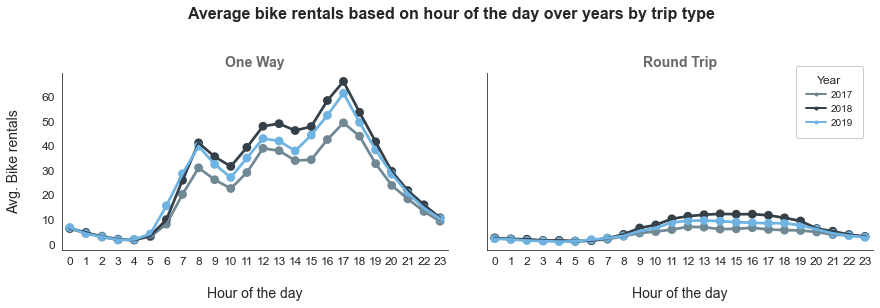

In [831]:
# Assign palette as per requirement
sb.set_style('white')
flatui = ['#6b8a99', '#31404a', '#60b6f0']
sb.set_palette(flatui, n_colors=3, desat=0.8)

# Seaborn's point plot
plot_order = hours_df.hour.sort_values(ascending=True).unique()
g = sb.FacetGrid(data = hours_df, col = 'trip_type', col_wrap = 2, height = 4, aspect = 1.5, hue = 'year')
g.map(sb.pointplot, "hour", "rentals", order= plot_order, linestyles = "-", ci = None);

g.fig.subplots_adjust(top=0.75)
g.fig.suptitle('Average bike rentals based on hour of the day over years by trip type', fontsize = 16, weight = 'bold')
g.set_titles('{col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# improve plot aesthetics
g.set_xticklabels(plot_order, size = 12)
g.set_yticklabels(size = 12)
g.set_xlabels('\nHour of the day', size = 14)
g.set_ylabels('Avg. Bike rentals\n', size = 14)
plt.subplots_adjust(wspace=0.1, hspace=0.3);

# add custom legend
custom = [Line2D([], [], marker='.', color=sb.color_palette()[0], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[1], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[2], linestyle='-', linewidth = 2)]

plt.legend(custom, ['2017', '2018', '2019'], scatterpoints=1, frameon=True, fancybox=True, 
           shadow=False, framealpha = 1, borderpad=1, borderaxespad=1, labelspacing=0.5, 
           ncol = 1, title='Year', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(1, 1.1));

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.3.23 Average bike rentals based on hour of the day over years by trip type.png', dpi=300, bbox_inches='tight')

----

#### 3.3.24 Multivariate analysis of `daytime`, `year`  and `trip_type` columns:

+ `Columns`: daytime, year, trip_type
+ `Data type`: (Categorical, ordered), (Categorical, ordered) and (Categorical, nominal)
+ `Plot`: Point plot

**`Find average rentals based on the daytime of the day over years:`**

Create a dataset which contain bike rentals relative to each `daytime` in the day over respective months in the year. Care should be taken as to inlcude only daytimes that appear in every day of the month over individual years. Use available categorical combinations and do not fill the `NULL` values with numerical zero's so as to consider bike rentals subjected to every daytime in any day.

In [832]:
# create a dataset for bike rentals over each daytime in a day
daytime_df = bikeshare.groupby([bikeshare["year"], 
                              bikeshare["month"],
                              bikeshare["day"],
                              bikeshare["daytime"],
                              bikeshare["trip_type"]]).count()['trip_id'].reset_index(name='rentals')
daytime_df.head(10)

,year,month,day,daytime,trip_type,rentals
0,2017,1,1,Early hours,One Way,24.0
1,2017,1,1,Early hours,Round Trip,3.0
2,2017,1,1,Morning,One Way,33.0
3,2017,1,1,Morning,Round Trip,2.0
4,2017,1,1,Afternoon,One Way,122.0
5,2017,1,1,Afternoon,Round Trip,21.0
6,2017,1,1,Evening,One Way,37.0
7,2017,1,1,Evening,Round Trip,13.0
8,2017,1,1,Night,One Way,12.0
9,2017,1,1,Night,Round Trip,3.0


**`Point plot:`**

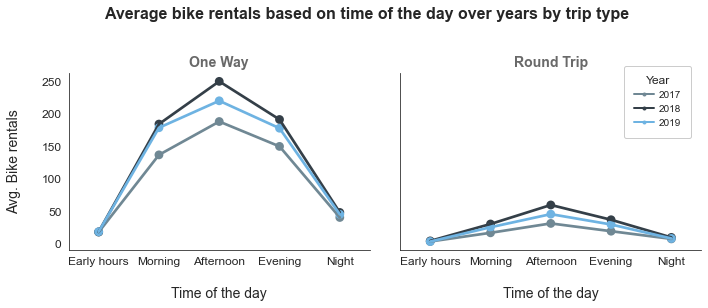

In [833]:
# Assign palette as per requirement
sb.set_style('white')
flatui = ['#6b8a99', '#31404a', '#60b6f0']
sb.set_palette(flatui, n_colors=3, desat=0.8)

# Seaborn's point plot
plot_order = daytime_df.daytime.sort_values(ascending=True).unique()
g = sb.FacetGrid(data = daytime_df, col = 'trip_type', col_wrap = 2, height = 4, aspect = 1.2, hue = 'year')
g.map(sb.pointplot, "daytime", "rentals", order= plot_order, linestyles = "-", ci = None);

g.fig.subplots_adjust(top=0.75)
g.fig.suptitle('Average bike rentals based on time of the day over years by trip type', fontsize = 16, weight = 'bold')
g.set_titles('{col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# improve plot aesthetics
g.set_xticklabels(plot_order, size = 12)
g.set_yticklabels(size = 12)
g.set_xlabels('\nTime of the day', size = 14)
g.set_ylabels('Avg. Bike rentals\n', size = 14)
plt.subplots_adjust(wspace=0.1, hspace=0.3);

# add custom legend
custom = [Line2D([], [], marker='.', color=sb.color_palette()[0], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[1], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[2], linestyle='-', linewidth = 2)]

plt.legend(custom, ['2017', '2018', '2019'], scatterpoints=1, frameon=True, fancybox=True, 
           shadow=False, framealpha = 1, borderpad=1, borderaxespad=1, labelspacing=0.5, 
           ncol = 1, title='Year', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(1, 1.1));

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.3.24 Average bike rentals based on time of the day over years by trip type.png', dpi=300, bbox_inches='tight')

----

#### 3.3.25 Multivariate analysis of `day`, `year`  and `trip_type` columns:

+ `Columns`: day, year, trip_type
+ `Data type`: (Categorical, ordered), (Categorical, ordered) and (Categorical, nominal)
+ `Plot`: Point plot

**`Find average rentals based on the day of the month over years:`**

Create a dataset which contain bike rentals relative to each `day` over respective months in the year. Care should be taken as to inlcude only days that appear in every month over individual years. Use available categorical combinations and do not fill the `NULL` values with numerical zero's so as to consider bike rentals subjected to every day in any month.

In [834]:
# create a dataset for bike rentals over each day in a month
days_df = bikeshare.groupby([bikeshare["year"], 
                             bikeshare["month"],
                             bikeshare["day"],
                             bikeshare["trip_type"]]).count()['trip_id'].reset_index(name='rentals')
days_df.head(10)

,year,month,day,trip_type,rentals
0,2017,1,1,One Way,228.0
1,2017,1,1,Round Trip,42.0
2,2017,1,2,One Way,228.0
3,2017,1,2,Round Trip,31.0
4,2017,1,3,One Way,288.0
5,2017,1,3,Round Trip,39.0
6,2017,1,4,One Way,325.0
7,2017,1,4,Round Trip,25.0
8,2017,1,5,One Way,211.0
9,2017,1,5,Round Trip,20.0


**`Point plot:`**

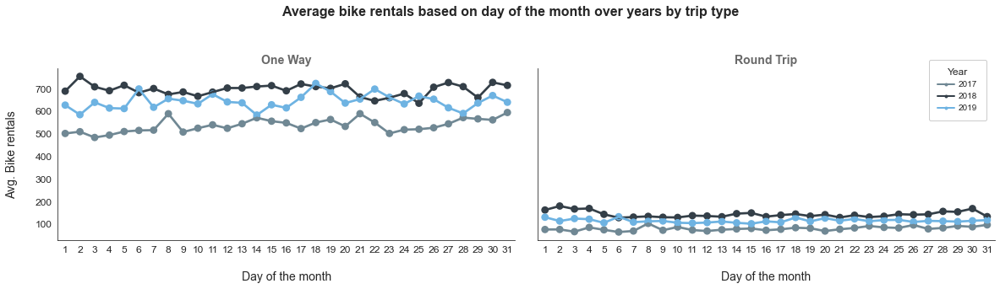

In [835]:
# Assign palette as per requirement
sb.set_style('white')
flatui = ['#6b8a99', '#31404a', '#60b6f0']
sb.set_palette(flatui, n_colors=3, desat=0.8)

# Seaborn's point plot
plot_order = days_df.day.sort_values(ascending=True).unique()
g = sb.FacetGrid(data = days_df, col = 'trip_type', col_wrap = 2, height = 4.5, aspect = 1.8, hue = 'year')
g.map(sb.pointplot, "day", "rentals", order= plot_order, linestyles = "-", ci = None);

g.fig.subplots_adjust(top=0.75)
g.fig.suptitle('Average bike rentals based on day of the month over years by trip type', fontsize = 16, weight = 'bold')
g.set_titles('{col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# improve plot aesthetics
g.set_xticklabels(plot_order, size = 12)
g.set_yticklabels(size = 12)
g.set_xlabels('\nDay of the month', size = 14)
g.set_ylabels('Avg. Bike rentals\n', size = 14)
plt.subplots_adjust(wspace=0.05, hspace=0.3);

# add custom legend
custom = [Line2D([], [], marker='.', color=sb.color_palette()[0], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[1], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[2], linestyle='-', linewidth = 2)]

plt.legend(custom, ['2017', '2018', '2019'], scatterpoints=1, frameon=True, fancybox=True, 
           shadow=False, framealpha = 1, borderpad=1, borderaxespad=1, labelspacing=0.5, 
           ncol = 1, title='Year', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(1, 1.1));

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.3.25 Average bike rentals based on day of the month over years by trip type.png', dpi=300, bbox_inches='tight')

----

#### 3.3.26 Multivariate analysis of `weekday`, `year`  and `trip_type` columns:

+ `Columns`: weekday, year, trip_type
+ `Data type`: (Categorical, ordered), (Categorical, ordered) and (Categorical, nominal)
+ `Plot`: Point plot

**`Find average rentals based on the day of the week over years:`**

Create a dataset which contain bike rentals relative to each `day` over respective week in the month. Care should be taken as to inlcude only days that appear in every week over individual months. Use available categorical combinations and do not fill the `NULL` values with numerical zero's so as to consider bike rentals subjected to every day in any week.

In [836]:
# create a dataset for bike rentals over each day in a week
weekday_df = bikeshare.groupby([bikeshare["year"], 
                                bikeshare["month"],
                                bikeshare["week"],
                                bikeshare["weekday"],
                                bikeshare["trip_type"]]).count()['trip_id'].reset_index(name='rentals')
weekday_df.head(10)

,year,month,week,weekday,trip_type,rentals
0,2017,1,First,Monday,One Way,228.0
1,2017,1,First,Monday,Round Trip,31.0
2,2017,1,First,Tuesday,One Way,288.0
3,2017,1,First,Tuesday,Round Trip,39.0
4,2017,1,First,Wednesday,One Way,325.0
5,2017,1,First,Wednesday,Round Trip,25.0
6,2017,1,First,Thursday,One Way,211.0
7,2017,1,First,Thursday,Round Trip,20.0
8,2017,1,First,Friday,One Way,325.0
9,2017,1,First,Friday,Round Trip,36.0


**`Point plot:`**

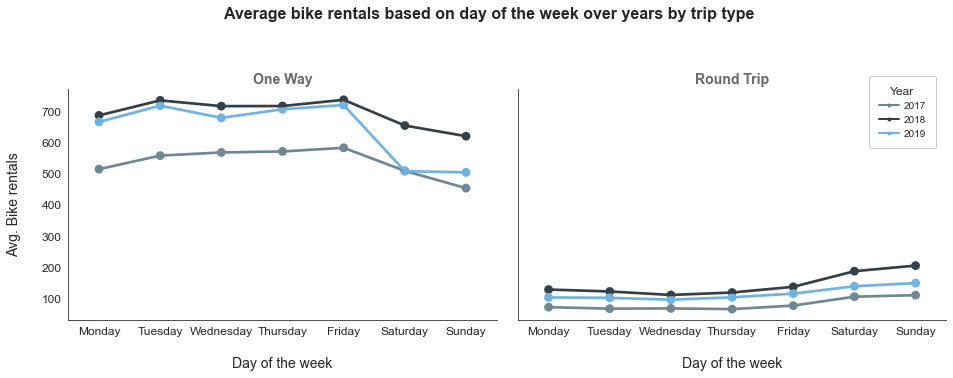

In [837]:
# Assign palette as per requirement
sb.set_style('white')
flatui = ['#6b8a99', '#31404a', '#60b6f0']
sb.set_palette(flatui, n_colors=3, desat=0.8)

# Seaborn's point plot
plot_order = weekday_df.weekday.sort_values(ascending=True).unique()
g = sb.FacetGrid(data = weekday_df, col = 'trip_type', col_wrap = 2, height = 5, aspect = 1.3, hue = 'year')
g.map(sb.pointplot, "weekday", "rentals", order= plot_order, linestyles = "-", ci = None);

g.fig.subplots_adjust(top=0.75)
g.fig.suptitle('Average bike rentals based on day of the week over years by trip type', fontsize = 16, weight = 'bold')
g.set_titles('{col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# improve plot aesthetics
g.set_xticklabels(plot_order, size = 12)
g.set_yticklabels(size = 12)
g.set_xlabels('\nDay of the week', size = 14)
g.set_ylabels('Avg. Bike rentals\n', size = 14)
plt.subplots_adjust(wspace=0.05, hspace=0.3);

# add custom legend
custom = [Line2D([], [], marker='.', color=sb.color_palette()[0], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[1], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[2], linestyle='-', linewidth = 2)]

plt.legend(custom, ['2017', '2018', '2019'], scatterpoints=1, frameon=True, fancybox=True, 
           shadow=False, framealpha = 1, borderpad=1, borderaxespad=1, labelspacing=0.5, 
           ncol = 1, title='Year', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(1, 1.1));

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.3.26 Average bike rentals based on day of the week over years by trip type.png', dpi=300, bbox_inches='tight')

----

#### 3.3.27 Multivariate analysis of `month`, `year`  and `trip_type` columns:

+ `Columns`: month, year, trip_type
+ `Data type`: (Categorical, ordered), (Categorical, ordered) and (Categorical, nominal)
+ `Plot`: Point plot

**`Find average rentals based on the month over years:`**

Create a dataset which contain bike rentals relative to each `month` over respective years. Care should be taken as to inlcude only rentals that appear in every month over individual years. Use available categorical combinations and do not fill the `NULL` values with numerical zero's so as to consider bike rentals subjected to every month in any year.

In [838]:
# create a dataset for bike rentals over each month in a year
month_df = bikeshare.groupby([bikeshare["year"], 
                              bikeshare["month"],
                              bikeshare["trip_type"]]).count()['trip_id'].reset_index(name='rentals')
month_df.head(10)

,year,month,trip_type,rentals
0,2017,1,One Way,9195
1,2017,1,Round Trip,961
2,2017,2,One Way,8557
3,2017,2,Round Trip,811
4,2017,3,One Way,12305
5,2017,3,Round Trip,1369
6,2017,4,One Way,12311
7,2017,4,Round Trip,1324
8,2017,5,One Way,17320
9,2017,5,Round Trip,1704


**`Point plot:`**

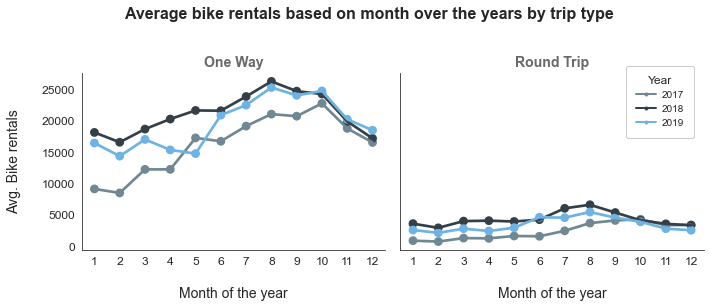

In [839]:
# Assign palette as per requirement
sb.set_style('white')
flatui = ['#6b8a99', '#31404a', '#60b6f0']
sb.set_palette(flatui, n_colors=3, desat=0.8)

# Seaborn's point plot
plot_order = month_df.month.sort_values(ascending=True).unique()
g = sb.FacetGrid(data = month_df, col = 'trip_type', col_wrap = 2, height = 4, aspect = 1.2, hue = 'year')
g.map(sb.pointplot, "month", "rentals", order= plot_order, linestyles = "-", ci = None);

g.fig.subplots_adjust(top=0.75)
g.fig.suptitle('Average bike rentals based on month over the years by trip type', fontsize = 16, weight = 'bold')
g.set_titles('{col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# improve plot aesthetics
g.set_xticklabels(plot_order, size = 12)
g.set_yticklabels(size = 12)
g.set_xlabels('\nMonth of the year', size = 14)
g.set_ylabels('Avg. Bike rentals\n', size = 14)
plt.subplots_adjust(wspace=0.05, hspace=0.3);

# add custom legend
custom = [Line2D([], [], marker='.', color=sb.color_palette()[0], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[1], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[2], linestyle='-', linewidth = 2)]

plt.legend(custom, ['2017', '2018', '2019'], scatterpoints=1, frameon=True, fancybox=True, 
           shadow=False, framealpha = 1, borderpad=1, borderaxespad=1, labelspacing=0.5, 
           ncol = 1, title='Year', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(1, 1.1));

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.3.27 Average bike rentals based on month over the years by trip type.png', dpi=300, bbox_inches='tight')

----

#### 3.3.28 Multivariate analysis of `quarter`, `year`  and `trip_type` columns:

+ `Columns`: quarter, year, trip_type
+ `Data type`: (Categorical, ordered), (Categorical, ordered) and (Categorical, nominal)
+ `Plot`: Point plot

**`Find average rentals based on the quarter over years:`**

Create a dataset which contain bike rentals relative to each `quarter` over respective years. Care should be taken as to inlcude only rentals that appear in every quarter over individual years. Use available categorical combinations and do not fill the `NULL` values with numerical zero's so as to consider bike rentals subjected to every quarter in any year.

In [840]:
# create a dataset for bike rentals over each quarter in a year
quarter_df = bikeshare.groupby([bikeshare["year"], 
                                bikeshare["quarter"],
                                bikeshare["trip_type"]]).count()['trip_id'].reset_index(name='rentals')
quarter_df.head(10)

,year,quarter,trip_type,rentals
0,2017,Q1,One Way,30057
1,2017,Q1,Round Trip,3141
2,2017,Q2,One Way,46415
3,2017,Q2,Round Trip,4684
4,2017,Q3,One Way,61084
5,2017,Q3,Round Trip,10458
6,2017,Q4,One Way,58243
7,2017,Q4,Round Trip,11249
8,2018,Q1,One Way,53542
9,2018,Q1,Round Trip,10739


**`Point plot:`**

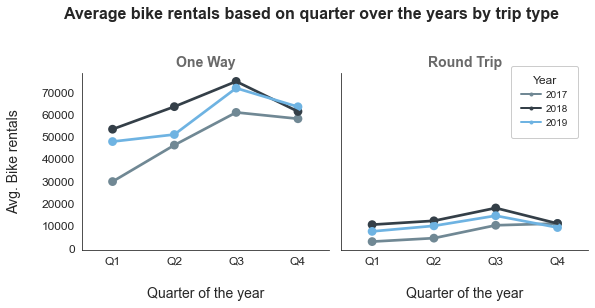

In [841]:
# Assign palette as per requirement
sb.set_style('white')
flatui = ['#6b8a99', '#31404a', '#60b6f0']
sb.set_palette(flatui, n_colors=3, desat=0.8)

# Seaborn's point plot
plot_order = quarter_df.quarter.sort_values(ascending=True).unique()
g = sb.FacetGrid(data = quarter_df, col = 'trip_type', col_wrap = 2, height = 4, aspect = 1, hue = 'year')
g.map(sb.pointplot, "quarter", "rentals", order= plot_order, linestyles = "-", ci = None);

g.fig.subplots_adjust(top=0.75)
g.fig.suptitle('Average bike rentals based on quarter over the years by trip type', fontsize = 16, weight = 'bold')
g.set_titles('{col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# improve plot aesthetics
g.set_xticklabels(plot_order, size = 12)
g.set_yticklabels(size = 12)
g.set_xlabels('\nQuarter of the year', size = 14)
g.set_ylabels('Avg. Bike rentals\n', size = 14)
plt.subplots_adjust(wspace=0.05, hspace=0.3);

# add custom legend
custom = [Line2D([], [], marker='.', color=sb.color_palette()[0], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[1], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[2], linestyle='-', linewidth = 2)]

plt.legend(custom, ['2017', '2018', '2019'], scatterpoints=1, frameon=True, fancybox=True, 
           shadow=False, framealpha = 1, borderpad=1, borderaxespad=1, labelspacing=0.5, 
           ncol = 1, title='Year', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(1, 1.1));

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.3.28 Average bike rentals based on quarter over the years by trip type.png', dpi=300, bbox_inches='tight')

----

#### 3.3.29 Multivariate analysis of `hour`, `year`  and `bike_type` columns:

+ `Columns`: hour, year, bike_type
+ `Data type`: (numerical, continuous), (Categorical, ordered) and (Categorical, nominal)
+ `Plot`: Point plot

**`Find average rentals based on the hour of the year:`**

Create a dataset which contain bike rentals relative to each `hour` in the day over respective months in the year. Care should be taken as to inlcude only hours that appear in every day of the month over individual years. Use available categorical combinations and do not fill the `NULL` values with numerical zero's so as to consider bike rentals subjected to every hour in any day.

In [842]:
# create a dataset for bike rentals over each hour in a day
hours_df = bikeshare.groupby([bikeshare["year"], 
                              bikeshare["month"],
                              bikeshare["day"],
                              bikeshare["hour"],
                              bikeshare["bike_type"]]).count()['trip_id'].reset_index(name='rentals')
hours_df.head(10)

,year,month,day,hour,bike_type,rentals
0,2017,1,1,0,unknown,9.0
1,2017,1,1,0,Standard,NaN
2,2017,1,1,0,Electric,NaN
3,2017,1,1,0,Smart,NaN
4,2017,1,1,1,unknown,5.0
5,2017,1,1,1,Standard,NaN
6,2017,1,1,1,Electric,NaN
7,2017,1,1,1,Smart,NaN
8,2017,1,1,2,unknown,8.0
9,2017,1,1,2,Standard,NaN


**`Point plot:`**

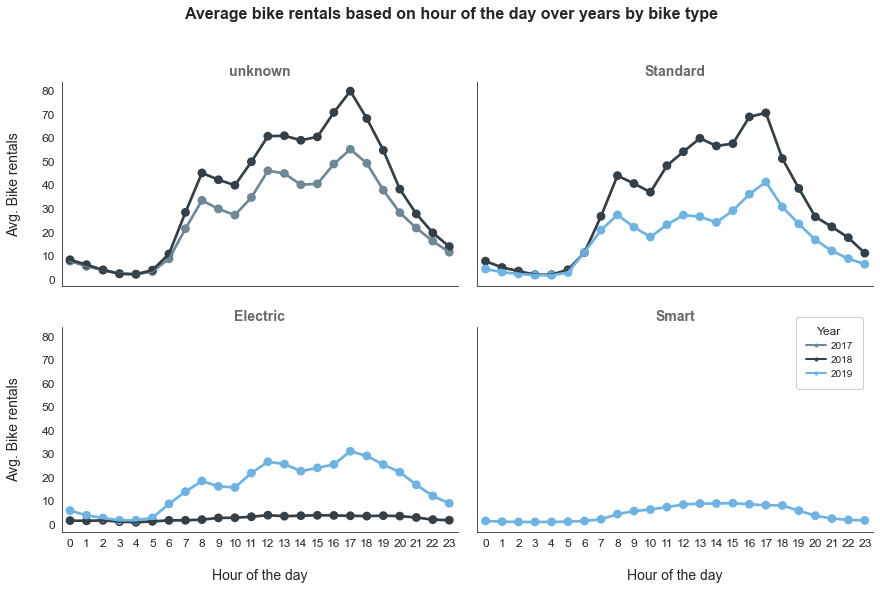

In [843]:
# Assign palette as per requirement
sb.set_style('white')
flatui = ['#6b8a99', '#31404a', '#60b6f0']
sb.set_palette(flatui, n_colors=3, desat=0.8)

# Seaborn's point plot
plot_order = hours_df.hour.sort_values(ascending=True).unique()
g = sb.FacetGrid(data = hours_df, col = 'bike_type', col_wrap = 2, height = 4, aspect = 1.5, hue = 'year')
g.map(sb.pointplot, "hour", "rentals", order= plot_order, linestyles = "-", ci = None);

g.fig.subplots_adjust(top=0.85)
g.fig.suptitle('Average bike rentals based on hour of the day over years by bike type', fontsize = 16, weight = 'bold')
g.set_titles('{col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# improve plot aesthetics
g.set_xticklabels(plot_order, size = 12)
g.set_yticklabels(size = 12)
g.set_xlabels('\nHour of the day', size = 14)
g.set_ylabels('Avg. Bike rentals\n', size = 14)
plt.subplots_adjust(wspace=0.05, hspace=0.2);

# add custom legend
custom = [Line2D([], [], marker='.', color=sb.color_palette()[0], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[1], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[2], linestyle='-', linewidth = 2)]

plt.legend(custom, ['2017', '2018', '2019'], scatterpoints=1, frameon=True, fancybox=True, 
           shadow=False, framealpha = 1, borderpad=1, borderaxespad=1, labelspacing=0.5, 
           ncol = 1, title='Year', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(1, 1.1));

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.3.29 Average bike rentals based on hour of the day over years by bike type.png', dpi=300, bbox_inches='tight')

----

#### 3.3.30 Multivariate analysis of `daytime`, `year`  and `bike_type` columns:

+ `Columns`: daytime, year, bike_type
+ `Data type`: (Categorical, ordered), (Categorical, ordered) and (Categorical, nominal)
+ `Plot`: Point plot

**`Find average rentals based on the daytime of the day over years:`**

Create a dataset which contain bike rentals relative to each `daytime` in the day over respective months in the year. Care should be taken as to inlcude only daytimes that appear in every day of the month over individual years. Use available categorical combinations and do not fill the `NULL` values with numerical zero's so as to consider bike rentals subjected to every daytime in any day.

In [844]:
# create a dataset for bike rentals over each daytime in a day
daytime_df = bikeshare.groupby([bikeshare["year"], 
                                bikeshare["month"],
                                bikeshare["day"],
                                bikeshare["daytime"],
                                bikeshare["bike_type"]]).count()['trip_id'].reset_index(name='rentals')
daytime_df.head(10)

,year,month,day,daytime,bike_type,rentals
0,2017,1,1,Early hours,unknown,27.0
1,2017,1,1,Early hours,Standard,NaN
2,2017,1,1,Early hours,Electric,NaN
3,2017,1,1,Early hours,Smart,NaN
4,2017,1,1,Morning,unknown,35.0
5,2017,1,1,Morning,Standard,NaN
6,2017,1,1,Morning,Electric,NaN
7,2017,1,1,Morning,Smart,NaN
8,2017,1,1,Afternoon,unknown,143.0
9,2017,1,1,Afternoon,Standard,NaN


**`Point plot:`**

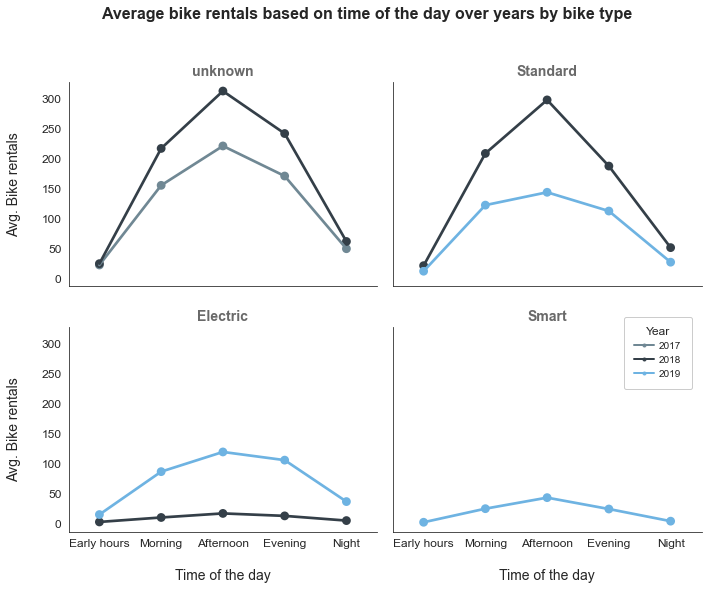

In [845]:
# Assign palette as per requirement
sb.set_style('white')
flatui = ['#6b8a99', '#31404a', '#60b6f0']
sb.set_palette(flatui, n_colors=3, desat=0.8)

# Seaborn's point plot
plot_order = daytime_df.daytime.sort_values(ascending=True).unique()
g = sb.FacetGrid(data = daytime_df, col = 'bike_type', col_wrap = 2, height = 4, aspect = 1.2, hue = 'year')
g.map(sb.pointplot, "daytime", "rentals", order= plot_order, linestyles = "-", ci = None);

g.fig.subplots_adjust(top=0.85)
g.fig.suptitle('Average bike rentals based on time of the day over years by bike type', fontsize = 16, weight = 'bold')
g.set_titles('{col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# improve plot aesthetics
g.set_xticklabels(plot_order, size = 12)
g.set_yticklabels(size = 12)
g.set_xlabels('\nTime of the day', size = 14)
g.set_ylabels('Avg. Bike rentals\n', size = 14)
plt.subplots_adjust(wspace=0.05, hspace=0.2);

# add custom legend
custom = [Line2D([], [], marker='.', color=sb.color_palette()[0], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[1], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[2], linestyle='-', linewidth = 2)]

plt.legend(custom, ['2017', '2018', '2019'], scatterpoints=1, frameon=True, fancybox=True, 
           shadow=False, framealpha = 1, borderpad=1, borderaxespad=1, labelspacing=0.5, 
           ncol = 1, title='Year', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(1, 1.1));

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.3.30 Average bike rentals based on time of the day over years by bike type.png', dpi=300, bbox_inches='tight')

----

#### 3.3.31 Multivariate analysis of `day`, `year`  and `bike_type` columns:

+ `Columns`: day, year, bike_type
+ `Data type`: (Categorical, ordered), (Categorical, ordered) and (Categorical, nominal)
+ `Plot`: Point plot

**`Find average rentals based on the day of the month over years:`**

Create a dataset which contain bike rentals relative to each `day` over respective months in the year. Care should be taken as to inlcude only days that appear in every month over individual years. Use available categorical combinations and do not fill the `NULL` values with numerical zero's so as to consider bike rentals subjected to every day in any month.

In [846]:
# create a dataset for bike rentals over each day in a month
days_df = bikeshare.groupby([bikeshare["year"], 
                             bikeshare["month"],
                             bikeshare["day"],
                             bikeshare["bike_type"]]).count()['trip_id'].reset_index(name='rentals')
days_df.head(10)

,year,month,day,bike_type,rentals
0,2017,1,1,unknown,270.0
1,2017,1,1,Standard,NaN
2,2017,1,1,Electric,NaN
3,2017,1,1,Smart,NaN
4,2017,1,2,unknown,259.0
5,2017,1,2,Standard,NaN
6,2017,1,2,Electric,NaN
7,2017,1,2,Smart,NaN
8,2017,1,3,unknown,327.0
9,2017,1,3,Standard,NaN


**`Point plot:`**

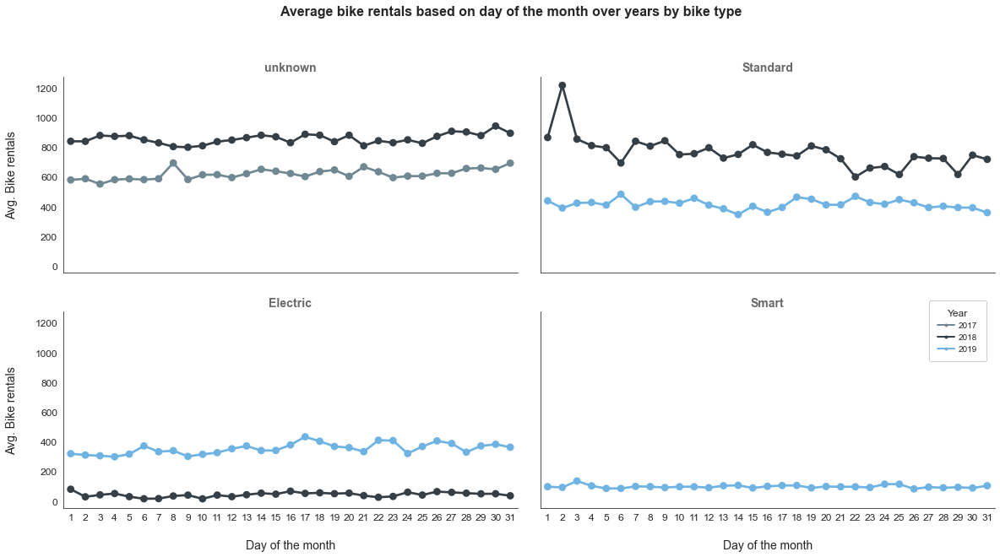

In [847]:
# Assign palette as per requirement
sb.set_style('white')
flatui = ['#6b8a99', '#31404a', '#60b6f0']
sb.set_palette(flatui, n_colors=3, desat=0.8)

# Seaborn's point plot
plot_order = days_df.day.sort_values(ascending=True).unique()
g = sb.FacetGrid(data = days_df, col = 'bike_type', col_wrap = 2, height = 4.5, aspect = 1.8, hue = 'year')
g.map(sb.pointplot, "day", "rentals", order= plot_order, linestyles = "-", ci = None);

g.fig.subplots_adjust(top=0.85)
g.fig.suptitle('Average bike rentals based on day of the month over years by bike type', fontsize = 16, weight = 'bold')
g.set_titles('{col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# improve plot aesthetics
g.set_xticklabels(plot_order, size = 12)
g.set_yticklabels(size = 12)
g.set_xlabels('\nDay of the month', size = 14)
g.set_ylabels('Avg. Bike rentals\n', size = 14)
plt.subplots_adjust(wspace=0.05, hspace=0.2);

# add custom legend
custom = [Line2D([], [], marker='.', color=sb.color_palette()[0], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[1], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[2], linestyle='-', linewidth = 2)]

plt.legend(custom, ['2017', '2018', '2019'], scatterpoints=1, frameon=True, fancybox=True, 
           shadow=False, framealpha = 1, borderpad=1, borderaxespad=1, labelspacing=0.5, 
           ncol = 1, title='Year', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(1, 1.1));

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.3.31 Average bike rentals based on day of the month over years by bike type.png', dpi=300, bbox_inches='tight')

----

#### 3.3.32 Multivariate analysis of `weekday`, `year`  and `bike_type` columns:

+ `Columns`: weekday, year, bike_type
+ `Data type`: (Categorical, ordered), (Categorical, ordered) and (Categorical, nominal)
+ `Plot`: Point plot

**`Find average rentals based on the day of the week over years:`**

Create a dataset which contain bike rentals relative to each `day` over respective week in the month. Care should be taken as to inlcude only days that appear in every week over individual months. Use available categorical combinations and do not fill the `NULL` values with numerical zero's so as to consider bike rentals subjected to every day in any week.

In [848]:
# create a dataset for bike rentals over each day in a week
weekday_df = bikeshare.groupby([bikeshare["year"], 
                                bikeshare["month"],
                                bikeshare["week"],
                                bikeshare["weekday"],
                                bikeshare["bike_type"]]).count()['trip_id'].reset_index(name='rentals')
weekday_df.head(10)

,year,month,week,weekday,bike_type,rentals
0,2017,1,First,Monday,unknown,259.0
1,2017,1,First,Monday,Standard,NaN
2,2017,1,First,Monday,Electric,NaN
3,2017,1,First,Monday,Smart,NaN
4,2017,1,First,Tuesday,unknown,327.0
5,2017,1,First,Tuesday,Standard,NaN
6,2017,1,First,Tuesday,Electric,NaN
7,2017,1,First,Tuesday,Smart,NaN
8,2017,1,First,Wednesday,unknown,350.0
9,2017,1,First,Wednesday,Standard,NaN


**`Point plot:`**

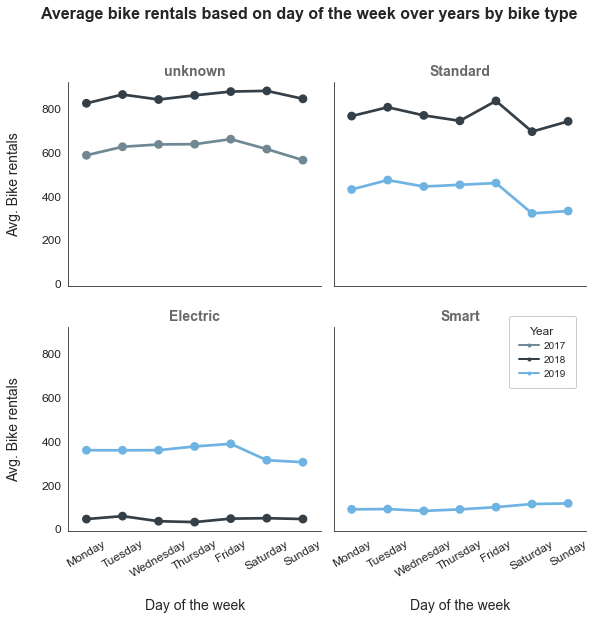

In [849]:
# Assign palette as per requirement
sb.set_style('white')
flatui = ['#6b8a99', '#31404a', '#60b6f0']
sb.set_palette(flatui, n_colors=3, desat=0.8)

# Seaborn's point plot
plot_order = weekday_df.weekday.sort_values(ascending=True).unique()
g = sb.FacetGrid(data = weekday_df, col = 'bike_type', col_wrap = 2, height = 4, aspect = 1, hue = 'year')
g.map(sb.pointplot, "weekday", "rentals", order= plot_order, linestyles = "-", ci = None);

g.fig.subplots_adjust(top=0.85)
g.fig.suptitle('Average bike rentals based on day of the week over years by bike type', fontsize = 16, weight = 'bold')
g.set_titles('{col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# improve plot aesthetics
g.set_xticklabels(plot_order, rotation = 30, size = 12)
g.set_yticklabels(size = 12)
g.set_xlabels('\nDay of the week', size = 14)
g.set_ylabels('Avg. Bike rentals\n', size = 14)
plt.subplots_adjust(wspace=0.05, hspace=0.2);

# add custom legend
custom = [Line2D([], [], marker='.', color=sb.color_palette()[0], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[1], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[2], linestyle='-', linewidth = 2)]

plt.legend(custom, ['2017', '2018', '2019'], scatterpoints=1, frameon=True, fancybox=True, 
           shadow=False, framealpha = 1, borderpad=1, borderaxespad=1, labelspacing=0.5, 
           ncol = 1, title='Year', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(1, 1.1));

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.3.32 Average bike rentals based on day of the week over years by bike type.png', dpi=300, bbox_inches='tight')

----

#### 3.3.33 Multivariate analysis of `month`, `year`  and `bike_type` columns:

+ `Columns`: month, year, bike_type
+ `Data type`: (Categorical, ordered), (Categorical, ordered) and (Categorical, nominal)
+ `Plot`: Point plot

**`Find average rentals based on the month over years:`**

Create a dataset which contain bike rentals relative to each `month` over respective years. Care should be taken as to inlcude only rentals that appear in every month over individual years. Use available categorical combinations and do not fill the `NULL` values with numerical zero's so as to consider bike rentals subjected to every month in any year.

In [850]:
# create a dataset for bike rentals over each month in a year
month_df = bikeshare.groupby([bikeshare["year"], 
                              bikeshare["month"],
                              bikeshare["bike_type"]]).count()['trip_id'].reset_index(name='rentals')
month_df.head(10)

,year,month,bike_type,rentals
0,2017,1,unknown,10156.0
1,2017,1,Standard,NaN
2,2017,1,Electric,NaN
3,2017,1,Smart,NaN
4,2017,2,unknown,9368.0
5,2017,2,Standard,NaN
6,2017,2,Electric,NaN
7,2017,2,Smart,NaN
8,2017,3,unknown,13674.0
9,2017,3,Standard,NaN


**`Point plot:`**

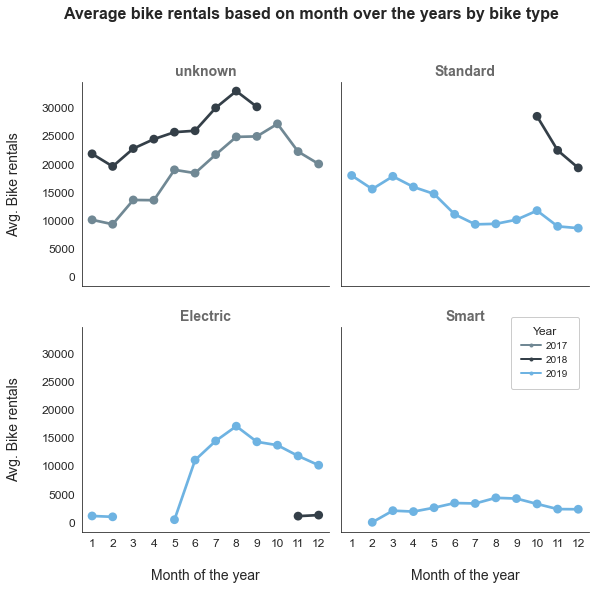

In [851]:
# Assign palette as per requirement
sb.set_style('white')
flatui = ['#6b8a99', '#31404a', '#60b6f0']
sb.set_palette(flatui, n_colors=3, desat=0.8)

# Seaborn's point plot
plot_order = month_df.month.sort_values(ascending=True).unique()
g = sb.FacetGrid(data = month_df, col = 'bike_type', col_wrap = 2, height = 4, aspect = 1, hue = 'year')
g.map(sb.pointplot, "month", "rentals", order= plot_order, linestyles = "-", ci = None);

g.fig.subplots_adjust(top=0.85)
g.fig.suptitle('Average bike rentals based on month over the years by bike type', fontsize = 16, weight = 'bold')
g.set_titles('{col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# improve plot aesthetics
g.set_xticklabels(plot_order, size = 12)
g.set_yticklabels(size = 12)
g.set_xlabels('\nMonth of the year', size = 14)
g.set_ylabels('Avg. Bike rentals\n', size = 14)
plt.subplots_adjust(wspace=0.05, hspace=0.2);

# add custom legend
custom = [Line2D([], [], marker='.', color=sb.color_palette()[0], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[1], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[2], linestyle='-', linewidth = 2)]

plt.legend(custom, ['2017', '2018', '2019'], scatterpoints=1, frameon=True, fancybox=True, 
           shadow=False, framealpha = 1, borderpad=1, borderaxespad=1, labelspacing=0.5, 
           ncol = 1, title='Year', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(1, 1.1));

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.3.33 Average bike rentals based on month over the years by bike type.png', dpi=300, bbox_inches='tight')

----

#### 3.3.34 Multivariate analysis of `quarter`, `year`  and `bike_type` columns:

+ `Columns`: quarter, year, bike_type
+ `Data type`: (Categorical, ordered), (Categorical, ordered) and (Categorical, nominal)
+ `Plot`: Point plot

**`Find average rentals based on the quarter over years:`**

Create a dataset which contain bike rentals relative to each `quarter` over respective years. Care should be taken as to inlcude only rentals that appear in every quarter over individual years. Use available categorical combinations and do not fill the `NULL` values with numerical zero's so as to consider bike rentals subjected to every quarter in any year.

In [852]:
# create a dataset for bike rentals over each quarter in a year
quarter_df = bikeshare.groupby([bikeshare["year"], 
                                bikeshare["quarter"],
                                bikeshare["bike_type"]]).count()['trip_id'].reset_index(name='rentals')
quarter_df.head(10)

,year,quarter,bike_type,rentals
0,2017,Q1,unknown,33198.0
1,2017,Q1,Standard,NaN
2,2017,Q1,Electric,NaN
3,2017,Q1,Smart,NaN
4,2017,Q2,unknown,51099.0
5,2017,Q2,Standard,NaN
6,2017,Q2,Electric,NaN
7,2017,Q2,Smart,NaN
8,2017,Q3,unknown,71542.0
9,2017,Q3,Standard,NaN


**`Point plot:`**

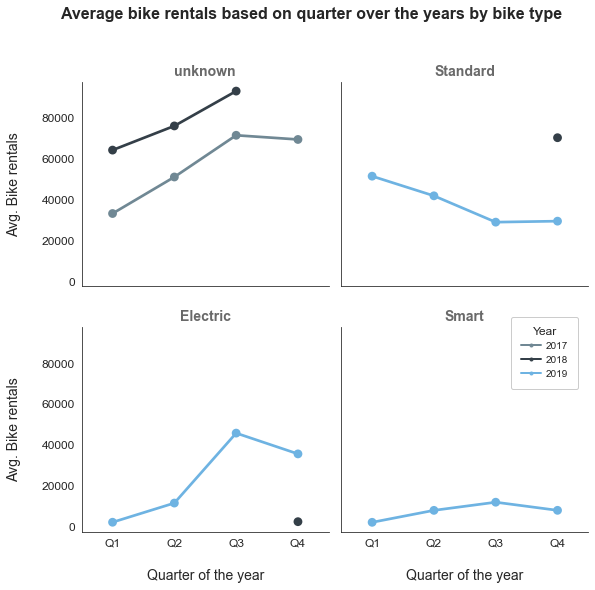

In [853]:
# Assign palette as per requirement
sb.set_style('white')
flatui = ['#6b8a99', '#31404a', '#60b6f0']
sb.set_palette(flatui, n_colors=3, desat=0.8)

# Seaborn's point plot
plot_order = quarter_df.quarter.sort_values(ascending=True).unique()
g = sb.FacetGrid(data = quarter_df, col = 'bike_type', col_wrap = 2, height = 4, aspect = 1, hue = 'year')
g.map(sb.pointplot, "quarter", "rentals", order= plot_order, linestyles = "-", ci = None);

g.fig.subplots_adjust(top=0.85)
g.fig.suptitle('Average bike rentals based on quarter over the years by bike type', fontsize = 16, weight = 'bold')
g.set_titles('{col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# improve plot aesthetics
g.set_xticklabels(plot_order, size = 12)
g.set_yticklabels(size = 12)
g.set_xlabels('\nQuarter of the year', size = 14)
g.set_ylabels('Avg. Bike rentals\n', size = 14)
plt.subplots_adjust(wspace=0.05, hspace=0.2);

# add custom legend
custom = [Line2D([], [], marker='.', color=sb.color_palette()[0], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[1], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[2], linestyle='-', linewidth = 2)]

plt.legend(custom, ['2017', '2018', '2019'], scatterpoints=1, frameon=True, fancybox=True, 
           shadow=False, framealpha = 1, borderpad=1, borderaxespad=1, labelspacing=0.5, 
           ncol = 1, title='Year', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(1, 1.1));

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.3.34 Average bike rentals based on quarter over the years by bike type.png', dpi=300, bbox_inches='tight')

----

#### 3.3.35 Multivariate analysis of `hour`, `year`  and `pass_type` columns:

+ `Columns`: hour, year, pass_type
+ `Data type`: (numerical, continuous), (Categorical, ordered) and (Categorical, nominal)
+ `Plot`: Point plot

**`Find average rentals based on the hour of the year:`**

Create a dataset which contain bike rentals relative to each `hour` in the day over respective months in the year. Care should be taken as to inlcude only hours that appear in every day of the month over individual years. Use available categorical combinations and do not fill the `NULL` values with numerical zero's so as to consider bike rentals subjected to every hour in any day.

In [854]:
# create a dataset for bike rentals over each hour in a day
hours_df = bikeshare.groupby([bikeshare["year"], 
                              bikeshare["month"],
                              bikeshare["day"],
                              bikeshare["hour"],
                              bikeshare["pass_type"]]).count()['trip_id'].reset_index(name='rentals')
hours_df.head(10)

,year,month,day,hour,pass_type,rentals
0,2017,1,1,0,Walk-up,6.0
1,2017,1,1,0,One Day,NaN
2,2017,1,1,0,Monthly,3.0
3,2017,1,1,0,Flex,NaN
4,2017,1,1,0,Annual,NaN
5,2017,1,1,1,Walk-up,4.0
6,2017,1,1,1,One Day,NaN
7,2017,1,1,1,Monthly,1.0
8,2017,1,1,1,Flex,NaN
9,2017,1,1,1,Annual,NaN


**`Point plot:`**

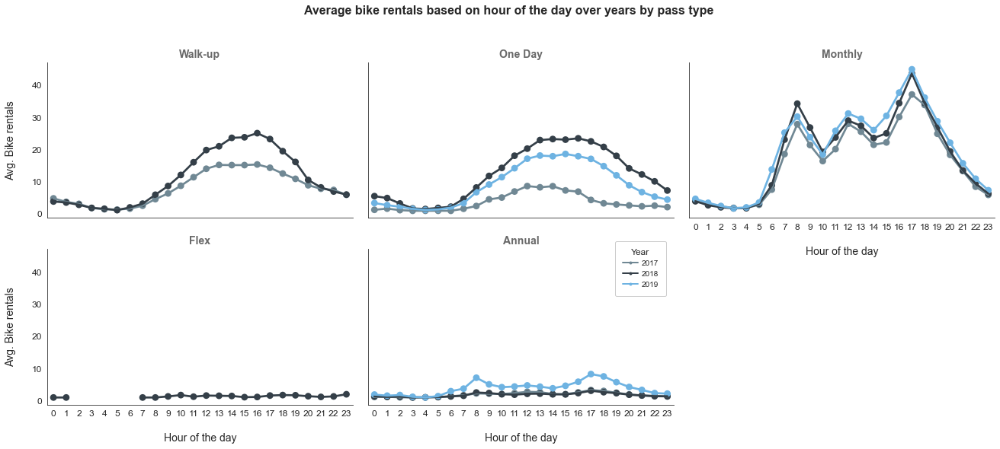

In [855]:
# Assign palette as per requirement
sb.set_style('white')
flatui = ['#6b8a99', '#31404a', '#60b6f0']
sb.set_palette(flatui, n_colors=3, desat=0.8)

# Seaborn's point plot
plot_order = hours_df.hour.sort_values(ascending=True).unique()
g = sb.FacetGrid(data = hours_df, col = 'pass_type', col_wrap = 3, height = 4, aspect = 1.5, hue = 'year')
g.map(sb.pointplot, "hour", "rentals", order= plot_order, linestyles = "-", ci = None);

g.fig.subplots_adjust(top=0.85)
g.fig.suptitle('Average bike rentals based on hour of the day over years by pass type', fontsize = 16, weight = 'bold')
g.set_titles('{col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# improve plot aesthetics
g.set_xticklabels(plot_order, size = 12)
g.set_yticklabels(size = 12)
g.set_xlabels('\nHour of the day', size = 14)
g.set_ylabels('Avg. Bike rentals\n', size = 14)
plt.subplots_adjust(wspace=0.05, hspace=0.2);

# add custom legend
custom = [Line2D([], [], marker='.', color=sb.color_palette()[0], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[1], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[2], linestyle='-', linewidth = 2)]

plt.legend(custom, ['2017', '2018', '2019'], scatterpoints=1, frameon=True, fancybox=True, 
           shadow=False, framealpha = 1, borderpad=1, borderaxespad=1, labelspacing=0.5, 
           ncol = 1, title='Year', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(1, 1.1));

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.3.35 Average bike rentals based on hour of the day over years by pass type.png', dpi=300, bbox_inches='tight')

----

#### 3.3.36 Multivariate analysis of `daytime`, `year`  and `pass_type` columns:

+ `Columns`: daytime, year, pass_type
+ `Data type`: (Categorical, ordered), (Categorical, ordered) and (Categorical, nominal)
+ `Plot`: Point plot

**`Find average rentals based on the daytime of the day over years:`**

Create a dataset which contain bike rentals relative to each `daytime` in the day over respective months in the year. Care should be taken as to inlcude only daytimes that appear in every day of the month over individual years. Use available categorical combinations and do not fill the `NULL` values with numerical zero's so as to consider bike rentals subjected to every daytime in any day.

In [856]:
# create a dataset for bike rentals over each daytime in a day
daytime_df = bikeshare.groupby([bikeshare["year"], 
                                bikeshare["month"],
                                bikeshare["day"],
                                bikeshare["daytime"],
                                bikeshare["pass_type"]]).count()['trip_id'].reset_index(name='rentals')
daytime_df.head(10)

,year,month,day,daytime,pass_type,rentals
0,2017,1,1,Early hours,Walk-up,19.0
1,2017,1,1,Early hours,One Day,NaN
2,2017,1,1,Early hours,Monthly,8.0
3,2017,1,1,Early hours,Flex,NaN
4,2017,1,1,Early hours,Annual,NaN
5,2017,1,1,Morning,Walk-up,15.0
6,2017,1,1,Morning,One Day,NaN
7,2017,1,1,Morning,Monthly,19.0
8,2017,1,1,Morning,Flex,NaN
9,2017,1,1,Morning,Annual,1.0


**`Point plot:`**

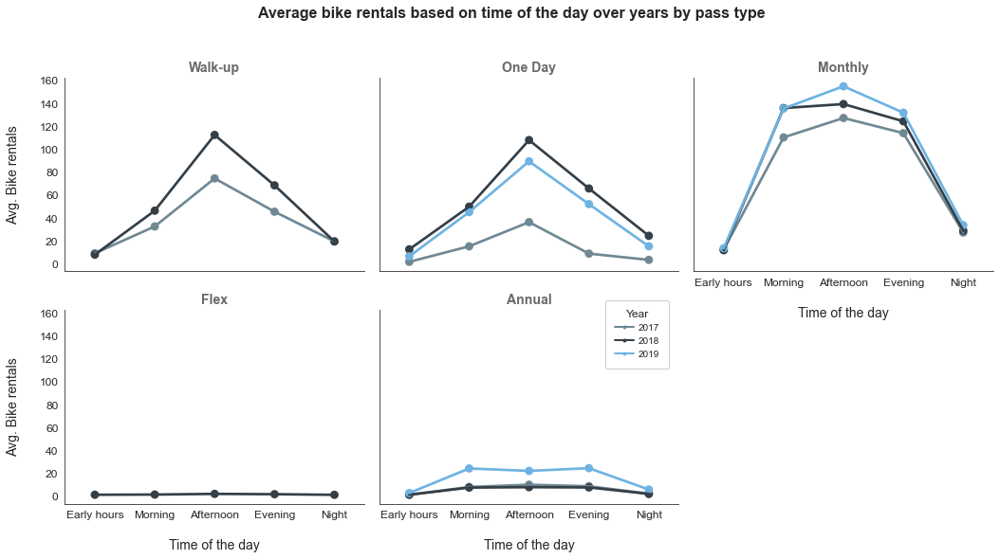

In [857]:
# Assign palette as per requirement
sb.set_style('white')
flatui = ['#6b8a99', '#31404a', '#60b6f0']
sb.set_palette(flatui, n_colors=3, desat=0.8)

# Seaborn's point plot
plot_order = daytime_df.daytime.sort_values(ascending=True).unique()
g = sb.FacetGrid(data = daytime_df, col = 'pass_type', col_wrap = 3, height = 4, aspect = 1.2, hue = 'year')
g.map(sb.pointplot, "daytime", "rentals", order= plot_order, linestyles = "-", ci = None);

g.fig.subplots_adjust(top=0.85)
g.fig.suptitle('Average bike rentals based on time of the day over years by pass type', fontsize = 16, weight = 'bold')
g.set_titles('{col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# improve plot aesthetics
g.set_xticklabels(plot_order, size = 12)
g.set_yticklabels(size = 12)
g.set_xlabels('\nTime of the day', size = 14)
g.set_ylabels('Avg. Bike rentals\n', size = 14)
plt.subplots_adjust(wspace=0.05, hspace=0.2);

# add custom legend
custom = [Line2D([], [], marker='.', color=sb.color_palette()[0], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[1], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[2], linestyle='-', linewidth = 2)]

plt.legend(custom, ['2017', '2018', '2019'], scatterpoints=1, frameon=True, fancybox=True, 
           shadow=False, framealpha = 1, borderpad=1, borderaxespad=1, labelspacing=0.5, 
           ncol = 1, title='Year', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(1, 1.1));

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.3.36 Average bike rentals based on time of the day over years by pass type.png', dpi=300, bbox_inches='tight')

----

#### 3.3.37 Multivariate analysis of `day`, `year`  and `pass_type` columns:

+ `Columns`: day, year, pass_type
+ `Data type`: (Categorical, ordered), (Categorical, ordered) and (Categorical, nominal)
+ `Plot`: Point plot

**`Find average rentals based on the day of the month over years:`**

Create a dataset which contain bike rentals relative to each `day` over respective months in the year. Care should be taken as to inlcude only days that appear in every month over individual years. Use available categorical combinations and do not fill the `NULL` values with numerical zero's so as to consider bike rentals subjected to every day in any month.

In [858]:
# create a dataset for bike rentals over each day in a month
days_df = bikeshare.groupby([bikeshare["year"], 
                             bikeshare["month"],
                             bikeshare["day"],
                             bikeshare["pass_type"]]).count()['trip_id'].reset_index(name='rentals')
days_df.head(10)

,year,month,day,pass_type,rentals
0,2017,1,1,Walk-up,169.0
1,2017,1,1,One Day,NaN
2,2017,1,1,Monthly,90.0
3,2017,1,1,Flex,NaN
4,2017,1,1,Annual,11.0
5,2017,1,2,Walk-up,115.0
6,2017,1,2,One Day,NaN
7,2017,1,2,Monthly,121.0
8,2017,1,2,Flex,NaN
9,2017,1,2,Annual,23.0


**`Point plot:`**

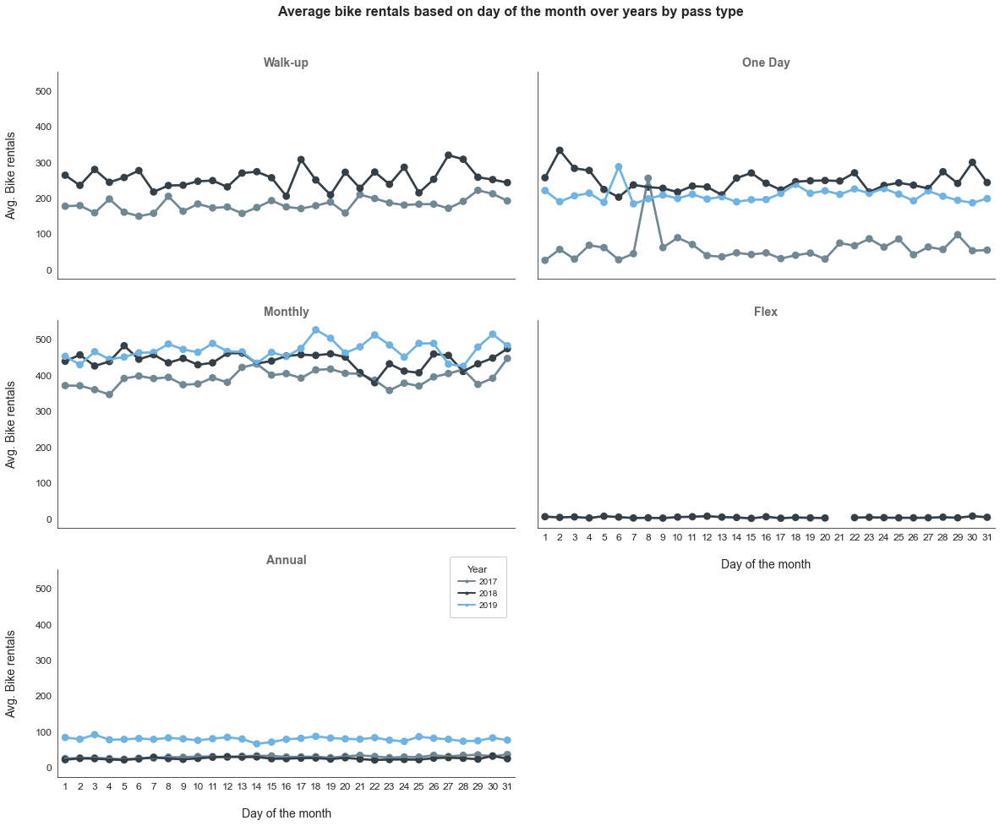

In [859]:
# Assign palette as per requirement
sb.set_style('white')
flatui = ['#6b8a99', '#31404a', '#60b6f0']
sb.set_palette(flatui, n_colors=3, desat=0.8)

# Seaborn's point plot
plot_order = days_df.day.sort_values(ascending=True).unique()
g = sb.FacetGrid(data = days_df, col = 'pass_type', col_wrap = 2, height = 4.5, aspect = 1.8, hue = 'year')
g.map(sb.pointplot, "day", "rentals", order= plot_order, linestyles = "-", ci = None);

g.fig.subplots_adjust(top=0.9)
g.fig.suptitle('Average bike rentals based on day of the month over years by pass type', fontsize = 16, weight = 'bold')
g.set_titles('{col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# improve plot aesthetics
g.set_xticklabels(plot_order, size = 12)
g.set_yticklabels(size = 12)
g.set_xlabels('\nDay of the month', size = 14)
g.set_ylabels('Avg. Bike rentals\n', size = 14)
plt.subplots_adjust(wspace=0.05, hspace=0.2);

# add custom legend
custom = [Line2D([], [], marker='.', color=sb.color_palette()[0], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[1], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[2], linestyle='-', linewidth = 2)]

plt.legend(custom, ['2017', '2018', '2019'], scatterpoints=1, frameon=True, fancybox=True, 
           shadow=False, framealpha = 1, borderpad=1, borderaxespad=1, labelspacing=0.5, 
           ncol = 1, title='Year', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(1, 1.1));

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.3.37 Average bike rentals based on day of the month over years by pass type.png', dpi=300, bbox_inches='tight')

----

#### 3.3.38 Multivariate analysis of `weekday`, `year`  and `pass_type` columns:

+ `Columns`: weekday, year, pass_type
+ `Data type`: (Categorical, ordered), (Categorical, ordered) and (Categorical, nominal)
+ `Plot`: Point plot

**`Find average rentals based on the day of the week over years:`**

Create a dataset which contain bike rentals relative to each `day` over respective week in the month. Care should be taken as to inlcude only days that appear in every week over individual months. Use available categorical combinations and do not fill the `NULL` values with numerical zero's so as to consider bike rentals subjected to every day in any week.

In [860]:
# create a dataset for bike rentals over each day in a week
weekday_df = bikeshare.groupby([bikeshare["year"], 
                                bikeshare["month"],
                                bikeshare["week"],
                                bikeshare["weekday"],
                                bikeshare["pass_type"]]).count()['trip_id'].reset_index(name='rentals')
weekday_df.head(10)

,year,month,week,weekday,pass_type,rentals
0,2017,1,First,Monday,Walk-up,115.0
1,2017,1,First,Monday,One Day,NaN
2,2017,1,First,Monday,Monthly,121.0
3,2017,1,First,Monday,Flex,NaN
4,2017,1,First,Monday,Annual,23.0
5,2017,1,First,Tuesday,Walk-up,73.0
6,2017,1,First,Tuesday,One Day,NaN
7,2017,1,First,Tuesday,Monthly,234.0
8,2017,1,First,Tuesday,Flex,NaN
9,2017,1,First,Tuesday,Annual,20.0


**`Point plot:`**

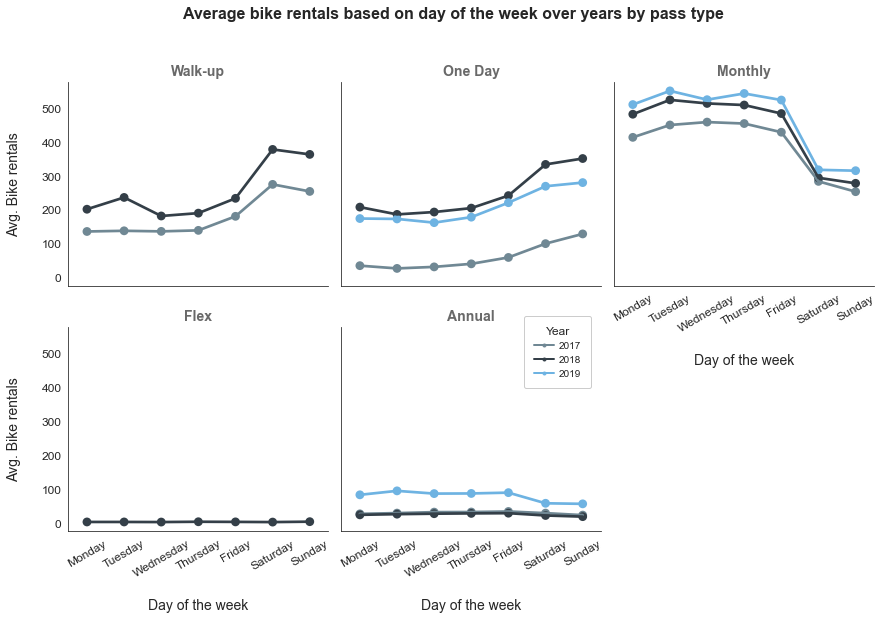

In [861]:
# Assign palette as per requirement
sb.set_style('white')
flatui = ['#6b8a99', '#31404a', '#60b6f0']
sb.set_palette(flatui, n_colors=3, desat=0.8)

# Seaborn's point plot
plot_order = weekday_df.weekday.sort_values(ascending=True).unique()
g = sb.FacetGrid(data = weekday_df, col = 'pass_type', col_wrap = 3, height = 4, aspect = 1, hue = 'year')
g.map(sb.pointplot, "weekday", "rentals", order= plot_order, linestyles = "-", ci = None);

g.fig.subplots_adjust(top=0.85)
g.fig.suptitle('Average bike rentals based on day of the week over years by pass type', fontsize = 16, weight = 'bold')
g.set_titles('{col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# improve plot aesthetics
g.set_xticklabels(plot_order, rotation = 30, size = 12)
g.set_yticklabels(size = 12)
g.set_xlabels('\nDay of the week', size = 14)
g.set_ylabels('Avg. Bike rentals\n', size = 14)
plt.subplots_adjust(wspace=0.05, hspace=0.2);

# add custom legend
custom = [Line2D([], [], marker='.', color=sb.color_palette()[0], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[1], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[2], linestyle='-', linewidth = 2)]

plt.legend(custom, ['2017', '2018', '2019'], scatterpoints=1, frameon=True, fancybox=True, 
           shadow=False, framealpha = 1, borderpad=1, borderaxespad=1, labelspacing=0.5, 
           ncol = 1, title='Year', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(1, 1.1));

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.3.38 Average bike rentals based on day of the week over years by pass type.png', dpi=300, bbox_inches='tight')

----

#### 3.3.39 Multivariate analysis of `month`, `year`  and `pass_type` columns:

+ `Columns`: month, year, pass_type
+ `Data type`: (Categorical, ordered), (Categorical, ordered) and (Categorical, nominal)
+ `Plot`: Point plot

**`Find average rentals based on the month over years:`**

Create a dataset which contain bike rentals relative to each `month` over respective years. Care should be taken as to inlcude only rentals that appear in every month over individual years. Use available categorical combinations and do not fill the `NULL` values with numerical zero's so as to consider bike rentals subjected to every month in any year.

In [862]:
# create a dataset for bike rentals over each month in a year
month_df = bikeshare.groupby([bikeshare["year"], 
                              bikeshare["month"],
                              bikeshare["pass_type"]]).count()['trip_id'].reset_index(name='rentals')
month_df.head(10)

,year,month,pass_type,rentals
0,2017,1,Walk-up,3187.0
1,2017,1,One Day,NaN
2,2017,1,Monthly,6306.0
3,2017,1,Flex,NaN
4,2017,1,Annual,663.0
5,2017,2,Walk-up,2710.0
6,2017,2,One Day,NaN
7,2017,2,Monthly,6070.0
8,2017,2,Flex,NaN
9,2017,2,Annual,588.0


**`Point plot:`**

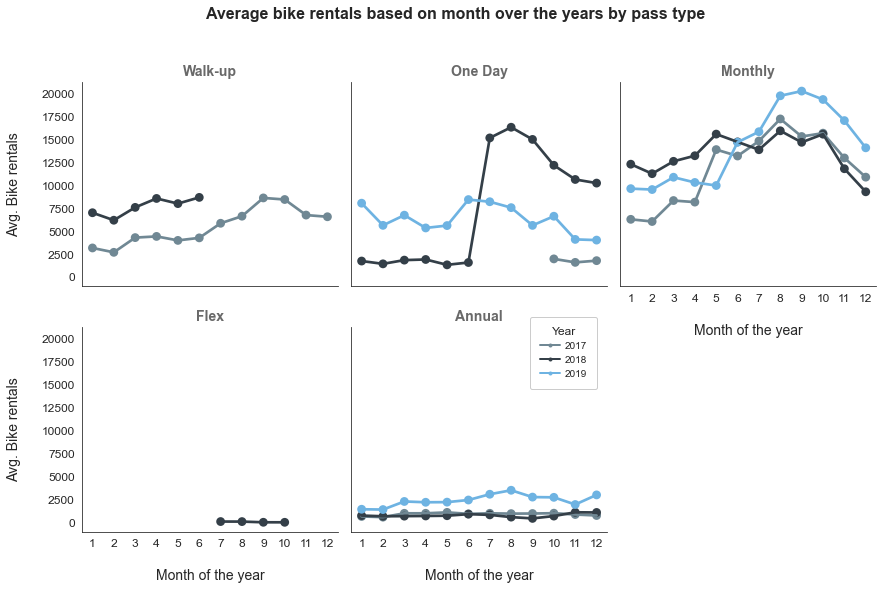

In [863]:
# Assign palette as per requirement
sb.set_style('white')
flatui = ['#6b8a99', '#31404a', '#60b6f0']
sb.set_palette(flatui, n_colors=3, desat=0.8)

# Seaborn's point plot
plot_order = month_df.month.sort_values(ascending=True).unique()
g = sb.FacetGrid(data = month_df, col = 'pass_type', col_wrap = 3, height = 4, aspect = 1, hue = 'year')
g.map(sb.pointplot, "month", "rentals", order= plot_order, linestyles = "-", ci = None);

g.fig.subplots_adjust(top=0.85)
g.fig.suptitle('Average bike rentals based on month over the years by pass type', fontsize = 16, weight = 'bold')
g.set_titles('{col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# improve plot aesthetics
g.set_xticklabels(plot_order, size = 12)
g.set_yticklabels(size = 12)
g.set_xlabels('\nMonth of the year', size = 14)
g.set_ylabels('Avg. Bike rentals\n', size = 14)
plt.subplots_adjust(wspace=0.05, hspace=0.2);

# add custom legend
custom = [Line2D([], [], marker='.', color=sb.color_palette()[0], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[1], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[2], linestyle='-', linewidth = 2)]

plt.legend(custom, ['2017', '2018', '2019'], scatterpoints=1, frameon=True, fancybox=True, 
           shadow=False, framealpha = 1, borderpad=1, borderaxespad=1, labelspacing=0.5, 
           ncol = 1, title='Year', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(1, 1.1));

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.3.39 Average bike rentals based on month over the years by pass type.png', dpi=300, bbox_inches='tight')

----

#### 3.3.40 Multivariate analysis of `quarter`, `year`  and `pass_type` columns:

+ `Columns`: quarter, year, pass_type
+ `Data type`: (Categorical, ordered), (Categorical, ordered) and (Categorical, nominal)
+ `Plot`: Point plot

**`Find average rentals based on the quarter over years:`**

Create a dataset which contain bike rentals relative to each `quarter` over respective years. Care should be taken as to inlcude only rentals that appear in every quarter over individual years. Use available categorical combinations and do not fill the `NULL` values with numerical zero's so as to consider bike rentals subjected to every quarter in any year.

In [864]:
# create a dataset for bike rentals over each quarter in a year
quarter_df = bikeshare.groupby([bikeshare["year"], 
                                bikeshare["quarter"],
                                bikeshare["pass_type"]]).count()['trip_id'].reset_index(name='rentals')
quarter_df.head(10)

,year,quarter,pass_type,rentals
0,2017,Q1,Walk-up,10211.0
1,2017,Q1,One Day,NaN
2,2017,Q1,Monthly,20730.0
3,2017,Q1,Flex,NaN
4,2017,Q1,Annual,2257.0
5,2017,Q2,Walk-up,12740.0
6,2017,Q2,One Day,NaN
7,2017,Q2,Monthly,35297.0
8,2017,Q2,Flex,NaN
9,2017,Q2,Annual,3062.0


**`Point plot:`**

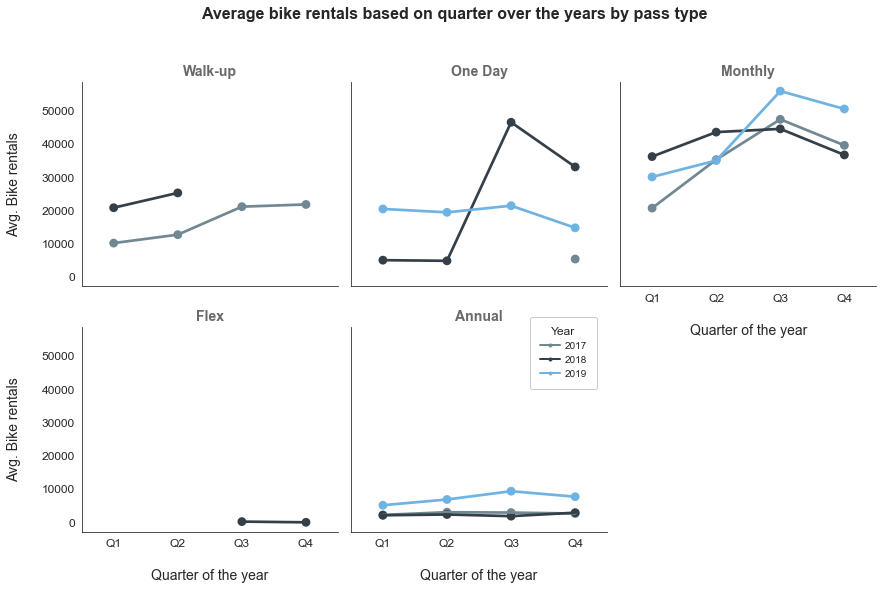

In [865]:
# Assign palette as per requirement
sb.set_style('white')
flatui = ['#6b8a99', '#31404a', '#60b6f0']
sb.set_palette(flatui, n_colors=3, desat=0.8)

# Seaborn's point plot
plot_order = quarter_df.quarter.sort_values(ascending=True).unique()
g = sb.FacetGrid(data = quarter_df, col = 'pass_type', col_wrap = 3, height = 4, aspect = 1, hue = 'year')
g.map(sb.pointplot, "quarter", "rentals", order= plot_order, linestyles = "-", ci = None);

g.fig.subplots_adjust(top=0.85)
g.fig.suptitle('Average bike rentals based on quarter over the years by pass type', fontsize = 16, weight = 'bold')
g.set_titles('{col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# improve plot aesthetics
g.set_xticklabels(plot_order, size = 12)
g.set_yticklabels(size = 12)
g.set_xlabels('\nQuarter of the year', size = 14)
g.set_ylabels('Avg. Bike rentals\n', size = 14)
plt.subplots_adjust(wspace=0.05, hspace=0.2);

# add custom legend
custom = [Line2D([], [], marker='.', color=sb.color_palette()[0], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[1], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[2], linestyle='-', linewidth = 2)]

plt.legend(custom, ['2017', '2018', '2019'], scatterpoints=1, frameon=True, fancybox=True, 
           shadow=False, framealpha = 1, borderpad=1, borderaxespad=1, labelspacing=0.5, 
           ncol = 1, title='Year', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(1, 1.1));

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.3.40 Average bike rentals based on quarter over the years by pass type.png', dpi=300, bbox_inches='tight')

----

#### 3.3.41 Multivariate analysis of `hour`, `year`  and `fare_type` columns:

+ `Columns`: hour, year, fare_type
+ `Data type`: (numerical, continuous), (Categorical, ordered) and (Categorical, nominal)
+ `Plot`: Point plot

**`Find average rentals based on the hour of the year:`**

Create a dataset which contain bike rentals relative to each `hour` in the day over respective months in the year. Care should be taken as to inlcude only hours that appear in every day of the month over individual years. Use available categorical combinations and do not fill the `NULL` values with numerical zero's so as to consider bike rentals subjected to every hour in any day.

In [866]:
# create a dataset for bike rentals over each hour in a day
hours_df = bikeshare.groupby([bikeshare["year"], 
                              bikeshare["month"],
                              bikeshare["day"],
                              bikeshare["hour"],
                              bikeshare["fare_type"]]).count()['trip_id'].reset_index(name='rentals')
hours_df.head(10)

,year,month,day,hour,fare_type,rentals
0,2017,1,1,0,Base,7.0
1,2017,1,1,0,Extended,2.0
2,2017,1,1,1,Base,5.0
3,2017,1,1,1,Extended,NaN
4,2017,1,1,2,Base,7.0
5,2017,1,1,2,Extended,1.0
6,2017,1,1,3,Base,2.0
7,2017,1,1,3,Extended,NaN
8,2017,1,1,4,Base,1.0
9,2017,1,1,4,Extended,NaN


**`Point plot:`**

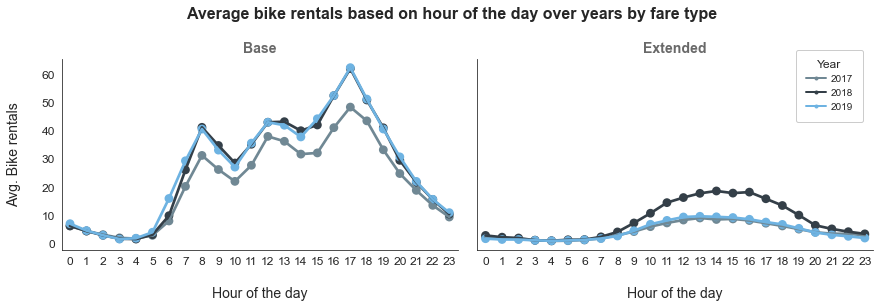

In [867]:
# Assign palette as per requirement
sb.set_style('white')
flatui = ['#6b8a99', '#31404a', '#60b6f0']
sb.set_palette(flatui, n_colors=3, desat=0.8)

# Seaborn's point plot
plot_order = hours_df.hour.sort_values(ascending=True).unique()
g = sb.FacetGrid(data = hours_df, col = 'fare_type', col_wrap = 2, height = 4, aspect = 1.5, hue = 'year')
g.map(sb.pointplot, "hour", "rentals", order= plot_order, linestyles = "-", ci = None);

g.fig.subplots_adjust(top=0.8)
g.fig.suptitle('Average bike rentals based on hour of the day over years by fare type', fontsize = 16, weight = 'bold')
g.set_titles('{col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# improve plot aesthetics
g.set_xticklabels(plot_order, size = 12)
g.set_yticklabels(size = 12)
g.set_xlabels('\nHour of the day', size = 14)
g.set_ylabels('Avg. Bike rentals\n', size = 14)
plt.subplots_adjust(wspace=0.05, hspace=0.2);

# add custom legend
custom = [Line2D([], [], marker='.', color=sb.color_palette()[0], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[1], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[2], linestyle='-', linewidth = 2)]

plt.legend(custom, ['2017', '2018', '2019'], scatterpoints=1, frameon=True, fancybox=True, 
           shadow=False, framealpha = 1, borderpad=1, borderaxespad=1, labelspacing=0.5, 
           ncol = 1, title='Year', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(1, 1.1));

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.3.41 Average bike rentals based on hour of the day over years by fare type.png', dpi=300, bbox_inches='tight')

----

#### 3.3.42 Multivariate analysis of `daytime`, `year`  and `fare_type` columns:

+ `Columns`: daytime, year, fare_type
+ `Data type`: (Categorical, ordered), (Categorical, ordered) and (Categorical, nominal)
+ `Plot`: Point plot

**`Find average rentals based on the daytime of the day over years:`**

Create a dataset which contain bike rentals relative to each `daytime` in the day over respective months in the year. Care should be taken as to inlcude only daytimes that appear in every day of the month over individual years. Use available categorical combinations and do not fill the `NULL` values with numerical zero's so as to consider bike rentals subjected to every daytime in any day.

In [868]:
# create a dataset for bike rentals over each daytime in a day
daytime_df = bikeshare.groupby([bikeshare["year"], 
                                bikeshare["month"],
                                bikeshare["day"],
                                bikeshare["daytime"],
                                bikeshare["fare_type"]]).count()['trip_id'].reset_index(name='rentals')
daytime_df.head(10)

,year,month,day,daytime,fare_type,rentals
0,2017,1,1,Early hours,Base,24.0
1,2017,1,1,Early hours,Extended,3.0
2,2017,1,1,Morning,Base,26.0
3,2017,1,1,Morning,Extended,9.0
4,2017,1,1,Afternoon,Base,112.0
5,2017,1,1,Afternoon,Extended,31.0
6,2017,1,1,Evening,Base,42.0
7,2017,1,1,Evening,Extended,8.0
8,2017,1,1,Night,Base,7.0
9,2017,1,1,Night,Extended,8.0


**`Point plot:`**

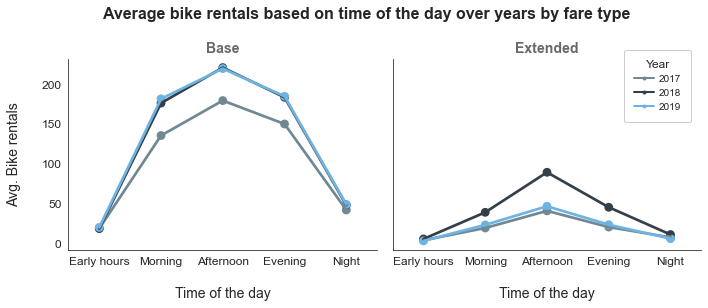

In [869]:
# Assign palette as per requirement
sb.set_style('white')
flatui = ['#6b8a99', '#31404a', '#60b6f0']
sb.set_palette(flatui, n_colors=3, desat=0.8)

# Seaborn's point plot
plot_order = daytime_df.daytime.sort_values(ascending=True).unique()
g = sb.FacetGrid(data = daytime_df, col = 'fare_type', col_wrap = 2, height = 4, aspect = 1.2, hue = 'year')
g.map(sb.pointplot, "daytime", "rentals", order= plot_order, linestyles = "-", ci = None);

g.fig.subplots_adjust(top=0.8)
g.fig.suptitle('Average bike rentals based on time of the day over years by fare type', fontsize = 16, weight = 'bold')
g.set_titles('{col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# improve plot aesthetics
g.set_xticklabels(plot_order, size = 12)
g.set_yticklabels(size = 12)
g.set_xlabels('\nTime of the day', size = 14)
g.set_ylabels('Avg. Bike rentals\n', size = 14)
plt.subplots_adjust(wspace=0.05, hspace=0.2);

# add custom legend
custom = [Line2D([], [], marker='.', color=sb.color_palette()[0], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[1], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[2], linestyle='-', linewidth = 2)]

plt.legend(custom, ['2017', '2018', '2019'], scatterpoints=1, frameon=True, fancybox=True, 
           shadow=False, framealpha = 1, borderpad=1, borderaxespad=1, labelspacing=0.5, 
           ncol = 1, title='Year', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(1, 1.1));

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.3.42 Average bike rentals based on time of the day over years by fare type.png', dpi=300, bbox_inches='tight')

----

#### 3.3.43 Multivariate analysis of `day`, `year`  and `fare_type` columns:

+ `Columns`: day, year, fare_type
+ `Data type`: (Categorical, ordered), (Categorical, ordered) and (Categorical, nominal)
+ `Plot`: Point plot

**`Find average rentals based on the day of the month over years:`**

Create a dataset which contain bike rentals relative to each `day` over respective months in the year. Care should be taken as to inlcude only days that appear in every month over individual years. Use available categorical combinations and do not fill the `NULL` values with numerical zero's so as to consider bike rentals subjected to every day in any month.

In [870]:
# create a dataset for bike rentals over each day in a month
days_df = bikeshare.groupby([bikeshare["year"], 
                             bikeshare["month"],
                             bikeshare["day"],
                             bikeshare["fare_type"]]).count()['trip_id'].reset_index(name='rentals')
days_df.head(10)

,year,month,day,fare_type,rentals
0,2017,1,1,Base,211.0
1,2017,1,1,Extended,59.0
2,2017,1,2,Base,214.0
3,2017,1,2,Extended,45.0
4,2017,1,3,Base,296.0
5,2017,1,3,Extended,31.0
6,2017,1,4,Base,322.0
7,2017,1,4,Extended,28.0
8,2017,1,5,Base,216.0
9,2017,1,5,Extended,15.0


**`Point plot:`**

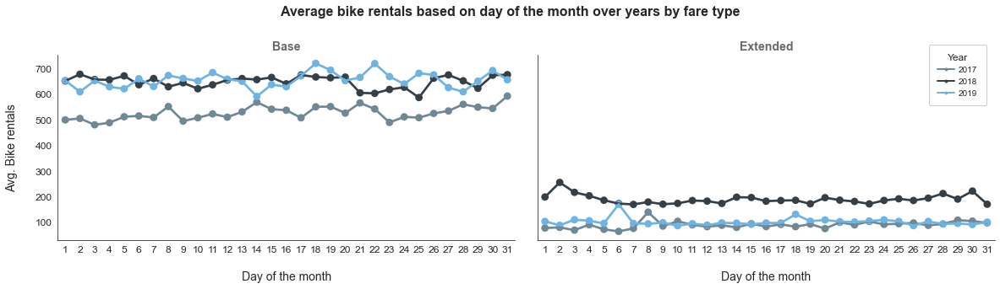

In [871]:
# Assign palette as per requirement
sb.set_style('white')
flatui = ['#6b8a99', '#31404a', '#60b6f0']
sb.set_palette(flatui, n_colors=3, desat=0.8)

# Seaborn's point plot
plot_order = days_df.day.sort_values(ascending=True).unique()
g = sb.FacetGrid(data = days_df, col = 'fare_type', col_wrap = 2, height = 4.5, aspect = 1.8, hue = 'year')
g.map(sb.pointplot, "day", "rentals", order= plot_order, linestyles = "-", ci = None);

g.fig.subplots_adjust(top=0.8)
g.fig.suptitle('Average bike rentals based on day of the month over years by fare type', fontsize = 16, weight = 'bold')
g.set_titles('{col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# improve plot aesthetics
g.set_xticklabels(plot_order, size = 12)
g.set_yticklabels(size = 12)
g.set_xlabels('\nDay of the month', size = 14)
g.set_ylabels('Avg. Bike rentals\n', size = 14)
plt.subplots_adjust(wspace=0.05, hspace=0.2);

# add custom legend
custom = [Line2D([], [], marker='.', color=sb.color_palette()[0], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[1], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[2], linestyle='-', linewidth = 2)]

plt.legend(custom, ['2017', '2018', '2019'], scatterpoints=1, frameon=True, fancybox=True, 
           shadow=False, framealpha = 1, borderpad=1, borderaxespad=1, labelspacing=0.5, 
           ncol = 1, title='Year', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(1, 1.1));

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.3.43 Average bike rentals based on day of the month over years by fare type.png', dpi=300, bbox_inches='tight')

----

#### 3.3.44 Multivariate analysis of `weekday`, `year`  and `fare_type` columns:

+ `Columns`: weekday, year, fare_type
+ `Data type`: (Categorical, ordered), (Categorical, ordered) and (Categorical, nominal)
+ `Plot`: Point plot

**`Find average rentals based on the day of the week over years:`**

Create a dataset which contain bike rentals relative to each `day` over respective week in the month. Care should be taken as to inlcude only days that appear in every week over individual months. Use available categorical combinations and do not fill the `NULL` values with numerical zero's so as to consider bike rentals subjected to every day in any week.

In [872]:
# create a dataset for bike rentals over each day in a week
weekday_df = bikeshare.groupby([bikeshare["year"], 
                                bikeshare["month"],
                                bikeshare["week"],
                                bikeshare["weekday"],
                                bikeshare["fare_type"]]).count()['trip_id'].reset_index(name='rentals')
weekday_df.head(10)

,year,month,week,weekday,fare_type,rentals
0,2017,1,First,Monday,Base,214.0
1,2017,1,First,Monday,Extended,45.0
2,2017,1,First,Tuesday,Base,296.0
3,2017,1,First,Tuesday,Extended,31.0
4,2017,1,First,Wednesday,Base,322.0
5,2017,1,First,Wednesday,Extended,28.0
6,2017,1,First,Thursday,Base,216.0
7,2017,1,First,Thursday,Extended,15.0
8,2017,1,First,Friday,Base,335.0
9,2017,1,First,Friday,Extended,26.0


**`Point plot:`**

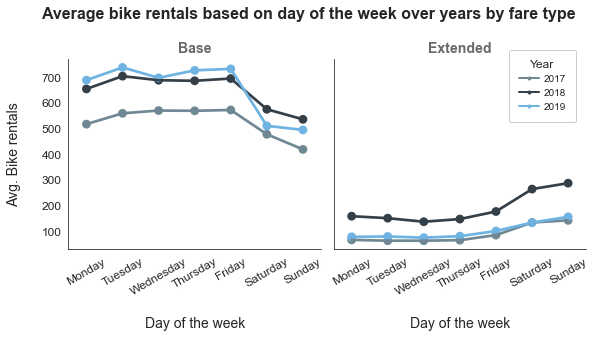

In [873]:
# Assign palette as per requirement
sb.set_style('white')
flatui = ['#6b8a99', '#31404a', '#60b6f0']
sb.set_palette(flatui, n_colors=3, desat=0.8)

# Seaborn's point plot
plot_order = weekday_df.weekday.sort_values(ascending=True).unique()
g = sb.FacetGrid(data = weekday_df, col = 'fare_type', col_wrap = 2, height = 4, aspect = 1, hue = 'year')
g.map(sb.pointplot, "weekday", "rentals", order= plot_order, linestyles = "-", ci = None);

g.fig.subplots_adjust(top=0.8)
g.fig.suptitle('Average bike rentals based on day of the week over years by fare type', fontsize = 16, weight = 'bold')
g.set_titles('{col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# improve plot aesthetics
g.set_xticklabels(plot_order, rotation = 30, size = 12)
g.set_yticklabels(size = 12)
g.set_xlabels('\nDay of the week', size = 14)
g.set_ylabels('Avg. Bike rentals\n', size = 14)
plt.subplots_adjust(wspace=0.05, hspace=0.2);

# add custom legend
custom = [Line2D([], [], marker='.', color=sb.color_palette()[0], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[1], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[2], linestyle='-', linewidth = 2)]

plt.legend(custom, ['2017', '2018', '2019'], scatterpoints=1, frameon=True, fancybox=True, 
           shadow=False, framealpha = 1, borderpad=1, borderaxespad=1, labelspacing=0.5, 
           ncol = 1, title='Year', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(1, 1.1));

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.3.44 Average bike rentals based on day of the week over years by fare type.png', dpi=300, bbox_inches='tight')

----

#### 3.3.45 Multivariate analysis of `month`, `year`  and `fare_type` columns:

+ `Columns`: month, year, fare_type
+ `Data type`: (Categorical, ordered), (Categorical, ordered) and (Categorical, nominal)
+ `Plot`: Point plot

**`Find average rentals based on the month over years:`**

Create a dataset which contain bike rentals relative to each `month` over respective years. Care should be taken as to inlcude only rentals that appear in every month over individual years. Use available categorical combinations and do not fill the `NULL` values with numerical zero's so as to consider bike rentals subjected to every month in any year.

In [874]:
# create a dataset for bike rentals over each month in a year
month_df = bikeshare.groupby([bikeshare["year"], 
                              bikeshare["month"],
                              bikeshare["fare_type"]]).count()['trip_id'].reset_index(name='rentals')
month_df.head(10)

,year,month,fare_type,rentals
0,2017,1,Base,8925
1,2017,1,Extended,1231
2,2017,2,Base,8450
3,2017,2,Extended,918
4,2017,3,Base,12142
5,2017,3,Extended,1532
6,2017,4,Base,12110
7,2017,4,Extended,1525
8,2017,5,Base,17219
9,2017,5,Extended,1805


**`Point plot:`**

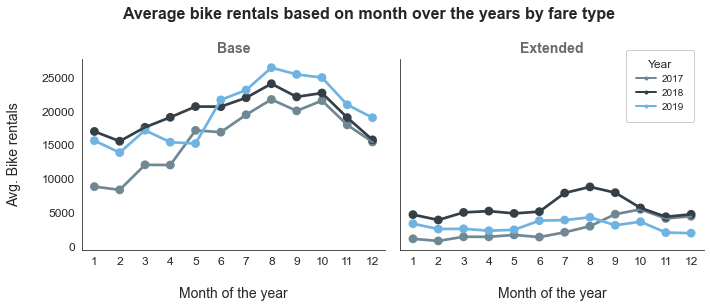

In [875]:
# Assign palette as per requirement
sb.set_style('white')
flatui = ['#6b8a99', '#31404a', '#60b6f0']
sb.set_palette(flatui, n_colors=3, desat=0.8)

# Seaborn's point plot
plot_order = month_df.month.sort_values(ascending=True).unique()
g = sb.FacetGrid(data = month_df, col = 'fare_type', col_wrap = 2, height = 4, aspect = 1.2, hue = 'year')
g.map(sb.pointplot, "month", "rentals", order= plot_order, linestyles = "-", ci = None);

g.fig.subplots_adjust(top=0.8)
g.fig.suptitle('Average bike rentals based on month over the years by fare type', fontsize = 16, weight = 'bold')
g.set_titles('{col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# improve plot aesthetics
g.set_xticklabels(plot_order, size = 12)
g.set_yticklabels(size = 12)
g.set_xlabels('\nMonth of the year', size = 14)
g.set_ylabels('Avg. Bike rentals\n', size = 14)
plt.subplots_adjust(wspace=0.05, hspace=0.2);

# add custom legend
custom = [Line2D([], [], marker='.', color=sb.color_palette()[0], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[1], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[2], linestyle='-', linewidth = 2)]

plt.legend(custom, ['2017', '2018', '2019'], scatterpoints=1, frameon=True, fancybox=True, 
           shadow=False, framealpha = 1, borderpad=1, borderaxespad=1, labelspacing=0.5, 
           ncol = 1, title='Year', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(1, 1.1));

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.3.45 Average bike rentals based on month over the years by fare type.png', dpi=300, bbox_inches='tight')

----

#### 3.3.46 Multivariate analysis of `quarter`, `year`  and `fare_type` columns:

+ `Columns`: quarter, year, fare_type
+ `Data type`: (Categorical, ordered), (Categorical, ordered) and (Categorical, nominal)
+ `Plot`: Point plot

**`Find average rentals based on the quarter over years:`**

Create a dataset which contain bike rentals relative to each `quarter` over respective years. Care should be taken as to inlcude only rentals that appear in every quarter over individual years. Use available categorical combinations and do not fill the `NULL` values with numerical zero's so as to consider bike rentals subjected to every quarter in any year.

In [876]:
# create a dataset for bike rentals over each quarter in a year
quarter_df = bikeshare.groupby([bikeshare["year"], 
                                bikeshare["quarter"],
                                bikeshare["fare_type"]]).count()['trip_id'].reset_index(name='rentals')
quarter_df.head(10)

,year,quarter,fare_type,rentals
0,2017,Q1,Base,29517
1,2017,Q1,Extended,3681
2,2017,Q2,Base,46286
3,2017,Q2,Extended,4813
4,2017,Q3,Base,61400
5,2017,Q3,Extended,10142
6,2017,Q4,Base,55142
7,2017,Q4,Extended,14350
8,2018,Q1,Base,50353
9,2018,Q1,Extended,13928


**`Point plot:`**

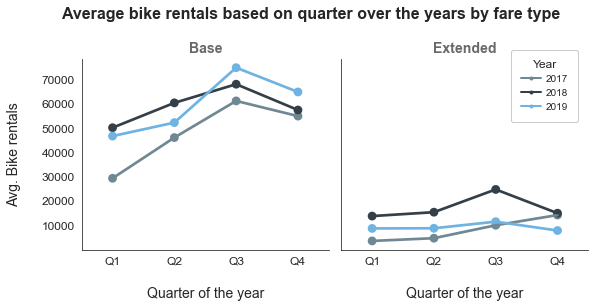

In [877]:
# Assign palette as per requirement
sb.set_style('white')
flatui = ['#6b8a99', '#31404a', '#60b6f0']
sb.set_palette(flatui, n_colors=3, desat=0.8)

# Seaborn's point plot
plot_order = quarter_df.quarter.sort_values(ascending=True).unique()
g = sb.FacetGrid(data = quarter_df, col = 'fare_type', col_wrap = 2, height = 4, aspect = 1, hue = 'year')
g.map(sb.pointplot, "quarter", "rentals", order= plot_order, linestyles = "-", ci = None);

g.fig.subplots_adjust(top=0.8)
g.fig.suptitle('Average bike rentals based on quarter over the years by fare type', fontsize = 16, weight = 'bold')
g.set_titles('{col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# improve plot aesthetics
g.set_xticklabels(plot_order, size = 12)
g.set_yticklabels(size = 12)
g.set_xlabels('\nQuarter of the year', size = 14)
g.set_ylabels('Avg. Bike rentals\n', size = 14)
plt.subplots_adjust(wspace=0.05, hspace=0.2);

# add custom legend
custom = [Line2D([], [], marker='.', color=sb.color_palette()[0], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[1], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[2], linestyle='-', linewidth = 2)]

plt.legend(custom, ['2017', '2018', '2019'], scatterpoints=1, frameon=True, fancybox=True, 
           shadow=False, framealpha = 1, borderpad=1, borderaxespad=1, labelspacing=0.5, 
           ncol = 1, title='Year', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(1, 1.1));

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.3.46 Average bike rentals based on quarter over the years by fare type.png', dpi=300, bbox_inches='tight')

----

#### 3.3.47 Multivariate analysis of `hour`, `year`, `trip_type` and `bike_type` columns:

+ `Columns`: hour, year, trip_type, bike_type
+ `Data type`: (Categorical, ordered), (Categorical, ordered), (Categorical, nominal) and (Categorical, nominal)
+ `Plot`: Point plot

**`Find average rentals based on the hour over years:`**

Create a dataset which contain bike rentals relative to each `hour` in the day over respective months in the year. Care should be taken as to inlcude only hours that appear in every day of the month over individual years. Use available categorical combinations and do not fill the `NULL` values with numerical zero's so as to consider bike rentals subjected to every hour in any day.

In [878]:
# create a dataset for bike rentals over each hour in a day
hours_df = bikeshare.groupby([bikeshare["year"], 
                              bikeshare["month"],
                              bikeshare["day"],
                              bikeshare["hour"],
                              bikeshare["trip_type"],
                              bikeshare["bike_type"]]).count()['trip_id'].reset_index(name='rentals')
hours_df.head(10)

,year,month,day,hour,trip_type,bike_type,rentals
0,2017,1,1,0,One Way,unknown,6.0
1,2017,1,1,0,One Way,Standard,NaN
2,2017,1,1,0,One Way,Electric,NaN
3,2017,1,1,0,One Way,Smart,NaN
4,2017,1,1,0,Round Trip,unknown,3.0
5,2017,1,1,0,Round Trip,Standard,NaN
6,2017,1,1,0,Round Trip,Electric,NaN
7,2017,1,1,0,Round Trip,Smart,NaN
8,2017,1,1,1,One Way,unknown,5.0
9,2017,1,1,1,One Way,Standard,NaN


**`Point plot:`**

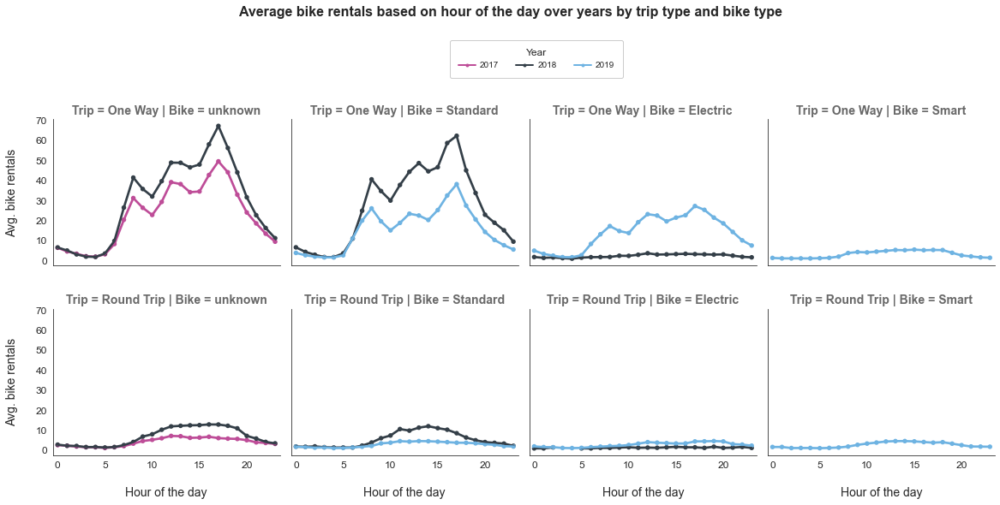

In [879]:
# Assign palette as per requirement
sb.set_style('white')
flatui = ['#cc3f9d', '#31404a', '#60b6f0']
sb.set_palette(flatui, n_colors=3, desat=0.8)

# Facet grid with point plot
plot_order = hours_df.hour.sort_values(ascending=True).unique()
g = sb.FacetGrid(data = hours_df, col = 'bike_type', row = 'trip_type', height = 4, aspect = 1, hue = 'year')
g.map(sb.pointplot, "hour", "rentals", order= plot_order, linestyles = "-", ci = None, markers = ['.']);
g.fig.subplots_adjust(top=0.75)
g.fig.suptitle('Average bike rentals based on hour of the day over years by trip type and bike type', 
               fontsize = 16, weight = 'bold')
g.set_titles('Trip = {row_name} | Bike = {col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# improve plot aesthetics
# -------------------------------------------------------
g.set_xlabels('\nHour of the day', size = 14)
g.set_ylabels('Avg. bike rentals\n', size = 14)
g.set_yticklabels(size = 12)
# iterate over axes of FacetGrid
for ax in g.axes.flat:
     # get x labels
    labels = ax.get_xticklabels()
    for i,l in enumerate(labels):
        # skip labels
        if not (i%5 == 0): labels[i] = ''
    # set new labels
    ax.set_xticklabels(labels, size = 12)
# -------------------------------------------------------

# add custom legend
# -------------------------------------------------------
custom = [Line2D([], [], marker='.', color=sb.color_palette()[0], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[1], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[2], linestyle='-', linewidth = 2)]

plt.legend(custom, ['2017', '2018', '2019'], scatterpoints=1, frameon=True, fancybox=True, 
           shadow=False, framealpha = 1, borderpad=1, borderaxespad=1, labelspacing=0.5, 
           ncol = 3, title='Year', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(-0.6, 2.9));
# -------------------------------------------------------

plt.subplots_adjust(wspace=0.05, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.3.47 Average bike rentals based on hour over the years by trip type and bike type.png', dpi=300, bbox_inches='tight')

----

#### 3.3.48 Multivariate analysis of `daytime`, `year`, `trip_type` and `bike_type` columns:

+ `Columns`: daytime, year, trip_type, bike_type
+ `Data type`: (Categorical, ordered), (Categorical, ordered), (Categorical, nominal) and (Categorical, nominal)
+ `Plot`: Point plot

**`Find average rentals based on the daytime of the day over years:`**

Create a dataset which contain bike rentals relative to each `daytime` in the day over respective months in the year. Care should be taken as to inlcude only daytimes that appear in every day of the month over individual years. Use available categorical combinations and do not fill the `NULL` values with numerical zero's so as to consider bike rentals subjected to every daytime in any day.

In [880]:
# create a dataset for bike rentals over each day in a week
daytime_df = bikeshare.groupby([bikeshare["year"], 
                                bikeshare["month"],
                                bikeshare["day"],
                                bikeshare["daytime"],
                                bikeshare["trip_type"],
                                bikeshare["bike_type"]]).count()['trip_id'].reset_index(name='rentals')
daytime_df.head(10)

,year,month,day,daytime,trip_type,bike_type,rentals
0,2017,1,1,Early hours,One Way,unknown,24.0
1,2017,1,1,Early hours,One Way,Standard,NaN
2,2017,1,1,Early hours,One Way,Electric,NaN
3,2017,1,1,Early hours,One Way,Smart,NaN
4,2017,1,1,Early hours,Round Trip,unknown,3.0
5,2017,1,1,Early hours,Round Trip,Standard,NaN
6,2017,1,1,Early hours,Round Trip,Electric,NaN
7,2017,1,1,Early hours,Round Trip,Smart,NaN
8,2017,1,1,Morning,One Way,unknown,33.0
9,2017,1,1,Morning,One Way,Standard,NaN


**`Point plot:`**

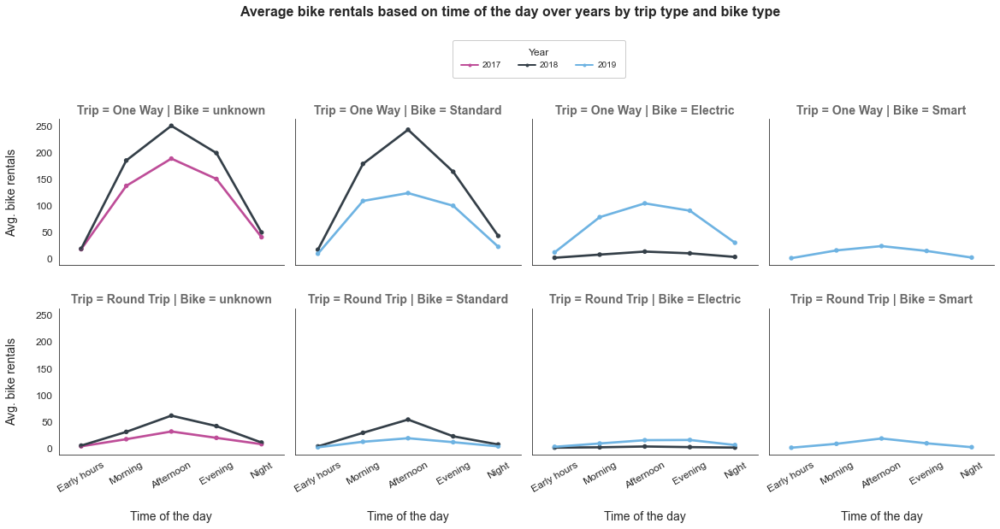

In [881]:
# Assign palette as per requirement
sb.set_style('white')
flatui = ['#cc3f9d', '#31404a', '#60b6f0']
sb.set_palette(flatui, n_colors=3, desat=0.8)

# Facet grid with point plot
plot_order = daytime_df.daytime.sort_values(ascending=True).unique()
g = sb.FacetGrid(data = daytime_df, col = 'bike_type', row = 'trip_type', height = 4, aspect = 1, hue = 'year')
g.map(sb.pointplot, "daytime", "rentals", order= plot_order, linestyles = "-", ci = None, markers = ['.']);
g.fig.subplots_adjust(top=0.75)
g.fig.suptitle('Average bike rentals based on time of the day over years by trip type and bike type', 
               fontsize = 16, weight = 'bold')
g.set_titles('Trip = {row_name} | Bike = {col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# improve plot aesthetics
# -------------------------------------------------------
g.set_xlabels('\nTime of the day', size = 14)
g.set_ylabels('Avg. bike rentals\n', size = 14)
g.set_yticklabels(size = 12)
# iterate over axes of FacetGrid
for ax in g.axes.flat:
     # get x labels
    labels = ax.get_xticklabels()
    # set new labels
    ax.set_xticklabels(labels, rotation = 30, size = 12)
# -------------------------------------------------------

# add custom legend
# -------------------------------------------------------
custom = [Line2D([], [], marker='.', color=sb.color_palette()[0], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[1], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[2], linestyle='-', linewidth = 2)]

plt.legend(custom, ['2017', '2018', '2019'], scatterpoints=1, frameon=True, fancybox=True, 
           shadow=False, framealpha = 1, borderpad=1, borderaxespad=1, labelspacing=0.5, 
           ncol = 3, title='Year', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(-0.6, 2.9));
# -------------------------------------------------------

plt.subplots_adjust(wspace=0.05, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.3.48 Average bike rentals based on daytime over the years by trip type and bike type.png', dpi=300, bbox_inches='tight')

----

#### 3.3.49 Multivariate analysis of `day`, `year`, `trip_type` and `bike_type` columns:

+ `Columns`: day, year, trip_type, bike_type
+ `Data type`: (Categorical, ordered), (Categorical, ordered), (Categorical, nominal) and (Categorical, nominal)
+ `Plot`: Point plot

**`Find average rentals based on the day of the month over years:`**

Create a dataset which contain bike rentals relative to each `day` over respective months in the year. Care should be taken as to inlcude only days that appear in every month over individual years. Use available categorical combinations and do not fill the `NULL` values with numerical zero's so as to consider bike rentals subjected to every day in any month.

In [882]:
# create a dataset for bike rentals over each day in a month
days_df = bikeshare.groupby([bikeshare["year"], 
                             bikeshare["month"],
                             bikeshare["day"],
                             bikeshare["trip_type"],
                             bikeshare["bike_type"]]).count()['trip_id'].reset_index(name='rentals')
days_df.head(10)

,year,month,day,trip_type,bike_type,rentals
0,2017,1,1,One Way,unknown,228.0
1,2017,1,1,One Way,Standard,NaN
2,2017,1,1,One Way,Electric,NaN
3,2017,1,1,One Way,Smart,NaN
4,2017,1,1,Round Trip,unknown,42.0
5,2017,1,1,Round Trip,Standard,NaN
6,2017,1,1,Round Trip,Electric,NaN
7,2017,1,1,Round Trip,Smart,NaN
8,2017,1,2,One Way,unknown,228.0
9,2017,1,2,One Way,Standard,NaN


**`Point plot:`**

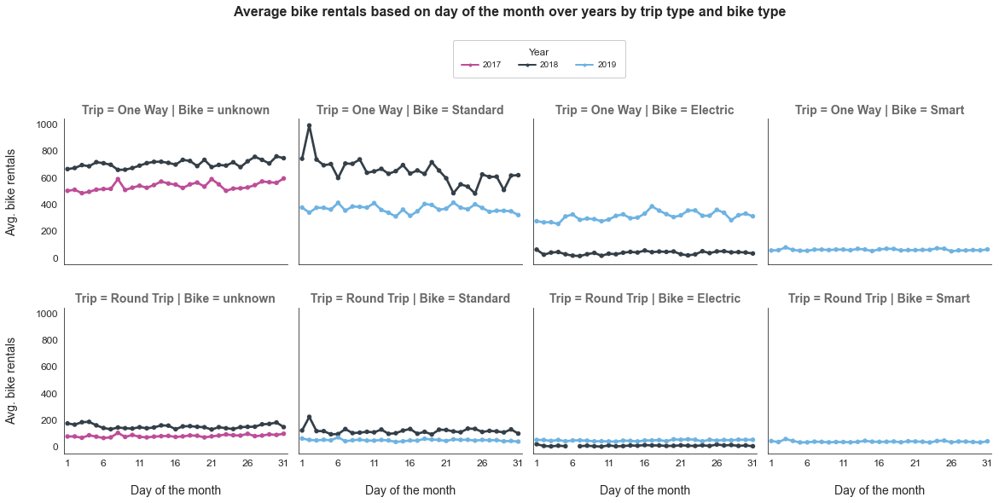

In [883]:
# Assign palette as per requirement
sb.set_style('white')
flatui = ['#cc3f9d', '#31404a', '#60b6f0']
sb.set_palette(flatui, n_colors=3, desat=0.8)

# Facet grid with point plot
plot_order = days_df.day.sort_values(ascending=True).unique()
g = sb.FacetGrid(data = days_df, col = 'bike_type', row = 'trip_type', height = 4, aspect = 1, hue = 'year')
g.map(sb.pointplot, "day", "rentals", order= plot_order, linestyles = "-", ci = None, markers = ['.']);
g.fig.subplots_adjust(top=0.75)
g.fig.suptitle('Average bike rentals based on day of the month over years by trip type and bike type', 
               fontsize = 16, weight = 'bold')
g.set_titles('Trip = {row_name} | Bike = {col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# improve plot aesthetics
# -------------------------------------------------------
g.set_xlabels('\nDay of the month', size = 14)
g.set_ylabels('Avg. bike rentals\n', size = 14)
g.set_yticklabels(size = 12)
# iterate over axes of FacetGrid
for ax in g.axes.flat:
     # get x labels
    labels = ax.get_xticklabels()
    for i,l in enumerate(labels):
        # skip labels
        if not (i%5 == 0): labels[i] = ''
    # set new labels
    ax.set_xticklabels(labels, size = 12)
# -------------------------------------------------------

# add custom legend
# -------------------------------------------------------
custom = [Line2D([], [], marker='.', color=sb.color_palette()[0], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[1], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[2], linestyle='-', linewidth = 2)]

plt.legend(custom, ['2017', '2018', '2019'], scatterpoints=1, frameon=True, fancybox=True, 
           shadow=False, framealpha = 1, borderpad=1, borderaxespad=1, labelspacing=0.5, 
           ncol = 3, title='Year', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(-0.6, 2.9));
# -------------------------------------------------------

plt.subplots_adjust(wspace=0.05, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.3.49 Average bike rentals based on day over the years by trip type and bike type.png', dpi=300, bbox_inches='tight')

----

#### 3.3.50 Multivariate analysis of `weekday`, `year`, `trip_type` and `bike_type` columns:

+ `Columns`: weekday, year, trip_type, bike_type
+ `Data type`: (Categorical, ordered), (Categorical, ordered), (Categorical, nominal) and (Categorical, nominal)
+ `Plot`: Point plot

**`Find average rentals based on the day of the week over years:`**

Create a dataset which contain bike rentals relative to each `day` over respective week in the month. Care should be taken as to inlcude only days that appear in every week over individual months. Use available categorical combinations and do not fill the `NULL` values with numerical zero's so as to consider bike rentals subjected to every day in any week.

In [884]:
# create a dataset for bike rentals over each day in a week
weekday_df = bikeshare.groupby([bikeshare["year"], 
                                bikeshare["month"],
                                bikeshare["week"],
                                bikeshare["weekday"],
                                bikeshare["trip_type"],
                                bikeshare["bike_type"]]).count()['trip_id'].reset_index(name='rentals')
weekday_df.head(10)

,year,month,week,weekday,trip_type,bike_type,rentals
0,2017,1,First,Monday,One Way,unknown,228.0
1,2017,1,First,Monday,One Way,Standard,NaN
2,2017,1,First,Monday,One Way,Electric,NaN
3,2017,1,First,Monday,One Way,Smart,NaN
4,2017,1,First,Monday,Round Trip,unknown,31.0
5,2017,1,First,Monday,Round Trip,Standard,NaN
6,2017,1,First,Monday,Round Trip,Electric,NaN
7,2017,1,First,Monday,Round Trip,Smart,NaN
8,2017,1,First,Tuesday,One Way,unknown,288.0
9,2017,1,First,Tuesday,One Way,Standard,NaN


**`Point plot:`**

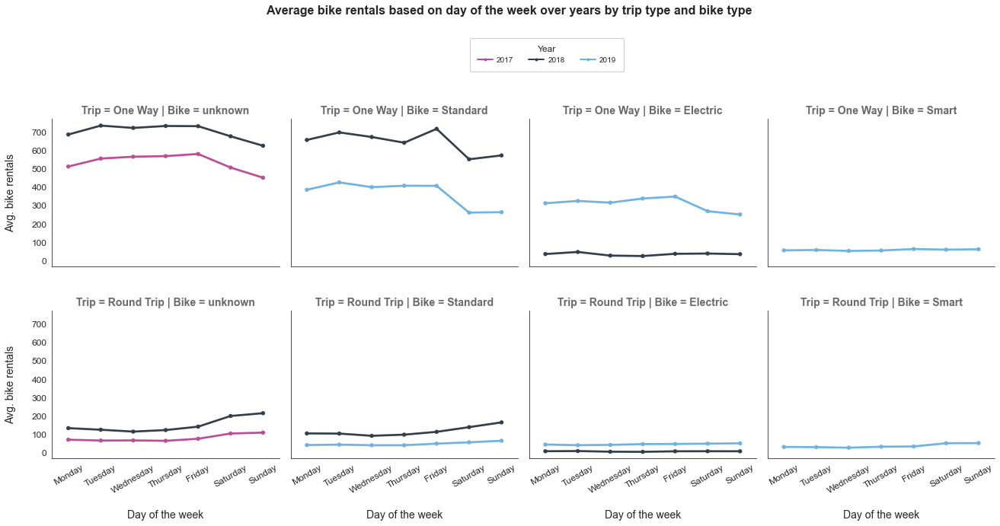

In [885]:
# Assign palette as per requirement
sb.set_style('white')
flatui = ['#cc3f9d', '#31404a', '#60b6f0']
sb.set_palette(flatui, n_colors=3, desat=0.8)

# Facet grid with point plot
plot_order = weekday_df.weekday.sort_values(ascending=True).unique()
g = sb.FacetGrid(data = weekday_df, col = 'bike_type', row = 'trip_type', height = 4.5, aspect = 1, hue = 'year')
g.map(sb.pointplot, "weekday", "rentals", order= plot_order, linestyles = "-", ci = None, markers = ['.']);
g.fig.subplots_adjust(top=0.75)
g.fig.suptitle('Average bike rentals based on day of the week over years by trip type and bike type', 
               fontsize = 16, weight = 'bold')
g.set_titles('Trip = {row_name} | Bike = {col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# improve plot aesthetics
# -------------------------------------------------------
g.set_xlabels('\nDay of the week', size = 14)
g.set_ylabels('Avg. bike rentals\n', size = 14)
g.set_yticklabels(size = 12)
# iterate over axes of FacetGrid
for ax in g.axes.flat:
     # get x labels
    labels = ax.get_xticklabels()
    # set new labels
    ax.set_xticklabels(labels, rotation = 30, size = 12)
# -------------------------------------------------------

# add custom legend
# -------------------------------------------------------
custom = [Line2D([], [], marker='.', color=sb.color_palette()[0], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[1], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[2], linestyle='-', linewidth = 2)]

plt.legend(custom, ['2017', '2018', '2019'], scatterpoints=1, frameon=True, fancybox=True, 
           shadow=False, framealpha = 1, borderpad=1, borderaxespad=1, labelspacing=0.5, 
           ncol = 3, title='Year', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(-0.6, 2.9));
# -------------------------------------------------------

plt.subplots_adjust(wspace=0.05, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.3.50 Average bike rentals based on weekday over the years by trip type and bike type.png', dpi=300, bbox_inches='tight')

----

#### 3.3.51 Multivariate analysis of `month`, `year`, `trip_type` and `bike_type` columns:

+ `Columns`: month, year, trip_type, bike_type
+ `Data type`: (Categorical, ordered), (Categorical, ordered), (Categorical, nominal) and (Categorical, nominal)
+ `Plot`: Point plot

**`Find average rentals based on the month over years:`**

Create a dataset which contain bike rentals relative to each `month` over respective years. Care should be taken as to inlcude only rentals that appear in every month over individual years. Use available categorical combinations and do not fill the `NULL` values with numerical zero's so as to consider bike rentals subjected to every month in any year.

In [886]:
# create a dataset for bike rentals over each month in a year
month_df = bikeshare.groupby([bikeshare["year"], 
                              bikeshare["month"],
                              bikeshare["trip_type"],
                              bikeshare["bike_type"]]).count()['trip_id'].reset_index(name='rentals')
month_df.head(10)

,year,month,trip_type,bike_type,rentals
0,2017,1,One Way,unknown,9195.0
1,2017,1,One Way,Standard,NaN
2,2017,1,One Way,Electric,NaN
3,2017,1,One Way,Smart,NaN
4,2017,1,Round Trip,unknown,961.0
5,2017,1,Round Trip,Standard,NaN
6,2017,1,Round Trip,Electric,NaN
7,2017,1,Round Trip,Smart,NaN
8,2017,2,One Way,unknown,8557.0
9,2017,2,One Way,Standard,NaN


**`Point plot:`**

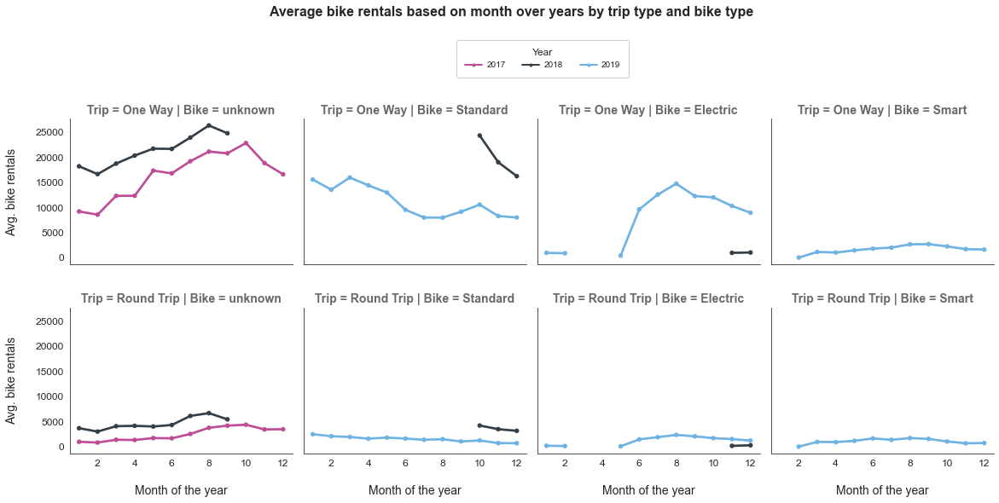

In [887]:
# Assign palette as per requirement
sb.set_style('white')
flatui = ['#cc3f9d', '#31404a', '#60b6f0']
sb.set_palette(flatui, n_colors=3, desat=0.8)

# Facet grid with point plot
plot_order = month_df.month.sort_values(ascending=True).unique()
g = sb.FacetGrid(data = month_df, col = 'bike_type', row = 'trip_type', height = 4, aspect = 1, hue = 'year')
g.map(sb.pointplot, "month", "rentals", order= plot_order, linestyles = "-", ci = None, markers = ['.']);
g.fig.subplots_adjust(top=0.75)
g.fig.suptitle('Average bike rentals based on month over years by trip type and bike type', 
               fontsize = 16, weight = 'bold')
g.set_titles('Trip = {row_name} | Bike = {col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# improve plot aesthetics
# -------------------------------------------------------
g.set_xlabels('\nMonth of the year', size = 14)
g.set_ylabels('Avg. bike rentals\n', size = 14)
g.set_yticklabels(size = 12)
# iterate over axes of FacetGrid
for ax in g.axes.flat:
    # get x labels
    xlabels = ax.get_xticklabels()
    for i,l in enumerate(xlabels):
        # skip labels
        if (i%2 == 0): xlabels[i] = ''
    # set new xlabels
    ax.set_xticklabels(xlabels, size = 12)
# -------------------------------------------------------

# add custom legend
# -------------------------------------------------------
custom = [Line2D([], [], marker='.', color=sb.color_palette()[0], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[1], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[2], linestyle='-', linewidth = 2)]

plt.legend(custom, ['2017', '2018', '2019'], scatterpoints=1, frameon=True, fancybox=True, 
           shadow=False, framealpha = 1, borderpad=1, borderaxespad=1, labelspacing=0.5, 
           ncol = 3, title='Year', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(-0.6, 2.9));
# -------------------------------------------------------

plt.subplots_adjust(wspace=0.05, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.3.51 Average bike rentals based on month over the years by trip type and bike type.png', dpi=300, bbox_inches='tight')

----

#### 3.3.52 Multivariate analysis of `quarter`, `year`, `trip_type` and `bike_type` columns:

+ `Columns`: quarter, year, trip_type, bike_type
+ `Data type`: (Categorical, ordered), (Categorical, ordered), (Categorical, nominal) and (Categorical, nominal)
+ `Plot`: Point plot

**`Find average rentals based on the quarter over years:`**

Create a dataset which contain bike rentals relative to each `quarter` over respective years. Care should be taken as to inlcude only rentals that appear in every quarter over individual years. Use available categorical combinations and do not fill the `NULL` values with numerical zero's so as to consider bike rentals subjected to every quarter in any year.

In [888]:
# create a dataset for bike rentals over each day in a week
quarter_df = bikeshare.groupby([bikeshare["year"], 
                                bikeshare["quarter"],
                                bikeshare["trip_type"],
                                bikeshare["bike_type"]]).count()['trip_id'].reset_index(name='rentals')
quarter_df.head(10)

,year,quarter,trip_type,bike_type,rentals
0,2017,Q1,One Way,unknown,30057.0
1,2017,Q1,One Way,Standard,NaN
2,2017,Q1,One Way,Electric,NaN
3,2017,Q1,One Way,Smart,NaN
4,2017,Q1,Round Trip,unknown,3141.0
5,2017,Q1,Round Trip,Standard,NaN
6,2017,Q1,Round Trip,Electric,NaN
7,2017,Q1,Round Trip,Smart,NaN
8,2017,Q2,One Way,unknown,46415.0
9,2017,Q2,One Way,Standard,NaN


**`Point plot:`**

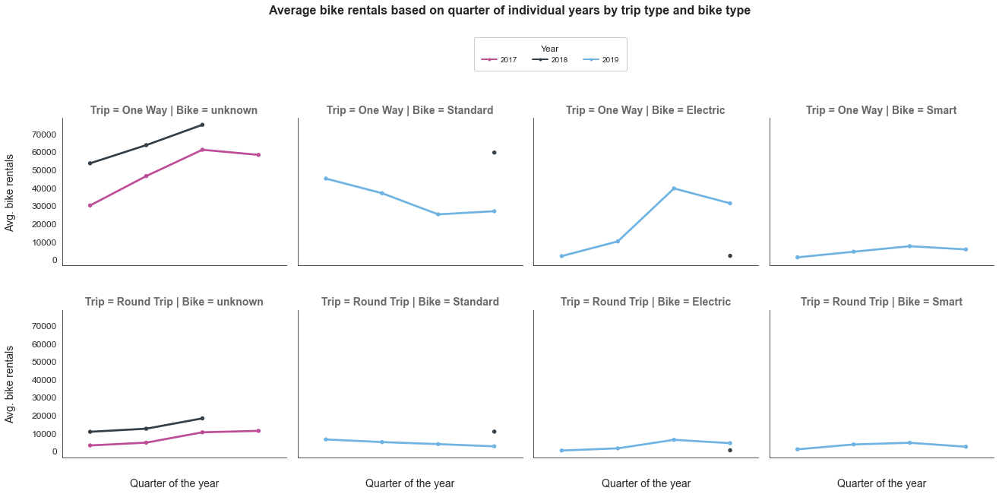

In [889]:
# Assign palette as per requirement
sb.set_style('white')
flatui = ['#cc3f9d', '#31404a', '#60b6f0']
sb.set_palette(flatui, n_colors=3, desat=0.8)

# Facet grid with point plot
plot_order = quarter_df.quarter.sort_values(ascending=True).unique()
g = sb.FacetGrid(data = quarter_df, col = 'bike_type', row = 'trip_type', height = 4.5, aspect = 1, hue = 'year')
g.map(sb.pointplot, "quarter", "rentals", order= plot_order, linestyles = "-", ci = None, markers = ['.']);
g.fig.subplots_adjust(top=0.75)
g.fig.suptitle('Average bike rentals based on quarter of individual years by trip type and bike type', 
               fontsize = 16, weight = 'bold')
g.set_titles('Trip = {row_name} | Bike = {col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# improve plot aesthetics
# -------------------------------------------------------
g.set_xlabels('\nQuarter of the year', size = 14)
g.set_ylabels('Avg. bike rentals\n', size = 14)
g.set_xticklabels(size = 12)
g.set_yticklabels(size = 12)
# -------------------------------------------------------

# add custom legend
# -------------------------------------------------------
custom = [Line2D([], [], marker='.', color=sb.color_palette()[0], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[1], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[2], linestyle='-', linewidth = 2)]

plt.legend(custom, ['2017', '2018', '2019'], scatterpoints=1, frameon=True, fancybox=True, 
           shadow=False, framealpha = 1, borderpad=1, borderaxespad=1, labelspacing=0.5, 
           ncol = 3, title='Year', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(-0.6, 2.9));
# -------------------------------------------------------

plt.subplots_adjust(wspace=0.05, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.3.52 Average bike rentals based on quarter of individual years by trip type and bike type.png', dpi=300, bbox_inches='tight')

-----

#### 3.3.53 Multivariate analysis of `hour`, `year`, `trip_type` and `pass_type` columns:

+ `Columns`: hour, year, trip_type, pass_type
+ `Data type`: (Categorical, ordered), (Categorical, ordered), (Categorical, nominal) and (Categorical, nominal)
+ `Plot`: Point plot

**`Find average rentals based on the hour over years:`**

Create a dataset which contain bike rentals relative to each `hour` in the day over respective months in the year. Care should be taken as to inlcude only hours that appear in every day of the month over individual years. Use available categorical combinations and do not fill the `NULL` values with numerical zero's so as to consider bike rentals subjected to every hour in any day.

In [890]:
# create a dataset for bike rentals over each hour in a day
hours_df = bikeshare.groupby([bikeshare["year"], 
                              bikeshare["month"],
                              bikeshare["day"],
                              bikeshare["hour"],
                              bikeshare["trip_type"],
                              bikeshare["pass_type"]]).count()['trip_id'].reset_index(name='rentals')
hours_df.head(10)

,year,month,day,hour,trip_type,pass_type,rentals
0,2017,1,1,0,One Way,Walk-up,3.0
1,2017,1,1,0,One Way,One Day,NaN
2,2017,1,1,0,One Way,Monthly,3.0
3,2017,1,1,0,One Way,Flex,NaN
4,2017,1,1,0,One Way,Annual,NaN
5,2017,1,1,0,Round Trip,Walk-up,3.0
6,2017,1,1,0,Round Trip,One Day,NaN
7,2017,1,1,0,Round Trip,Monthly,NaN
8,2017,1,1,0,Round Trip,Flex,NaN
9,2017,1,1,0,Round Trip,Annual,NaN


**`Point plot:`**

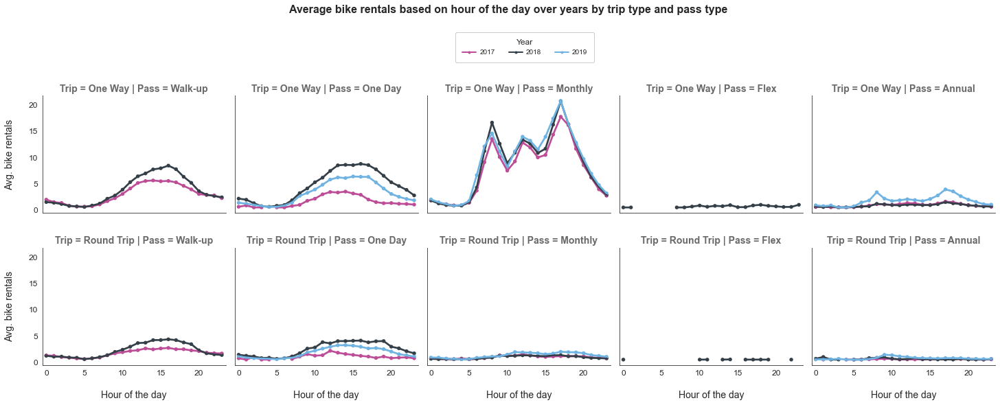

In [891]:
# Assign palette as per requirement
sb.set_style('white')
flatui = ['#cc3f9d', '#31404a', '#60b6f0']
sb.set_palette(flatui, n_colors=3, desat=0.8)

# Facet grid with point plot
plot_order = hours_df.hour.sort_values(ascending=True).unique()
g = sb.FacetGrid(data = hours_df, col = 'pass_type', row = 'trip_type', height = 4, aspect = 1, hue = 'year')
g.map(sb.pointplot, "hour", "rentals", order= plot_order, linestyles = "-", ci = None, markers = ['.']);
g.fig.subplots_adjust(top=0.75)
g.fig.suptitle('Average bike rentals based on hour of the day over years by trip type and pass type', 
               fontsize = 16, weight = 'bold')
g.set_titles('Trip = {row_name} | Pass = {col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# improve plot aesthetics
# -------------------------------------------------------
g.set_xlabels('\nHour of the day', size = 14)
g.set_ylabels('Avg. bike rentals\n', size = 14)
g.set_yticklabels(size = 12)
# iterate over axes of FacetGrid
for ax in g.axes.flat:
     # get x labels
    labels = ax.get_xticklabels()
    for i,l in enumerate(labels):
        # skip labels
        if not (i%5 == 0): labels[i] = ''
    # set new labels
    ax.set_xticklabels(labels, size = 12)
# -------------------------------------------------------

# add custom legend
# -------------------------------------------------------
custom = [Line2D([], [], marker='.', color=sb.color_palette()[0], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[1], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[2], linestyle='-', linewidth = 2)]

plt.legend(custom, ['2017', '2018', '2019'], scatterpoints=1, frameon=True, fancybox=True, 
           shadow=False, framealpha = 1, borderpad=1, borderaxespad=1, labelspacing=0.5, 
           ncol = 3, title='Year', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(-1.15, 2.9));
# -------------------------------------------------------

plt.subplots_adjust(wspace=0.05, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.3.53 Average bike rentals based on hour over the years by trip type and pass type.png', dpi=300, bbox_inches='tight')

----

#### 3.3.54 Multivariate analysis of `daytime`, `year`, `trip_type` and `pass_type` columns:

+ `Columns`: daytime, year, trip_type, pass_type
+ `Data type`: (Categorical, ordered), (Categorical, ordered), (Categorical, nominal) and (Categorical, nominal)
+ `Plot`: Point plot

**`Find average rentals based on the daytime of the day over years:`**

Create a dataset which contain bike rentals relative to each `daytime` in the day over respective months in the year. Care should be taken as to inlcude only daytimes that appear in every day of the month over individual years. Use available categorical combinations and do not fill the `NULL` values with numerical zero's so as to consider bike rentals subjected to every daytime in any day.

In [892]:
# create a dataset for bike rentals over each day in a week
daytime_df = bikeshare.groupby([bikeshare["year"], 
                                bikeshare["month"],
                                bikeshare["day"],
                                bikeshare["daytime"],
                                bikeshare["trip_type"],
                                bikeshare["pass_type"]]).count()['trip_id'].reset_index(name='rentals')
daytime_df.head(10)

,year,month,day,daytime,trip_type,pass_type,rentals
0,2017,1,1,Early hours,One Way,Walk-up,16.0
1,2017,1,1,Early hours,One Way,One Day,NaN
2,2017,1,1,Early hours,One Way,Monthly,8.0
3,2017,1,1,Early hours,One Way,Flex,NaN
4,2017,1,1,Early hours,One Way,Annual,NaN
5,2017,1,1,Early hours,Round Trip,Walk-up,3.0
6,2017,1,1,Early hours,Round Trip,One Day,NaN
7,2017,1,1,Early hours,Round Trip,Monthly,NaN
8,2017,1,1,Early hours,Round Trip,Flex,NaN
9,2017,1,1,Early hours,Round Trip,Annual,NaN


**`Point plot:`**

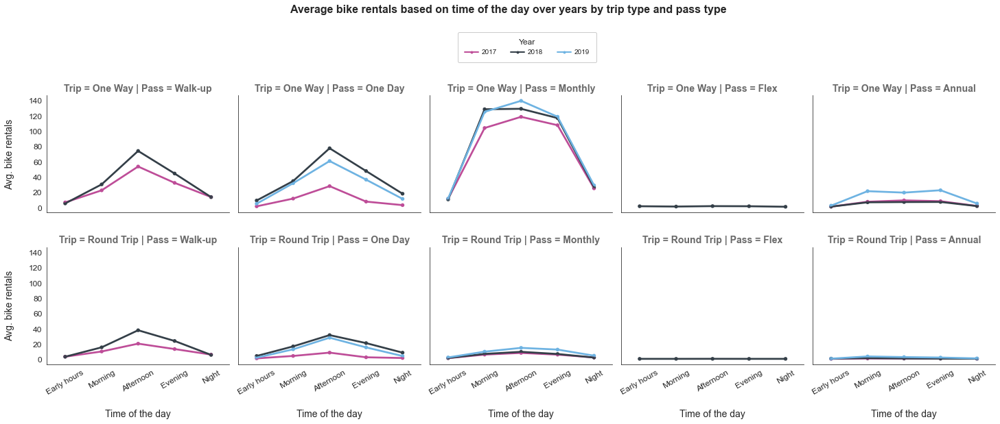

In [893]:
# Assign palette as per requirement
sb.set_style('white')
flatui = ['#cc3f9d', '#31404a', '#60b6f0']
sb.set_palette(flatui, n_colors=3, desat=0.8)

# Facet grid with point plot
plot_order = daytime_df.daytime.sort_values(ascending=True).unique()
g = sb.FacetGrid(data = daytime_df, col = 'pass_type', row = 'trip_type', height = 4, aspect = 1, hue = 'year')
g.map(sb.pointplot, "daytime", "rentals", order= plot_order, linestyles = "-", ci = None, markers = ['.']);
g.fig.subplots_adjust(top=0.75)
g.fig.suptitle('Average bike rentals based on time of the day over years by trip type and pass type', 
               fontsize = 16, weight = 'bold')
g.set_titles('Trip = {row_name} | Pass = {col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# improve plot aesthetics
# -------------------------------------------------------
g.set_xlabels('\nTime of the day', size = 14)
g.set_ylabels('Avg. bike rentals\n', size = 14)
g.set_yticklabels(size = 12)
# iterate over axes of FacetGrid
for ax in g.axes.flat:
     # get x labels
    labels = ax.get_xticklabels()
    # set new labels
    ax.set_xticklabels(labels, rotation = 30, size = 12)
# -------------------------------------------------------

# add custom legend
# -------------------------------------------------------
custom = [Line2D([], [], marker='.', color=sb.color_palette()[0], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[1], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[2], linestyle='-', linewidth = 2)]

plt.legend(custom, ['2017', '2018', '2019'], scatterpoints=1, frameon=True, fancybox=True, 
           shadow=False, framealpha = 1, borderpad=1, borderaxespad=1, labelspacing=0.5, 
           ncol = 3, title='Year', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(-1.15, 2.9));
# -------------------------------------------------------

plt.subplots_adjust(wspace=0.05, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.3.54 Average bike rentals based on daytime over the years by trip type and pass type.png', dpi=300, bbox_inches='tight')

----

#### 3.3.55 Multivariate analysis of `day`, `year`, `trip_type` and `pass_type` columns:

+ `Columns`: day, year, trip_type, pass_type
+ `Data type`: (Categorical, ordered), (Categorical, ordered), (Categorical, nominal) and (Categorical, nominal)
+ `Plot`: Point plot

**`Find average rentals based on the day of the month over years:`**

Create a dataset which contain bike rentals relative to each `day` over respective months in the year. Care should be taken as to inlcude only days that appear in every month over individual years. Use available categorical combinations and do not fill the `NULL` values with numerical zero's so as to consider bike rentals subjected to every day in any month.

In [894]:
# create a dataset for bike rentals over each day in a month
days_df = bikeshare.groupby([bikeshare["year"], 
                             bikeshare["month"],
                             bikeshare["day"],
                             bikeshare["trip_type"],
                             bikeshare["pass_type"]]).count()['trip_id'].reset_index(name='rentals')
days_df.head(10)

,year,month,day,trip_type,pass_type,rentals
0,2017,1,1,One Way,Walk-up,129.0
1,2017,1,1,One Way,One Day,NaN
2,2017,1,1,One Way,Monthly,88.0
3,2017,1,1,One Way,Flex,NaN
4,2017,1,1,One Way,Annual,11.0
5,2017,1,1,Round Trip,Walk-up,40.0
6,2017,1,1,Round Trip,One Day,NaN
7,2017,1,1,Round Trip,Monthly,2.0
8,2017,1,1,Round Trip,Flex,NaN
9,2017,1,1,Round Trip,Annual,NaN


**`Point plot:`**

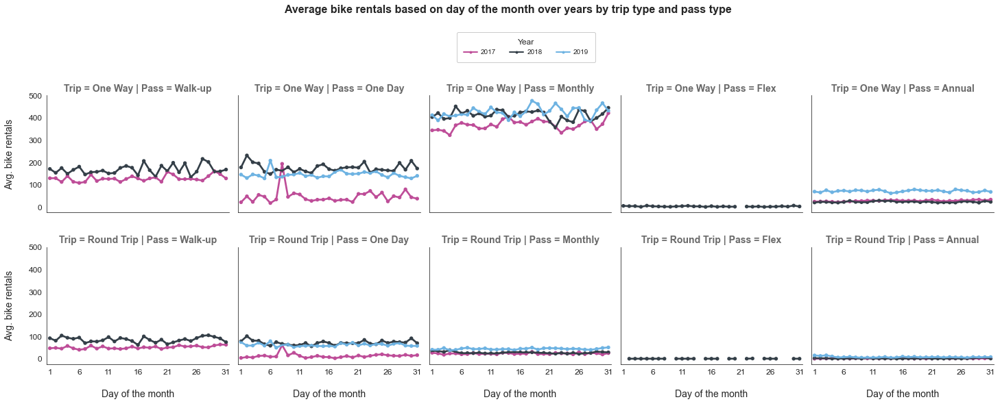

In [895]:
# Assign palette as per requirement
sb.set_style('white')
flatui = ['#cc3f9d', '#31404a', '#60b6f0']
sb.set_palette(flatui, n_colors=3, desat=0.8)

# Facet grid with point plot
plot_order = days_df.day.sort_values(ascending=True).unique()
g = sb.FacetGrid(data = days_df, col = 'pass_type', row = 'trip_type', height = 4, aspect = 1, hue = 'year')
g.map(sb.pointplot, "day", "rentals", order= plot_order, linestyles = "-", ci = None, markers = ['.']);
g.fig.subplots_adjust(top=0.75)
g.fig.suptitle('Average bike rentals based on day of the month over years by trip type and pass type', 
               fontsize = 16, weight = 'bold')
g.set_titles('Trip = {row_name} | Pass = {col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# improve plot aesthetics
# -------------------------------------------------------
g.set_xlabels('\nDay of the month', size = 14)
g.set_ylabels('Avg. bike rentals\n', size = 14)
g.set_yticklabels(size = 12)
# iterate over axes of FacetGrid
for ax in g.axes.flat:
     # get x labels
    labels = ax.get_xticklabels()
    for i,l in enumerate(labels):
        # skip labels
        if not (i%5 == 0): labels[i] = ''
    # set new labels
    ax.set_xticklabels(labels, size = 12)
# -------------------------------------------------------

# add custom legend
# -------------------------------------------------------
custom = [Line2D([], [], marker='.', color=sb.color_palette()[0], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[1], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[2], linestyle='-', linewidth = 2)]

plt.legend(custom, ['2017', '2018', '2019'], scatterpoints=1, frameon=True, fancybox=True, 
           shadow=False, framealpha = 1, borderpad=1, borderaxespad=1, labelspacing=0.5, 
           ncol = 3, title='Year', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(-1.15, 2.9));
# -------------------------------------------------------

plt.subplots_adjust(wspace=0.05, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.3.55 Average bike rentals based on day over the years by trip type and pass type.png', dpi=300, bbox_inches='tight')

----

#### 3.3.56 Multivariate analysis of `weekday`, `year`, `trip_type` and `pass_type` columns:

+ `Columns`: weekday, year, trip_type, pass_type
+ `Data type`: (Categorical, ordered), (Categorical, ordered), (Categorical, nominal) and (Categorical, nominal)
+ `Plot`: Point plot

**`Find average rentals based on the day of the week over years:`**

Create a dataset which contain bike rentals relative to each `day` over respective week in the month. Care should be taken as to inlcude only days that appear in every week over individual months. Use available categorical combinations and do not fill the `NULL` values with numerical zero's so as to consider bike rentals subjected to every day in any week.

In [896]:
# create a dataset for bike rentals over each day in a week
weekday_df = bikeshare.groupby([bikeshare["year"], 
                                bikeshare["month"],
                                bikeshare["week"],
                                bikeshare["weekday"],
                                bikeshare["trip_type"],
                                bikeshare["pass_type"]]).count()['trip_id'].reset_index(name='rentals')
weekday_df.head(10)

,year,month,week,weekday,trip_type,pass_type,rentals
0,2017,1,First,Monday,One Way,Walk-up,91.0
1,2017,1,First,Monday,One Way,One Day,NaN
2,2017,1,First,Monday,One Way,Monthly,115.0
3,2017,1,First,Monday,One Way,Flex,NaN
4,2017,1,First,Monday,One Way,Annual,22.0
5,2017,1,First,Monday,Round Trip,Walk-up,24.0
6,2017,1,First,Monday,Round Trip,One Day,NaN
7,2017,1,First,Monday,Round Trip,Monthly,6.0
8,2017,1,First,Monday,Round Trip,Flex,NaN
9,2017,1,First,Monday,Round Trip,Annual,1.0


**`Point plot:`**

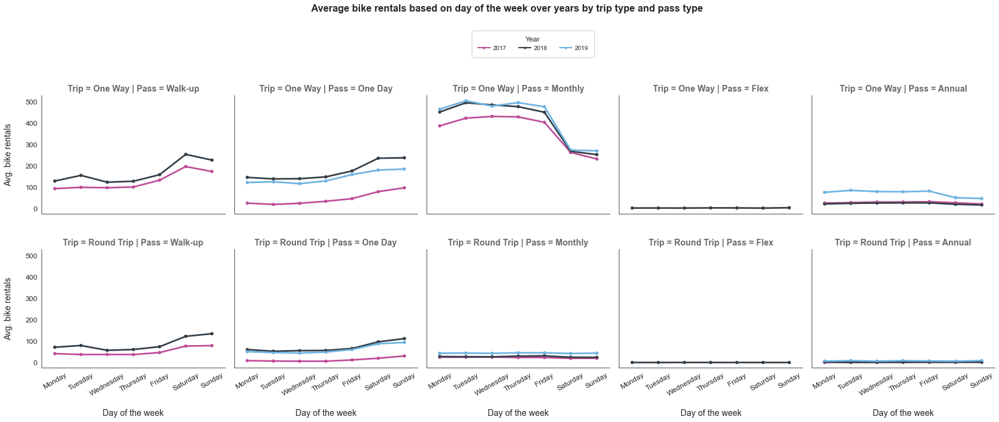

In [897]:
# Assign palette as per requirement
sb.set_style('white')
flatui = ['#cc3f9d', '#31404a', '#60b6f0']
sb.set_palette(flatui, n_colors=3, desat=0.8)

# Facet grid with point plot
plot_order = weekday_df.weekday.sort_values(ascending=True).unique()
g = sb.FacetGrid(data = weekday_df, col = 'pass_type', row = 'trip_type', height = 4.5, aspect = 1, hue = 'year')
g.map(sb.pointplot, "weekday", "rentals", order= plot_order, linestyles = "-", ci = None, markers = ['.']);
g.fig.subplots_adjust(top=0.75)
g.fig.suptitle('Average bike rentals based on day of the week over years by trip type and pass type', 
               fontsize = 16, weight = 'bold')
g.set_titles('Trip = {row_name} | Pass = {col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# improve plot aesthetics
# -------------------------------------------------------
g.set_xlabels('\nDay of the week', size = 14)
g.set_ylabels('Avg. bike rentals\n', size = 14)
g.set_yticklabels(size = 12)
# iterate over axes of FacetGrid
for ax in g.axes.flat:
     # get x labels
    labels = ax.get_xticklabels()
    # set new labels
    ax.set_xticklabels(labels, rotation = 30, size = 12)
# -------------------------------------------------------

# add custom legend
# -------------------------------------------------------
custom = [Line2D([], [], marker='.', color=sb.color_palette()[0], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[1], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[2], linestyle='-', linewidth = 2)]

plt.legend(custom, ['2017', '2018', '2019'], scatterpoints=1, frameon=True, fancybox=True, 
           shadow=False, framealpha = 1, borderpad=1, borderaxespad=1, labelspacing=0.5, 
           ncol = 3, title='Year', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(-1.15, 2.9));
# -------------------------------------------------------

plt.subplots_adjust(wspace=0.05, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.3.56 Average bike rentals based on weekday over the years by trip type and pass type.png', dpi=300, bbox_inches='tight')

----

#### 3.3.57 Multivariate analysis of `month`, `year`, `trip_type` and `pass_type` columns:

+ `Columns`: month, year, trip_type, pass_type
+ `Data type`: (Categorical, ordered), (Categorical, ordered), (Categorical, nominal) and (Categorical, nominal)
+ `Plot`: Point plot

**`Find average rentals based on the month over years:`**

Create a dataset which contain bike rentals relative to each `month` over respective years. Care should be taken as to inlcude only rentals that appear in every month over individual years. Use available categorical combinations and do not fill the `NULL` values with numerical zero's so as to consider bike rentals subjected to every month in any year.

In [898]:
# create a dataset for bike rentals over each month in a year
month_df = bikeshare.groupby([bikeshare["year"], 
                              bikeshare["month"],
                              bikeshare["trip_type"],
                              bikeshare["pass_type"]]).count()['trip_id'].reset_index(name='rentals')
month_df.head(10)

,year,month,trip_type,pass_type,rentals
0,2017,1,One Way,Walk-up,2555.0
1,2017,1,One Way,One Day,NaN
2,2017,1,One Way,Monthly,5998.0
3,2017,1,One Way,Flex,NaN
4,2017,1,One Way,Annual,642.0
5,2017,1,Round Trip,Walk-up,632.0
6,2017,1,Round Trip,One Day,NaN
7,2017,1,Round Trip,Monthly,308.0
8,2017,1,Round Trip,Flex,NaN
9,2017,1,Round Trip,Annual,21.0


**`Point plot:`**

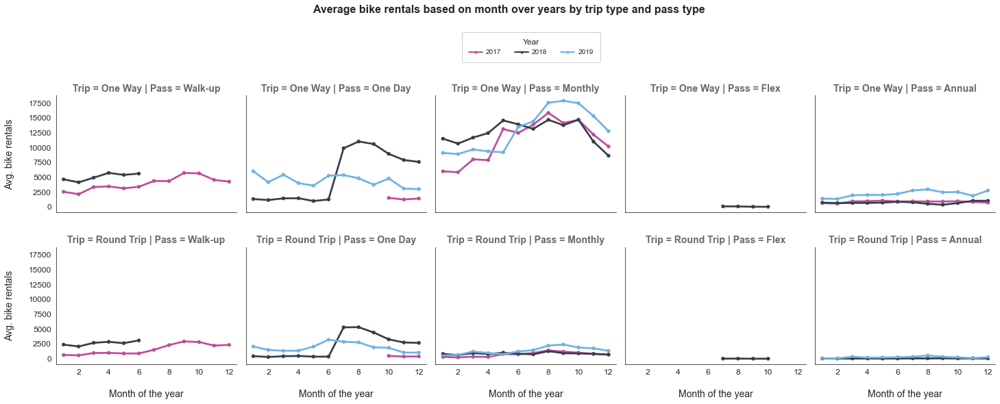

In [899]:
# Assign palette as per requirement
sb.set_style('white')
flatui = ['#cc3f9d', '#31404a', '#60b6f0']
sb.set_palette(flatui, n_colors=3, desat=0.8)

# Facet grid with point plot
plot_order = month_df.month.sort_values(ascending=True).unique()
g = sb.FacetGrid(data = month_df, col = 'pass_type', row = 'trip_type', height = 4, aspect = 1, hue = 'year')
g.map(sb.pointplot, "month", "rentals", order= plot_order, linestyles = "-", ci = None, markers = ['.']);
g.fig.subplots_adjust(top=0.75)
g.fig.suptitle('Average bike rentals based on month over years by trip type and pass type', 
               fontsize = 16, weight = 'bold')
g.set_titles('Trip = {row_name} | Pass = {col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# improve plot aesthetics
# -------------------------------------------------------
g.set_xlabels('\nMonth of the year', size = 14)
g.set_ylabels('Avg. bike rentals\n', size = 14)
g.set_yticklabels(size = 12)
# iterate over axes of FacetGrid
for ax in g.axes.flat:
    # get x labels
    xlabels = ax.get_xticklabels()
    for i,l in enumerate(xlabels):
        # skip labels
        if (i%2 == 0): xlabels[i] = ''
    # set new xlabels
    ax.set_xticklabels(xlabels, size = 12)
# -------------------------------------------------------

# add custom legend
# -------------------------------------------------------
custom = [Line2D([], [], marker='.', color=sb.color_palette()[0], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[1], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[2], linestyle='-', linewidth = 2)]

plt.legend(custom, ['2017', '2018', '2019'], scatterpoints=1, frameon=True, fancybox=True, 
           shadow=False, framealpha = 1, borderpad=1, borderaxespad=1, labelspacing=0.5, 
           ncol = 3, title='Year', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(-1.15, 2.9));
# -------------------------------------------------------

plt.subplots_adjust(wspace=0.05, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.3.57 Average bike rentals based on month over the years by trip type and pass type.png', dpi=300, bbox_inches='tight')

----

#### 3.3.58 Multivariate analysis of `quarter`, `year`, `trip_type` and `pass_type` columns:

+ `Columns`: quarter, year, trip_type, pass_type
+ `Data type`: (Categorical, ordered), (Categorical, ordered), (Categorical, nominal) and (Categorical, nominal)
+ `Plot`: Point plot

**`Find average rentals based on the quarter over years:`**

Create a dataset which contain bike rentals relative to each `quarter` over respective years. Care should be taken as to inlcude only rentals that appear in every quarter over individual years. Use available categorical combinations and do not fill the `NULL` values with numerical zero's so as to consider bike rentals subjected to every quarter in any year.

In [900]:
# create a dataset for bike rentals over each day in a week
quarter_df = bikeshare.groupby([bikeshare["year"], 
                                bikeshare["quarter"],
                                bikeshare["trip_type"],
                                bikeshare["pass_type"]]).count()['trip_id'].reset_index(name='rentals')
quarter_df.head(10)

,year,quarter,trip_type,pass_type,rentals
0,2017,Q1,One Way,Walk-up,8054.0
1,2017,Q1,One Way,One Day,NaN
2,2017,Q1,One Way,Monthly,19862.0
3,2017,Q1,One Way,Flex,NaN
4,2017,Q1,One Way,Annual,2141.0
5,2017,Q1,Round Trip,Walk-up,2157.0
6,2017,Q1,Round Trip,One Day,NaN
7,2017,Q1,Round Trip,Monthly,868.0
8,2017,Q1,Round Trip,Flex,NaN
9,2017,Q1,Round Trip,Annual,116.0


**`Point plot:`**

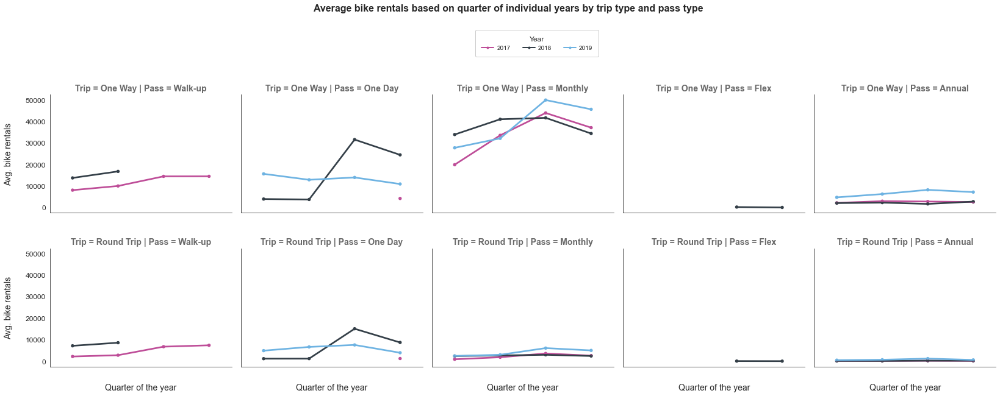

In [901]:
# Assign palette as per requirement
sb.set_style('white')
flatui = ['#cc3f9d', '#31404a', '#60b6f0']
sb.set_palette(flatui, n_colors=3, desat=0.8)

# Facet grid with point plot
plot_order = quarter_df.quarter.sort_values(ascending=True).unique()
g = sb.FacetGrid(data = quarter_df, col = 'pass_type', row = 'trip_type', height = 4.5, aspect = 1, hue = 'year')
g.map(sb.pointplot, "quarter", "rentals", order= plot_order, linestyles = "-", ci = None, markers = ['.']);
g.fig.subplots_adjust(top=0.75)
g.fig.suptitle('Average bike rentals based on quarter of individual years by trip type and pass type', 
               fontsize = 16, weight = 'bold')
g.set_titles('Trip = {row_name} | Pass = {col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# improve plot aesthetics
# -------------------------------------------------------
g.set_xlabels('\nQuarter of the year', size = 14)
g.set_ylabels('Avg. bike rentals\n', size = 14)
g.set_xticklabels(size = 12)
g.set_yticklabels(size = 12)
# -------------------------------------------------------

# add custom legend
# -------------------------------------------------------
custom = [Line2D([], [], marker='.', color=sb.color_palette()[0], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[1], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[2], linestyle='-', linewidth = 2)]

plt.legend(custom, ['2017', '2018', '2019'], scatterpoints=1, frameon=True, fancybox=True, 
           shadow=False, framealpha = 1, borderpad=1, borderaxespad=1, labelspacing=0.5, 
           ncol = 3, title='Year', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(-1.15, 2.9));
# -------------------------------------------------------

plt.subplots_adjust(wspace=0.05, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.3.58 Average bike rentals based on quarter of individual years by trip type and pass type.png', dpi=300, bbox_inches='tight')

-----

#### 3.3.59 Multivariate analysis of `hour`, `year`, `trip_type` and `fare_type` columns:

+ `Columns`: hour, year, trip_type, fare_type
+ `Data type`: (numerical, continuous), (Categorical, ordered), (Categorical, nominal) and (Categorical, nominal)
+ `Plot`: Point plot

**`Find average rentals based on the hour over years:`**

Create a dataset which contain bike rentals relative to each `hour` in the day over respective months in the year. Care should be taken as to inlcude only hours that appear in every day of the month over individual years. Use available categorical combinations and do not fill the `NULL` values with numerical zero's so as to consider bike rentals subjected to every hour in any day.

In [902]:
# create a dataset for bike rentals over each hour in a day
hours_df = bikeshare.groupby([bikeshare["year"], 
                              bikeshare["month"],
                              bikeshare["day"],
                              bikeshare["hour"],
                              bikeshare["trip_type"],
                              bikeshare["fare_type"]]).count()['trip_id'].reset_index(name='rentals')
hours_df.head(10)

,year,month,day,hour,trip_type,fare_type,rentals
0,2017,1,1,0,One Way,Base,6.0
1,2017,1,1,0,One Way,Extended,NaN
2,2017,1,1,0,Round Trip,Base,1.0
3,2017,1,1,0,Round Trip,Extended,2.0
4,2017,1,1,1,One Way,Base,5.0
5,2017,1,1,1,One Way,Extended,NaN
6,2017,1,1,1,Round Trip,Base,NaN
7,2017,1,1,1,Round Trip,Extended,NaN
8,2017,1,1,2,One Way,Base,7.0
9,2017,1,1,2,One Way,Extended,1.0


**`Point plot:`**

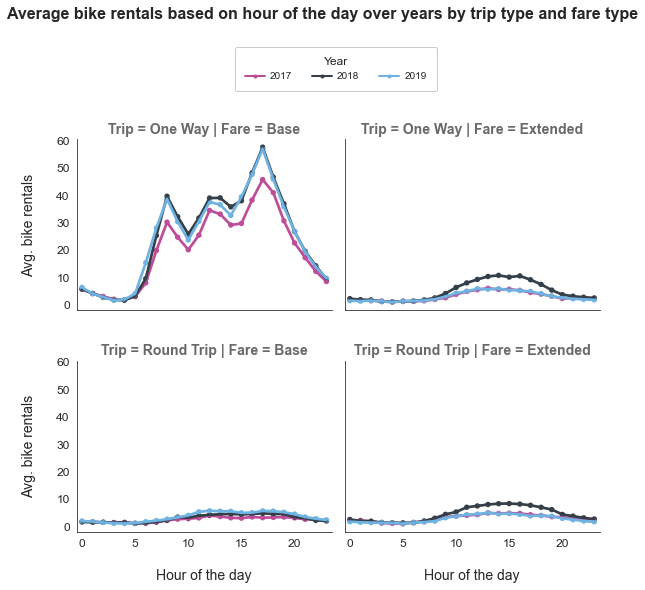

In [903]:
# Assign palette as per requirement
sb.set_style('white')
flatui = ['#cc3f9d', '#31404a', '#60b6f0']
sb.set_palette(flatui, n_colors=3, desat=0.8)

# Facet grid with point plot
plot_order = hours_df.hour.sort_values(ascending=True).unique()
g = sb.FacetGrid(data = hours_df, col = 'fare_type', row = 'trip_type', height = 4, aspect = 1, hue = 'year')
g.map(sb.pointplot, "hour", "rentals", order= plot_order, linestyles = "-", ci = None, markers = ['.']);
g.fig.subplots_adjust(top=0.75)
g.fig.suptitle('Average bike rentals based on hour of the day over years by trip type and fare type', 
               fontsize = 16, weight = 'bold')
g.set_titles('Trip = {row_name} | Fare = {col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# improve plot aesthetics
# -------------------------------------------------------
g.set_xlabels('\nHour of the day', size = 14)
g.set_ylabels('Avg. bike rentals\n', size = 14)
g.set_yticklabels(size = 12)
# iterate over axes of FacetGrid
for ax in g.axes.flat:
     # get x labels
    labels = ax.get_xticklabels()
    for i,l in enumerate(labels):
        # skip labels
        if not (i%5 == 0): labels[i] = ''
    # set new labels
    ax.set_xticklabels(labels, size = 12)
# -------------------------------------------------------

# add custom legend
# -------------------------------------------------------
custom = [Line2D([], [], marker='.', color=sb.color_palette()[0], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[1], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[2], linestyle='-', linewidth = 2)]

plt.legend(custom, ['2017', '2018', '2019'], scatterpoints=1, frameon=True, fancybox=True, 
           shadow=False, framealpha = 1, borderpad=1, borderaxespad=1, labelspacing=0.5, 
           ncol = 3, title='Year', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(0.4, 2.9));
# -------------------------------------------------------

plt.subplots_adjust(wspace=0.05, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.3.59 Average bike rentals based on hour over the years by trip type and fare type.png', dpi=300, bbox_inches='tight')

----

#### 3.3.60 Multivariate analysis of `daytime`, `year`, `trip_type` and `fare_type` columns:

+ `Columns`: daytime, year, trip_type, fare_type
+ `Data type`: (Categorical, ordered), (Categorical, ordered), (Categorical, nominal) and (Categorical, nominal)
+ `Plot`: Point plot

**`Find average rentals based on the daytime of the day over years:`**

Create a dataset which contain bike rentals relative to each `daytime` in the day over respective months in the year. Care should be taken as to inlcude only daytimes that appear in every day of the month over individual years. Use available categorical combinations and do not fill the `NULL` values with numerical zero's so as to consider bike rentals subjected to every daytime in any day.

In [904]:
# create a dataset for bike rentals over each day in a week
daytime_df = bikeshare.groupby([bikeshare["year"], 
                                bikeshare["month"],
                                bikeshare["day"],
                                bikeshare["daytime"],
                                bikeshare["trip_type"],
                                bikeshare["fare_type"]]).count()['trip_id'].reset_index(name='rentals')
daytime_df.head(10)

,year,month,day,daytime,trip_type,fare_type,rentals
0,2017,1,1,Early hours,One Way,Base,23.0
1,2017,1,1,Early hours,One Way,Extended,1.0
2,2017,1,1,Early hours,Round Trip,Base,1.0
3,2017,1,1,Early hours,Round Trip,Extended,2.0
4,2017,1,1,Morning,One Way,Base,24.0
5,2017,1,1,Morning,One Way,Extended,9.0
6,2017,1,1,Morning,Round Trip,Base,2.0
7,2017,1,1,Morning,Round Trip,Extended,NaN
8,2017,1,1,Afternoon,One Way,Base,102.0
9,2017,1,1,Afternoon,One Way,Extended,20.0


**`Point plot:`**

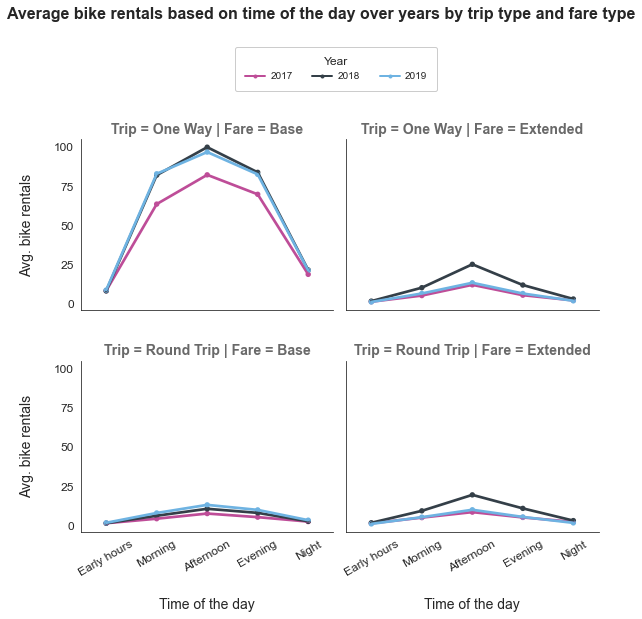

In [905]:
# Assign palette as per requirement
sb.set_style('white')
flatui = ['#cc3f9d', '#31404a', '#60b6f0']
sb.set_palette(flatui, n_colors=3, desat=0.8)

# Facet grid with point plot
plot_order = daytime_df.daytime.sort_values(ascending=True).unique()
g = sb.FacetGrid(data = daytime_df, col = 'fare_type', row = 'trip_type', height = 4, aspect = 1, hue = 'year')
g.map(sb.pointplot, "daytime", "rentals", order= plot_order, linestyles = "-", ci = None, markers = ['.']);
g.fig.subplots_adjust(top=0.75)
g.fig.suptitle('Average bike rentals based on time of the day over years by trip type and fare type', 
               fontsize = 16, weight = 'bold')
g.set_titles('Trip = {row_name} | Fare = {col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# improve plot aesthetics
# -------------------------------------------------------
g.set_xlabels('\nTime of the day', size = 14)
g.set_ylabels('Avg. bike rentals\n', size = 14)
g.set_yticklabels(size = 12)
# iterate over axes of FacetGrid
for ax in g.axes.flat:
     # get x labels
    labels = ax.get_xticklabels()
    # set new labels
    ax.set_xticklabels(labels, rotation = 30, size = 12)
# -------------------------------------------------------

# add custom legend
# -------------------------------------------------------
custom = [Line2D([], [], marker='.', color=sb.color_palette()[0], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[1], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[2], linestyle='-', linewidth = 2)]

plt.legend(custom, ['2017', '2018', '2019'], scatterpoints=1, frameon=True, fancybox=True, 
           shadow=False, framealpha = 1, borderpad=1, borderaxespad=1, labelspacing=0.5, 
           ncol = 3, title='Year', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(0.4, 2.9));
# -------------------------------------------------------

plt.subplots_adjust(wspace=0.05, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.3.60 Average bike rentals based on daytime over the years by trip type and fare type.png', dpi=300, bbox_inches='tight')

----

#### 3.3.61 Multivariate analysis of `day`, `year`, `trip_type` and `fare_type` columns:

+ `Columns`: day, year, trip_type, fare_type
+ `Data type`: (Categorical, ordered), (Categorical, ordered), (Categorical, nominal) and (Categorical, nominal)
+ `Plot`: Point plot

**`Find average rentals based on the day of the month over years:`**

Create a dataset which contain bike rentals relative to each `day` over respective months in the year. Care should be taken as to inlcude only days that appear in every month over individual years. Use available categorical combinations and do not fill the `NULL` values with numerical zero's so as to consider bike rentals subjected to every day in any month.

In [906]:
# create a dataset for bike rentals over each day in a month
days_df = bikeshare.groupby([bikeshare["year"], 
                             bikeshare["month"],
                             bikeshare["day"],
                             bikeshare["trip_type"],
                             bikeshare["fare_type"]]).count()['trip_id'].reset_index(name='rentals')
days_df.head(10)

,year,month,day,trip_type,fare_type,rentals
0,2017,1,1,One Way,Base,192.0
1,2017,1,1,One Way,Extended,36.0
2,2017,1,1,Round Trip,Base,19.0
3,2017,1,1,Round Trip,Extended,23.0
4,2017,1,2,One Way,Base,196.0
5,2017,1,2,One Way,Extended,32.0
6,2017,1,2,Round Trip,Base,18.0
7,2017,1,2,Round Trip,Extended,13.0
8,2017,1,3,One Way,Base,277.0
9,2017,1,3,One Way,Extended,11.0


**`Point plot:`**

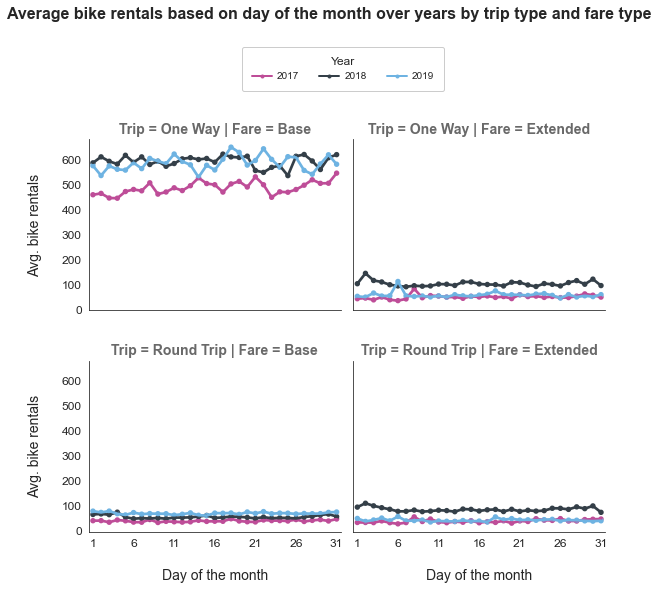

In [907]:
# Assign palette as per requirement
sb.set_style('white')
flatui = ['#cc3f9d', '#31404a', '#60b6f0']
sb.set_palette(flatui, n_colors=3, desat=0.8)

# Facet grid with point plot
plot_order = days_df.day.sort_values(ascending=True).unique()
g = sb.FacetGrid(data = days_df, col = 'fare_type', row = 'trip_type', height = 4, aspect = 1, hue = 'year')
g.map(sb.pointplot, "day", "rentals", order= plot_order, linestyles = "-", ci = None, markers = ['.']);
g.fig.subplots_adjust(top=0.75)
g.fig.suptitle('Average bike rentals based on day of the month over years by trip type and fare type', 
               fontsize = 16, weight = 'bold')
g.set_titles('Trip = {row_name} | Fare = {col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# improve plot aesthetics
# -------------------------------------------------------
g.set_xlabels('\nDay of the month', size = 14)
g.set_ylabels('Avg. bike rentals\n', size = 14)
g.set_yticklabels(size = 12)
# iterate over axes of FacetGrid
for ax in g.axes.flat:
     # get x labels
    labels = ax.get_xticklabels()
    for i,l in enumerate(labels):
        # skip labels
        if not (i%5 == 0): labels[i] = ''
    # set new labels
    ax.set_xticklabels(labels, size = 12)
# -------------------------------------------------------

# add custom legend
# -------------------------------------------------------
custom = [Line2D([], [], marker='.', color=sb.color_palette()[0], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[1], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[2], linestyle='-', linewidth = 2)]

plt.legend(custom, ['2017', '2018', '2019'], scatterpoints=1, frameon=True, fancybox=True, 
           shadow=False, framealpha = 1, borderpad=1, borderaxespad=1, labelspacing=0.5, 
           ncol = 3, title='Year', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(0.4, 2.9));
# -------------------------------------------------------

plt.subplots_adjust(wspace=0.05, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.3.61 Average bike rentals based on day over the years by trip type and fare type.png', dpi=300, bbox_inches='tight')

----

#### 3.3.62 Multivariate analysis of `weekday`, `year`, `trip_type` and `fare_type` columns:

+ `Columns`: weekday, year, trip_type, fare_type
+ `Data type`: (Categorical, ordered), (Categorical, ordered), (Categorical, nominal) and (Categorical, nominal)
+ `Plot`: Point plot

**`Find average rentals based on the day of the week over years:`**

Create a dataset which contain bike rentals relative to each `day` over respective week in the month. Care should be taken as to inlcude only days that appear in every week over individual months. Use available categorical combinations and do not fill the `NULL` values with numerical zero's so as to consider bike rentals subjected to every day in any week.

In [908]:
# create a dataset for bike rentals over each day in a week
weekday_df = bikeshare.groupby([bikeshare["year"], 
                                bikeshare["month"],
                                bikeshare["week"],
                                bikeshare["weekday"],
                                bikeshare["trip_type"],
                                bikeshare["fare_type"]]).count()['trip_id'].reset_index(name='rentals')
weekday_df.head(10)

,year,month,week,weekday,trip_type,fare_type,rentals
0,2017,1,First,Monday,One Way,Base,196.0
1,2017,1,First,Monday,One Way,Extended,32.0
2,2017,1,First,Monday,Round Trip,Base,18.0
3,2017,1,First,Monday,Round Trip,Extended,13.0
4,2017,1,First,Tuesday,One Way,Base,277.0
5,2017,1,First,Tuesday,One Way,Extended,11.0
6,2017,1,First,Tuesday,Round Trip,Base,19.0
7,2017,1,First,Tuesday,Round Trip,Extended,20.0
8,2017,1,First,Wednesday,One Way,Base,306.0
9,2017,1,First,Wednesday,One Way,Extended,19.0


**`Point plot:`**

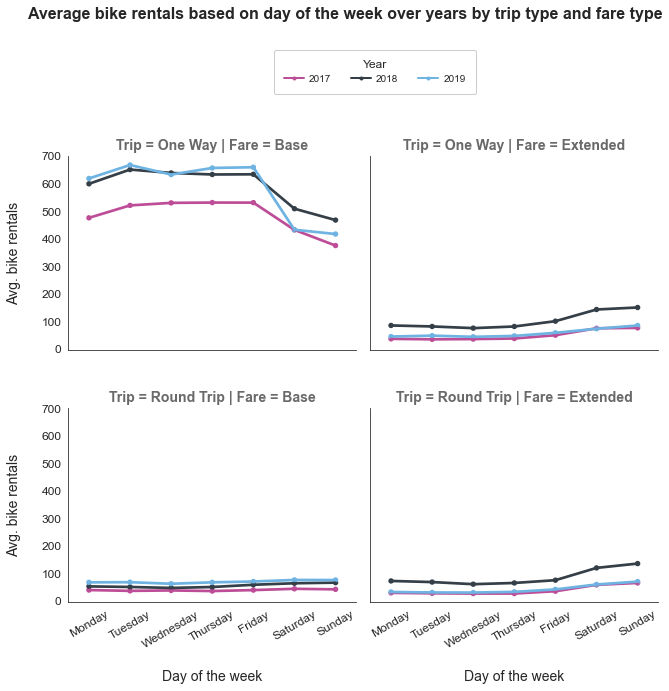

In [909]:
# Assign palette as per requirement
sb.set_style('white')
flatui = ['#cc3f9d', '#31404a', '#60b6f0']
sb.set_palette(flatui, n_colors=3, desat=0.8)

# Facet grid with point plot
plot_order = weekday_df.weekday.sort_values(ascending=True).unique()
g = sb.FacetGrid(data = weekday_df, col = 'fare_type', row = 'trip_type', height = 4.5, aspect = 1, hue = 'year')
g.map(sb.pointplot, "weekday", "rentals", order= plot_order, linestyles = "-", ci = None, markers = ['.']);
g.fig.subplots_adjust(top=0.75)
g.fig.suptitle('Average bike rentals based on day of the week over years by trip type and fare type', 
               fontsize = 16, weight = 'bold')
g.set_titles('Trip = {row_name} | Fare = {col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# improve plot aesthetics
# -------------------------------------------------------
g.set_xlabels('\nDay of the week', size = 14)
g.set_ylabels('Avg. bike rentals\n', size = 14)
g.set_yticklabels(size = 12)
# iterate over axes of FacetGrid
for ax in g.axes.flat:
     # get x labels
    labels = ax.get_xticklabels()
    # set new labels
    ax.set_xticklabels(labels, rotation = 30, size = 12)
# -------------------------------------------------------

# add custom legend
# -------------------------------------------------------
custom = [Line2D([], [], marker='.', color=sb.color_palette()[0], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[1], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[2], linestyle='-', linewidth = 2)]

plt.legend(custom, ['2017', '2018', '2019'], scatterpoints=1, frameon=True, fancybox=True, 
           shadow=False, framealpha = 1, borderpad=1, borderaxespad=1, labelspacing=0.5, 
           ncol = 3, title='Year', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(0.4, 2.9));
# -------------------------------------------------------

plt.subplots_adjust(wspace=0.05, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.3.62 Average bike rentals based on weekday over the years by trip type and fare type.png', dpi=300, bbox_inches='tight')

----

#### 3.3.63 Multivariate analysis of `month`, `year`, `trip_type` and `fare_type` columns:

+ `Columns`: month, year, trip_type, fare_type
+ `Data type`: (Categorical, ordered), (Categorical, ordered), (Categorical, nominal) and (Categorical, nominal)
+ `Plot`: Point plot

**`Find average rentals based on the month over years:`**

Create a dataset which contain bike rentals relative to each `month` over respective years. Care should be taken as to inlcude only rentals that appear in every month over individual years. Use available categorical combinations and do not fill the `NULL` values with numerical zero's so as to consider bike rentals subjected to every month in any year.

In [910]:
# create a dataset for bike rentals over each month in a year
month_df = bikeshare.groupby([bikeshare["year"], 
                              bikeshare["month"],
                              bikeshare["trip_type"],
                              bikeshare["fare_type"]]).count()['trip_id'].reset_index(name='rentals')
month_df.head(10)

,year,month,trip_type,fare_type,rentals
0,2017,1,One Way,Base,8354
1,2017,1,One Way,Extended,841
2,2017,1,Round Trip,Base,571
3,2017,1,Round Trip,Extended,390
4,2017,2,One Way,Base,8004
5,2017,2,One Way,Extended,553
6,2017,2,Round Trip,Base,446
7,2017,2,Round Trip,Extended,365
8,2017,3,One Way,Base,11438
9,2017,3,One Way,Extended,867


**`Point plot:`**

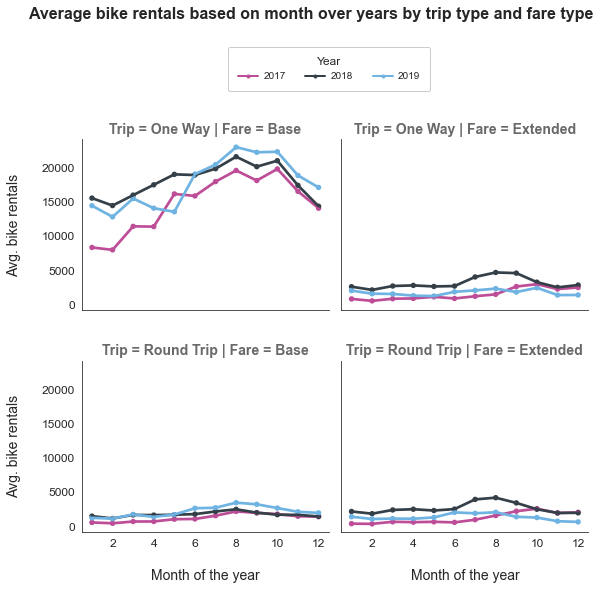

In [911]:
# Assign palette as per requirement
sb.set_style('white')
flatui = ['#cc3f9d', '#31404a', '#60b6f0']
sb.set_palette(flatui, n_colors=3, desat=0.8)

# Facet grid with point plot
plot_order = month_df.month.sort_values(ascending=True).unique()
g = sb.FacetGrid(data = month_df, col = 'fare_type', row = 'trip_type', height = 4, aspect = 1, hue = 'year')
g.map(sb.pointplot, "month", "rentals", order= plot_order, linestyles = "-", ci = None, markers = ['.']);
g.fig.subplots_adjust(top=0.75)
g.fig.suptitle('Average bike rentals based on month over years by trip type and fare type', 
               fontsize = 16, weight = 'bold')
g.set_titles('Trip = {row_name} | Fare = {col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# improve plot aesthetics
# -------------------------------------------------------
g.set_xlabels('\nMonth of the year', size = 14)
g.set_ylabels('Avg. bike rentals\n', size = 14)
g.set_yticklabels(size = 12)
# iterate over axes of FacetGrid
for ax in g.axes.flat:
    # get x labels
    xlabels = ax.get_xticklabels()
    for i,l in enumerate(xlabels):
        # skip labels
        if (i%2 == 0): xlabels[i] = ''
    # set new xlabels
    ax.set_xticklabels(xlabels, size = 12)
# -------------------------------------------------------

# add custom legend
# -------------------------------------------------------
custom = [Line2D([], [], marker='.', color=sb.color_palette()[0], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[1], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[2], linestyle='-', linewidth = 2)]

plt.legend(custom, ['2017', '2018', '2019'], scatterpoints=1, frameon=True, fancybox=True, 
           shadow=False, framealpha = 1, borderpad=1, borderaxespad=1, labelspacing=0.5, 
           ncol = 3, title='Year', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(0.4, 2.9));
# -------------------------------------------------------

plt.subplots_adjust(wspace=0.05, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.3.63 Average bike rentals based on month over the years by trip type and fare type.png', dpi=300, bbox_inches='tight')

----

#### 3.3.64 Multivariate analysis of `quarter`, `year`, `trip_type` and `fare_type` columns:

+ `Columns`: quarter, year, trip_type, fare_type
+ `Data type`: (Categorical, ordered), (Categorical, ordered), (Categorical, nominal) and (Categorical, nominal)
+ `Plot`: Point plot

**`Find average rentals based on the quarter over years:`**

Create a dataset which contain bike rentals relative to each `quarter` over respective years. Care should be taken as to inlcude only rentals that appear in every quarter over individual years. Use available categorical combinations and do not fill the `NULL` values with numerical zero's so as to consider bike rentals subjected to every quarter in any year.

In [912]:
# create a dataset for bike rentals over each day in a week
quarter_df = bikeshare.groupby([bikeshare["year"], 
                                bikeshare["quarter"],
                                bikeshare["trip_type"],
                                bikeshare["fare_type"]]).count()['trip_id'].reset_index(name='rentals')
quarter_df.head(10)

,year,quarter,trip_type,fare_type,rentals
0,2017,Q1,One Way,Base,27796
1,2017,Q1,One Way,Extended,2261
2,2017,Q1,Round Trip,Base,1721
3,2017,Q1,Round Trip,Extended,1420
4,2017,Q2,One Way,Base,43454
5,2017,Q2,One Way,Extended,2961
6,2017,Q2,Round Trip,Base,2832
7,2017,Q2,Round Trip,Extended,1852
8,2017,Q3,One Way,Base,55699
9,2017,Q3,One Way,Extended,5385


**`Point plot:`**

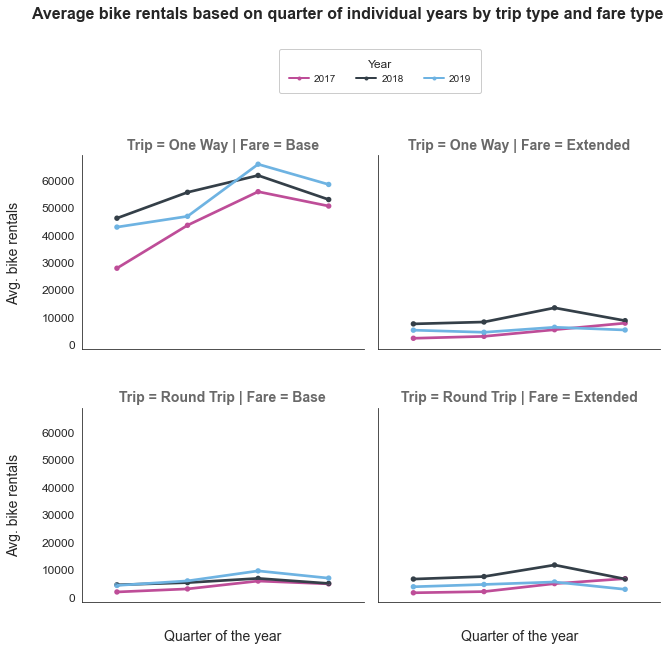

In [913]:
# Assign palette as per requirement
sb.set_style('white')
flatui = ['#cc3f9d', '#31404a', '#60b6f0']
sb.set_palette(flatui, n_colors=3, desat=0.8)

# Facet grid with point plot
plot_order = quarter_df.quarter.sort_values(ascending=True).unique()
g = sb.FacetGrid(data = quarter_df, col = 'fare_type', row = 'trip_type', height = 4.5, aspect = 1, hue = 'year')
g.map(sb.pointplot, "quarter", "rentals", order= plot_order, linestyles = "-", ci = None, markers = ['.']);
g.fig.subplots_adjust(top=0.75)
g.fig.suptitle('Average bike rentals based on quarter of individual years by trip type and fare type', 
               fontsize = 16, weight = 'bold')
g.set_titles('Trip = {row_name} | Fare = {col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# improve plot aesthetics
# -------------------------------------------------------
g.set_xlabels('\nQuarter of the year', size = 14)
g.set_ylabels('Avg. bike rentals\n', size = 14)
g.set_xticklabels(size = 12)
g.set_yticklabels(size = 12)
# -------------------------------------------------------

# add custom legend
# -------------------------------------------------------
custom = [Line2D([], [], marker='.', color=sb.color_palette()[0], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[1], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[2], linestyle='-', linewidth = 2)]

plt.legend(custom, ['2017', '2018', '2019'], scatterpoints=1, frameon=True, fancybox=True, 
           shadow=False, framealpha = 1, borderpad=1, borderaxespad=1, labelspacing=0.5, 
           ncol = 3, title='Year', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(0.4, 2.9));
# -------------------------------------------------------

plt.subplots_adjust(wspace=0.05, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.3.64 Average bike rentals based on quarter of individual years by trip type and fare type.png', dpi=300, bbox_inches='tight')

----

#### 3.3.65 Multivariate analysis of `hour`, `year`, `fare_type` and `bike_type` columns:

+ `Columns`: hour, year, fare_type, bike_type
+ `Data type`: (Categorical, ordered), (Categorical, ordered), (Categorical, nominal) and (Categorical, nominal)
+ `Plot`: Point plot

**`Find average rentals based on the hour over years:`**

Create a dataset which contain bike rentals relative to each `hour` in the day over respective months in the year. Care should be taken as to inlcude only hours that appear in every day of the month over individual years. Use available categorical combinations and do not fill the `NULL` values with numerical zero's so as to consider bike rentals subjected to every hour in any day.

In [914]:
# create a dataset for bike rentals over each hour in a day
hours_df = bikeshare.groupby([bikeshare["year"], 
                              bikeshare["month"],
                              bikeshare["day"],
                              bikeshare["hour"],
                              bikeshare["fare_type"],
                              bikeshare["bike_type"]]).count()['trip_id'].reset_index(name='rentals')
hours_df.head(10)

,year,month,day,hour,fare_type,bike_type,rentals
0,2017,1,1,0,Base,unknown,7.0
1,2017,1,1,0,Base,Standard,NaN
2,2017,1,1,0,Base,Electric,NaN
3,2017,1,1,0,Base,Smart,NaN
4,2017,1,1,0,Extended,unknown,2.0
5,2017,1,1,0,Extended,Standard,NaN
6,2017,1,1,0,Extended,Electric,NaN
7,2017,1,1,0,Extended,Smart,NaN
8,2017,1,1,1,Base,unknown,5.0
9,2017,1,1,1,Base,Standard,NaN


**`Point plot:`**

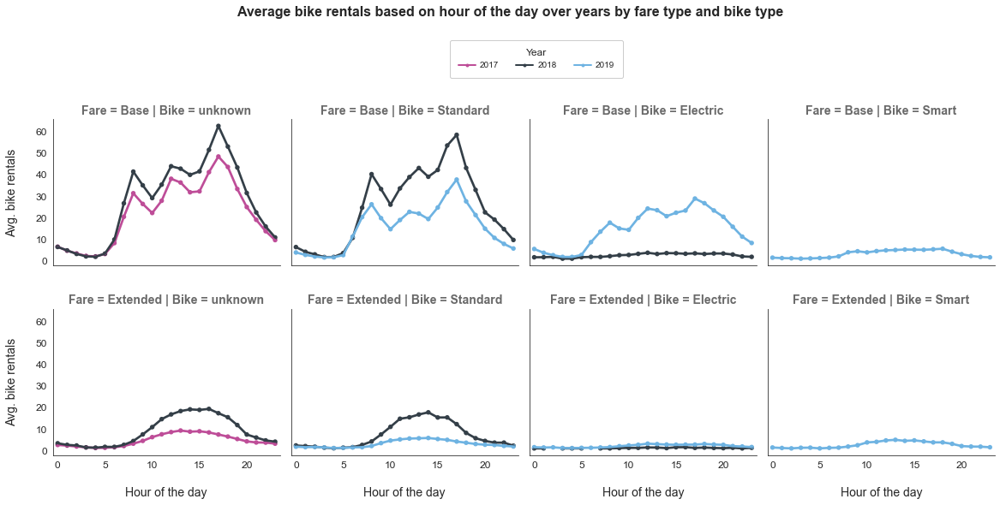

In [915]:
# Assign palette as per requirement
sb.set_style('white')
flatui = ['#cc3f9d', '#31404a', '#60b6f0']
sb.set_palette(flatui, n_colors=3, desat=0.8)

# Facet grid with point plot
plot_order = hours_df.hour.sort_values(ascending=True).unique()
g = sb.FacetGrid(data = hours_df, col = 'bike_type', row = 'fare_type', height = 4, aspect = 1, hue = 'year')
g.map(sb.pointplot, "hour", "rentals", order= plot_order, linestyles = "-", ci = None, markers = ['.']);
g.fig.subplots_adjust(top=0.75)
g.fig.suptitle('Average bike rentals based on hour of the day over years by fare type and bike type', 
               fontsize = 16, weight = 'bold')
g.set_titles('Fare = {row_name} | Bike = {col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# improve plot aesthetics
# -------------------------------------------------------
g.set_xlabels('\nHour of the day', size = 14)
g.set_ylabels('Avg. bike rentals\n', size = 14)
g.set_yticklabels(size = 12)
# iterate over axes of FacetGrid
for ax in g.axes.flat:
     # get x labels
    labels = ax.get_xticklabels()
    for i,l in enumerate(labels):
        # skip labels
        if not (i%5 == 0): labels[i] = ''
    # set new labels
    ax.set_xticklabels(labels, size = 12)
# -------------------------------------------------------

# add custom legend
# -------------------------------------------------------
custom = [Line2D([], [], marker='.', color=sb.color_palette()[0], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[1], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[2], linestyle='-', linewidth = 2)]

plt.legend(custom, ['2017', '2018', '2019'], scatterpoints=1, frameon=True, fancybox=True, 
           shadow=False, framealpha = 1, borderpad=1, borderaxespad=1, labelspacing=0.5, 
           ncol = 3, title='Year', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(-0.6, 2.9));
# -------------------------------------------------------

plt.subplots_adjust(wspace=0.05, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.3.65 Average bike rentals based on hour over the years by fare type and bike type.png', dpi=300, bbox_inches='tight')

----

#### 3.3.66 Multivariate analysis of `daytime`, `year`, `fare_type` and `bike_type` columns:

+ `Columns`: daytime, year, fare_type, bike_type
+ `Data type`: (Categorical, ordered), (Categorical, ordered), (Categorical, nominal) and (Categorical, nominal)
+ `Plot`: Point plot

**`Find average rentals based on the daytime of the day over years:`**

Create a dataset which contain bike rentals relative to each `daytime` in the day over respective months in the year. Care should be taken as to inlcude only daytimes that appear in every day of the month over individual years. Use available categorical combinations and do not fill the `NULL` values with numerical zero's so as to consider bike rentals subjected to every daytime in any day.

In [916]:
# create a dataset for bike rentals over each day in a week
daytime_df = bikeshare.groupby([bikeshare["year"], 
                                bikeshare["month"],
                                bikeshare["day"],
                                bikeshare["daytime"],
                                bikeshare["fare_type"],
                                bikeshare["bike_type"]]).count()['trip_id'].reset_index(name='rentals')
daytime_df.head(10)

,year,month,day,daytime,fare_type,bike_type,rentals
0,2017,1,1,Early hours,Base,unknown,24.0
1,2017,1,1,Early hours,Base,Standard,NaN
2,2017,1,1,Early hours,Base,Electric,NaN
3,2017,1,1,Early hours,Base,Smart,NaN
4,2017,1,1,Early hours,Extended,unknown,3.0
5,2017,1,1,Early hours,Extended,Standard,NaN
6,2017,1,1,Early hours,Extended,Electric,NaN
7,2017,1,1,Early hours,Extended,Smart,NaN
8,2017,1,1,Morning,Base,unknown,26.0
9,2017,1,1,Morning,Base,Standard,NaN


**`Point plot:`**

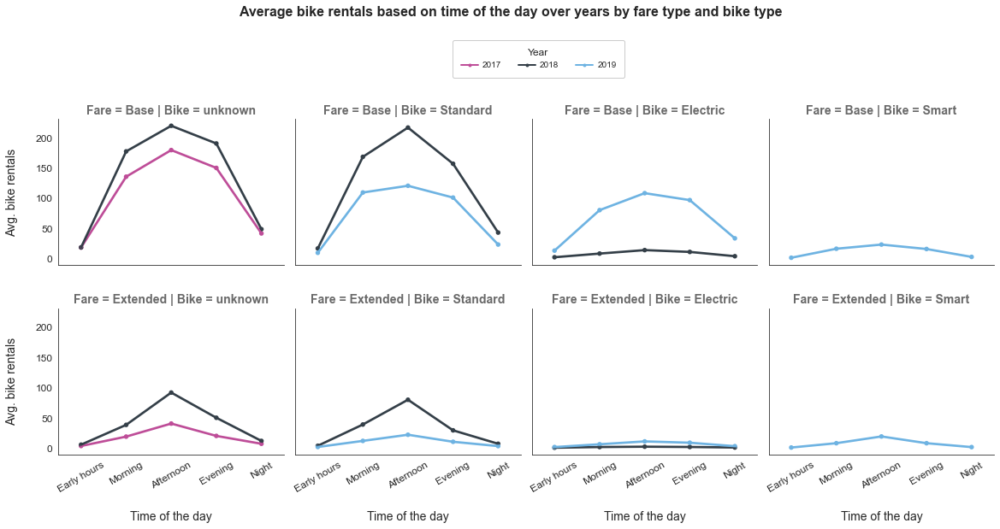

In [917]:
# Assign palette as per requirement
sb.set_style('white')
flatui = ['#cc3f9d', '#31404a', '#60b6f0']
sb.set_palette(flatui, n_colors=3, desat=0.8)

# Facet grid with point plot
plot_order = daytime_df.daytime.sort_values(ascending=True).unique()
g = sb.FacetGrid(data = daytime_df, col = 'bike_type', row = 'fare_type', height = 4, aspect = 1, hue = 'year')
g.map(sb.pointplot, "daytime", "rentals", order= plot_order, linestyles = "-", ci = None, markers = ['.']);
g.fig.subplots_adjust(top=0.75)
g.fig.suptitle('Average bike rentals based on time of the day over years by fare type and bike type', 
               fontsize = 16, weight = 'bold')
g.set_titles('Fare = {row_name} | Bike = {col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# improve plot aesthetics
# -------------------------------------------------------
g.set_xlabels('\nTime of the day', size = 14)
g.set_ylabels('Avg. bike rentals\n', size = 14)
g.set_yticklabels(size = 12)
# iterate over axes of FacetGrid
for ax in g.axes.flat:
     # get x labels
    labels = ax.get_xticklabels()
    # set new labels
    ax.set_xticklabels(labels, rotation = 30, size = 12)
# -------------------------------------------------------

# add custom legend
# -------------------------------------------------------
custom = [Line2D([], [], marker='.', color=sb.color_palette()[0], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[1], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[2], linestyle='-', linewidth = 2)]

plt.legend(custom, ['2017', '2018', '2019'], scatterpoints=1, frameon=True, fancybox=True, 
           shadow=False, framealpha = 1, borderpad=1, borderaxespad=1, labelspacing=0.5, 
           ncol = 3, title='Year', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(-0.6, 2.9));
# -------------------------------------------------------

plt.subplots_adjust(wspace=0.05, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.3.66 Average bike rentals based on daytime over the years by fare type and bike type.png', dpi=300, bbox_inches='tight')

----

#### 3.3.67 Multivariate analysis of `day`, `year`, `fare_type` and `bike_type` columns:

+ `Columns`: day, year, fare_type, bike_type
+ `Data type`: (Categorical, ordered), (Categorical, ordered), (Categorical, nominal) and (Categorical, nominal)
+ `Plot`: Point plot

**`Find average rentals based on the day of the month over years:`**

Create a dataset which contain bike rentals relative to each `day` over respective months in the year. Care should be taken as to inlcude only days that appear in every month over individual years. Use available categorical combinations and do not fill the `NULL` values with numerical zero's so as to consider bike rentals subjected to every day in any month.

In [918]:
# create a dataset for bike rentals over each day in a month
days_df = bikeshare.groupby([bikeshare["year"], 
                             bikeshare["month"],
                             bikeshare["day"],
                             bikeshare["fare_type"],
                             bikeshare["bike_type"]]).count()['trip_id'].reset_index(name='rentals')
days_df.head(10)

,year,month,day,fare_type,bike_type,rentals
0,2017,1,1,Base,unknown,211.0
1,2017,1,1,Base,Standard,NaN
2,2017,1,1,Base,Electric,NaN
3,2017,1,1,Base,Smart,NaN
4,2017,1,1,Extended,unknown,59.0
5,2017,1,1,Extended,Standard,NaN
6,2017,1,1,Extended,Electric,NaN
7,2017,1,1,Extended,Smart,NaN
8,2017,1,2,Base,unknown,214.0
9,2017,1,2,Base,Standard,NaN


**`Point plot:`**

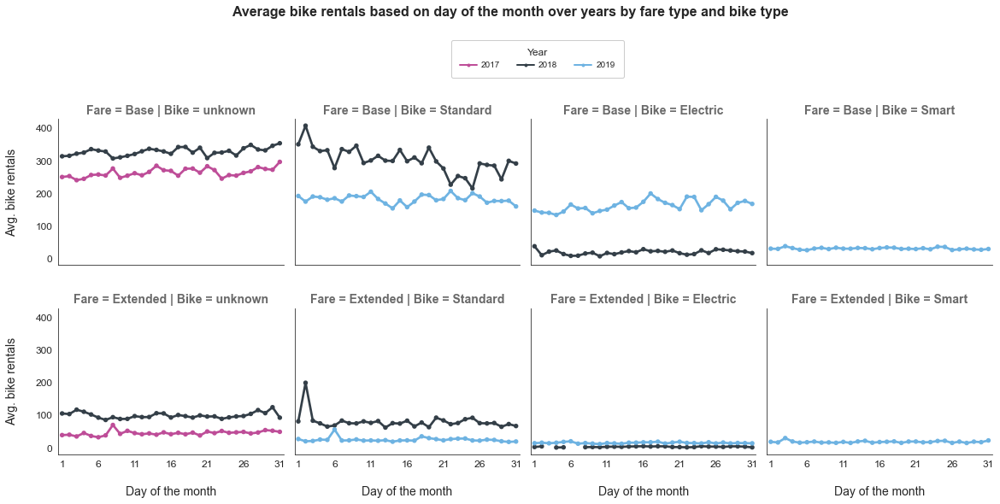

In [919]:
# Assign palette as per requirement
sb.set_style('white')
flatui = ['#cc3f9d', '#31404a', '#60b6f0']
sb.set_palette(flatui, n_colors=3, desat=0.8)

# Facet grid with point plot
plot_order = days_df.day.sort_values(ascending=True).unique()
g = sb.FacetGrid(data = days_df, col = 'bike_type', row = 'fare_type', height = 4, aspect = 1, hue = 'year')
g.map(sb.pointplot, "day", "rentals", order= plot_order, linestyles = "-", ci = None, markers = ['.']);
g.fig.subplots_adjust(top=0.75)
g.fig.suptitle('Average bike rentals based on day of the month over years by fare type and bike type', 
               fontsize = 16, weight = 'bold')
g.set_titles('Fare = {row_name} | Bike = {col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# improve plot aesthetics
# -------------------------------------------------------
g.set_xlabels('\nDay of the month', size = 14)
g.set_ylabels('Avg. bike rentals\n', size = 14)
g.set_yticklabels(size = 12)
# iterate over axes of FacetGrid
for ax in g.axes.flat:
     # get x labels
    labels = ax.get_xticklabels()
    for i,l in enumerate(labels):
        # skip labels
        if not (i%5 == 0): labels[i] = ''
    # set new labels
    ax.set_xticklabels(labels, size = 12)
# -------------------------------------------------------

# add custom legend
# -------------------------------------------------------
custom = [Line2D([], [], marker='.', color=sb.color_palette()[0], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[1], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[2], linestyle='-', linewidth = 2)]

plt.legend(custom, ['2017', '2018', '2019'], scatterpoints=1, frameon=True, fancybox=True, 
           shadow=False, framealpha = 1, borderpad=1, borderaxespad=1, labelspacing=0.5, 
           ncol = 3, title='Year', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(-0.6, 2.9));
# -------------------------------------------------------

plt.subplots_adjust(wspace=0.05, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.3.67 Average bike rentals based on day over the years by fare type and bike type.png', dpi=300, bbox_inches='tight')

----

#### 3.3.68 Multivariate analysis of `weekday`, `year`, `fare_type` and `bike_type` columns:

+ `Columns`: weekday, year, fare_type, bike_type
+ `Data type`: (Categorical, ordered), (Categorical, ordered), (Categorical, nominal) and (Categorical, nominal)
+ `Plot`: Point plot

**`Find average rentals based on the day of the week over years:`**

Create a dataset which contain bike rentals relative to each `day` over respective week in the month. Care should be taken as to inlcude only days that appear in every week over individual months. Use available categorical combinations and do not fill the `NULL` values with numerical zero's so as to consider bike rentals subjected to every day in any week.

In [920]:
# create a dataset for bike rentals over each day in a week
weekday_df = bikeshare.groupby([bikeshare["year"], 
                                bikeshare["month"],
                                bikeshare["week"],
                                bikeshare["weekday"],
                                bikeshare["fare_type"],
                                bikeshare["bike_type"]]).count()['trip_id'].reset_index(name='rentals')
weekday_df.head(10)

,year,month,week,weekday,fare_type,bike_type,rentals
0,2017,1,First,Monday,Base,unknown,214.0
1,2017,1,First,Monday,Base,Standard,NaN
2,2017,1,First,Monday,Base,Electric,NaN
3,2017,1,First,Monday,Base,Smart,NaN
4,2017,1,First,Monday,Extended,unknown,45.0
5,2017,1,First,Monday,Extended,Standard,NaN
6,2017,1,First,Monday,Extended,Electric,NaN
7,2017,1,First,Monday,Extended,Smart,NaN
8,2017,1,First,Tuesday,Base,unknown,296.0
9,2017,1,First,Tuesday,Base,Standard,NaN


**`Point plot:`**

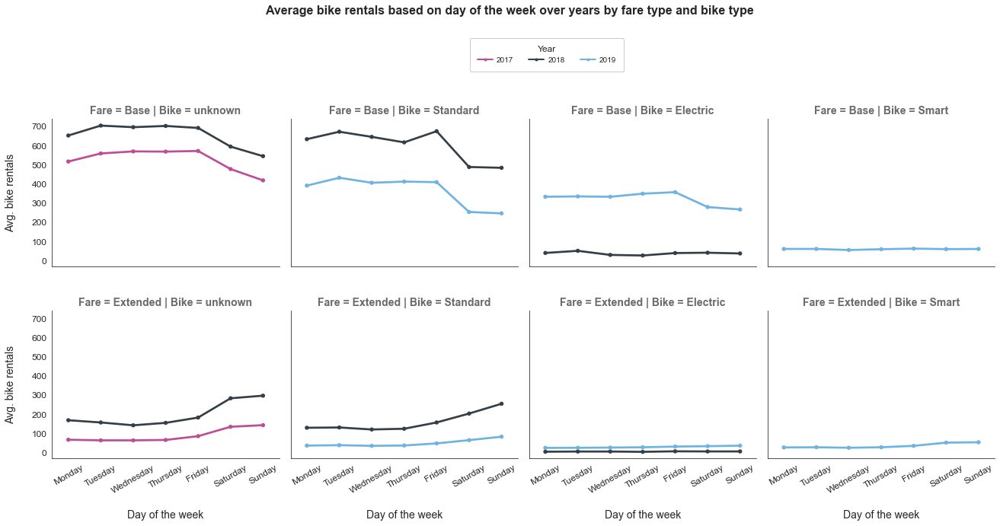

In [921]:
# Assign palette as per requirement
sb.set_style('white')
flatui = ['#cc3f9d', '#31404a', '#60b6f0']
sb.set_palette(flatui, n_colors=3, desat=0.8)

# Facet grid with point plot
plot_order = weekday_df.weekday.sort_values(ascending=True).unique()
g = sb.FacetGrid(data = weekday_df, col = 'bike_type', row = 'fare_type', height = 4.5, aspect = 1, hue = 'year')
g.map(sb.pointplot, "weekday", "rentals", order= plot_order, linestyles = "-", ci = None, markers = ['.']);
g.fig.subplots_adjust(top=0.75)
g.fig.suptitle('Average bike rentals based on day of the week over years by fare type and bike type', 
               fontsize = 16, weight = 'bold')
g.set_titles('Fare = {row_name} | Bike = {col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# improve plot aesthetics
# -------------------------------------------------------
g.set_xlabels('\nDay of the week', size = 14)
g.set_ylabels('Avg. bike rentals\n', size = 14)
g.set_yticklabels(size = 12)
# iterate over axes of FacetGrid
for ax in g.axes.flat:
     # get x labels
    labels = ax.get_xticklabels()
    # set new labels
    ax.set_xticklabels(labels, rotation = 30, size = 12)
# -------------------------------------------------------

# add custom legend
# -------------------------------------------------------
custom = [Line2D([], [], marker='.', color=sb.color_palette()[0], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[1], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[2], linestyle='-', linewidth = 2)]

plt.legend(custom, ['2017', '2018', '2019'], scatterpoints=1, frameon=True, fancybox=True, 
           shadow=False, framealpha = 1, borderpad=1, borderaxespad=1, labelspacing=0.5, 
           ncol = 3, title='Year', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(-0.6, 2.9));
# -------------------------------------------------------

plt.subplots_adjust(wspace=0.05, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.3.68 Average bike rentals based on weekday over the years by fare type and bike type.png', dpi=300, bbox_inches='tight')

----

#### 3.3.69 Multivariate analysis of `month`, `year`, `fare_type` and `bike_type` columns:

+ `Columns`: month, year, fare_type, bike_type
+ `Data type`: (Categorical, ordered), (Categorical, ordered), (Categorical, nominal) and (Categorical, nominal)
+ `Plot`: Point plot

**`Find average rentals based on the month over years:`**

Create a dataset which contain bike rentals relative to each `month` over respective years. Care should be taken as to inlcude only rentals that appear in every month over individual years. Use available categorical combinations and do not fill the `NULL` values with numerical zero's so as to consider bike rentals subjected to every month in any year.

In [922]:
# create a dataset for bike rentals over each month in a year
month_df = bikeshare.groupby([bikeshare["year"], 
                              bikeshare["month"],
                              bikeshare["fare_type"],
                              bikeshare["bike_type"]]).count()['trip_id'].reset_index(name='rentals')
month_df.head(10)

,year,month,fare_type,bike_type,rentals
0,2017,1,Base,unknown,8925.0
1,2017,1,Base,Standard,NaN
2,2017,1,Base,Electric,NaN
3,2017,1,Base,Smart,NaN
4,2017,1,Extended,unknown,1231.0
5,2017,1,Extended,Standard,NaN
6,2017,1,Extended,Electric,NaN
7,2017,1,Extended,Smart,NaN
8,2017,2,Base,unknown,8450.0
9,2017,2,Base,Standard,NaN


**`Point plot:`**

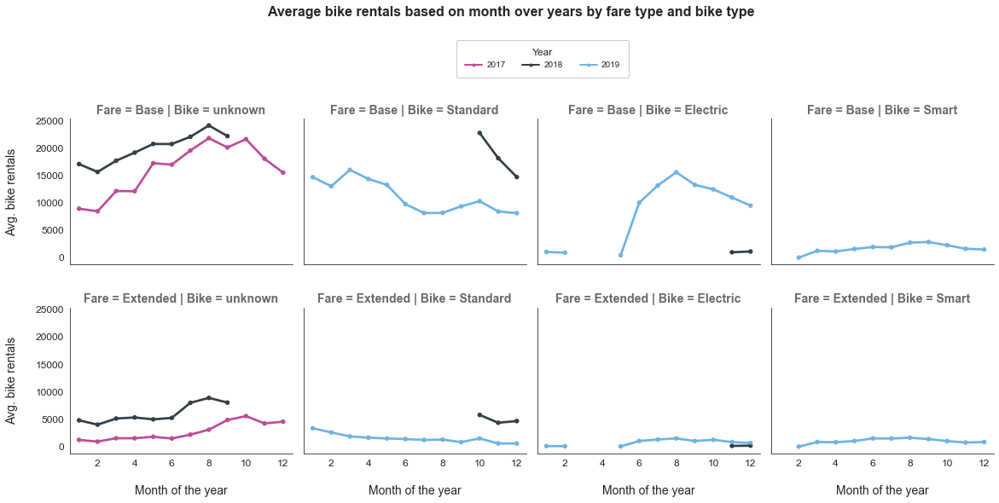

In [923]:
# Assign palette as per requirement
sb.set_style('white')
flatui = ['#cc3f9d', '#31404a', '#60b6f0']
sb.set_palette(flatui, n_colors=3, desat=0.8)

# Facet grid with point plot
plot_order = month_df.month.sort_values(ascending=True).unique()
g = sb.FacetGrid(data = month_df, col = 'bike_type', row = 'fare_type', height = 4, aspect = 1, hue = 'year')
g.map(sb.pointplot, "month", "rentals", order= plot_order, linestyles = "-", ci = None, markers = ['.']);
g.fig.subplots_adjust(top=0.75)
g.fig.suptitle('Average bike rentals based on month over years by fare type and bike type', 
               fontsize = 16, weight = 'bold')
g.set_titles('Fare = {row_name} | Bike = {col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# improve plot aesthetics
# -------------------------------------------------------
g.set_xlabels('\nMonth of the year', size = 14)
g.set_ylabels('Avg. bike rentals\n', size = 14)
g.set_yticklabels(size = 12)
# iterate over axes of FacetGrid
for ax in g.axes.flat:
    # get x labels
    xlabels = ax.get_xticklabels()
    for i,l in enumerate(xlabels):
        # skip labels
        if (i%2 == 0): xlabels[i] = ''
    # set new xlabels
    ax.set_xticklabels(xlabels, size = 12)
# -------------------------------------------------------

# add custom legend
# -------------------------------------------------------
custom = [Line2D([], [], marker='.', color=sb.color_palette()[0], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[1], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[2], linestyle='-', linewidth = 2)]

plt.legend(custom, ['2017', '2018', '2019'], scatterpoints=1, frameon=True, fancybox=True, 
           shadow=False, framealpha = 1, borderpad=1, borderaxespad=1, labelspacing=0.5, 
           ncol = 3, title='Year', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(-0.6, 2.9));
# -------------------------------------------------------

plt.subplots_adjust(wspace=0.05, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.3.69 Average bike rentals based on month over the years by fare type and bike type.png', dpi=300, bbox_inches='tight')

----

#### 3.3.70 Multivariate analysis of `quarter`, `year`, `fare_type` and `bike_type` columns:

+ `Columns`: quarter, year, fare_type, bike_type
+ `Data type`: (Categorical, ordered), (Categorical, ordered), (Categorical, nominal) and (Categorical, nominal)
+ `Plot`: Point plot

**`Find average rentals based on the quarter over years:`**

Create a dataset which contain bike rentals relative to each `quarter` over respective years. Care should be taken as to inlcude only rentals that appear in every quarter over individual years. Use available categorical combinations and do not fill the `NULL` values with numerical zero's so as to consider bike rentals subjected to every quarter in any year.

In [924]:
# create a dataset for bike rentals over each day in a week
quarter_df = bikeshare.groupby([bikeshare["year"], 
                                bikeshare["quarter"],
                                bikeshare["fare_type"],
                                bikeshare["bike_type"]]).count()['trip_id'].reset_index(name='rentals')
quarter_df.head(10)

,year,quarter,fare_type,bike_type,rentals
0,2017,Q1,Base,unknown,29517.0
1,2017,Q1,Base,Standard,NaN
2,2017,Q1,Base,Electric,NaN
3,2017,Q1,Base,Smart,NaN
4,2017,Q1,Extended,unknown,3681.0
5,2017,Q1,Extended,Standard,NaN
6,2017,Q1,Extended,Electric,NaN
7,2017,Q1,Extended,Smart,NaN
8,2017,Q2,Base,unknown,46286.0
9,2017,Q2,Base,Standard,NaN


**`Point plot:`**

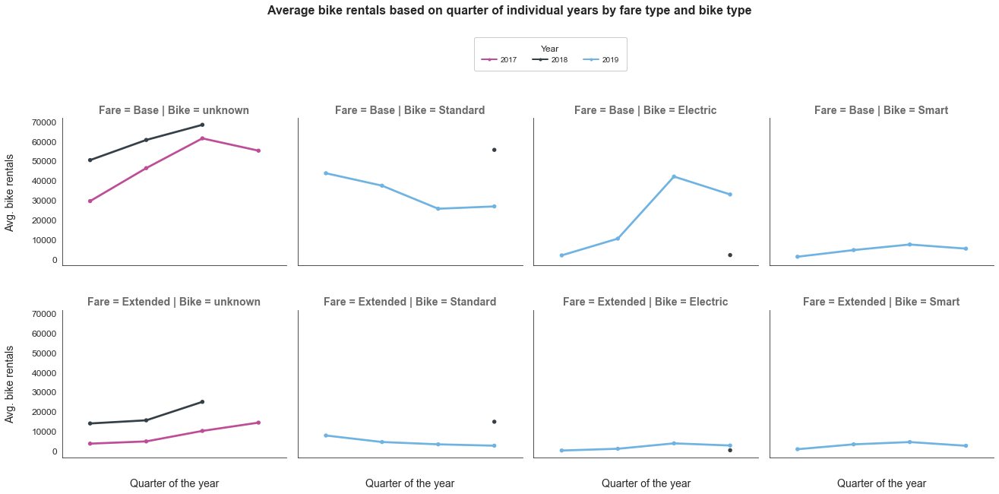

In [925]:
# Assign palette as per requirement
sb.set_style('white')
flatui = ['#cc3f9d', '#31404a', '#60b6f0']
sb.set_palette(flatui, n_colors=3, desat=0.8)

# Facet grid with point plot
plot_order = quarter_df.quarter.sort_values(ascending=True).unique()
g = sb.FacetGrid(data = quarter_df, col = 'bike_type', row = 'fare_type', height = 4.5, aspect = 1, hue = 'year')
g.map(sb.pointplot, "quarter", "rentals", order= plot_order, linestyles = "-", ci = None, markers = ['.']);
g.fig.subplots_adjust(top=0.75)
g.fig.suptitle('Average bike rentals based on quarter of individual years by fare type and bike type', 
               fontsize = 16, weight = 'bold')
g.set_titles('Fare = {row_name} | Bike = {col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# improve plot aesthetics
# -------------------------------------------------------
g.set_xlabels('\nQuarter of the year', size = 14)
g.set_ylabels('Avg. bike rentals\n', size = 14)
g.set_xticklabels(size = 12)
g.set_yticklabels(size = 12)
# -------------------------------------------------------

# add custom legend
# -------------------------------------------------------
custom = [Line2D([], [], marker='.', color=sb.color_palette()[0], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[1], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[2], linestyle='-', linewidth = 2)]

plt.legend(custom, ['2017', '2018', '2019'], scatterpoints=1, frameon=True, fancybox=True, 
           shadow=False, framealpha = 1, borderpad=1, borderaxespad=1, labelspacing=0.5, 
           ncol = 3, title='Year', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(-0.6, 2.9));
# -------------------------------------------------------

plt.subplots_adjust(wspace=0.05, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.3.70 Average bike rentals based on quarter of individual years by fare type and bike type.png', dpi=300, bbox_inches='tight')

-----

#### 3.3.71 Multivariate analysis of `hour`, `year`, `fare_type` and `pass_type` columns:

+ `Columns`: hour, year, fare_type, pass_type
+ `Data type`: (numerical, continuous), (Categorical, ordered), (Categorical, nominal) and (Categorical, nominal)
+ `Plot`: Point plot

**`Find average rentals based on the hour over years:`**

Create a dataset which contain bike rentals relative to each `hour` in the day over respective months in the year. Care should be taken as to inlcude only hours that appear in every day of the month over individual years. Use available categorical combinations and do not fill the `NULL` values with numerical zero's so as to consider bike rentals subjected to every hour in any day.

In [926]:
# create a dataset for bike rentals over each hour in a day
hours_df = bikeshare.groupby([bikeshare["year"], 
                              bikeshare["month"],
                              bikeshare["day"],
                              bikeshare["hour"],
                              bikeshare["fare_type"],
                              bikeshare["pass_type"]]).count()['trip_id'].reset_index(name='rentals')
hours_df.head(10)

,year,month,day,hour,fare_type,pass_type,rentals
0,2017,1,1,0,Base,Walk-up,4.0
1,2017,1,1,0,Base,One Day,NaN
2,2017,1,1,0,Base,Monthly,3.0
3,2017,1,1,0,Base,Flex,NaN
4,2017,1,1,0,Base,Annual,NaN
5,2017,1,1,0,Extended,Walk-up,2.0
6,2017,1,1,0,Extended,One Day,NaN
7,2017,1,1,0,Extended,Monthly,NaN
8,2017,1,1,0,Extended,Flex,NaN
9,2017,1,1,0,Extended,Annual,NaN


**`Point plot:`**

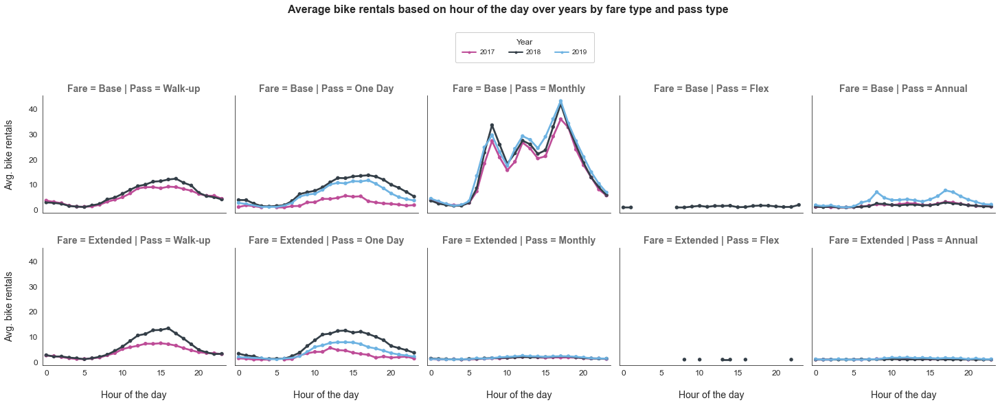

In [927]:
# Assign palette as per requirement
sb.set_style('white')
flatui = ['#cc3f9d', '#31404a', '#60b6f0']
sb.set_palette(flatui, n_colors=3, desat=0.8)

# Facet grid with point plot
plot_order = hours_df.hour.sort_values(ascending=True).unique()
g = sb.FacetGrid(data = hours_df, col = 'pass_type', row = 'fare_type', height = 4, aspect = 1, hue = 'year')
g.map(sb.pointplot, "hour", "rentals", order= plot_order, linestyles = "-", ci = None, markers = ['.']);
g.fig.subplots_adjust(top=0.75)
g.fig.suptitle('Average bike rentals based on hour of the day over years by fare type and pass type', 
               fontsize = 16, weight = 'bold')
g.set_titles('Fare = {row_name} | Pass = {col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# improve plot aesthetics
# -------------------------------------------------------
g.set_xlabels('\nHour of the day', size = 14)
g.set_ylabels('Avg. bike rentals\n', size = 14)
g.set_yticklabels(size = 12)
# iterate over axes of FacetGrid
for ax in g.axes.flat:
     # get x labels
    labels = ax.get_xticklabels()
    for i,l in enumerate(labels):
        # skip labels
        if not (i%5 == 0): labels[i] = ''
    # set new labels
    ax.set_xticklabels(labels, size = 12)
# -------------------------------------------------------

# add custom legend
# -------------------------------------------------------
custom = [Line2D([], [], marker='.', color=sb.color_palette()[0], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[1], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[2], linestyle='-', linewidth = 2)]

plt.legend(custom, ['2017', '2018', '2019'], scatterpoints=1, frameon=True, fancybox=True, 
           shadow=False, framealpha = 1, borderpad=1, borderaxespad=1, labelspacing=0.5, 
           ncol = 3, title='Year', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(-1.15, 2.9));
# -------------------------------------------------------

plt.subplots_adjust(wspace=0.05, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.3.71 Average bike rentals based on hour over the years by fare type and pass type.png', dpi=300, bbox_inches='tight')

----

#### 3.3.72 Multivariate analysis of `daytime`, `year`, `fare_type` and `pass_type` columns:

+ `Columns`: daytime, year, fare_type, pass_type
+ `Data type`: (Categorical, ordered), (Categorical, ordered), (Categorical, nominal) and (Categorical, nominal)
+ `Plot`: Point plot

**`Find average rentals based on the daytime of the day over years:`**

Create a dataset which contain bike rentals relative to each `daytime` in the day over respective months in the year. Care should be taken as to inlcude only daytimes that appear in every day of the month over individual years. Use available categorical combinations and do not fill the `NULL` values with numerical zero's so as to consider bike rentals subjected to every daytime in any day.

In [928]:
# create a dataset for bike rentals over each day in a week
daytime_df = bikeshare.groupby([bikeshare["year"], 
                                bikeshare["month"],
                                bikeshare["day"],
                                bikeshare["daytime"],
                                bikeshare["fare_type"],
                                bikeshare["pass_type"]]).count()['trip_id'].reset_index(name='rentals')
daytime_df.head(10)

,year,month,day,daytime,fare_type,pass_type,rentals
0,2017,1,1,Early hours,Base,Walk-up,16.0
1,2017,1,1,Early hours,Base,One Day,NaN
2,2017,1,1,Early hours,Base,Monthly,8.0
3,2017,1,1,Early hours,Base,Flex,NaN
4,2017,1,1,Early hours,Base,Annual,NaN
5,2017,1,1,Early hours,Extended,Walk-up,3.0
6,2017,1,1,Early hours,Extended,One Day,NaN
7,2017,1,1,Early hours,Extended,Monthly,NaN
8,2017,1,1,Early hours,Extended,Flex,NaN
9,2017,1,1,Early hours,Extended,Annual,NaN


**`Point plot:`**

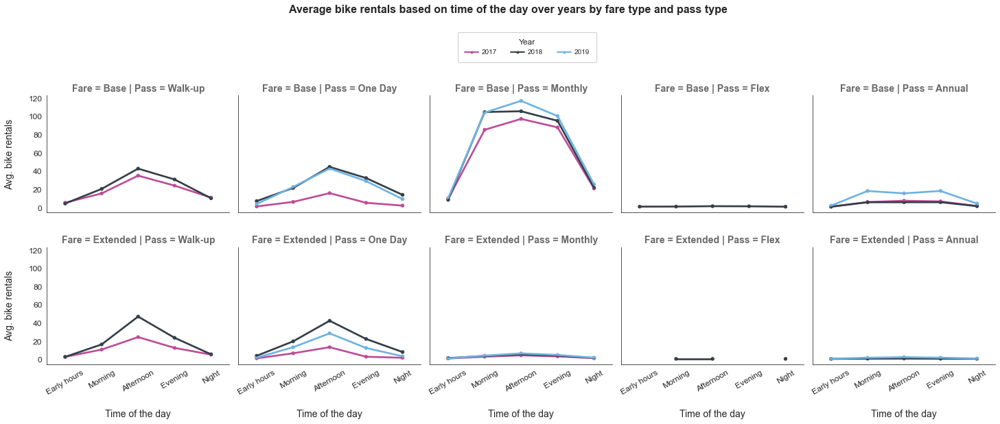

In [929]:
# Assign palette as per requirement
sb.set_style('white')
flatui = ['#cc3f9d', '#31404a', '#60b6f0']
sb.set_palette(flatui, n_colors=3, desat=0.8)

# Facet grid with point plot
plot_order = daytime_df.daytime.sort_values(ascending=True).unique()
g = sb.FacetGrid(data = daytime_df, col = 'pass_type', row = 'fare_type', height = 4, aspect = 1, hue = 'year')
g.map(sb.pointplot, "daytime", "rentals", order= plot_order, linestyles = "-", ci = None, markers = ['.']);
g.fig.subplots_adjust(top=0.75)
g.fig.suptitle('Average bike rentals based on time of the day over years by fare type and pass type', 
               fontsize = 16, weight = 'bold')
g.set_titles('Fare = {row_name} | Pass = {col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# improve plot aesthetics
# -------------------------------------------------------
g.set_xlabels('\nTime of the day', size = 14)
g.set_ylabels('Avg. bike rentals\n', size = 14)
g.set_yticklabels(size = 12)
# iterate over axes of FacetGrid
for ax in g.axes.flat:
     # get x labels
    labels = ax.get_xticklabels()
    # set new labels
    ax.set_xticklabels(labels, rotation = 30, size = 12)
# -------------------------------------------------------

# add custom legend
# -------------------------------------------------------
custom = [Line2D([], [], marker='.', color=sb.color_palette()[0], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[1], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[2], linestyle='-', linewidth = 2)]

plt.legend(custom, ['2017', '2018', '2019'], scatterpoints=1, frameon=True, fancybox=True, 
           shadow=False, framealpha = 1, borderpad=1, borderaxespad=1, labelspacing=0.5, 
           ncol = 3, title='Year', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(-1.15, 2.9));
# -------------------------------------------------------

plt.subplots_adjust(wspace=0.05, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.3.72 Average bike rentals based on daytime over the years by fare type and pass type.png', dpi=300, bbox_inches='tight')

----

#### 3.3.73 Multivariate analysis of `day`, `year`, `fare_type` and `pass_type` columns:

+ `Columns`: day, year, fare_type, pass_type
+ `Data type`: (Categorical, ordered), (Categorical, ordered), (Categorical, nominal) and (Categorical, nominal)
+ `Plot`: Point plot

**`Find average rentals based on the day of the month over years:`**

Create a dataset which contain bike rentals relative to each `day` over respective months in the year. Care should be taken as to inlcude only days that appear in every month over individual years. Use available categorical combinations and do not fill the `NULL` values with numerical zero's so as to consider bike rentals subjected to every day in any month.

In [930]:
# create a dataset for bike rentals over each day in a month
days_df = bikeshare.groupby([bikeshare["year"], 
                             bikeshare["month"],
                             bikeshare["day"],
                             bikeshare["fare_type"],
                             bikeshare["pass_type"]]).count()['trip_id'].reset_index(name='rentals')
days_df.head(10)

,year,month,day,fare_type,pass_type,rentals
0,2017,1,1,Base,Walk-up,111.0
1,2017,1,1,Base,One Day,NaN
2,2017,1,1,Base,Monthly,89.0
3,2017,1,1,Base,Flex,NaN
4,2017,1,1,Base,Annual,11.0
5,2017,1,1,Extended,Walk-up,58.0
6,2017,1,1,Extended,One Day,NaN
7,2017,1,1,Extended,Monthly,1.0
8,2017,1,1,Extended,Flex,NaN
9,2017,1,1,Extended,Annual,NaN


**`Point plot:`**

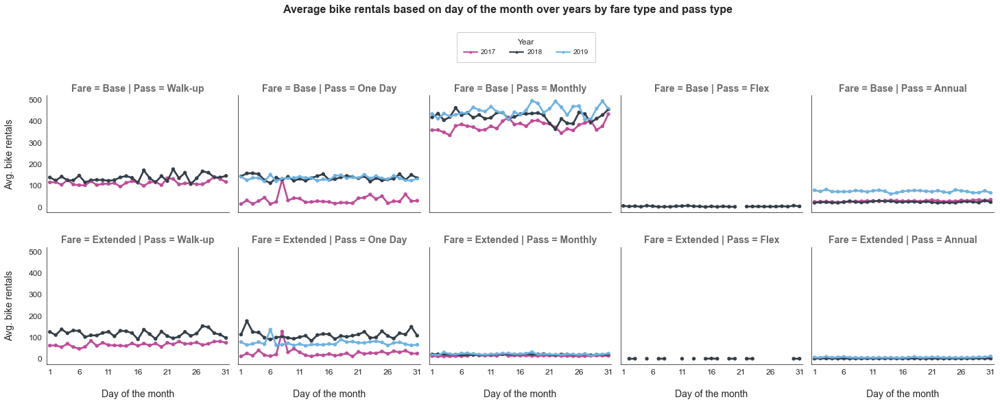

In [931]:
# Assign palette as per requirement
sb.set_style('white')
flatui = ['#cc3f9d', '#31404a', '#60b6f0']
sb.set_palette(flatui, n_colors=3, desat=0.8)

# Facet grid with point plot
plot_order = days_df.day.sort_values(ascending=True).unique()
g = sb.FacetGrid(data = days_df, col = 'pass_type', row = 'fare_type', height = 4, aspect = 1, hue = 'year')
g.map(sb.pointplot, "day", "rentals", order= plot_order, linestyles = "-", ci = None, markers = ['.']);
g.fig.subplots_adjust(top=0.75)
g.fig.suptitle('Average bike rentals based on day of the month over years by fare type and pass type', 
               fontsize = 16, weight = 'bold')
g.set_titles('Fare = {row_name} | Pass = {col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# improve plot aesthetics
# -------------------------------------------------------
g.set_xlabels('\nDay of the month', size = 14)
g.set_ylabels('Avg. bike rentals\n', size = 14)
g.set_yticklabels(size = 12)
# iterate over axes of FacetGrid
for ax in g.axes.flat:
     # get x labels
    labels = ax.get_xticklabels()
    for i,l in enumerate(labels):
        # skip labels
        if not (i%5 == 0): labels[i] = ''
    # set new labels
    ax.set_xticklabels(labels, size = 12)
# -------------------------------------------------------

# add custom legend
# -------------------------------------------------------
custom = [Line2D([], [], marker='.', color=sb.color_palette()[0], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[1], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[2], linestyle='-', linewidth = 2)]

plt.legend(custom, ['2017', '2018', '2019'], scatterpoints=1, frameon=True, fancybox=True, 
           shadow=False, framealpha = 1, borderpad=1, borderaxespad=1, labelspacing=0.5, 
           ncol = 3, title='Year', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(-1.15, 2.9));
# -------------------------------------------------------

plt.subplots_adjust(wspace=0.05, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.3.73 Average bike rentals based on day over the years by fare type and pass type.png', dpi=300, bbox_inches='tight')

----

#### 3.3.74 Multivariate analysis of `weekday`, `year`, `fare_type` and `pass_type` columns:

+ `Columns`: weekday, year, fare_type, pass_type
+ `Data type`: (Categorical, ordered), (Categorical, ordered), (Categorical, nominal) and (Categorical, nominal)
+ `Plot`: Point plot

**`Find average rentals based on the day of the week over years:`**

Create a dataset which contain bike rentals relative to each `day` over respective week in the month. Care should be taken as to inlcude only days that appear in every week over individual months. Use available categorical combinations and do not fill the `NULL` values with numerical zero's so as to consider bike rentals subjected to every day in any week.

In [932]:
# create a dataset for bike rentals over each day in a week
weekday_df = bikeshare.groupby([bikeshare["year"], 
                                bikeshare["month"],
                                bikeshare["week"],
                                bikeshare["weekday"],
                                bikeshare["fare_type"],
                                bikeshare["pass_type"]]).count()['trip_id'].reset_index(name='rentals')
weekday_df.head(10)

,year,month,week,weekday,fare_type,pass_type,rentals
0,2017,1,First,Monday,Base,Walk-up,76.0
1,2017,1,First,Monday,Base,One Day,NaN
2,2017,1,First,Monday,Base,Monthly,115.0
3,2017,1,First,Monday,Base,Flex,NaN
4,2017,1,First,Monday,Base,Annual,23.0
5,2017,1,First,Monday,Extended,Walk-up,39.0
6,2017,1,First,Monday,Extended,One Day,NaN
7,2017,1,First,Monday,Extended,Monthly,6.0
8,2017,1,First,Monday,Extended,Flex,NaN
9,2017,1,First,Monday,Extended,Annual,NaN


**`Point plot:`**

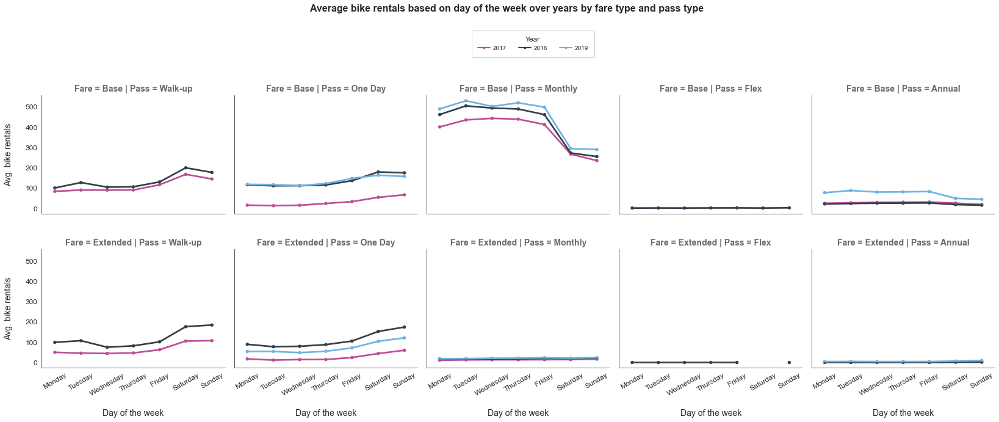

In [933]:
# Assign palette as per requirement
sb.set_style('white')
flatui = ['#cc3f9d', '#31404a', '#60b6f0']
sb.set_palette(flatui, n_colors=3, desat=0.8)

# Facet grid with point plot
plot_order = weekday_df.weekday.sort_values(ascending=True).unique()
g = sb.FacetGrid(data = weekday_df, col = 'pass_type', row = 'fare_type', height = 4.5, aspect = 1, hue = 'year')
g.map(sb.pointplot, "weekday", "rentals", order= plot_order, linestyles = "-", ci = None, markers = ['.']);
g.fig.subplots_adjust(top=0.75)
g.fig.suptitle('Average bike rentals based on day of the week over years by fare type and pass type', 
               fontsize = 16, weight = 'bold')
g.set_titles('Fare = {row_name} | Pass = {col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# improve plot aesthetics
# -------------------------------------------------------
g.set_xlabels('\nDay of the week', size = 14)
g.set_ylabels('Avg. bike rentals\n', size = 14)
g.set_yticklabels(size = 12)
# iterate over axes of FacetGrid
for ax in g.axes.flat:
     # get x labels
    labels = ax.get_xticklabels()
    # set new labels
    ax.set_xticklabels(labels, rotation = 30, size = 12)
# -------------------------------------------------------

# add custom legend
# -------------------------------------------------------
custom = [Line2D([], [], marker='.', color=sb.color_palette()[0], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[1], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[2], linestyle='-', linewidth = 2)]

plt.legend(custom, ['2017', '2018', '2019'], scatterpoints=1, frameon=True, fancybox=True, 
           shadow=False, framealpha = 1, borderpad=1, borderaxespad=1, labelspacing=0.5, 
           ncol = 3, title='Year', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(-1.15, 2.9));
# -------------------------------------------------------

plt.subplots_adjust(wspace=0.05, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.3.74 Average bike rentals based on weekday over the years by fare type and pass type.png', dpi=300, bbox_inches='tight')

----

#### 3.3.75 Multivariate analysis of `month`, `year`, `fare_type` and `pass_type` columns:

+ `Columns`: month, year, fare_type, pass_type
+ `Data type`: (Categorical, ordered), (Categorical, ordered), (Categorical, nominal) and (Categorical, nominal)
+ `Plot`: Point plot

**`Find average rentals based on the month over years:`**

Create a dataset which contain bike rentals relative to each `month` over respective years. Care should be taken as to inlcude only rentals that appear in every month over individual years. Use available categorical combinations and do not fill the `NULL` values with numerical zero's so as to consider bike rentals subjected to every month in any year.

In [934]:
# create a dataset for bike rentals over each month in a year
month_df = bikeshare.groupby([bikeshare["year"], 
                              bikeshare["month"],
                              bikeshare["fare_type"],
                              bikeshare["pass_type"]]).count()['trip_id'].reset_index(name='rentals')
month_df.head(10)

,year,month,fare_type,pass_type,rentals
0,2017,1,Base,Walk-up,2215.0
1,2017,1,Base,One Day,NaN
2,2017,1,Base,Monthly,6074.0
3,2017,1,Base,Flex,NaN
4,2017,1,Base,Annual,636.0
5,2017,1,Extended,Walk-up,972.0
6,2017,1,Extended,One Day,NaN
7,2017,1,Extended,Monthly,232.0
8,2017,1,Extended,Flex,NaN
9,2017,1,Extended,Annual,27.0


**`Point plot:`**

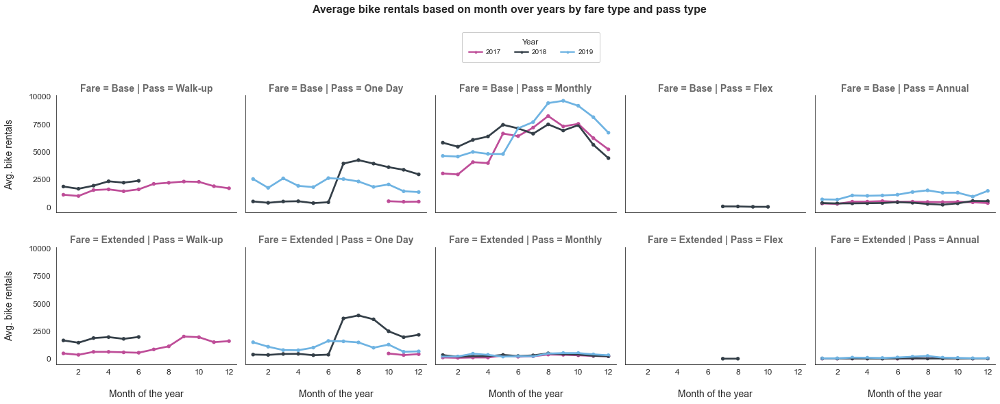

In [935]:
# Assign palette as per requirement
sb.set_style('white')
flatui = ['#cc3f9d', '#31404a', '#60b6f0']
sb.set_palette(flatui, n_colors=3, desat=0.8)

# Facet grid with point plot
plot_order = month_df.month.sort_values(ascending=True).unique()
g = sb.FacetGrid(data = month_df, col = 'pass_type', row = 'fare_type', height = 4, aspect = 1, hue = 'year')
g.map(sb.pointplot, "month", "rentals", order= plot_order, linestyles = "-", ci = None, markers = ['.']);
g.fig.subplots_adjust(top=0.75)
g.fig.suptitle('Average bike rentals based on month over years by fare type and pass type', 
               fontsize = 16, weight = 'bold')
g.set_titles('Fare = {row_name} | Pass = {col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# improve plot aesthetics
# -------------------------------------------------------
g.set_xlabels('\nMonth of the year', size = 14)
g.set_ylabels('Avg. bike rentals\n', size = 14)
g.set_yticklabels(size = 12)
# iterate over axes of FacetGrid
for ax in g.axes.flat:
    # get x labels
    xlabels = ax.get_xticklabels()
    for i,l in enumerate(xlabels):
        # skip labels
        if (i%2 == 0): xlabels[i] = ''
    # set new xlabels
    ax.set_xticklabels(xlabels, size = 12)
# -------------------------------------------------------

# add custom legend
# -------------------------------------------------------
custom = [Line2D([], [], marker='.', color=sb.color_palette()[0], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[1], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[2], linestyle='-', linewidth = 2)]

plt.legend(custom, ['2017', '2018', '2019'], scatterpoints=1, frameon=True, fancybox=True, 
           shadow=False, framealpha = 1, borderpad=1, borderaxespad=1, labelspacing=0.5, 
           ncol = 3, title='Year', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(-1.15, 2.9));
# -------------------------------------------------------

plt.subplots_adjust(wspace=0.05, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.3.75 Average bike rentals based on month over the years by fare type and pass type.png', dpi=300, bbox_inches='tight')

----

#### 3.3.76 Multivariate analysis of `quarter`, `year`, `fare_type` and `pass_type` columns:

+ `Columns`: quarter, year, fare_type, pass_type
+ `Data type`: (Categorical, ordered), (Categorical, ordered), (Categorical, nominal) and (Categorical, nominal)
+ `Plot`: Point plot

**`Find average rentals based on the quarter over years:`**

Create a dataset which contain bike rentals relative to each `quarter` over respective years. Care should be taken as to inlcude only rentals that appear in every quarter over individual years. Use available categorical combinations and do not fill the `NULL` values with numerical zero's so as to consider bike rentals subjected to every quarter in any year.

In [936]:
# create a dataset for bike rentals over each day in a week
quarter_df = bikeshare.groupby([bikeshare["year"], 
                                bikeshare["quarter"],
                                bikeshare["fare_type"],
                                bikeshare["pass_type"]]).count()['trip_id'].reset_index(name='rentals')
quarter_df.head(10)

,year,quarter,fare_type,pass_type,rentals
0,2017,Q1,Base,Walk-up,7266.0
1,2017,Q1,Base,One Day,NaN
2,2017,Q1,Base,Monthly,20097.0
3,2017,Q1,Base,Flex,NaN
4,2017,Q1,Base,Annual,2154.0
5,2017,Q1,Extended,Walk-up,2945.0
6,2017,Q1,Extended,One Day,NaN
7,2017,Q1,Extended,Monthly,633.0
8,2017,Q1,Extended,Flex,NaN
9,2017,Q1,Extended,Annual,103.0


**`Point plot:`**

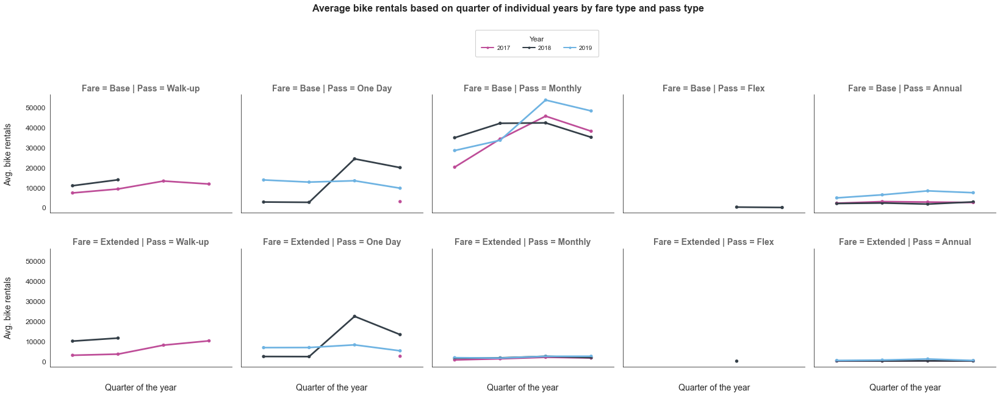

In [937]:
# Assign palette as per requirement
sb.set_style('white')
flatui = ['#cc3f9d', '#31404a', '#60b6f0']
sb.set_palette(flatui, n_colors=3, desat=0.8)

# Facet grid with point plot
plot_order = quarter_df.quarter.sort_values(ascending=True).unique()
g = sb.FacetGrid(data = quarter_df, col = 'pass_type', row = 'fare_type', height = 4.5, aspect = 1, hue = 'year')
g.map(sb.pointplot, "quarter", "rentals", order= plot_order, linestyles = "-", ci = None, markers = ['.']);
g.fig.subplots_adjust(top=0.75)
g.fig.suptitle('Average bike rentals based on quarter of individual years by fare type and pass type', 
               fontsize = 16, weight = 'bold')
g.set_titles('Fare = {row_name} | Pass = {col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# improve plot aesthetics
# -------------------------------------------------------
g.set_xlabels('\nQuarter of the year', size = 14)
g.set_ylabels('Avg. bike rentals\n', size = 14)
g.set_xticklabels(size = 12)
g.set_yticklabels(size = 12)
# -------------------------------------------------------

# add custom legend
# -------------------------------------------------------
custom = [Line2D([], [], marker='.', color=sb.color_palette()[0], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[1], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[2], linestyle='-', linewidth = 2)]

plt.legend(custom, ['2017', '2018', '2019'], scatterpoints=1, frameon=True, fancybox=True, 
           shadow=False, framealpha = 1, borderpad=1, borderaxespad=1, labelspacing=0.5, 
           ncol = 3, title='Year', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(-1.15, 2.9));
# -------------------------------------------------------

plt.subplots_adjust(wspace=0.05, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.3.76 Average bike rentals based on quarter of individual years by fare type and pass type.png', dpi=300, bbox_inches='tight')

------

#### 3.3.77 Multivariate analysis of `hour`, `year`, `bike_type` and `pass_type` columns:

+ `Columns`: hour, year, bike_type, pass_type
+ `Data type`: (numerical, continuous), (Categorical, ordered), (Categorical, nominal) and (Categorical, nominal)
+ `Plot`: Point plot

**`Find average rentals based on the hour over years:`**

Create a dataset which contain bike rentals relative to each `hour` in the day over respective months in the year. Care should be taken as to inlcude only hours that appear in every day of the month over individual years. Use available categorical combinations and do not fill the `NULL` values with numerical zero's so as to consider bike rentals subjected to every hour in any day.

In [938]:
# create a dataset for bike rentals over each hour in a day
hours_df = bikeshare.groupby([bikeshare["year"], 
                              bikeshare["month"],
                              bikeshare["day"],
                              bikeshare["hour"],
                              bikeshare["bike_type"],
                              bikeshare["pass_type"]]).count()['trip_id'].reset_index(name='rentals')
hours_df.head(10)

,year,month,day,hour,bike_type,pass_type,rentals
0,2017,1,1,0,unknown,Walk-up,6.0
1,2017,1,1,0,unknown,One Day,NaN
2,2017,1,1,0,unknown,Monthly,3.0
3,2017,1,1,0,unknown,Flex,NaN
4,2017,1,1,0,unknown,Annual,NaN
5,2017,1,1,0,Standard,Walk-up,NaN
6,2017,1,1,0,Standard,One Day,NaN
7,2017,1,1,0,Standard,Monthly,NaN
8,2017,1,1,0,Standard,Flex,NaN
9,2017,1,1,0,Standard,Annual,NaN


**`Point plot:`**

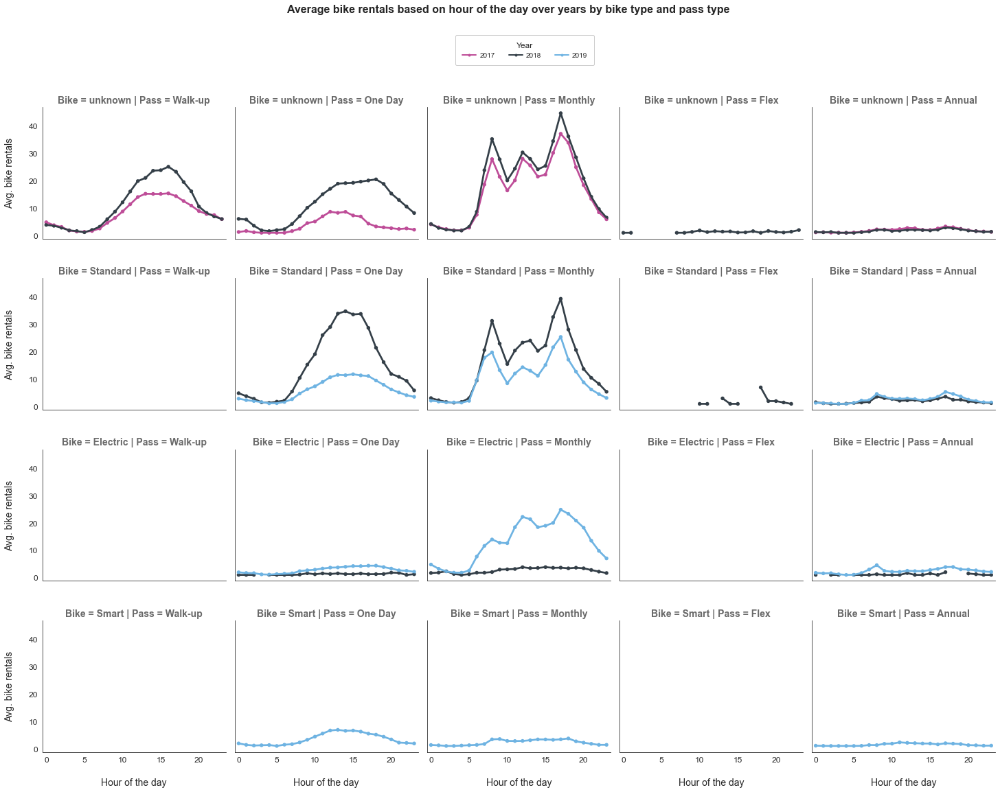

In [939]:
# Assign palette as per requirement
sb.set_style('white')
flatui = ['#cc3f9d', '#31404a', '#60b6f0']
sb.set_palette(flatui, n_colors=3, desat=0.8)

# Facet grid with point plot
plot_order = hours_df.hour.sort_values(ascending=True).unique()
g = sb.FacetGrid(data = hours_df, col = 'pass_type', row = 'bike_type', height = 4, aspect = 1, hue = 'year')
g.map(sb.pointplot, "hour", "rentals", order= plot_order, linestyles = "-", ci = None, markers = ['.']);
g.fig.subplots_adjust(top=0.85)
g.fig.suptitle('Average bike rentals based on hour of the day over years by bike type and pass type', 
               fontsize = 16, weight = 'bold')
g.set_titles('Bike = {row_name} | Pass = {col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# improve plot aesthetics
# -------------------------------------------------------
g.set_xlabels('\nHour of the day', size = 14)
g.set_ylabels('Avg. bike rentals\n', size = 14)
g.set_yticklabels(size = 12)
# iterate over axes of FacetGrid
for ax in g.axes.flat:
     # get x labels
    labels = ax.get_xticklabels()
    for i,l in enumerate(labels):
        # skip labels
        if not (i%5 == 0): labels[i] = ''
    # set new labels
    ax.set_xticklabels(labels, size = 12)
# -------------------------------------------------------

# add custom legend
# -------------------------------------------------------
custom = [Line2D([], [], marker='.', color=sb.color_palette()[0], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[1], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[2], linestyle='-', linewidth = 2)]

plt.legend(custom, ['2017', '2018', '2019'], scatterpoints=1, frameon=True, fancybox=True, 
           shadow=False, framealpha = 1, borderpad=1, borderaxespad=1, labelspacing=0.5, 
           ncol = 3, title='Year', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(-1.15, 5.5));
# -------------------------------------------------------

plt.subplots_adjust(wspace=0.05, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.3.77 Average bike rentals based on hour over the years by bike type and pass type.png', dpi=300, bbox_inches='tight')

----

#### 3.3.78 Multivariate analysis of `daytime`, `year`, `bike_type` and `pass_type` columns:

+ `Columns`: daytime, year, bike_type, pass_type
+ `Data type`: (Categorical, ordered), (Categorical, ordered), (Categorical, nominal) and (Categorical, nominal)
+ `Plot`: Point plot

**`Find average rentals based on the daytime of the day over years:`**

Create a dataset which contain bike rentals relative to each `daytime` in the day over respective months in the year. Care should be taken as to inlcude only daytimes that appear in every day of the month over individual years. Use available categorical combinations and do not fill the `NULL` values with numerical zero's so as to consider bike rentals subjected to every daytime in any day.

In [940]:
# create a dataset for bike rentals over each day in a week
daytime_df = bikeshare.groupby([bikeshare["year"], 
                                bikeshare["month"],
                                bikeshare["day"],
                                bikeshare["daytime"],
                                bikeshare["bike_type"],
                                bikeshare["pass_type"]]).count()['trip_id'].reset_index(name='rentals')
daytime_df.head(10)

,year,month,day,daytime,bike_type,pass_type,rentals
0,2017,1,1,Early hours,unknown,Walk-up,19.0
1,2017,1,1,Early hours,unknown,One Day,NaN
2,2017,1,1,Early hours,unknown,Monthly,8.0
3,2017,1,1,Early hours,unknown,Flex,NaN
4,2017,1,1,Early hours,unknown,Annual,NaN
5,2017,1,1,Early hours,Standard,Walk-up,NaN
6,2017,1,1,Early hours,Standard,One Day,NaN
7,2017,1,1,Early hours,Standard,Monthly,NaN
8,2017,1,1,Early hours,Standard,Flex,NaN
9,2017,1,1,Early hours,Standard,Annual,NaN


**`Point plot:`**

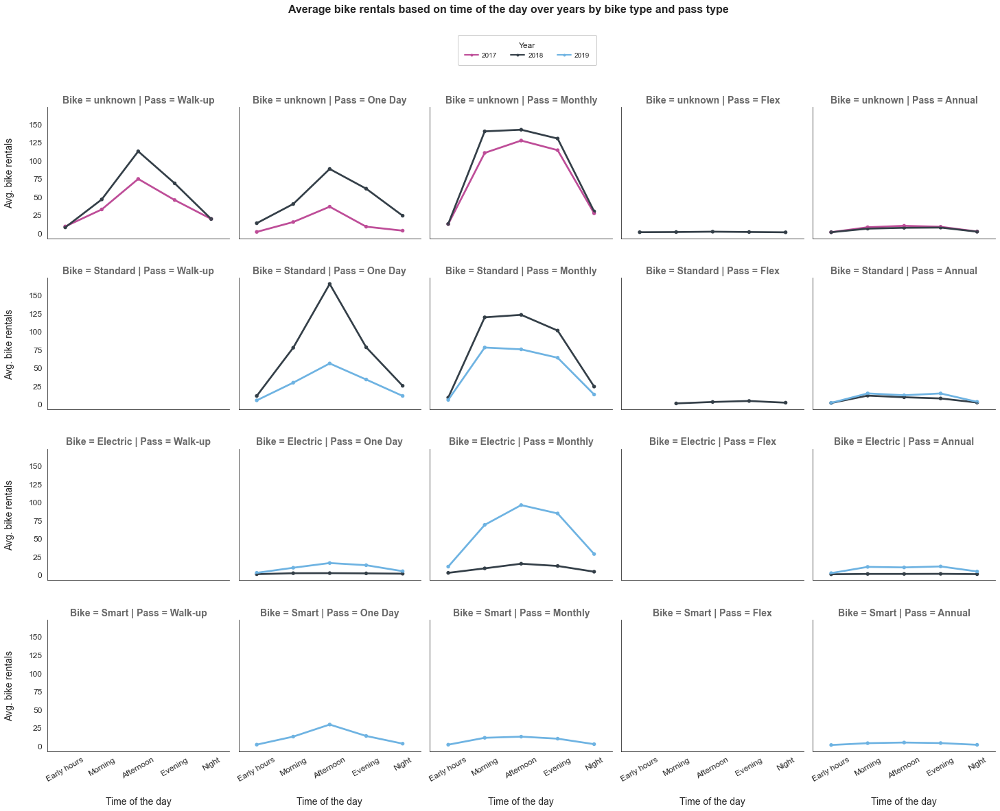

In [941]:
# Assign palette as per requirement
sb.set_style('white')
flatui = ['#cc3f9d', '#31404a', '#60b6f0']
sb.set_palette(flatui, n_colors=3, desat=0.8)

# Facet grid with point plot
plot_order = daytime_df.daytime.sort_values(ascending=True).unique()
g = sb.FacetGrid(data = daytime_df, col = 'pass_type', row = 'bike_type', height = 4, aspect = 1, hue = 'year')
g.map(sb.pointplot, "daytime", "rentals", order= plot_order, linestyles = "-", ci = None, markers = ['.']);
g.fig.subplots_adjust(top=0.85)
g.fig.suptitle('Average bike rentals based on time of the day over years by bike type and pass type', 
               fontsize = 16, weight = 'bold')
g.set_titles('Bike = {row_name} | Pass = {col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# improve plot aesthetics
# -------------------------------------------------------
g.set_xlabels('\nTime of the day', size = 14)
g.set_ylabels('Avg. bike rentals\n', size = 14)
g.set_yticklabels(size = 12)
# iterate over axes of FacetGrid
for ax in g.axes.flat:
     # get x labels
    labels = ax.get_xticklabels()
    # set new labels
    ax.set_xticklabels(labels, rotation = 30, size = 12)
# -------------------------------------------------------

# add custom legend
# -------------------------------------------------------
custom = [Line2D([], [], marker='.', color=sb.color_palette()[0], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[1], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[2], linestyle='-', linewidth = 2)]

plt.legend(custom, ['2017', '2018', '2019'], scatterpoints=1, frameon=True, fancybox=True, 
           shadow=False, framealpha = 1, borderpad=1, borderaxespad=1, labelspacing=0.5, 
           ncol = 3, title='Year', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(-1.15, 5.5));
# -------------------------------------------------------

plt.subplots_adjust(wspace=0.05, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.3.78 Average bike rentals based on daytime over the years by bike type and pass type.png', dpi=300, bbox_inches='tight')

----

#### 3.3.79 Multivariate analysis of `day`, `year`, `bike_type` and `pass_type` columns:

+ `Columns`: day, year, bike_type, pass_type
+ `Data type`: (Categorical, ordered), (Categorical, ordered), (Categorical, nominal) and (Categorical, nominal)
+ `Plot`: Point plot

**`Find average rentals based on the day of the month over years:`**

Create a dataset which contain bike rentals relative to each `day` over respective months in the year. Care should be taken as to inlcude only days that appear in every month over individual years. Use available categorical combinations and do not fill the `NULL` values with numerical zero's so as to consider bike rentals subjected to every day in any month.

In [942]:
# create a dataset for bike rentals over each day in a month
days_df = bikeshare.groupby([bikeshare["year"], 
                             bikeshare["month"],
                             bikeshare["day"],
                             bikeshare["bike_type"],
                             bikeshare["pass_type"]]).count()['trip_id'].reset_index(name='rentals')
days_df.head(10)

,year,month,day,bike_type,pass_type,rentals
0,2017,1,1,unknown,Walk-up,169.0
1,2017,1,1,unknown,One Day,NaN
2,2017,1,1,unknown,Monthly,90.0
3,2017,1,1,unknown,Flex,NaN
4,2017,1,1,unknown,Annual,11.0
5,2017,1,1,Standard,Walk-up,NaN
6,2017,1,1,Standard,One Day,NaN
7,2017,1,1,Standard,Monthly,NaN
8,2017,1,1,Standard,Flex,NaN
9,2017,1,1,Standard,Annual,NaN


**`Point plot:`**

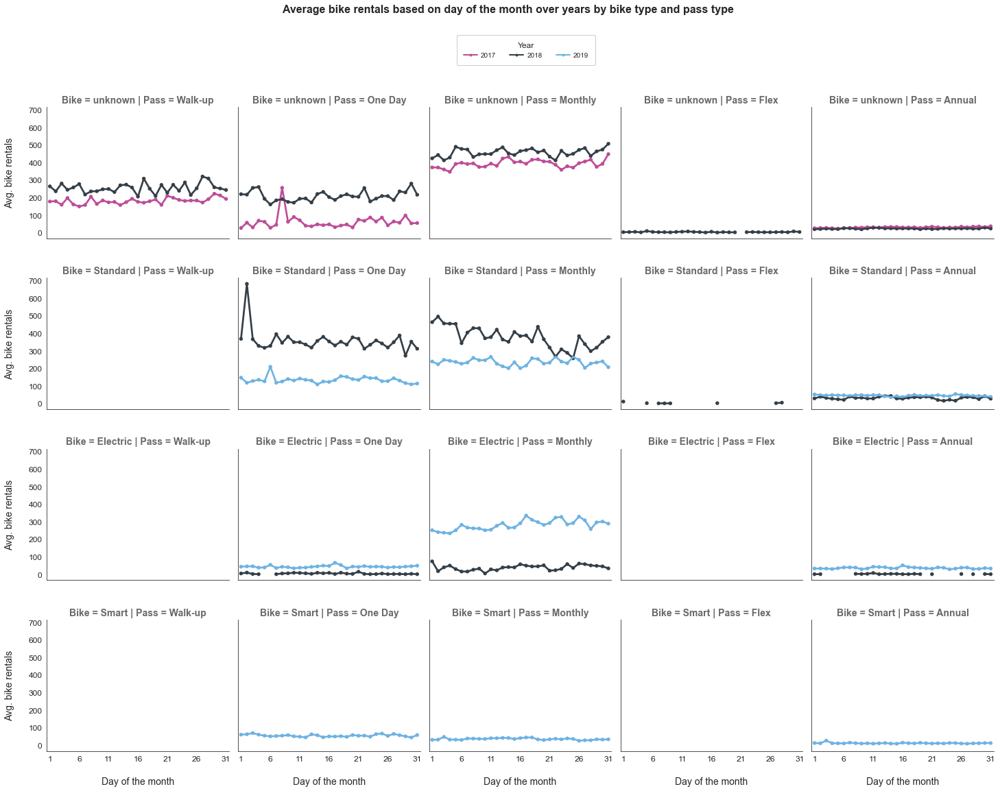

In [943]:
# Assign palette as per requirement
sb.set_style('white')
flatui = ['#cc3f9d', '#31404a', '#60b6f0']
sb.set_palette(flatui, n_colors=3, desat=0.8)

# Facet grid with point plot
plot_order = days_df.day.sort_values(ascending=True).unique()
g = sb.FacetGrid(data = days_df, col = 'pass_type', row = 'bike_type', height = 4, aspect = 1, hue = 'year')
g.map(sb.pointplot, "day", "rentals", order= plot_order, linestyles = "-", ci = None, markers = ['.']);
g.fig.subplots_adjust(top=0.85)
g.fig.suptitle('Average bike rentals based on day of the month over years by bike type and pass type', 
               fontsize = 16, weight = 'bold')
g.set_titles('Bike = {row_name} | Pass = {col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# improve plot aesthetics
# -------------------------------------------------------
g.set_xlabels('\nDay of the month', size = 14)
g.set_ylabels('Avg. bike rentals\n', size = 14)
g.set_yticklabels(size = 12)
# iterate over axes of FacetGrid
for ax in g.axes.flat:
     # get x labels
    labels = ax.get_xticklabels()
    for i,l in enumerate(labels):
        # skip labels
        if not (i%5 == 0): labels[i] = ''
    # set new labels
    ax.set_xticklabels(labels, size = 12)
# -------------------------------------------------------

# add custom legend
# -------------------------------------------------------
custom = [Line2D([], [], marker='.', color=sb.color_palette()[0], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[1], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[2], linestyle='-', linewidth = 2)]

plt.legend(custom, ['2017', '2018', '2019'], scatterpoints=1, frameon=True, fancybox=True, 
           shadow=False, framealpha = 1, borderpad=1, borderaxespad=1, labelspacing=0.5, 
           ncol = 3, title='Year', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(-1.15, 5.5));
# -------------------------------------------------------

plt.subplots_adjust(wspace=0.05, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.3.79 Average bike rentals based on day over the years by bike type and pass type.png', dpi=300, bbox_inches='tight')

----

#### 3.3.80 Multivariate analysis of `weekday`, `year`, `bike_type` and `pass_type` columns:

+ `Columns`: weekday, year, bike_type, pass_type
+ `Data type`: (Categorical, ordered), (Categorical, ordered), (Categorical, nominal) and (Categorical, nominal)
+ `Plot`: Point plot

**`Find average rentals based on the day of the week over years:`**

Create a dataset which contain bike rentals relative to each `day` over respective week in the month. Care should be taken as to inlcude only days that appear in every week over individual months. Use available categorical combinations and do not fill the `NULL` values with numerical zero's so as to consider bike rentals subjected to every day in any week.

In [944]:
# create a dataset for bike rentals over each day in a week
weekday_df = bikeshare.groupby([bikeshare["year"], 
                                bikeshare["month"],
                                bikeshare["week"],
                                bikeshare["weekday"],
                                bikeshare["bike_type"],
                                bikeshare["pass_type"]]).count()['trip_id'].reset_index(name='rentals')
weekday_df.head(10)

,year,month,week,weekday,bike_type,pass_type,rentals
0,2017,1,First,Monday,unknown,Walk-up,115.0
1,2017,1,First,Monday,unknown,One Day,NaN
2,2017,1,First,Monday,unknown,Monthly,121.0
3,2017,1,First,Monday,unknown,Flex,NaN
4,2017,1,First,Monday,unknown,Annual,23.0
5,2017,1,First,Monday,Standard,Walk-up,NaN
6,2017,1,First,Monday,Standard,One Day,NaN
7,2017,1,First,Monday,Standard,Monthly,NaN
8,2017,1,First,Monday,Standard,Flex,NaN
9,2017,1,First,Monday,Standard,Annual,NaN


**`Point plot:`**

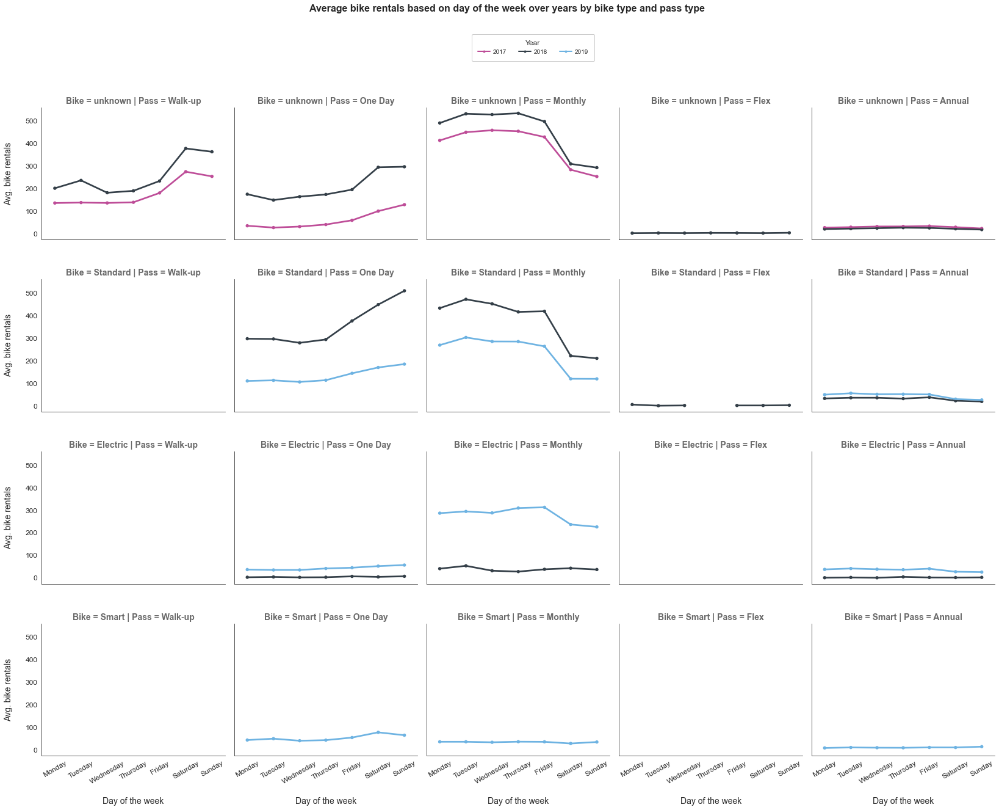

In [945]:
# Assign palette as per requirement
sb.set_style('white')
flatui = ['#cc3f9d', '#31404a', '#60b6f0']
sb.set_palette(flatui, n_colors=3, desat=0.8)

# Facet grid with point plot
plot_order = weekday_df.weekday.sort_values(ascending=True).unique()
g = sb.FacetGrid(data = weekday_df, col = 'pass_type', row = 'bike_type', height = 4.5, aspect = 1, hue = 'year')
g.map(sb.pointplot, "weekday", "rentals", order= plot_order, linestyles = "-", ci = None, markers = ['.']);
g.fig.subplots_adjust(top=0.85)
g.fig.suptitle('Average bike rentals based on day of the week over years by bike type and pass type', 
               fontsize = 16, weight = 'bold')
g.set_titles('Bike = {row_name} | Pass = {col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# improve plot aesthetics
# -------------------------------------------------------
g.set_xlabels('\nDay of the week', size = 14)
g.set_ylabels('Avg. bike rentals\n', size = 14)
g.set_yticklabels(size = 12)
# iterate over axes of FacetGrid
for ax in g.axes.flat:
     # get x labels
    labels = ax.get_xticklabels()
    # set new labels
    ax.set_xticklabels(labels, rotation = 30, size = 12)
# -------------------------------------------------------

# add custom legend
# -------------------------------------------------------
custom = [Line2D([], [], marker='.', color=sb.color_palette()[0], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[1], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[2], linestyle='-', linewidth = 2)]

plt.legend(custom, ['2017', '2018', '2019'], scatterpoints=1, frameon=True, fancybox=True, 
           shadow=False, framealpha = 1, borderpad=1, borderaxespad=1, labelspacing=0.5, 
           ncol = 3, title='Year', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(-1.15, 5.5));
# -------------------------------------------------------

plt.subplots_adjust(wspace=0.05, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.3.80 Average bike rentals based on weekday over the years by bike type and pass type.png', dpi=300, bbox_inches='tight')

----

#### 3.3.81 Multivariate analysis of `month`, `year`, `bike_type` and `pass_type` columns:

+ `Columns`: month, year, bike_type, pass_type
+ `Data type`: (Categorical, ordered), (Categorical, ordered), (Categorical, nominal) and (Categorical, nominal)
+ `Plot`: Point plot

**`Find average rentals based on the month over years:`**

Create a dataset which contain bike rentals relative to each `month` over respective years. Care should be taken as to inlcude only rentals that appear in every month over individual years. Use available categorical combinations and do not fill the `NULL` values with numerical zero's so as to consider bike rentals subjected to every month in any year.

In [946]:
# create a dataset for bike rentals over each month in a year
month_df = bikeshare.groupby([bikeshare["year"], 
                              bikeshare["month"],
                              bikeshare["bike_type"],
                              bikeshare["pass_type"]]).count()['trip_id'].reset_index(name='rentals')
month_df.head(10)

,year,month,bike_type,pass_type,rentals
0,2017,1,unknown,Walk-up,3187.0
1,2017,1,unknown,One Day,NaN
2,2017,1,unknown,Monthly,6306.0
3,2017,1,unknown,Flex,NaN
4,2017,1,unknown,Annual,663.0
5,2017,1,Standard,Walk-up,NaN
6,2017,1,Standard,One Day,NaN
7,2017,1,Standard,Monthly,NaN
8,2017,1,Standard,Flex,NaN
9,2017,1,Standard,Annual,NaN


**`Point plot:`**

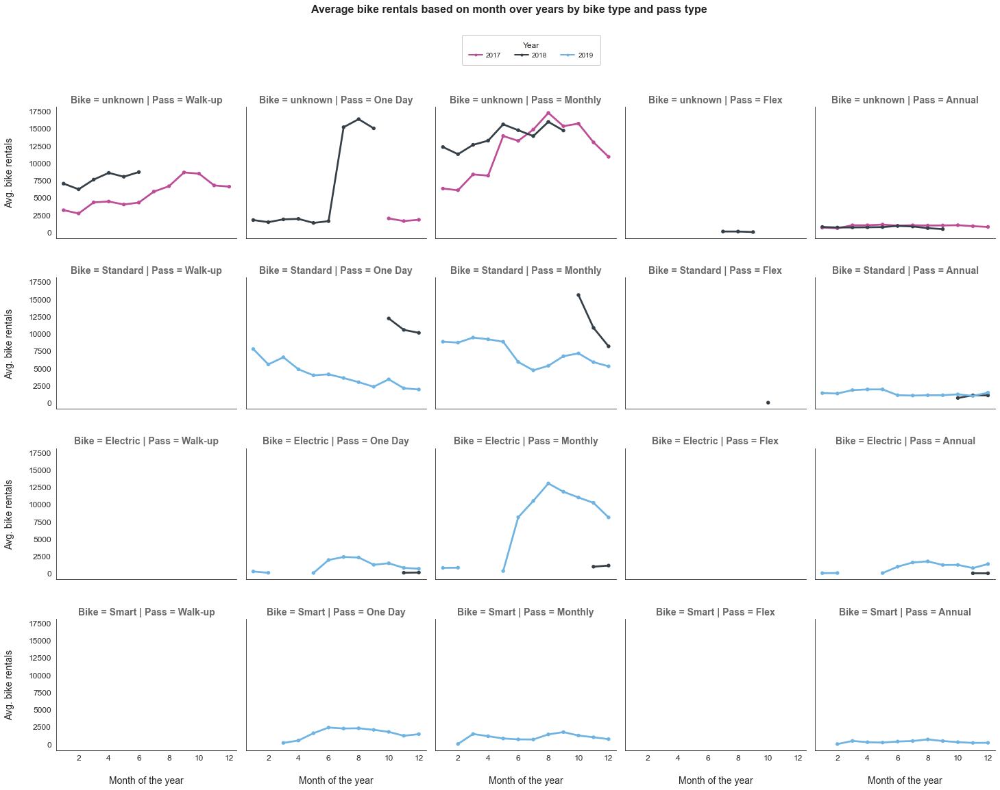

In [947]:
# Assign palette as per requirement
sb.set_style('white')
flatui = ['#cc3f9d', '#31404a', '#60b6f0']
sb.set_palette(flatui, n_colors=3, desat=0.8)

# Facet grid with point plot
plot_order = month_df.month.sort_values(ascending=True).unique()
g = sb.FacetGrid(data = month_df, col = 'pass_type', row = 'bike_type', height = 4, aspect = 1, hue = 'year')
g.map(sb.pointplot, "month", "rentals", order= plot_order, linestyles = "-", ci = None, markers = ['.']);
g.fig.subplots_adjust(top=0.85)
g.fig.suptitle('Average bike rentals based on month over years by bike type and pass type', 
               fontsize = 16, weight = 'bold')
g.set_titles('Bike = {row_name} | Pass = {col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# improve plot aesthetics
# -------------------------------------------------------
g.set_xlabels('\nMonth of the year', size = 14)
g.set_ylabels('Avg. bike rentals\n', size = 14)
g.set_yticklabels(size = 12)
# iterate over axes of FacetGrid
for ax in g.axes.flat:
    # get x labels
    xlabels = ax.get_xticklabels()
    for i,l in enumerate(xlabels):
        # skip labels
        if (i%2 == 0): xlabels[i] = ''
    # set new xlabels
    ax.set_xticklabels(xlabels, size = 12)
# -------------------------------------------------------

# add custom legend
# -------------------------------------------------------
custom = [Line2D([], [], marker='.', color=sb.color_palette()[0], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[1], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[2], linestyle='-', linewidth = 2)]

plt.legend(custom, ['2017', '2018', '2019'], scatterpoints=1, frameon=True, fancybox=True, 
           shadow=False, framealpha = 1, borderpad=1, borderaxespad=1, labelspacing=0.5, 
           ncol = 3, title='Year', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(-1.15, 5.5));
# -------------------------------------------------------

plt.subplots_adjust(wspace=0.05, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.3.81 Average bike rentals based on month over the years by bike type and pass type.png', dpi=300, bbox_inches='tight')

----

#### 3.3.82 Multivariate analysis of `quarter`, `year`, `bike_type` and `pass_type` columns:

+ `Columns`: quarter, year, bike_type, pass_type
+ `Data type`: (Categorical, ordered), (Categorical, ordered), (Categorical, nominal) and (Categorical, nominal)
+ `Plot`: Point plot

**`Find average rentals based on the quarter over years:`**

Create a dataset which contain bike rentals relative to each `quarter` over respective years. Care should be taken as to inlcude only rentals that appear in every quarter over individual years. Use available categorical combinations and do not fill the `NULL` values with numerical zero's so as to consider bike rentals subjected to every quarter in any year.

In [948]:
# create a dataset for bike rentals over each day in a week
quarter_df = bikeshare.groupby([bikeshare["year"], 
                                bikeshare["quarter"],
                                bikeshare["bike_type"],
                                bikeshare["pass_type"]]).count()['trip_id'].reset_index(name='rentals')
quarter_df.head(10)

,year,quarter,bike_type,pass_type,rentals
0,2017,Q1,unknown,Walk-up,10211.0
1,2017,Q1,unknown,One Day,NaN
2,2017,Q1,unknown,Monthly,20730.0
3,2017,Q1,unknown,Flex,NaN
4,2017,Q1,unknown,Annual,2257.0
5,2017,Q1,Standard,Walk-up,NaN
6,2017,Q1,Standard,One Day,NaN
7,2017,Q1,Standard,Monthly,NaN
8,2017,Q1,Standard,Flex,NaN
9,2017,Q1,Standard,Annual,NaN


**`Point plot:`**

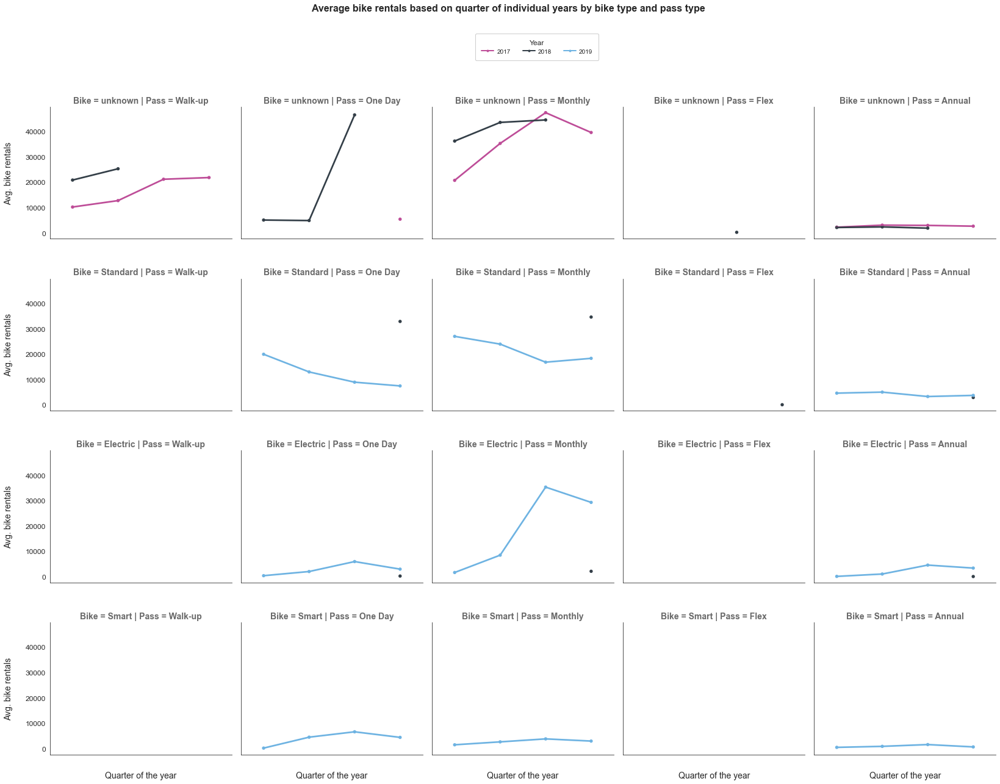

In [949]:
# Assign palette as per requirement
sb.set_style('white')
flatui = ['#cc3f9d', '#31404a', '#60b6f0']
sb.set_palette(flatui, n_colors=3, desat=0.8)

# Facet grid with point plot
plot_order = quarter_df.quarter.sort_values(ascending=True).unique()
g = sb.FacetGrid(data = quarter_df, col = 'pass_type', row = 'bike_type', height = 4.5, aspect = 1, hue = 'year')
g.map(sb.pointplot, "quarter", "rentals", order= plot_order, linestyles = "-", ci = None, markers = ['.']);
g.fig.subplots_adjust(top=0.85)
g.fig.suptitle('Average bike rentals based on quarter of individual years by bike type and pass type', 
               fontsize = 16, weight = 'bold')
g.set_titles('Bike = {row_name} | Pass = {col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# improve plot aesthetics
# -------------------------------------------------------
g.set_xlabels('\nQuarter of the year', size = 14)
g.set_ylabels('Avg. bike rentals\n', size = 14)
g.set_xticklabels(size = 12)
g.set_yticklabels(size = 12)
# -------------------------------------------------------

# add custom legend
# -------------------------------------------------------
custom = [Line2D([], [], marker='.', color=sb.color_palette()[0], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[1], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[2], linestyle='-', linewidth = 2)]

plt.legend(custom, ['2017', '2018', '2019'], scatterpoints=1, frameon=True, fancybox=True, 
           shadow=False, framealpha = 1, borderpad=1, borderaxespad=1, labelspacing=0.5, 
           ncol = 3, title='Year', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(-1.15, 5.5));
# -------------------------------------------------------

plt.subplots_adjust(wspace=0.05, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.3.82 Average bike rentals based on quarter of individual years by bike type and pass type.png', dpi=300, bbox_inches='tight')

------

#### 3.3.83 Multivariate analysis of `hour`, `trip_type`, `bike_type` and `pass_type` columns:

+ `Columns`: hour, trip_type, bike_type, pass_type
+ `Data type`: (numerical, continuous), (Categorical, ordered), (Categorical, nominal) and (Categorical, nominal)
+ `Plot`: Point plot

**`Find average rentals based on the hour over trip_type:`**

Create a dataset which contain bike rentals relative to each `hour` in the day over respective months in the year. Care should be taken as to inlcude only hours that appear in every day of the month over individual years. Use available categorical combinations and do not fill the `NULL` values with numerical zero's so as to consider bike rentals subjected to every hour in any day.

In [950]:
# create a dataset for bike rentals over each hour in a day
hours_df = bikeshare.groupby([bikeshare["year"], 
                              bikeshare["month"],
                              bikeshare["day"],
                              bikeshare["hour"],
                              bikeshare["trip_type"],
                              bikeshare["bike_type"],
                              bikeshare["pass_type"]]).count()['trip_id'].reset_index(name='rentals')
hours_df.head(10)

,year,month,day,hour,trip_type,bike_type,pass_type,rentals
0,2017,1,1,0,One Way,unknown,Walk-up,3.0
1,2017,1,1,0,One Way,unknown,One Day,NaN
2,2017,1,1,0,One Way,unknown,Monthly,3.0
3,2017,1,1,0,One Way,unknown,Flex,NaN
4,2017,1,1,0,One Way,unknown,Annual,NaN
5,2017,1,1,0,One Way,Standard,Walk-up,NaN
6,2017,1,1,0,One Way,Standard,One Day,NaN
7,2017,1,1,0,One Way,Standard,Monthly,NaN
8,2017,1,1,0,One Way,Standard,Flex,NaN
9,2017,1,1,0,One Way,Standard,Annual,NaN


**`Point plot:`**

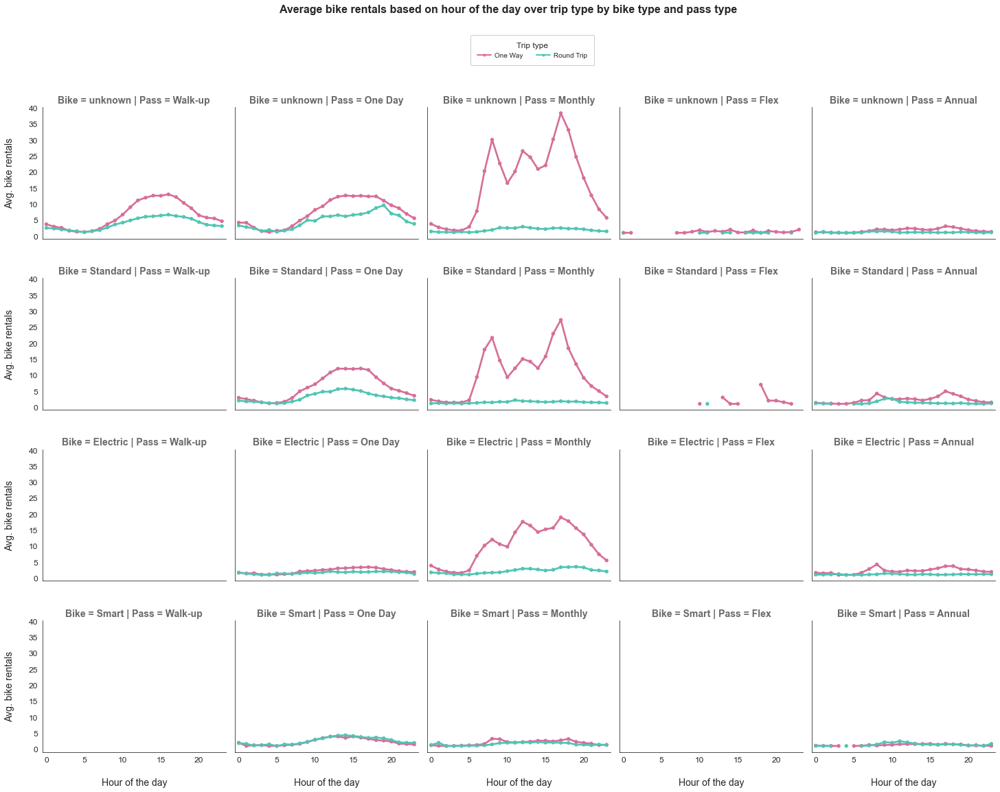

In [951]:
# Assign palette as per requirement
sb.set_style('white')
flatui = ['#e36297', '#42d4be']
sb.set_palette(flatui, n_colors=2, desat=0.8)

# Facet grid with point plot
plot_order = hours_df.hour.sort_values(ascending=True).unique()
g = sb.FacetGrid(data = hours_df, col = 'pass_type', row = 'bike_type', height = 4, aspect = 1, hue = 'trip_type')
g.map(sb.pointplot, "hour", "rentals", order= plot_order, linestyles = "-", ci = None, markers = ['.']);
g.fig.subplots_adjust(top=0.85)
g.fig.suptitle('Average bike rentals based on hour of the day over trip type by bike type and pass type', 
               fontsize = 16, weight = 'bold')
g.set_titles('Bike = {row_name} | Pass = {col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# improve plot aesthetics
# -------------------------------------------------------
g.set_xlabels('\nHour of the day', size = 14)
g.set_ylabels('Avg. bike rentals\n', size = 14)
g.set_yticklabels(size = 12)
# iterate over axes of FacetGrid
for ax in g.axes.flat:
     # get x labels
    labels = ax.get_xticklabels()
    for i,l in enumerate(labels):
        # skip labels
        if not (i%5 == 0): labels[i] = ''
    # set new labels
    ax.set_xticklabels(labels, size = 12)
# -------------------------------------------------------

# add custom legend
# -------------------------------------------------------
custom = [Line2D([], [], marker='.', color=sb.color_palette()[0], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[1], linestyle='-', linewidth = 2)]

plt.legend(custom, ['One Way', 'Round Trip'], scatterpoints=1, frameon=True, fancybox=True, 
           shadow=False, framealpha = 1, borderpad=1, borderaxespad=1, labelspacing=0.5, 
           ncol = 3, title='Trip type', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(-1.15, 5.5));
# -------------------------------------------------------

plt.subplots_adjust(wspace=0.05, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.3.83 Average bike rentals based on hour over trip type by bike type and pass type.png', dpi=300, bbox_inches='tight')

----

#### 3.3.84 Multivariate analysis of `daytime`, `trip_type`, `bike_type` and `pass_type` columns:

+ `Columns`: daytime, trip_type, bike_type, pass_type
+ `Data type`: (Categorical, ordered), (Categorical, ordered), (Categorical, nominal) and (Categorical, nominal)
+ `Plot`: Point plot

**`Find average rentals based on the daytime of the day over trip_type:`**

Create a dataset which contain bike rentals relative to each `daytime` in the day over respective months in the year. Care should be taken as to inlcude only daytimes that appear in every day of the month over individual years. Use available categorical combinations and do not fill the `NULL` values with numerical zero's so as to consider bike rentals subjected to every daytime in any day.

In [952]:
# create a dataset for bike rentals over each day in a week
daytime_df = bikeshare.groupby([bikeshare["year"], 
                                bikeshare["month"],
                                bikeshare["day"],
                                bikeshare["daytime"], 
                                bikeshare["trip_type"],
                                bikeshare["bike_type"],
                                bikeshare["pass_type"]]).count()['trip_id'].reset_index(name='rentals')
daytime_df.head(10)

,year,month,day,daytime,trip_type,bike_type,pass_type,rentals
0,2017,1,1,Early hours,One Way,unknown,Walk-up,16.0
1,2017,1,1,Early hours,One Way,unknown,One Day,NaN
2,2017,1,1,Early hours,One Way,unknown,Monthly,8.0
3,2017,1,1,Early hours,One Way,unknown,Flex,NaN
4,2017,1,1,Early hours,One Way,unknown,Annual,NaN
5,2017,1,1,Early hours,One Way,Standard,Walk-up,NaN
6,2017,1,1,Early hours,One Way,Standard,One Day,NaN
7,2017,1,1,Early hours,One Way,Standard,Monthly,NaN
8,2017,1,1,Early hours,One Way,Standard,Flex,NaN
9,2017,1,1,Early hours,One Way,Standard,Annual,NaN


**`Point plot:`**

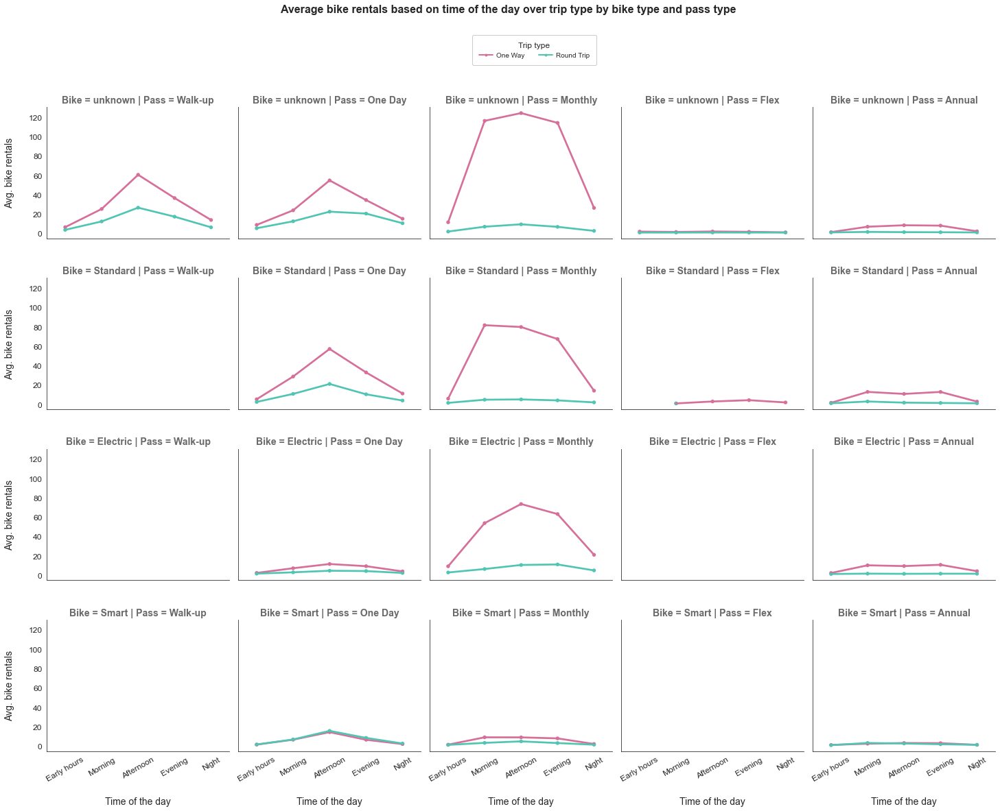

In [953]:
# Assign palette as per requirement
sb.set_style('white')
flatui = ['#e36297', '#42d4be']
sb.set_palette(flatui, n_colors=2, desat=0.8)

# Facet grid with point plot
plot_order = daytime_df.daytime.sort_values(ascending=True).unique()
g = sb.FacetGrid(data = daytime_df, col = 'pass_type', row = 'bike_type', height = 4, aspect = 1, hue = 'trip_type')
g.map(sb.pointplot, "daytime", "rentals", order= plot_order, linestyles = "-", ci = None, markers = ['.']);
g.fig.subplots_adjust(top=0.85)
g.fig.suptitle('Average bike rentals based on time of the day over trip type by bike type and pass type', 
               fontsize = 16, weight = 'bold')
g.set_titles('Bike = {row_name} | Pass = {col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# improve plot aesthetics
# -------------------------------------------------------
g.set_xlabels('\nTime of the day', size = 14)
g.set_ylabels('Avg. bike rentals\n', size = 14)
g.set_yticklabels(size = 12)
# iterate over axes of FacetGrid
for ax in g.axes.flat:
     # get x labels
    labels = ax.get_xticklabels()
    # set new labels
    ax.set_xticklabels(labels, rotation = 30, size = 12)
# -------------------------------------------------------

# add custom legend
# -------------------------------------------------------
custom = [Line2D([], [], marker='.', color=sb.color_palette()[0], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[1], linestyle='-', linewidth = 2)]

plt.legend(custom, ['One Way', 'Round Trip'], scatterpoints=1, frameon=True, fancybox=True, 
           shadow=False, framealpha = 1, borderpad=1, borderaxespad=1, labelspacing=0.5, 
           ncol = 3, title='Trip type', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(-1.15, 5.5));
# -------------------------------------------------------

plt.subplots_adjust(wspace=0.05, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.3.84 Average bike rentals based on daytime over the trip type by bike type and pass type.png', dpi=300, bbox_inches='tight')

----

#### 3.3.85 Multivariate analysis of `day`, `trip_type`, `bike_type` and `pass_type` columns:

+ `Columns`: day, trip_type, bike_type, pass_type
+ `Data type`: (Categorical, ordered), (Categorical, ordered), (Categorical, nominal) and (Categorical, nominal)
+ `Plot`: Point plot

**`Find average rentals based on the day of the month over trip_type:`**

Create a dataset which contain bike rentals relative to each `day` over respective months in the year. Care should be taken as to inlcude only days that appear in every month over individual years. Use available categorical combinations and do not fill the `NULL` values with numerical zero's so as to consider bike rentals subjected to every day in any month.

In [954]:
# create a dataset for bike rentals over each day in a month
days_df = bikeshare.groupby([bikeshare["year"], 
                             bikeshare["month"],
                             bikeshare["day"],
                             bikeshare["trip_type"],
                             bikeshare["bike_type"],
                             bikeshare["pass_type"]]).count()['trip_id'].reset_index(name='rentals')
days_df.head(10)

,year,month,day,trip_type,bike_type,pass_type,rentals
0,2017,1,1,One Way,unknown,Walk-up,129.0
1,2017,1,1,One Way,unknown,One Day,NaN
2,2017,1,1,One Way,unknown,Monthly,88.0
3,2017,1,1,One Way,unknown,Flex,NaN
4,2017,1,1,One Way,unknown,Annual,11.0
5,2017,1,1,One Way,Standard,Walk-up,NaN
6,2017,1,1,One Way,Standard,One Day,NaN
7,2017,1,1,One Way,Standard,Monthly,NaN
8,2017,1,1,One Way,Standard,Flex,NaN
9,2017,1,1,One Way,Standard,Annual,NaN


**`Point plot:`**

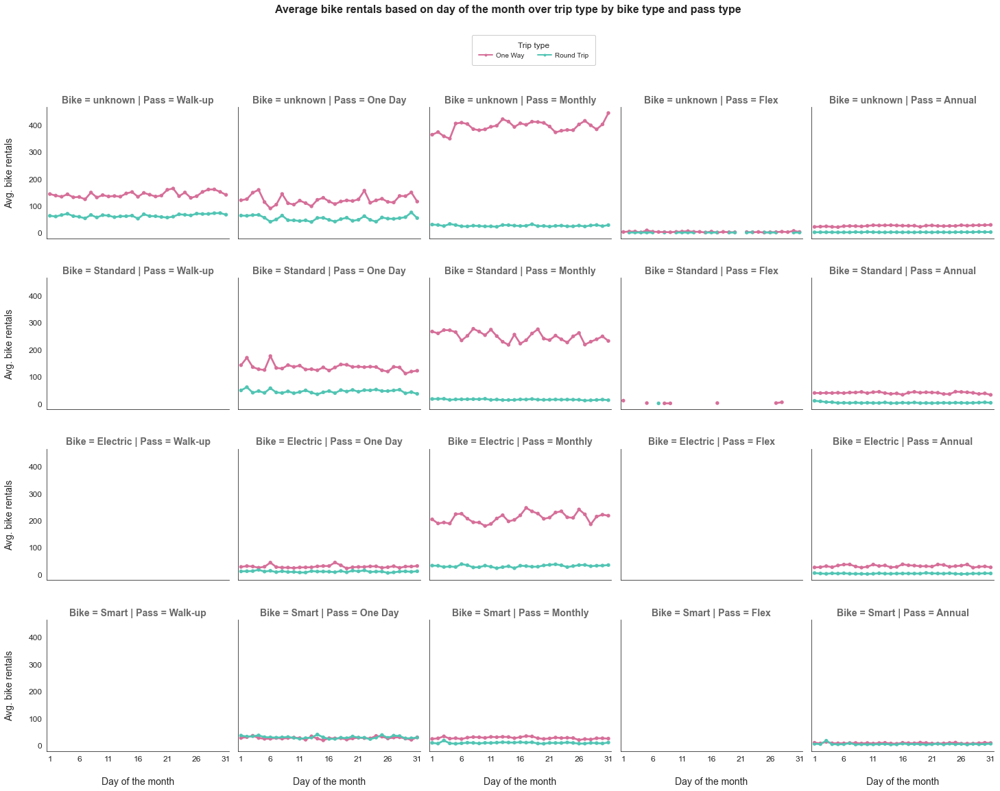

In [955]:
# Assign palette as per requirement
sb.set_style('white')
flatui = ['#e36297', '#42d4be']
sb.set_palette(flatui, n_colors=2, desat=0.8)

# Facet grid with point plot
plot_order = days_df.day.sort_values(ascending=True).unique()
g = sb.FacetGrid(data = days_df, col = 'pass_type', row = 'bike_type', height = 4, aspect = 1, hue = 'trip_type')
g.map(sb.pointplot, "day", "rentals", order= plot_order, linestyles = "-", ci = None, markers = ['.']);
g.fig.subplots_adjust(top=0.85)
g.fig.suptitle('Average bike rentals based on day of the month over trip type by bike type and pass type', 
               fontsize = 16, weight = 'bold')
g.set_titles('Bike = {row_name} | Pass = {col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# improve plot aesthetics
# -------------------------------------------------------
g.set_xlabels('\nDay of the month', size = 14)
g.set_ylabels('Avg. bike rentals\n', size = 14)
g.set_yticklabels(size = 12)
# iterate over axes of FacetGrid
for ax in g.axes.flat:
     # get x labels
    labels = ax.get_xticklabels()
    for i,l in enumerate(labels):
        # skip labels
        if not (i%5 == 0): labels[i] = ''
    # set new labels
    ax.set_xticklabels(labels, size = 12)
# -------------------------------------------------------

# add custom legend
# -------------------------------------------------------
custom = [Line2D([], [], marker='.', color=sb.color_palette()[0], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[1], linestyle='-', linewidth = 2)]

plt.legend(custom, ['One Way', 'Round Trip'], scatterpoints=1, frameon=True, fancybox=True, 
           shadow=False, framealpha = 1, borderpad=1, borderaxespad=1, labelspacing=0.5, 
           ncol = 3, title='Trip type', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(-1.15, 5.5));
# -------------------------------------------------------

plt.subplots_adjust(wspace=0.05, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.3.85 Average bike rentals based on day over trip type by bike type and pass type.png', dpi=300, bbox_inches='tight')

----

#### 3.3.86 Multivariate analysis of `weekday`, `trip_type`, `bike_type` and `pass_type` columns:

+ `Columns`: weekday, trip_type, bike_type, pass_type
+ `Data type`: (Categorical, ordered), (Categorical, ordered), (Categorical, nominal) and (Categorical, nominal)
+ `Plot`: Point plot

**`Find average rentals based on the day of the week over trip_type:`**

Create a dataset which contain bike rentals relative to each `day` over respective week in the month. Care should be taken as to inlcude only days that appear in every week over individual months. Use available categorical combinations and do not fill the `NULL` values with numerical zero's so as to consider bike rentals subjected to every day in any week.

In [956]:
# create a dataset for bike rentals over each day in a week
weekday_df = bikeshare.groupby([bikeshare["year"], 
                                bikeshare["month"],
                                bikeshare["week"],
                                bikeshare["weekday"],
                                bikeshare["trip_type"],
                                bikeshare["bike_type"],
                                bikeshare["pass_type"]]).count()['trip_id'].reset_index(name='rentals')
weekday_df.head(10)

,year,month,week,weekday,trip_type,bike_type,pass_type,rentals
0,2017,1,First,Monday,One Way,unknown,Walk-up,91.0
1,2017,1,First,Monday,One Way,unknown,One Day,NaN
2,2017,1,First,Monday,One Way,unknown,Monthly,115.0
3,2017,1,First,Monday,One Way,unknown,Flex,NaN
4,2017,1,First,Monday,One Way,unknown,Annual,22.0
5,2017,1,First,Monday,One Way,Standard,Walk-up,NaN
6,2017,1,First,Monday,One Way,Standard,One Day,NaN
7,2017,1,First,Monday,One Way,Standard,Monthly,NaN
8,2017,1,First,Monday,One Way,Standard,Flex,NaN
9,2017,1,First,Monday,One Way,Standard,Annual,NaN


**`Point plot:`**

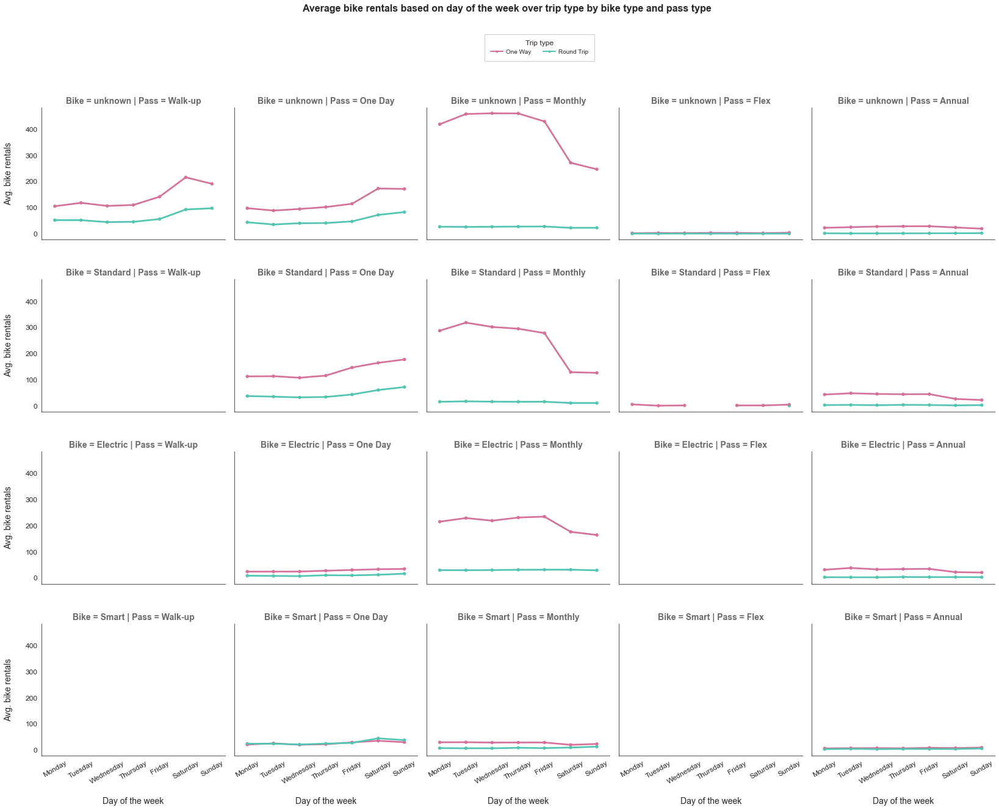

In [957]:
# Assign palette as per requirement
sb.set_style('white')
flatui = ['#e36297', '#42d4be']
sb.set_palette(flatui, n_colors=2, desat=0.8)

# Facet grid with point plot
plot_order = weekday_df.weekday.sort_values(ascending=True).unique()
g = sb.FacetGrid(data = weekday_df, col = 'pass_type', row = 'bike_type', height = 4.5, aspect = 1, hue = 'trip_type')
g.map(sb.pointplot, "weekday", "rentals", order= plot_order, linestyles = "-", ci = None, markers = ['.']);
g.fig.subplots_adjust(top=0.85)
g.fig.suptitle('Average bike rentals based on day of the week over trip type by bike type and pass type', 
               fontsize = 16, weight = 'bold')
g.set_titles('Bike = {row_name} | Pass = {col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# improve plot aesthetics
# -------------------------------------------------------
g.set_xlabels('\nDay of the week', size = 14)
g.set_ylabels('Avg. bike rentals\n', size = 14)
g.set_yticklabels(size = 12)
# iterate over axes of FacetGrid
for ax in g.axes.flat:
     # get x labels
    labels = ax.get_xticklabels()
    # set new labels
    ax.set_xticklabels(labels, rotation = 30, size = 12)
# -------------------------------------------------------

# add custom legend
# -------------------------------------------------------
custom = [Line2D([], [], marker='.', color=sb.color_palette()[0], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[1], linestyle='-', linewidth = 2)]

plt.legend(custom, ['One Way', 'Round Trip'], scatterpoints=1, frameon=True, fancybox=True, 
           shadow=False, framealpha = 1, borderpad=1, borderaxespad=1, labelspacing=0.5, 
           ncol = 3, title='Trip type', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(-1.15, 5.5));
# -------------------------------------------------------

plt.subplots_adjust(wspace=0.05, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.3.86 Average bike rentals based on weekday over trip type by bike type and pass type.png', dpi=300, bbox_inches='tight')

----

#### 3.3.87 Multivariate analysis of `month`, `trip_type`, `bike_type` and `pass_type` columns:

+ `Columns`: month, trip_type, bike_type, pass_type
+ `Data type`: (Categorical, ordered), (Categorical, ordered), (Categorical, nominal) and (Categorical, nominal)
+ `Plot`: Point plot

**`Find average rentals based on the month over trip_type:`**

Create a dataset which contain bike rentals relative to each `month` over respective years. Care should be taken as to inlcude only rentals that appear in every month over individual years. Use available categorical combinations and do not fill the `NULL` values with numerical zero's so as to consider bike rentals subjected to every month in any year.

In [958]:
# create a dataset for bike rentals over each month in a year
month_df = bikeshare.groupby([bikeshare["year"], 
                              bikeshare["month"],
                              bikeshare["trip_type"],
                              bikeshare["bike_type"],
                              bikeshare["pass_type"]]).count()['trip_id'].reset_index(name='rentals')
month_df.head(10)

,year,month,trip_type,bike_type,pass_type,rentals
0,2017,1,One Way,unknown,Walk-up,2555.0
1,2017,1,One Way,unknown,One Day,NaN
2,2017,1,One Way,unknown,Monthly,5998.0
3,2017,1,One Way,unknown,Flex,NaN
4,2017,1,One Way,unknown,Annual,642.0
5,2017,1,One Way,Standard,Walk-up,NaN
6,2017,1,One Way,Standard,One Day,NaN
7,2017,1,One Way,Standard,Monthly,NaN
8,2017,1,One Way,Standard,Flex,NaN
9,2017,1,One Way,Standard,Annual,NaN


**`Point plot:`**

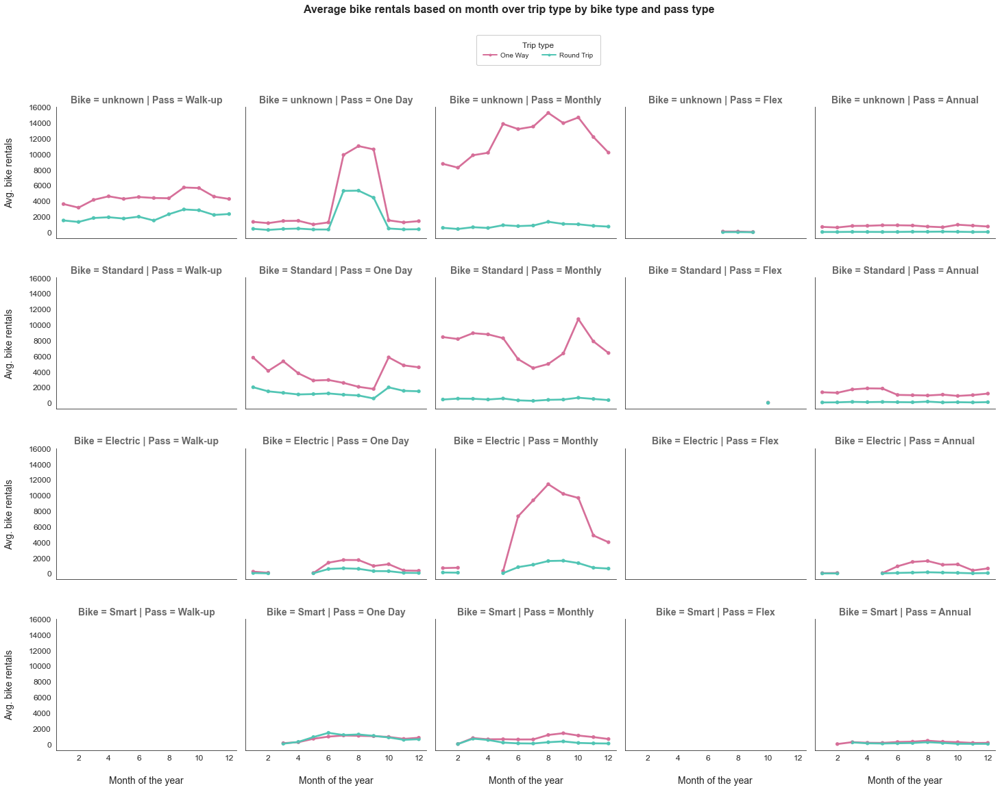

In [959]:
# Assign palette as per requirement
sb.set_style('white')
flatui = ['#e36297', '#42d4be']
sb.set_palette(flatui, n_colors=2, desat=0.8)

# Facet grid with point plot
plot_order = month_df.month.sort_values(ascending=True).unique()
g = sb.FacetGrid(data = month_df, col = 'pass_type', row = 'bike_type', height = 4, aspect = 1, hue = 'trip_type')
g.map(sb.pointplot, "month", "rentals", order= plot_order, linestyles = "-", ci = None, markers = ['.']);
g.fig.subplots_adjust(top=0.85)
g.fig.suptitle('Average bike rentals based on month over trip type by bike type and pass type', 
               fontsize = 16, weight = 'bold')
g.set_titles('Bike = {row_name} | Pass = {col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# improve plot aesthetics
# -------------------------------------------------------
g.set_xlabels('\nMonth of the year', size = 14)
g.set_ylabels('Avg. bike rentals\n', size = 14)
g.set_yticklabels(size = 12)
# iterate over axes of FacetGrid
for ax in g.axes.flat:
    # get x labels
    xlabels = ax.get_xticklabels()
    for i,l in enumerate(xlabels):
        # skip labels
        if (i%2 == 0): xlabels[i] = ''
    # set new xlabels
    ax.set_xticklabels(xlabels, size = 12)
# -------------------------------------------------------

# add custom legend
# -------------------------------------------------------
custom = [Line2D([], [], marker='.', color=sb.color_palette()[0], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[1], linestyle='-', linewidth = 2)]

plt.legend(custom, ['One Way', 'Round Trip'], scatterpoints=1, frameon=True, fancybox=True, 
           shadow=False, framealpha = 1, borderpad=1, borderaxespad=1, labelspacing=0.5, 
           ncol = 3, title='Trip type', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(-1.15, 5.5));
# -------------------------------------------------------

plt.subplots_adjust(wspace=0.05, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.3.87 Average bike rentals based on month over trip type by bike type and pass type.png', dpi=300, bbox_inches='tight')

----

#### 3.3.88 Multivariate analysis of `quarter`, `trip_type`, `bike_type` and `pass_type` columns:

+ `Columns`: quarter, trip_type, bike_type, pass_type
+ `Data type`: (Categorical, ordered), (Categorical, ordered), (Categorical, nominal) and (Categorical, nominal)
+ `Plot`: Point plot

**`Find average rentals based on the quarter over trip_type:`**

Create a dataset which contain bike rentals relative to each `quarter` over respective years. Care should be taken as to inlcude only rentals that appear in every quarter over individual years. Use available categorical combinations and do not fill the `NULL` values with numerical zero's so as to consider bike rentals subjected to every quarter in any year.

In [960]:
# create a dataset for bike rentals over each day in a week
quarter_df = bikeshare.groupby([bikeshare["year"], 
                                bikeshare["quarter"],
                                bikeshare["trip_type"],
                                bikeshare["bike_type"],
                                bikeshare["pass_type"]]).count()['trip_id'].reset_index(name='rentals')
quarter_df.head(10)

,year,quarter,trip_type,bike_type,pass_type,rentals
0,2017,Q1,One Way,unknown,Walk-up,8054.0
1,2017,Q1,One Way,unknown,One Day,NaN
2,2017,Q1,One Way,unknown,Monthly,19862.0
3,2017,Q1,One Way,unknown,Flex,NaN
4,2017,Q1,One Way,unknown,Annual,2141.0
5,2017,Q1,One Way,Standard,Walk-up,NaN
6,2017,Q1,One Way,Standard,One Day,NaN
7,2017,Q1,One Way,Standard,Monthly,NaN
8,2017,Q1,One Way,Standard,Flex,NaN
9,2017,Q1,One Way,Standard,Annual,NaN


**`Point plot:`**

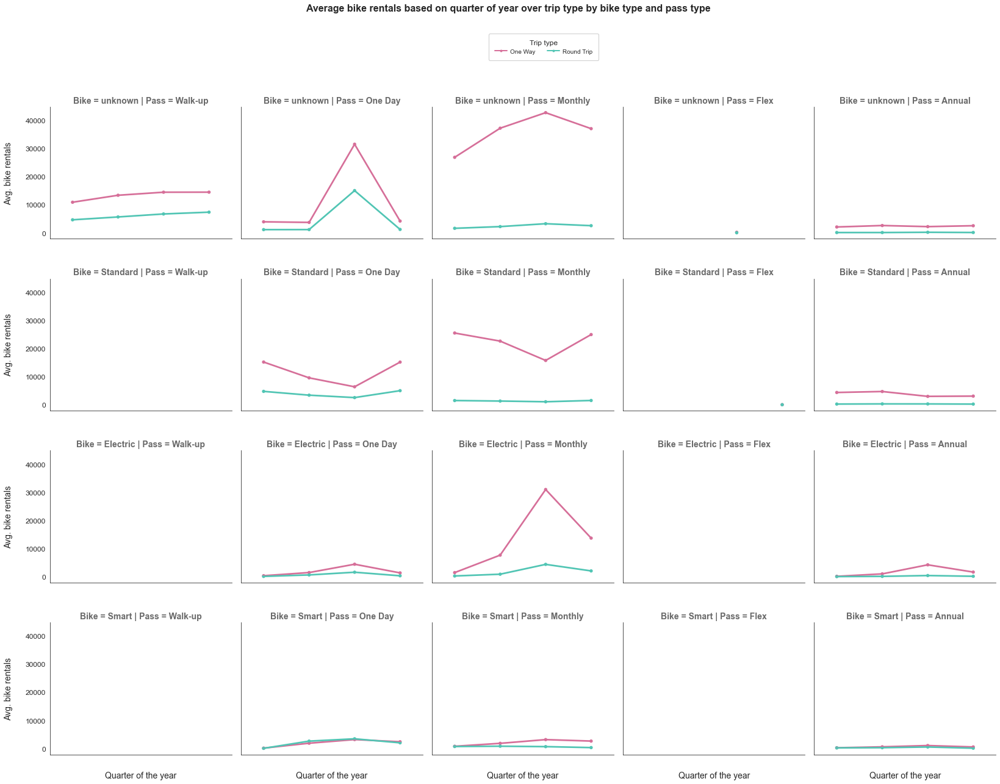

In [961]:
# Assign palette as per requirement
sb.set_style('white')
flatui = ['#e36297', '#42d4be']
sb.set_palette(flatui, n_colors=2, desat=0.8)

# Facet grid with point plot
plot_order = quarter_df.quarter.sort_values(ascending=True).unique()
g = sb.FacetGrid(data = quarter_df, col = 'pass_type', row = 'bike_type', height = 4.5, aspect = 1, hue = 'trip_type')
g.map(sb.pointplot, "quarter", "rentals", order= plot_order, linestyles = "-", ci = None, markers = ['.']);
g.fig.subplots_adjust(top=0.85)
g.fig.suptitle('Average bike rentals based on quarter of year over trip type by bike type and pass type', 
               fontsize = 16, weight = 'bold')
g.set_titles('Bike = {row_name} | Pass = {col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# improve plot aesthetics
# -------------------------------------------------------
g.set_xlabels('\nQuarter of the year', size = 14)
g.set_ylabels('Avg. bike rentals\n', size = 14)
g.set_xticklabels(size = 12)
g.set_yticklabels(size = 12)
# -------------------------------------------------------

# add custom legend
# -------------------------------------------------------
custom = [Line2D([], [], marker='.', color=sb.color_palette()[0], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[1], linestyle='-', linewidth = 2)]

plt.legend(custom, ['One Way', 'Round Trip'], scatterpoints=1, frameon=True, fancybox=True, 
           shadow=False, framealpha = 1, borderpad=1, borderaxespad=1, labelspacing=0.5, 
           ncol = 3, title='Trip type', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(-1.15, 5.5));
# -------------------------------------------------------

plt.subplots_adjust(wspace=0.05, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.3.88 Average bike rentals based on quarter of year over trip type by bike type and pass type.png', dpi=300, bbox_inches='tight')

-----

#### 3.3.89 Multivariate analysis of `hour`, `fare_type`, `bike_type` and `pass_type` columns:

+ `Columns`: hour, fare_type, bike_type, pass_type
+ `Data type`: (numerical, continuous), (Categorical, ordered), (Categorical, nominal) and (Categorical, nominal)
+ `Plot`: Point plot

**`Find average rentals based on the hour over fare_type:`**

Create a dataset which contain bike rentals relative to each `hour` in the day over respective months in the year. Care should be taken as to inlcude only hours that appear in every day of the month over individual years. Use available categorical combinations and do not fill the `NULL` values with numerical zero's so as to consider bike rentals subjected to every hour in any day.

In [962]:
# create a dataset for bike rentals over each hour in a day
hours_df = bikeshare.groupby([bikeshare["year"], 
                              bikeshare["month"],
                              bikeshare["day"],
                              bikeshare["hour"],
                              bikeshare["fare_type"],
                              bikeshare["bike_type"],
                              bikeshare["pass_type"]]).count()['trip_id'].reset_index(name='rentals')
hours_df.head(10)

,year,month,day,hour,fare_type,bike_type,pass_type,rentals
0,2017,1,1,0,Base,unknown,Walk-up,4.0
1,2017,1,1,0,Base,unknown,One Day,NaN
2,2017,1,1,0,Base,unknown,Monthly,3.0
3,2017,1,1,0,Base,unknown,Flex,NaN
4,2017,1,1,0,Base,unknown,Annual,NaN
5,2017,1,1,0,Base,Standard,Walk-up,NaN
6,2017,1,1,0,Base,Standard,One Day,NaN
7,2017,1,1,0,Base,Standard,Monthly,NaN
8,2017,1,1,0,Base,Standard,Flex,NaN
9,2017,1,1,0,Base,Standard,Annual,NaN


**`Point plot:`**

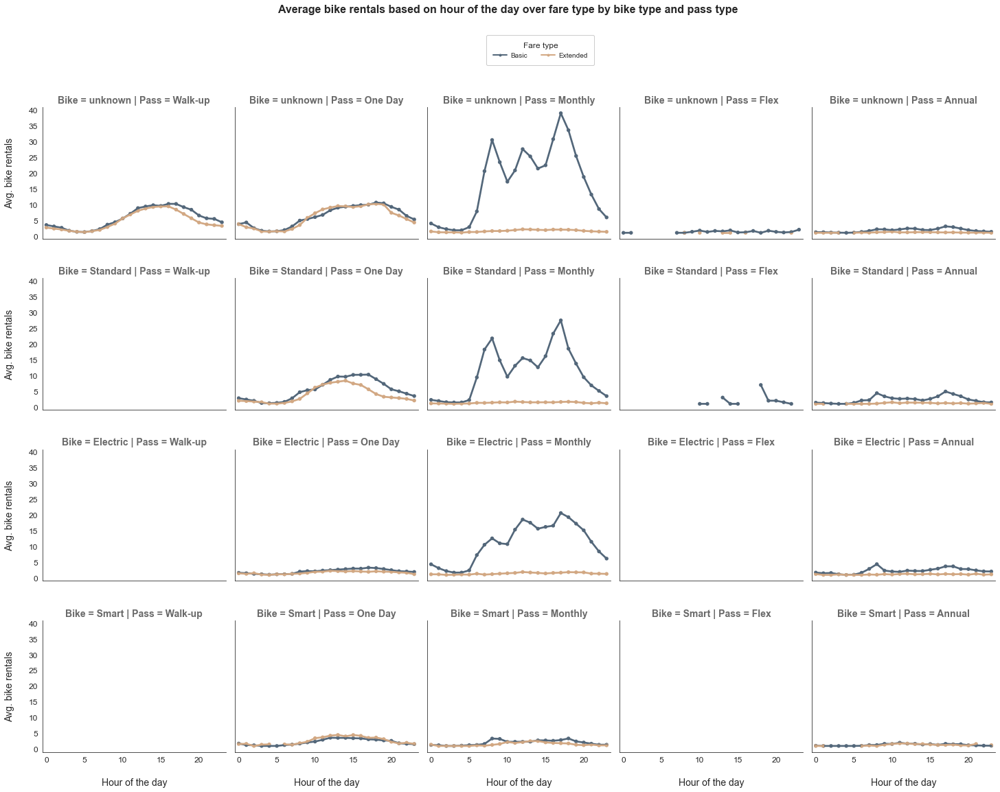

In [963]:
# Assign palette as per requirement
sb.set_style('white')
flatui = ['#466887', '#eda668']
sb.set_palette(flatui, n_colors=2, desat=0.6)

# Facet grid with point plot
plot_order = hours_df.hour.sort_values(ascending=True).unique()
g = sb.FacetGrid(data = hours_df, col = 'pass_type', row = 'bike_type', height = 4, aspect = 1, hue = 'fare_type')
g.map(sb.pointplot, "hour", "rentals", order= plot_order, linestyles = "-", ci = None, markers = ['.']);
g.fig.subplots_adjust(top=0.85)
g.fig.suptitle('Average bike rentals based on hour of the day over fare type by bike type and pass type', 
               fontsize = 16, weight = 'bold')
g.set_titles('Bike = {row_name} | Pass = {col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# improve plot aesthetics
# -------------------------------------------------------
g.set_xlabels('\nHour of the day', size = 14)
g.set_ylabels('Avg. bike rentals\n', size = 14)
g.set_yticklabels(size = 12)
# iterate over axes of FacetGrid
for ax in g.axes.flat:
     # get x labels
    labels = ax.get_xticklabels()
    for i,l in enumerate(labels):
        # skip labels
        if not (i%5 == 0): labels[i] = ''
    # set new labels
    ax.set_xticklabels(labels, size = 12)
# -------------------------------------------------------

# add custom legend
# -------------------------------------------------------
custom = [Line2D([], [], marker='.', color=sb.color_palette()[0], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[1], linestyle='-', linewidth = 2)]

plt.legend(custom, ['Basic', 'Extended'], scatterpoints=1, frameon=True, fancybox=True, 
           shadow=False, framealpha = 1, borderpad=1, borderaxespad=1, labelspacing=0.5, 
           ncol = 3, title='Fare type', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(-1.15, 5.5));
# -------------------------------------------------------

plt.subplots_adjust(wspace=0.05, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.3.89 Average bike rentals based on hour over fare type by bike type and pass type.png', dpi=300, bbox_inches='tight')

----

#### 3.3.90 Multivariate analysis of `daytime`, `fare_type`, `bike_type` and `pass_type` columns:

+ `Columns`: daytime, fare_type, bike_type, pass_type
+ `Data type`: (Categorical, ordered), (Categorical, ordered), (Categorical, nominal) and (Categorical, nominal)
+ `Plot`: Point plot

**`Find average rentals based on the daytime of the day over fare_type:`**

Create a dataset which contain bike rentals relative to each `daytime` in the day over respective months in the year. Care should be taken as to inlcude only daytimes that appear in every day of the month over individual years. Use available categorical combinations and do not fill the `NULL` values with numerical zero's so as to consider bike rentals subjected to every daytime in any day.

In [964]:
# create a dataset for bike rentals over each day in a week
daytime_df = bikeshare.groupby([bikeshare["year"], 
                                bikeshare["month"],
                                bikeshare["day"],
                                bikeshare["daytime"], 
                                bikeshare["fare_type"],
                                bikeshare["bike_type"],
                                bikeshare["pass_type"]]).count()['trip_id'].reset_index(name='rentals')
daytime_df.head(10)

,year,month,day,daytime,fare_type,bike_type,pass_type,rentals
0,2017,1,1,Early hours,Base,unknown,Walk-up,16.0
1,2017,1,1,Early hours,Base,unknown,One Day,NaN
2,2017,1,1,Early hours,Base,unknown,Monthly,8.0
3,2017,1,1,Early hours,Base,unknown,Flex,NaN
4,2017,1,1,Early hours,Base,unknown,Annual,NaN
5,2017,1,1,Early hours,Base,Standard,Walk-up,NaN
6,2017,1,1,Early hours,Base,Standard,One Day,NaN
7,2017,1,1,Early hours,Base,Standard,Monthly,NaN
8,2017,1,1,Early hours,Base,Standard,Flex,NaN
9,2017,1,1,Early hours,Base,Standard,Annual,NaN


**`Point plot:`**

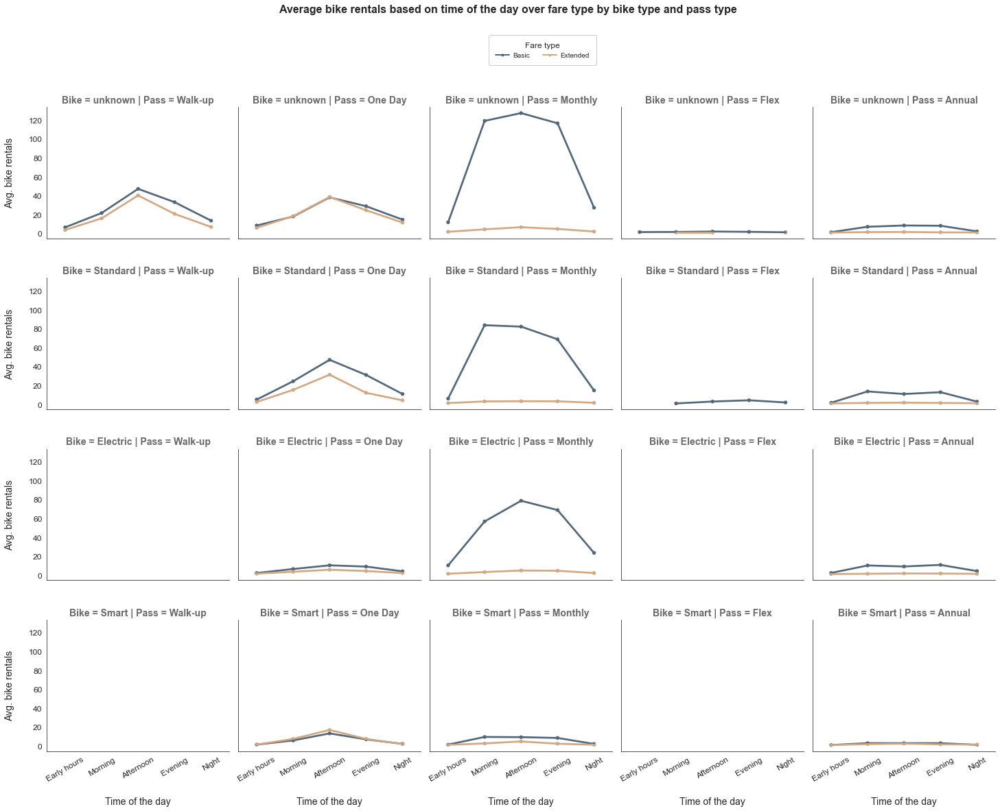

In [965]:
# Assign palette as per requirement
sb.set_style('white')
flatui = ['#466887', '#eda668']
sb.set_palette(flatui, n_colors=2, desat=0.6)

# Facet grid with point plot
plot_order = daytime_df.daytime.sort_values(ascending=True).unique()
g = sb.FacetGrid(data = daytime_df, col = 'pass_type', row = 'bike_type', height = 4, aspect = 1, hue = 'fare_type')
g.map(sb.pointplot, "daytime", "rentals", order= plot_order, linestyles = "-", ci = None, markers = ['.']);
g.fig.subplots_adjust(top=0.85)
g.fig.suptitle('Average bike rentals based on time of the day over fare type by bike type and pass type', 
               fontsize = 16, weight = 'bold')
g.set_titles('Bike = {row_name} | Pass = {col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# improve plot aesthetics
# -------------------------------------------------------
g.set_xlabels('\nTime of the day', size = 14)
g.set_ylabels('Avg. bike rentals\n', size = 14)
g.set_yticklabels(size = 12)
# iterate over axes of FacetGrid
for ax in g.axes.flat:
     # get x labels
    labels = ax.get_xticklabels()
    # set new labels
    ax.set_xticklabels(labels, rotation = 30, size = 12)
# -------------------------------------------------------

# add custom legend
# -------------------------------------------------------
custom = [Line2D([], [], marker='.', color=sb.color_palette()[0], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[1], linestyle='-', linewidth = 2)]

plt.legend(custom, ['Basic', 'Extended'], scatterpoints=1, frameon=True, fancybox=True, 
           shadow=False, framealpha = 1, borderpad=1, borderaxespad=1, labelspacing=0.5, 
           ncol = 3, title='Fare type', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(-1.15, 5.5));
# -------------------------------------------------------

plt.subplots_adjust(wspace=0.05, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.3.90 Average bike rentals based on daytime over the fare type by bike type and pass type.png', dpi=300, bbox_inches='tight')

----

#### 3.3.91 Multivariate analysis of `day`, `fare_type`, `bike_type` and `pass_type` columns:

+ `Columns`: day, fare_type, bike_type, pass_type
+ `Data type`: (Categorical, ordered), (Categorical, ordered), (Categorical, nominal) and (Categorical, nominal)
+ `Plot`: Point plot

**`Find average rentals based on the day of the month over fare_type:`**

Create a dataset which contain bike rentals relative to each `day` over respective months in the year. Care should be taken as to inlcude only days that appear in every month over individual years. Use available categorical combinations and do not fill the `NULL` values with numerical zero's so as to consider bike rentals subjected to every day in any month.

In [966]:
# create a dataset for bike rentals over each day in a month
days_df = bikeshare.groupby([bikeshare["year"], 
                             bikeshare["month"],
                             bikeshare["day"],
                             bikeshare["fare_type"],
                             bikeshare["bike_type"],
                             bikeshare["pass_type"]]).count()['trip_id'].reset_index(name='rentals')
days_df.head(10)

,year,month,day,fare_type,bike_type,pass_type,rentals
0,2017,1,1,Base,unknown,Walk-up,111.0
1,2017,1,1,Base,unknown,One Day,NaN
2,2017,1,1,Base,unknown,Monthly,89.0
3,2017,1,1,Base,unknown,Flex,NaN
4,2017,1,1,Base,unknown,Annual,11.0
5,2017,1,1,Base,Standard,Walk-up,NaN
6,2017,1,1,Base,Standard,One Day,NaN
7,2017,1,1,Base,Standard,Monthly,NaN
8,2017,1,1,Base,Standard,Flex,NaN
9,2017,1,1,Base,Standard,Annual,NaN


**`Point plot:`**

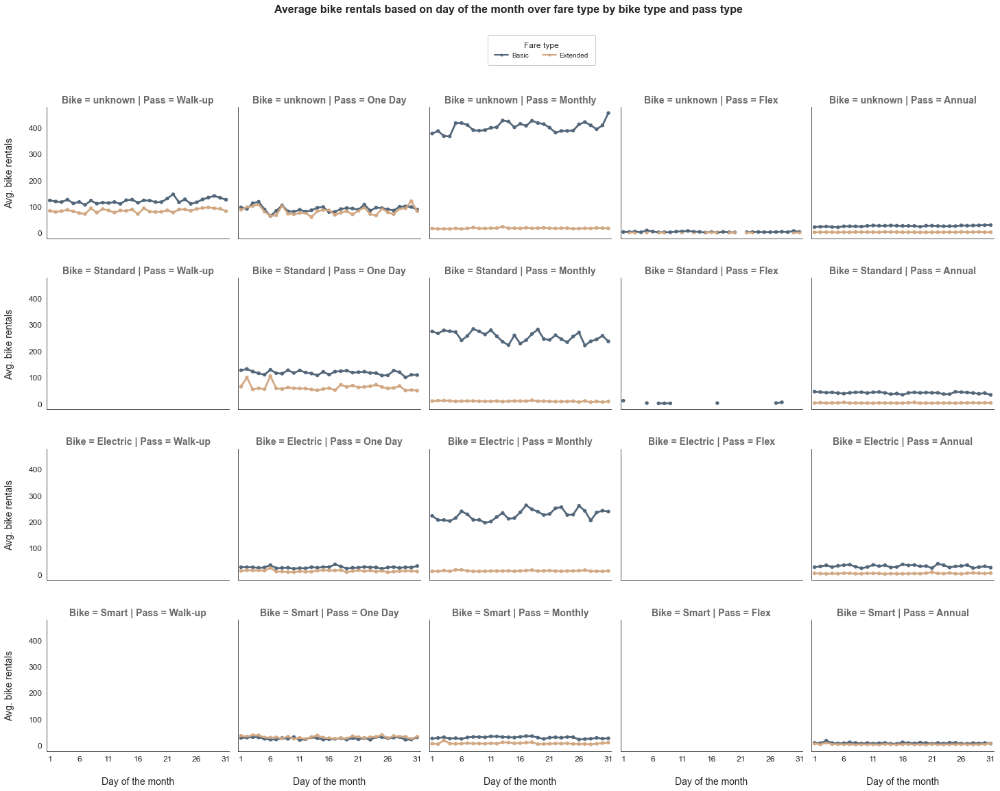

In [967]:
# Assign palette as per requirement
sb.set_style('white')
flatui = ['#466887', '#eda668']
sb.set_palette(flatui, n_colors=2, desat=0.6)

# Facet grid with point plot
plot_order = days_df.day.sort_values(ascending=True).unique()
g = sb.FacetGrid(data = days_df, col = 'pass_type', row = 'bike_type', height = 4, aspect = 1, hue = 'fare_type')
g.map(sb.pointplot, "day", "rentals", order= plot_order, linestyles = "-", ci = None, markers = ['.']);
g.fig.subplots_adjust(top=0.85)
g.fig.suptitle('Average bike rentals based on day of the month over fare type by bike type and pass type', 
               fontsize = 16, weight = 'bold')
g.set_titles('Bike = {row_name} | Pass = {col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# improve plot aesthetics
# -------------------------------------------------------
g.set_xlabels('\nDay of the month', size = 14)
g.set_ylabels('Avg. bike rentals\n', size = 14)
g.set_yticklabels(size = 12)
# iterate over axes of FacetGrid
for ax in g.axes.flat:
     # get x labels
    labels = ax.get_xticklabels()
    for i,l in enumerate(labels):
        # skip labels
        if not (i%5 == 0): labels[i] = ''
    # set new labels
    ax.set_xticklabels(labels, size = 12)
# -------------------------------------------------------

# add custom legend
# -------------------------------------------------------
custom = [Line2D([], [], marker='.', color=sb.color_palette()[0], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[1], linestyle='-', linewidth = 2)]

plt.legend(custom, ['Basic', 'Extended'], scatterpoints=1, frameon=True, fancybox=True, 
           shadow=False, framealpha = 1, borderpad=1, borderaxespad=1, labelspacing=0.5, 
           ncol = 3, title='Fare type', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(-1.15, 5.5));
# -------------------------------------------------------

plt.subplots_adjust(wspace=0.05, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.3.91 Average bike rentals based on day over fare type by bike type and pass type.png', dpi=300, bbox_inches='tight')

----

#### 3.3.92 Multivariate analysis of `weekday`, `fare_type`, `bike_type` and `pass_type` columns:

+ `Columns`: weekday, fare_type, bike_type, pass_type
+ `Data type`: (Categorical, ordered), (Categorical, ordered), (Categorical, nominal) and (Categorical, nominal)
+ `Plot`: Point plot

**`Find average rentals based on the day of the week over fare_type:`**

Create a dataset which contain bike rentals relative to each `day` over respective week in the month. Care should be taken as to inlcude only days that appear in every week over individual months. Use available categorical combinations and do not fill the `NULL` values with numerical zero's so as to consider bike rentals subjected to every day in any week.

In [968]:
# create a dataset for bike rentals over each day in a week
weekday_df = bikeshare.groupby([bikeshare["year"], 
                                bikeshare["month"],
                                bikeshare["week"],
                                bikeshare["weekday"],
                                bikeshare["fare_type"],
                                bikeshare["bike_type"],
                                bikeshare["pass_type"]]).count()['trip_id'].reset_index(name='rentals')
weekday_df.head(10)

,year,month,week,weekday,fare_type,bike_type,pass_type,rentals
0,2017,1,First,Monday,Base,unknown,Walk-up,76.0
1,2017,1,First,Monday,Base,unknown,One Day,NaN
2,2017,1,First,Monday,Base,unknown,Monthly,115.0
3,2017,1,First,Monday,Base,unknown,Flex,NaN
4,2017,1,First,Monday,Base,unknown,Annual,23.0
5,2017,1,First,Monday,Base,Standard,Walk-up,NaN
6,2017,1,First,Monday,Base,Standard,One Day,NaN
7,2017,1,First,Monday,Base,Standard,Monthly,NaN
8,2017,1,First,Monday,Base,Standard,Flex,NaN
9,2017,1,First,Monday,Base,Standard,Annual,NaN


**`Point plot:`**

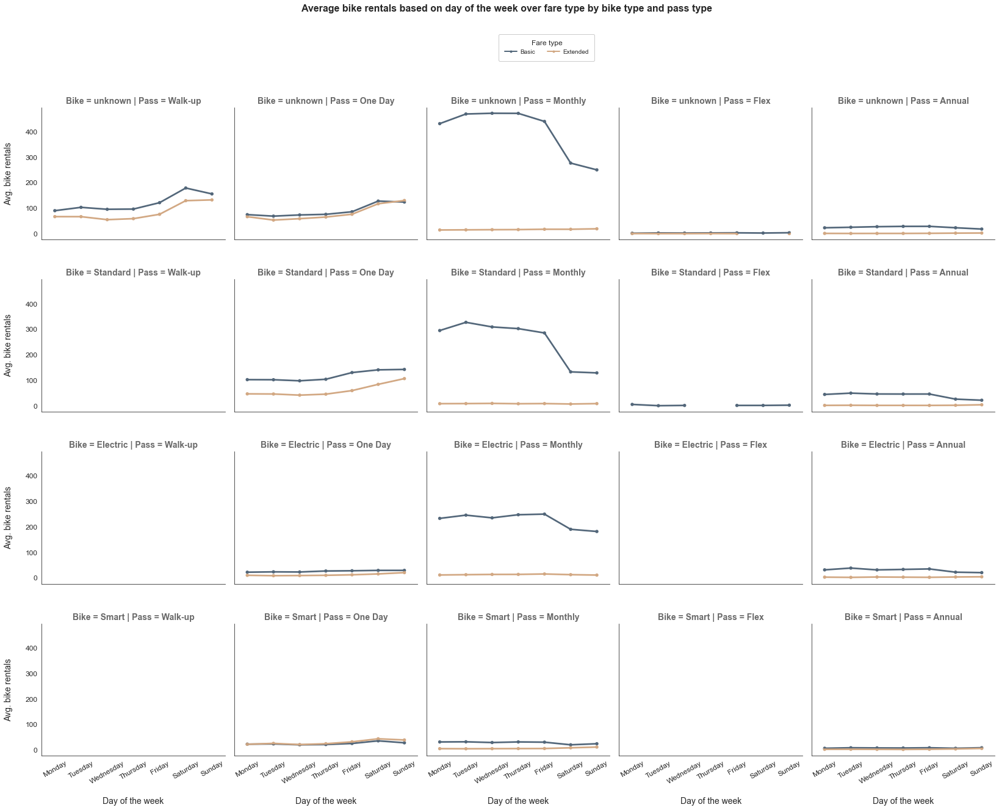

In [969]:
# Assign palette as per requirement
sb.set_style('white')
flatui = ['#466887', '#eda668']
sb.set_palette(flatui, n_colors=2, desat=0.6)

# Facet grid with point plot
plot_order = weekday_df.weekday.sort_values(ascending=True).unique()
g = sb.FacetGrid(data = weekday_df, col = 'pass_type', row = 'bike_type', height = 4.5, aspect = 1, hue = 'fare_type')
g.map(sb.pointplot, "weekday", "rentals", order= plot_order, linestyles = "-", ci = None, markers = ['.']);
g.fig.subplots_adjust(top=0.85)
g.fig.suptitle('Average bike rentals based on day of the week over fare type by bike type and pass type', 
               fontsize = 16, weight = 'bold')
g.set_titles('Bike = {row_name} | Pass = {col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# improve plot aesthetics
# -------------------------------------------------------
g.set_xlabels('\nDay of the week', size = 14)
g.set_ylabels('Avg. bike rentals\n', size = 14)
g.set_yticklabels(size = 12)
# iterate over axes of FacetGrid
for ax in g.axes.flat:
     # get x labels
    labels = ax.get_xticklabels()
    # set new labels
    ax.set_xticklabels(labels, rotation = 30, size = 12)
# -------------------------------------------------------

# add custom legend
# -------------------------------------------------------
custom = [Line2D([], [], marker='.', color=sb.color_palette()[0], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[1], linestyle='-', linewidth = 2)]

plt.legend(custom, ['Basic', 'Extended'], scatterpoints=1, frameon=True, fancybox=True, 
           shadow=False, framealpha = 1, borderpad=1, borderaxespad=1, labelspacing=0.5, 
           ncol = 3, title='Fare type', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(-1.15, 5.5));
# -------------------------------------------------------

plt.subplots_adjust(wspace=0.05, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.3.92 Average bike rentals based on weekday over fare type by bike type and pass type.png', dpi=300, bbox_inches='tight')

----

#### 3.3.93 Multivariate analysis of `month`, `fare_type`, `bike_type` and `pass_type` columns:

+ `Columns`: month, fare_type, bike_type, pass_type
+ `Data type`: (Categorical, ordered), (Categorical, ordered), (Categorical, nominal) and (Categorical, nominal)
+ `Plot`: Point plot

**`Find average rentals based on the month over fare_type:`**

Create a dataset which contain bike rentals relative to each `month` over respective years. Care should be taken as to inlcude only rentals that appear in every month over individual years. Use available categorical combinations and do not fill the `NULL` values with numerical zero's so as to consider bike rentals subjected to every month in any year.

In [970]:
# create a dataset for bike rentals over each month in a year
month_df = bikeshare.groupby([bikeshare["year"], 
                              bikeshare["month"],
                              bikeshare["fare_type"],
                              bikeshare["bike_type"],
                              bikeshare["pass_type"]]).count()['trip_id'].reset_index(name='rentals')
month_df.head(10)

,year,month,fare_type,bike_type,pass_type,rentals
0,2017,1,Base,unknown,Walk-up,2215.0
1,2017,1,Base,unknown,One Day,NaN
2,2017,1,Base,unknown,Monthly,6074.0
3,2017,1,Base,unknown,Flex,NaN
4,2017,1,Base,unknown,Annual,636.0
5,2017,1,Base,Standard,Walk-up,NaN
6,2017,1,Base,Standard,One Day,NaN
7,2017,1,Base,Standard,Monthly,NaN
8,2017,1,Base,Standard,Flex,NaN
9,2017,1,Base,Standard,Annual,NaN


**`Point plot:`**

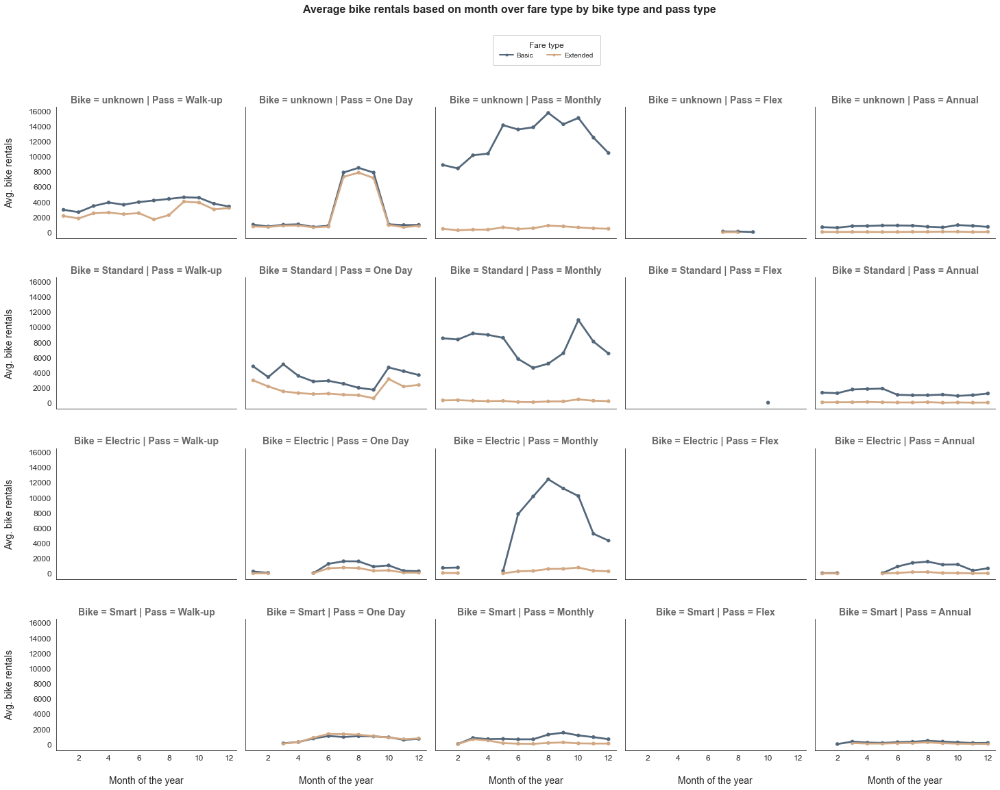

In [971]:
# Assign palette as per requirement
sb.set_style('white')
flatui = ['#466887', '#eda668']
sb.set_palette(flatui, n_colors=2, desat=0.6)

# Facet grid with point plot
plot_order = month_df.month.sort_values(ascending=True).unique()
g = sb.FacetGrid(data = month_df, col = 'pass_type', row = 'bike_type', height = 4, aspect = 1, hue = 'fare_type')
g.map(sb.pointplot, "month", "rentals", order= plot_order, linestyles = "-", ci = None, markers = ['.']);
g.fig.subplots_adjust(top=0.85)
g.fig.suptitle('Average bike rentals based on month over fare type by bike type and pass type', 
               fontsize = 16, weight = 'bold')
g.set_titles('Bike = {row_name} | Pass = {col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# improve plot aesthetics
# -------------------------------------------------------
g.set_xlabels('\nMonth of the year', size = 14)
g.set_ylabels('Avg. bike rentals\n', size = 14)
g.set_yticklabels(size = 12)
# iterate over axes of FacetGrid
for ax in g.axes.flat:
    # get x labels
    xlabels = ax.get_xticklabels()
    for i,l in enumerate(xlabels):
        # skip labels
        if (i%2 == 0): xlabels[i] = ''
    # set new xlabels
    ax.set_xticklabels(xlabels, size = 12)
# -------------------------------------------------------

# add custom legend
# -------------------------------------------------------
custom = [Line2D([], [], marker='.', color=sb.color_palette()[0], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[1], linestyle='-', linewidth = 2)]

plt.legend(custom, ['Basic', 'Extended'], scatterpoints=1, frameon=True, fancybox=True, 
           shadow=False, framealpha = 1, borderpad=1, borderaxespad=1, labelspacing=0.5, 
           ncol = 3, title='Fare type', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(-1.15, 5.5));
# -------------------------------------------------------

plt.subplots_adjust(wspace=0.05, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.3.93 Average bike rentals based on month over fare type by bike type and pass type.png', dpi=300, bbox_inches='tight')

----

#### 3.3.94 Multivariate analysis of `quarter`, `fare_type`, `bike_type` and `pass_type` columns:

+ `Columns`: quarter, fare_type, bike_type, pass_type
+ `Data type`: (Categorical, ordered), (Categorical, ordered), (Categorical, nominal) and (Categorical, nominal)
+ `Plot`: Point plot

**`Find average rentals based on the quarter over fare_type:`**

Create a dataset which contain bike rentals relative to each `quarter` over respective years. Care should be taken as to inlcude only rentals that appear in every quarter over individual years. Use available categorical combinations and do not fill the `NULL` values with numerical zero's so as to consider bike rentals subjected to every quarter in any year.

In [972]:
# create a dataset for bike rentals over each day in a week
quarter_df = bikeshare.groupby([bikeshare["year"], 
                                bikeshare["quarter"],
                                bikeshare["fare_type"],
                                bikeshare["bike_type"],
                                bikeshare["pass_type"]]).count()['trip_id'].reset_index(name='rentals')
quarter_df.head(10)

,year,quarter,fare_type,bike_type,pass_type,rentals
0,2017,Q1,Base,unknown,Walk-up,7266.0
1,2017,Q1,Base,unknown,One Day,NaN
2,2017,Q1,Base,unknown,Monthly,20097.0
3,2017,Q1,Base,unknown,Flex,NaN
4,2017,Q1,Base,unknown,Annual,2154.0
5,2017,Q1,Base,Standard,Walk-up,NaN
6,2017,Q1,Base,Standard,One Day,NaN
7,2017,Q1,Base,Standard,Monthly,NaN
8,2017,Q1,Base,Standard,Flex,NaN
9,2017,Q1,Base,Standard,Annual,NaN


**`Point plot:`**

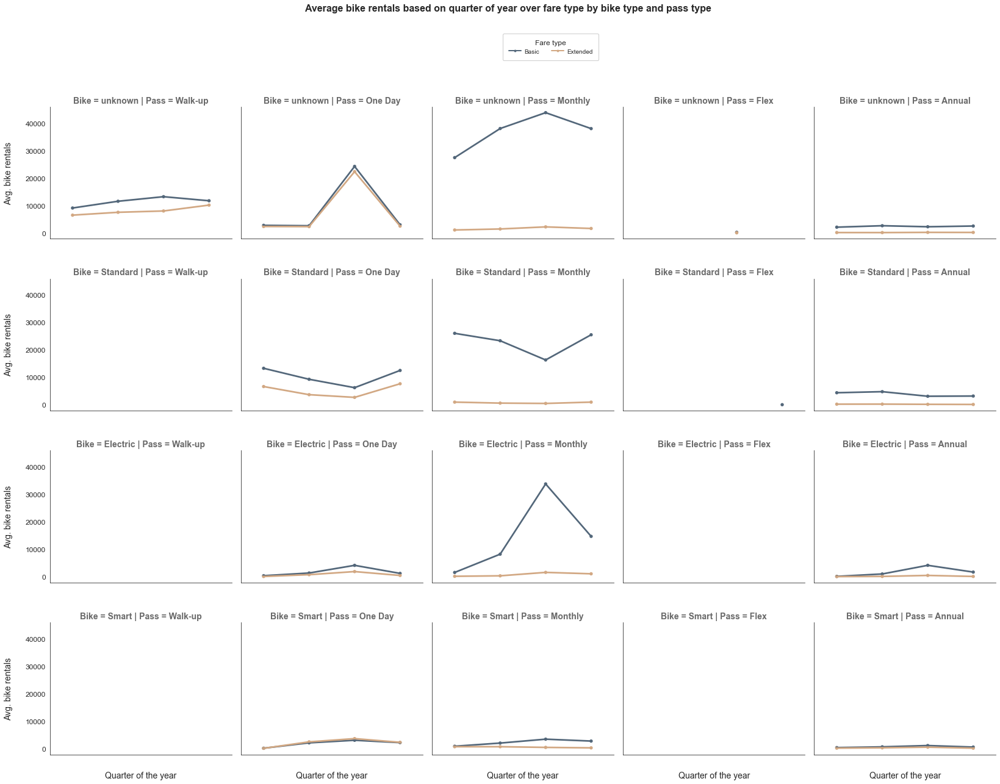

In [973]:
# Assign palette as per requirement
sb.set_style('white')
flatui = ['#466887', '#eda668']
sb.set_palette(flatui, n_colors=2, desat=0.6)

# Facet grid with point plot
plot_order = quarter_df.quarter.sort_values(ascending=True).unique()
g = sb.FacetGrid(data = quarter_df, col = 'pass_type', row = 'bike_type', height = 4.5, aspect = 1, hue = 'fare_type')
g.map(sb.pointplot, "quarter", "rentals", order= plot_order, linestyles = "-", ci = None, markers = ['.']);
g.fig.subplots_adjust(top=0.85)
g.fig.suptitle('Average bike rentals based on quarter of year over fare type by bike type and pass type', 
               fontsize = 16, weight = 'bold')
g.set_titles('Bike = {row_name} | Pass = {col_name}', weight = 'bold', size = 14, color = 'dimgrey')

# improve plot aesthetics
# -------------------------------------------------------
g.set_xlabels('\nQuarter of the year', size = 14)
g.set_ylabels('Avg. bike rentals\n', size = 14)
g.set_xticklabels(size = 12)
g.set_yticklabels(size = 12)
# -------------------------------------------------------

# add custom legend
# -------------------------------------------------------
custom = [Line2D([], [], marker='.', color=sb.color_palette()[0], linestyle='-', linewidth = 2),
          Line2D([], [], marker='.', color=sb.color_palette()[1], linestyle='-', linewidth = 2)]

plt.legend(custom, ['Basic', 'Extended'], scatterpoints=1, frameon=True, fancybox=True, 
           shadow=False, framealpha = 1, borderpad=1, borderaxespad=1, labelspacing=0.5, 
           ncol = 3, title='Fare type', title_fontsize=12, fontsize=10, facecolor='white', 
           markerfirst=True, handlelength=2, handletextpad=0.5, bbox_to_anchor=(-1.15, 5.5));
# -------------------------------------------------------

plt.subplots_adjust(wspace=0.05, hspace=0.3);

# savefig by passing (bbox_inches='tight'),which will adjust the figure to include all of the x and y labels
plt.savefig('plots/3.3.94 Average bike rentals based on quarter of year over fare type by bike type and pass type.png', dpi=300, bbox_inches='tight')

<h4><center>-------- End of 3.3.Multivariate Data Analysis --------</center></h4>

----

<div style="background-color:lightskyblue;">
    <p style="color:skyblue;font-size:1px"> |
    </p>
    <h1 style="color:White;font-family:'Arial';font-size:20px"><center>-------- End of Act 2: Exploratory Data Analysis --------</center></h1>
    <p style="color:skyblue;font-size:1px"> |
    </p>
</div>